# Network analyses
Analyze the resulting networks for:
* interactions involving TFs/TF genes
* top genes, ranked by out-degree
* interactions ranked by original gene expression level
* high-confidence interactions

In [1]:
import csv
import math
import numpy as np
import pandas as pd
import pickle
import sys
import os
import copy
import networkx as nx
import collections
import geneTSmunging as gtm
import network_helpers as nh
import causal_pipeline as cp
import time
import matplotlib.pyplot as plt
import matplotlib as mpl
from scipy import misc
import matplotlib.image as mpimg

from IPython.display import display, HTML
%matplotlib inline

In [49]:
# EDIT THIS
run_type = "priority"

# EDIT
annot_file = "../../gene_annotations/Gene-table-annot.txt"



# EDIT THIS
make_hg = True


### EDIT THE BELOW
run_folder = "run"
run_subfolders = [x for x in os.listdir(run_folder) if not x.startswith(".")][1:]

### EDIT THIS
run_orig_subfolders = [y for y in run_subfolders if "prot2TPM" in y]
print "Number original files: ", len(run_orig_subfolders)
print "Only one orig? ", len(run_orig_subfolders) == 1
run_orig_subfolder = run_orig_subfolders[0]
run_orig_index = run_subfolders.index(run_orig_subfolder)


names = ["_".join([run_subfolder.split("_")[0].split("-")[0],
                   run_subfolder.split("_")[1], run_subfolder.split("_")[4]]) for run_subfolder in run_subfolders]
names = [name.replace("prot2TPM", "orig") for name in names]

namelabels = [cp.run_to_label(name) for name in names]
namelabels = [namelabel.replace("enet-", "").replace("_", "-").upper() for namelabel in namelabels]
nameshortlabels = ["".join([x[0] if x  not in {"ZS", "ZU"} else "S" if "S" in x else "U" for x in namelabel.split("-")]) for namelabel in namelabels]
nameshortlabels = [x.replace("O", "Z") for x in nameshortlabels]
namelabels = [x[:-1] + "-" + x[-1] for x in nameshortlabels]



folders = [os.path.join(run_folder, run_subfolder) for run_subfolder in run_subfolders]
network_folder = "networks/" # only consider the union network, not the individual lags
networkfiles = [os.path.join(network_folder, x) for x in os.listdir(network_folder) if not x.startswith(".")][1:]

print "Run type: ", run_type
print "Names: ", names
print "Namelabels: ", namelabels
print "Short name labels: ", nameshortlabels
print "Run subfolders:" ,run_subfolders
print "Network files: ", networkfiles

# check that they correspond
if not all([run_subfolder in networkfile for run_subfolder, networkfile in zip(run_subfolders, networkfiles)]):
    raise ValueError("Networks and run folders don't correspond")


Number original files:  4
Only one orig?  False
Run type:  priority
Names:  ['orig_0mean-1var_enet-1', 'orig_0mean-1var_enet-2', 'orig_0mean-unnormalized_enet-1', 'orig_0mean-unnormalized_enet-2']
Namelabels:  ['ZS-1', 'ZS-2', 'ZU-1', 'ZU-2']
Short name labels:  ['ZS1', 'ZS2', 'ZU1', 'ZU2']
Run subfolders: ['prot2TPM-er-reps_0mean-1var_g-null_l-fdr-0.05_enet-1', 'prot2TPM-er-reps_0mean-1var_g-null_l-fdr-0.05_enet-2', 'prot2TPM-er-reps_0mean-unnormalized_g-null_l-fdr-0.05_enet-1', 'prot2TPM-er-reps_0mean-unnormalized_g-null_l-fdr-0.05_enet-2']
Network files:  ['networks/prot2TPM-er-reps_0mean-1var_g-null_l-fdr-0.05_enet-1-union-network.txt', 'networks/prot2TPM-er-reps_0mean-1var_g-null_l-fdr-0.05_enet-2-union-network.txt', 'networks/prot2TPM-er-reps_0mean-unnormalized_g-null_l-fdr-0.05_enet-1-union-network.txt', 'networks/prot2TPM-er-reps_0mean-unnormalized_g-null_l-fdr-0.05_enet-2-union-network.txt']


In [50]:


# check that they correspond
assert [run_subfolder in networkfile for run_subfolder, networkfile in zip(run_subfolders, networkfiles)]


print "Getting Gene File. Assuming all have the same genes"
data_genefile = os.path.join(folders[run_orig_index], "data", gtm.load_params(os.path.join(folders[run_orig_index], "params.csv"))["GENENAME"])
other_data_genes_list = []
with open(data_genefile, 'rU') as f:
    data_genes = np.array([x.split("\n")[0] for x in f.readlines()])
    
    print "data_genefile: ", data_genefile
    print "Genes: ", len(data_genes)
    
    for other_data_genefile in [os.path.join(folders[i], "data", gtm.load_params(os.path.join(folders[i], "params.csv"))["GENENAME"]) for i in range(len(folders))]:
        with open(other_data_genefile, 'rU') as f:
            other_data_genes = np.array([x.split("\n")[0] for x in f.readlines()])
            print len(other_data_genes)
        
        other_data_genes_list.append(other_data_genes)
        # check that one is in the other
        assert len(data_genes) == len(np.union1d(data_genes, other_data_genes))
    
    print "All have the same genes"
    
base_out_dir = "analysis" 
if not os.path.exists(base_out_dir):
    os.makedirs(base_out_dir)

plot_folder = os.path.join(base_out_dir, "plots")
if not os.path.exists(plot_folder):
    os.makedirs(plot_folder)

name_plot_folders = []
for name in names:
    name_plot_folder = os.path.join(plot_folder, name)
    if not os.path.exists(name_plot_folder):
        os.makedirs(name_plot_folder)
    name_plot_folders.append(name_plot_folder)

print
print "run_subfolders: "
print run_subfolders
print
print "Network files: "
print networkfiles
print
print "Run type (same as Mother folder): "
print run_type

Getting Gene File. Assuming all have the same genes
data_genefile:  run/prot2TPM-er-reps_0mean-1var_g-null_l-fdr-0.05_enet-1/data/sig_genes_reg_fdr-0.05-all-ensg-cutoff-2-plusGR.txt
Genes:  2768
2768
2768
2768
2768
All have the same genes

run_subfolders: 
['prot2TPM-er-reps_0mean-1var_g-null_l-fdr-0.05_enet-1', 'prot2TPM-er-reps_0mean-1var_g-null_l-fdr-0.05_enet-2', 'prot2TPM-er-reps_0mean-unnormalized_g-null_l-fdr-0.05_enet-1', 'prot2TPM-er-reps_0mean-unnormalized_g-null_l-fdr-0.05_enet-2']

Network files: 
['networks/prot2TPM-er-reps_0mean-1var_g-null_l-fdr-0.05_enet-1-union-network.txt', 'networks/prot2TPM-er-reps_0mean-1var_g-null_l-fdr-0.05_enet-2-union-network.txt', 'networks/prot2TPM-er-reps_0mean-unnormalized_g-null_l-fdr-0.05_enet-1-union-network.txt', 'networks/prot2TPM-er-reps_0mean-unnormalized_g-null_l-fdr-0.05_enet-2-union-network.txt']

Run type (same as Mother folder): 
priority


In [51]:
norms = [gtm.load_params(os.path.join(folder, "params.csv"))["NORMALIZATION"] for folder in folders]

In [52]:
# load the data
data_df_list = []
data_hg_df_list = []
timekeys_list = []
num_per_keys_list = []
timepoints_list = []

for name, data_file in zip(names, [os.path.join(folders[i], "data", gtm.load_params(os.path.join(folders[i], "params.csv"))["DATANAME"]) for i in range(len(folders))]):
    _, _, _, data_df, timekeys, num_per_keys, timepoints  = gtm.load_rep_file_list(data_file, return_timepoints=True)
    data_df_list.append(data_df)
    timekeys_list.append(timekeys)
    num_per_keys_list.append(num_per_keys)
    timepoints_list.append(timepoints)
    
    data_hg_df = data_df.copy()
    data_hg_df["gene"] = [nh.ensg2hg(x) for x in data_df["gene"].values]
    data_hg_df_list.append(data_hg_df)

    
    print "*****************"
    print name
    print "*****************"
    
    print timekeys
    display(data_df.head())

Collists are  [['t00_rep1', 't00_rep2plusextra', 't00_rep3plusextra', 't00_rep4'], ['t05_rep1', 't05_rep2', 't05_rep3', 't05_rep4'], ['t1_rep1', 't1_rep2', 't1_rep3', 't1_rep4'], ['t2_rep1', 't2_rep2', 't2_rep3', 't2_rep4'], ['t3_rep1', 't3_rep2', 't3_rep3', 't3_rep4'], ['t4_rep1', 't4_rep2', 't4_rep3', 't4_rep4'], ['t5_rep1_impute-linear', 't5_rep2', 't5_rep3', 't5_rep4'], ['t6_rep1_impute-linear', 't6_rep2', 't6_rep3', 't6_rep4'], ['t7_rep1', 't7_rep2', 't7_rep3', 't7_rep4'], ['t8_rep1', 't8_rep2', 't8_rep3', 't8_rep4'], ['t10_rep1', 't10_rep2', 't10_rep3', 't10_rep4'], ['t12_rep1', 't12_rep2', 't12_rep3', 't12_rep4']]
Timkeyes are  ['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
*****************
orig_0mean-1var_enet-1
*****************
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']


,gene,t00_rep1,t05_rep1,t1_rep1,t2_rep1,t3_rep1,t4_rep1,t5_rep1_impute-linear,t6_rep1_impute-linear,t7_rep1,...,t6_rep,t6_repstd,t7_rep,t7_repstd,t8_rep,t8_repstd,t10_rep,t10_repstd,t12_rep,t12_repstd
0,ENSG00000187583.9,1.048150,0.352525,-0.081861,-0.204482,-2.314285,-0.700752,0.076868,0.854488,1.632109,...,-0.048218,0.700887,0.099156,1.230171,0.990459,0.580183,-0.569394,0.656921,0.407446,0.409673
1,ENSG00000131584.17,-1.385174,-0.682862,0.524237,0.104443,-1.069370,-1.276677,-0.679656,-0.082636,0.514384,...,0.566444,0.649676,0.259458,0.850846,1.284060,0.344031,1.168825,0.928932,0.792710,0.619386
2,ENSG00000221978.10,-1.756855,-1.805678,1.333110,1.019320,-0.145358,-0.546838,-0.292462,-0.038086,0.216289,...,0.957116,1.037126,-0.250054,0.607697,0.281308,0.619317,0.983308,1.176778,0.868296,0.429623
3,ENSG00000116237.14,1.526054,1.314074,0.554429,1.009942,-0.124078,0.340217,-0.150409,-0.641035,-1.131662,...,-0.487140,0.467618,-0.635036,0.459293,-0.159164,0.699347,-1.379682,0.432781,-1.838975,0.187525
4,ENSG00000158292.6,-1.479884,-1.829786,0.879860,0.486651,-0.028943,-1.303640,-0.569020,0.165600,0.900220,...,0.625013,0.453182,0.702297,0.459125,0.422737,0.628600,1.109211,0.185345,0.650456,0.247120


Collists are  [['t00_rep1', 't00_rep2plusextra', 't00_rep3plusextra', 't00_rep4'], ['t05_rep1', 't05_rep2', 't05_rep3', 't05_rep4'], ['t1_rep1', 't1_rep2', 't1_rep3', 't1_rep4'], ['t2_rep1', 't2_rep2', 't2_rep3', 't2_rep4'], ['t3_rep1', 't3_rep2', 't3_rep3', 't3_rep4'], ['t4_rep1', 't4_rep2', 't4_rep3', 't4_rep4'], ['t5_rep1_impute-linear', 't5_rep2', 't5_rep3', 't5_rep4'], ['t6_rep1_impute-linear', 't6_rep2', 't6_rep3', 't6_rep4'], ['t7_rep1', 't7_rep2', 't7_rep3', 't7_rep4'], ['t8_rep1', 't8_rep2', 't8_rep3', 't8_rep4'], ['t10_rep1', 't10_rep2', 't10_rep3', 't10_rep4'], ['t12_rep1', 't12_rep2', 't12_rep3', 't12_rep4']]
Timkeyes are  ['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
*****************
orig_0mean-1var_enet-2
*****************
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']


,gene,t00_rep1,t05_rep1,t1_rep1,t2_rep1,t3_rep1,t4_rep1,t5_rep1_impute-linear,t6_rep1_impute-linear,t7_rep1,...,t6_rep,t6_repstd,t7_rep,t7_repstd,t8_rep,t8_repstd,t10_rep,t10_repstd,t12_rep,t12_repstd
0,ENSG00000187583.9,1.048150,0.352525,-0.081861,-0.204482,-2.314285,-0.700752,0.076868,0.854488,1.632109,...,-0.048218,0.700887,0.099156,1.230171,0.990459,0.580183,-0.569394,0.656921,0.407446,0.409673
1,ENSG00000131584.17,-1.385174,-0.682862,0.524237,0.104443,-1.069370,-1.276677,-0.679656,-0.082636,0.514384,...,0.566444,0.649676,0.259458,0.850846,1.284060,0.344031,1.168825,0.928932,0.792710,0.619386
2,ENSG00000221978.10,-1.756855,-1.805678,1.333110,1.019320,-0.145358,-0.546838,-0.292462,-0.038086,0.216289,...,0.957116,1.037126,-0.250054,0.607697,0.281308,0.619317,0.983308,1.176778,0.868296,0.429623
3,ENSG00000116237.14,1.526054,1.314074,0.554429,1.009942,-0.124078,0.340217,-0.150409,-0.641035,-1.131662,...,-0.487140,0.467618,-0.635036,0.459293,-0.159164,0.699347,-1.379682,0.432781,-1.838975,0.187525
4,ENSG00000158292.6,-1.479884,-1.829786,0.879860,0.486651,-0.028943,-1.303640,-0.569020,0.165600,0.900220,...,0.625013,0.453182,0.702297,0.459125,0.422737,0.628600,1.109211,0.185345,0.650456,0.247120


Collists are  [['t00_rep1', 't00_rep2plusextra', 't00_rep3plusextra', 't00_rep4'], ['t05_rep1', 't05_rep2', 't05_rep3', 't05_rep4'], ['t1_rep1', 't1_rep2', 't1_rep3', 't1_rep4'], ['t2_rep1', 't2_rep2', 't2_rep3', 't2_rep4'], ['t3_rep1', 't3_rep2', 't3_rep3', 't3_rep4'], ['t4_rep1', 't4_rep2', 't4_rep3', 't4_rep4'], ['t5_rep1_impute-linear', 't5_rep2', 't5_rep3', 't5_rep4'], ['t6_rep1_impute-linear', 't6_rep2', 't6_rep3', 't6_rep4'], ['t7_rep1', 't7_rep2', 't7_rep3', 't7_rep4'], ['t8_rep1', 't8_rep2', 't8_rep3', 't8_rep4'], ['t10_rep1', 't10_rep2', 't10_rep3', 't10_rep4'], ['t12_rep1', 't12_rep2', 't12_rep3', 't12_rep4']]
Timkeyes are  ['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
*****************
orig_0mean-unnormalized_enet-1
*****************
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']


,gene,t00_rep1,t05_rep1,t1_rep1,t2_rep1,t3_rep1,t4_rep1,t5_rep1_impute-linear,t6_rep1_impute-linear,t7_rep1,...,t6_rep,t6_repstd,t7_rep,t7_repstd,t8_rep,t8_repstd,t10_rep,t10_repstd,t12_rep,t12_repstd
0,ENSG00000187583.9,0.138510,0.046585,-0.010818,-0.027022,-0.305827,-0.092603,0.010158,0.112918,0.215679,...,-0.017266,0.105646,0.020760,0.176693,0.153266,0.095981,-0.089927,0.102625,0.053927,0.061685
1,ENSG00000131584.17,-0.154796,-0.076311,0.058585,0.011672,-0.119504,-0.142671,-0.075953,-0.009235,0.057484,...,0.061750,0.069756,0.018886,0.081261,0.137206,0.025172,0.140921,0.105713,0.087013,0.069419
2,ENSG00000221978.10,-0.261865,-0.269142,0.198704,0.151933,-0.021666,-0.081508,-0.043592,-0.005677,0.032239,...,0.076542,0.074439,-0.027273,0.061550,0.038636,0.058387,0.106861,0.112499,0.103947,0.074449
3,ENSG00000116237.14,0.138299,0.119088,0.050245,0.091526,-0.011245,0.030832,-0.013631,-0.058094,-0.102557,...,-0.036981,0.031114,-0.051686,0.036037,-0.024146,0.067155,-0.127212,0.049987,-0.163559,0.038170
4,ENSG00000158292.6,-0.567871,-0.702139,0.337626,0.186741,-0.011106,-0.500242,-0.218349,0.063545,0.345439,...,0.264347,0.177157,0.322930,0.216352,0.200655,0.259328,0.492303,0.139079,0.271353,0.075532


Collists are  [['t00_rep1', 't00_rep2plusextra', 't00_rep3plusextra', 't00_rep4'], ['t05_rep1', 't05_rep2', 't05_rep3', 't05_rep4'], ['t1_rep1', 't1_rep2', 't1_rep3', 't1_rep4'], ['t2_rep1', 't2_rep2', 't2_rep3', 't2_rep4'], ['t3_rep1', 't3_rep2', 't3_rep3', 't3_rep4'], ['t4_rep1', 't4_rep2', 't4_rep3', 't4_rep4'], ['t5_rep1_impute-linear', 't5_rep2', 't5_rep3', 't5_rep4'], ['t6_rep1_impute-linear', 't6_rep2', 't6_rep3', 't6_rep4'], ['t7_rep1', 't7_rep2', 't7_rep3', 't7_rep4'], ['t8_rep1', 't8_rep2', 't8_rep3', 't8_rep4'], ['t10_rep1', 't10_rep2', 't10_rep3', 't10_rep4'], ['t12_rep1', 't12_rep2', 't12_rep3', 't12_rep4']]
Timkeyes are  ['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
*****************
orig_0mean-unnormalized_enet-2
*****************
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']


,gene,t00_rep1,t05_rep1,t1_rep1,t2_rep1,t3_rep1,t4_rep1,t5_rep1_impute-linear,t6_rep1_impute-linear,t7_rep1,...,t6_rep,t6_repstd,t7_rep,t7_repstd,t8_rep,t8_repstd,t10_rep,t10_repstd,t12_rep,t12_repstd
0,ENSG00000187583.9,0.138510,0.046585,-0.010818,-0.027022,-0.305827,-0.092603,0.010158,0.112918,0.215679,...,-0.017266,0.105646,0.020760,0.176693,0.153266,0.095981,-0.089927,0.102625,0.053927,0.061685
1,ENSG00000131584.17,-0.154796,-0.076311,0.058585,0.011672,-0.119504,-0.142671,-0.075953,-0.009235,0.057484,...,0.061750,0.069756,0.018886,0.081261,0.137206,0.025172,0.140921,0.105713,0.087013,0.069419
2,ENSG00000221978.10,-0.261865,-0.269142,0.198704,0.151933,-0.021666,-0.081508,-0.043592,-0.005677,0.032239,...,0.076542,0.074439,-0.027273,0.061550,0.038636,0.058387,0.106861,0.112499,0.103947,0.074449
3,ENSG00000116237.14,0.138299,0.119088,0.050245,0.091526,-0.011245,0.030832,-0.013631,-0.058094,-0.102557,...,-0.036981,0.031114,-0.051686,0.036037,-0.024146,0.067155,-0.127212,0.049987,-0.163559,0.038170
4,ENSG00000158292.6,-0.567871,-0.702139,0.337626,0.186741,-0.011106,-0.500242,-0.218349,0.063545,0.345439,...,0.264347,0.177157,0.322930,0.216352,0.200655,0.259328,0.492303,0.139079,0.271353,0.075532


In [53]:
gene_table = pd.read_csv(annot_file, sep="\t")

gene2summary = dict(zip(gene_table["Ensembl ID"].values, gene_table["Summary"].values))

print "Gene2summary: a dict w/ annotations for each gene: "
print [x for x in gene2summary.items() if x[1] != None and x[1] != ""][0:5] 
print


gene2type = dict(zip(gene_table["Ensembl ID"].values, gene_table["type"].values))

print "Gene2type: a dict w/ annotations for each gene: "
print [x for x in gene2type.items() if x[1] != "ordinary"][0:5] 
print

gene2TF = dict(zip(gene_table["Ensembl ID"].values, gene_table["TF"].values))
print "Gene2TF: a dict w/ annotations for each gene: "
print[x for x in gene2TF.items() if x[1] != 0][0:5]
print


display(gene_table.head())


Gene2summary: a dict w/ annotations for each gene: 
[('ENSG00000242268.2', nan), ('ENSG00000270112.3', nan), ('ENSG00000167578.15', nan), ('ENSG00000280143.1', nan), ('ENSG00000078237.5', nan)]

Gene2type: a dict w/ annotations for each gene: 
[('ENSG00000242268.2', 'other'), ('ENSG00000270112.3', 'other'), ('ENSG00000167578.15', 'other'), ('ENSG00000280143.1', 'other'), ('ENSG00000078237.5', 'other')]

Gene2TF: a dict w/ annotations for each gene: 
[('ENSG00000182141.8', 1), ('ENSG00000089116.3', 1), ('ENSG00000106038.11', 1), ('ENSG00000114861.17', 1), ('ENSG00000136169.15', 1)]



,Gene,Ensembl ID,ChIP,TF-Bioguo,TF-binding_GO,GR_GO,GR_GSEA,GR_direct,DEG_edgeR-0.05,DEG_edgeR-0.1,...,Immune:GO-GOC-7_integration,Immune:GO-GOC-7,Metabolism:GO-GSEA_integration,Metabolism:GO-GSEA,GR:direct-GO-GSEA_integration,GR:direct-GO-GSEA,Immune-Metabolism,Summary,type,TF
0,RP11-433M22.1,ENSG00000266222.1,0,0,0,0,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,other,0
1,CTD-2588J6.1,ENSG00000260161.1,0,0,0,0,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,other,0
2,RP11-433M22.2,ENSG00000264451.1,0,0,0,0,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,other,0
3,TAS2R60,ENSG00000185899.1,0,0,0,0,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,other,0
4,RP3-415N12.1,ENSG00000220506.2,0,0,0,0,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,other,0


In [54]:
# set immune, metabolic, diabetic genes

imm_genes = gene_table[gene_table["type"].isin(["immune", "both"])]["Ensembl ID"].values
print "# immune genes total", len(imm_genes)
print "# in data", len(np.intersect1d(imm_genes, data_genes))
print

metab_genes = gene_table[gene_table["type"].isin(["metabolic", "both"])]["Ensembl ID"].values
print "# metabolic genes total", len(metab_genes)
print "# in data", len(np.intersect1d(metab_genes, data_genes))
print

imm_metab_union_genes = np.unique(np.concatenate((imm_genes, metab_genes)))
print "# immune metabolic genes, union: ", len(imm_metab_union_genes)
print "# in data", len(np.intersect1d(imm_metab_union_genes, data_genes))
print

imm_metab_inter_genes = np.unique(np.intersect1d(imm_genes, metab_genes))
print "# immune metabolic genes, intersection: ", len(imm_metab_inter_genes)
print "# in data", len(np.intersect1d(imm_metab_inter_genes, data_genes))
print "Genes are :", [str(nh.ensg2hg(x)) for x in np.intersect1d(imm_metab_inter_genes, data_genes)]
print


tf_genes = gene_table[gene_table["TF"] == 1]["Ensembl ID"].values
print "# tf genes: ", len(tf_genes)
print "# in data", len(np.intersect1d(tf_genes, data_genes))




# immune genes total 681
# in data 109

# metabolic genes total 609
# in data 120

# immune metabolic genes, union:  1225
# in data 217

# immune metabolic genes, intersection:  65
# in data 12
Genes are : ['JAK2', 'XBP1', 'NFKBIA', 'IKBKB', 'CCL2', 'LEPR', 'TRAF2', 'PRKCD', 'OLR1', 'SOCS3', 'SOCS1', 'HLA-C']

# tf genes:  1463
# in data 226


In [55]:
%%time

# Load genes and calc main gene features

overwrite = False

nets = []
gene_dfs = []
out_deg_dfs = []
in_deg_dfs = []
cause_dfs = []
effect_dfs = []
out_dirs = []

print "Overwrite is ", overwrite



for name, networkfile in zip(names, networkfiles):
    t = time.time()
    
    # Declare some filenames
    out_dir = os.path.join(base_out_dir, name)
    
    gene_file = os.path.join(out_dir, name + "-genes.txt")
    
    net_file = os.path.join(out_dir, os.path.split(networkfile)[-1])
    
    out_deg_file = os.path.join(out_dir, name + "-genes-by-out-degree.txt")
    out_deg_val_file = os.path.join(out_dir, name + "-out-degrees.txt")
    
    in_deg_file = os.path.join(out_dir, name + "-genes-by-in-degree.txt")
    in_deg_val_file = os.path.join(out_dir, name + "-in-degrees.txt")
    
    cause_file = os.path.join(out_dir, name + "-causes.txt")
    effect_file = os.path.join(out_dir, name + "-effects.txt")
    
    
    
    if not os.path.exists(out_dir):
        os.makedirs(out_dir)
    
    # I'm going to assume all of these load from a gene_annotations in the outer directory. That way we don't have so much redundancy and file control
    #!cp ../gene_annotations/Gene-table-annot.txt $out_dir
    
    
    print "******************************************"
    print name
    print "******************************************"  
    
    # Summarize networks with annotations
    if os.path.exists(net_file) and not overwrite:
        net = pd.read_csv(net_file, sep="\t")
        
       
    else:
        net = pd.read_csv(networkfile, sep="\t")
        net.sort_values("AbsWeight", inplace=True, ascending=False)
        
        if make_hg:
            net["Gene Symbol: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in net["Cause"].values]
            net["Gene Symbol: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in net["Effect"].values]
        
    
        net["Summary: Cause"] = [gene2summary[x] for x in net["Cause"].values]
        net["Summary: Effect"] = [gene2summary[x] for x in net["Effect"].values]
        net.to_csv(net_file, sep="\t", index=False)
        
        print "Network summarized"
        
    print "Edges:", net.shape[0]

    
    # Prepare gene and out/in-degree dfs
    if os.path.exists(gene_file) and not overwrite:
        gene_df = pd.read_csv(gene_file, sep="\t")
        out_deg_df = pd.read_csv(out_deg_file, sep="\t")
        in_deg_df = pd.read_csv(in_deg_file, sep="\t")
    
    else:
        genes = set(list(net["Cause"].values) + list(net["Effect"].values))

        gene_dict = collections.OrderedDict()

        gene_dict["Gene"] = [gene for gene in genes]
        gene_dict["Gene Symbol"] = [nh.ensg2hg(x) for x in genes]
        gene_dict["Out-Degree"] = [net[net["Cause"] == gene].shape[0] for gene in genes]
        gene_dict["In-Degree"] = [net[net["Effect"] == gene].shape[0] for gene in genes]
        
        gene_dict["TF"] = [1 if gene in tf_genes else 0 for gene in genes]
        
        gene_dict["Immune"] = [1 if gene in imm_genes else 0 for gene in genes]
        
        gene_dict["Metabolism"] = [1 if gene in metab_genes else 0 for gene in genes]
        
        gene_dict["Summary"] = [gene_table[gene_table["Ensembl ID"] == gene]["Summary"].values[0] for gene in genes]

        
        # Out-degrees
        
        gene_dict["Out-Degree:TF"] = [net[np.logical_and(net["Cause"] == gene,
                                                             net["Effect"].isin(tf_genes))].shape[0] for gene in genes]
        gene_dict["Out-Degree:TF (%)"] = [float(round(x * 100.0 /y, 1)) if y != 0 else 0 for x,y in zip(gene_dict["Out-Degree:TF"],
                                                                                   gene_dict["Out-Degree"])]

        gene_dict["Out-Degree:Immune-Metabolism"] = [net[np.logical_and(net["Cause"] == gene,
                                                             net["Effect"].isin(imm_metab_union_genes))].shape[0] for gene in genes]
        
        gene_dict["Out-Degree:Immune"] = [net[np.logical_and(net["Cause"] == gene,
                                                             net["Effect"].isin(imm_genes))].shape[0] for gene in genes]
        gene_dict["Out-Degree:Immune (%)"] = [float(round(x * 100.0 /y, 1)) if y != 0 else 0 for x,y in zip(gene_dict["Out-Degree:Immune"],
                                                                                   gene_dict["Out-Degree"])]
        gene_dict["Out-Degree:Immune (% IM)"] = [float(round(x * 100.0 /y, 1)) if y != 0 else 0 for x,y in zip(gene_dict["Out-Degree:Immune"],
                                                                                   gene_dict["Out-Degree:Immune-Metabolism"])]

        gene_dict["Out-Degree:Metabolism"] = [net[np.logical_and(net["Cause"] == gene,
                                                             net["Effect"].isin(metab_genes))].shape[0] for gene in genes]
        gene_dict["Out-Degree:Metabolism (%)"] = [float(round(x * 100.0 /y, 1)) if y != 0 else 0 for x,y in zip(gene_dict["Out-Degree:Metabolism"],
                                                                                   gene_dict["Out-Degree"])]
        gene_dict["Out-Degree:Metabolism (% IM)"] = [float(round(x * 100.0 /y, 1)) if y != 0 else 0 for x,y in zip(gene_dict["Out-Degree:Metabolism"],
                                                                                   gene_dict["Out-Degree:Immune-Metabolism"])]
        
        
        
        # In-degrees
        gene_dict["In-Degree:TF"] = [net[np.logical_and(net["Effect"] == gene,
                                                             net["Cause"].isin(tf_genes))].shape[0] for gene in genes]
        gene_dict["In-Degree:TF (%)"] = [float(round(x * 100.0 /y, 1)) if y != 0 else 0 for x,y in zip(gene_dict["In-Degree:TF"],
                                                                                   gene_dict["In-Degree"])]
        
        gene_dict["In-Degree:Immune-Metabolism"] = [net[np.logical_and(net["Effect"] == gene,
                                                     net["Cause"].isin(imm_metab_union_genes))].shape[0] for gene in genes]
        
        gene_dict["In-Degree:Immune"] = [net[np.logical_and(net["Effect"] == gene,
                                                             net["Cause"].isin(imm_genes))].shape[0] for gene in genes]
        gene_dict["In-Degree:Immune (%)"] = [float(round(x * 100.0 /y, 1)) if y != 0 else 0 for x,y in zip(gene_dict["In-Degree:Immune"],
                                                                                   gene_dict["In-Degree"])]
        gene_dict["In-Degree:Immune (% IM)"] = [float(round(x * 100.0 /y, 1)) if y != 0 else 0 for x,y in zip(gene_dict["In-Degree:Immune"],
                                                                                   gene_dict["In-Degree:Immune-Metabolism"])]

        gene_dict["In-Degree:Metabolism"] = [net[np.logical_and(net["Effect"] == gene,
                                                             net["Cause"].isin(metab_genes))].shape[0] for gene in genes]
        gene_dict["In-Degree:Metabolism (%)"] = [float(round(x * 100.0 /y, 1)) if y != 0 else 0 for x,y in zip(gene_dict["In-Degree:Metabolism"],
                                                                                   gene_dict["In-Degree"])]
        gene_dict["In-Degree:Metabolism (% IM)"] = [float(round(x * 100.0 /y, 1)) if y != 0 else 0 for x,y in zip(gene_dict["In-Degree:Metabolism"],
                                                                                   gene_dict["In-Degree:Immune-Metabolism"])]
        
        
        
        gene_df = pd.DataFrame(gene_dict)
        
        gene_df.to_csv(gene_file, sep="\t", index=False)
        print "Gene file written to ", gene_file
        
        
        out_deg_df = gene_df.sort_values("Out-Degree", ascending=False)
        out_deg_df.to_csv(out_deg_file, sep="\t", index=False)
        out_deg_df["Out-Degree"].to_csv(out_deg_val_file, sep="\t", index=False, header=False)
        
        print "Out Deg file written to ", out_deg_file
        
        in_deg_df = gene_df.sort_values("In-Degree", ascending=False)
        cols = in_deg_df.columns.tolist()
        cols.remove("In-Degree")
        cols.insert(2, "In-Degree")
        in_deg_df = in_deg_df[cols]
        in_deg_df.to_csv(in_deg_file, sep="\t", index=False)
        in_deg_df["In-Degree"].to_csv(in_deg_val_file, sep="\t", index=False, header=False)
        
        print "In Deg file written to ", in_deg_file

    
    # Cause DF is just those with >= 1 out-degree
    if os.path.exists(cause_file) and not overwrite:
        cause_df = pd.read_csv(cause_file, sep="\t")
    else:
        cause_df = out_deg_df[out_deg_df["Out-Degree"] > 0]
        
        cause_df.to_csv(cause_file, sep="\t", index=False)
        
        print "Cause file written to ", cause_file

    
    # Effect DF is just those with >= In-degree
    if os.path.exists(effect_file) and not overwrite:
        effect_df = pd.read_csv(effect_file, sep="\t")
    else:
        effect_df = in_deg_df[in_deg_df["In-Degree"] > 0]
        effect_df.to_csv(effect_file, sep="\t", index=False)
        
        print "Effect file written to ", effect_file


    
        
        
    
    out_dirs.append(out_dir)
    nets.append(net)
    gene_dfs.append(gene_df)
    out_deg_dfs.append(out_deg_df)
    in_deg_dfs.append(in_deg_df)
    cause_dfs.append(cause_df)
    effect_dfs.append(effect_df)
    
    
    print "Time for ", name, ":", round(time.time() - t, 1)

    

    
    
# print gene_df.head()

os.system("say 'finished initial dataframes'")

Overwrite is  False
******************************************
orig_0mean-1var_enet-1
******************************************
Edges: 10546
Time for  orig_0mean-1var_enet-1 : 0.1
******************************************
orig_0mean-1var_enet-2
******************************************
Edges: 13879
Time for  orig_0mean-1var_enet-2 : 0.1
******************************************
orig_0mean-unnormalized_enet-1
******************************************
Edges: 23025
Time for  orig_0mean-unnormalized_enet-1 : 0.2
******************************************
orig_0mean-unnormalized_enet-2
******************************************
Edges: 27781
Time for  orig_0mean-unnormalized_enet-2 : 0.2
CPU times: user 568 ms, sys: 102 ms, total: 670 ms
Wall time: 2.82 s


In [56]:
# gene subgroups

for name, out_deg_df, in_deg_df, out_dir in zip(names, out_deg_dfs, in_deg_dfs, out_dirs):
    
    gene_out_dir = os.path.join(out_dir, "gene-subgroups")
    
    if not os.path.exists(gene_out_dir):
        os.makedirs(gene_out_dir)
     
    tf_out_deg_file = os.path.join(gene_out_dir, name + "-tf-by-out-degree.txt")
    out_deg_df[out_deg_df["Gene"].isin(tf_genes)].to_csv(tf_out_deg_file, sep="\t", index=False)

    tf_in_deg_file = os.path.join(gene_out_dir, name + "-tf-by-in-degree.txt")
    in_deg_df[in_deg_df["Gene"].isin(tf_genes)].to_csv(tf_in_deg_file, sep="\t", index=False)
    
    
    imm_out_deg_file = os.path.join(gene_out_dir, name + "-imm-by-out-degree.txt")
    out_deg_df[out_deg_df["Gene"].isin(imm_genes)].to_csv(imm_out_deg_file, sep="\t", index=False)

    imm_in_deg_file = os.path.join(gene_out_dir, name + "-imm-by-in-degree.txt")
    in_deg_df[in_deg_df["Gene"].isin(imm_genes)].to_csv(imm_in_deg_file, sep="\t", index=False)
    
    
    metab_out_deg_file = os.path.join(gene_out_dir, name + "-metab-by-out-degree.txt")
    out_deg_df[out_deg_df["Gene"].isin(metab_genes)].to_csv(metab_out_deg_file, sep="\t", index=False)

    metab_in_deg_file = os.path.join(gene_out_dir, name + "-metab-by-in-degree.txt")
    in_deg_df[in_deg_df["Gene"].isin(metab_genes)].to_csv(metab_in_deg_file, sep="\t", index=False)

    print "Subgroups written to ", gene_out_dir

Subgroups written to  analysis/orig_0mean-1var_enet-1/gene-subgroups
Subgroups written to  analysis/orig_0mean-1var_enet-2/gene-subgroups
Subgroups written to  analysis/orig_0mean-unnormalized_enet-1/gene-subgroups
Subgroups written to  analysis/orig_0mean-unnormalized_enet-2/gene-subgroups


In [57]:
def get_odds_ratio(inter, set1size, set2size, total):
    """
    Get odds ratio for 2 sets given sizes of their intersection and total possible.
    """
    if set1size - inter == 0:
        return np.inf
    if set2size - inter == 0:
        return np.inf
    
    odds1 = inter * 1.0 / (set1size - inter)
    odds2 = (set2size - inter) * 1.0 / (total - set1size - set2size + inter)
    
    return odds1 * 1.0 / odds2
    
    

In [58]:
# network summary

net_summary_df = pd.DataFrame({"Name": names})
net_summary_df["Total Edges"] = [net.shape[0] for net in nets]
net_summary_df["Sparsity (%)"] = [round(net.shape[0] * 100.0 /len(data_genes)**2 , 2) for net in nets]

possible_edges = len(data_genes) * (len(data_genes) - 1)

net_summary_df["tf-any Edges"] = [net[net["Cause"].isin(tf_genes)].shape[0] for net in nets]
possible_tf_any_edges = len(np.intersect1d(data_genes, tf_genes)) *  1.0 * len(data_genes)
net_summary_df["tf-any Edges (OR)"] = [round(get_odds_ratio(inter=inter, set1size=net_edges, set2size=possible_tf_any_edges, total=possible_edges), 2)  for net_edges, inter in zip(net_summary_df["Total Edges"], net_summary_df["tf-any Edges"]) ]
net_summary_df["tf-any Edges (%)"] = [round(inter * 100.0 / net_edges, 1)  for net_edges, inter in zip(net_summary_df["Total Edges"], net_summary_df["tf-any Edges"]) ]



net_summary_df["any-tf Edges"] = [net[net["Effect"].isin(tf_genes)].shape[0] for net in nets]
possible_any_tf_edges = len(data_genes) *  1.0 * len(np.intersect1d(data_genes, tf_genes))
net_summary_df["any-tf Edges (OR)"] = [round(get_odds_ratio(inter=inter, set1size=net_edges, set2size=possible_any_tf_edges, total=possible_edges), 2) for net_edges, inter in zip(net_summary_df["Total Edges"], net_summary_df["any-tf Edges"])]
net_summary_df["any-tf Edges (%)"] = [round(inter * 100.0 / net_edges, 1)  for net_edges, inter in zip(net_summary_df["Total Edges"], net_summary_df["any-tf Edges"]) ]




net_summary_df["imm-any Edges"] = [net[net["Cause"].isin(imm_genes)].shape[0] for net in nets]
possible_imm_any_edges = len(np.intersect1d(data_genes, imm_genes)) *  1.0 * len(data_genes)
net_summary_df["imm-any Edges (OR)"] = [round(get_odds_ratio(inter=inter, set1size=net_edges, set2size=possible_imm_any_edges, total=possible_edges), 2)  for net_edges, inter in zip(net_summary_df["Total Edges"], net_summary_df["imm-any Edges"]) ]
net_summary_df["imm-any Edges (%)"] = [round(inter * 100.0 / net_edges, 1)  for net_edges, inter in zip(net_summary_df["Total Edges"], net_summary_df["imm-any Edges"]) ]



net_summary_df["any-imm Edges"] = [net[net["Effect"].isin(imm_genes)].shape[0] for net in nets]
possible_any_imm_edges = len(data_genes) *  1.0 * len(np.intersect1d(data_genes, imm_genes))
net_summary_df["any-imm Edges (OR)"] = [round(get_odds_ratio(inter=inter, set1size=net_edges, set2size=possible_any_imm_edges, total=possible_edges), 2) for net_edges, inter in zip(net_summary_df["Total Edges"], net_summary_df["any-imm Edges"])]
net_summary_df["any-imm Edges (%)"] = [round(inter * 100.0 / net_edges, 1)  for net_edges, inter in zip(net_summary_df["Total Edges"], net_summary_df["any-imm Edges"]) ]



net_summary_df["metab-any Edges"] = [net[net["Cause"].isin(metab_genes)].shape[0] for net in nets]
possible_metab_any_edges = len(np.intersect1d(data_genes, metab_genes)) *  1.0 * len(data_genes)
net_summary_df["metab-any Edges (OR)"] = [round(get_odds_ratio(inter=inter, set1size=net_edges, set2size=possible_metab_any_edges, total=possible_edges), 2)  for net_edges, inter in zip(net_summary_df["Total Edges"], net_summary_df["metab-any Edges"]) ]
net_summary_df["metab-any Edges (%)"] = [round(inter * 100.0 / net_edges, 1)  for net_edges, inter in zip(net_summary_df["Total Edges"], net_summary_df["metab-any Edges"]) ]



net_summary_df["any-metab Edges"] = [net[net["Effect"].isin(metab_genes)].shape[0] for net in nets]
possible_any_metab_edges = len(data_genes) *  1.0 * len(np.intersect1d(data_genes, metab_genes))
net_summary_df["any-metab Edges (OR)"] = [round(get_odds_ratio(inter=inter, set1size=net_edges, set2size=possible_any_metab_edges, total=possible_edges), 2) for net_edges, inter in zip(net_summary_df["Total Edges"], net_summary_df["any-metab Edges"])]
net_summary_df["any-metab Edges (%)"] = [round(inter * 100.0 / net_edges, 1)  for net_edges, inter in zip(net_summary_df["Total Edges"], net_summary_df["any-metab Edges"]) ]



net_summary_df["tf-MI Edges"] = [net[np.logical_and(net["Cause"].isin(tf_genes), net["Effect"].isin(imm_metab_union_genes))].shape[0] for net in nets]
possible_tf_MI_edges = len(np.intersect1d(data_genes, tf_genes)) * 1.0 * len(np.intersect1d(data_genes, imm_metab_union_genes))
net_summary_df["tf-MI Edges (OR)"] = [round(get_odds_ratio(inter=inter, set1size=net_edges, set2size=possible_tf_MI_edges, total=possible_edges), 2) for net_edges, inter in zip(net_summary_df["Total Edges"], net_summary_df["tf-MI Edges"])]
net_summary_df["tf-MI Edges (%)"] = [round(inter * 100.0 / net_edges, 1)  for net_edges, inter in zip(net_summary_df["Total Edges"], net_summary_df["tf-MI Edges"]) ]



net_summary_df["tf-imm Edges"] = [net[np.logical_and(net["Cause"].isin(tf_genes), net["Effect"].isin(imm_genes))].shape[0] for net in nets]
possible_tf_imm_edges = len(np.intersect1d(data_genes, tf_genes)) *  1.0 * len(np.intersect1d(data_genes, imm_genes))
net_summary_df["tf-imm Edges (OR)"] = [round(get_odds_ratio(inter=inter, set1size=net_edges, set2size=possible_tf_imm_edges, total=possible_edges), 2) for net_edges, inter in zip(net_summary_df["Total Edges"], net_summary_df["tf-imm Edges"])]
net_summary_df["tf-imm Edges (%)"] = [round(inter * 100.0 / net_edges, 1)  for net_edges, inter in zip(net_summary_df["Total Edges"], net_summary_df["tf-imm Edges"]) ]
net_summary_df["tf-imm Edges (% tf-MI)"] = [round(net[np.logical_and(net["Cause"].isin(tf_genes), net["Effect"].isin(imm_genes))].shape[0]* 1.0 /tf_mi_size * 100, 1) if tf_mi_size > 0 else 0 for net, tf_mi_size in zip(nets, net_summary_df["tf-MI Edges"].values)]


net_summary_df["tf-metab Edges"] = [net[np.logical_and(net["Cause"].isin(tf_genes), net["Effect"].isin(metab_genes))].shape[0] for net in nets]
possible_tf_metab_edges = len(np.intersect1d(data_genes, tf_genes)) *  1.0 * len(np.intersect1d(data_genes, metab_genes))
net_summary_df["tf-metab Edges (OR)"] = [round(get_odds_ratio(inter=inter, set1size=net_edges, set2size=possible_tf_metab_edges, total=possible_edges), 2) for net_edges, inter in zip(net_summary_df["Total Edges"], net_summary_df["tf-metab Edges"])]
net_summary_df["tf-metab Edges (%)"] = [round(inter * 100.0 / net_edges, 1)  for net_edges, inter in zip(net_summary_df["Total Edges"], net_summary_df["tf-metab Edges"]) ]
net_summary_df["tf-metab Edges (% tf-MI)"] = [round(net[np.logical_and(net["Cause"].isin(tf_genes), net["Effect"].isin(metab_genes))].shape[0]* 1.0 / tf_mi_size * 100, 1) if tf_mi_size > 0 else 0  for net, tf_mi_size in zip(nets, net_summary_df["tf-MI Edges"].values)]



net_summary_df["Total Genes"] = [gene_df.shape[0] for gene_df in gene_dfs]
net_summary_df["Cause Genes"] = [cause_df.shape[0] for cause_df in cause_dfs]
net_summary_df["Effect Genes"] = [effect_df.shape[0] for effect_df in effect_dfs]

net_summary_df["tf Genes"] = [gene_df[gene_df["Gene"].isin(tf_genes)].shape[0] for gene_df in gene_dfs]
net_summary_df["tf Genes (OR)"] = [round(get_odds_ratio(inter=gene_df[gene_df["Gene"].isin(tf_genes)].shape[0], set1size=len(np.intersect1d(data_genes, tf_genes)), set2size=gene_df.shape[0], total=len(data_genes)), 2) for gene_df in gene_dfs]
net_summary_df["tf Genes (%)"] = [round(x * 100.0/y, 1) for x, y in zip(net_summary_df["tf Genes"].values, net_summary_df["Total Genes"].values)]
net_summary_df["imm Genes"] = [gene_df[gene_df["Gene"].isin(imm_genes)].shape[0] for gene_df in gene_dfs]
net_summary_df["imm Genes (OR)"] = [round(get_odds_ratio(inter=gene_df[gene_df["Gene"].isin(imm_genes)].shape[0], set1size=len(np.intersect1d(data_genes, imm_genes)), set2size=gene_df.shape[0], total=len(data_genes)), 2)  for gene_df in gene_dfs]
net_summary_df["imm Genes (%)"] = [round(x * 100.0/y, 1) for x, y in zip(net_summary_df["imm Genes"].values, net_summary_df["Total Genes"].values)]
net_summary_df["metab Genes"] = [gene_df[gene_df["Gene"].isin(metab_genes)].shape[0] for gene_df in gene_dfs]
net_summary_df["metab Genes (OR)"] = [round(get_odds_ratio(inter=gene_df[gene_df["Gene"].isin(metab_genes)].shape[0], set1size=len(np.intersect1d(data_genes, metab_genes)), set2size=gene_df.shape[0], total=len(data_genes)), 2)  for gene_df in gene_dfs]
net_summary_df["metab Genes (%)"] = [round(x * 100.0/y, 1) for x, y in zip(net_summary_df["metab Genes"].values, net_summary_df["Total Genes"].values)]

net_summary_df["tf Cause Genes"] = [cause_df[cause_df["Gene"].isin(tf_genes)].shape[0] for cause_df in cause_dfs]
net_summary_df["tf Cause Genes (OR)"] = [round(get_odds_ratio(inter=cause_df[cause_df["Gene"].isin(tf_genes)].shape[0], set1size=len(np.intersect1d(data_genes, tf_genes)), set2size=cause_df.shape[0], total=len(data_genes)), 2) for cause_df in cause_dfs]
net_summary_df["tf Cause Genes (%)"] = [round(x * 100.0/y, 1) for x, y in zip(net_summary_df["tf Cause Genes"].values, net_summary_df["Cause Genes"].values)]

net_summary_df["tf Effect Genes"] = [effect_df[effect_df["Gene"].isin(tf_genes)].shape[0] for effect_df in effect_dfs]
net_summary_df["tf Effect Genes (OR)"] = [round(get_odds_ratio(inter=effect_df[effect_df["Gene"].isin(tf_genes)].shape[0], set1size=len(np.intersect1d(data_genes, tf_genes)), set2size=effect_df.shape[0], total=len(data_genes)), 2) for effect_df in effect_dfs]
net_summary_df["tf Effect Genes (%)"] = [round(x * 100.0/y, 1) for x, y in zip(net_summary_df["tf Effect Genes"].values, net_summary_df["Effect Genes"].values)]


net_summary_df["imm Cause Genes"] = [cause_df[cause_df["Gene"].isin(imm_genes)].shape[0] for cause_df in cause_dfs]
net_summary_df["imm Cause Genes (OR)"] = [round(get_odds_ratio(inter=cause_df[cause_df["Gene"].isin(imm_genes)].shape[0], set1size=len(np.intersect1d(data_genes, imm_genes)), set2size=cause_df.shape[0], total=len(data_genes)), 2) for cause_df in cause_dfs]
net_summary_df["imm Cause Genes (%)"] = [round(x * 100.0/y, 1) for x, y in zip(net_summary_df["imm Cause Genes"].values, net_summary_df["Cause Genes"].values)]

net_summary_df["imm Effect Genes"] = [effect_df[effect_df["Gene"].isin(imm_genes)].shape[0] for effect_df in effect_dfs]
net_summary_df["imm Effect Genes (OR)"] = [round(get_odds_ratio(inter=effect_df[effect_df["Gene"].isin(imm_genes)].shape[0], set1size=len(np.intersect1d(data_genes, imm_genes)), set2size=effect_df.shape[0], total=len(data_genes)), 2) for effect_df in effect_dfs]
net_summary_df["imm Effect Genes (%)"] = [round(x * 100.0/y, 1) for x, y in zip(net_summary_df["imm Effect Genes"].values, net_summary_df["Effect Genes"].values)]


net_summary_df["metab Cause Genes"] = [cause_df[cause_df["Gene"].isin(metab_genes)].shape[0] for cause_df in cause_dfs]
net_summary_df["metab Cause Genes (OR)"] = [round(get_odds_ratio(inter=cause_df[cause_df["Gene"].isin(metab_genes)].shape[0], set1size=len(np.intersect1d(data_genes, metab_genes)), set2size=cause_df.shape[0], total=len(data_genes)), 2) for cause_df in cause_dfs]
net_summary_df["metab Cause Genes (%)"] = [round(x * 100.0/y, 1) for x, y in zip(net_summary_df["metab Cause Genes"].values, net_summary_df["Cause Genes"].values)]


net_summary_df["metab Effect Genes"] = [effect_df[effect_df["Gene"].isin(metab_genes)].shape[0] for effect_df in effect_dfs]
net_summary_df["metab Effect Genes (OR)"] = [round(get_odds_ratio(inter=effect_df[effect_df["Gene"].isin(metab_genes)].shape[0], set1size=len(np.intersect1d(data_genes, metab_genes)), set2size=effect_df.shape[0], total=len(data_genes)), 2) for effect_df in effect_dfs]
net_summary_df["metab Effect Genes (%)"] = [round(x * 100.0/y, 1) for x, y in zip(net_summary_df["metab Effect Genes"].values, net_summary_df["Effect Genes"].values)]


display(net_summary_df)

,Name,Total Edges,Sparsity (%),tf-any Edges,tf-any Edges (OR),tf-any Edges (%),any-tf Edges,any-tf Edges (OR),any-tf Edges (%),imm-any Edges,...,imm Cause Genes (%),imm Effect Genes,imm Effect Genes (OR),imm Effect Genes (%),metab Cause Genes,metab Cause Genes (OR),metab Cause Genes (%),metab Effect Genes,metab Effect Genes (OR),metab Effect Genes (%)
0,orig_0mean-1var_enet-1,10546,0.14,828,0.96,7.9,898,1.05,8.5,422,...,3.2,91,1.33,4.1,28,0.80,3.7,95,0.990000,4.3
1,orig_0mean-1var_enet-2,13879,0.18,1136,1.00,8.2,1096,0.96,7.9,367,...,3.0,106,3.51,4.2,32,0.80,3.7,113,1.580000,4.5
2,orig_0mean-unnormalized_enet-1,23025,0.30,1677,0.88,7.3,1900,1.01,8.3,2410,...,5.9,108,1.90,4.0,28,0.88,4.0,116,0.480000,4.3
3,orig_0mean-unnormalized_enet-2,27781,0.36,1931,0.84,7.0,2393,1.06,8.6,2119,...,5.8,108,0.94,3.9,19,0.64,3.1,120,inf,4.4


In [59]:
#### EDGES
print "##### EDGES"
outfile = os.path.join(base_out_dir, run_type + "_network-edge-statistics.csv")
net_summary_df[["Name", "Total Edges", "Sparsity (%)"] + [x for x in net_summary_df.columns.values if "Edge" in x and x != "Total Edges"]].to_csv(outfile, index=0)
print "Edge stats for all networks written to ", outfile

outfile = os.path.join(base_out_dir, run_type + "_network-edge-statistics-perc.csv")
net_summary_df[["Name", "Total Edges", "Sparsity (%)"] + [x for x in net_summary_df.columns.values if "Edge" in x and x != "Total Edges" and "(OR)" not in x]].to_csv(outfile, index=0)
print "Edge stats for all networks, (%), written to ", outfile

outfile = os.path.join(base_out_dir, run_type + "_network-edge-statistics-or.csv")
net_summary_df[["Name", "Total Edges", "Sparsity (%)"] + [x for x in net_summary_df.columns.values if "Edge" in x and x != "Total Edges" and "(%)" not in x]].to_csv(outfile, index=0)
print "Edge stats for all networks, (OR), written to ", outfile



outfile = os.path.join(base_out_dir, run_type + "_network-edge-statistics-tf.csv")
net_summary_df[["Name", "Total Edges", "Sparsity (%)"] + [x for x in net_summary_df.columns.values if "Edge" in x and x != "Total Edges" and "tf" in x and "any" in x]].to_csv(outfile, index=0)
print "tf Edge stats for all networks written to ", outfile

outfile = os.path.join(base_out_dir, run_type + "_network-edge-statistics-MI.csv")
net_summary_df[["Name", "Total Edges", "Sparsity (%)"] + [x for x in net_summary_df.columns.values if "Edge" in x and x != "Total Edges" and "any" in x and ("imm" in x or "metab" in x)]].to_csv(outfile, index=0)
print "imm-metab Edge stats for all networks written to ", outfile

outfile = os.path.join(base_out_dir, run_type + "_network-edge-statistics-tf-MI.csv")
net_summary_df[["Name", "Total Edges", "Sparsity (%)"] + [x for x in net_summary_df.columns.values if "Edge" in x and x != "Total Edges" and "tf" in x and ("imm" in x or "metab" in x or "MI" in x)]].to_csv(outfile, index=0)
print "tf-MI Edge stats for all networks written to ", outfile



#### GENES 
print "##### GENES"
outfile = os.path.join(base_out_dir, run_type + "_network-gene-statistics.csv")
net_summary_df[["Name"] + [x for x in net_summary_df.columns.values if "Gene" in x]].to_csv(outfile, index=0)
print "Gene stats for all networks written to ", outfile

outfile = os.path.join(base_out_dir, run_type + "_network-gene-statistics.csv")
net_summary_df[["Name"] + [x for x in net_summary_df.columns.values if "Gene" in x  and "(OR)" not in x]].to_csv(outfile, index=0)
print "Gene stats, (%) for all networks written to ", outfile

outfile = os.path.join(base_out_dir, run_type + "_network-gene-statistics.csv")
net_summary_df[["Name"] + [x for x in net_summary_df.columns.values if "Gene" in x  and "(%)" not in x]].to_csv(outfile, index=0)
print "Gene stats, (OR) for all networks written to ", outfile




outfile = os.path.join(base_out_dir, run_type + "_network-gene-statistics-tf.csv")
net_summary_df[["Name", "Total Genes", "Cause Genes", "Effect Genes"] + [x for x in net_summary_df.columns.values if "Gene" in x and "tf" in x]].to_csv(outfile, index=0)
print "tf Gene stats for all networks written to ", outfile

outfile = os.path.join(base_out_dir, run_type + "_network-gene-statistics-imm.csv")
net_summary_df[["Name", "Total Genes", "Cause Genes", "Effect Genes"] + [x for x in net_summary_df.columns.values if "Gene" in x and "imm" in x]].to_csv(outfile, index=0)
print "imm Gene stats for all networks written to ", outfile

outfile = os.path.join(base_out_dir, run_type + "_network-gene-statistics-metab.csv")
net_summary_df[["Name", "Total Genes", "Cause Genes", "Effect Genes"] + [x for x in net_summary_df.columns.values if "Gene" in x and "metab" in x]].to_csv(outfile, index=0)
print "metab Gene stats for all networks written to ", outfile


print
print


for name, out_dir, index_row in zip(names, out_dirs, net_summary_df.iterrows()):
    i, row = index_row
    outfile = os.path.join(out_dir, run_type + "_" + name + "_network-statistics.csv")
    row.to_csv(outfile)
    
    print name, "stats written to", outfile
    

##### EDGES
Edge stats for all networks written to  analysis/priority_network-edge-statistics.csv
Edge stats for all networks, (%), written to  analysis/priority_network-edge-statistics-perc.csv
Edge stats for all networks, (OR), written to  analysis/priority_network-edge-statistics-or.csv
tf Edge stats for all networks written to  analysis/priority_network-edge-statistics-tf.csv
imm-metab Edge stats for all networks written to  analysis/priority_network-edge-statistics-MI.csv
tf-MI Edge stats for all networks written to  analysis/priority_network-edge-statistics-tf-MI.csv
##### GENES
Gene stats for all networks written to  analysis/priority_network-gene-statistics.csv
Gene stats, (%) for all networks written to  analysis/priority_network-gene-statistics.csv
Gene stats, (OR) for all networks written to  analysis/priority_network-gene-statistics.csv
tf Gene stats for all networks written to  analysis/priority_network-gene-statistics-tf.csv
imm Gene stats for all networks written to  ana

File saved to analysis/priority_annotated_genes_oddsratios.csv
Plot saved to  analysis/plots/priority_annotated_genes_oddsratios.pdf


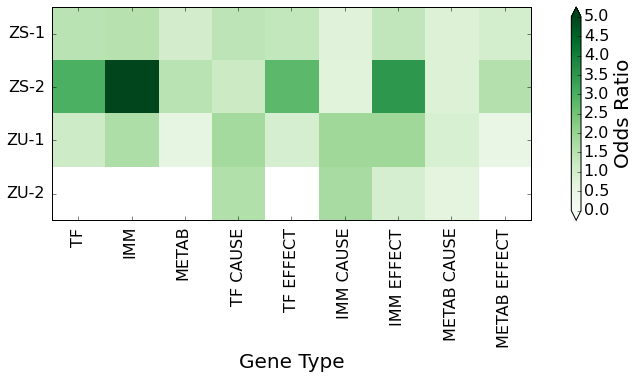

In [60]:
max_genes_odds_thresh = 5.0
min_genes_odds_thresh = 0.0

annot_genes_odds_filename = os.path.join(base_out_dir, run_type + "_annotated_genes_oddsratios.csv")
annot_genes_odds_plot_filename = os.path.join(base_out_dir, "plots", run_type + "_annotated_genes_oddsratios.pdf")
genes_odds_cols = [x for x in net_summary_df.columns.values if "(OR)" in x and "Gene" in x]
genes_odds_col_names = [x.split(" Genes")[0].upper() for x in genes_odds_cols]
genes_odds_matr = net_summary_df[genes_odds_cols].as_matrix()
names = net_summary_df["Name"]


out_df = net_summary_df[genes_odds_cols]
out_df.index = net_summary_df["Name"]
out_df.to_csv(annot_genes_odds_filename)
print "File saved to", annot_genes_odds_filename



cp.plot_corr_matrix(genes_odds_matr, genes_odds_col_names, ylabels=namelabels, title="", xlabel="Gene Type", ylabel="",
                   max_thresh=max_genes_odds_thresh, min_thresh=min_genes_odds_thresh,
                   filename=annot_genes_odds_plot_filename, figsize=(12, genes_odds_matr.shape[0] + 1), cmap=copy.deepcopy(plt.cm.Greens),
                    rotate_x=True, colorbar_label="Odds Ratio",
                    xticksize=16, yticksize=16, colorbar_ticksize=16,
                   colorbar_labelsize=20,
                   change_x_pad=True, x_pad=8, change_y_pad=True, y_pad=8)

File saved to analysis/priority_annotated_edges_oddsratios.csv
Plot saved to  analysis/plots/priority_annotated_edges_oddsratios.pdf


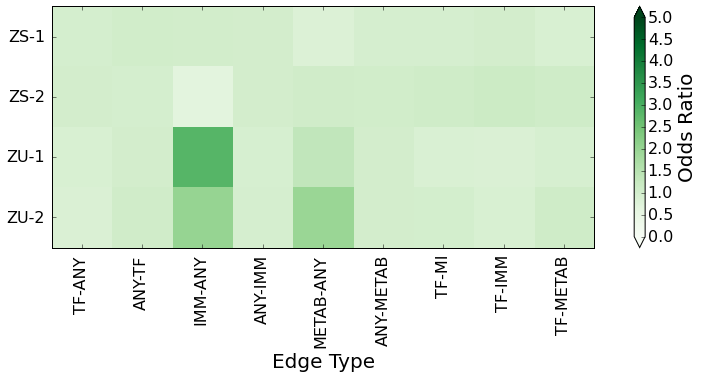

In [61]:
reload(cp)

max_edges_odds_thresh = 5.0
min_edges_odds_thresh = 0.0

annot_edges_odds_filename = os.path.join(base_out_dir, run_type + "_annotated_edges_oddsratios.csv")
annot_edges_odds_plot_filename = os.path.join(base_out_dir, "plots", run_type + "_annotated_edges_oddsratios.pdf")
edges_odds_cols = [x for x in net_summary_df.columns.values if "(OR)" in x and "Edge" in x]
edges_odds_col_names = [x.split(" Edges")[0].upper() for x in edges_odds_cols]
edges_odds_matr = net_summary_df[edges_odds_cols].as_matrix()
names = net_summary_df["Name"]

out_df = net_summary_df[edges_odds_cols]
out_df.index = net_summary_df["Name"]
out_df.to_csv(annot_edges_odds_filename)
print "File saved to", annot_edges_odds_filename


cp.plot_corr_matrix(edges_odds_matr, edges_odds_col_names, ylabels=namelabels, title="", xlabel="Edge Type", ylabel="",
                   max_thresh=max_edges_odds_thresh, min_thresh=min_edges_odds_thresh,
                   filename=annot_edges_odds_plot_filename, figsize=(12, edges_odds_matr.shape[0] + 1), cmap=copy.deepcopy(plt.cm.Greens),
                    colorbar_label="Odds Ratio",
                    xticksize=16, yticksize=16, colorbar_ticksize=16,
                   colorbar_labelsize=20, change_x_pad=True, x_pad=8, change_y_pad=True, y_pad=8)

# Get degree distributions

In [15]:
import scipy.stats as stats

def make_hist(vals_list, xlabel, max_bins=20,  ylabel="Count", title="", savefile=True, save_filename=None,
             do_display=True, remove_top_right_axes=False, zoom_in_bottom_percentile=0, zoom_in_top_percentile=100,
             colors=['b'], do_legend=False, labels=[None], alphas = None):
    
    
    if alphas == None:
        alphas = [1.0 / len(vals_list)] * len(vals_list)
    
    if len(vals_list) == 1:
        all_vals = vals_list[0]
    else:
        all_vals = np.concatenate(tuple(vals_list))
    
    bottom = stats.scoreatpercentile(all_vals, zoom_in_bottom_percentile)
    top = stats.scoreatpercentile(all_vals, zoom_in_top_percentile)
    
    if top - bottom < max_bins:
        bins = np.arange(bottom - 0.5, top + 0.5, 1)
    else:
        bins = np.linspace(bottom - 0.5, top + 0.5, max_bins)
    
    fig = plt.figure()
    ax = fig.add_subplot(1,1,1)
    ax.set_xlim(xmin=bottom - 0.5, xmax=top + 0.5)
    for i in range(len(vals_list)):
        vals = vals_list[i]
        color = colors[i]
        label = labels[i]
        alpha = alphas[i]
        plt.hist([x for x in vals if x >= bottom and x <= top], bins=bins, color=color,
                label=label, alpha=alpha)
        
    plt.xlabel(xlabel, fontsize=20)
    plt.ylabel(ylabel, fontsize=20)
    plt.title(title, fontsize=25)
    plt.tick_params(labelsize=12)
    if remove_top_right_axes:
        ax.spines['top'].set_color('none')
        ax.spines['right'].set_color('none')
        ax.tick_params(right=False, top=False)
    if do_legend:
        plt.legend(loc="best")
    plt.tight_layout()
    if savefile:
        assert save_filename != None
        fig.savefig(save_filename)
    if do_display:
        plt.show()
    plt.close()
    
    
    

In [19]:
out_deg_dfs[0]["In-Degree"].values[1:100]

array([1, 0, 2, 1, 1, 0, 0, 3, 0, 1, 1, 0, 2, 3, 0, 1, 1, 0, 0, 0, 1, 1, 1,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1,
       0, 0, 1, 1, 4, 1, 1, 1, 1, 2, 1, 2, 2, 2, 1, 1, 2, 1, 1, 1, 1, 1, 3,
       1, 2, 1, 1, 1, 1, 3, 1, 2, 1, 1, 1, 2, 1, 2, 1, 1, 4, 1, 2, 1, 2, 2,
       1, 1, 1, 1, 1, 1, 1])

In [20]:
out_deg_dfs[0].head()

,Gene,Gene Symbol,Out-Degree,In-Degree,TF,Immune,Metabolism,Summary,Out-Degree:TF,Out-Degree:TF (%),...,Out-Degree:Metabolism (% IM),In-Degree:TF,In-Degree:TF (%),In-Degree:Immune-Metabolism,In-Degree:Immune,In-Degree:Immune (%),In-Degree:Immune (% IM),In-Degree:Metabolism,In-Degree:Metabolism (%),In-Degree:Metabolism (% IM)
0,ENSG00000157514.15,TSC22D3,629,5,1,0,0,"TF-Bioguo,",60,9.5,...,55.8,2,40.0,1,0,0.0,0.0,1,20.0,100.0
1,ENSG00000141750.6,STAC2,333,1,0,0,0,NaN,26,7.8,...,63.0,1,100.0,0,0,0.0,0.0,0,0.0,0.0
2,ENSG00000135094.9,SDS,187,0,0,0,1,"Metabolism-gluc_GSEA,",11,5.9,...,45.5,0,0.0,0,0,0.0,0.0,0,0.0,0.0
3,ENSG00000167772.10,ANGPTL4,140,2,0,0,1,"GR_direct,Metabolism-gluc_GSEA,Metabolism-lipi...",8,5.7,...,50.0,1,50.0,0,0,0.0,0.0,0,0.0,0.0
4,ENSG00000171522.5,PTGER4,125,1,0,1,0,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",9,7.2,...,100.0,0,0.0,0,0,0.0,0.0,0,0.0,0.0


In [18]:
out_deg_dfs[0]["Out-Degree"].values[1:100]

array([333, 187, 140, 125, 110,  81,  74,  71,  41,  40,  31,  31,  23,
        23,  21,  20,  16,  16,  12,  11,   8,   8,   8,   7,   6,   5,
         5,   5,   4,   3,   3,   3,   3,   3,   2,   2,   2,   2,   2,
         2,   1,   1,   1,   1,   1,   1,   1,   1,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0])

integration_0mean-unnormalized_enet-1
Out-degrees:


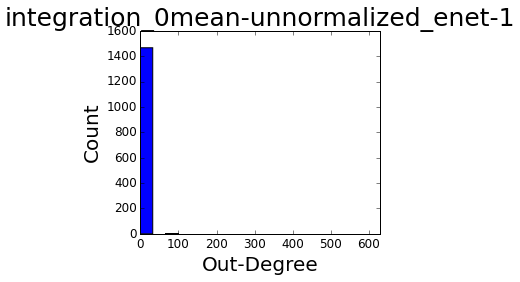

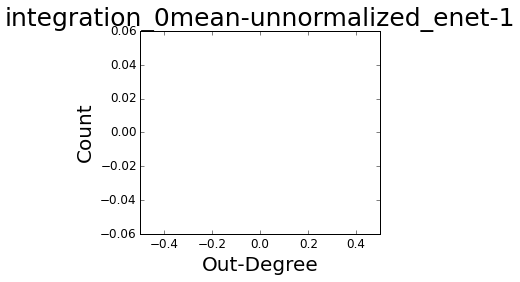

integration_0mean-unnormalized_enet-1
In-degrees:


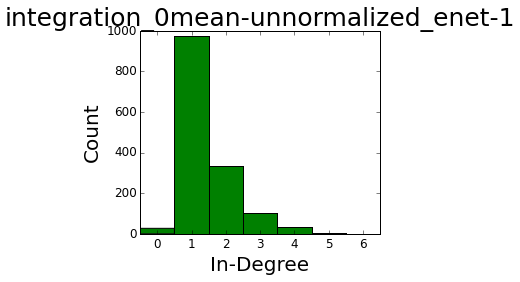

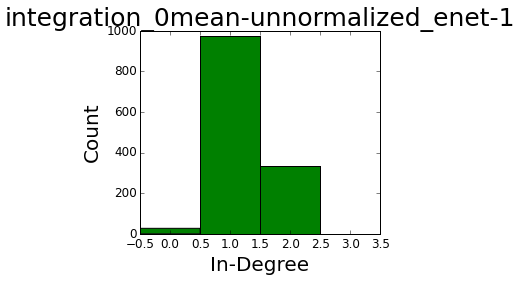

orig_0mean-1var_enet-1
Out-degrees:


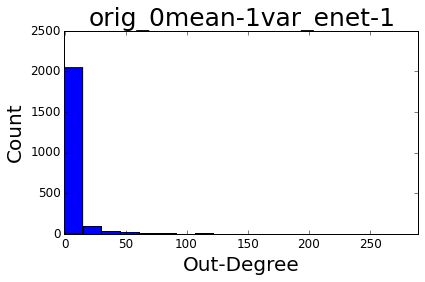

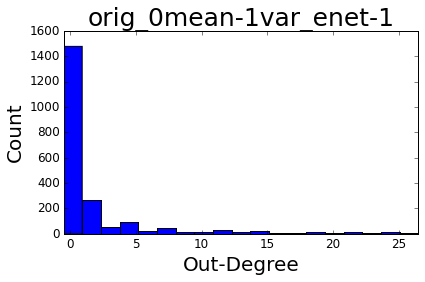

orig_0mean-1var_enet-1
In-degrees:


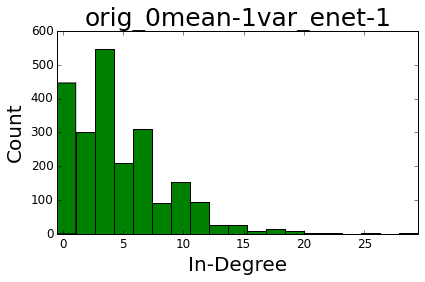

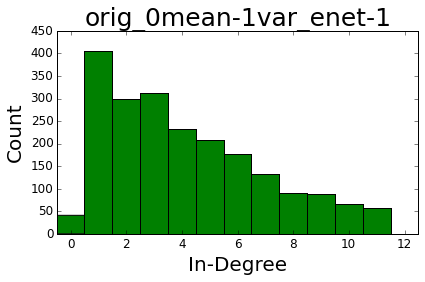

orig_0mean-1var_enet-2
Out-degrees:


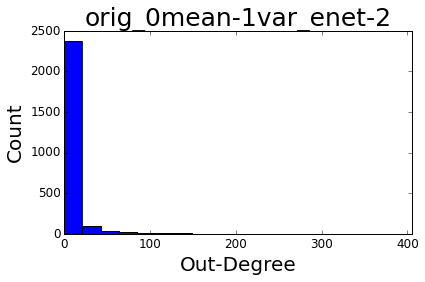

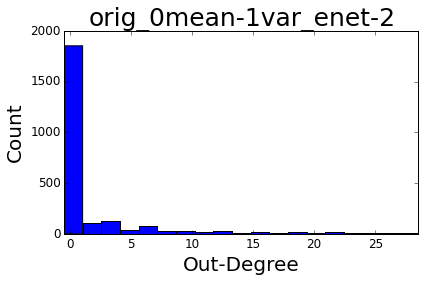

orig_0mean-1var_enet-2
In-degrees:


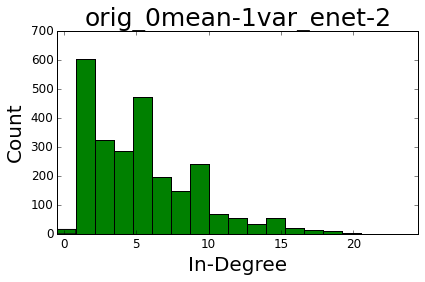

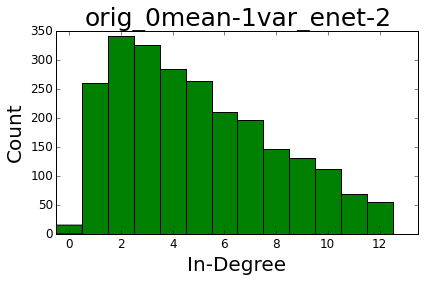

orig_0mean-unnormalized_enet-1
Out-degrees:


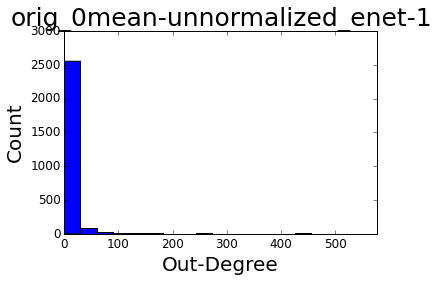

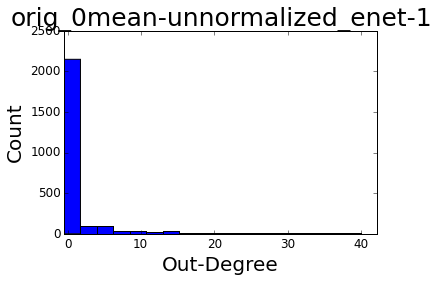

orig_0mean-unnormalized_enet-1
In-degrees:


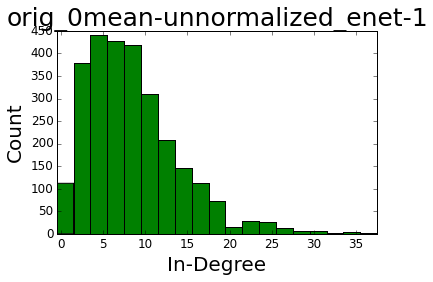

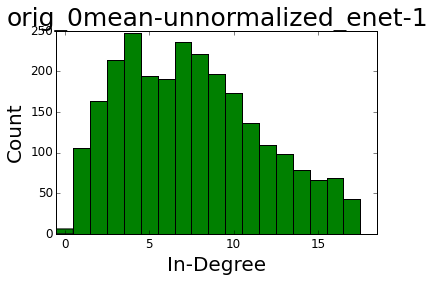

orig_0mean-unnormalized_enet-2
Out-degrees:


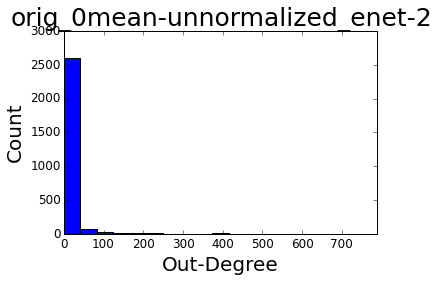

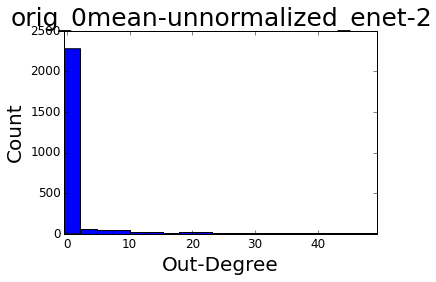

orig_0mean-unnormalized_enet-2
In-degrees:


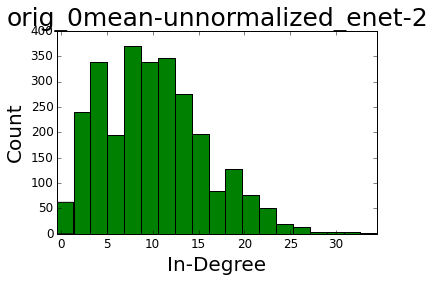

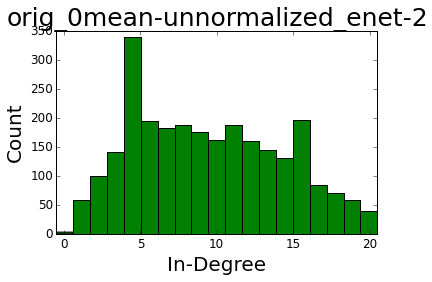

In [16]:
for name, out_deg_df, in_deg_df, name_plot_folder in zip(names, out_deg_dfs, in_deg_dfs, name_plot_folders):

    out_deg_min = 0
    out_deg_max = 800
    bins = 20
    
    degree_folder = os.path.join(name_plot_folder, "degrees")
    if not os.path.exists(degree_folder):
        os.makedirs(degree_folder)
    
    out_deg_plot_filename = os.path.join(degree_folder, name + "_Out-Degrees.pdf")
    in_deg_plot_filename = os.path.join(degree_folder, name + "_In-Degrees.pdf")
    
    
    print name
    print "Out-degrees:"
    make_hist([out_deg_df["Out-Degree"].values], xlabel="Out-Degree", title=name, save_filename=out_deg_plot_filename,
             colors=["b"])
    make_hist([out_deg_df["Out-Degree"].values], xlabel="Out-Degree", title=name, zoom_in_top_percentile=95, save_filename=out_deg_plot_filename[:-4] + "-zoom-in-bottom-95.pdf",
             colors=["b"])
    
    make_hist([out_deg_df["Out-Degree"].values], xlabel="Out-Degree", 
              save_filename=out_deg_plot_filename[:-4] + "_for-paper.pdf", remove_top_right_axes=True, do_display=False,
             colors=["b"])
    make_hist([out_deg_df["Out-Degree"].values], xlabel="Out-Degree", zoom_in_top_percentile=95, save_filename=out_deg_plot_filename[:-4] + "-zoom-in-bottom-95_for-paper.pdf",
             remove_top_right_axes=True, do_display=False, colors=["b"])
    
    
    
    print name
    print "In-degrees:"
    make_hist([in_deg_df["In-Degree"].values], xlabel="In-Degree", title=name, save_filename=in_deg_plot_filename,
             colors=["g"])
    make_hist([in_deg_df["In-Degree"].values], xlabel="In-Degree", title=name, zoom_in_top_percentile=95, save_filename=in_deg_plot_filename[:-4] + "-zoom-in-bottom-95.pdf",
             colors=["g"])
    
    make_hist([in_deg_df["In-Degree"].values], xlabel="In-Degree",
              save_filename=in_deg_plot_filename[:-4] + "_for-paper.pdf", remove_top_right_axes=True, do_display=False,
             colors=["g"])
    make_hist([in_deg_df["In-Degree"].values], xlabel="In-Degree",  zoom_in_top_percentile=95, save_filename=in_deg_plot_filename[:-4] + "-zoom-in-bottom-95_for-paper.pdf",
             remove_top_right_axes=True, do_display=False, colors=["g"])

# Subnetworks

In [21]:
# Subnetworks

# can assume already top

# tf_any_odds_ratios = []
# any_tf_odds_ratios = []
# imm_any_odds_ratios = []
# any_imm_odds_ratios = []
# metab_any_odds_ratios = []
# any_metab_odds_ratios = []

hg_tf_imm_metab_union_nets = []



for name, net, out_dir in zip(names, nets, out_dirs):
    
    sub_out_dir = os.path.join(out_dir, "subnetworks")
    
    if not os.path.exists(sub_out_dir):
        os.makedirs(sub_out_dir)
        
    # net should be sorted!
    any_any_file = os.path.join(sub_out_dir, name + "-any-any.txt")
    any_any_net = net
    any_any_net.to_csv(any_any_file, sep="\t", index=False)
    
    tf_any_file = os.path.join(sub_out_dir, name + "-tf-any.txt")
    tf_any_net = net[net["Cause"].isin(tf_genes)]
    tf_any_net.to_csv(tf_any_file, sep="\t", index=False)
    
    imm_any_file = os.path.join(sub_out_dir, name + "-imm-any.txt")
    imm_any_net = net[net["Cause"].isin(imm_genes)]
    imm_any_net.to_csv(imm_any_file, sep="\t", index=False)
    
    metab_any_file = os.path.join(sub_out_dir, name + "-metab-any.txt")
    metab_any_net = net[net["Cause"].isin(metab_genes)]
    metab_any_net.to_csv(metab_any_file, sep="\t", index=False)
    
    
    any_tf_file = os.path.join(sub_out_dir, name + "-any-tf.txt")
    any_tf_net = net[net["Effect"].isin(tf_genes)]
    any_tf_net.to_csv(any_tf_file, sep="\t", index=False)
    
    any_imm_file = os.path.join(sub_out_dir, name + "-any-imm.txt")
    any_imm_net = net[net["Effect"].isin(imm_genes)]
    any_imm_net.to_csv(any_imm_file, sep="\t", index=False)
    
    any_metab_file = os.path.join(sub_out_dir, name + "-any-metab.txt")
    any_metab_net = net[net["Effect"].isin(metab_genes)]
    any_metab_net.to_csv(any_metab_file, sep="\t", index=False)
    
    
    any_imm_file = os.path.join(sub_out_dir, name + "-any-imm.txt")
    any_imm_net = net[net["Effect"].isin(imm_genes)]
    any_imm_net.to_csv(any_imm_file, sep="\t", index=False)
    
    tf_imm_file = os.path.join(sub_out_dir, name + "-tf-imm.txt")
    tf_imm_net = net[np.logical_and(net["Cause"].isin(tf_genes), net["Effect"].isin(imm_genes))]
    tf_imm_net.to_csv(tf_imm_file, sep="\t", index=False)
    
    tf_metab_file = os.path.join(sub_out_dir, name + "-tf-metab.txt")
    tf_metab_net = net[np.logical_and(net["Cause"].isin(tf_genes), net["Effect"].isin(metab_genes))]
    tf_metab_net.to_csv(tf_metab_file, sep="\t", index=False)
    
    tf_imm_metab_union_file = os.path.join(sub_out_dir, name + "-tf-immUmetab.txt")
    tf_imm_metab_union_net = net[np.logical_and(net["Cause"].isin(tf_genes), net["Effect"].isin(imm_metab_union_genes))]
    tf_imm_metab_union_net.to_csv(tf_imm_metab_union_file, sep="\t", index=False)
    
    
    hg_tf_imm_metab_union_file = os.path.join(sub_out_dir, name + "-tf-immUmetab-hg.txt")
    hg_tf_imm_metab_union_net = net[np.logical_and(net["Cause"].isin(tf_genes), net["Effect"].isin(imm_metab_union_genes))]
    hg_tf_imm_metab_union_net["Cause"] = [nh.ensg2hg(x) for x in hg_tf_imm_metab_union_net["Cause"].values]
    hg_tf_imm_metab_union_net["Effect"] = [nh.ensg2hg(x) for x in hg_tf_imm_metab_union_net["Effect"].values]
    hg_tf_imm_metab_union_net.to_csv(hg_tf_imm_metab_union_file, sep="\t", index=False)
    
    print "Subnetworks written to ", sub_out_dir
    
    
    


/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:73: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


Subnetworks written to  analysis/integration_0mean-unnormalized_enet-1/subnetworks
Subnetworks written to  analysis/orig_0mean-1var_enet-1/subnetworks
Subnetworks written to  analysis/orig_0mean-1var_enet-2/subnetworks
Subnetworks written to  analysis/orig_0mean-unnormalized_enet-1/subnetworks
Subnetworks written to  analysis/orig_0mean-unnormalized_enet-2/subnetworks


# TF-Causal Interesting Edge Subnetworks

In [22]:

tf_interest_out_dir = os.path.join("analysis", "tf-interesting-edge-networks")

tf_imm_out_dir = os.path.join(tf_interest_out_dir, "tf-imm")
tf_metab_out_dir = os.path.join(tf_interest_out_dir, "tf-metab")
tf_tf_out_dir = os.path.join(tf_interest_out_dir, "tf-tf")

if not os.path.exists(tf_interest_out_dir):
    os.makedirs(tf_interest_out_dir)
if not os.path.exists(tf_imm_out_dir):
    os.makedirs(tf_imm_out_dir)
if not os.path.exists(tf_metab_out_dir):
    os.makedirs(tf_metab_out_dir)
if not os.path.exists(tf_tf_out_dir):
    os.makedirs(tf_tf_out_dir)

    
print "Writing to ", tf_interest_out_dir

Writing to  analysis/tf-interesting-edge-networks


In [23]:


for name, net in zip(names, nets):
    tf_tf_file = os.path.join(tf_tf_out_dir, name + "-tf-tf.txt")
    tf_tf_net = net[np.logical_and(net["Cause"].isin(tf_genes), net["Effect"].isin(tf_genes))]
    tf_tf_net.to_csv(tf_tf_file, sep="\t", index=False)
    
    tf_imm_file = os.path.join(tf_imm_out_dir, name + "-tf-imm.txt")
    tf_imm_net = net[np.logical_and(net["Cause"].isin(tf_genes), net["Effect"].isin(imm_genes))]
    tf_imm_net.to_csv(tf_imm_file, sep="\t", index=False)
    
    tf_metab_file = os.path.join(tf_metab_out_dir, name + "-tf-metab.txt")
    tf_metab_net = net[np.logical_and(net["Cause"].isin(tf_genes), net["Effect"].isin(metab_genes))]
    tf_metab_net.to_csv(tf_metab_file, sep="\t", index=False)
    
    print "**************"
    print name
    print "**************"
    print 

    print tf_tf_file
    print tf_imm_file
    print tf_metab_file


**************
integration_0mean-unnormalized_enet-1
**************

analysis/tf-interesting-edge-networks/tf-tf/integration_0mean-unnormalized_enet-1-tf-tf.txt
analysis/tf-interesting-edge-networks/tf-imm/integration_0mean-unnormalized_enet-1-tf-imm.txt
analysis/tf-interesting-edge-networks/tf-metab/integration_0mean-unnormalized_enet-1-tf-metab.txt
**************
orig_0mean-1var_enet-1
**************

analysis/tf-interesting-edge-networks/tf-tf/orig_0mean-1var_enet-1-tf-tf.txt
analysis/tf-interesting-edge-networks/tf-imm/orig_0mean-1var_enet-1-tf-imm.txt
analysis/tf-interesting-edge-networks/tf-metab/orig_0mean-1var_enet-1-tf-metab.txt
**************
orig_0mean-1var_enet-2
**************

analysis/tf-interesting-edge-networks/tf-tf/orig_0mean-1var_enet-2-tf-tf.txt
analysis/tf-interesting-edge-networks/tf-imm/orig_0mean-1var_enet-2-tf-imm.txt
analysis/tf-interesting-edge-networks/tf-metab/orig_0mean-1var_enet-2-tf-metab.txt
**************
orig_0mean-unnormalized_enet-1
**************


### Top several causal genes
* top out-degree
* top immune effects
* top % immune effects
* top metab effects
* top % metab effects

In [24]:
# c means cause, e means effet
sort_col_types = [("Out-Degree", 'c'), 
                  
                  ("Out-Degree:TF", 'c'),
                  ("Out-Degree:TF (%)", 'c'),
                  ("Out-Degree:Immune-Metabolism", 'c'),
                  
                  ("Out-Degree:Immune", 'c'),
                  ("Out-Degree:Immune (%)", 'c'),
                  ("Out-Degree:Immune (% IM)", 'c'),
                  
                  ("Out-Degree:Metabolism", 'c'),
                  ("Out-Degree:Metabolism (%)", 'c'),
                  ("Out-Degree:Metabolism (% IM)", 'c'),
                
                  
                  ("In-Degree", 'e'),
                  
                  ("In-Degree:TF", 'e'),
                  ("In-Degree:TF (%)", 'e'),
                  ("In-Degree:Immune-Metabolism", 'e'),
                  
                  ("In-Degree:Immune", 'e'),
                  ("In-Degree:Immune (%)", 'e'),
                  ("In-Degree:Immune (% IM)", 'e'),
                  
                  ("In-Degree:Metabolism", 'e'),
                  ("In-Degree:Metabolism (%)", 'e'),
                  ("In-Degree:Metabolism (% IM)", 'e')
                 ]


top_gene_num = 3

top_gene_dirs = [os.path.join(out_dir, "top-genes") for out_dir in out_dirs]

for top_gene_dir in top_gene_dirs:
    !mkdir $top_gene_dir
    !echo "Directory made: " $top_gene_dir
    

Directory made:  analysis/integration_0mean-unnormalized_enet-1/top-genes
Directory made:  analysis/orig_0mean-1var_enet-1/top-genes
Directory made:  analysis/orig_0mean-1var_enet-2/top-genes
Directory made:  analysis/orig_0mean-unnormalized_enet-1/top-genes
Directory made:  analysis/orig_0mean-unnormalized_enet-2/top-genes


In [25]:
top_gene_summary_dfs = []

for name, cause_df, effect_df, top_gene_dir, i in zip(names, cause_dfs, effect_dfs, top_gene_dirs,
                                                     range(len(names))):

    top_gene_summary_dict = collections.OrderedDict()
    
    print "*************"
    print name
    print "*************"
    
    
    raw_out_dir = os.path.join(top_gene_dir, "Gene")
    if not os.path.exists(raw_out_dir):
        os.makedirs(raw_out_dir)
        
    for sort_col, node_type in sort_col_types:
        
        if node_type == 'c':
            top_gene_df = cause_df.sort_values(sort_col, ascending=False)
            
        elif node_type == 'e':
            top_gene_df = effect_df.sort_values(sort_col, ascending=False)
                
        else:
            raise ValueError("sort col types must be c (cause) or e (effect)")

        sort_val = top_gene_df.pop(sort_col)

        top_gene_df.insert(1, sort_col, sort_val)

        top_gene_df = top_gene_df.rename(columns = {"Gene Symbol": "Gene by " + str(sort_col)})
        top_gene_df = top_gene_df.rename(columns = {"Summary": "Gene by " + str(sort_col) + "; annotation"})


        out_file = os.path.join(raw_out_dir, name + "_" + sort_col + ".csv")


        top_gene_df[["Gene by " + str(sort_col), sort_col, "Gene by " + str(sort_col) + "; annotation"]].to_csv(out_file, index=False)

        if len(top_gene_df.head(top_gene_num)) < top_gene_num:
            a = np.empty(top_gene_num -  len(top_gene_df.head(top_gene_num)))
            a[:] = np.NaN

            empty_df = pd.DataFrame()
            for col in top_gene_df.columns.values:
                empty_df[col] = a
            print "EMTPY DF created: "
            #display(empty_df)
            top_gene_df = top_gene_df.append(empty_df)

        top_gene_summary_dict["Gene by " + str(sort_col)] = top_gene_df["Gene by " + str(sort_col)].head(top_gene_num).values
        top_gene_summary_dict[sort_col] = top_gene_df[sort_col].head(top_gene_num).values
        top_gene_summary_dict["Gene by " + str(sort_col) + "; annotation"] = top_gene_df["Gene by " + str(sort_col) + "; annotation"].head(top_gene_num).values
   
    
    top_gene_summary_df = pd.DataFrame(top_gene_summary_dict)

    
    out_file = os.path.join(top_gene_dir,  name + "_sorted-genes_top-" + str(top_gene_num ) + ".csv")

    cols = [x for x in top_gene_summary_df.columns.values if "%" not in x]

    top_gene_summary_df[cols].to_csv(out_file, index=False)

    
    outdeg_out_file = out_file[:-4] + "-out-degrees.csv"
    outdeg_cols = [x for x in cols if "Out-Degree" in x and "Immune-Metabolism" not in x]
    top_gene_summary_df[outdeg_cols].to_csv(outdeg_out_file, index=False)
    
    outdeg_out_file = out_file[:-4] + "-in-degrees.csv"
    outdeg_cols = [x for x in cols if "In-Degree" in x and "Immune-Metabolism" not in x]
    top_gene_summary_df[outdeg_cols].to_csv(outdeg_out_file, index=False)
    
    
    print "Summary for all tops written to ", out_file   
    display(top_gene_summary_df[cols])
    display(top_gene_summary_df)

    
os.system("say 'top genes done'")

*************
integration_0mean-unnormalized_enet-1
*************
Summary for all tops written to  analysis/integration_0mean-unnormalized_enet-1/top-genes/integration_0mean-unnormalized_enet-1_sorted-genes_top-3.csv


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:Immune-Metabolism,Out-Degree:Immune-Metabolism,Gene by Out-Degree:Immune-Metabolism; annotation,Gene by Out-Degree:Immune,...,Gene by In-Degree:TF; annotation,Gene by In-Degree:Immune-Metabolism,In-Degree:Immune-Metabolism,Gene by In-Degree:Immune-Metabolism; annotation,Gene by In-Degree:Immune,In-Degree:Immune,Gene by In-Degree:Immune; annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation
0,TSC22D3,629,"TF-Bioguo,",TSC22D3,60,"TF-Bioguo,",TSC22D3,43,"TF-Bioguo,",TSC22D3,...,"GR_GSEA,",LPIN1,4,NaN,ABCC2,2,NaN,LPIN1,3,NaN
1,STAC2,333,NaN,STAC2,26,NaN,STAC2,27,NaN,STAC2,...,NaN,MAT2A,2,"GR_direct,",LPIN1,2,NaN,STAT6,2,"TF-Bioguo,Immune_GOC-8,Immune_GOC-7,Immune_GOC..."
2,SDS,187,"Metabolism-gluc_GSEA,",SDS,11,"Metabolism-gluc_GSEA,",SDS,11,"Metabolism-gluc_GSEA,",CIDEC,...,NaN,SMC2,2,NaN,MAT2A,2,"GR_direct,",ORC3,2,NaN


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:TF (%),Out-Degree:TF (%),Gene by Out-Degree:TF (%); annotation,Gene by Out-Degree:Immune-Metabolism,...,Gene by In-Degree:Immune (% IM); annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation,Gene by In-Degree:Metabolism (%),In-Degree:Metabolism (%),Gene by In-Degree:Metabolism (%); annotation,Gene by In-Degree:Metabolism (% IM),In-Degree:Metabolism (% IM),Gene by In-Degree:Metabolism (% IM); annotation
0,TSC22D3,629,"TF-Bioguo,",TSC22D3,60,"TF-Bioguo,",MFSD2A,100.0,NaN,TSC22D3,...,NaN,LPIN1,3,NaN,LMNB1,100.0,NaN,NUP93,100.0,NaN
1,STAC2,333,NaN,STAC2,26,NaN,RAP1GAP,66.7,NaN,STAC2,...,NaN,STAT6,2,"TF-Bioguo,Immune_GOC-8,Immune_GOC-7,Immune_GOC...",SMPD1,100.0,NaN,ESCO2,100.0,NaN
2,SDS,187,"Metabolism-gluc_GSEA,",SDS,11,"Metabolism-gluc_GSEA,",GDF15,50.0,NaN,SDS,...,"GR_direct,",ORC3,2,NaN,KBTBD2,100.0,NaN,STIL,100.0,NaN


*************
orig_0mean-1var_enet-1
*************
Summary for all tops written to  analysis/orig_0mean-1var_enet-1/top-genes/orig_0mean-1var_enet-1_sorted-genes_top-3.csv


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:Immune-Metabolism,Out-Degree:Immune-Metabolism,Gene by Out-Degree:Immune-Metabolism; annotation,Gene by Out-Degree:Immune,...,Gene by In-Degree:TF; annotation,Gene by In-Degree:Immune-Metabolism,In-Degree:Immune-Metabolism,Gene by In-Degree:Immune-Metabolism; annotation,Gene by In-Degree:Immune,In-Degree:Immune,Gene by In-Degree:Immune; annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation
0,CTU2,289,NaN,DHRS4,27,NaN,CTU2,33,NaN,CTU2,...,"Immune_GOC-5,Immune_GOC-4,",CGN,5,NaN,CCL26,3,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",CGN,3,NaN
1,DHRS4,190,NaN,CTU2,16,NaN,DHRS4,18,NaN,FSIP1,...,NaN,MRPS25,4,NaN,ZNF22,3,"TF-Bioguo,",CDC42EP1,3,NaN
2,FSIP1,167,NaN,SFXN2,13,NaN,FSIP1,17,NaN,ZFYVE27,...,NaN,ZNF22,4,"TF-Bioguo,",CAV1,2,NaN,AZI2,2,NaN


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:TF (%),Out-Degree:TF (%),Gene by Out-Degree:TF (%); annotation,Gene by Out-Degree:Immune-Metabolism,...,Gene by In-Degree:Immune (% IM); annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation,Gene by In-Degree:Metabolism (%),In-Degree:Metabolism (%),Gene by In-Degree:Metabolism (%); annotation,Gene by In-Degree:Metabolism (% IM),In-Degree:Metabolism (% IM),Gene by In-Degree:Metabolism (% IM); annotation
0,CTU2,289,NaN,DHRS4,27,NaN,ZNF302,100.0,"TF-Bioguo,",CTU2,...,NaN,CGN,3,NaN,FAM114A2,100.0,NaN,IQCK,100.0,NaN
1,DHRS4,190,NaN,CTU2,16,NaN,ULK3,100.0,NaN,DHRS4,...,NaN,CDC42EP1,3,NaN,ABHD12,100.0,NaN,POLL,100.0,NaN
2,FSIP1,167,NaN,SFXN2,13,NaN,PDDC1,100.0,NaN,FSIP1,...,NaN,AZI2,2,NaN,C5orf28,100.0,NaN,COL4A6,100.0,NaN


*************
orig_0mean-1var_enet-2
*************
Summary for all tops written to  analysis/orig_0mean-1var_enet-2/top-genes/orig_0mean-1var_enet-2_sorted-genes_top-3.csv


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:Immune-Metabolism,Out-Degree:Immune-Metabolism,Gene by Out-Degree:Immune-Metabolism; annotation,Gene by Out-Degree:Immune,...,Gene by In-Degree:TF; annotation,Gene by In-Degree:Immune-Metabolism,In-Degree:Immune-Metabolism,Gene by In-Degree:Immune-Metabolism; annotation,Gene by In-Degree:Immune,In-Degree:Immune,Gene by In-Degree:Immune; annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation
0,SLC16A5,405,NaN,SLC16A5,26,NaN,MOXD1,38,NaN,MOXD1,...,"TF-binding_GO,",BTAF1,5,NaN,DOPEY2,2,NaN,CYP26A1,4,NaN
1,MOXD1,319,NaN,IGFBP4,24,"GR_direct,Diabetes_GSEA,",SLC16A5,34,NaN,IFITM3,...,NaN,CYP26A1,4,NaN,TRIB1,2,"TF-binding_GO,",C19orf54,4,NaN
2,ELMO3,309,"Immune_GOC-5,Immune_GOC-4,",MOXD1,23,NaN,KCNK5,29,NaN,IGFBP4,...,NaN,C19orf54,4,NaN,CCL26,2,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",KIF12,4,NaN


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:TF (%),Out-Degree:TF (%),Gene by Out-Degree:TF (%); annotation,Gene by Out-Degree:Immune-Metabolism,...,Gene by In-Degree:Immune (% IM); annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation,Gene by In-Degree:Metabolism (%),In-Degree:Metabolism (%),Gene by In-Degree:Metabolism (%); annotation,Gene by In-Degree:Metabolism (% IM),In-Degree:Metabolism (% IM),Gene by In-Degree:Metabolism (% IM); annotation
0,SLC16A5,405,NaN,SLC16A5,26,NaN,ENGASE,100.0,NaN,MOXD1,...,NaN,CYP26A1,4,NaN,BRIX1,100.0,NaN,EMC2,100.0,NaN
1,MOXD1,319,NaN,IGFBP4,24,"GR_direct,Diabetes_GSEA,",SYVN1,100.0,"Diabetes_GSEA,",SLC16A5,...,NaN,C19orf54,4,NaN,TPPP,100.0,NaN,PTPN6,100.0,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_..."
2,ELMO3,309,"Immune_GOC-5,Immune_GOC-4,",MOXD1,23,NaN,TMEM150A,100.0,NaN,KCNK5,...,NaN,KIF12,4,NaN,ARID4A,100.0,"TF-Bioguo,DNA-binding_GO,",ZHX3,100.0,"TF-Bioguo,"


*************
orig_0mean-unnormalized_enet-1
*************
Summary for all tops written to  analysis/orig_0mean-unnormalized_enet-1/top-genes/orig_0mean-unnormalized_enet-1_sorted-genes_top-3.csv


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:Immune-Metabolism,Out-Degree:Immune-Metabolism,Gene by Out-Degree:Immune-Metabolism; annotation,Gene by Out-Degree:Immune,...,Gene by In-Degree:TF; annotation,Gene by In-Degree:Immune-Metabolism,In-Degree:Immune-Metabolism,Gene by In-Degree:Immune-Metabolism; annotation,Gene by In-Degree:Immune,In-Degree:Immune,Gene by In-Degree:Immune; annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation
0,CEACAM6,577,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",C11orf91,47,"GR_direct,",C11orf91,46,"GR_direct,",CEACAM6,...,NaN,NAP1L2,7,NaN,DMRTA1,6,"TF-Bioguo,",IGFBP4,5,"GR_direct,Diabetes_GSEA,"
1,HPDL,442,NaN,LBP,46,"Immune_GOC-5,Immune_GOC-4,",CEACAM6,40,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",C11orf91,...,"GR_direct,TF-Bioguo,",KIAA0195,7,NaN,NAP1L2,5,NaN,CGN,4,NaN
2,PHLDA2,442,NaN,POU5F1,41,"GR_direct,TF-Bioguo,DNA-binding_GO,",OLR1,36,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Imm...",LBP,...,"GR_direct,",VPS39,6,NaN,CD47,5,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",CALCOCO2,3,NaN


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:TF (%),Out-Degree:TF (%),Gene by Out-Degree:TF (%); annotation,Gene by Out-Degree:Immune-Metabolism,...,Gene by In-Degree:Immune (% IM); annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation,Gene by In-Degree:Metabolism (%),In-Degree:Metabolism (%),Gene by In-Degree:Metabolism (%); annotation,Gene by In-Degree:Metabolism (% IM),In-Degree:Metabolism (% IM),Gene by In-Degree:Metabolism (% IM); annotation
0,CEACAM6,577,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",C11orf91,47,"GR_direct,",CEBPD,100.0,"GR_direct,TF-Bioguo,",C11orf91,...,NaN,IGFBP4,5,"GR_direct,Diabetes_GSEA,",CDCA8,100.0,"Chrom-org_GO,",MAPK8IP1,100.0,NaN
1,HPDL,442,NaN,LBP,46,"Immune_GOC-5,Immune_GOC-4,",CDK5R1,100.0,"GR_GSEA,",CEACAM6,...,NaN,CGN,4,NaN,LOXL2,100.0,NaN,TRIP13,100.0,NaN
2,PHLDA2,442,NaN,POU5F1,41,"GR_direct,TF-Bioguo,DNA-binding_GO,",IQCK,100.0,NaN,OLR1,...,NaN,CALCOCO2,3,NaN,RFWD3,100.0,NaN,FKBP4,100.0,"GR_GSEA,"


*************
orig_0mean-unnormalized_enet-2
*************
Summary for all tops written to  analysis/orig_0mean-unnormalized_enet-2/top-genes/orig_0mean-unnormalized_enet-2_sorted-genes_top-3.csv


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:Immune-Metabolism,Out-Degree:Immune-Metabolism,Gene by Out-Degree:Immune-Metabolism; annotation,Gene by Out-Degree:Immune,...,Gene by In-Degree:TF; annotation,Gene by In-Degree:Immune-Metabolism,In-Degree:Immune-Metabolism,Gene by In-Degree:Immune-Metabolism; annotation,Gene by In-Degree:Immune,In-Degree:Immune,Gene by In-Degree:Immune; annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation
0,HIST1H4A,789,"DNA-binding_GO,Hist-binding_GO,",HIST2H2AB,60,NaN,ANGPTL4,67,"GR_direct,Metabolism-gluc_GSEA,Metabolism-lipi...",ANGPTL4,...,NaN,FGG,7,"GR_GSEA,Immune_GOC-5,Immune_GOC-4,",LINS,6,NaN,HOMEZ,5,"TF-Bioguo,"
1,HIST2H2AB,694,NaN,HIST1H4A,55,"DNA-binding_GO,Hist-binding_GO,",HIST2H2AB,66,NaN,HIST2H2AB,...,"TF-Bioguo,",GLG1,6,NaN,FGG,5,"GR_GSEA,Immune_GOC-5,Immune_GOC-4,",RGL1,4,NaN
2,ANGPTL4,615,"GR_direct,Metabolism-gluc_GSEA,Metabolism-lipi...",HIST2H3D,52,NaN,HIST1H4A,65,"DNA-binding_GO,Hist-binding_GO,",HIST1H4A,...,NaN,FZD4,6,NaN,ITPKB,5,NaN,POLR3GL,4,NaN


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:TF (%),Out-Degree:TF (%),Gene by Out-Degree:TF (%); annotation,Gene by Out-Degree:Immune-Metabolism,...,Gene by In-Degree:Immune (% IM); annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation,Gene by In-Degree:Metabolism (%),In-Degree:Metabolism (%),Gene by In-Degree:Metabolism (%); annotation,Gene by In-Degree:Metabolism (% IM),In-Degree:Metabolism (% IM),Gene by In-Degree:Metabolism (% IM); annotation
0,HIST1H4A,789,"DNA-binding_GO,Hist-binding_GO,",HIST2H2AB,60,NaN,TSHZ3,100.0,"TF-Bioguo,",ANGPTL4,...,"Immune_GOC-5,Immune_GOC-4,",HOMEZ,5,"TF-Bioguo,",PKMYT1,100.0,NaN,FOSL2,100.0,"GR_direct,TF-Bioguo,"
1,HIST2H2AB,694,NaN,HIST1H4A,55,"DNA-binding_GO,Hist-binding_GO,",DUSP1,100.0,"GR_direct,",HIST2H2AB,...,"TF-Bioguo,",RGL1,4,NaN,BTG2,100.0,NaN,ZNF704,100.0,NaN
2,ANGPTL4,615,"GR_direct,Metabolism-gluc_GSEA,Metabolism-lipi...",HIST2H3D,52,NaN,BCL2L12,100.0,NaN,HIST1H4A,...,"TF-Bioguo,",POLR3GL,4,NaN,WDR62,100.0,NaN,RHOBTB1,100.0,NaN


0

In [26]:
# Same as above, but now stratifying by gene set types


# This will take gene subsets and look at the corresponding TFs, Immune and Metabolic genes
# Column, value it should equal, name
gene_set_types = [("TF", 1, "TF"), ("Immune", 1, "Immune"), ("Metabolism", 1, "Metabolism")]



In [27]:
gene_set_top_gene_summary_dfs = []

for gene_set_col, val, gene_set_name in gene_set_types:
    print "#############################################"    
    print "SUBSET: ", gene_set_name
    print "#############################################"
    
    for name, cause_df, effect_df, top_gene_dir, i in zip(names, cause_dfs, effect_dfs, top_gene_dirs,
                                                         range(len(names))):

        gene_set_top_gene_summary_dict = collections.OrderedDict()

        print "*************"
        print name
        print "*************"

        raw_out_dir = os.path.join(top_gene_dir,  gene_set_name)
        if not os.path.exists(raw_out_dir):
            os.makedirs(raw_out_dir)
        
        for sort_col, node_type in sort_col_types:

            if node_type == 'c':
                gene_set_top_gene_df = cause_df.sort_values(sort_col, ascending=False)

            elif node_type == 'e':
                gene_set_top_gene_df = effect_df.sort_values(sort_col, ascending=False)

            else:
                raise ValueError("sort col types must be c (cause) or e (effect)")

            gene_set_top_gene_df = gene_set_top_gene_df[gene_set_top_gene_df[gene_set_col] == val]
                
                
            sort_val = gene_set_top_gene_df.pop(sort_col)

            gene_set_top_gene_df.insert(1, sort_col, sort_val)

            gene_set_top_gene_df = gene_set_top_gene_df.rename(columns = {"Gene Symbol": "Gene by " + str(sort_col)})
            gene_set_top_gene_df = gene_set_top_gene_df.rename(columns = {"Summary": "Gene by " + str(sort_col) + "; annotation"})
            

            out_file = os.path.join(raw_out_dir, name + "_sorted-" + gene_set_name + "_top-" + str(top_gene_num ) + "_" +  sort_col + ".csv")
            
            
            gene_set_top_gene_df[["Gene by " + str(sort_col), sort_col, "Gene by " + str(sort_col) + "; annotation"]].to_csv(out_file, index=False)
            
#             print gene_set_top_gene_df.index
            #print len(gene_set_top_gene_df.head(top_gene_num))
            if len(gene_set_top_gene_df.head(top_gene_num)) < top_gene_num:
                a = np.empty(top_gene_num -  len(gene_set_top_gene_df.head(top_gene_num)))
                a[:] = np.NaN
                
                empty_df = pd.DataFrame()
                for col in gene_set_top_gene_df.columns.values:
                    empty_df[col] = a
                print "EMTPY DF created: "
                #display(empty_df)
                gene_set_top_gene_df = gene_set_top_gene_df.append(empty_df)
                #display(gene_set_top_gene_df)

            #display(gene_set_top_gene_df[["Gene by " + str(sort_col), sort_col, "Gene by " + str(sort_col) + "; annotation"]].head(top_gene_num))
            gene_set_top_gene_summary_dict["Gene by " + str(sort_col)] = gene_set_top_gene_df["Gene by " + str(sort_col)].head(top_gene_num).values
            gene_set_top_gene_summary_dict[sort_col] = gene_set_top_gene_df[sort_col].head(top_gene_num).values
            gene_set_top_gene_summary_dict["Gene by " + str(sort_col) + "; annotation"] = gene_set_top_gene_df["Gene by " + str(sort_col) + "; annotation"].head(top_gene_num).values

        #print gene_set_top_gene_summary_dict
        gene_set_top_gene_summary_df = pd.DataFrame(gene_set_top_gene_summary_dict)

        out_file = os.path.join(top_gene_dir,  name + "_sorted-" + gene_set_name + "_top-" + str(top_gene_num ) + ".csv")

        
        
        cols = [x for x in gene_set_top_gene_summary_df.columns.values if "%" not in x]
        gene_set_top_gene_summary_df[cols].to_csv(out_file, index=False)
        
        
        outdeg_out_file = out_file[:-4] + "-out-degrees.csv"
        outdeg_cols = [x for x in cols if "Out-Degree" in x and "Immune-Metabolism" not in x]
        gene_set_top_gene_summary_df[outdeg_cols].to_csv(outdeg_out_file, index=False)

        outdeg_out_file = out_file[:-4] + "-in-degrees.csv"
        outdeg_cols = [x for x in cols if "In-Degree" in x and "Immune-Metabolism" not in x]
        gene_set_top_gene_summary_df[outdeg_cols].to_csv(outdeg_out_file, index=False)
   

        print "Summary for all tops written to ", out_file   
        display(gene_set_top_gene_summary_df[cols])
        display(gene_set_top_gene_summary_df)

    
os.system("say 'top genes done'")

#############################################
SUBSET:  TF
#############################################
*************
integration_0mean-unnormalized_enet-1
*************
Summary for all tops written to  analysis/integration_0mean-unnormalized_enet-1/top-genes/integration_0mean-unnormalized_enet-1_sorted-TF_top-3.csv


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:Immune-Metabolism,Out-Degree:Immune-Metabolism,Gene by Out-Degree:Immune-Metabolism; annotation,Gene by Out-Degree:Immune,...,Gene by In-Degree:TF; annotation,Gene by In-Degree:Immune-Metabolism,In-Degree:Immune-Metabolism,Gene by In-Degree:Immune-Metabolism; annotation,Gene by In-Degree:Immune,In-Degree:Immune,Gene by In-Degree:Immune; annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation
0,TSC22D3,629,"TF-Bioguo,",TSC22D3,60,"TF-Bioguo,",TSC22D3,43,"TF-Bioguo,",TSC22D3,...,"TF-Bioguo,DNA-binding_GO,",STAT6,2,"TF-Bioguo,Immune_GOC-8,Immune_GOC-7,Immune_GOC...",ZNF281,1,"TF-Bioguo,",STAT6,2,"TF-Bioguo,Immune_GOC-8,Immune_GOC-7,Immune_GOC..."
1,TFCP2L1,20,"GR_direct,TF-Bioguo,",PRDM1,2,"GR_direct,TF-Bioguo,",BCL6,2,"GR_direct,TF-Bioguo,Immune_GOC-7,Immune_GOC-6,...",BCL6,...,"TF-Bioguo,",RFX5,2,"TF-Bioguo,Immune_GOC-6,Immune_GOC-5,Immune_GOC...",ZNF579,1,"TF-Bioguo,",SMAD6,1,"TF-Bioguo,"
2,FOXO3,16,"GR_direct,TF-Bioguo,DNA-binding_GO,",TFCP2L1,2,"GR_direct,TF-Bioguo,",TFCP2L1,2,"GR_direct,TF-Bioguo,",PRDM1,...,"GR_direct,TF-Bioguo,",SMAD6,1,"TF-Bioguo,",CREB3L2,1,"GR_direct,TF-Bioguo,",HMGB3,1,"TF-Bioguo,"


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:TF (%),Out-Degree:TF (%),Gene by Out-Degree:TF (%); annotation,Gene by Out-Degree:Immune-Metabolism,...,Gene by In-Degree:Immune (% IM); annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation,Gene by In-Degree:Metabolism (%),In-Degree:Metabolism (%),Gene by In-Degree:Metabolism (%); annotation,Gene by In-Degree:Metabolism (% IM),In-Degree:Metabolism (% IM),Gene by In-Degree:Metabolism (% IM); annotation
0,TSC22D3,629,"TF-Bioguo,",TSC22D3,60,"TF-Bioguo,",PRDM1,25.0,"GR_direct,TF-Bioguo,",TSC22D3,...,"TF-Bioguo,",STAT6,2,"TF-Bioguo,Immune_GOC-8,Immune_GOC-7,Immune_GOC...",TSHZ1,100.0,"TF-Bioguo,",SMAD6,100.0,"TF-Bioguo,"
1,TFCP2L1,20,"GR_direct,TF-Bioguo,",PRDM1,2,"GR_direct,TF-Bioguo,",KLF6,12.5,"GR_direct,TF-Bioguo,",BCL6,...,"TF-Bioguo,",SMAD6,1,"TF-Bioguo,",STAT6,100.0,"TF-Bioguo,Immune_GOC-8,Immune_GOC-7,Immune_GOC...",HMGB3,100.0,"TF-Bioguo,"
2,FOXO3,16,"GR_direct,TF-Bioguo,DNA-binding_GO,",TFCP2L1,2,"GR_direct,TF-Bioguo,",TFCP2L1,10.0,"GR_direct,TF-Bioguo,",TFCP2L1,...,"TF-Bioguo,",HMGB3,1,"TF-Bioguo,",TUB,100.0,"TF-Bioguo,",TUB,100.0,"TF-Bioguo,"


*************
orig_0mean-1var_enet-1
*************
Summary for all tops written to  analysis/orig_0mean-1var_enet-1/top-genes/orig_0mean-1var_enet-1_sorted-TF_top-3.csv


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:Immune-Metabolism,Out-Degree:Immune-Metabolism,Gene by Out-Degree:Immune-Metabolism; annotation,Gene by Out-Degree:Immune,...,Gene by In-Degree:TF; annotation,Gene by In-Degree:Immune-Metabolism,In-Degree:Immune-Metabolism,Gene by In-Degree:Immune-Metabolism; annotation,Gene by In-Degree:Immune,In-Degree:Immune,Gene by In-Degree:Immune; annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation
0,RXRB,139,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Obe...",RXRB,12,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Obe...",RXRB,14,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Obe...",RXRB,...,"TF-Bioguo,",ZNF22,4,"TF-Bioguo,",ZNF22,3,"TF-Bioguo,",PIAS3,2,"TF-Bioguo,"
1,ZNF33B,79,"TF-Bioguo,",ZBED2,8,"TF-Bioguo,",ZNF33B,10,"TF-Bioguo,",ZNF33B,...,"TF-Bioguo,",PIAS3,4,"TF-Bioguo,",PIAS3,2,"TF-Bioguo,",ZNF22,2,"TF-Bioguo,"
2,ZNF76,75,"TF-Bioguo,",PRDM1,8,"GR_direct,TF-Bioguo,",ZNF76,5,"TF-Bioguo,",POU5F1,...,"TF-Bioguo,",ZNF724P,2,"TF-Bioguo,",IRX3,2,"TF-Bioguo,",ZHX3,2,"TF-Bioguo,"


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:TF (%),Out-Degree:TF (%),Gene by Out-Degree:TF (%); annotation,Gene by Out-Degree:Immune-Metabolism,...,Gene by In-Degree:Immune (% IM); annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation,Gene by In-Degree:Metabolism (%),In-Degree:Metabolism (%),Gene by In-Degree:Metabolism (%); annotation,Gene by In-Degree:Metabolism (% IM),In-Degree:Metabolism (% IM),Gene by In-Degree:Metabolism (% IM); annotation
0,RXRB,139,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Obe...",RXRB,12,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Obe...",ZNF302,100.0,"TF-Bioguo,",RXRB,...,"GR_GO,TF-Bioguo,DNA-binding_GO,",PIAS3,2,"TF-Bioguo,",HOMEZ,100.0,"TF-Bioguo,",BARX1,100.0,"TF-Bioguo,"
1,ZNF33B,79,"TF-Bioguo,",ZBED2,8,"TF-Bioguo,",BARX1,100.0,"TF-Bioguo,",ZNF33B,...,"TF-Bioguo,",ZNF22,2,"TF-Bioguo,",MLXIP,100.0,"TF-Bioguo,",SOX9,100.0,"TF-Bioguo,"
2,ZNF76,75,"TF-Bioguo,",PRDM1,8,"GR_direct,TF-Bioguo,",ZIC5,100.0,"TF-Bioguo,",ZNF76,...,"TF-Bioguo,",ZHX3,2,"TF-Bioguo,",NFE2L1,50.0,"TF-Bioguo,",ZHX3,100.0,"TF-Bioguo,"


*************
orig_0mean-1var_enet-2
*************
Summary for all tops written to  analysis/orig_0mean-1var_enet-2/top-genes/orig_0mean-1var_enet-2_sorted-TF_top-3.csv


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:Immune-Metabolism,Out-Degree:Immune-Metabolism,Gene by Out-Degree:Immune-Metabolism; annotation,Gene by Out-Degree:Immune,...,Gene by In-Degree:TF; annotation,Gene by In-Degree:Immune-Metabolism,In-Degree:Immune-Metabolism,Gene by In-Degree:Immune-Metabolism; annotation,Gene by In-Degree:Immune,In-Degree:Immune,Gene by In-Degree:Immune; annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation
0,ETS1,86,"TF-Bioguo,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,",TEF,11,"TF-Bioguo,",TEF,10,"TF-Bioguo,",MTF1,...,"TF-Bioguo,",ARX,2,"TF-Bioguo,",HOMEZ,1,"TF-Bioguo,",CEBPD,2,"GR_direct,TF-Bioguo,"
1,TEF,78,"TF-Bioguo,",ETS1,9,"TF-Bioguo,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,",ETS1,8,"TF-Bioguo,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,",TEF,...,"TF-Bioguo,",TSC22D3,2,"TF-Bioguo,",RXRA,1,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Obe...",ZNF740,2,"TF-Bioguo,"
2,ZNF688,71,"TF-Bioguo,",HOXB5,7,"TF-Bioguo,",ZNF688,7,"TF-Bioguo,",ZNF688,...,"TF-Bioguo,",THRA,2,"TF-Bioguo,TF-binding_GO,Immune_GOC-5,Immune_GO...",ZNF189,1,"GR_direct,TF-Bioguo,",RXRB,2,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Obe..."


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:TF (%),Out-Degree:TF (%),Gene by Out-Degree:TF (%); annotation,Gene by Out-Degree:Immune-Metabolism,...,Gene by In-Degree:Immune (% IM); annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation,Gene by In-Degree:Metabolism (%),In-Degree:Metabolism (%),Gene by In-Degree:Metabolism (%); annotation,Gene by In-Degree:Metabolism (% IM),In-Degree:Metabolism (% IM),Gene by In-Degree:Metabolism (% IM); annotation
0,ETS1,86,"TF-Bioguo,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,",TEF,11,"TF-Bioguo,",NRF1,50.0,"TF-Bioguo,",TEF,...,"TF-Bioguo,",CEBPD,2,"GR_direct,TF-Bioguo,",ARID4A,100.0,"TF-Bioguo,DNA-binding_GO,",ZHX3,100.0,"TF-Bioguo,"
1,TEF,78,"TF-Bioguo,",ETS1,9,"TF-Bioguo,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,",ZNF780A,50.0,"TF-Bioguo,",ETS1,...,"TF-Bioguo,",ZNF740,2,"TF-Bioguo,",MXI1,100.0,"TF-Bioguo,Immune_GOC-5,Immune_GOC-4,",ETV4,100.0,"TF-Bioguo,"
2,ZNF688,71,"TF-Bioguo,",HOXB5,7,"TF-Bioguo,",ZNF276,40.0,"TF-Bioguo,",ZNF688,...,"GR_GO,TF-Bioguo,DNA-binding_GO,",RXRB,2,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Obe...",OSR2,50.0,"TF-Bioguo,",NR4A2,100.0,"TF-Bioguo,Immune_GOC-5,Immune_GOC-4,DNA-bindin..."


*************
orig_0mean-unnormalized_enet-1
*************
Summary for all tops written to  analysis/orig_0mean-unnormalized_enet-1/top-genes/orig_0mean-unnormalized_enet-1_sorted-TF_top-3.csv


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:Immune-Metabolism,Out-Degree:Immune-Metabolism,Gene by Out-Degree:Immune-Metabolism; annotation,Gene by Out-Degree:Immune,...,Gene by In-Degree:TF; annotation,Gene by In-Degree:Immune-Metabolism,In-Degree:Immune-Metabolism,Gene by In-Degree:Immune-Metabolism; annotation,Gene by In-Degree:Immune,In-Degree:Immune,Gene by In-Degree:Immune; annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation
0,POU5F1,263,"GR_direct,TF-Bioguo,DNA-binding_GO,",POU5F1,41,"GR_direct,TF-Bioguo,DNA-binding_GO,",POU5F1,19,"GR_direct,TF-Bioguo,DNA-binding_GO,",POU5F1,...,"GR_direct,TF-Bioguo,",CAMTA1,6,"TF-Bioguo,",DMRTA1,6,"TF-Bioguo,",ATF3,3,"Diabetes_GSEA,TF-Bioguo,"
1,GLI4,86,"TF-Bioguo,",GLI4,17,"TF-Bioguo,",GLI4,11,"TF-Bioguo,",GLI4,...,"TF-Bioguo,",DMRTA1,6,"TF-Bioguo,",E2F5,5,"TF-Bioguo,TF-binding_GO,",SREBF1,3,"TF-Bioguo,"
2,LHX8,83,"TF-Bioguo,",LHX8,15,"TF-Bioguo,",TFCP2L1,10,"GR_direct,TF-Bioguo,",LHX8,...,"TF-Bioguo,",E2F5,5,"TF-Bioguo,TF-binding_GO,",CAMTA1,5,"TF-Bioguo,",STAT1,2,"GR_GSEA,TF-Bioguo,Immune_GOC-8,Immune_GOC-7,Im..."


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:TF (%),Out-Degree:TF (%),Gene by Out-Degree:TF (%); annotation,Gene by Out-Degree:Immune-Metabolism,...,Gene by In-Degree:Immune (% IM); annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation,Gene by In-Degree:Metabolism (%),In-Degree:Metabolism (%),Gene by In-Degree:Metabolism (%); annotation,Gene by In-Degree:Metabolism (% IM),In-Degree:Metabolism (% IM),Gene by In-Degree:Metabolism (% IM); annotation
0,POU5F1,263,"GR_direct,TF-Bioguo,DNA-binding_GO,",POU5F1,41,"GR_direct,TF-Bioguo,DNA-binding_GO,",CEBPD,100.0,"GR_direct,TF-Bioguo,",POU5F1,...,"TF-Bioguo,",ATF3,3,"Diabetes_GSEA,TF-Bioguo,",FOXM1,50.0,"TF-Bioguo,",TEF,100.0,"TF-Bioguo,"
1,GLI4,86,"TF-Bioguo,",GLI4,17,"TF-Bioguo,",ZIC5,100.0,"TF-Bioguo,",GLI4,...,"TF-Bioguo,",SREBF1,3,"TF-Bioguo,",MYBL2,50.0,"TF-Bioguo,",HES1,100.0,"Diabetes_GSEA,TF-Bioguo,DNA-binding_GO,"
2,LHX8,83,"TF-Bioguo,",LHX8,15,"TF-Bioguo,",ZHX2,100.0,"TF-Bioguo,",TFCP2L1,...,"TF-Bioguo,Immune_GOC-7,Immune_GOC-6,Immune_GOC...",STAT1,2,"GR_GSEA,TF-Bioguo,Immune_GOC-8,Immune_GOC-7,Im...",ID2,50.0,"TF-Bioguo,",NPAS2,100.0,"TF-Bioguo,DNA-binding_GO,"


*************
orig_0mean-unnormalized_enet-2
*************
Summary for all tops written to  analysis/orig_0mean-unnormalized_enet-2/top-genes/orig_0mean-unnormalized_enet-2_sorted-TF_top-3.csv


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:Immune-Metabolism,Out-Degree:Immune-Metabolism,Gene by Out-Degree:Immune-Metabolism; annotation,Gene by Out-Degree:Immune,...,Gene by In-Degree:TF; annotation,Gene by In-Degree:Immune-Metabolism,In-Degree:Immune-Metabolism,Gene by In-Degree:Immune-Metabolism; annotation,Gene by In-Degree:Immune,In-Degree:Immune,Gene by In-Degree:Immune; annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation
0,ZNF114,462,"TF-Bioguo,",ZNF114,33,"TF-Bioguo,",ZNF114,49,"TF-Bioguo,",ZNF114,...,"TF-Bioguo,",FOXE1,6,"TF-Bioguo,",ARX,5,"TF-Bioguo,",HOMEZ,5,"TF-Bioguo,"
1,ZBED2,219,"TF-Bioguo,",ZBED2,18,"TF-Bioguo,",ZBED2,17,"TF-Bioguo,",ZBED2,...,"TF-Bioguo,",HOMEZ,5,"TF-Bioguo,",DMRTA1,5,"TF-Bioguo,",BARX1,4,"TF-Bioguo,"
2,ZNF404,90,"TF-Bioguo,",TFCP2L1,12,"GR_direct,TF-Bioguo,",TFCP2L1,15,"GR_direct,TF-Bioguo,",TFCP2L1,...,"GR_GSEA,TF-Bioguo,TF-binding_GO,Immune_GOC-7,I...",TFAP2C,5,"TF-Bioguo,DNA-binding_GO,",ZNF552,4,"TF-Bioguo,",HOXC10,3,"TF-Bioguo,"


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:TF (%),Out-Degree:TF (%),Gene by Out-Degree:TF (%); annotation,Gene by Out-Degree:Immune-Metabolism,...,Gene by In-Degree:Immune (% IM); annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation,Gene by In-Degree:Metabolism (%),In-Degree:Metabolism (%),Gene by In-Degree:Metabolism (%); annotation,Gene by In-Degree:Metabolism (% IM),In-Degree:Metabolism (% IM),Gene by In-Degree:Metabolism (% IM); annotation
0,ZNF114,462,"TF-Bioguo,",ZNF114,33,"TF-Bioguo,",TSHZ3,100.0,"TF-Bioguo,",ZNF114,...,"TF-Bioguo,",HOMEZ,5,"TF-Bioguo,",HMGB3,50.0,"TF-Bioguo,",FOSL2,100.0,"GR_direct,TF-Bioguo,"
1,ZBED2,219,"TF-Bioguo,",ZBED2,18,"TF-Bioguo,",MSC,33.3,"TF-Bioguo,",ZBED2,...,"TF-Bioguo,",BARX1,4,"TF-Bioguo,",HOMEZ,35.7,"TF-Bioguo,",CEBPD,100.0,"GR_direct,TF-Bioguo,"
2,ZNF404,90,"TF-Bioguo,",TFCP2L1,12,"GR_direct,TF-Bioguo,",RELB,33.3,"TF-Bioguo,Immune_GOC-8,Immune_GOC-7,Immune_GOC...",TFCP2L1,...,"TF-Bioguo,",HOXC10,3,"TF-Bioguo,",WHSC1,33.3,"TF-Bioguo,",NR3C1,100.0,"GR_GO,GR_GSEA,TF-Bioguo,Immune_GOC-6,Immune_GO..."


#############################################
SUBSET:  Immune
#############################################
*************
integration_0mean-unnormalized_enet-1
*************
Summary for all tops written to  analysis/integration_0mean-unnormalized_enet-1/top-genes/integration_0mean-unnormalized_enet-1_sorted-Immune_top-3.csv


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:Immune-Metabolism,Out-Degree:Immune-Metabolism,Gene by Out-Degree:Immune-Metabolism; annotation,Gene by Out-Degree:Immune,...,Gene by In-Degree:TF; annotation,Gene by In-Degree:Immune-Metabolism,In-Degree:Immune-Metabolism,Gene by In-Degree:Immune-Metabolism; annotation,Gene by In-Degree:Immune,In-Degree:Immune,Gene by In-Degree:Immune; annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation
0,PTGER4,125,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",PTGER4,9,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",PTGER4,6,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",BCL6,...,"GR_direct,Immune_GOC-8,Immune_GOC-7,Immune_GOC...",STAT6,2,"TF-Bioguo,Immune_GOC-8,Immune_GOC-7,Immune_GOC...",STAT6,1,"TF-Bioguo,Immune_GOC-8,Immune_GOC-7,Immune_GOC...",STAT6,2,"TF-Bioguo,Immune_GOC-8,Immune_GOC-7,Immune_GOC..."
1,IL11,31,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",SOCS1,3,"Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune...",BCL6,2,"GR_direct,TF-Bioguo,Immune_GOC-7,Immune_GOC-6,...",FKBP5,...,"Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune...",IL6R,1,"GR_direct,Immune_GOC-8,Immune_GOC-7,Immune_GOC...",IL4R,1,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",EDN1,1,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_..."
2,SOCS1,23,"Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune...",IL11,1,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",FKBP5,2,"GR_GSEA,GR_direct,Immune_GOC-8,Immune_GOC-7,Im...",SOCS1,...,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",EDN1,1,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",CFLAR,1,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",TRAF2,1,"Obesity_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_..."


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:TF (%),Out-Degree:TF (%),Gene by Out-Degree:TF (%); annotation,Gene by Out-Degree:Immune-Metabolism,...,Gene by In-Degree:Immune (% IM); annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation,Gene by In-Degree:Metabolism (%),In-Degree:Metabolism (%),Gene by In-Degree:Metabolism (%); annotation,Gene by In-Degree:Metabolism (% IM),In-Degree:Metabolism (% IM),Gene by In-Degree:Metabolism (% IM); annotation
0,PTGER4,125,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",PTGER4,9,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",SOCS1,13.0,"Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune...",PTGER4,...,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",STAT6,2,"TF-Bioguo,Immune_GOC-8,Immune_GOC-7,Immune_GOC...",STAT6,100.0,"TF-Bioguo,Immune_GOC-8,Immune_GOC-7,Immune_GOC...",EDN1,100.0,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_..."
1,IL11,31,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",SOCS1,3,"Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune...",PTGER4,7.2,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",BCL6,...,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",EDN1,1,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",ITGAE,100.0,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",TRAF2,100.0,"Obesity_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_..."
2,SOCS1,23,"Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune...",IL11,1,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",IL11,3.2,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",FKBP5,...,"GR_direct,Immune_GOC-8,Immune_GOC-7,Immune_GOC...",TRAF2,1,"Obesity_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_...",STAT1,100.0,"GR_GSEA,TF-Bioguo,Immune_GOC-8,Immune_GOC-7,Im...",CD59,100.0,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_..."


*************
orig_0mean-1var_enet-1
*************
Summary for all tops written to  analysis/orig_0mean-1var_enet-1/top-genes/orig_0mean-1var_enet-1_sorted-Immune_top-3.csv


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:Immune-Metabolism,Out-Degree:Immune-Metabolism,Gene by Out-Degree:Immune-Metabolism; annotation,Gene by Out-Degree:Immune,...,Gene by In-Degree:TF; annotation,Gene by In-Degree:Immune-Metabolism,In-Degree:Immune-Metabolism,Gene by In-Degree:Immune-Metabolism; annotation,Gene by In-Degree:Immune,In-Degree:Immune,Gene by In-Degree:Immune; annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation
0,FN1,116,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",FN1,8,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",MIF,7,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",MIF,...,"GR_direct,Immune_GOC-7,Immune_GOC-6,Immune_GOC...",CCL26,3,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",CCL26,3,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",CD58,2,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_..."
1,MIF,87,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",MIF,7,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",CXCL2,4,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",CXCL2,...,"GR_direct,TF-Bioguo,Immune_GOC-7,Immune_GOC-6,...",CD58,2,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",TNFRSF11A,1,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",LIF,1,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_..."
2,CXCL2,52,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",CXCL2,5,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",FN1,3,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",TRAF6,...,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",CD109,2,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",IFNGR1,1,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",CCL2,1,"Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune..."


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:TF (%),Out-Degree:TF (%),Gene by Out-Degree:TF (%); annotation,Gene by Out-Degree:Immune-Metabolism,...,Gene by In-Degree:Immune (% IM); annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation,Gene by In-Degree:Metabolism (%),In-Degree:Metabolism (%),Gene by In-Degree:Metabolism (%); annotation,Gene by In-Degree:Metabolism (% IM),In-Degree:Metabolism (% IM),Gene by In-Degree:Metabolism (% IM); annotation
0,FN1,116,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",FN1,8,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",CD14,28.6,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",MIF,...,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",CD58,2,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",PTK2B,50.0,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",CCL2,100.0,"Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune..."
1,MIF,87,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",MIF,7,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",NFKBIA,26.7,"GR_direct,Obesity_GSEA,TF-binding_GO,Immune_GO...",CXCL2,...,"Diabetes_GSEA,TF-Bioguo,Immune_GOC-7,Immune_GO...",LIF,1,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",CCL2,50.0,"Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune...",LIF,100.0,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_..."
2,CXCL2,52,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",CXCL2,5,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",CCL26,25.0,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",FN1,...,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",CCL2,1,"Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune...",LIF,50.0,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",CFLAR,100.0,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_..."


*************
orig_0mean-1var_enet-2
*************
Summary for all tops written to  analysis/orig_0mean-1var_enet-2/top-genes/orig_0mean-1var_enet-2_sorted-Immune_top-3.csv


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:Immune-Metabolism,Out-Degree:Immune-Metabolism,Gene by Out-Degree:Immune-Metabolism; annotation,Gene by Out-Degree:Immune,...,Gene by In-Degree:TF; annotation,Gene by In-Degree:Immune-Metabolism,In-Degree:Immune-Metabolism,Gene by In-Degree:Immune-Metabolism; annotation,Gene by In-Degree:Immune,In-Degree:Immune,Gene by In-Degree:Immune; annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation
0,MIF,72,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",HLA-C,4,"Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune...",MIF,6,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",MIF,...,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",C1S,2,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",CCL26,2,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",C1S,2,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_..."
1,OLR1,60,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Imm...",CXCL2,3,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",HLA-C,3,"Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune...",XBP1,...,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",ITGAE,2,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",TRAF2,1,"Obesity_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_...",PTPN6,1,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_..."
2,FN1,44,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",PDGFB,2,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",XBP1,3,"Diabetes_GSEA,TF-Bioguo,Immune_GOC-7,Immune_GO...",OLR1,...,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",CSF2RA,2,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",MICB,1,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",CXCL1,1,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_..."


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:TF (%),Out-Degree:TF (%),Gene by Out-Degree:TF (%); annotation,Gene by Out-Degree:Immune-Metabolism,...,Gene by In-Degree:Immune (% IM); annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation,Gene by In-Degree:Metabolism (%),In-Degree:Metabolism (%),Gene by In-Degree:Metabolism (%); annotation,Gene by In-Degree:Metabolism (% IM),In-Degree:Metabolism (% IM),Gene by In-Degree:Metabolism (% IM); annotation
0,MIF,72,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",HLA-C,4,"Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune...",PDGFB,50.0,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",MIF,...,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",C1S,2,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",FOS,33.3,"GR_GSEA,TF-Bioguo,TF-binding_GO,Immune_GOC-7,I...",PTPN6,100.0,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_..."
1,OLR1,60,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Imm...",CXCL2,3,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",CXCL2,13.6,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",HLA-C,...,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",PTPN6,1,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",TRAF3,33.3,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",CFLAR,100.0,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_..."
2,FN1,44,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",PDGFB,2,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",HLA-C,13.3,"Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune...",XBP1,...,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",CXCL1,1,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",IL1R1,33.3,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",CXCL1,100.0,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_..."


*************
orig_0mean-unnormalized_enet-1
*************
Summary for all tops written to  analysis/orig_0mean-unnormalized_enet-1/top-genes/orig_0mean-unnormalized_enet-1_sorted-Immune_top-3.csv


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:Immune-Metabolism,Out-Degree:Immune-Metabolism,Gene by Out-Degree:Immune-Metabolism; annotation,Gene by Out-Degree:Immune,...,Gene by In-Degree:TF; annotation,Gene by In-Degree:Immune-Metabolism,In-Degree:Immune-Metabolism,Gene by In-Degree:Immune-Metabolism; annotation,Gene by In-Degree:Immune,In-Degree:Immune,Gene by In-Degree:Immune; annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation
0,CEACAM6,577,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",CEACAM6,36,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",CEACAM6,40,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",CEACAM6,...,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",BAX,6,"GR_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6...",CD47,5,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",IKBKB,3,"Diabetes_GSEA,Obesity_GSEA,Immune_GOC-8,Immune..."
1,IL17RB,316,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",IL17RB,28,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",OLR1,36,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Imm...",OLR1,...,"Diabetes_GSEA,TF-Bioguo,Immune_GOC-7,Immune_GO...",CD47,5,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",BAX,5,"GR_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6...",BAX,3,"GR_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6..."
2,OLR1,273,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Imm...",OLR1,20,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Imm...",IL17RB,32,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",IL17RB,...,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",IKBKB,4,"Diabetes_GSEA,Obesity_GSEA,Immune_GOC-8,Immune...",CD58,3,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",PTPN6,2,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_..."


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:TF (%),Out-Degree:TF (%),Gene by Out-Degree:TF (%); annotation,Gene by Out-Degree:Immune-Metabolism,...,Gene by In-Degree:Immune (% IM); annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation,Gene by In-Degree:Metabolism (%),In-Degree:Metabolism (%),Gene by In-Degree:Metabolism (%); annotation,Gene by In-Degree:Metabolism (% IM),In-Degree:Metabolism (% IM),Gene by In-Degree:Metabolism (% IM); annotation
0,CEACAM6,577,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",CEACAM6,36,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",FOS,33.3,"GR_GSEA,TF-Bioguo,TF-binding_GO,Immune_GOC-7,I...",CEACAM6,...,"TF-Bioguo,Immune_GOC-7,Immune_GOC-6,Immune_GOC...",IKBKB,3,"Diabetes_GSEA,Obesity_GSEA,Immune_GOC-8,Immune...",PTK2B,66.7,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",PTK2B,100.0,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_..."
1,IL17RB,316,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",IL17RB,28,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",BCL6,33.3,"GR_direct,TF-Bioguo,Immune_GOC-7,Immune_GOC-6,...",OLR1,...,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",BAX,3,"GR_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6...",ITGA1,50.0,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",JAK2,100.0,"Obesity_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_..."
2,OLR1,273,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Imm...",OLR1,20,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Imm...",ITGA4,33.3,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",IL17RB,...,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",PTPN6,2,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",PLAUR,50.0,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",C5AR1,100.0,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_..."


*************
orig_0mean-unnormalized_enet-2
*************
Summary for all tops written to  analysis/orig_0mean-unnormalized_enet-2/top-genes/orig_0mean-unnormalized_enet-2_sorted-Immune_top-3.csv


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:Immune-Metabolism,Out-Degree:Immune-Metabolism,Gene by Out-Degree:Immune-Metabolism; annotation,Gene by Out-Degree:Immune,...,Gene by In-Degree:TF; annotation,Gene by In-Degree:Immune-Metabolism,In-Degree:Immune-Metabolism,Gene by In-Degree:Immune-Metabolism; annotation,Gene by In-Degree:Immune,In-Degree:Immune,Gene by In-Degree:Immune; annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation
0,OLR1,398,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Imm...",OLR1,31,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Imm...",OLR1,29,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Imm...",CEACAM6,...,"GR_GSEA,TF-Bioguo,TF-binding_GO,Immune_GOC-7,I...",MICB,4,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",EGFR,3,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",SOCS1,3,"Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune..."
1,CEACAM6,237,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",CEACAM6,23,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",CXCL1,20,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",OLR1,...,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",SOCS1,4,"Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune...",MICB,3,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",EDN1,3,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_..."
2,CXCL1,192,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",CXCL1,22,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",CEACAM6,18,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",CFD,...,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",CSF1,4,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",TRAF2,3,"Obesity_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_...",TRAF6,2,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_..."


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:TF (%),Out-Degree:TF (%),Gene by Out-Degree:TF (%); annotation,Gene by Out-Degree:Immune-Metabolism,...,Gene by In-Degree:Immune (% IM); annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation,Gene by In-Degree:Metabolism (%),In-Degree:Metabolism (%),Gene by In-Degree:Metabolism (%); annotation,Gene by In-Degree:Metabolism (% IM),In-Degree:Metabolism (% IM),Gene by In-Degree:Metabolism (% IM); annotation
0,OLR1,398,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Imm...",OLR1,31,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Imm...",ITGA4,100.0,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",OLR1,...,"Diabetes_GSEA,Obesity_GSEA,Immune_GOC-7,Immune...",SOCS1,3,"Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune...",CD59,100.0,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",CD58,100.0,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_..."
1,CEACAM6,237,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",CEACAM6,23,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",IL4R,50.0,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",CXCL1,...,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",EDN1,3,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",IL11,40.0,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_...",IFIT1,100.0,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_..."
2,CXCL1,192,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",CXCL1,22,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",RELB,33.3,"TF-Bioguo,Immune_GOC-8,Immune_GOC-7,Immune_GOC...",CEACAM6,...,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",TRAF6,2,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",IL1R1,33.3,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_...",C5AR1,100.0,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_..."


#############################################
SUBSET:  Metabolism
#############################################
*************
integration_0mean-unnormalized_enet-1
*************
Summary for all tops written to  analysis/integration_0mean-unnormalized_enet-1/top-genes/integration_0mean-unnormalized_enet-1_sorted-Metabolism_top-3.csv


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:Immune-Metabolism,Out-Degree:Immune-Metabolism,Gene by Out-Degree:Immune-Metabolism; annotation,Gene by Out-Degree:Immune,...,Gene by In-Degree:TF; annotation,Gene by In-Degree:Immune-Metabolism,In-Degree:Immune-Metabolism,Gene by In-Degree:Immune-Metabolism; annotation,Gene by In-Degree:Immune,In-Degree:Immune,Gene by In-Degree:Immune; annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation
0,SDS,187,"Metabolism-gluc_GSEA,",SDS,11,"Metabolism-gluc_GSEA,",SDS,11,"Metabolism-gluc_GSEA,",SDS,...,"Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune...",CAMKK1,1,"GR_direct,Obesity_GSEA,",KCNJ11,1,"Diabetes_GSEA,",TRAF2,1,"Obesity_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_..."
1,ANGPTL4,140,"GR_direct,Metabolism-gluc_GSEA,Metabolism-lipi...",ANGPTL4,8,"GR_direct,Metabolism-gluc_GSEA,Metabolism-lipi...",ANGPTL4,6,"GR_direct,Metabolism-gluc_GSEA,Metabolism-lipi...",ANGPTL4,...,"Diabetes_GSEA,",VAMP2,1,"Diabetes_GSEA,",CAMKK1,1,"GR_direct,Obesity_GSEA,",HSD17B4,1,"Metabolism-lipid_GSEA,"
2,SOCS1,23,"Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune...",SOCS1,3,"Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune...",IGFBP1,1,"GR_direct,Diabetes_GSEA,",IGFBP1,...,"Metabolism-gluc_GSEA,",HSD17B4,1,"Metabolism-lipid_GSEA,",CTDSP2,1,"Diabetes_GSEA,",MAOA,1,"Metabolism-gluc_GSEA,"


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:TF (%),Out-Degree:TF (%),Gene by Out-Degree:TF (%); annotation,Gene by Out-Degree:Immune-Metabolism,...,Gene by In-Degree:Immune (% IM); annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation,Gene by In-Degree:Metabolism (%),In-Degree:Metabolism (%),Gene by In-Degree:Metabolism (%); annotation,Gene by In-Degree:Metabolism (% IM),In-Degree:Metabolism (% IM),Gene by In-Degree:Metabolism (% IM); annotation
0,SDS,187,"Metabolism-gluc_GSEA,",SDS,11,"Metabolism-gluc_GSEA,",IGFBP1,28.6,"GR_direct,Diabetes_GSEA,",SDS,...,"Diabetes_GSEA,",TRAF2,1,"Obesity_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_...",ALDH3B1,100.0,"Metabolism-gluc_GSEA,",TRAF2,100.0,"Obesity_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_..."
1,ANGPTL4,140,"GR_direct,Metabolism-gluc_GSEA,Metabolism-lipi...",ANGPTL4,8,"GR_direct,Metabolism-gluc_GSEA,Metabolism-lipi...",SOCS1,13.0,"Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune...",ANGPTL4,...,"GR_direct,Obesity_GSEA,",HSD17B4,1,"Metabolism-lipid_GSEA,",MAOA,100.0,"Metabolism-gluc_GSEA,",HSD17B4,100.0,"Metabolism-lipid_GSEA,"
2,SOCS1,23,"Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune...",SOCS1,3,"Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune...",SDS,5.9,"Metabolism-gluc_GSEA,",IGFBP1,...,"Diabetes_GSEA,",MAOA,1,"Metabolism-gluc_GSEA,",GYS1,100.0,"Metabolism-gluc_GSEA,",MAOA,100.0,"Metabolism-gluc_GSEA,"


*************
orig_0mean-1var_enet-1
*************
Summary for all tops written to  analysis/orig_0mean-1var_enet-1/top-genes/orig_0mean-1var_enet-1_sorted-Metabolism_top-3.csv


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:Immune-Metabolism,Out-Degree:Immune-Metabolism,Gene by Out-Degree:Immune-Metabolism; annotation,Gene by Out-Degree:Immune,...,Gene by In-Degree:TF; annotation,Gene by In-Degree:Immune-Metabolism,In-Degree:Immune-Metabolism,Gene by In-Degree:Immune-Metabolism; annotation,Gene by In-Degree:Immune,In-Degree:Immune,Gene by In-Degree:Immune; annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation
0,RXRB,139,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Obe...",RXRB,12,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Obe...",RXRB,14,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Obe...",RXRB,...,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,",PRKAA2,1,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Dia...",TPP1,1,"Diabetes_GSEA,",CCL2,1,"Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune..."
1,BPGM,36,"Metabolism-gluc_GSEA,",NFKBIA,4,"GR_direct,Obesity_GSEA,TF-binding_GO,Immune_GO...",CRAT,3,"Metabolism-lipid_GSEA,",HYOU1,...,"Diabetes_GSEA,",SYVN1,1,"Diabetes_GSEA,",ENO3,1,"Metabolism-gluc_GSEA,",ALDH7A1,1,"Metabolism-gluc_GSEA,"
2,OLR1,33,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Imm...",CRAT,4,"Metabolism-lipid_GSEA,",HYOU1,3,"Diabetes_GSEA,",AOC2,...,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Obe...",IGF2BP3,1,"Diabetes_GSEA,",IGF2BP3,1,"Diabetes_GSEA,",SOCS3,1,"Diabetes_GSEA,Obesity_GSEA,Immune_GOC-8,Immune..."


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:TF (%),Out-Degree:TF (%),Gene by Out-Degree:TF (%); annotation,Gene by Out-Degree:Immune-Metabolism,...,Gene by In-Degree:Immune (% IM); annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation,Gene by In-Degree:Metabolism (%),In-Degree:Metabolism (%),Gene by In-Degree:Metabolism (%); annotation,Gene by In-Degree:Metabolism (% IM),In-Degree:Metabolism (% IM),Gene by In-Degree:Metabolism (% IM); annotation
0,RXRB,139,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Obe...",RXRB,12,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Obe...",IGFBP4,33.3,"GR_direct,Diabetes_GSEA,",RXRB,...,"Diabetes_GSEA,",CCL2,1,"Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune...",PDIA5,100.0,"Diabetes_GSEA,",CCL2,100.0,"Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune..."
1,BPGM,36,"Metabolism-gluc_GSEA,",NFKBIA,4,"GR_direct,Obesity_GSEA,TF-binding_GO,Immune_GO...",NFKBIA,26.7,"GR_direct,Obesity_GSEA,TF-binding_GO,Immune_GO...",CRAT,...,"Metabolism-gluc_GSEA,",ALDH7A1,1,"Metabolism-gluc_GSEA,",CCL2,50.0,"Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune...",ALDH7A1,100.0,"Metabolism-gluc_GSEA,"
2,OLR1,33,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Imm...",CRAT,4,"Metabolism-lipid_GSEA,",CPT2,14.3,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,",HYOU1,...,"Diabetes_GSEA,",SOCS3,1,"Diabetes_GSEA,Obesity_GSEA,Immune_GOC-8,Immune...",ACSL1,33.3,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Obe...",SOCS3,100.0,"Diabetes_GSEA,Obesity_GSEA,Immune_GOC-8,Immune..."


*************
orig_0mean-1var_enet-2
*************
Summary for all tops written to  analysis/orig_0mean-1var_enet-2/top-genes/orig_0mean-1var_enet-2_sorted-Metabolism_top-3.csv


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:Immune-Metabolism,Out-Degree:Immune-Metabolism,Gene by Out-Degree:Immune-Metabolism; annotation,Gene by Out-Degree:Immune,...,Gene by In-Degree:TF; annotation,Gene by In-Degree:Immune-Metabolism,In-Degree:Immune-Metabolism,Gene by In-Degree:Immune-Metabolism; annotation,Gene by In-Degree:Immune,In-Degree:Immune,Gene by In-Degree:Immune; annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation
0,IGFBP4,201,"GR_direct,Diabetes_GSEA,",IGFBP4,24,"GR_direct,Diabetes_GSEA,",IGFBP4,29,"GR_direct,Diabetes_GSEA,",IGFBP4,...,"Metabolism-gluc_GSEA,",IGFBP4,3,"GR_direct,Diabetes_GSEA,",VAMP2,2,"Diabetes_GSEA,",IGFBP4,3,"GR_direct,Diabetes_GSEA,"
1,OLR1,60,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Imm...",RXRB,6,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Obe...",CPT2,4,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,",XBP1,...,"Diabetes_GSEA,",ENO3,2,"Metabolism-gluc_GSEA,",IGFBP3,1,"Diabetes_GSEA,Immune_GOC-5,Immune_GOC-4,",RXRB,2,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Obe..."
2,AOC2,46,"Metabolism-gluc_GSEA,",ALDH9A1,4,"Metabolism-gluc_GSEA,",HYOU1,4,"Diabetes_GSEA,",OLR1,...,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Imm...",RXRB,2,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Obe...",TRAF2,1,"Obesity_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_...",ACSS1,2,"Metabolism-gluc_GSEA,"


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:TF (%),Out-Degree:TF (%),Gene by Out-Degree:TF (%); annotation,Gene by Out-Degree:Immune-Metabolism,...,Gene by In-Degree:Immune (% IM); annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation,Gene by In-Degree:Metabolism (%),In-Degree:Metabolism (%),Gene by In-Degree:Metabolism (%); annotation,Gene by In-Degree:Metabolism (% IM),In-Degree:Metabolism (% IM),Gene by In-Degree:Metabolism (% IM); annotation
0,IGFBP4,201,"GR_direct,Diabetes_GSEA,",IGFBP4,24,"GR_direct,Diabetes_GSEA,",SYVN1,100.0,"Diabetes_GSEA,",IGFBP4,...,"Diabetes_GSEA,",IGFBP4,3,"GR_direct,Diabetes_GSEA,",SYVN1,100.0,"Diabetes_GSEA,",PRKAA2,100.0,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Dia..."
1,OLR1,60,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Imm...",RXRB,6,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Obe...",CACNA1D,33.3,"Diabetes_GSEA,",CPT2,...,"Metabolism-gluc_GSEA,",RXRB,2,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Obe...",SLC2A1,50.0,"Obesity_GSEA,",RXRB,100.0,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Obe..."
2,AOC2,46,"Metabolism-gluc_GSEA,",ALDH9A1,4,"Metabolism-gluc_GSEA,",ALDH2,25.0,"Metabolism-carb_GO,Metabolism-gluc_GSEA,",HYOU1,...,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Obe...",ACSS1,2,"Metabolism-gluc_GSEA,",ACO2,50.0,"Metabolism-gluc_GSEA,",HSP90B1,100.0,"Diabetes_GSEA,Immune_GOC-6,Immune_GOC-5,Immune..."


*************
orig_0mean-unnormalized_enet-1
*************
Summary for all tops written to  analysis/orig_0mean-unnormalized_enet-1/top-genes/orig_0mean-unnormalized_enet-1_sorted-Metabolism_top-3.csv


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:Immune-Metabolism,Out-Degree:Immune-Metabolism,Gene by Out-Degree:Immune-Metabolism; annotation,Gene by Out-Degree:Immune,...,Gene by In-Degree:TF; annotation,Gene by In-Degree:Immune-Metabolism,In-Degree:Immune-Metabolism,Gene by In-Degree:Immune-Metabolism; annotation,Gene by In-Degree:Immune,In-Degree:Immune,Gene by In-Degree:Immune; annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation
0,SDS,442,"Metabolism-gluc_GSEA,",SDS,26,"Metabolism-gluc_GSEA,",OLR1,36,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Imm...",OLR1,...,"Metabolism-lipid_GSEA,",IGFBP4,6,"GR_direct,Diabetes_GSEA,",EXOC1,4,"Diabetes_GSEA,",IGFBP4,5,"GR_direct,Diabetes_GSEA,"
1,OLR1,273,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Imm...",OLR1,20,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Imm...",SDS,28,"Metabolism-gluc_GSEA,",SDS,...,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Dia...",PRKAB2,4,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Dia...",CPT1A,4,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Dia...",ATF3,3,"Diabetes_GSEA,TF-Bioguo,"
2,AOC2,158,"Metabolism-gluc_GSEA,",AOC2,11,"Metabolism-gluc_GSEA,",AOC2,15,"Metabolism-gluc_GSEA,",AOC2,...,"Diabetes_GSEA,",IKBKB,4,"Diabetes_GSEA,Obesity_GSEA,Immune_GOC-8,Immune...",PRKAB2,3,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Dia...",IKBKB,3,"Diabetes_GSEA,Obesity_GSEA,Immune_GOC-8,Immune..."


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:TF (%),Out-Degree:TF (%),Gene by Out-Degree:TF (%); annotation,Gene by Out-Degree:Immune-Metabolism,...,Gene by In-Degree:Immune (% IM); annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation,Gene by In-Degree:Metabolism (%),In-Degree:Metabolism (%),Gene by In-Degree:Metabolism (%); annotation,Gene by In-Degree:Metabolism (% IM),In-Degree:Metabolism (% IM),Gene by In-Degree:Metabolism (% IM); annotation
0,SDS,442,"Metabolism-gluc_GSEA,",SDS,26,"Metabolism-gluc_GSEA,",ACSS1,100.0,"Metabolism-gluc_GSEA,",OLR1,...,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Obe...",IGFBP4,5,"GR_direct,Diabetes_GSEA,",HSD17B4,100.0,"Metabolism-lipid_GSEA,",HES1,100.0,"Diabetes_GSEA,TF-Bioguo,DNA-binding_GO,"
1,OLR1,273,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Imm...",OLR1,20,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Imm...",SOCS3,29.2,"Diabetes_GSEA,Obesity_GSEA,Immune_GOC-8,Immune...",SDS,...,"Diabetes_GSEA,",ATF3,3,"Diabetes_GSEA,TF-Bioguo,",GPD2,50.0,"Metabolism-gluc_GSEA,Obesity_GSEA,",JAK2,100.0,"Obesity_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_..."
2,AOC2,158,"Metabolism-gluc_GSEA,",AOC2,11,"Metabolism-gluc_GSEA,",CCL2,18.2,"Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune...",AOC2,...,"Metabolism-gluc_GSEA,",IKBKB,3,"Diabetes_GSEA,Obesity_GSEA,Immune_GOC-8,Immune...",PPP2R5B,50.0,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Dia...",SOCS3,100.0,"Diabetes_GSEA,Obesity_GSEA,Immune_GOC-8,Immune..."


*************
orig_0mean-unnormalized_enet-2
*************
Summary for all tops written to  analysis/orig_0mean-unnormalized_enet-2/top-genes/orig_0mean-unnormalized_enet-2_sorted-Metabolism_top-3.csv


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:Immune-Metabolism,Out-Degree:Immune-Metabolism,Gene by Out-Degree:Immune-Metabolism; annotation,Gene by Out-Degree:Immune,...,Gene by In-Degree:TF; annotation,Gene by In-Degree:Immune-Metabolism,In-Degree:Immune-Metabolism,Gene by In-Degree:Immune-Metabolism; annotation,Gene by In-Degree:Immune,In-Degree:Immune,Gene by In-Degree:Immune; annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation
0,ANGPTL4,615,"GR_direct,Metabolism-gluc_GSEA,Metabolism-lipi...",ANGPTL4,51,"GR_direct,Metabolism-gluc_GSEA,Metabolism-lipi...",ANGPTL4,67,"GR_direct,Metabolism-gluc_GSEA,Metabolism-lipi...",ANGPTL4,...,"GR_direct,Metabolism-gluc_GSEA,Metabolism-lipi...",SCD5,5,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,",SCD5,4,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,",IGFBP4,3,"GR_direct,Diabetes_GSEA,"
1,SDS,452,"Metabolism-gluc_GSEA,",SDS,32,"Metabolism-gluc_GSEA,",SDS,30,"Metabolism-gluc_GSEA,",SDS,...,"GR_direct,Diabetes_GSEA,",SUCLG2,4,"Metabolism-gluc_GSEA,",SUCLG2,3,"Metabolism-gluc_GSEA,",SOCS1,3,"Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune..."
2,OLR1,398,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Imm...",OLR1,31,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Imm...",OLR1,29,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Imm...",OLR1,...,"Diabetes_GSEA,",SOCS1,4,"Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune...",PPP2R2C,3,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,",IRS1,3,"Diabetes_GSEA,Obesity_GSEA,"


,Gene by Out-Degree,Out-Degree,Gene by Out-Degree; annotation,Gene by Out-Degree:TF,Out-Degree:TF,Gene by Out-Degree:TF; annotation,Gene by Out-Degree:TF (%),Out-Degree:TF (%),Gene by Out-Degree:TF (%); annotation,Gene by Out-Degree:Immune-Metabolism,...,Gene by In-Degree:Immune (% IM); annotation,Gene by In-Degree:Metabolism,In-Degree:Metabolism,Gene by In-Degree:Metabolism; annotation,Gene by In-Degree:Metabolism (%),In-Degree:Metabolism (%),Gene by In-Degree:Metabolism (%); annotation,Gene by In-Degree:Metabolism (% IM),In-Degree:Metabolism (% IM),Gene by In-Degree:Metabolism (% IM); annotation
0,ANGPTL4,615,"GR_direct,Metabolism-gluc_GSEA,Metabolism-lipi...",ANGPTL4,51,"GR_direct,Metabolism-gluc_GSEA,Metabolism-lipi...",IGFBP4,20.0,"GR_direct,Diabetes_GSEA,",ANGPTL4,...,"Diabetes_GSEA,Obesity_GSEA,Immune_GOC-7,Immune...",IGFBP4,3,"GR_direct,Diabetes_GSEA,",GOT1,66.7,"Metabolism-gluc_GSEA,",WIPI1,100.0,"Diabetes_GSEA,"
1,SDS,452,"Metabolism-gluc_GSEA,",SDS,32,"Metabolism-gluc_GSEA,",SOCS3,17.0,"Diabetes_GSEA,Obesity_GSEA,Immune_GOC-8,Immune...",SDS,...,"Metabolism-gluc_GSEA,",SOCS1,3,"Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune...",ST3GAL5,50.0,"Metabolism-carb_GO,",IGFBP3,100.0,"Diabetes_GSEA,Immune_GOC-5,Immune_GOC-4,"
2,OLR1,398,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Imm...",OLR1,31,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Imm...",IGFBP3,14.3,"Diabetes_GSEA,Immune_GOC-5,Immune_GOC-4,",OLR1,...,"Metabolism-carb_GO,Metabolism-gluc_GSEA,",IRS1,3,"Diabetes_GSEA,Obesity_GSEA,",ACSS2,50.0,"Metabolism-gluc_GSEA,",ASNS,100.0,"Diabetes_GSEA,"


0

# Get the TFs ranked by proportion of IM

In [28]:
pd.set_option("display.expand_frame_repr", True)

In [29]:
tf_im_cause_dfs = []

for i in range(len(cause_dfs)):
    cause_df = cause_dfs[i]
    name = names[i]
    
    tf_cause_df = cause_df[ cause_df["TF"] == 1]
    
    tf_im_cause_df = tf_cause_df[tf_cause_df["Out-Degree:Immune-Metabolism"] > 1]
    
    tf_im_cause_df["Out-Degree:Immune-Metabolism-intersection (% IM)"] = tf_im_cause_df["Out-Degree:Immune (% IM)"] + tf_im_cause_df["Out-Degree:Metabolism (% IM)"] - 100
    tf_im_cause_df["Out-Degree:Immune (% IM, for rank)"] = (tf_im_cause_df["Out-Degree:Immune (% IM)"] - tf_im_cause_df["Out-Degree:Immune-Metabolism-intersection (% IM)"])  * 100.0 / (tf_im_cause_df["Out-Degree:Immune (% IM)"] + tf_im_cause_df["Out-Degree:Metabolism (% IM)"] - 2* tf_im_cause_df["Out-Degree:Immune-Metabolism-intersection (% IM)"] ) 
    tf_im_cause_df["Out-Degree:Metabolism (% IM, for rank)"] = (tf_im_cause_df["Out-Degree:Metabolism (% IM)"] - tf_im_cause_df["Out-Degree:Immune-Metabolism-intersection (% IM)"])  * 100.0 / (tf_im_cause_df["Out-Degree:Immune (% IM)"] + tf_im_cause_df["Out-Degree:Metabolism (% IM)"] - 2* tf_im_cause_df["Out-Degree:Immune-Metabolism-intersection (% IM)"] ) 
    tf_im_cause_df["Immune-Metabolism Score"] = 0.01 * (tf_im_cause_df["Out-Degree:Immune (% IM, for rank)"] )
    
    tf_im_cause_df = tf_im_cause_df[np.isfinite(tf_im_cause_df["Immune-Metabolism Score"])]
    print "*************"
    print name
    print "*************"
    
    print "TF with IM outneighbors", tf_im_cause_df.shape[0]
    
    
    
    tf_im_cause_df.sort_values("Immune-Metabolism Score", inplace=True, ascending=False)
    
    
    display(tf_im_cause_df[["Gene Symbol", "Summary", "Out-Degree:Immune-Metabolism", "Out-Degree:Immune (% IM)", 
                            "Out-Degree:Metabolism (% IM)", "Out-Degree:Immune (% IM, for rank)", 
                            "Out-Degree:Metabolism (% IM, for rank)", "Immune-Metabolism Score"]])
    
    tf_im_cause_dfs.append(tf_im_cause_df)

*************
integration_0mean-unnormalized_enet-1
*************
TF with IM outneighbors 4


/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instea

,Gene Symbol,Summary,Out-Degree:Immune-Metabolism,Out-Degree:Immune (% IM),Out-Degree:Metabolism (% IM),"Out-Degree:Immune (% IM, for rank)","Out-Degree:Metabolism (% IM, for rank)",Immune-Metabolism Score
22,PRDM1,"GR_direct,TF-Bioguo,",2,100.0,50.0,100.000000,0.000000,1.000000
27,BCL6,"GR_direct,TF-Bioguo,Immune_GOC-7,Immune_GOC-6,...",2,100.0,0.0,100.000000,0.000000,1.000000
16,TFCP2L1,"GR_direct,TF-Bioguo,",2,50.0,50.0,50.000000,50.000000,0.500000
0,TSC22D3,"TF-Bioguo,",43,51.2,55.8,47.526882,52.473118,0.475269


*************
orig_0mean-1var_enet-1
*************
TF with IM outneighbors 9


,Gene Symbol,Summary,Out-Degree:Immune-Metabolism,Out-Degree:Immune (% IM),Out-Degree:Metabolism (% IM),"Out-Degree:Immune (% IM, for rank)","Out-Degree:Metabolism (% IM, for rank)",Immune-Metabolism Score
104,POU5F1,"GR_direct,TF-Bioguo,DNA-binding_GO,",4,100.0,0.0,100.000000,0.000000,1.000000
22,ZNF76,"TF-Bioguo,",5,80.0,20.0,80.000000,20.000000,0.800000
21,ZNF33B,"TF-Bioguo,",10,60.0,40.0,60.000000,40.000000,0.600000
34,PRDM1,"GR_direct,TF-Bioguo,",5,60.0,40.0,60.000000,40.000000,0.600000
44,ZBED2,"TF-Bioguo,",2,50.0,50.0,50.000000,50.000000,0.500000
85,ZNF688,"TF-Bioguo,",2,50.0,50.0,50.000000,50.000000,0.500000
4,RXRB,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Obe...",14,50.0,64.3,41.656943,58.343057,0.416569
226,ZSCAN9,"TF-Bioguo,",2,0.0,100.0,0.000000,100.000000,0.000000
351,ZNF57,"TF-Bioguo,",2,0.0,100.0,0.000000,100.000000,0.000000


*************
orig_0mean-1var_enet-2
*************
TF with IM outneighbors 20


,Gene Symbol,Summary,Out-Degree:Immune-Metabolism,Out-Degree:Immune (% IM),Out-Degree:Metabolism (% IM),"Out-Degree:Immune (% IM, for rank)","Out-Degree:Metabolism (% IM, for rank)",Immune-Metabolism Score
254,ZFP64,"TF-Bioguo,",2,100.0,0.0,100.000000,0.000000e+00,1.000000
90,TSHZ1,"TF-Bioguo,",3,100.0,33.3,100.000000,-2.130563e-14,1.000000
337,IKZF4,"TF-Bioguo,",2,100.0,0.0,100.000000,0.000000e+00,1.000000
141,NKX3-1,"TF-Bioguo,TF-binding_GO,",3,100.0,33.3,100.000000,-2.130563e-14,1.000000
148,XBP1,"Diabetes_GSEA,TF-Bioguo,Immune_GOC-7,Immune_GO...",3,100.0,0.0,100.000000,0.000000e+00,1.000000
183,ZNF3,"TF-Bioguo,",2,100.0,0.0,100.000000,0.000000e+00,1.000000
71,MTF1,"TF-Bioguo,DNA-binding_GO,",6,83.3,50.0,74.962519,2.503748e+01,0.749625
88,ZNF33B,"TF-Bioguo,",3,66.7,33.3,66.700000,3.330000e+01,0.667000
95,ZFP62,"TF-Bioguo,",2,50.0,50.0,50.000000,5.000000e+01,0.500000
39,ZNF688,"TF-Bioguo,",7,57.1,57.1,50.000000,5.000000e+01,0.500000


*************
orig_0mean-unnormalized_enet-1
*************
TF with IM outneighbors 24


,Gene Symbol,Summary,Out-Degree:Immune-Metabolism,Out-Degree:Immune (% IM),Out-Degree:Metabolism (% IM),"Out-Degree:Immune (% IM, for rank)","Out-Degree:Metabolism (% IM, for rank)",Immune-Metabolism Score
97,E2F2,"TF-Bioguo,TF-binding_GO,DNA-binding_GO,",2,100.0,0.0,100.000000,0.000000,1.000000
181,GLIS2,"TF-Bioguo,",2,100.0,0.0,100.000000,0.000000,1.000000
100,ZNF846,"TF-Bioguo,",5,80.0,40.0,75.000000,25.000000,0.750000
128,ARX,"TF-Bioguo,",3,66.7,33.3,66.700000,33.300000,0.667000
68,LHX8,"TF-Bioguo,",6,66.7,33.3,66.700000,33.300000,0.667000
116,ZNF404,"TF-Bioguo,",3,66.7,33.3,66.700000,33.300000,0.667000
90,ETV4,"TF-Bioguo,",5,60.0,40.0,60.000000,40.000000,0.600000
148,LHX2,"TF-Bioguo,",5,60.0,40.0,60.000000,40.000000,0.600000
65,GLI4,"TF-Bioguo,",11,63.6,54.5,55.555556,44.444444,0.555556
142,ZNF724P,"TF-Bioguo,",2,50.0,50.0,50.000000,50.000000,0.500000


*************
orig_0mean-unnormalized_enet-2
*************
TF with IM outneighbors 26


,Gene Symbol,Summary,Out-Degree:Immune-Metabolism,Out-Degree:Immune (% IM),Out-Degree:Metabolism (% IM),"Out-Degree:Immune (% IM, for rank)","Out-Degree:Metabolism (% IM, for rank)",Immune-Metabolism Score
157,ATOH8,"TF-Bioguo,",3,100.0,33.3,100.000000,-2.130563e-14,1.000000
280,NR4A1,"GR_GSEA,TF-Bioguo,",2,100.0,0.0,100.000000,0.000000e+00,1.000000
89,ZNF724P,"TF-Bioguo,",6,66.7,33.3,66.700000,3.330000e+01,0.667000
231,FOS,"GR_GSEA,TF-Bioguo,TF-binding_GO,Immune_GOC-7,I...",3,66.7,33.3,66.700000,3.330000e+01,0.667000
132,HOXB5,"TF-Bioguo,",4,75.0,50.0,66.666667,3.333333e+01,0.666667
32,ZBED2,"TF-Bioguo,",17,52.9,47.1,52.900000,4.710000e+01,0.529000
160,SNAI2,"TF-Bioguo,",2,50.0,50.0,50.000000,5.000000e+01,0.500000
352,TEF,"TF-Bioguo,",2,50.0,50.0,50.000000,5.000000e+01,0.500000
341,BHLHE40,"TF-Bioguo,",2,50.0,50.0,50.000000,5.000000e+01,0.500000
250,SMAD7,"TF-Bioguo,",2,50.0,50.0,50.000000,5.000000e+01,0.500000


# Plot the TFs with labels

ValueError: left cannot be >= right

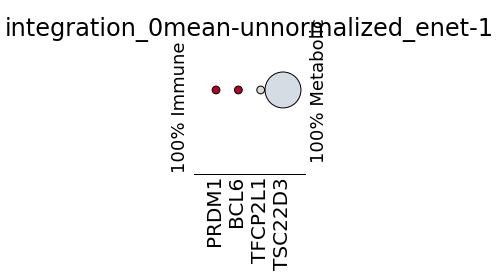

In [38]:
# use coolwarm

cmap = plt.get_cmap(name="coolwarm")

for i, tf_im_cause_df in enumerate(tf_im_cause_dfs):
    name = names[i]
    
    fig = plt.figure(figsize=(int(0.5 * len(tf_im_cause_df)),3))
    ax = fig.add_subplot(1,1,1)
    
    
    

    #xlabel = "Genes"
    title = name
    plt.title(title, fontsize=24)
    
    

    # labels
    plabels = ax.get_xticklabels()
    plt.setp(plabels, rotation=90)
    ax.set_ylabel("100% Immune", fontdict={'size': 18})
    
    ax2 = ax.twinx()
    ax2.set_ylabel("100% Metabolic", fontdict={'size': 18})
    
    
    ax.spines['top'].set_color('none')
    ax.spines['right'].set_color('none')
    ax.spines['left'].set_color('none')
    
    ax.tick_params(
    axis='y',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    left='off',      # ticks along the bottom edge are off
    right='off',         # ticks along the top edge are off
    labelleft='off',
    labelright='off',
    labelsize='18') # labels along the bottom edge are off
    ax.tick_params(bottom='off', top='off', labeltop='off', labelsize='20')
    
    
    
    ax2.spines['top'].set_color('none')
    ax2.spines['right'].set_color('none')
    ax2.spines['left'].set_color('none')
    
    ax2.tick_params(
    axis='y',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    left='off',      # ticks along the bottom edge are off
    right='off',         # ticks along the top edge are off
    labelleft='off',
    labelright='off',
    labelsize='18') # labels along the bottom edge are off
    ax2.tick_params(bottom='off', top='off', labeltop='off', labelbottom='off')
    
    plt.xticks(range(tf_im_cause_df.shape[0] + 2), [""] + list(tf_im_cause_df["Gene Symbol"]) + [""],
              fontsize=20)
    sizes = tf_im_cause_df["Out-Degree:Immune-Metabolism"] * 30
    colors = cmap(X=tf_im_cause_df["Immune-Metabolism Score"].values)
   
    plt.xlim(0, len(tf_im_cause_df) + 1 )
    plt.scatter(range(1, tf_im_cause_df.shape[0] + 1), np.ones(tf_im_cause_df.shape[0]),
               c=colors, s=sizes)


# Square marker for the legends
#     immpatch = plt.scatter([-100], [1],  c=cmap(np.linspace(0, 100, 15))[-1], label='Immune', marker='s', linewidth=0)
#     metabpatch = plt.scatter([-90], [1],  c=cmap(np.linspace(0, 100, 15))[0], label='Metabolic', marker='s', linewidth=0)
#     sizepath = plt.scatter([-80], [1],  c=cmap(np.linspace(0, 100, 15))[0], label='Out-Degree', facecolors="none", edgecolors="k")

    
# Line marker for the legends
#     immpatch = plt.plot([-100], [1],  c=cmap(np.linspace(0, 100, 15))[-1], label='Imm', linewidth=7.5)
#     metabpatch = plt.plot([-90], [1],  c=cmap(np.linspace(0, 100, 15))[0], label='Metab', linewidth=7.5)
    sizepath = plt.scatter([-80], [1],  c=cmap(np.linspace(0, 100, 15))[0], label='Out-Deg', facecolors="none", edgecolors="k",
                          s=80)
    
    # Shrink vertically so we can put legend on top
    box = ax.get_position()
    ax.set_position([box.x0, box.y0, box.width, box.height * 0.8])
    # Put a legend above the right of the current axis
    ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1), ncol=3, scatterpoints=1, fontsize=15, columnspacing=1)
    
    
    
    
    # Shrink plot horizontally so we can put legend on right
#     box = ax.get_position()
#     ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])

    # Put a legend to the right of current axis
    #ax.legend(loc='center left', bbox_to_anchor=(1, 0.5), scatterpoints=1, fontsize=15)
    
    # Display ends of the spectrum
    
    
    
    plt.tight_layout()
    
    plt.show()
    # To save in pdf
    # plt.savefig(name + "_top-TFs.pdf)
    plt.close()
    
    
    display(tf_im_cause_df[["Gene Symbol", "Immune-Metabolism Score", "Summary"]].transpose())
    
    

# TF subnetworks
Get the network involving TF and all the immune/metabolic/TF in the downstream

In [31]:
tf_imm_metab_union_genes = np.intersect1d(np.union1d(imm_metab_union_genes, tf_genes), data_genes)
print len(tf_imm_metab_union_genes)

419


In [32]:

for name, net, out_dir in zip(names, nets, out_dirs):
    
    sub_out_dir = os.path.join(out_dir, "tf-subnetworks")

    
    print "**********************"
    print name
    print "***********************"
    
    tfs_with_imt = []
    tf_imt_net_lengths = []
    
    for x in np.intersect1d(tf_genes, data_genes):
        tf_pre_net = net[np.logical_and(net["Cause"] == x, net["Effect"].isin(tf_imm_metab_union_genes) )]
        
        tf_imt_genes = np.union1d(tf_pre_net["Cause"].values, tf_pre_net["Effect"].values)
        
        tf_imt_net = net[np.logical_and(net["Cause"].isin(tf_imt_genes), net["Effect"].isin(tf_imt_genes))]
        
        if tf_pre_net.shape[0] > 0:
            tf_imt_net["Gene Symbol: Cause"] = [nh.ensg2hg(y) for y in tf_imt_net["Cause"]]
            tf_imt_net["Gene Symbol: Effect"] = [nh.ensg2hg(y) for y in tf_imt_net["Effect"]]

            x_hg = nh.ensg2hg(x)

            tf_imt_sub_out_dir = os.path.join(sub_out_dir, x_hg + "-imt")
            if not os.path.exists(tf_imt_sub_out_dir):
                os.makedirs(tf_imt_sub_out_dir)

            outfile = os.path.join(tf_imt_sub_out_dir, name + "-" + x_hg + "-imt.txt")
            tf_imt_net.to_csv(outfile, sep="\t", index=False)
            print x_hg, "Subnetworks written to ", outfile
    
            tfs_with_imt.append(x_hg)
        
            tf_imt_net_lengths.append(tf_imt_net.shape[0])
            
    outfile = os.path.join(sub_out_dir, name + "-tf-imt-summaries.csv")
    summary_df = pd.DataFrame({"TF": tfs_with_imt, "TF-IMT Network Edges": tf_imt_net_lengths})
    summary_df.to_csv(os.path.join(sub_out_dir, name + "-tf-imt-summaries.csv"), index=0)
    print "Summaries written to ", outfile
    
    
        
    
    # for each tf, get
    

**********************
integration_0mean-unnormalized_enet-1
***********************
PRDM1 Subnetworks written to  analysis/integration_0mean-unnormalized_enet-1/tf-subnetworks/PRDM1-imt/integration_0mean-unnormalized_enet-1-PRDM1-imt.txt


/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


KLF6 Subnetworks written to  analysis/integration_0mean-unnormalized_enet-1/tf-subnetworks/KLF6-imt/integration_0mean-unnormalized_enet-1-KLF6-imt.txt
BCL6 Subnetworks written to  analysis/integration_0mean-unnormalized_enet-1/tf-subnetworks/BCL6-imt/integration_0mean-unnormalized_enet-1-BCL6-imt.txt
TFCP2L1 Subnetworks written to  analysis/integration_0mean-unnormalized_enet-1/tf-subnetworks/TFCP2L1-imt/integration_0mean-unnormalized_enet-1-TFCP2L1-imt.txt
FOXO3 Subnetworks written to  analysis/integration_0mean-unnormalized_enet-1/tf-subnetworks/FOXO3-imt/integration_0mean-unnormalized_enet-1-FOXO3-imt.txt
TSC22D3 Subnetworks written to  analysis/integration_0mean-unnormalized_enet-1/tf-subnetworks/TSC22D3-imt/integration_0mean-unnormalized_enet-1-TSC22D3-imt.txt
Summaries written to  analysis/integration_0mean-unnormalized_enet-1/tf-subnetworks/integration_0mean-unnormalized_enet-1-tf-imt-summaries.csv
**********************
orig_0mean-1var_enet-1
***********************
ARX Subnetw

In [33]:
%%bash

mkdir analysis/tf-subnetworks



cp -r analysis/0mean*/tf-subnetworks analysis/tf-subnetworks

ls analysis/tf-subnetworks/*

cp: analysis/0mean*/tf-subnetworks: No such file or directory
ls: analysis/tf-subnetworks/*: No such file or directory


# Generic top coef plotting code

In [42]:
reload(gtm)
reload(cp)
pd.set_option('display.width', 1000)
pd.set_option('display.max_colwidth', 1000)

ylabels = ["Normalized Log TPM" if "1var" in x else "Log TPM" for x in norms]
print ylabels

['Log TPM', 'Normalized Log TPM', 'Normalized Log TPM', 'Log TPM', 'Log TPM']


In [39]:
def do_plot_net(df, plot_net, name, timekeys, num_per_keys, timepoints=None, test_key="Test", lag_key="Lag", coef_key="Weight",
                cause_key="Gene Symbol: Cause", effect_key="Gene Symbol: Effect", do_display=True,
               ylabel="Normalized Expression", legend_fontsize=15, plot_bar=True, out_dir=None,
               title_prefix="", file_prefix=None,**kwargs
               ):
    for index, row in plot_net.iterrows():
        cause_gene = row[cause_key]
        effect_gene = row[effect_key]
        coeflag = row[lag_key]
        coef = row[coef_key]
        
        print timekeys
        print num_per_keys
        
        title = title_prefix + "Cause-Effect pair: (" + cause_gene + ", " + effect_gene + ")"
        if file_prefix == None:
            file_prefix = out_dir + os.sep
        
        
        # Don't plot bar
        cp.plot_coef(df, cause_gene=cause_gene, effect_gene=effect_gene,
         lag=coeflag, coef=coef, legend_fontsize=legend_fontsize, ylabel=ylabel, file_prefix=file_prefix,
                plot_bar=True,
                keys=timekeys, num_per_keys=num_per_keys,
                    show_plot= do_display, timepoints=timepoints, title=title, **kwargs)

        # Just plot mean
        cp.plot_coef(df, cause_gene=cause_gene, effect_gene=effect_gene,
             lag=coeflag, coef=coef, legend_fontsize=legend_fontsize, ylabel=ylabel, file_prefix=file_prefix + "no-bar-",
                    plot_bar=False,
                    keys=timekeys, num_per_keys=num_per_keys,
                    show_plot= do_display, timepoints=timepoints, title=title, **kwargs)
    


def do_plot_nets(dfs, plot_nets, names, timekeys_list, num_per_keys_list, timepoints_list,  each_plot_folders=None, all_plot_folder=None, interest_index=None, 
                 include_name_prefix=True, ylabel_default="Normalized Expression", ylabels=None, **kwargs):
    """
    Plot the top coef from each name
    
    """
    assert len(plot_nets) == len(names)

    # Only one of them should be set
    assert ((each_plot_folders != None) or (all_plot_folder != None)) and ((each_plot_folders == None) or (all_plot_folder == None))
    if each_plot_folders != None:
        assert len(each_plot_folders) == len(names)
    
    
    for i in range(len(dfs)):
        plot_net = plot_nets[i]
        name = names[i]
        df = dfs[i]
        timekeys = timekeys_list[i]
        num_per_keys = num_per_keys_list[i]
        timepoints = timepoints_list[i]
        
        if ylabels != None:
            ylabel = ylabels[i]
        else:
            ylabel = ylabel_default
        
        
        
        
        do_display = (i == interest_index) or interest_index == None
        
        if all_plot_folder != None:
            out_dir = all_plot_folder
        else:
            out_dir = each_plot_folders[i]
        
        if not os.path.exists(out_dir):
            os.makedirs(out_dir)

        print "***********************************************"
        print name
        print "***********************************************"

        
        
        
        print plot_net[["Gene Symbol: Cause", "Gene Symbol: Effect", "Weight", "Coef", "Summary: Cause", "Summary: Effect"]]

        if all_plot_folder != None:
            plot_net.to_csv( os.path.join(out_dir, name + "_top_interactions.csv"), index=0)
            print "Written to ", os.path.join(out_dir, name + "_top_interactions.csv")
        else:
            plot_net.to_csv( os.path.join(out_dir, "top_interactions.csv"), index=0)
            print "Written to ", os.path.join(out_dir, "top_interactions.csv")
            
        if include_name_prefix:
            title_prefix = name + " "
            file_prefix = out_dir + os.sep + name + "_"
        else:
            title_prefix = ""
            file_prefix = out_dir + os.sep
        
        do_plot_net(df, plot_net, name, timekeys, num_per_keys, timepoints=timepoints, do_display=do_display, out_dir=out_dir, title_prefix=title_prefix, file_prefix=file_prefix, 
                    ylabel=ylabel, horizontal_line_color_labels=[(0, 'k', None)], **kwargs)


# Plot a few relevant ones

In [54]:
plotfoldersuffix = "top-edge-checking"

net = nets[0]
name = names[0]
data_hg_df = data_hg_df_list[0]
timekeys = timekeys_list[0]
num_per_keys = num_per_keys_list[0]
timepoints = timepoints_list[0]
ylabel = ylabels[0]

plot_folder = os.path.join(name_plot_folders[0], plotfoldersuffix)
if not os.path.exists(plot_folder):
    os.makedirs(plot_folder)

['t00_rep', 't1_rep', 't4_rep', 't8_rep', 't12_rep']
[34, 34, 34, 34, 34]
Filename:  analysis/plots/integration_0mean-unnormalized_enet-1/top-edge-checking/TSC22D3-IL11-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/integration_0mean-unnormalized_enet-1/top-edge-checking/TSC22D3-IL11-lag-1-coef--1E-01.pdf


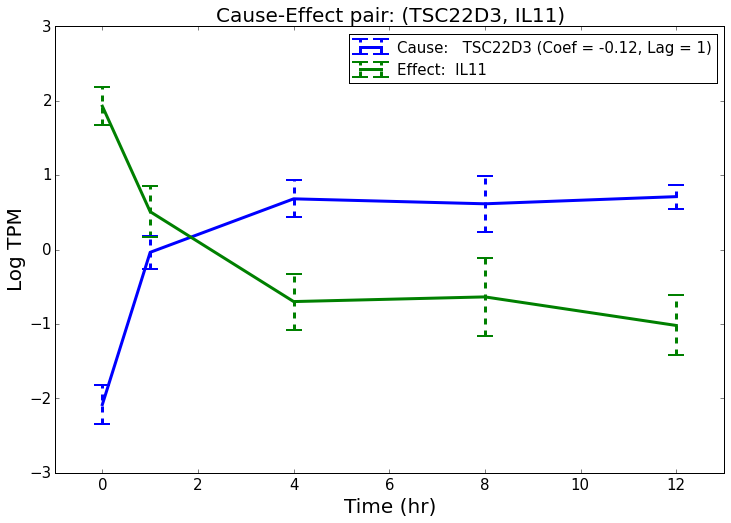

Filename:  analysis/plots/integration_0mean-unnormalized_enet-1/top-edge-checking/no-bar-TSC22D3-IL11-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/integration_0mean-unnormalized_enet-1/top-edge-checking/no-bar-TSC22D3-IL11-lag-1-coef--1E-01.pdf


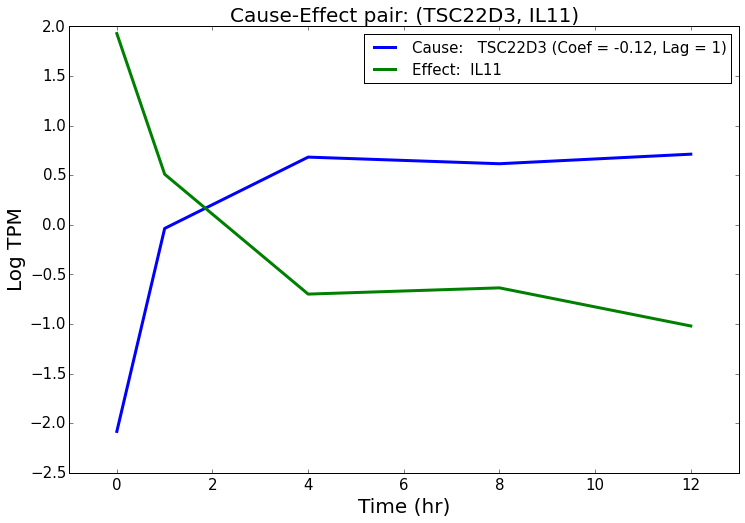

In [59]:
plot_net = net[np.logical_and(net["Gene Symbol: Cause"] == "TSC22D3",
                             net["Gene Symbol: Effect"] == "IL11")]

do_plot_net(data_hg_df, plot_net, name, timekeys, num_per_keys, timepoints,
           out_dir = plot_folder, ylabel=ylabel)

['t00_rep', 't1_rep', 't4_rep', 't8_rep', 't12_rep']
[34, 34, 34, 34, 34]
Filename:  analysis/plots/integration_0mean-unnormalized_enet-1/top-edge-checking/TSC22D3-BIRC3-lag-1-coef--3E-02.pdf
Plot saved to  analysis/plots/integration_0mean-unnormalized_enet-1/top-edge-checking/TSC22D3-BIRC3-lag-1-coef--3E-02.pdf


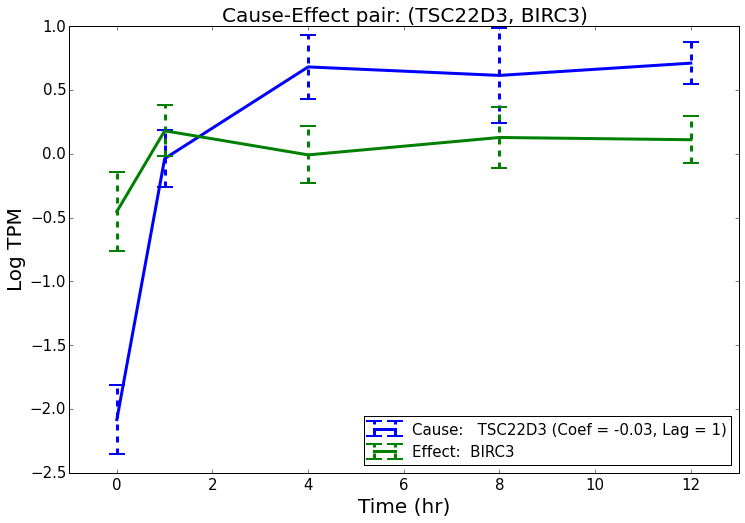

Filename:  analysis/plots/integration_0mean-unnormalized_enet-1/top-edge-checking/no-bar-TSC22D3-BIRC3-lag-1-coef--3E-02.pdf
Plot saved to  analysis/plots/integration_0mean-unnormalized_enet-1/top-edge-checking/no-bar-TSC22D3-BIRC3-lag-1-coef--3E-02.pdf


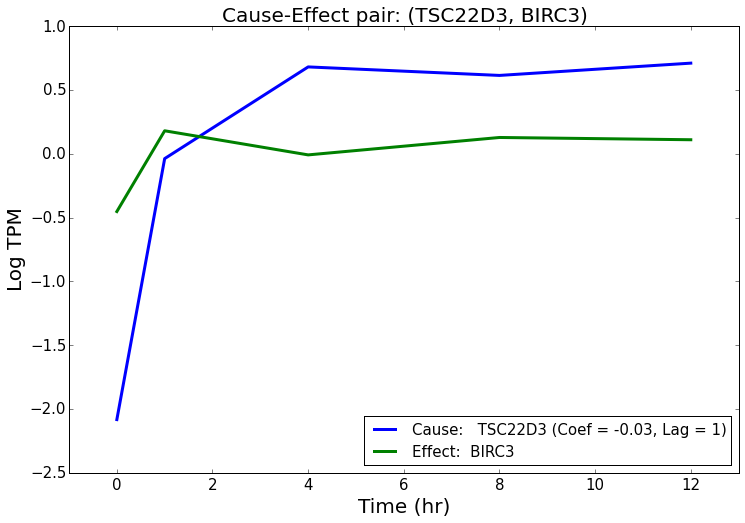

In [58]:
plot_net = net[np.logical_and(net["Gene Symbol: Cause"] == "TSC22D3",
                             net["Gene Symbol: Effect"] == "BIRC3")]

do_plot_net(data_hg_df, plot_net, name, timekeys, num_per_keys, timepoints,
           out_dir = plot_folder, ylabel=ylabel)

['t00_rep', 't1_rep', 't4_rep', 't8_rep', 't12_rep']
[34, 34, 34, 34, 34]
Filename:  analysis/plots/integration_0mean-unnormalized_enet-1/top-edge-checking/FOXO3-ERBB3-lag-1-coef-6E-02.pdf
Plot saved to  analysis/plots/integration_0mean-unnormalized_enet-1/top-edge-checking/FOXO3-ERBB3-lag-1-coef-6E-02.pdf


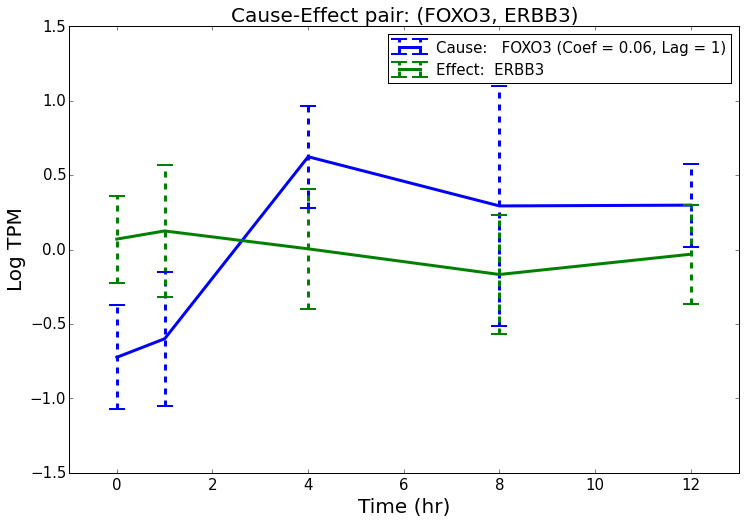

Filename:  analysis/plots/integration_0mean-unnormalized_enet-1/top-edge-checking/no-bar-FOXO3-ERBB3-lag-1-coef-6E-02.pdf
Plot saved to  analysis/plots/integration_0mean-unnormalized_enet-1/top-edge-checking/no-bar-FOXO3-ERBB3-lag-1-coef-6E-02.pdf


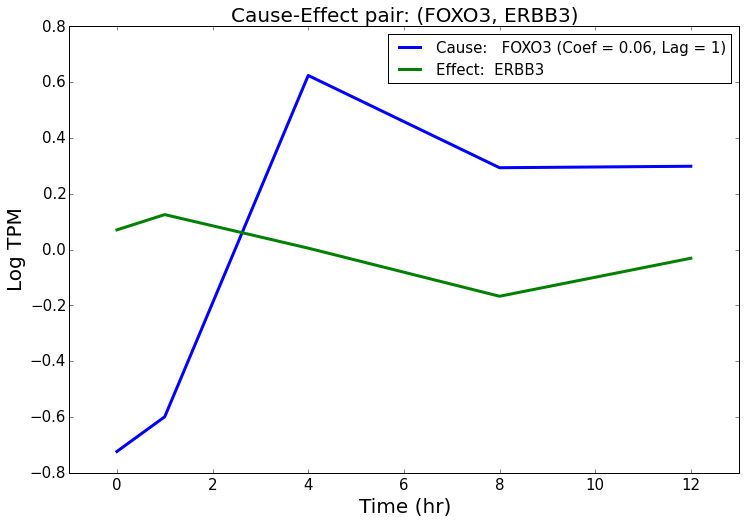

In [57]:
plot_net = net[np.logical_and(net["Gene Symbol: Cause"] == "FOXO3",
                             net["Gene Symbol: Effect"] == "ERBB3")]

do_plot_net(data_hg_df, plot_net, name, timekeys, num_per_keys, timepoints,
           out_dir = plot_folder, ylabel=ylabel)

['t00_rep', 't1_rep', 't4_rep', 't8_rep', 't12_rep']
[34, 34, 34, 34, 34]
Filename:  analysis/plots/integration_0mean-unnormalized_enet-1/top-edge-checking/PRDM1-CCL2-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/integration_0mean-unnormalized_enet-1/top-edge-checking/PRDM1-CCL2-lag-1-coef--1E-01.pdf


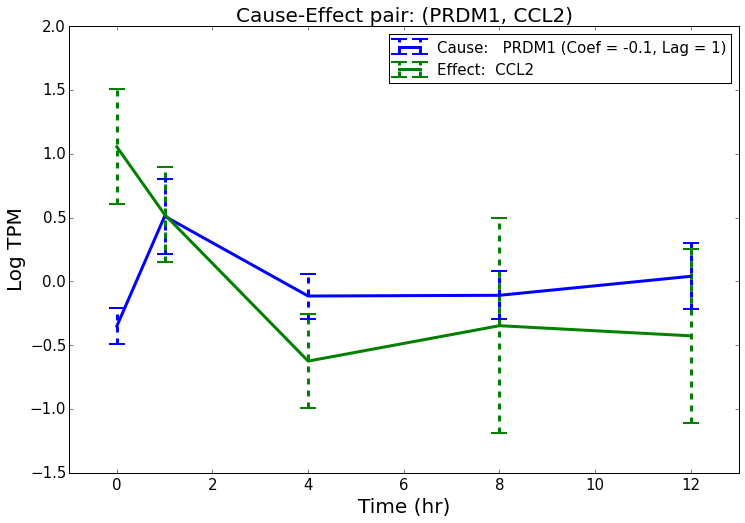

Filename:  analysis/plots/integration_0mean-unnormalized_enet-1/top-edge-checking/no-bar-PRDM1-CCL2-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/integration_0mean-unnormalized_enet-1/top-edge-checking/no-bar-PRDM1-CCL2-lag-1-coef--1E-01.pdf


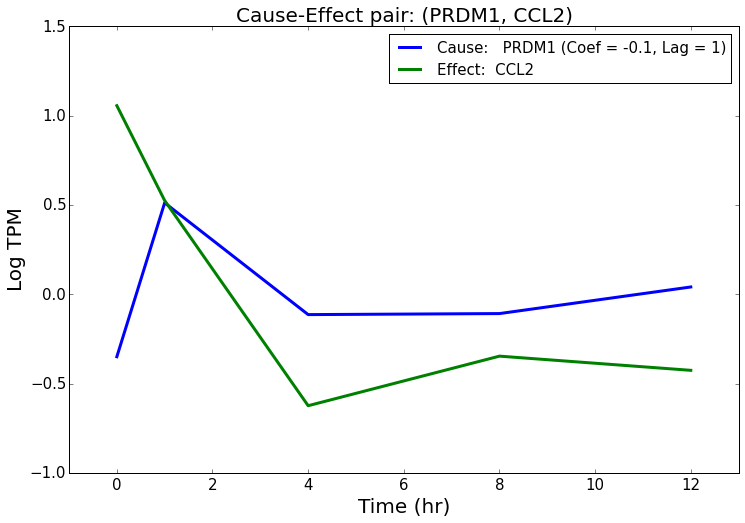

In [56]:
plot_net = net[np.logical_and(net["Gene Symbol: Cause"] == "PRDM1",
                             net["Gene Symbol: Effect"] == "CCL2")]

do_plot_net(data_hg_df, plot_net, name, timekeys, num_per_keys, timepoints,
           out_dir = plot_folder, ylabel=ylabel)

['t00_rep', 't1_rep', 't4_rep', 't8_rep', 't12_rep']
[34, 34, 34, 34, 34]
Filename:  analysis/plots/integration_0mean-unnormalized_enet-1/top-edge-checking/KLF6-CCL2-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/integration_0mean-unnormalized_enet-1/top-edge-checking/KLF6-CCL2-lag-1-coef--1E-01.pdf


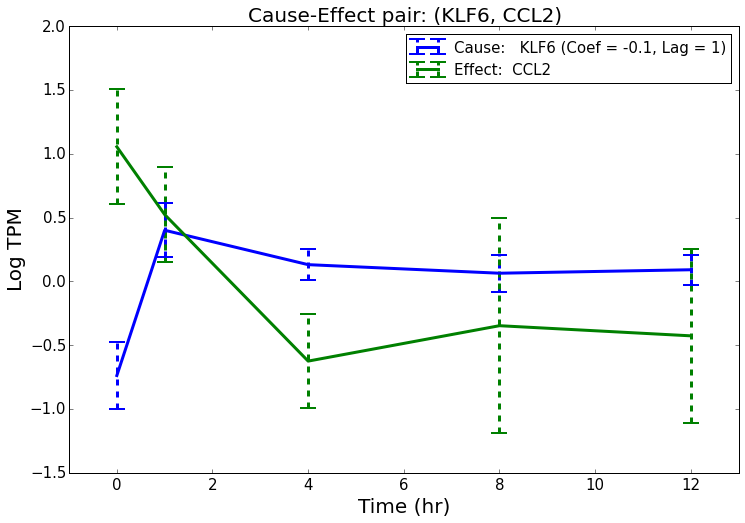

Filename:  analysis/plots/integration_0mean-unnormalized_enet-1/top-edge-checking/no-bar-KLF6-CCL2-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/integration_0mean-unnormalized_enet-1/top-edge-checking/no-bar-KLF6-CCL2-lag-1-coef--1E-01.pdf


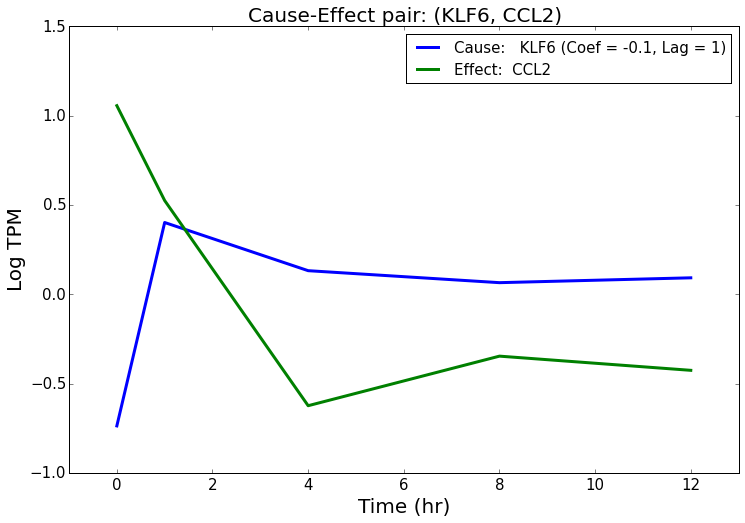

In [55]:
plot_net = net[np.logical_and(net["Gene Symbol: Cause"] == "KLF6",
                             net["Gene Symbol: Effect"] == "CCL2")]

do_plot_net(data_hg_df, plot_net, name, timekeys, num_per_keys, timepoints,
           out_dir = plot_folder, ylabel=ylabel)

### Plot top any -> any overall

In [36]:
# set which net to plot

plotfoldersuffix = "any-any"
each_plot_folders = [os.path.join(name_plot_folder, plotfoldersuffix) for name, name_plot_folder in zip(names, name_plot_folders)]

top_edge_num = 3
plot_nets = [net.sort_values("AbsWeight", ascending=False).head(n=top_edge_num) for net in nets]



# display annotations
for plot_net in plot_nets:
    plot_net["Gene Symbol: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_net["Cause"].values]
    plot_net["Gene Symbol: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_net["Effect"].values]
    plot_net["Summary: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Summary"].values[0] for x in plot_net["Cause"].values]
    plot_net["Summary: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Summary"].values[0] for x in plot_net["Effect"].values]

pd.set_option('display.width', 1000)

for plot_net, name in zip(plot_nets, names):
    print name
    display(plot_net)

integration_0mean-unnormalized_enet-1


,Cause-Effect,Cause,Effect,Weight,AbsWeight,Test,Lag,Coef,Gene Symbol: Cause,Gene Symbol: Effect,Summary: Cause,Summary: Effect
0,ENSG00000118689.13-ENSG00000165272.13,ENSG00000118689.13,ENSG00000165272.13,0.195030,0.195030,enet,1,1,FOXO3,AQP3,"GR_direct,TF-Bioguo,DNA-binding_GO,",NaN
1,ENSG00000157514.15-ENSG00000141750.6,ENSG00000157514.15,ENSG00000141750.6,0.193640,0.193640,enet,1,1,TSC22D3,STAC2,"TF-Bioguo,",NaN
2,ENSG00000157514.15-ENSG00000115112.7,ENSG00000157514.15,ENSG00000115112.7,0.185612,0.185612,enet,1,1,TSC22D3,TFCP2L1,"TF-Bioguo,","GR_direct,TF-Bioguo,"


orig_0mean-1var_enet-1


,Cause-Effect,Cause,Effect,Weight,AbsWeight,Test,Lag,Coef,Gene Symbol: Cause,Gene Symbol: Effect,Summary: Cause,Summary: Effect
0,ENSG00000185522.7-ENSG00000179913.9,ENSG00000185522.7,ENSG00000179913.9,-0.205113,0.205113,enet,1,1,LMNTD2,B3GNT3,NaN,NaN
1,ENSG00000124575.6-ENSG00000183779.6,ENSG00000124575.6,ENSG00000183779.6,0.201083,0.201083,enet,1,1,HIST1H1D,ZNF703,NaN,NaN
2,ENSG00000157326.17-ENSG00000166086.11,ENSG00000157326.17,ENSG00000166086.11,-0.199237,0.199237,enet,1,1,DHRS4,JAM3,NaN,NaN


orig_0mean-1var_enet-2


,Cause-Effect,Cause,Effect,Test,Lag,Weight1,AbsWeight1,Coef1,Weight2,AbsWeight2,Coef2,AbsWeight,Coef,Weight,Gene Symbol: Cause,Gene Symbol: Effect,Summary: Cause,Summary: Effect
0,ENSG00000142089.14-ENSG00000177042.13,ENSG00000142089.14,ENSG00000177042.13,enet,2.0,-0.167872,0.167872,1.0,NaN,NaN,NaN,0.167872,1.0,-0.167872,IFITM3,TMEM80,"Immune_GOC-5,Immune_GOC-4,",NaN
1,ENSG00000179913.9-ENSG00000089505.16,ENSG00000179913.9,ENSG00000089505.16,enet,2.0,-0.164358,0.164358,1.0,NaN,NaN,NaN,0.164358,1.0,-0.164358,B3GNT3,CMTM1,NaN,"Immune_GOC-5,Immune_GOC-4,"
2,ENSG00000275993.2-ENSG00000163807.5,ENSG00000275993.2,ENSG00000163807.5,enet,2.0,NaN,NaN,NaN,0.159858,0.159858,2.0,0.159858,2.0,0.159858,CH507-42P11.8,KIAA1143,NaN,NaN


orig_0mean-unnormalized_enet-1


,Cause-Effect,Cause,Effect,Weight,AbsWeight,Test,Lag,Coef,Gene Symbol: Cause,Gene Symbol: Effect,Summary: Cause,Summary: Effect
0,ENSG00000205177.6-ENSG00000167772.10,ENSG00000205177.6,ENSG00000167772.10,0.335368,0.335368,enet,1,1,C11orf91,ANGPTL4,"GR_direct,","GR_direct,Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,"
1,ENSG00000124575.6-ENSG00000135094.9,ENSG00000124575.6,ENSG00000135094.9,-0.321687,0.321687,enet,1,1,HIST1H1D,SDS,NaN,"Metabolism-gluc_GSEA,"
2,ENSG00000204531.14-ENSG00000163739.4,ENSG00000204531.14,ENSG00000163739.4,-0.318522,0.318522,enet,1,1,POU5F1,CXCL1,"GR_direct,TF-Bioguo,DNA-binding_GO,","Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,"


orig_0mean-unnormalized_enet-2


,Cause-Effect,Cause,Effect,Test,Lag,Weight1,AbsWeight1,Coef1,Weight2,AbsWeight2,Coef2,AbsWeight,Coef,Weight,Gene Symbol: Cause,Gene Symbol: Effect,Summary: Cause,Summary: Effect
0,ENSG00000278637.1-ENSG00000183598.3,ENSG00000278637.1,ENSG00000183598.3,enet,2.0,NaN,NaN,NaN,-0.293486,0.293486,2.0,0.293486,2.0,-0.293486,HIST1H4A,HIST2H3D,"DNA-binding_GO,Hist-binding_GO,",NaN
1,ENSG00000124575.6-ENSG00000135094.9,ENSG00000124575.6,ENSG00000135094.9,enet,2.0,-0.14112,0.14112,1.0,-0.255668,0.255668,2.0,0.255668,2.0,-0.255668,HIST1H1D,SDS,NaN,"Metabolism-gluc_GSEA,"
2,ENSG00000184270.4-ENSG00000146250.6,ENSG00000184270.4,ENSG00000146250.6,enet,2.0,NaN,NaN,NaN,-0.253318,0.253318,2.0,0.253318,2.0,-0.253318,HIST2H2AB,PRSS35,NaN,NaN


***********************************************
integration_0mean-unnormalized_enet-1
***********************************************
  Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                       Summary: Cause       Summary: Effect
0              FOXO3                AQP3  0.195030     1  GR_direct,TF-Bioguo,DNA-binding_GO,                   NaN
1            TSC22D3               STAC2  0.193640     1                           TF-Bioguo,                   NaN
2            TSC22D3             TFCP2L1  0.185612     1                           TF-Bioguo,  GR_direct,TF-Bioguo,
Written to  analysis/plots/integration_0mean-unnormalized_enet-1/any-any/top_interactions.csv
['t00_rep', 't1_rep', 't4_rep', 't8_rep', 't12_rep']
[34, 34, 34, 34, 34]
Filename:  analysis/plots/integration_0mean-unnormalized_enet-1/any-any/integration_0mean-unnormalized_enet-1_FOXO3-AQP3-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/integration_0mean-unnormalized_enet-1/any-any/integration_0mea

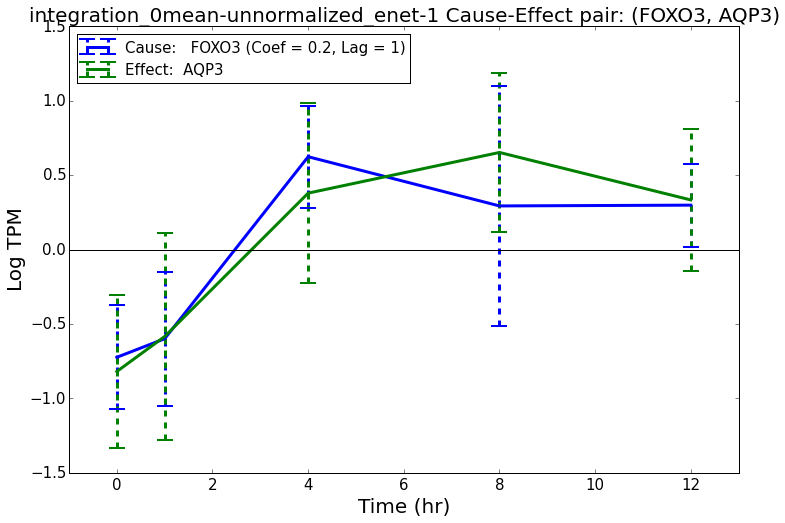

Filename:  analysis/plots/integration_0mean-unnormalized_enet-1/any-any/integration_0mean-unnormalized_enet-1_no-bar-FOXO3-AQP3-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/integration_0mean-unnormalized_enet-1/any-any/integration_0mean-unnormalized_enet-1_no-bar-FOXO3-AQP3-lag-1-coef-2E-01.pdf


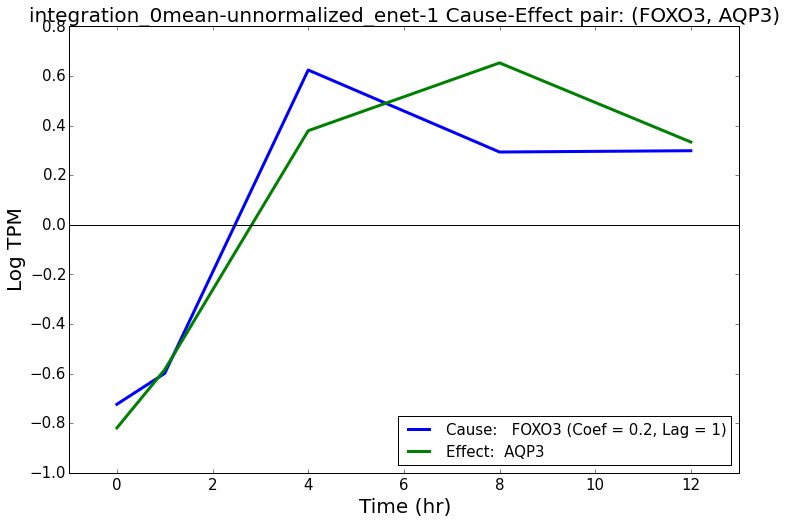

['t00_rep', 't1_rep', 't4_rep', 't8_rep', 't12_rep']
[34, 34, 34, 34, 34]
Filename:  analysis/plots/integration_0mean-unnormalized_enet-1/any-any/integration_0mean-unnormalized_enet-1_TSC22D3-STAC2-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/integration_0mean-unnormalized_enet-1/any-any/integration_0mean-unnormalized_enet-1_TSC22D3-STAC2-lag-1-coef-2E-01.pdf


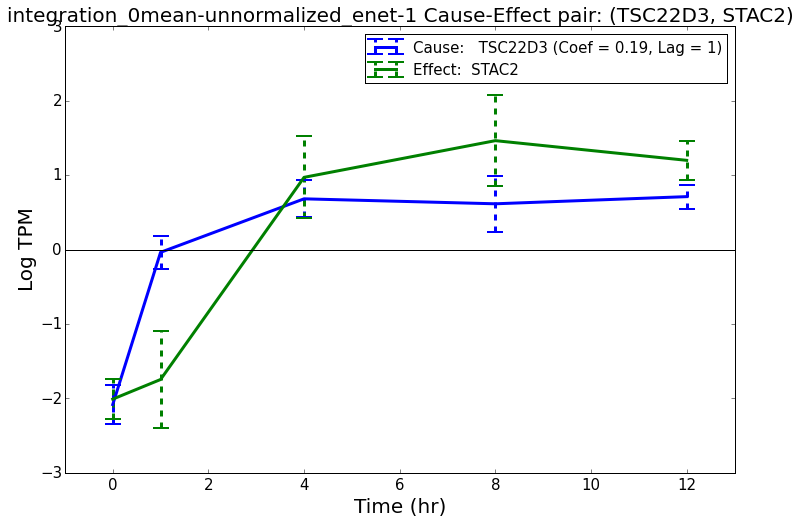

Filename:  analysis/plots/integration_0mean-unnormalized_enet-1/any-any/integration_0mean-unnormalized_enet-1_no-bar-TSC22D3-STAC2-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/integration_0mean-unnormalized_enet-1/any-any/integration_0mean-unnormalized_enet-1_no-bar-TSC22D3-STAC2-lag-1-coef-2E-01.pdf


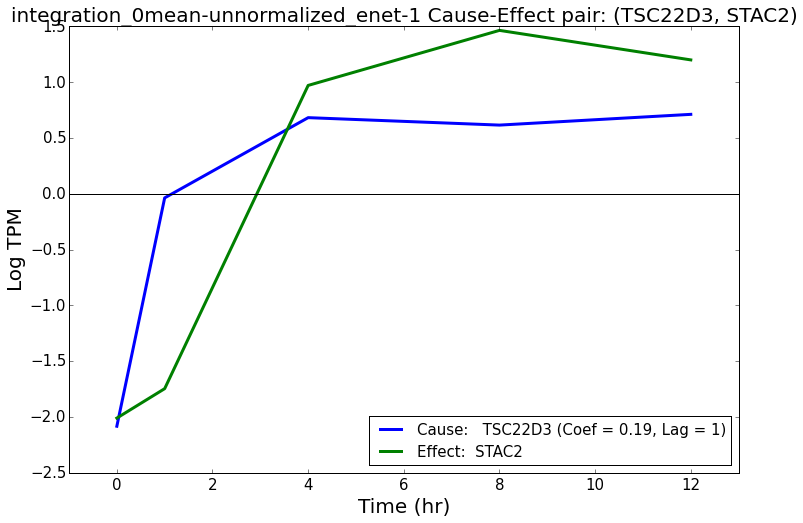

['t00_rep', 't1_rep', 't4_rep', 't8_rep', 't12_rep']
[34, 34, 34, 34, 34]
Filename:  analysis/plots/integration_0mean-unnormalized_enet-1/any-any/integration_0mean-unnormalized_enet-1_TSC22D3-TFCP2L1-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/integration_0mean-unnormalized_enet-1/any-any/integration_0mean-unnormalized_enet-1_TSC22D3-TFCP2L1-lag-1-coef-2E-01.pdf


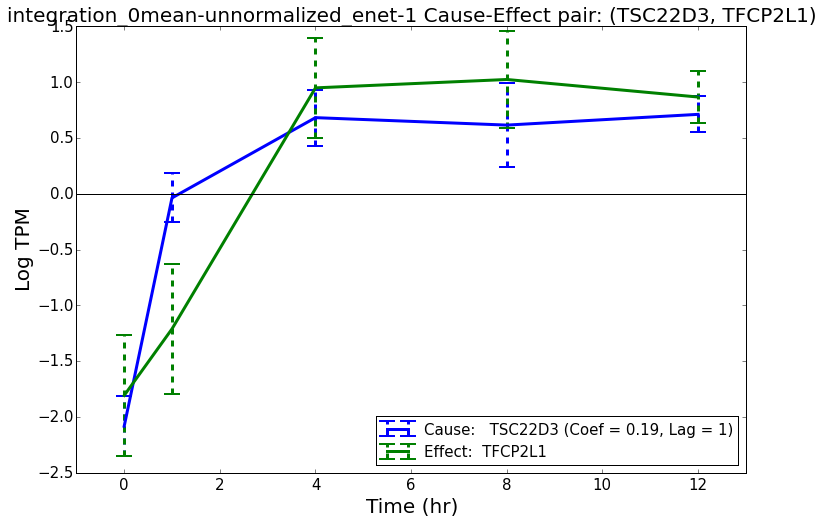

Filename:  analysis/plots/integration_0mean-unnormalized_enet-1/any-any/integration_0mean-unnormalized_enet-1_no-bar-TSC22D3-TFCP2L1-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/integration_0mean-unnormalized_enet-1/any-any/integration_0mean-unnormalized_enet-1_no-bar-TSC22D3-TFCP2L1-lag-1-coef-2E-01.pdf


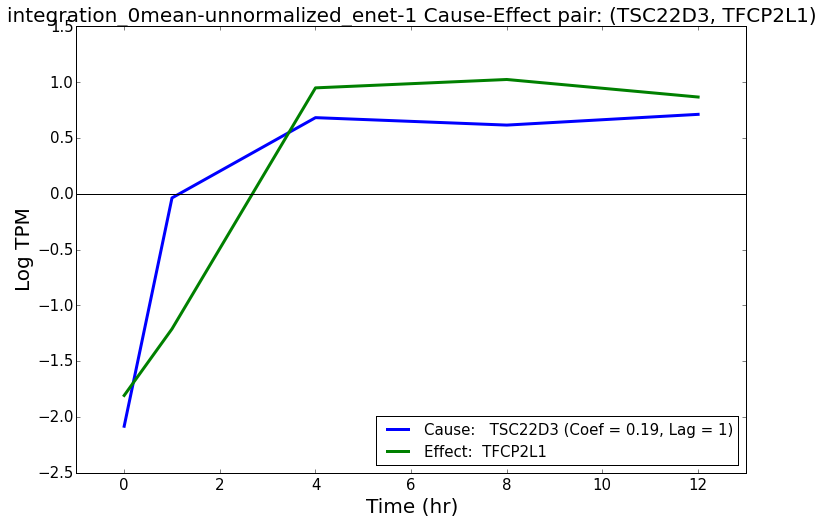

***********************************************
orig_0mean-1var_enet-1
***********************************************
  Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef  Summary: Cause  Summary: Effect
0             LMNTD2              B3GNT3 -0.205113     1             NaN              NaN
1           HIST1H1D              ZNF703  0.201083     1             NaN              NaN
2              DHRS4                JAM3 -0.199237     1             NaN              NaN
Written to  analysis/plots/orig_0mean-1var_enet-1/any-any/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/orig_0mean-1var_enet-1/any-any/orig_0mean-1var_enet-1_LMNTD2-B3GNT3-lag-1-coef--2E-01.pdf
Plot saved to  analysis/plots/orig_0mean-1var_enet-1/any-any/orig_0mean-1var_enet-1_LMNTD2-B3GNT3-lag-1-coef--2E-01.pdf


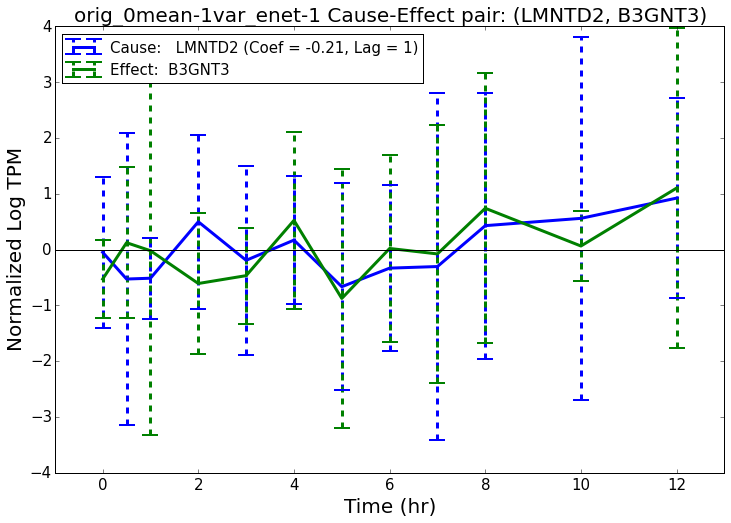

Filename:  analysis/plots/orig_0mean-1var_enet-1/any-any/orig_0mean-1var_enet-1_no-bar-LMNTD2-B3GNT3-lag-1-coef--2E-01.pdf
Plot saved to  analysis/plots/orig_0mean-1var_enet-1/any-any/orig_0mean-1var_enet-1_no-bar-LMNTD2-B3GNT3-lag-1-coef--2E-01.pdf


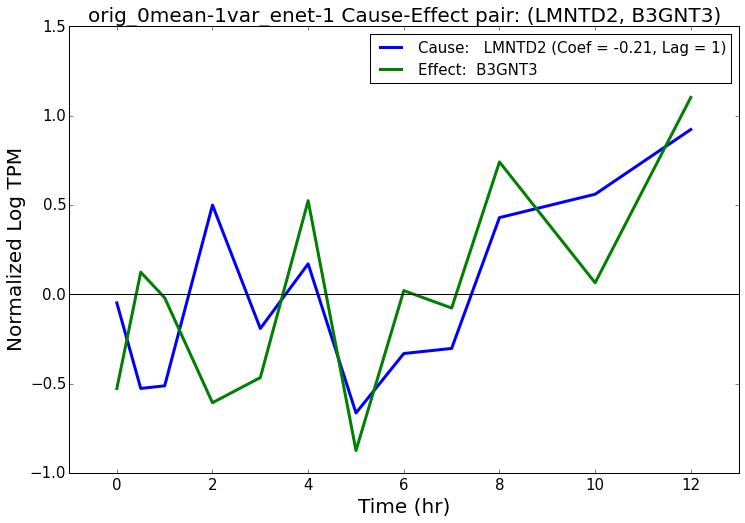

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/orig_0mean-1var_enet-1/any-any/orig_0mean-1var_enet-1_HIST1H1D-ZNF703-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/orig_0mean-1var_enet-1/any-any/orig_0mean-1var_enet-1_HIST1H1D-ZNF703-lag-1-coef-2E-01.pdf


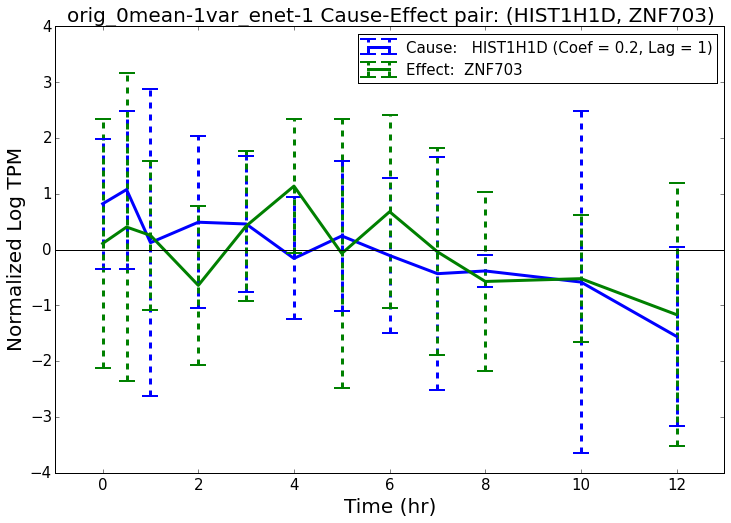

Filename:  analysis/plots/orig_0mean-1var_enet-1/any-any/orig_0mean-1var_enet-1_no-bar-HIST1H1D-ZNF703-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/orig_0mean-1var_enet-1/any-any/orig_0mean-1var_enet-1_no-bar-HIST1H1D-ZNF703-lag-1-coef-2E-01.pdf


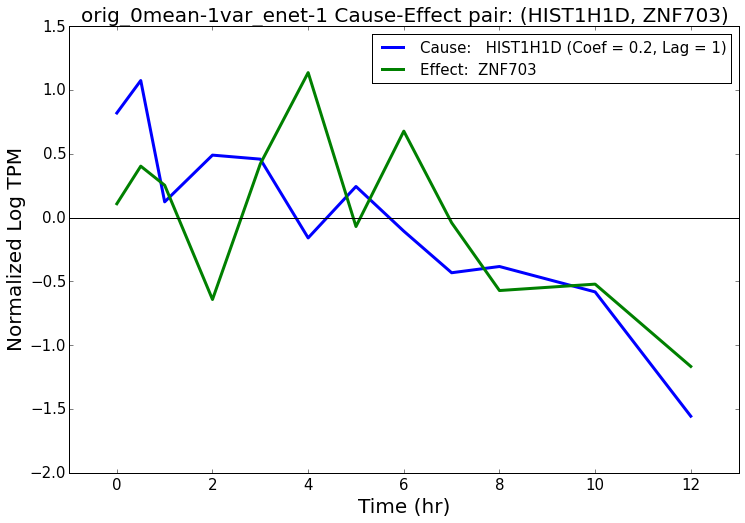

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/orig_0mean-1var_enet-1/any-any/orig_0mean-1var_enet-1_DHRS4-JAM3-lag-1-coef--2E-01.pdf
Plot saved to  analysis/plots/orig_0mean-1var_enet-1/any-any/orig_0mean-1var_enet-1_DHRS4-JAM3-lag-1-coef--2E-01.pdf


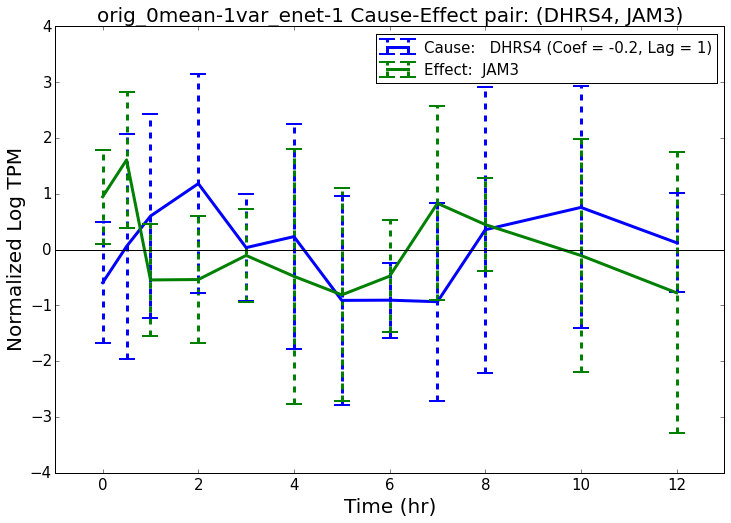

Filename:  analysis/plots/orig_0mean-1var_enet-1/any-any/orig_0mean-1var_enet-1_no-bar-DHRS4-JAM3-lag-1-coef--2E-01.pdf
Plot saved to  analysis/plots/orig_0mean-1var_enet-1/any-any/orig_0mean-1var_enet-1_no-bar-DHRS4-JAM3-lag-1-coef--2E-01.pdf


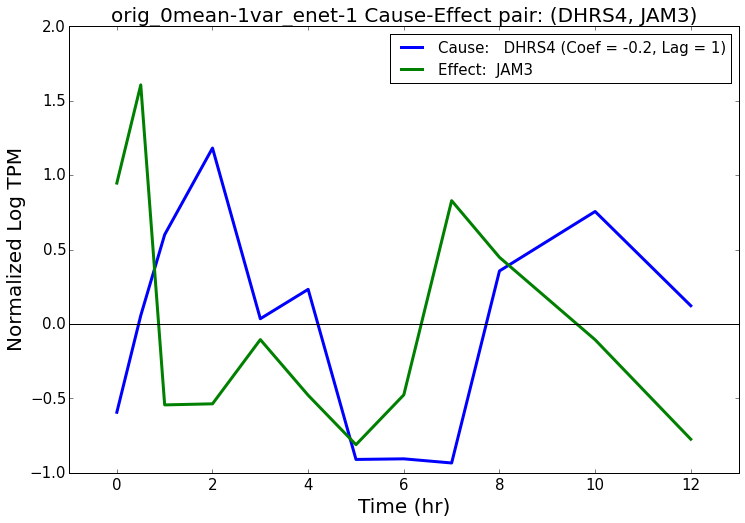

***********************************************
orig_0mean-1var_enet-2
***********************************************
  Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef              Summary: Cause             Summary: Effect
0             IFITM3              TMEM80 -0.167872   1.0  Immune_GOC-5,Immune_GOC-4,                         NaN
1             B3GNT3               CMTM1 -0.164358   1.0                         NaN  Immune_GOC-5,Immune_GOC-4,
2      CH507-42P11.8            KIAA1143  0.159858   2.0                         NaN                         NaN
Written to  analysis/plots/orig_0mean-1var_enet-2/any-any/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/orig_0mean-1var_enet-2/any-any/orig_0mean-1var_enet-2_IFITM3-TMEM80-lag-2-coef--2E-01.pdf
Plot saved to  analysis/plots/orig_0mean-1var_enet-2/any-any/orig_0mean-

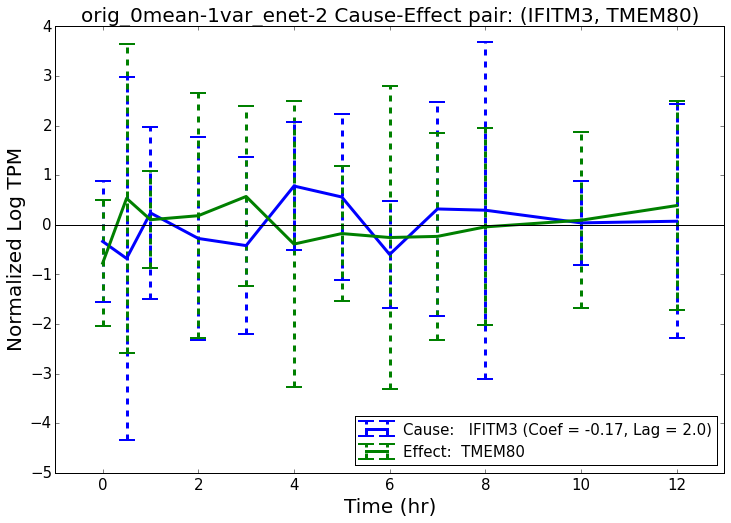

Filename:  analysis/plots/orig_0mean-1var_enet-2/any-any/orig_0mean-1var_enet-2_no-bar-IFITM3-TMEM80-lag-2-coef--2E-01.pdf
Plot saved to  analysis/plots/orig_0mean-1var_enet-2/any-any/orig_0mean-1var_enet-2_no-bar-IFITM3-TMEM80-lag-2-coef--2E-01.pdf


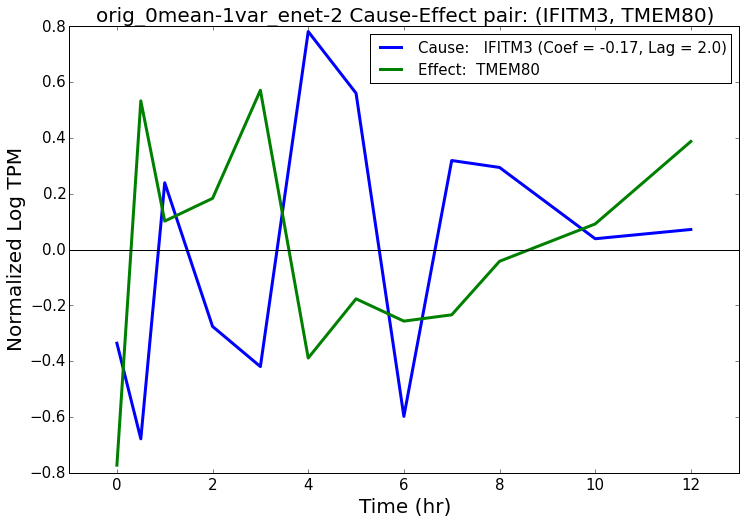

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/orig_0mean-1var_enet-2/any-any/orig_0mean-1var_enet-2_B3GNT3-CMTM1-lag-2-coef--2E-01.pdf
Plot saved to  analysis/plots/orig_0mean-1var_enet-2/any-any/orig_0mean-1var_enet-2_B3GNT3-CMTM1-lag-2-coef--2E-01.pdf


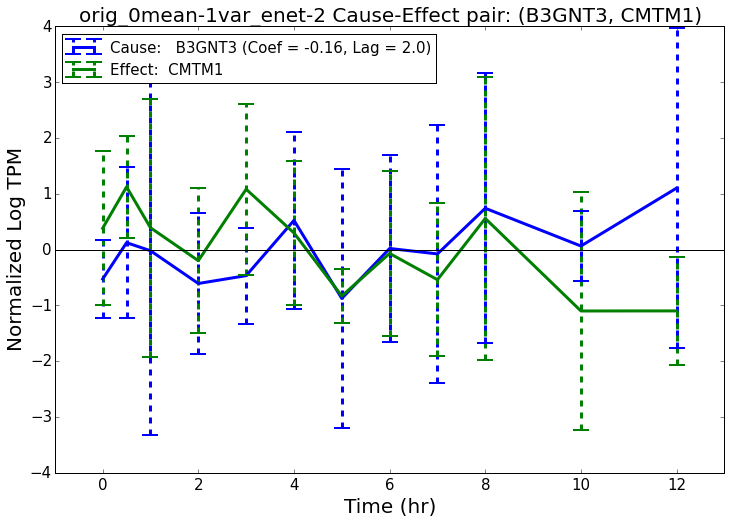

Filename:  analysis/plots/orig_0mean-1var_enet-2/any-any/orig_0mean-1var_enet-2_no-bar-B3GNT3-CMTM1-lag-2-coef--2E-01.pdf
Plot saved to  analysis/plots/orig_0mean-1var_enet-2/any-any/orig_0mean-1var_enet-2_no-bar-B3GNT3-CMTM1-lag-2-coef--2E-01.pdf


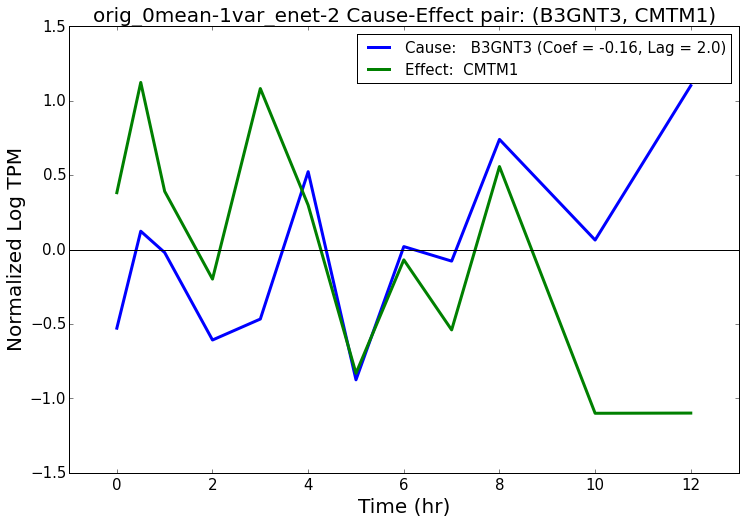

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/orig_0mean-1var_enet-2/any-any/orig_0mean-1var_enet-2_CH507-42P11,8-KIAA1143-lag-2-coef-2E-01.pdf
Plot saved to  analysis/plots/orig_0mean-1var_enet-2/any-any/orig_0mean-1var_enet-2_CH507-42P11,8-KIAA1143-lag-2-coef-2E-01.pdf


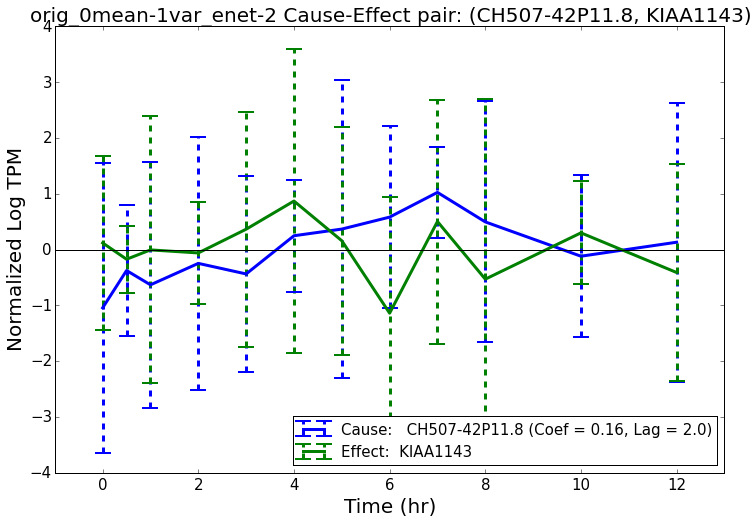

Filename:  analysis/plots/orig_0mean-1var_enet-2/any-any/orig_0mean-1var_enet-2_no-bar-CH507-42P11,8-KIAA1143-lag-2-coef-2E-01.pdf
Plot saved to  analysis/plots/orig_0mean-1var_enet-2/any-any/orig_0mean-1var_enet-2_no-bar-CH507-42P11,8-KIAA1143-lag-2-coef-2E-01.pdf


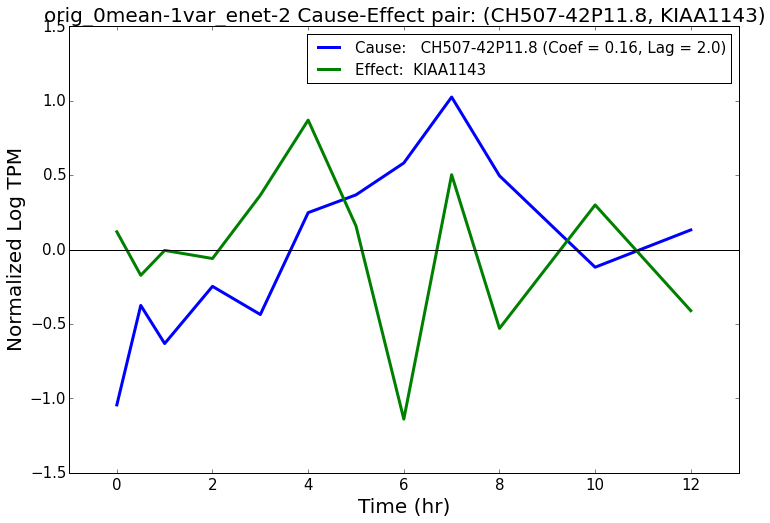

***********************************************
orig_0mean-unnormalized_enet-1
***********************************************
  Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                       Summary: Cause                                                    Summary: Effect
0           C11orf91             ANGPTL4  0.335368     1                           GR_direct,              GR_direct,Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,
1           HIST1H1D                 SDS -0.321687     1                                  NaN                                              Metabolism-gluc_GSEA,
2             POU5F1               CXCL1 -0.318522     1  GR_direct,TF-Bioguo,DNA-binding_GO,  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/orig_0mean-unnormalized_enet-1/any-any/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4

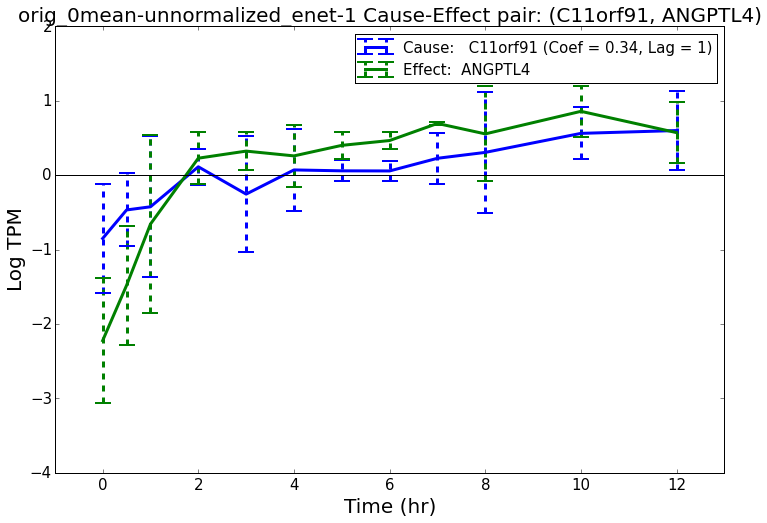

Filename:  analysis/plots/orig_0mean-unnormalized_enet-1/any-any/orig_0mean-unnormalized_enet-1_no-bar-C11orf91-ANGPTL4-lag-1-coef-3E-01.pdf
Plot saved to  analysis/plots/orig_0mean-unnormalized_enet-1/any-any/orig_0mean-unnormalized_enet-1_no-bar-C11orf91-ANGPTL4-lag-1-coef-3E-01.pdf


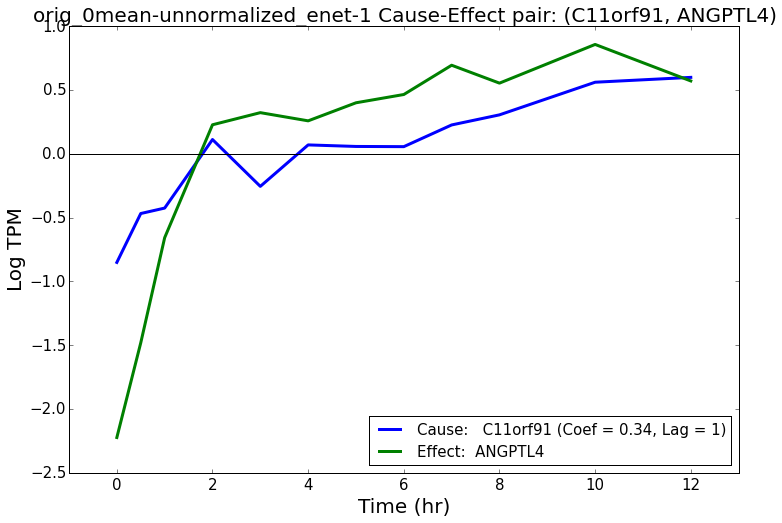

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/orig_0mean-unnormalized_enet-1/any-any/orig_0mean-unnormalized_enet-1_HIST1H1D-SDS-lag-1-coef--3E-01.pdf
Plot saved to  analysis/plots/orig_0mean-unnormalized_enet-1/any-any/orig_0mean-unnormalized_enet-1_HIST1H1D-SDS-lag-1-coef--3E-01.pdf


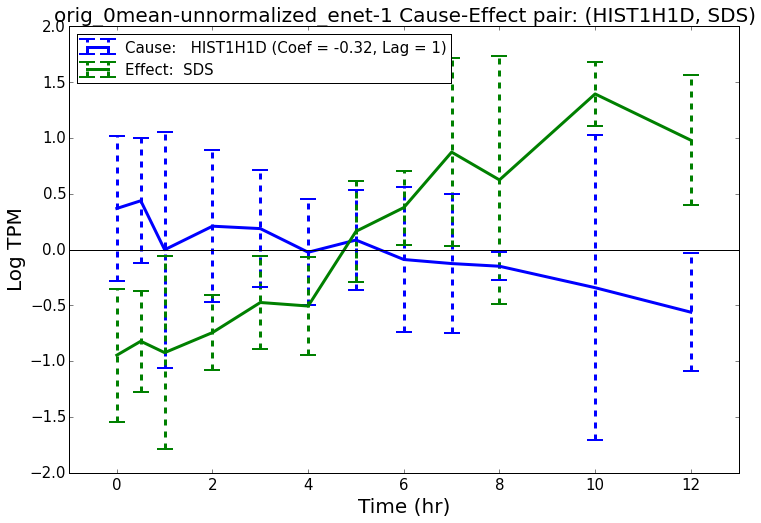

Filename:  analysis/plots/orig_0mean-unnormalized_enet-1/any-any/orig_0mean-unnormalized_enet-1_no-bar-HIST1H1D-SDS-lag-1-coef--3E-01.pdf
Plot saved to  analysis/plots/orig_0mean-unnormalized_enet-1/any-any/orig_0mean-unnormalized_enet-1_no-bar-HIST1H1D-SDS-lag-1-coef--3E-01.pdf


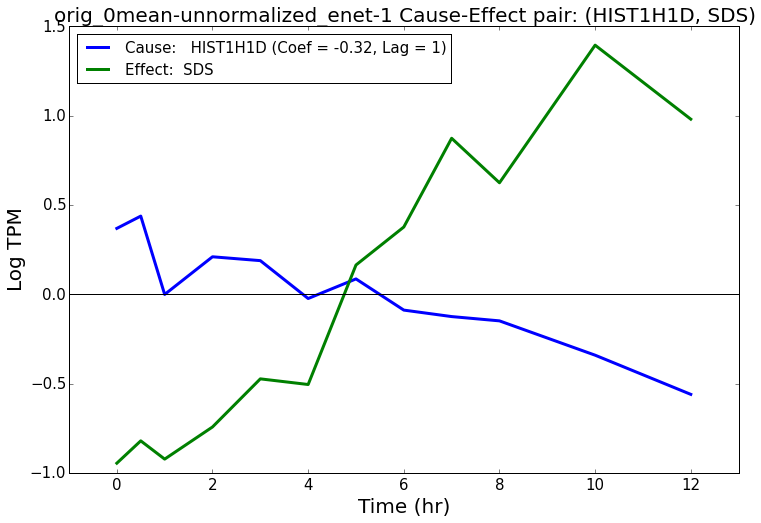

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/orig_0mean-unnormalized_enet-1/any-any/orig_0mean-unnormalized_enet-1_POU5F1-CXCL1-lag-1-coef--3E-01.pdf
Plot saved to  analysis/plots/orig_0mean-unnormalized_enet-1/any-any/orig_0mean-unnormalized_enet-1_POU5F1-CXCL1-lag-1-coef--3E-01.pdf


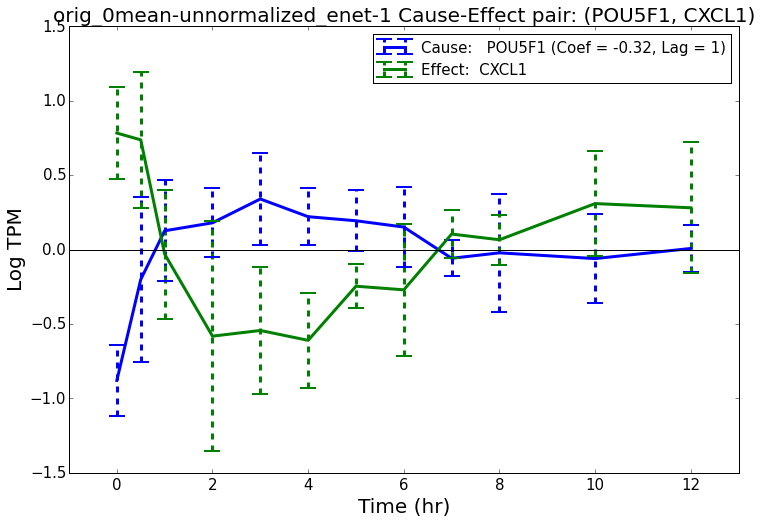

Filename:  analysis/plots/orig_0mean-unnormalized_enet-1/any-any/orig_0mean-unnormalized_enet-1_no-bar-POU5F1-CXCL1-lag-1-coef--3E-01.pdf
Plot saved to  analysis/plots/orig_0mean-unnormalized_enet-1/any-any/orig_0mean-unnormalized_enet-1_no-bar-POU5F1-CXCL1-lag-1-coef--3E-01.pdf


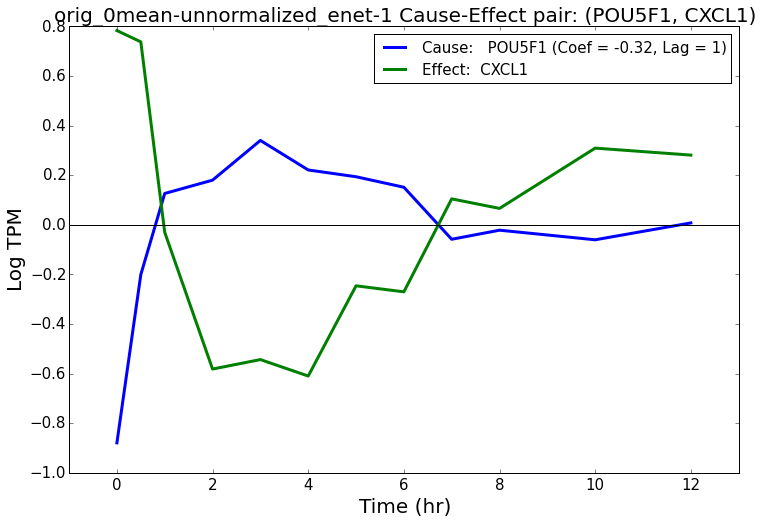

***********************************************
orig_0mean-unnormalized_enet-2
***********************************************
  Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                   Summary: Cause        Summary: Effect
0           HIST1H4A            HIST2H3D -0.293486   2.0  DNA-binding_GO,Hist-binding_GO,                    NaN
1           HIST1H1D                 SDS -0.255668   2.0                              NaN  Metabolism-gluc_GSEA,
2          HIST2H2AB              PRSS35 -0.253318   2.0                              NaN                    NaN
Written to  analysis/plots/orig_0mean-unnormalized_enet-2/any-any/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/orig_0mean-unnormalized_enet-2/any-any/orig_0mean-unnormalized_enet-2_HIST1H4A-HIST2H3D-lag-2-coef--3E-01.pdf
Plot saved to  analysis/plots/orig_0

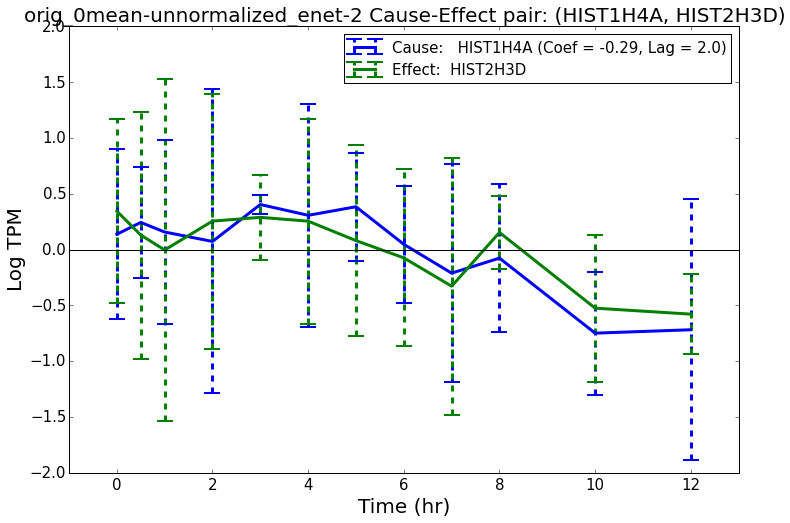

Filename:  analysis/plots/orig_0mean-unnormalized_enet-2/any-any/orig_0mean-unnormalized_enet-2_no-bar-HIST1H4A-HIST2H3D-lag-2-coef--3E-01.pdf
Plot saved to  analysis/plots/orig_0mean-unnormalized_enet-2/any-any/orig_0mean-unnormalized_enet-2_no-bar-HIST1H4A-HIST2H3D-lag-2-coef--3E-01.pdf


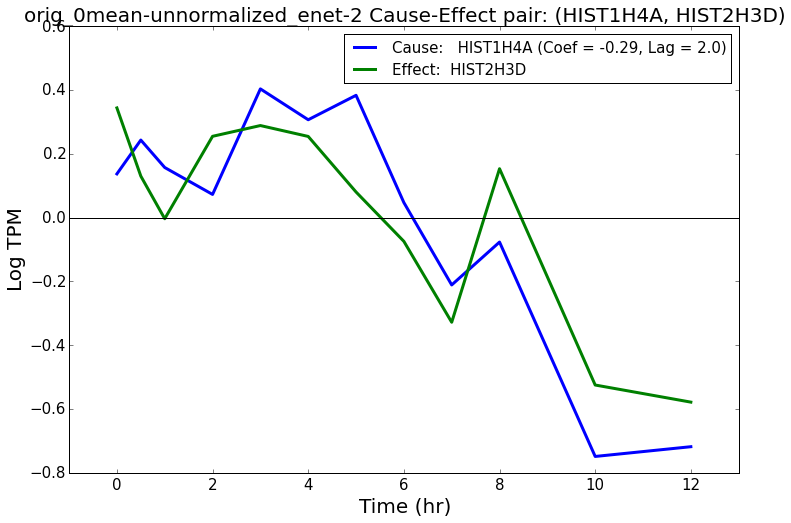

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/orig_0mean-unnormalized_enet-2/any-any/orig_0mean-unnormalized_enet-2_HIST1H1D-SDS-lag-2-coef--3E-01.pdf
Plot saved to  analysis/plots/orig_0mean-unnormalized_enet-2/any-any/orig_0mean-unnormalized_enet-2_HIST1H1D-SDS-lag-2-coef--3E-01.pdf


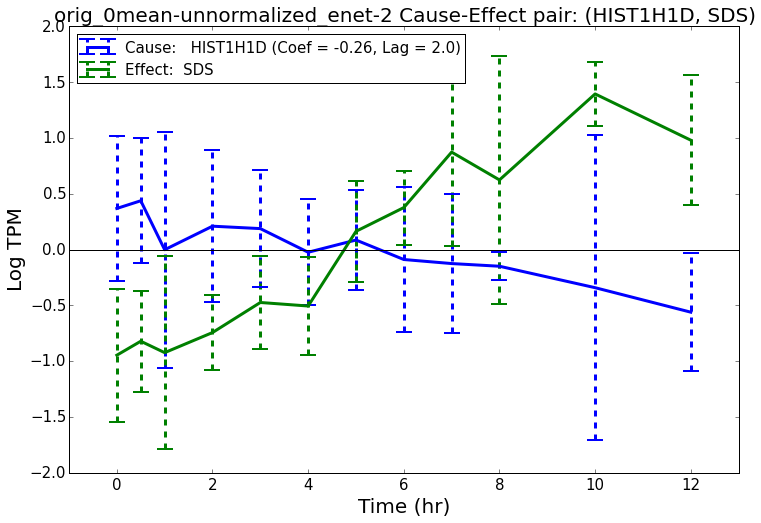

Filename:  analysis/plots/orig_0mean-unnormalized_enet-2/any-any/orig_0mean-unnormalized_enet-2_no-bar-HIST1H1D-SDS-lag-2-coef--3E-01.pdf
Plot saved to  analysis/plots/orig_0mean-unnormalized_enet-2/any-any/orig_0mean-unnormalized_enet-2_no-bar-HIST1H1D-SDS-lag-2-coef--3E-01.pdf


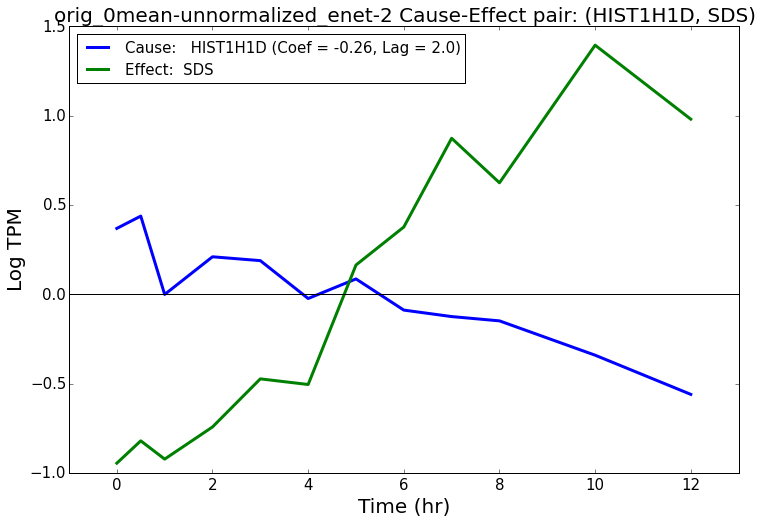

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/orig_0mean-unnormalized_enet-2/any-any/orig_0mean-unnormalized_enet-2_HIST2H2AB-PRSS35-lag-2-coef--3E-01.pdf
Plot saved to  analysis/plots/orig_0mean-unnormalized_enet-2/any-any/orig_0mean-unnormalized_enet-2_HIST2H2AB-PRSS35-lag-2-coef--3E-01.pdf


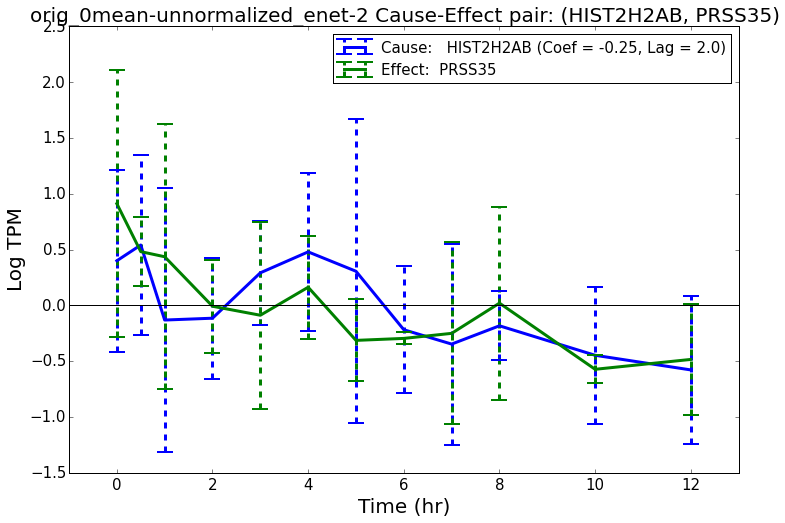

Filename:  analysis/plots/orig_0mean-unnormalized_enet-2/any-any/orig_0mean-unnormalized_enet-2_no-bar-HIST2H2AB-PRSS35-lag-2-coef--3E-01.pdf
Plot saved to  analysis/plots/orig_0mean-unnormalized_enet-2/any-any/orig_0mean-unnormalized_enet-2_no-bar-HIST2H2AB-PRSS35-lag-2-coef--3E-01.pdf


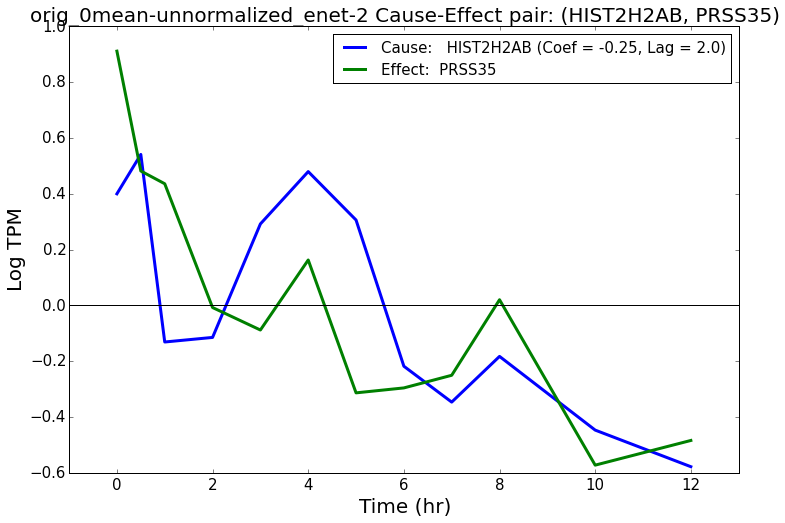

In [43]:
do_plot_nets(data_hg_df_list, plot_nets, names, timekeys_list, num_per_keys_list, timepoints_list, each_plot_folders=each_plot_folders, interest_index=None,
            ylabels=ylabels)

### Plot top TF-> any gene

In [33]:
# set which net to plot

plotfoldersuffix = "TF-any"
each_plot_folders = [os.path.join(name_plot_folder, plotfoldersuffix) for name, name_plot_folder in zip(names, name_plot_folders)]
top_edge_num = 3
plot_nets = [net[net["Cause"].isin(tf_genes)].sort_values("AbsWeight", ascending=False).head(n=top_edge_num) for net in nets]

# display annotations
for plot_net in plot_nets:
    plot_net["Gene Symbol: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_net["Cause"].values]
    plot_net["Gene Symbol: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_net["Effect"].values]
    plot_net["Summary: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Summary"].values[0] for x in plot_net["Cause"].values]
    plot_net["Summary: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Summary"].values[0] for x in plot_net["Effect"].values]

pd.set_option('display.width', 1000)

for plot_net, name in zip(plot_nets, names):
    print name
    display(plot_net)

0mean-1var_enet-1


,Cause-Effect,Cause,Effect,Weight,AbsWeight,Test,Lag,Coef,Gene Symbol: Cause,Gene Symbol: Effect,Summary: Cause,Summary: Effect
5,ENSG00000065029.13-ENSG00000170458.12,ENSG00000065029.13,ENSG00000170458.12,0.182236,0.182236,enet,1,1,ZNF76,CD14,"TF-Bioguo,","Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,"
9,ENSG00000065029.13-ENSG00000127483.16,ENSG00000065029.13,ENSG00000127483.16,-0.175461,0.175461,enet,1,1,ZNF76,HP1BP3,"TF-Bioguo,","DNA-binding_GO,"
10,ENSG00000065029.13-ENSG00000141376.19,ENSG00000065029.13,ENSG00000141376.19,0.174100,0.174100,enet,1,1,ZNF76,BCAS3,"TF-Bioguo,","TF-binding_GO,Hist-binding_GO,"


0mean-1var_enet-2


,Cause-Effect,Cause,Effect,Test,Lag,Weight1,AbsWeight1,Coef1,Weight2,AbsWeight2,Coef2,AbsWeight,Coef,Weight,Gene Symbol: Cause,Gene Symbol: Effect,Summary: Cause,Summary: Effect
37,ENSG00000065029.13-ENSG00000131584.17,ENSG00000065029.13,ENSG00000131584.17,enet,2.0,NaN,NaN,NaN,-0.125249,0.125249,2.0,0.125249,2.0,-0.125249,ZNF76,ACAP3,"TF-Bioguo,",NaN
47,ENSG00000229809.7-ENSG00000176155.17,ENSG00000229809.7,ENSG00000176155.17,enet,2.0,NaN,NaN,NaN,0.122792,0.122792,2.0,0.122792,2.0,0.122792,ZNF688,CCDC57,"TF-Bioguo,",NaN
69,ENSG00000177494.5-ENSG00000105379.8,ENSG00000177494.5,ENSG00000105379.8,enet,2.0,NaN,NaN,NaN,0.118962,0.118962,2.0,0.118962,2.0,0.118962,ZBED2,ETFB,"TF-Bioguo,",NaN


0mean-unnormalized_enet-1


,Cause-Effect,Cause,Effect,Weight,AbsWeight,Test,Lag,Coef,Gene Symbol: Cause,Gene Symbol: Effect,Summary: Cause,Summary: Effect
2,ENSG00000204531.14-ENSG00000163739.4,ENSG00000204531.14,ENSG00000163739.4,-0.318522,0.318522,enet,1,1,POU5F1,CXCL1,"GR_direct,TF-Bioguo,DNA-binding_GO,","Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,"
16,ENSG00000204531.14-ENSG00000160888.6,ENSG00000204531.14,ENSG00000160888.6,-0.248382,0.248382,enet,1,1,POU5F1,IER2,"GR_direct,TF-Bioguo,DNA-binding_GO,","DNA-binding_GO,"
48,ENSG00000204531.14-ENSG00000113916.16,ENSG00000204531.14,ENSG00000113916.16,0.220967,0.220967,enet,1,1,POU5F1,BCL6,"GR_direct,TF-Bioguo,DNA-binding_GO,","GR_direct,TF-Bioguo,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,"


0mean-unnormalized_enet-2


,Cause-Effect,Cause,Effect,Test,Lag,Weight1,AbsWeight1,Coef1,Weight2,AbsWeight2,Coef2,AbsWeight,Coef,Weight,Gene Symbol: Cause,Gene Symbol: Effect,Summary: Cause,Summary: Effect
6,ENSG00000178150.7-ENSG00000166589.11,ENSG00000178150.7,ENSG00000166589.11,enet,2.0,NaN,NaN,NaN,-0.212906,0.212906,2.0,0.212906,2.0,-0.212906,ZNF114,CDH16,"TF-Bioguo,",NaN
7,ENSG00000178150.7-ENSG00000163283.6,ENSG00000178150.7,ENSG00000163283.6,enet,2.0,NaN,NaN,NaN,-0.207097,0.207097,2.0,0.207097,2.0,-0.207097,ZNF114,ALPP,"TF-Bioguo,",NaN
8,ENSG00000178150.7-ENSG00000039987.5,ENSG00000178150.7,ENSG00000039987.5,enet,2.0,NaN,NaN,NaN,-0.204724,0.204724,2.0,0.204724,2.0,-0.204724,ZNF114,BEST2,"TF-Bioguo,","GR_direct,"


***********************************************
0mean-1var_enet-1
***********************************************
   Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause                                                    Summary: Effect
5               ZNF76                CD14  0.182236     1     TF-Bioguo,  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
9               ZNF76              HP1BP3 -0.175461     1     TF-Bioguo,                                                    DNA-binding_GO,
10              ZNF76               BCAS3  0.174100     1     TF-Bioguo,                                     TF-binding_GO,Hist-binding_GO,
Written to  analysis/plots/0mean-1var_enet-1/TF-any/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-1/TF-any/0mean-1var_enet-1_ZNF76-CD14-lag-1-coef-

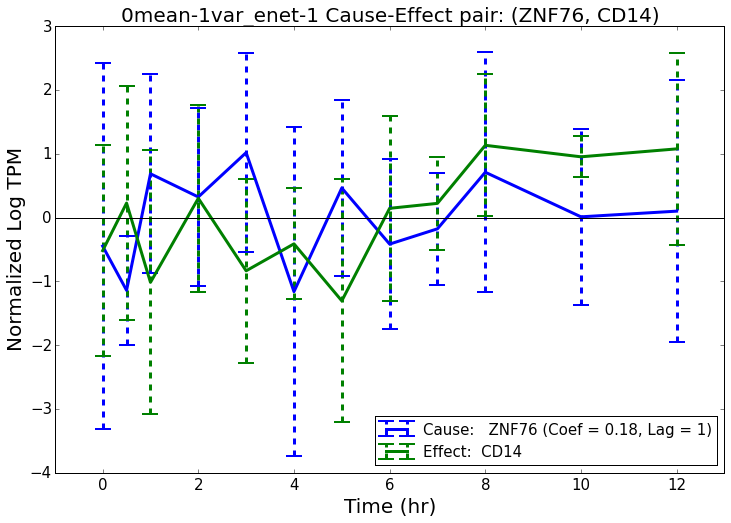

Filename:  analysis/plots/0mean-1var_enet-1/TF-any/0mean-1var_enet-1_no-bar-ZNF76-CD14-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/TF-any/0mean-1var_enet-1_no-bar-ZNF76-CD14-lag-1-coef-2E-01.pdf


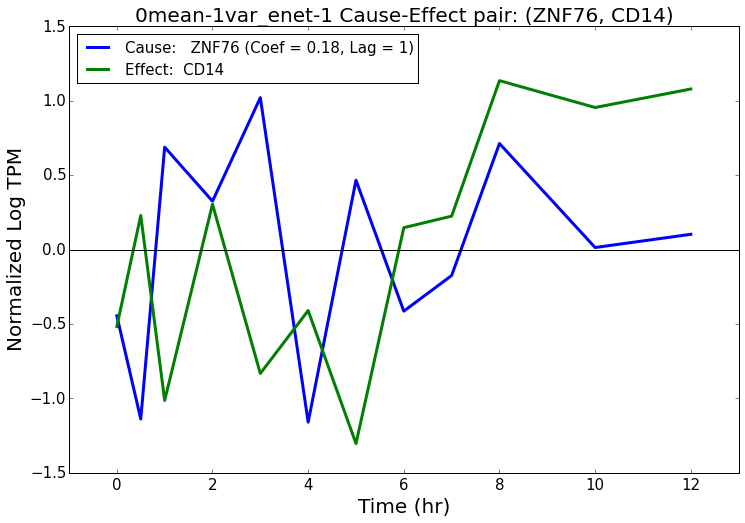

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-1/TF-any/0mean-1var_enet-1_ZNF76-HP1BP3-lag-1-coef--2E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/TF-any/0mean-1var_enet-1_ZNF76-HP1BP3-lag-1-coef--2E-01.pdf


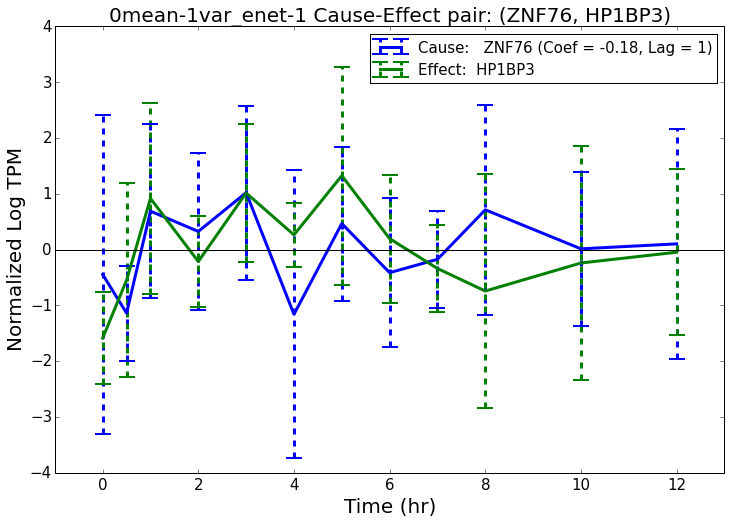

Filename:  analysis/plots/0mean-1var_enet-1/TF-any/0mean-1var_enet-1_no-bar-ZNF76-HP1BP3-lag-1-coef--2E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/TF-any/0mean-1var_enet-1_no-bar-ZNF76-HP1BP3-lag-1-coef--2E-01.pdf


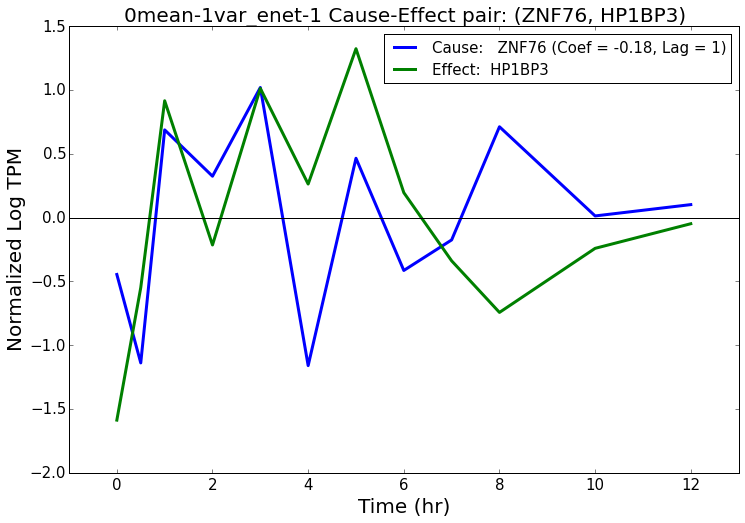

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-1/TF-any/0mean-1var_enet-1_ZNF76-BCAS3-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/TF-any/0mean-1var_enet-1_ZNF76-BCAS3-lag-1-coef-2E-01.pdf


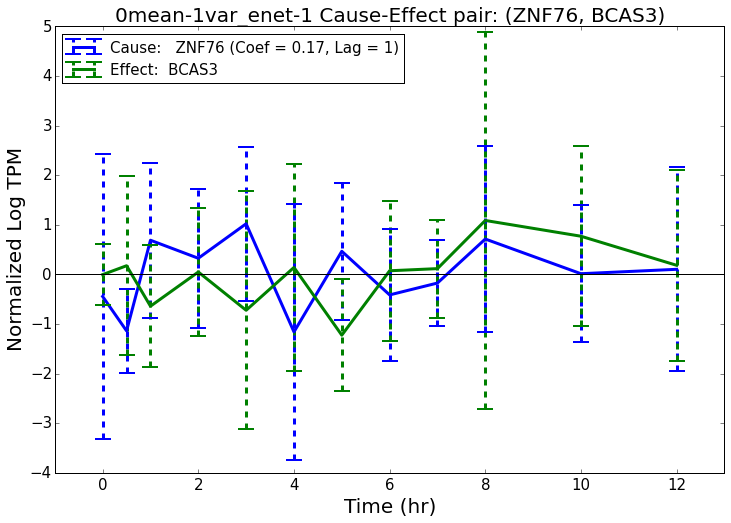

Filename:  analysis/plots/0mean-1var_enet-1/TF-any/0mean-1var_enet-1_no-bar-ZNF76-BCAS3-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/TF-any/0mean-1var_enet-1_no-bar-ZNF76-BCAS3-lag-1-coef-2E-01.pdf


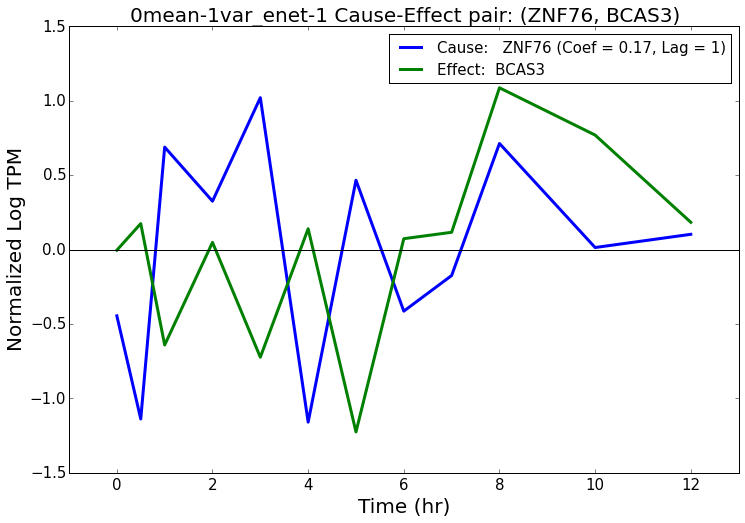

***********************************************
0mean-1var_enet-2
***********************************************
   Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause  Summary: Effect
37              ZNF76               ACAP3 -0.125249   2.0     TF-Bioguo,              NaN
47             ZNF688              CCDC57  0.122792   2.0     TF-Bioguo,              NaN
69              ZBED2                ETFB  0.118962   2.0     TF-Bioguo,              NaN
Written to  analysis/plots/0mean-1var_enet-2/TF-any/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-2/TF-any/0mean-1var_enet-2_ZNF76-ACAP3-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/TF-any/0mean-1var_enet-2_ZNF76-ACAP3-lag-2-coef--1E-01.pdf


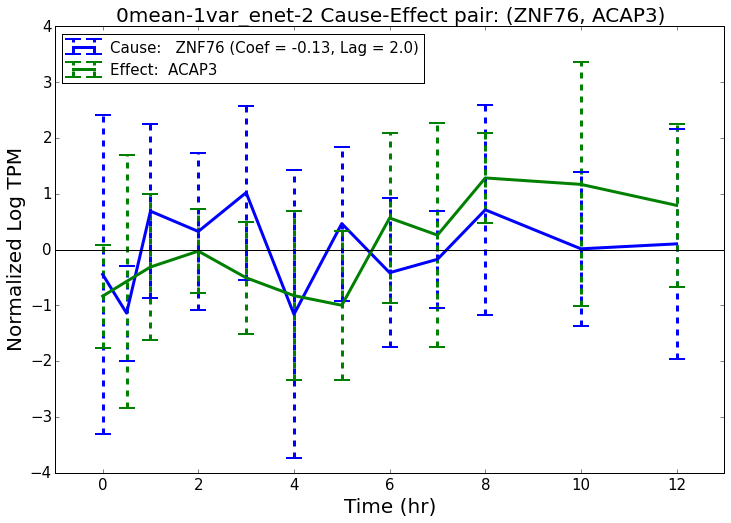

Filename:  analysis/plots/0mean-1var_enet-2/TF-any/0mean-1var_enet-2_no-bar-ZNF76-ACAP3-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/TF-any/0mean-1var_enet-2_no-bar-ZNF76-ACAP3-lag-2-coef--1E-01.pdf


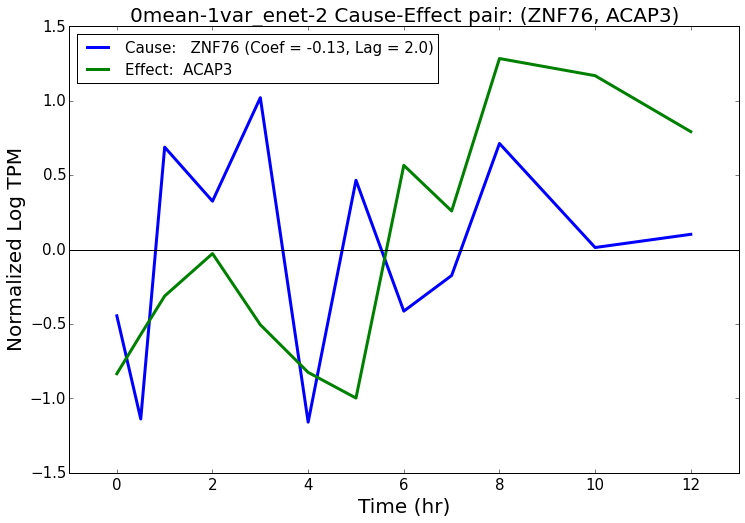

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-2/TF-any/0mean-1var_enet-2_ZNF688-CCDC57-lag-2-coef-1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/TF-any/0mean-1var_enet-2_ZNF688-CCDC57-lag-2-coef-1E-01.pdf


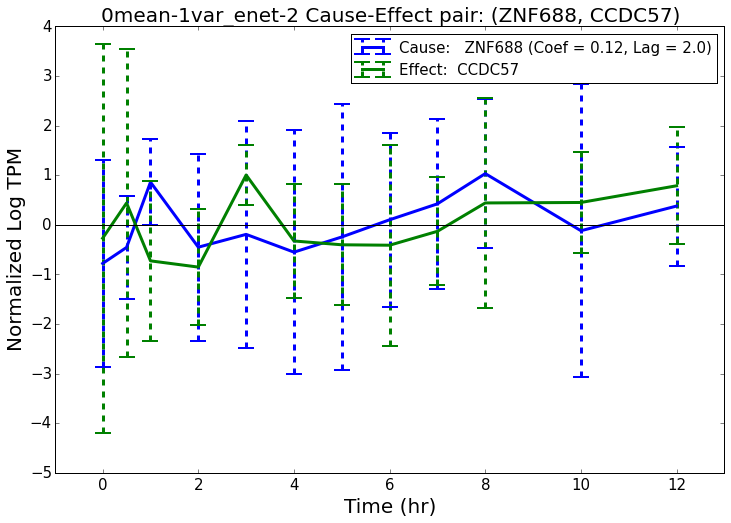

Filename:  analysis/plots/0mean-1var_enet-2/TF-any/0mean-1var_enet-2_no-bar-ZNF688-CCDC57-lag-2-coef-1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/TF-any/0mean-1var_enet-2_no-bar-ZNF688-CCDC57-lag-2-coef-1E-01.pdf


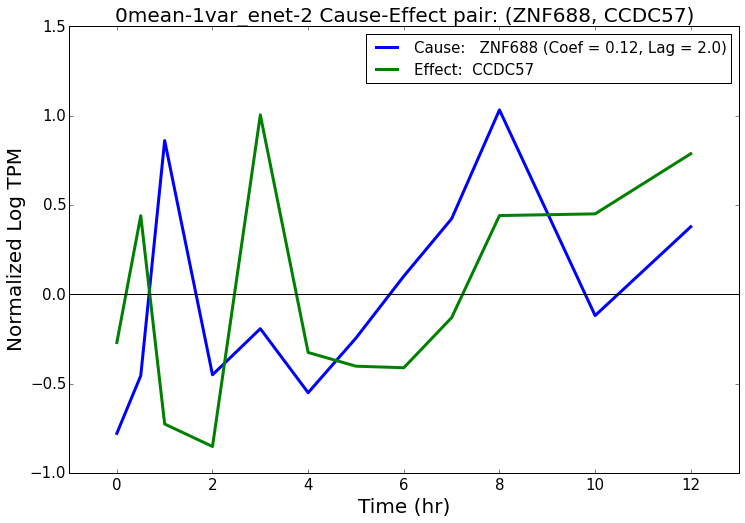

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-2/TF-any/0mean-1var_enet-2_ZBED2-ETFB-lag-2-coef-1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/TF-any/0mean-1var_enet-2_ZBED2-ETFB-lag-2-coef-1E-01.pdf


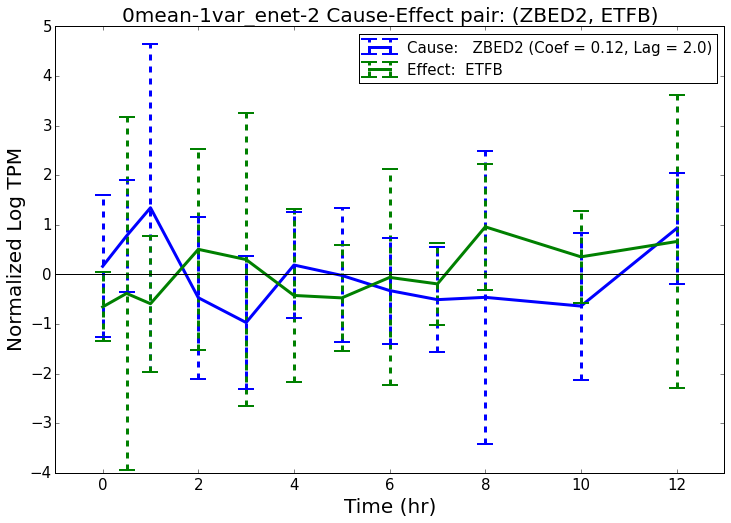

Filename:  analysis/plots/0mean-1var_enet-2/TF-any/0mean-1var_enet-2_no-bar-ZBED2-ETFB-lag-2-coef-1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/TF-any/0mean-1var_enet-2_no-bar-ZBED2-ETFB-lag-2-coef-1E-01.pdf


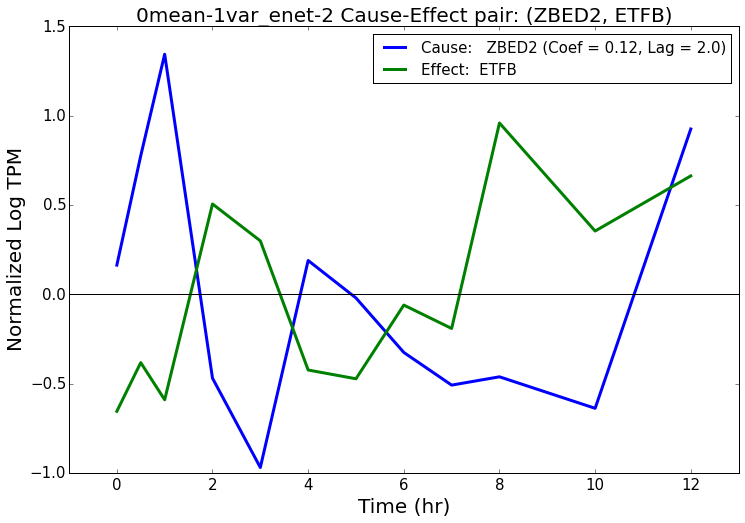

***********************************************
0mean-unnormalized_enet-1
***********************************************
   Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                       Summary: Cause                                                           Summary: Effect
2              POU5F1               CXCL1 -0.318522     1  GR_direct,TF-Bioguo,DNA-binding_GO,         Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
16             POU5F1                IER2 -0.248382     1  GR_direct,TF-Bioguo,DNA-binding_GO,                                                           DNA-binding_GO,
48             POU5F1                BCL6  0.220967     1  GR_direct,TF-Bioguo,DNA-binding_GO,  GR_direct,TF-Bioguo,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/0mean-unnormalized_enet-1/TF-any/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_re

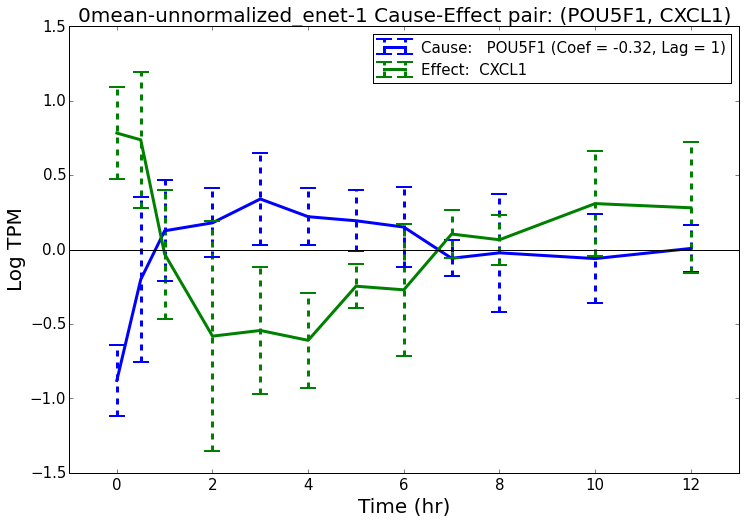

Filename:  analysis/plots/0mean-unnormalized_enet-1/TF-any/0mean-unnormalized_enet-1_no-bar-POU5F1-CXCL1-lag-1-coef--3E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/TF-any/0mean-unnormalized_enet-1_no-bar-POU5F1-CXCL1-lag-1-coef--3E-01.pdf


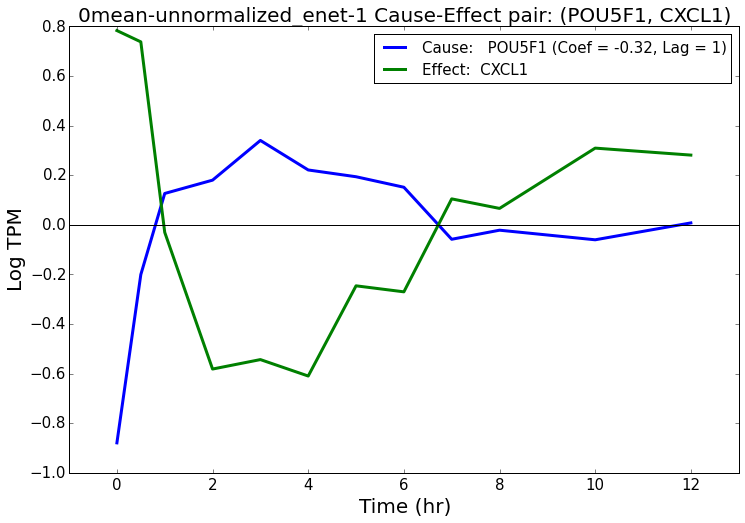

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-1/TF-any/0mean-unnormalized_enet-1_POU5F1-IER2-lag-1-coef--2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/TF-any/0mean-unnormalized_enet-1_POU5F1-IER2-lag-1-coef--2E-01.pdf


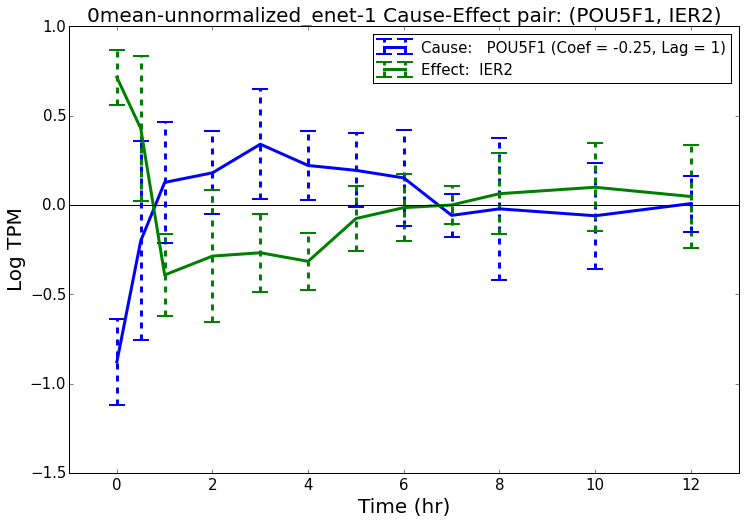

Filename:  analysis/plots/0mean-unnormalized_enet-1/TF-any/0mean-unnormalized_enet-1_no-bar-POU5F1-IER2-lag-1-coef--2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/TF-any/0mean-unnormalized_enet-1_no-bar-POU5F1-IER2-lag-1-coef--2E-01.pdf


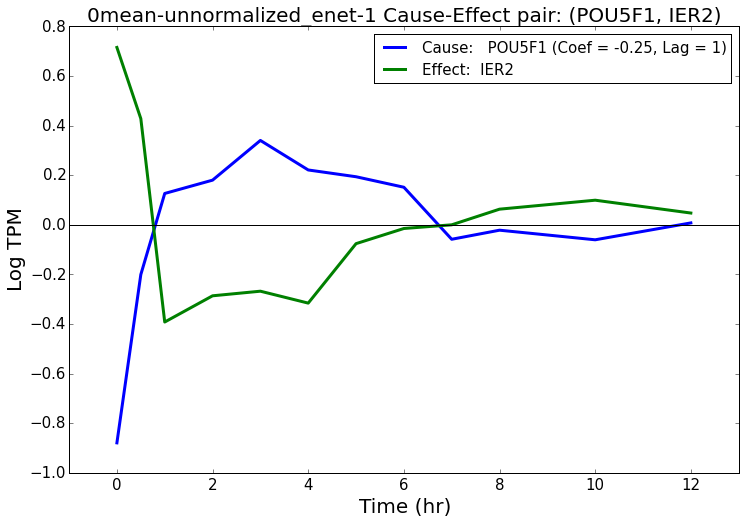

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-1/TF-any/0mean-unnormalized_enet-1_POU5F1-BCL6-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/TF-any/0mean-unnormalized_enet-1_POU5F1-BCL6-lag-1-coef-2E-01.pdf


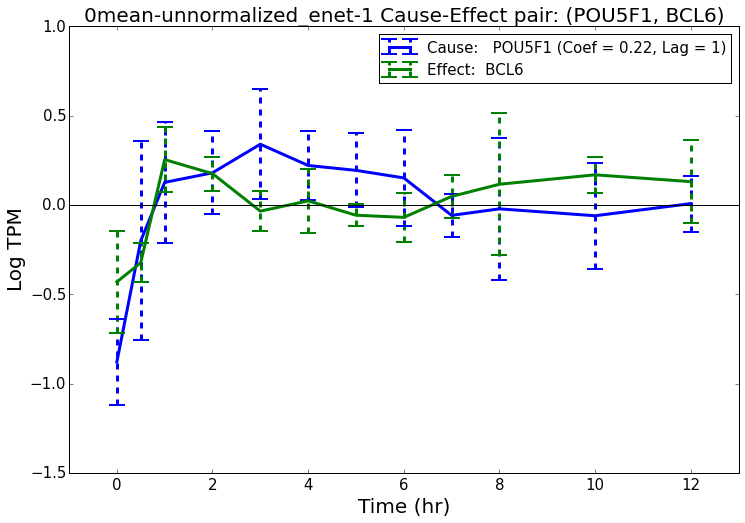

Filename:  analysis/plots/0mean-unnormalized_enet-1/TF-any/0mean-unnormalized_enet-1_no-bar-POU5F1-BCL6-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/TF-any/0mean-unnormalized_enet-1_no-bar-POU5F1-BCL6-lag-1-coef-2E-01.pdf


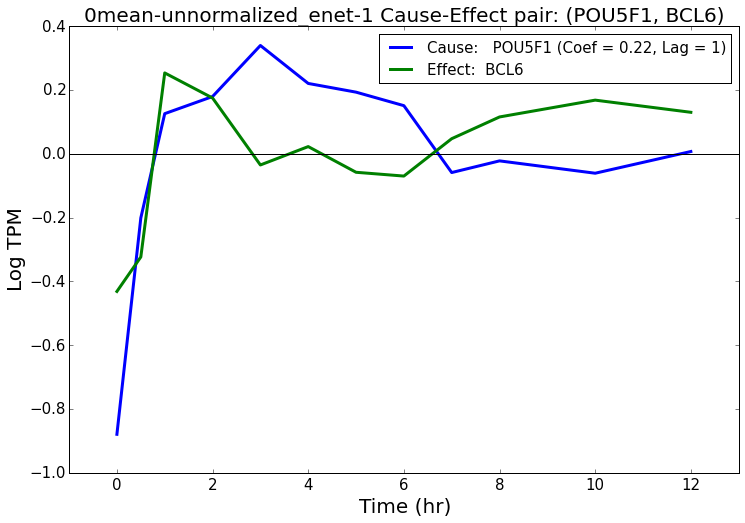

***********************************************
0mean-unnormalized_enet-2
***********************************************
  Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
6             ZNF114               CDH16 -0.212906   2.0     TF-Bioguo,             NaN
7             ZNF114                ALPP -0.207097   2.0     TF-Bioguo,             NaN
8             ZNF114               BEST2 -0.204724   2.0     TF-Bioguo,      GR_direct,
Written to  analysis/plots/0mean-unnormalized_enet-2/TF-any/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-2/TF-any/0mean-unnormalized_enet-2_ZNF114-CDH16-lag-2-coef--2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/TF-any/0mean-unnormalized_enet-2_ZNF114-CDH16-lag-2-coef--2E-01.pdf


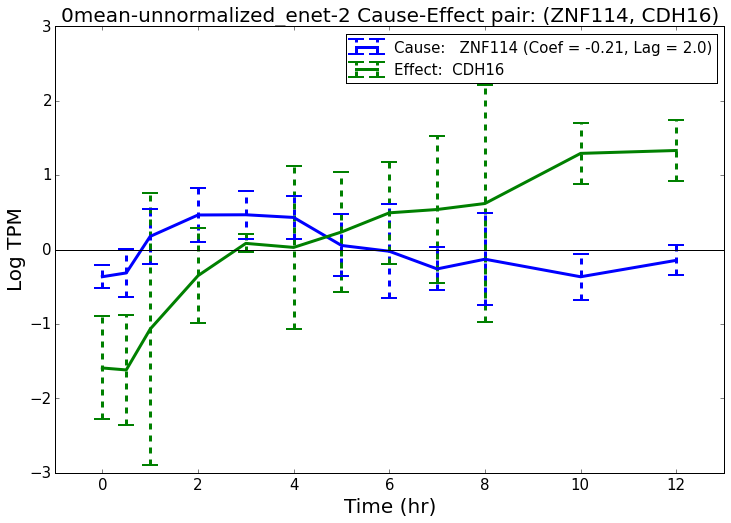

Filename:  analysis/plots/0mean-unnormalized_enet-2/TF-any/0mean-unnormalized_enet-2_no-bar-ZNF114-CDH16-lag-2-coef--2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/TF-any/0mean-unnormalized_enet-2_no-bar-ZNF114-CDH16-lag-2-coef--2E-01.pdf


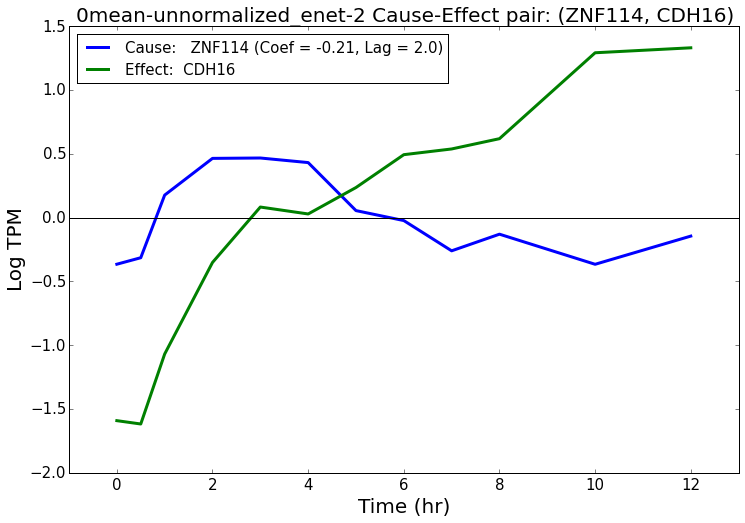

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-2/TF-any/0mean-unnormalized_enet-2_ZNF114-ALPP-lag-2-coef--2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/TF-any/0mean-unnormalized_enet-2_ZNF114-ALPP-lag-2-coef--2E-01.pdf


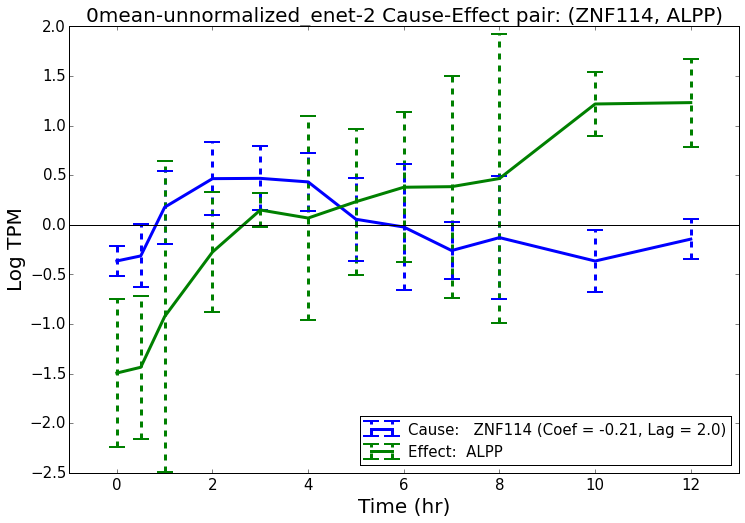

Filename:  analysis/plots/0mean-unnormalized_enet-2/TF-any/0mean-unnormalized_enet-2_no-bar-ZNF114-ALPP-lag-2-coef--2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/TF-any/0mean-unnormalized_enet-2_no-bar-ZNF114-ALPP-lag-2-coef--2E-01.pdf


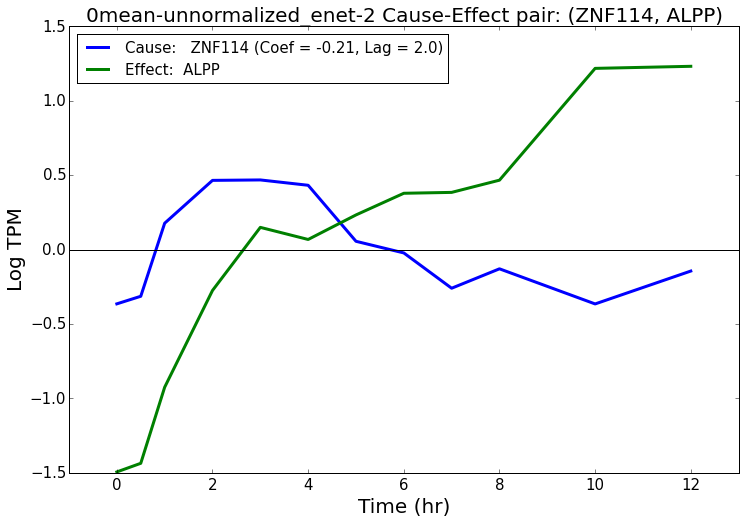

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-2/TF-any/0mean-unnormalized_enet-2_ZNF114-BEST2-lag-2-coef--2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/TF-any/0mean-unnormalized_enet-2_ZNF114-BEST2-lag-2-coef--2E-01.pdf


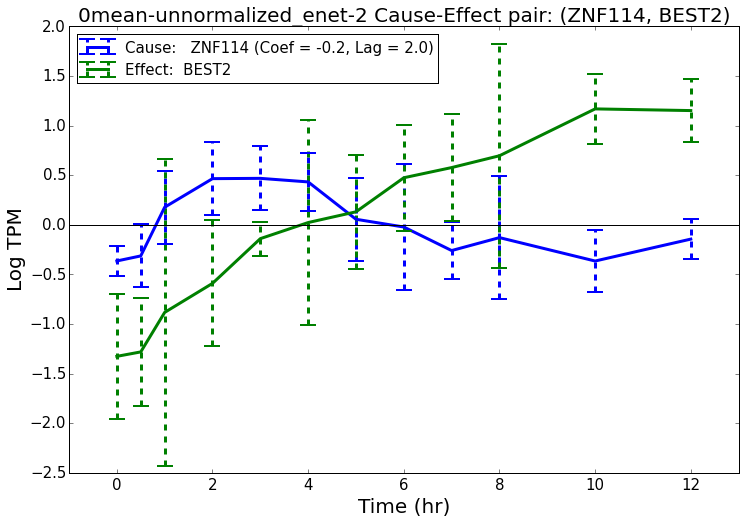

Filename:  analysis/plots/0mean-unnormalized_enet-2/TF-any/0mean-unnormalized_enet-2_no-bar-ZNF114-BEST2-lag-2-coef--2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/TF-any/0mean-unnormalized_enet-2_no-bar-ZNF114-BEST2-lag-2-coef--2E-01.pdf


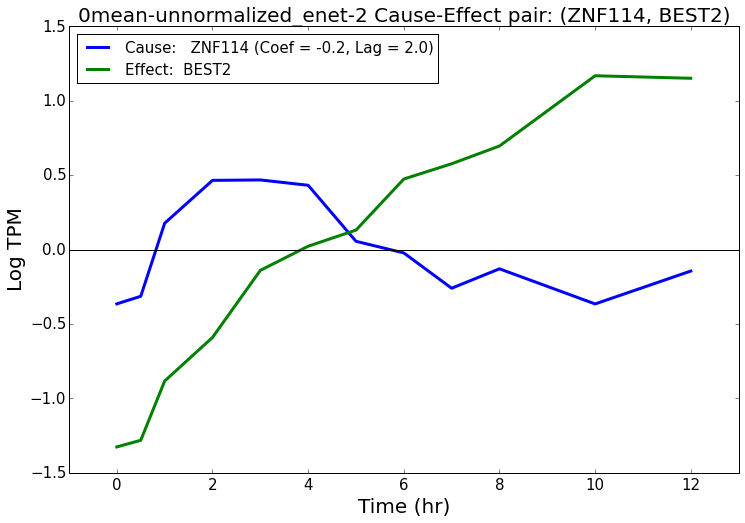

In [34]:
do_plot_nets(data_hg_df_list, plot_nets, names, timekeys_list, num_per_keys_list, timepoints_list, each_plot_folders=each_plot_folders, interest_index=None,
            ylabels=ylabels)

### Plot top any -> TF gene

In [35]:
# set which net to plot

plotfoldersuffix = "any-TF"
each_plot_folders = [os.path.join(name_plot_folder, plotfoldersuffix) for name, name_plot_folder in zip(names, name_plot_folders)]
top_edge_num = 3
plot_nets = [net[net["Effect"].isin(tf_genes)].sort_values("AbsWeight", ascending=False).head(n=top_edge_num) for net in nets]

# display annotations
for plot_net in plot_nets:
    plot_net["Gene Symbol: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_net["Cause"].values]
    plot_net["Gene Symbol: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_net["Effect"].values]
    plot_net["Summary: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Summary"].values[0] for x in plot_net["Cause"].values]
    plot_net["Summary: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Summary"].values[0] for x in plot_net["Effect"].values]

pd.set_option('display.width', 1000)

for plot_net, name in zip(plot_nets, names):
    print name
    display(plot_net)

0mean-1var_enet-1


,Cause-Effect,Cause,Effect,Weight,AbsWeight,Test,Lag,Coef,Gene Symbol: Cause,Gene Symbol: Effect,Summary: Cause,Summary: Effect
22,ENSG00000167272.9-ENSG00000177494.5,ENSG00000167272.9,ENSG00000177494.5,0.167691,0.167691,enet,1,1,POP5,ZBED2,NaN,"TF-Bioguo,"
38,ENSG00000142089.14-ENSG00000106261.15,ENSG00000142089.14,ENSG00000106261.15,-0.159026,0.159026,enet,1,1,IFITM3,ZKSCAN1,"Immune_GOC-5,Immune_GOC-4,","TF-Bioguo,"
46,ENSG00000103647.11-ENSG00000072310.15,ENSG00000103647.11,ENSG00000072310.15,0.157384,0.157384,enet,1,1,CORO2B,SREBF1,NaN,"TF-Bioguo,"


0mean-1var_enet-2


,Cause-Effect,Cause,Effect,Test,Lag,Weight1,AbsWeight1,Coef1,Weight2,AbsWeight2,Coef2,AbsWeight,Coef,Weight,Gene Symbol: Cause,Gene Symbol: Effect,Summary: Cause,Summary: Effect
10,ENSG00000177042.13-ENSG00000120075.5,ENSG00000177042.13,ENSG00000120075.5,enet,2.0,-0.144555,0.144555,1.0,NaN,NaN,NaN,0.144555,1.0,-0.144555,TMEM80,HOXB5,NaN,"TF-Bioguo,"
44,ENSG00000275993.2-ENSG00000196693.13,ENSG00000275993.2,ENSG00000196693.13,enet,2.0,NaN,NaN,NaN,-0.124139,0.124139,2.0,0.124139,2.0,-0.124139,CH507-42P11.8,ZNF33B,NaN,"TF-Bioguo,"
53,ENSG00000149476.13-ENSG00000198315.9,ENSG00000149476.13,ENSG00000198315.9,enet,2.0,NaN,NaN,NaN,-0.122430,0.122430,2.0,0.122430,2.0,-0.122430,DAK,ZKSCAN8,NaN,"TF-Bioguo,"


0mean-unnormalized_enet-1


,Cause-Effect,Cause,Effect,Weight,AbsWeight,Test,Lag,Coef,Gene Symbol: Cause,Gene Symbol: Effect,Summary: Cause,Summary: Effect
11,ENSG00000129988.5-ENSG00000115112.7,ENSG00000129988.5,ENSG00000115112.7,0.253041,0.253041,enet,1,1,LBP,TFCP2L1,"Immune_GOC-5,Immune_GOC-4,","GR_direct,TF-Bioguo,"
13,ENSG00000205177.6-ENSG00000157514.15,ENSG00000205177.6,ENSG00000157514.15,0.251177,0.251177,enet,1,1,C11orf91,TSC22D3,"GR_direct,","TF-Bioguo,"
14,ENSG00000056736.8-ENSG00000157514.15,ENSG00000056736.8,ENSG00000157514.15,-0.250643,0.250643,enet,1,1,IL17RB,TSC22D3,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,","TF-Bioguo,"


0mean-unnormalized_enet-2


,Cause-Effect,Cause,Effect,Test,Lag,Weight1,AbsWeight1,Coef1,Weight2,AbsWeight2,Coef2,AbsWeight,Coef,Weight,Gene Symbol: Cause,Gene Symbol: Effect,Summary: Cause,Summary: Effect
89,ENSG00000178150.7-ENSG00000115112.7,ENSG00000178150.7,ENSG00000115112.7,enet,2.0,NaN,NaN,NaN,-0.159768,0.159768,2.0,0.159768,2.0,-0.159768,ZNF114,TFCP2L1,"TF-Bioguo,","GR_direct,TF-Bioguo,"
97,ENSG00000167772.10-ENSG00000119138.4,ENSG00000167772.10,ENSG00000119138.4,enet,2.0,NaN,NaN,NaN,0.157183,0.157183,2.0,0.157183,2.0,0.157183,ANGPTL4,KLF9,"GR_direct,Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,","GR_direct,TF-Bioguo,"
126,ENSG00000278637.1-ENSG00000169297.7,ENSG00000278637.1,ENSG00000169297.7,enet,2.0,NaN,NaN,NaN,-0.151332,0.151332,2.0,0.151332,2.0,-0.151332,HIST1H4A,NR0B1,"DNA-binding_GO,Hist-binding_GO,","TF-Bioguo,TF-binding_GO,DNA-binding_GO,"


***********************************************
0mean-1var_enet-1
***********************************************
   Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef              Summary: Cause Summary: Effect
22               POP5               ZBED2  0.167691     1                         NaN      TF-Bioguo,
38             IFITM3             ZKSCAN1 -0.159026     1  Immune_GOC-5,Immune_GOC-4,      TF-Bioguo,
46             CORO2B              SREBF1  0.157384     1                         NaN      TF-Bioguo,
Written to  analysis/plots/0mean-1var_enet-1/any-TF/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-1/any-TF/0mean-1var_enet-1_POP5-ZBED2-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/any-TF/0mean-1var_enet-1_POP5-ZBED2-lag-1-coef-2E-01.pdf


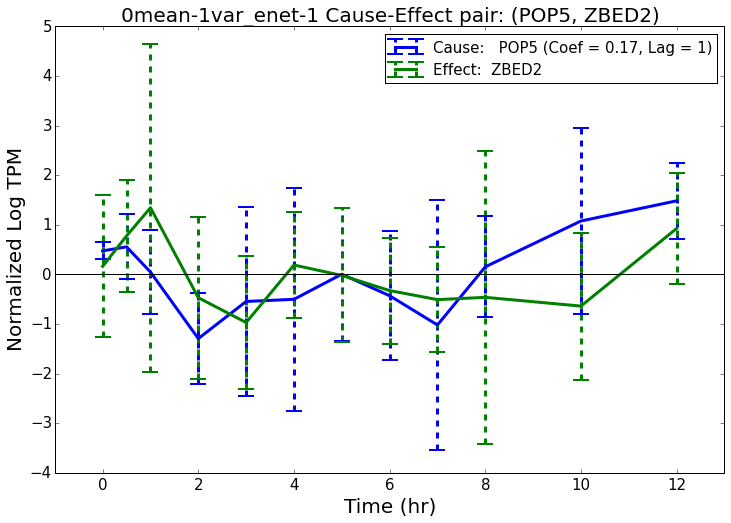

Filename:  analysis/plots/0mean-1var_enet-1/any-TF/0mean-1var_enet-1_no-bar-POP5-ZBED2-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/any-TF/0mean-1var_enet-1_no-bar-POP5-ZBED2-lag-1-coef-2E-01.pdf


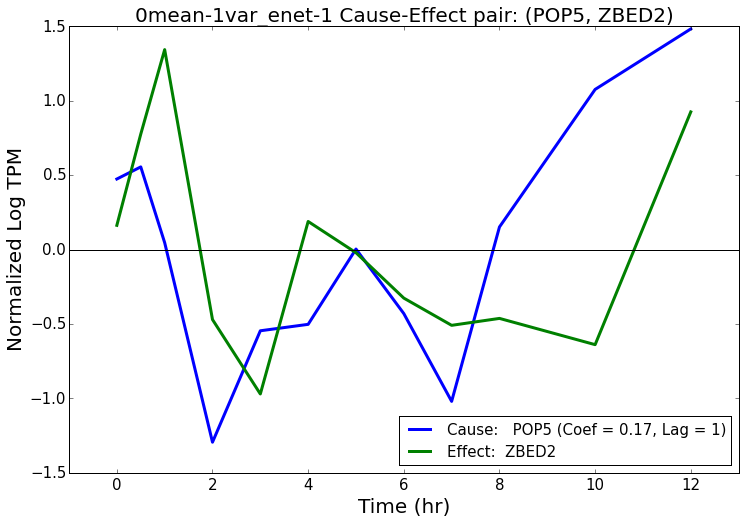

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-1/any-TF/0mean-1var_enet-1_IFITM3-ZKSCAN1-lag-1-coef--2E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/any-TF/0mean-1var_enet-1_IFITM3-ZKSCAN1-lag-1-coef--2E-01.pdf


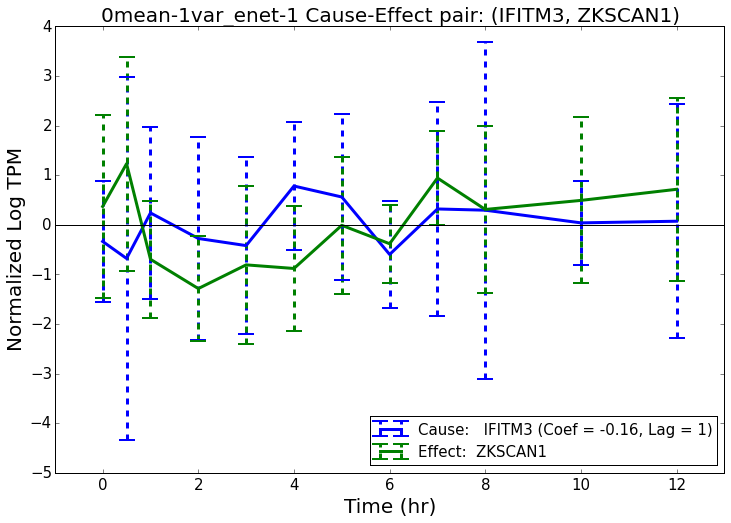

Filename:  analysis/plots/0mean-1var_enet-1/any-TF/0mean-1var_enet-1_no-bar-IFITM3-ZKSCAN1-lag-1-coef--2E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/any-TF/0mean-1var_enet-1_no-bar-IFITM3-ZKSCAN1-lag-1-coef--2E-01.pdf


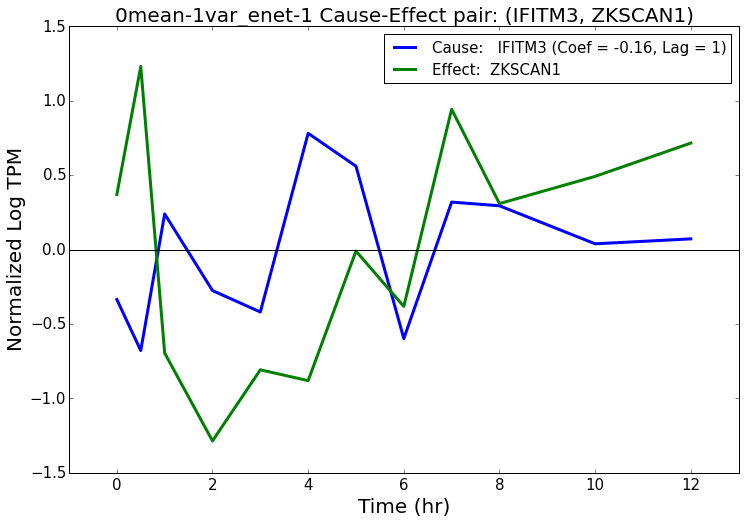

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-1/any-TF/0mean-1var_enet-1_CORO2B-SREBF1-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/any-TF/0mean-1var_enet-1_CORO2B-SREBF1-lag-1-coef-2E-01.pdf


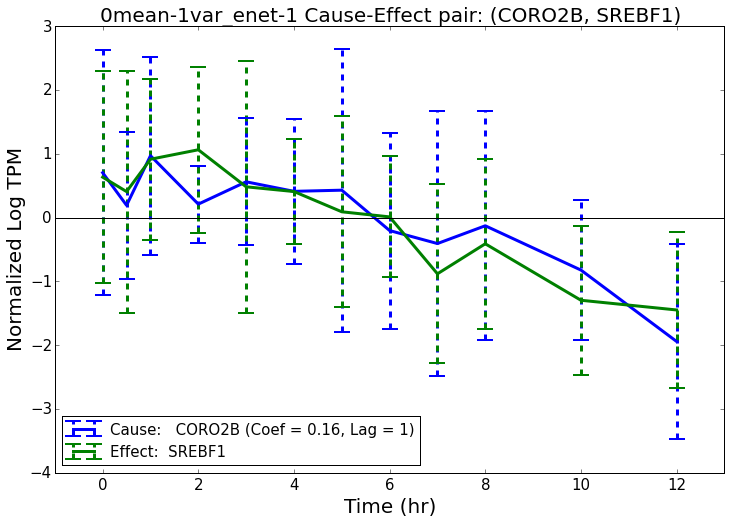

Filename:  analysis/plots/0mean-1var_enet-1/any-TF/0mean-1var_enet-1_no-bar-CORO2B-SREBF1-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/any-TF/0mean-1var_enet-1_no-bar-CORO2B-SREBF1-lag-1-coef-2E-01.pdf


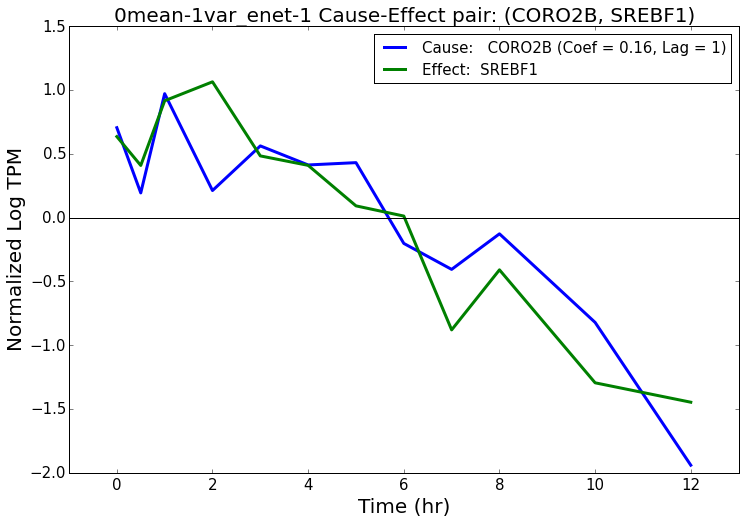

***********************************************
0mean-1var_enet-2
***********************************************
   Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef  Summary: Cause Summary: Effect
10             TMEM80               HOXB5 -0.144555   1.0             NaN      TF-Bioguo,
44      CH507-42P11.8              ZNF33B -0.124139   2.0             NaN      TF-Bioguo,
53                DAK             ZKSCAN8 -0.122430   2.0             NaN      TF-Bioguo,
Written to  analysis/plots/0mean-1var_enet-2/any-TF/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-2/any-TF/0mean-1var_enet-2_TMEM80-HOXB5-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/any-TF/0mean-1var_enet-2_TMEM80-HOXB5-lag-2-coef--1E-01.pdf


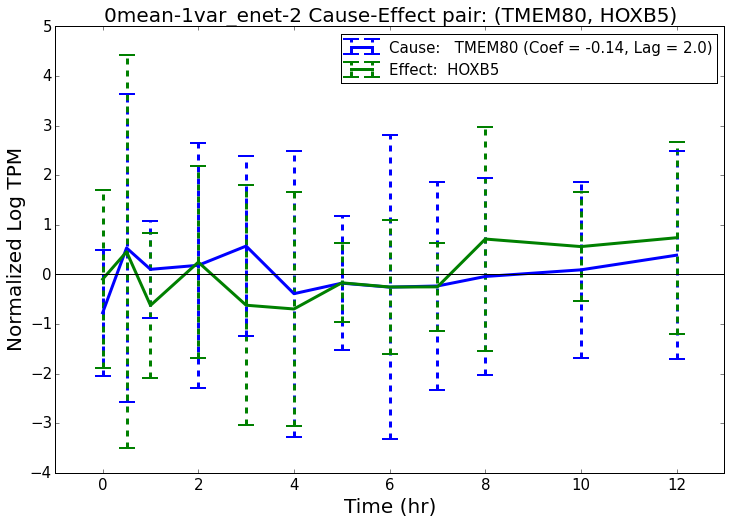

Filename:  analysis/plots/0mean-1var_enet-2/any-TF/0mean-1var_enet-2_no-bar-TMEM80-HOXB5-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/any-TF/0mean-1var_enet-2_no-bar-TMEM80-HOXB5-lag-2-coef--1E-01.pdf


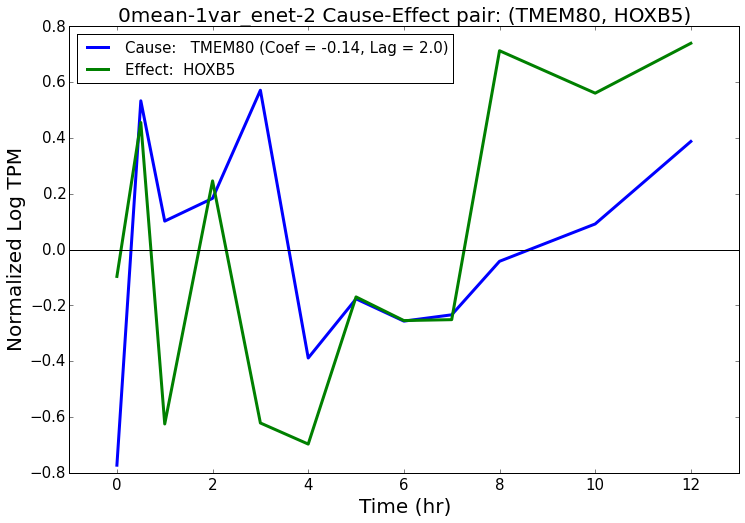

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-2/any-TF/0mean-1var_enet-2_CH507-42P11,8-ZNF33B-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/any-TF/0mean-1var_enet-2_CH507-42P11,8-ZNF33B-lag-2-coef--1E-01.pdf


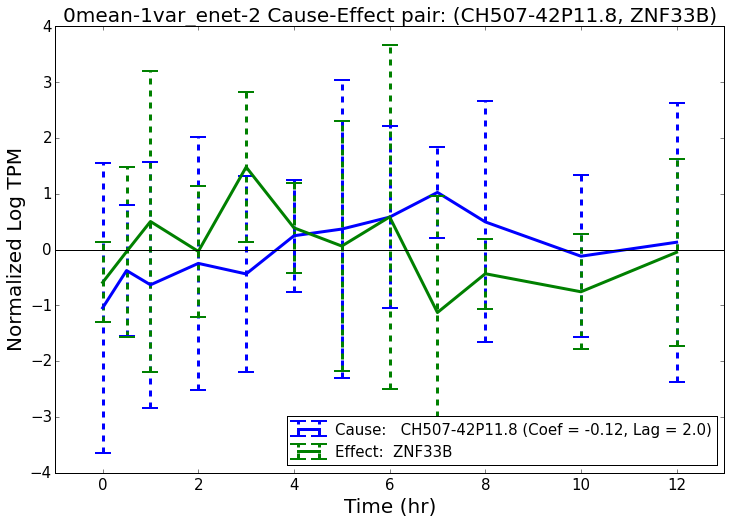

Filename:  analysis/plots/0mean-1var_enet-2/any-TF/0mean-1var_enet-2_no-bar-CH507-42P11,8-ZNF33B-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/any-TF/0mean-1var_enet-2_no-bar-CH507-42P11,8-ZNF33B-lag-2-coef--1E-01.pdf


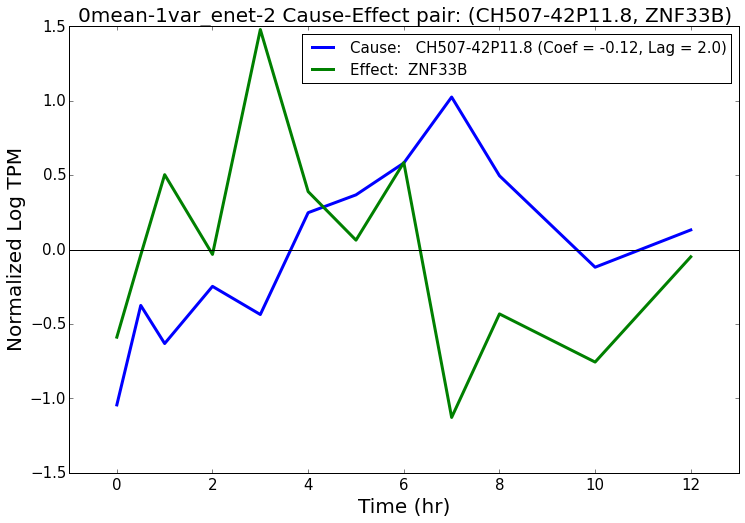

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-2/any-TF/0mean-1var_enet-2_DAK-ZKSCAN8-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/any-TF/0mean-1var_enet-2_DAK-ZKSCAN8-lag-2-coef--1E-01.pdf


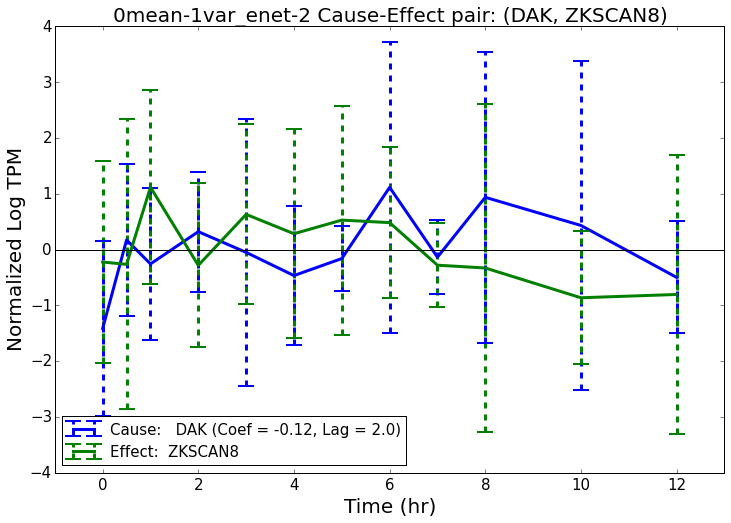

Filename:  analysis/plots/0mean-1var_enet-2/any-TF/0mean-1var_enet-2_no-bar-DAK-ZKSCAN8-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/any-TF/0mean-1var_enet-2_no-bar-DAK-ZKSCAN8-lag-2-coef--1E-01.pdf


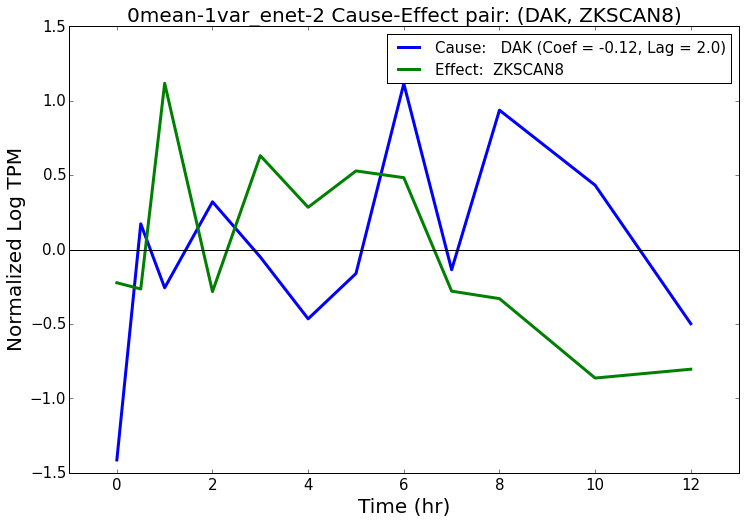

***********************************************
0mean-unnormalized_enet-1
***********************************************
   Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                        Summary: Cause       Summary: Effect
11                LBP             TFCP2L1  0.253041     1                            Immune_GOC-5,Immune_GOC-4,  GR_direct,TF-Bioguo,
13           C11orf91             TSC22D3  0.251177     1                                            GR_direct,            TF-Bioguo,
14             IL17RB             TSC22D3 -0.250643     1  Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,            TF-Bioguo,
Written to  analysis/plots/0mean-unnormalized_enet-1/any-TF/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-1/any-TF/0mean-unnormalized_enet-1_LBP-TFCP2L1-la

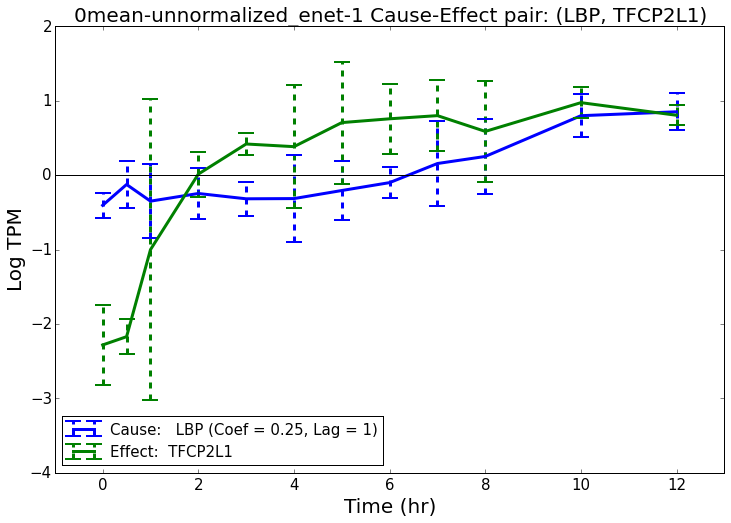

Filename:  analysis/plots/0mean-unnormalized_enet-1/any-TF/0mean-unnormalized_enet-1_no-bar-LBP-TFCP2L1-lag-1-coef-3E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/any-TF/0mean-unnormalized_enet-1_no-bar-LBP-TFCP2L1-lag-1-coef-3E-01.pdf


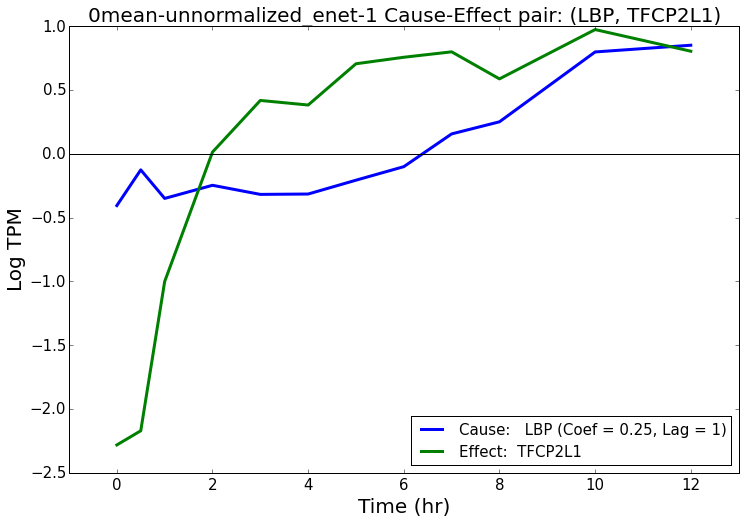

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-1/any-TF/0mean-unnormalized_enet-1_C11orf91-TSC22D3-lag-1-coef-3E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/any-TF/0mean-unnormalized_enet-1_C11orf91-TSC22D3-lag-1-coef-3E-01.pdf


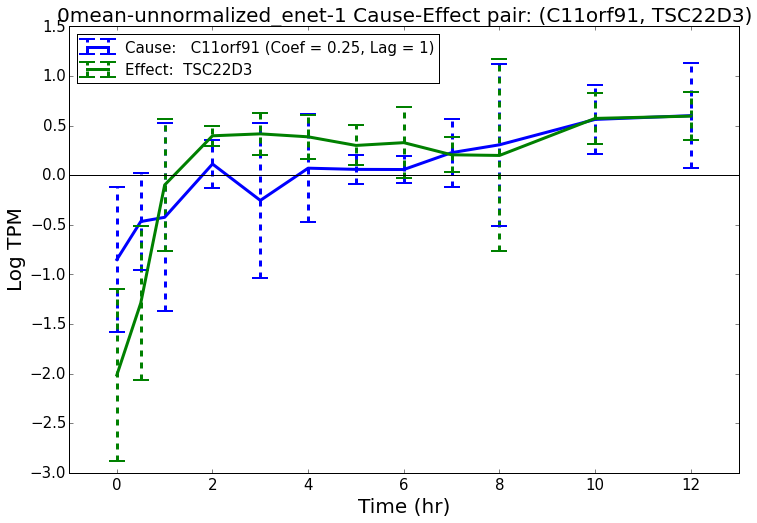

Filename:  analysis/plots/0mean-unnormalized_enet-1/any-TF/0mean-unnormalized_enet-1_no-bar-C11orf91-TSC22D3-lag-1-coef-3E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/any-TF/0mean-unnormalized_enet-1_no-bar-C11orf91-TSC22D3-lag-1-coef-3E-01.pdf


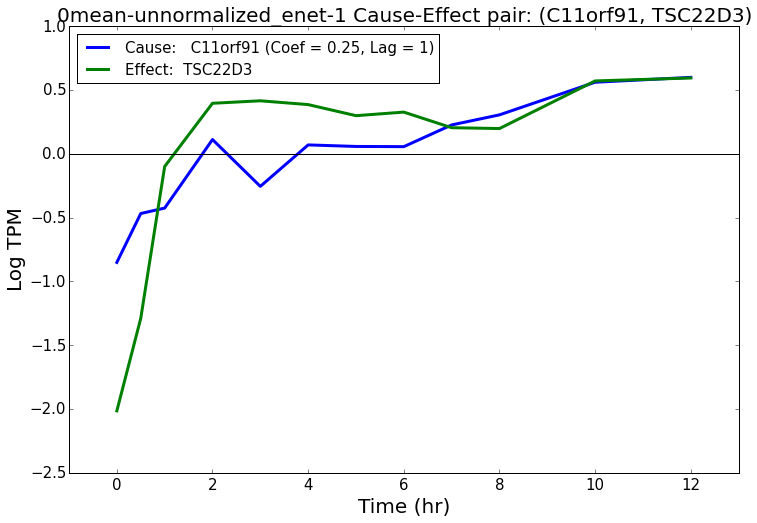

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-1/any-TF/0mean-unnormalized_enet-1_IL17RB-TSC22D3-lag-1-coef--3E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/any-TF/0mean-unnormalized_enet-1_IL17RB-TSC22D3-lag-1-coef--3E-01.pdf


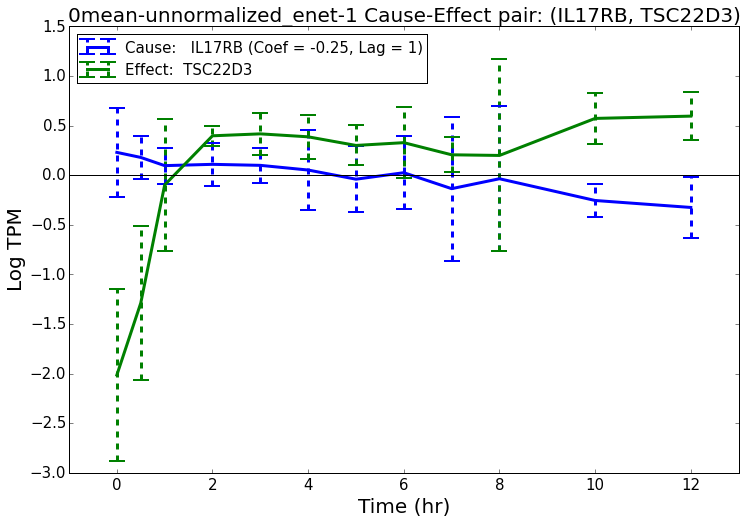

Filename:  analysis/plots/0mean-unnormalized_enet-1/any-TF/0mean-unnormalized_enet-1_no-bar-IL17RB-TSC22D3-lag-1-coef--3E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/any-TF/0mean-unnormalized_enet-1_no-bar-IL17RB-TSC22D3-lag-1-coef--3E-01.pdf


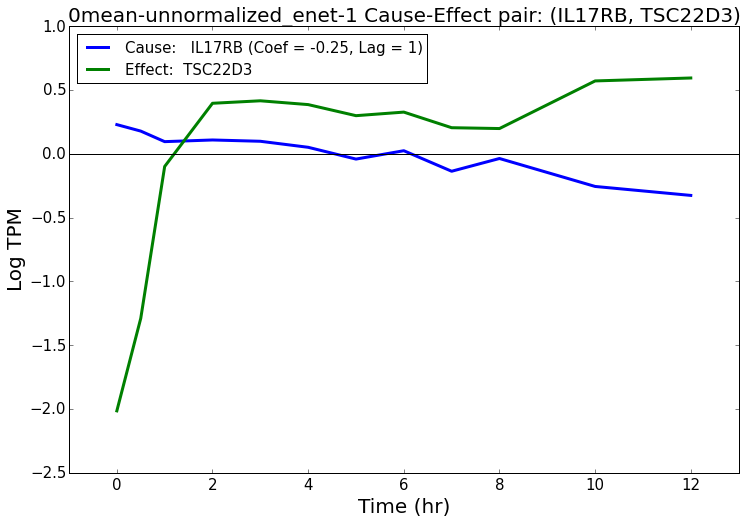

***********************************************
0mean-unnormalized_enet-2
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                         Summary: Cause                          Summary: Effect
89              ZNF114             TFCP2L1 -0.159768   2.0                                             TF-Bioguo,                     GR_direct,TF-Bioguo,
97             ANGPTL4                KLF9  0.157183   2.0  GR_direct,Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,                     GR_direct,TF-Bioguo,
126           HIST1H4A               NR0B1 -0.151332   2.0                        DNA-binding_GO,Hist-binding_GO,  TF-Bioguo,TF-binding_GO,DNA-binding_GO,
Written to  analysis/plots/0mean-unnormalized_enet-2/any-TF/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  anal

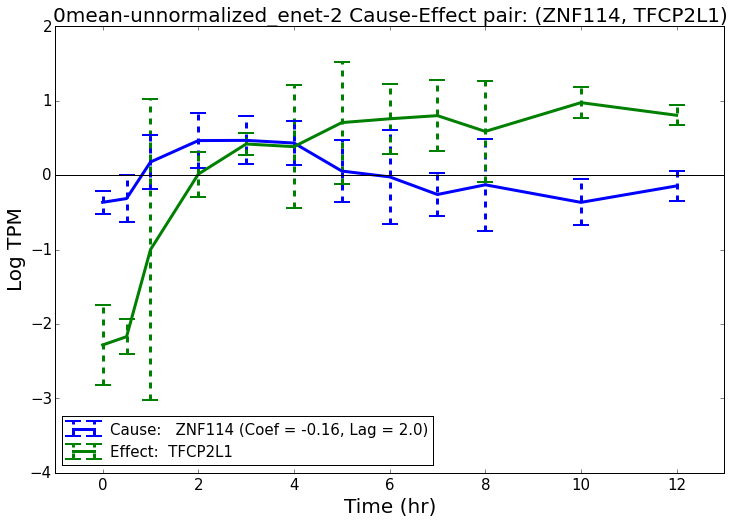

Filename:  analysis/plots/0mean-unnormalized_enet-2/any-TF/0mean-unnormalized_enet-2_no-bar-ZNF114-TFCP2L1-lag-2-coef--2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/any-TF/0mean-unnormalized_enet-2_no-bar-ZNF114-TFCP2L1-lag-2-coef--2E-01.pdf


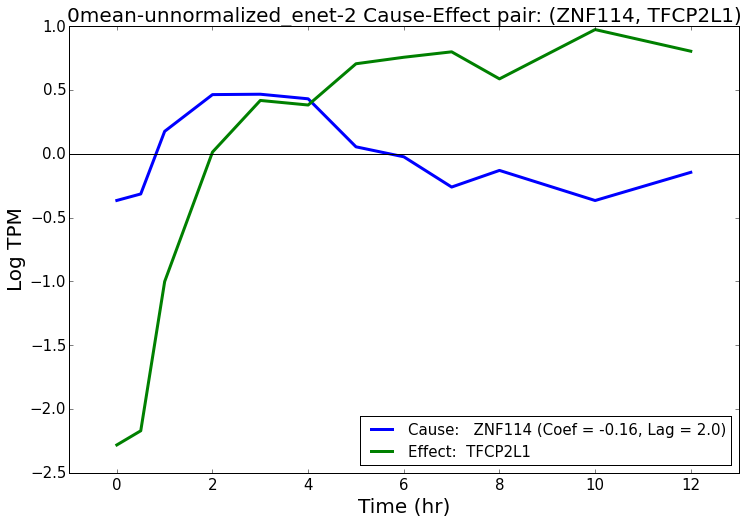

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-2/any-TF/0mean-unnormalized_enet-2_ANGPTL4-KLF9-lag-2-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/any-TF/0mean-unnormalized_enet-2_ANGPTL4-KLF9-lag-2-coef-2E-01.pdf


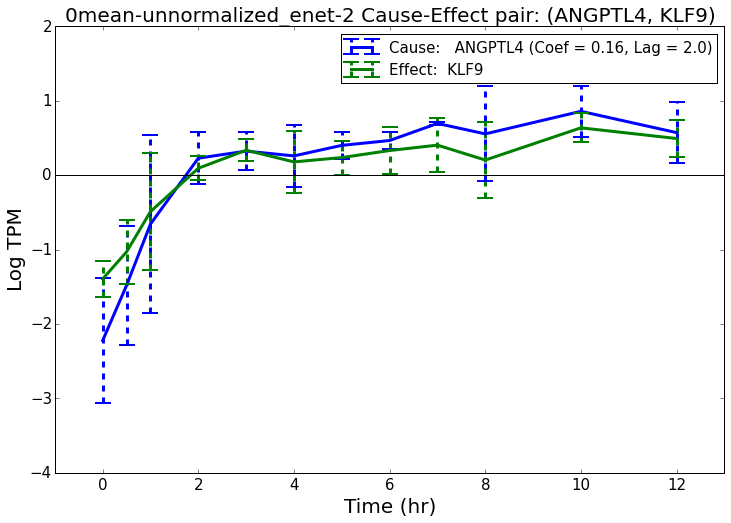

Filename:  analysis/plots/0mean-unnormalized_enet-2/any-TF/0mean-unnormalized_enet-2_no-bar-ANGPTL4-KLF9-lag-2-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/any-TF/0mean-unnormalized_enet-2_no-bar-ANGPTL4-KLF9-lag-2-coef-2E-01.pdf


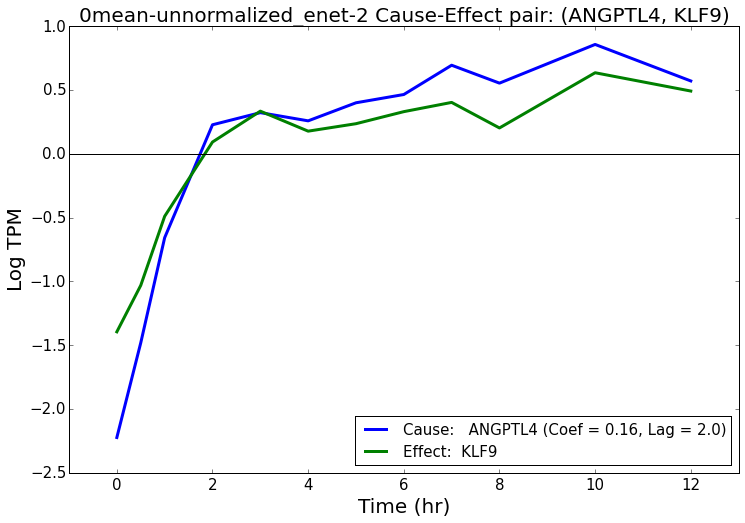

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-2/any-TF/0mean-unnormalized_enet-2_HIST1H4A-NR0B1-lag-2-coef--2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/any-TF/0mean-unnormalized_enet-2_HIST1H4A-NR0B1-lag-2-coef--2E-01.pdf


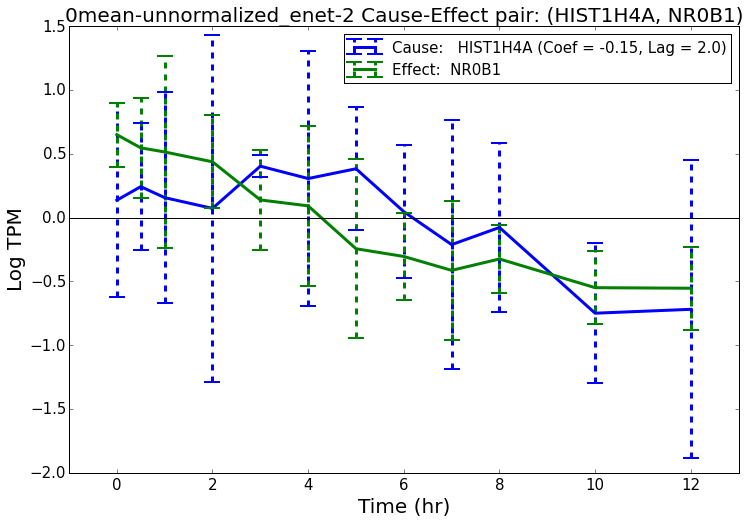

Filename:  analysis/plots/0mean-unnormalized_enet-2/any-TF/0mean-unnormalized_enet-2_no-bar-HIST1H4A-NR0B1-lag-2-coef--2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/any-TF/0mean-unnormalized_enet-2_no-bar-HIST1H4A-NR0B1-lag-2-coef--2E-01.pdf


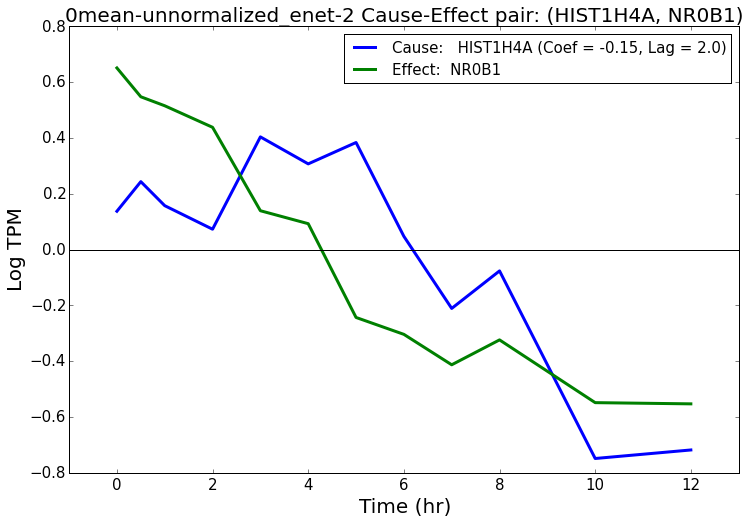

In [36]:
do_plot_nets(data_hg_df_list, plot_nets, names, timekeys_list, num_per_keys_list, timepoints_list, each_plot_folders=each_plot_folders, interest_index=None,
            ylabels=ylabels)

### Plot top any -> metabolism

In [37]:
# set which net to plot

plotfoldersuffix = "any-metab"
each_plot_folders = [os.path.join(name_plot_folder, plotfoldersuffix) for name, name_plot_folder in zip(names, name_plot_folders)]
top_edge_num = 3
plot_nets = [net[net["Effect"].isin(metab_genes)].sort_values("AbsWeight", ascending=False).head(n=top_edge_num) for net in nets]

# display annotations
for plot_net in plot_nets:
    plot_net["Gene Symbol: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_net["Cause"].values]
    plot_net["Gene Symbol: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_net["Effect"].values]
    plot_net["Summary: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Summary"].values[0] for x in plot_net["Cause"].values]
    plot_net["Summary: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Summary"].values[0] for x in plot_net["Effect"].values]



***********************************************
0mean-1var_enet-1
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef  Summary: Cause                                                                      Summary: Effect
56                GGA1                ENO3 -0.154748     1             NaN                                                                Metabolism-gluc_GSEA,
106             FBXO38               ACOT8  0.145407     1             NaN                                                               Metabolism-lipid_GSEA,
122             SWSAP1               YWHAH  0.143269     1             NaN  GR_GO,GR_GSEA,Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/0mean-1var_enet-1/any-metab/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename

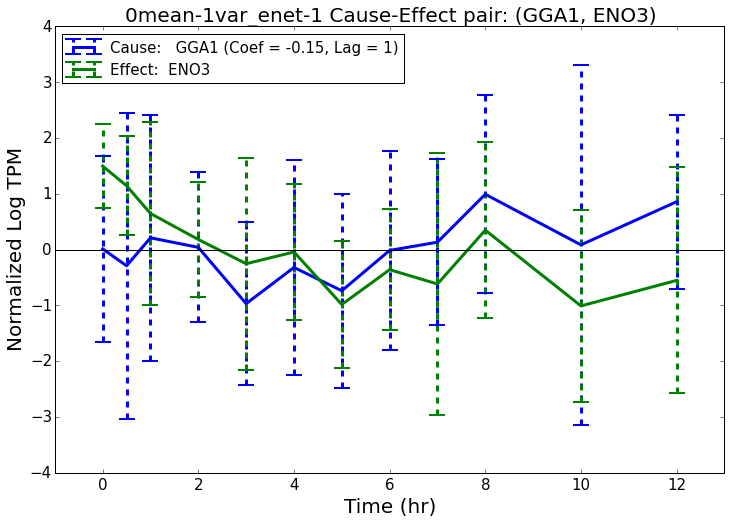

Filename:  analysis/plots/0mean-1var_enet-1/any-metab/0mean-1var_enet-1_no-bar-GGA1-ENO3-lag-1-coef--2E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/any-metab/0mean-1var_enet-1_no-bar-GGA1-ENO3-lag-1-coef--2E-01.pdf


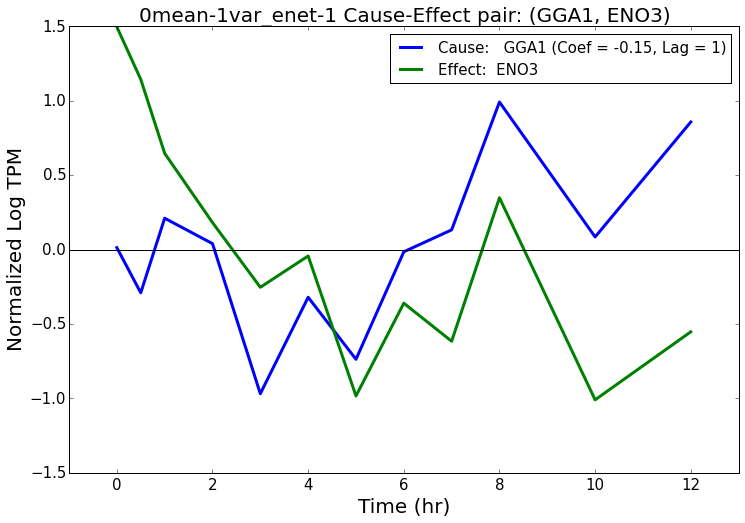

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-1/any-metab/0mean-1var_enet-1_FBXO38-ACOT8-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/any-metab/0mean-1var_enet-1_FBXO38-ACOT8-lag-1-coef-1E-01.pdf


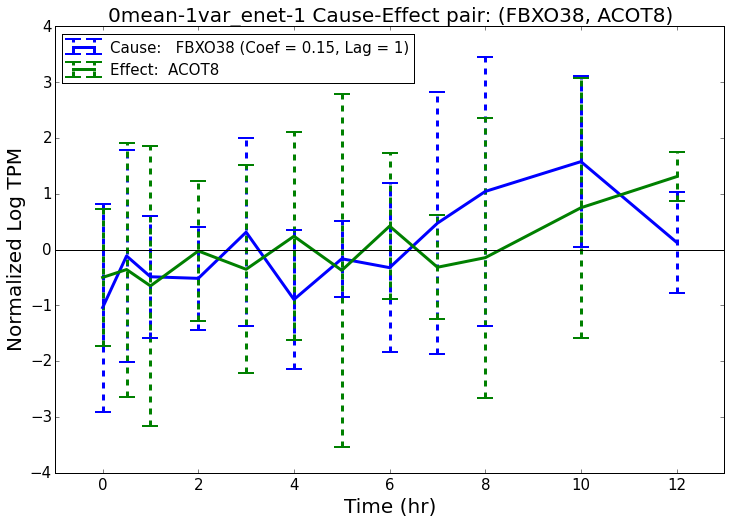

Filename:  analysis/plots/0mean-1var_enet-1/any-metab/0mean-1var_enet-1_no-bar-FBXO38-ACOT8-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/any-metab/0mean-1var_enet-1_no-bar-FBXO38-ACOT8-lag-1-coef-1E-01.pdf


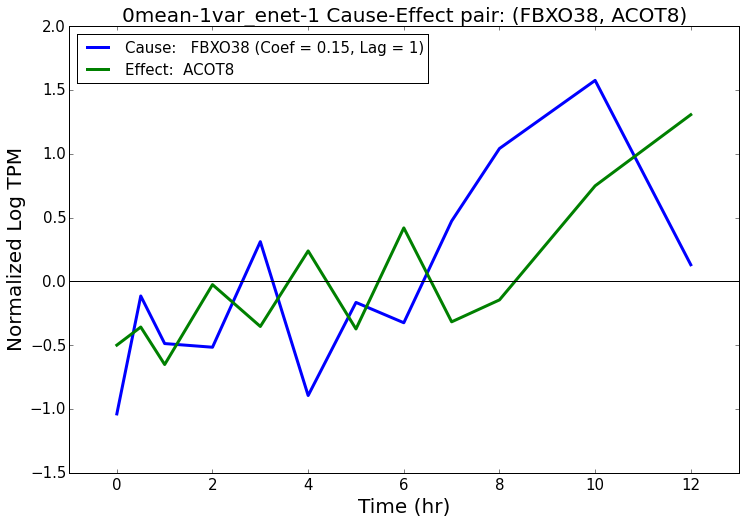

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-1/any-metab/0mean-1var_enet-1_SWSAP1-YWHAH-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/any-metab/0mean-1var_enet-1_SWSAP1-YWHAH-lag-1-coef-1E-01.pdf


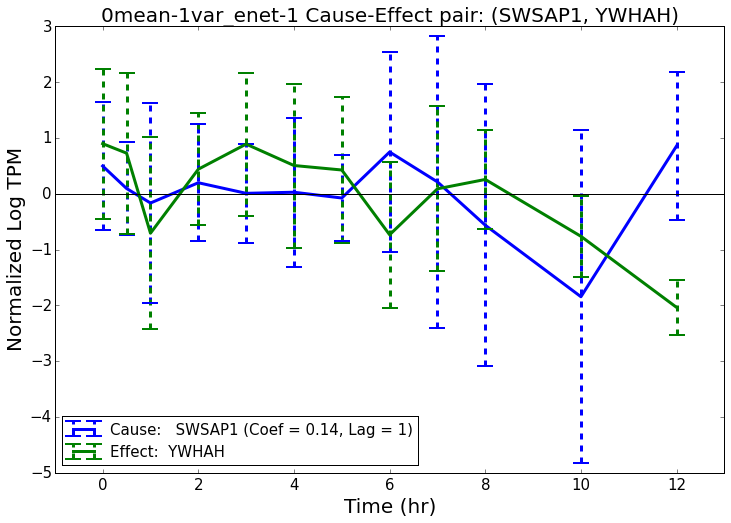

Filename:  analysis/plots/0mean-1var_enet-1/any-metab/0mean-1var_enet-1_no-bar-SWSAP1-YWHAH-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/any-metab/0mean-1var_enet-1_no-bar-SWSAP1-YWHAH-lag-1-coef-1E-01.pdf


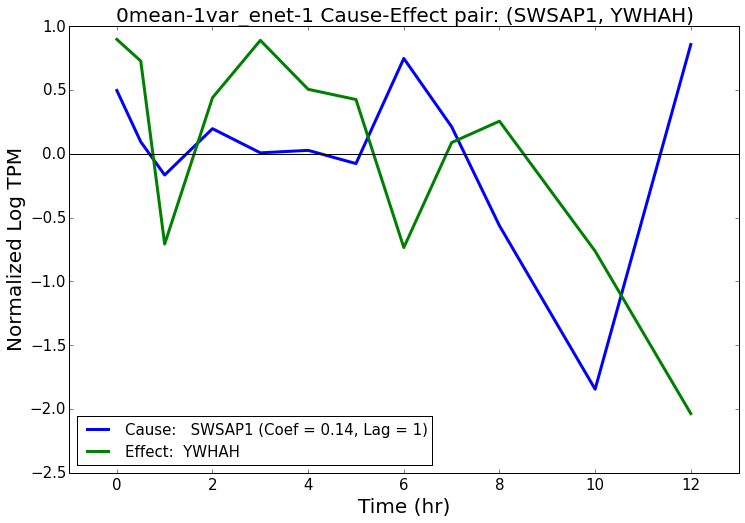

***********************************************
0mean-1var_enet-2
***********************************************
   Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef  Summary: Cause                                        Summary: Effect
29            SLC16A5              AKR1B1 -0.127371   2.0             NaN                                    Metabolism-carb_GO,
36               GGA1                ENO3 -0.125291   1.0             NaN                                  Metabolism-gluc_GSEA,
43      CH507-42P11.8             HSP90B1  0.124156   2.0             NaN  Diabetes_GSEA,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/0mean-1var_enet-2/any-metab/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-2/any-metab/0mean-1var_enet-2_SLC16A5-AKR1B1-lag-2-coef--1E-01.pdf
Plot saved to  analysis

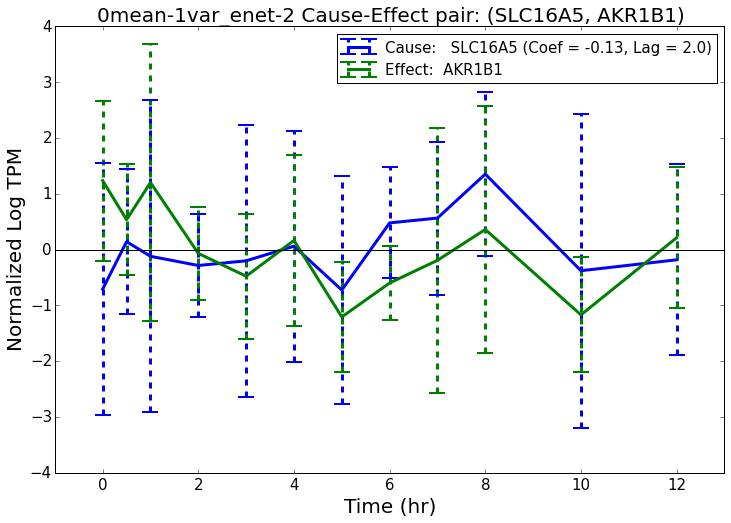

Filename:  analysis/plots/0mean-1var_enet-2/any-metab/0mean-1var_enet-2_no-bar-SLC16A5-AKR1B1-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/any-metab/0mean-1var_enet-2_no-bar-SLC16A5-AKR1B1-lag-2-coef--1E-01.pdf


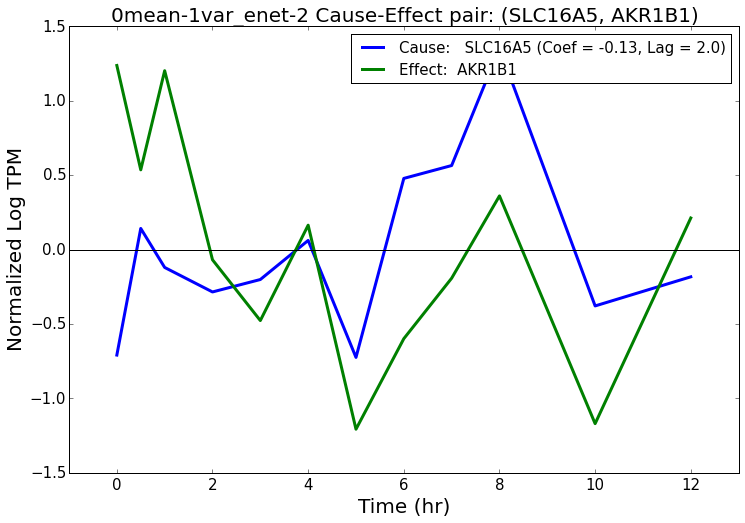

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-2/any-metab/0mean-1var_enet-2_GGA1-ENO3-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/any-metab/0mean-1var_enet-2_GGA1-ENO3-lag-2-coef--1E-01.pdf


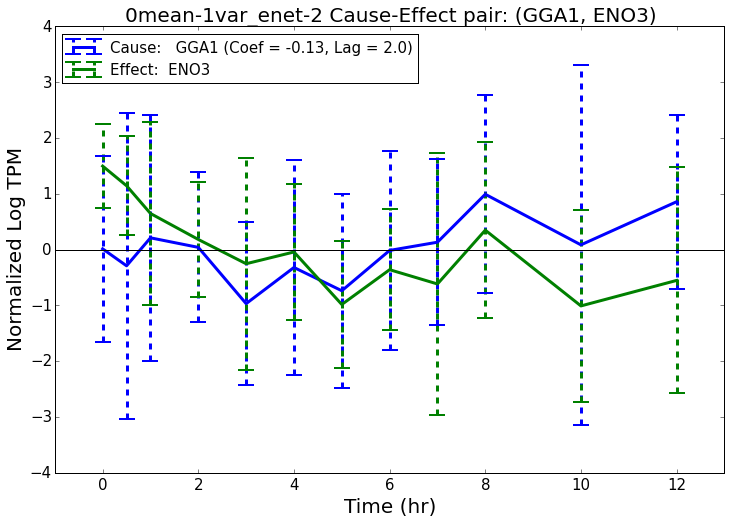

Filename:  analysis/plots/0mean-1var_enet-2/any-metab/0mean-1var_enet-2_no-bar-GGA1-ENO3-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/any-metab/0mean-1var_enet-2_no-bar-GGA1-ENO3-lag-2-coef--1E-01.pdf


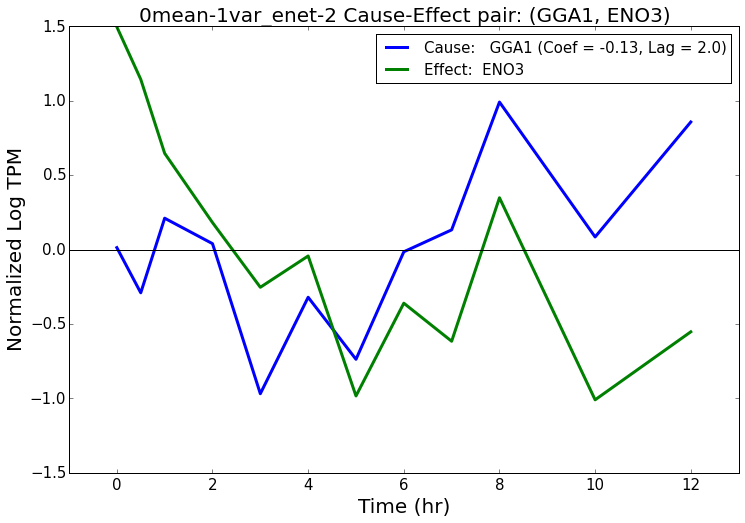

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-2/any-metab/0mean-1var_enet-2_CH507-42P11,8-HSP90B1-lag-2-coef-1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/any-metab/0mean-1var_enet-2_CH507-42P11,8-HSP90B1-lag-2-coef-1E-01.pdf


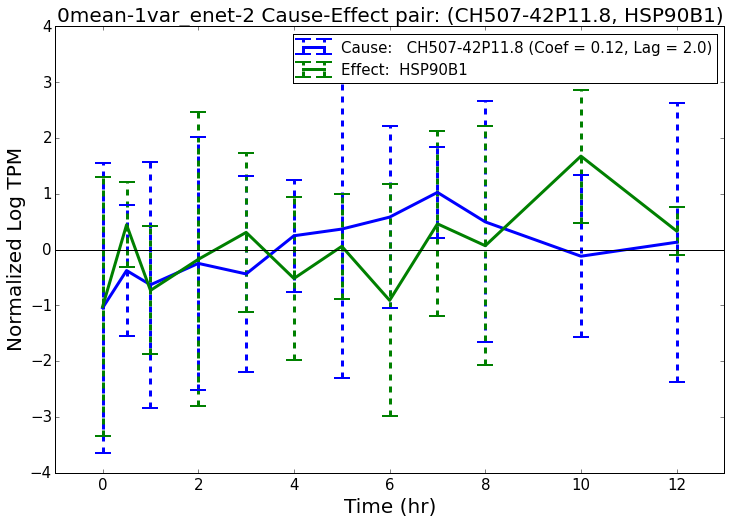

Filename:  analysis/plots/0mean-1var_enet-2/any-metab/0mean-1var_enet-2_no-bar-CH507-42P11,8-HSP90B1-lag-2-coef-1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/any-metab/0mean-1var_enet-2_no-bar-CH507-42P11,8-HSP90B1-lag-2-coef-1E-01.pdf


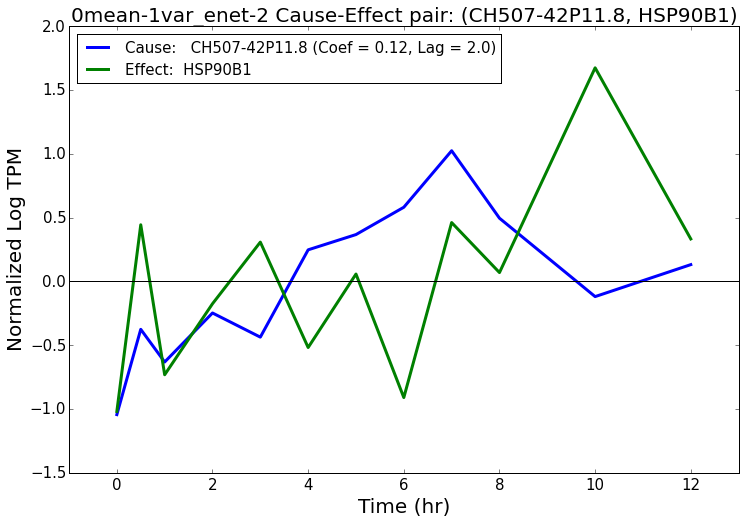

***********************************************
0mean-unnormalized_enet-1
***********************************************
   Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause                                                                  Summary: Effect
0            C11orf91             ANGPTL4  0.335368     1     GR_direct,                            GR_direct,Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,
1            HIST1H1D                 SDS -0.321687     1            NaN                                                            Metabolism-gluc_GSEA,
38             PHLDA2               SOCS1  0.226137     1            NaN  Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/0mean-unnormalized_enet-1/any-metab/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analy

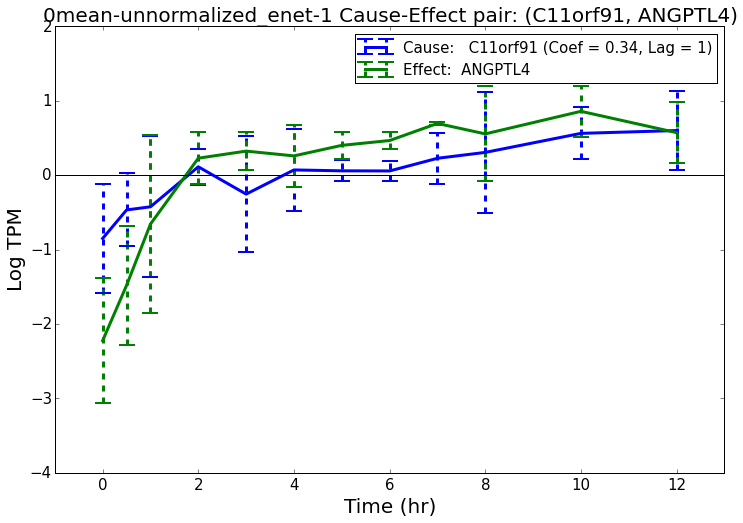

Filename:  analysis/plots/0mean-unnormalized_enet-1/any-metab/0mean-unnormalized_enet-1_no-bar-C11orf91-ANGPTL4-lag-1-coef-3E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/any-metab/0mean-unnormalized_enet-1_no-bar-C11orf91-ANGPTL4-lag-1-coef-3E-01.pdf


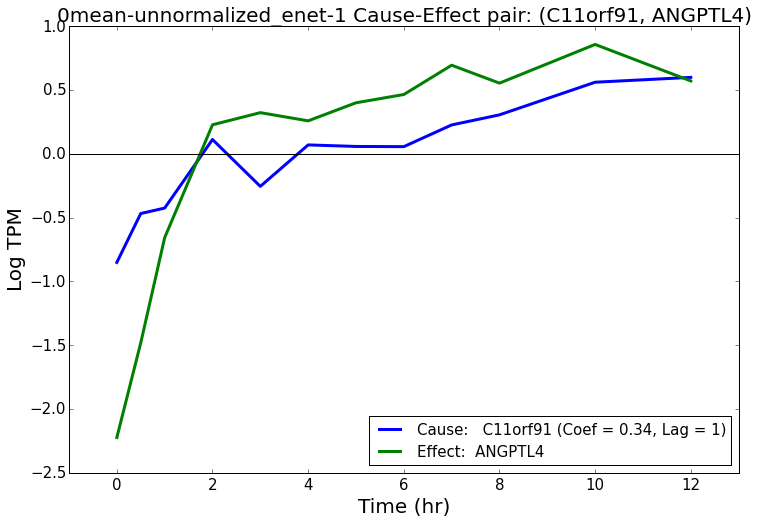

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-1/any-metab/0mean-unnormalized_enet-1_HIST1H1D-SDS-lag-1-coef--3E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/any-metab/0mean-unnormalized_enet-1_HIST1H1D-SDS-lag-1-coef--3E-01.pdf


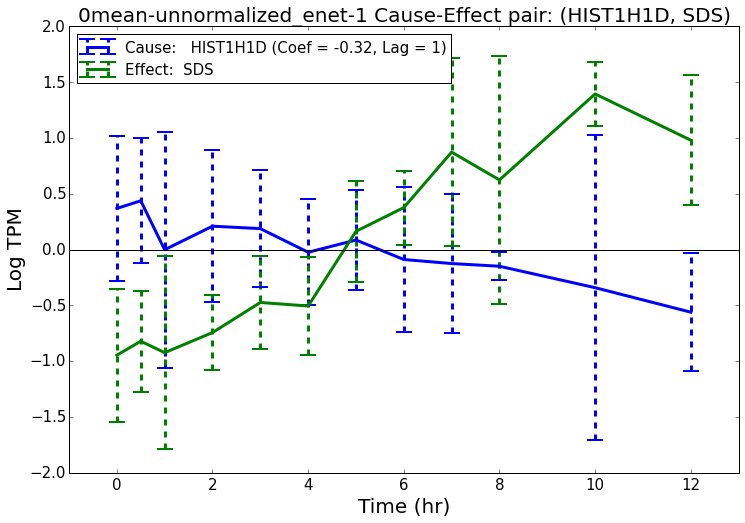

Filename:  analysis/plots/0mean-unnormalized_enet-1/any-metab/0mean-unnormalized_enet-1_no-bar-HIST1H1D-SDS-lag-1-coef--3E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/any-metab/0mean-unnormalized_enet-1_no-bar-HIST1H1D-SDS-lag-1-coef--3E-01.pdf


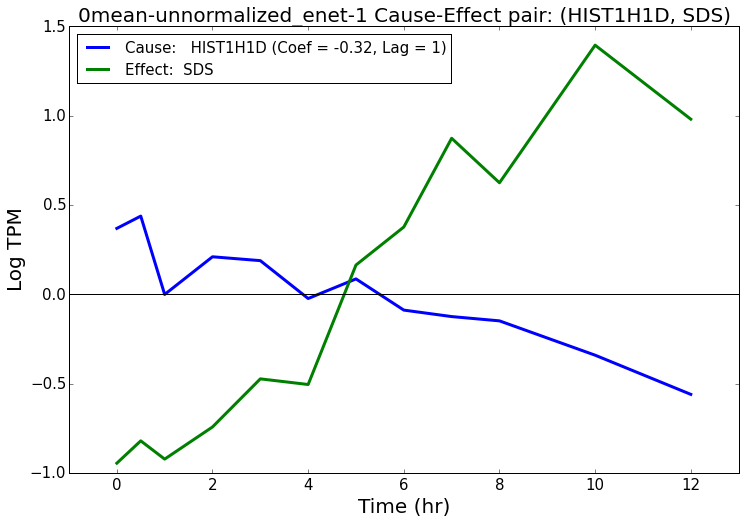

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-1/any-metab/0mean-unnormalized_enet-1_PHLDA2-SOCS1-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/any-metab/0mean-unnormalized_enet-1_PHLDA2-SOCS1-lag-1-coef-2E-01.pdf


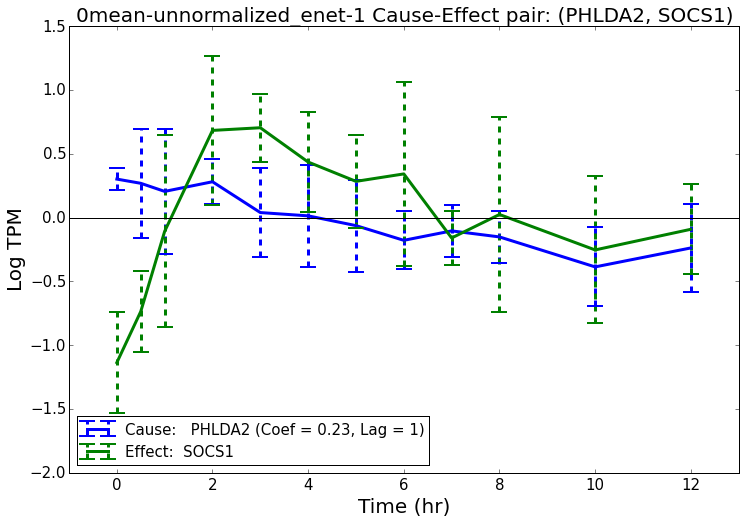

Filename:  analysis/plots/0mean-unnormalized_enet-1/any-metab/0mean-unnormalized_enet-1_no-bar-PHLDA2-SOCS1-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/any-metab/0mean-unnormalized_enet-1_no-bar-PHLDA2-SOCS1-lag-1-coef-2E-01.pdf


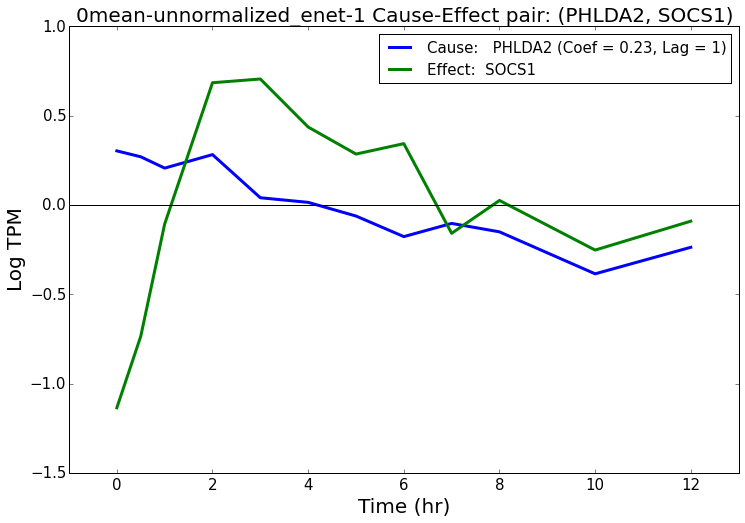

***********************************************
0mean-unnormalized_enet-2
***********************************************
   Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                         Summary: Cause        Summary: Effect
1            HIST1H1D                 SDS -0.255668   2.0                                                    NaN  Metabolism-gluc_GSEA,
4             ANGPTL4                 SDS  0.215576   2.0  GR_direct,Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,  Metabolism-gluc_GSEA,
19             IFITM3                 SDS  0.192257   2.0                             Immune_GOC-5,Immune_GOC-4,  Metabolism-gluc_GSEA,
Written to  analysis/plots/0mean-unnormalized_enet-2/any-metab/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-2/any-metab/0mean-unnormalized_enet-2_

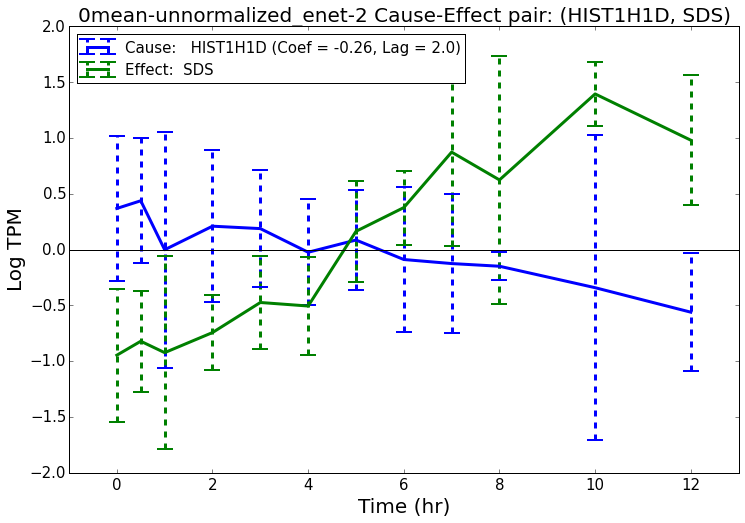

Filename:  analysis/plots/0mean-unnormalized_enet-2/any-metab/0mean-unnormalized_enet-2_no-bar-HIST1H1D-SDS-lag-2-coef--3E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/any-metab/0mean-unnormalized_enet-2_no-bar-HIST1H1D-SDS-lag-2-coef--3E-01.pdf


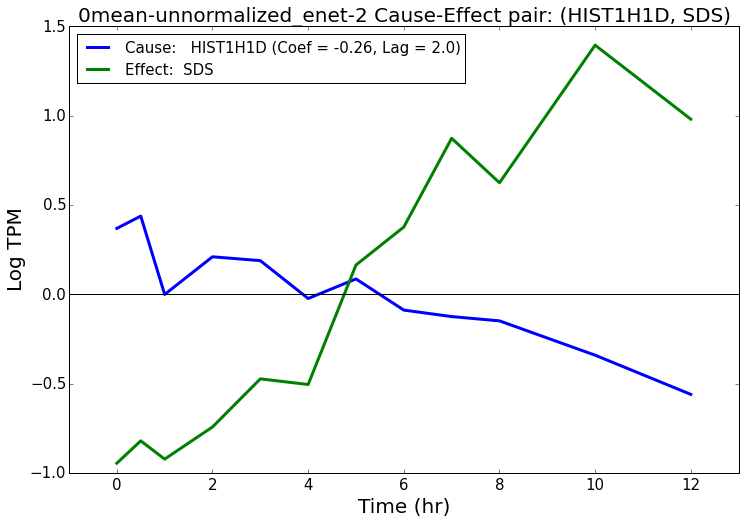

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-2/any-metab/0mean-unnormalized_enet-2_ANGPTL4-SDS-lag-2-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/any-metab/0mean-unnormalized_enet-2_ANGPTL4-SDS-lag-2-coef-2E-01.pdf


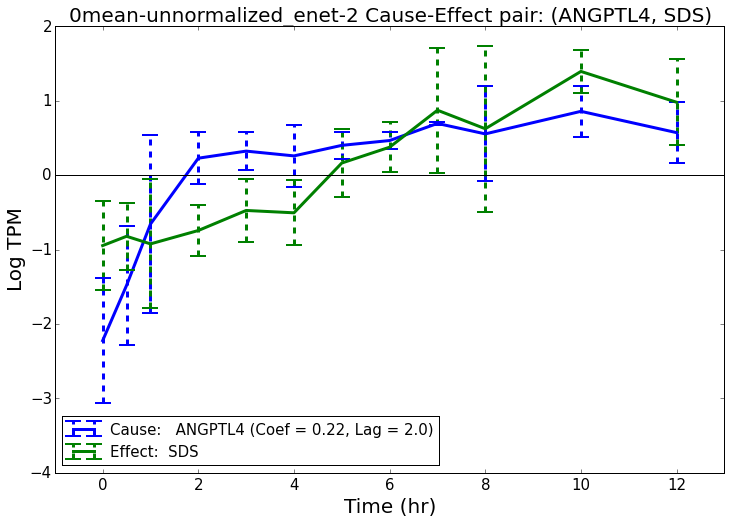

Filename:  analysis/plots/0mean-unnormalized_enet-2/any-metab/0mean-unnormalized_enet-2_no-bar-ANGPTL4-SDS-lag-2-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/any-metab/0mean-unnormalized_enet-2_no-bar-ANGPTL4-SDS-lag-2-coef-2E-01.pdf


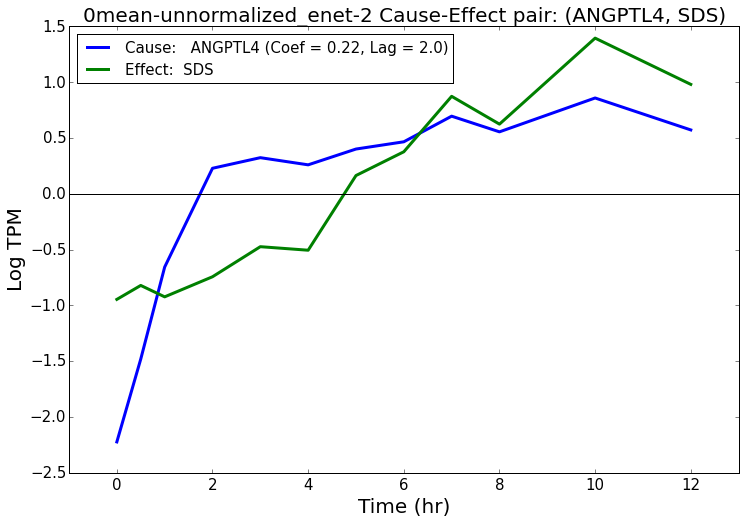

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-2/any-metab/0mean-unnormalized_enet-2_IFITM3-SDS-lag-2-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/any-metab/0mean-unnormalized_enet-2_IFITM3-SDS-lag-2-coef-2E-01.pdf


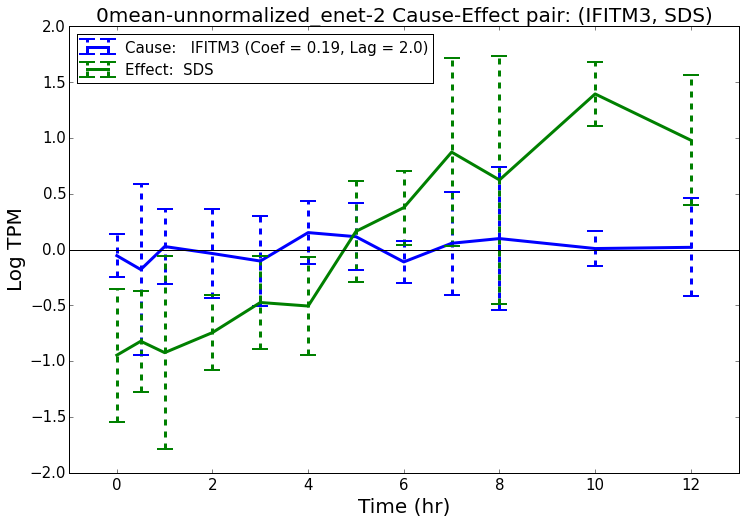

Filename:  analysis/plots/0mean-unnormalized_enet-2/any-metab/0mean-unnormalized_enet-2_no-bar-IFITM3-SDS-lag-2-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/any-metab/0mean-unnormalized_enet-2_no-bar-IFITM3-SDS-lag-2-coef-2E-01.pdf


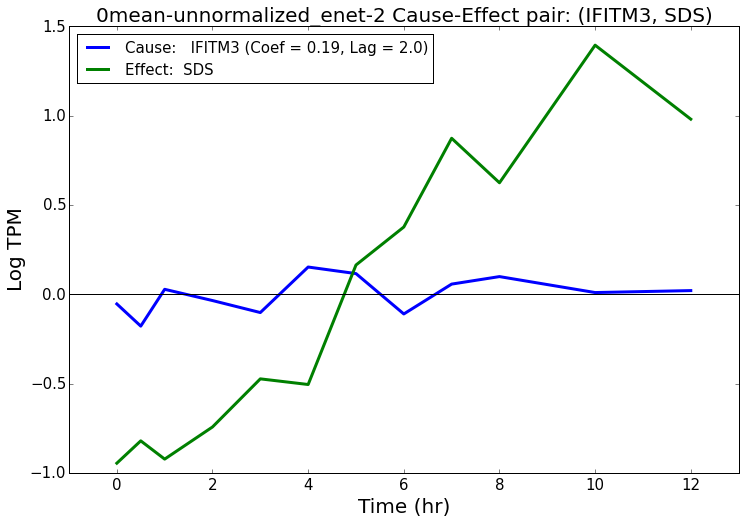

In [38]:
do_plot_nets(data_hg_df_list, plot_nets, names, timekeys_list, num_per_keys_list, timepoints_list, each_plot_folders=each_plot_folders, interest_index=None,
            ylabels=ylabels)

### Plot top any -> Immune overall

In [39]:

plotfoldersuffix = "any-imm"
each_plot_folders = [os.path.join(name_plot_folder, plotfoldersuffix) for name, name_plot_folder in zip(names, name_plot_folders)]
top_edge_num = 3
plot_nets = [net[net["Effect"].isin(imm_genes)].sort_values("AbsWeight", ascending=False).head(n=top_edge_num) for net in nets]

# display annotations
for plot_net in plot_nets:
    plot_net["Gene Symbol: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_net["Cause"].values]
    plot_net["Gene Symbol: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_net["Effect"].values]
    plot_net["Summary: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Summary"].values[0] for x in plot_net["Cause"].values]
    plot_net["Summary: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Summary"].values[0] for x in plot_net["Effect"].values]



***********************************************
0mean-1var_enet-1
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef   Summary: Cause                                                    Summary: Effect
5                ZNF76                CD14  0.182236     1       TF-Bioguo,  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
121             RAD51D               CXCL2 -0.143332     1  DNA-binding_GO,  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
144              PCSK9              TCIRG1 -0.141101     1              NaN               Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/0mean-1var_enet-1/any-imm/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-1/any-imm/0mean-1var_enet-1_ZNF76-CD

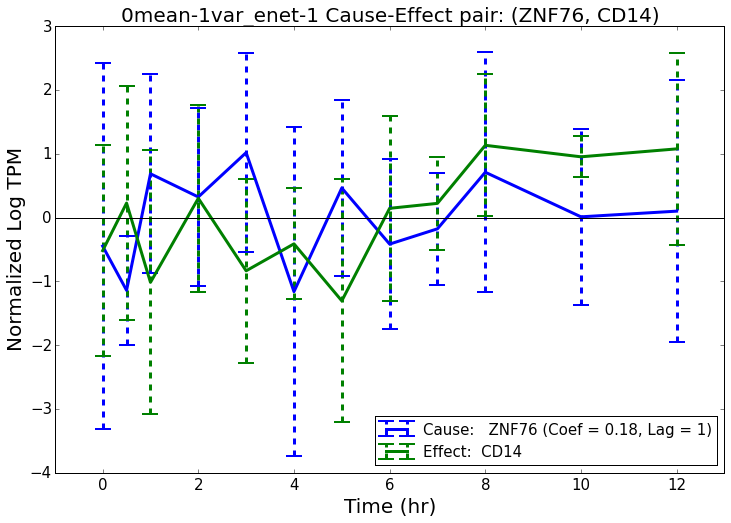

Filename:  analysis/plots/0mean-1var_enet-1/any-imm/0mean-1var_enet-1_no-bar-ZNF76-CD14-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/any-imm/0mean-1var_enet-1_no-bar-ZNF76-CD14-lag-1-coef-2E-01.pdf


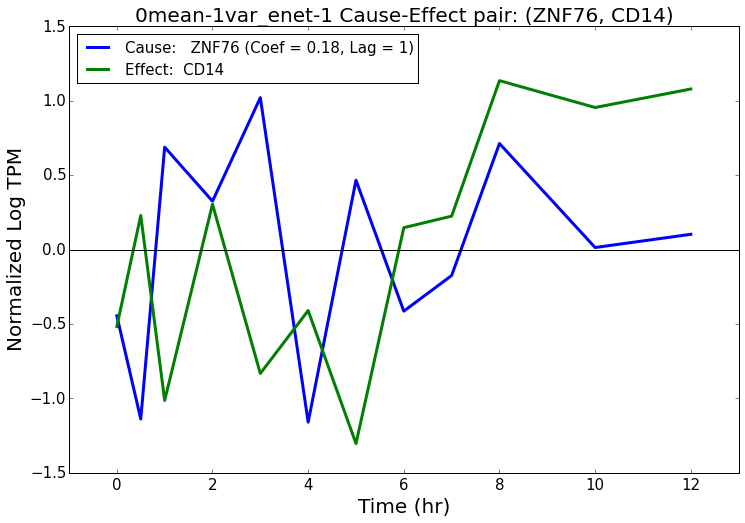

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-1/any-imm/0mean-1var_enet-1_RAD51D-CXCL2-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/any-imm/0mean-1var_enet-1_RAD51D-CXCL2-lag-1-coef--1E-01.pdf


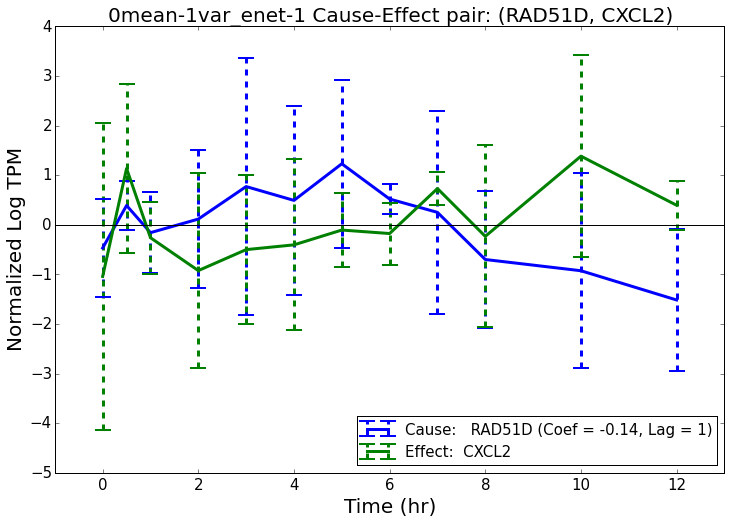

Filename:  analysis/plots/0mean-1var_enet-1/any-imm/0mean-1var_enet-1_no-bar-RAD51D-CXCL2-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/any-imm/0mean-1var_enet-1_no-bar-RAD51D-CXCL2-lag-1-coef--1E-01.pdf


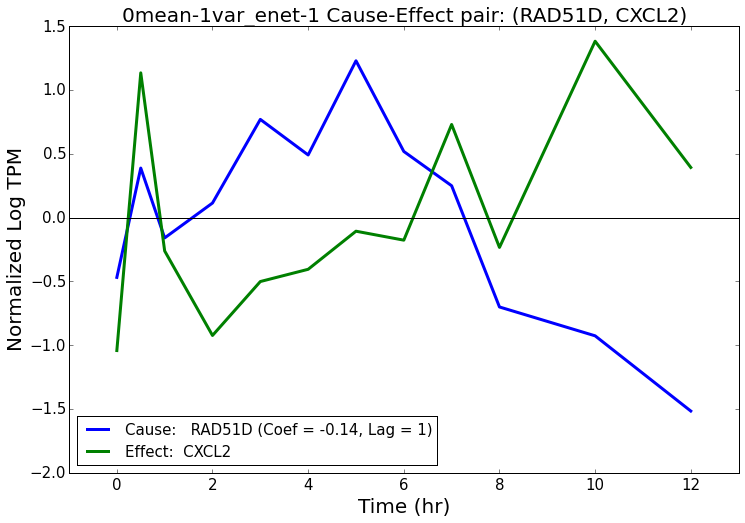

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-1/any-imm/0mean-1var_enet-1_PCSK9-TCIRG1-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/any-imm/0mean-1var_enet-1_PCSK9-TCIRG1-lag-1-coef--1E-01.pdf


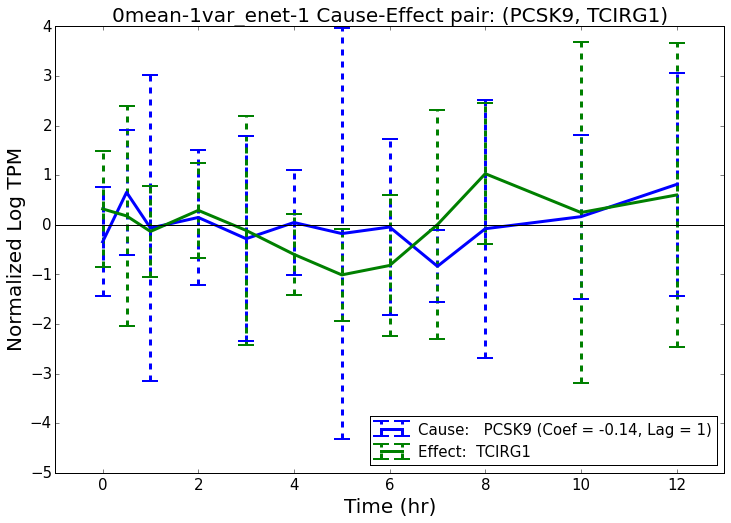

Filename:  analysis/plots/0mean-1var_enet-1/any-imm/0mean-1var_enet-1_no-bar-PCSK9-TCIRG1-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/any-imm/0mean-1var_enet-1_no-bar-PCSK9-TCIRG1-lag-1-coef--1E-01.pdf


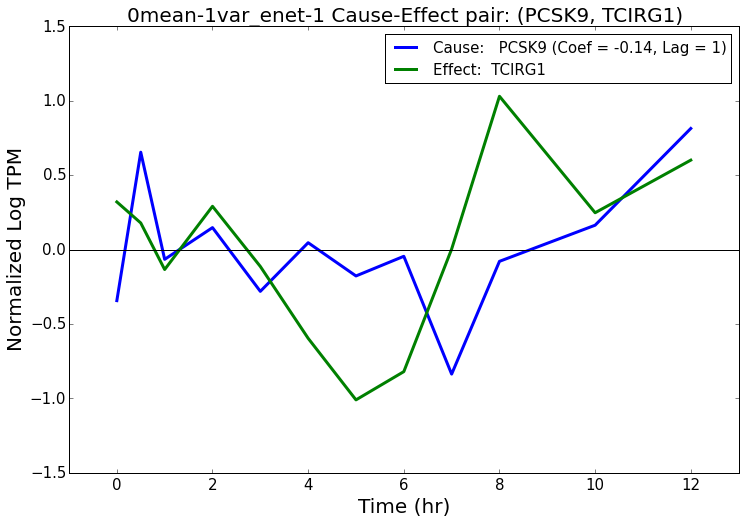

***********************************************
0mean-1var_enet-2
***********************************************
   Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef              Summary: Cause                                                            Summary: Effect
21              TRAK1                 BAX -0.132067   1.0                         NaN  GR_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
30             IFITM3               ITGA4 -0.127261   1.0  Immune_GOC-5,Immune_GOC-4,          Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
86            HSD17B6                 MIF  0.116232   2.0                         NaN          Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/0mean-1var_enet-2/any-imm/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filena

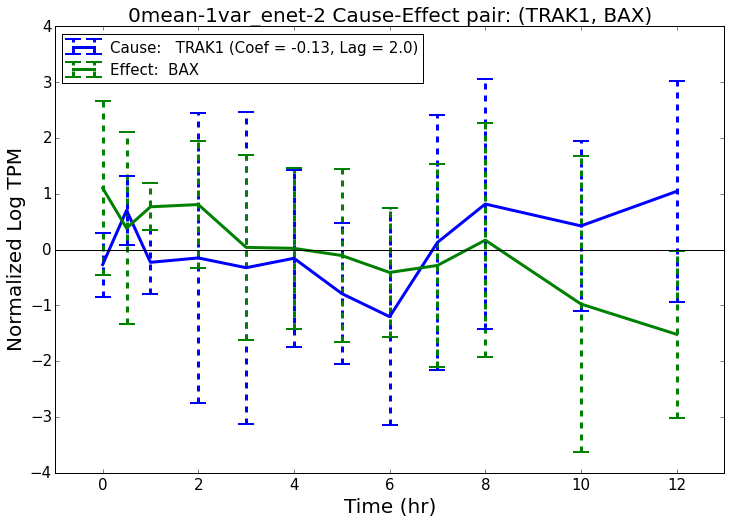

Filename:  analysis/plots/0mean-1var_enet-2/any-imm/0mean-1var_enet-2_no-bar-TRAK1-BAX-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/any-imm/0mean-1var_enet-2_no-bar-TRAK1-BAX-lag-2-coef--1E-01.pdf


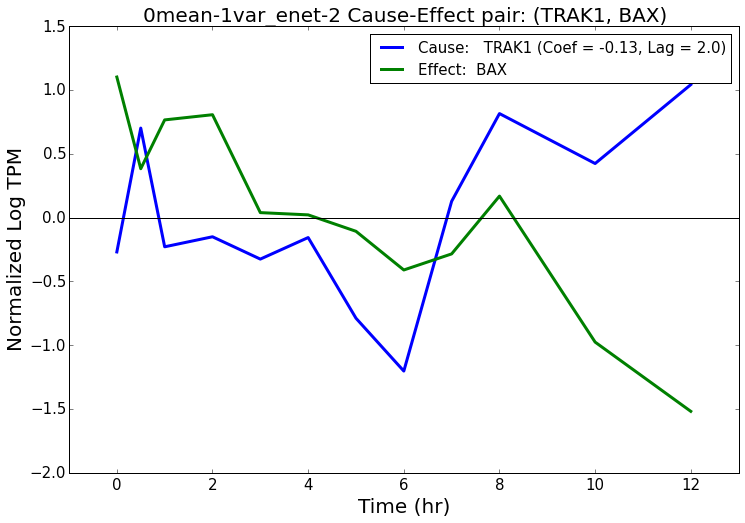

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-2/any-imm/0mean-1var_enet-2_IFITM3-ITGA4-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/any-imm/0mean-1var_enet-2_IFITM3-ITGA4-lag-2-coef--1E-01.pdf


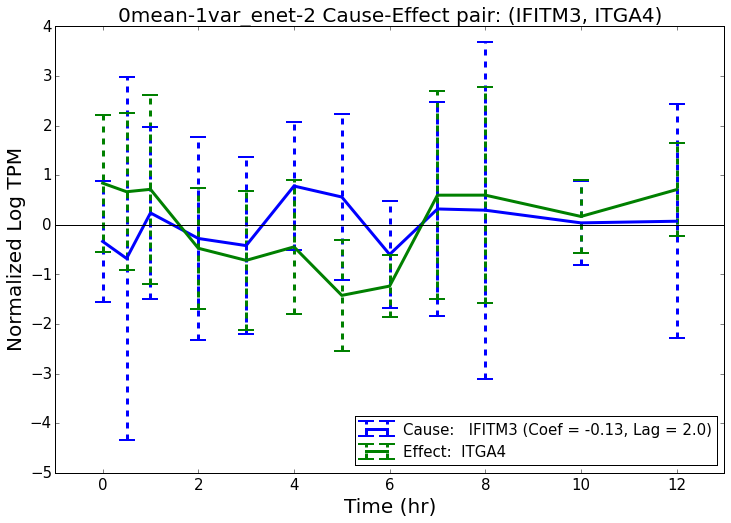

Filename:  analysis/plots/0mean-1var_enet-2/any-imm/0mean-1var_enet-2_no-bar-IFITM3-ITGA4-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/any-imm/0mean-1var_enet-2_no-bar-IFITM3-ITGA4-lag-2-coef--1E-01.pdf


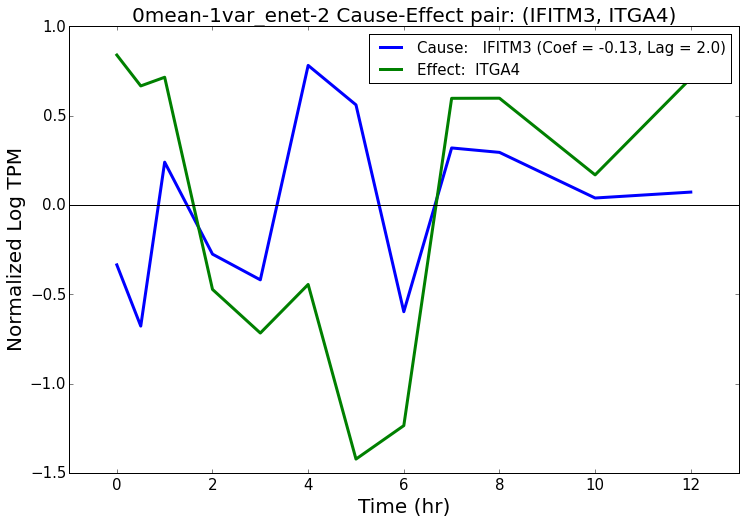

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-2/any-imm/0mean-1var_enet-2_HSD17B6-MIF-lag-2-coef-1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/any-imm/0mean-1var_enet-2_HSD17B6-MIF-lag-2-coef-1E-01.pdf


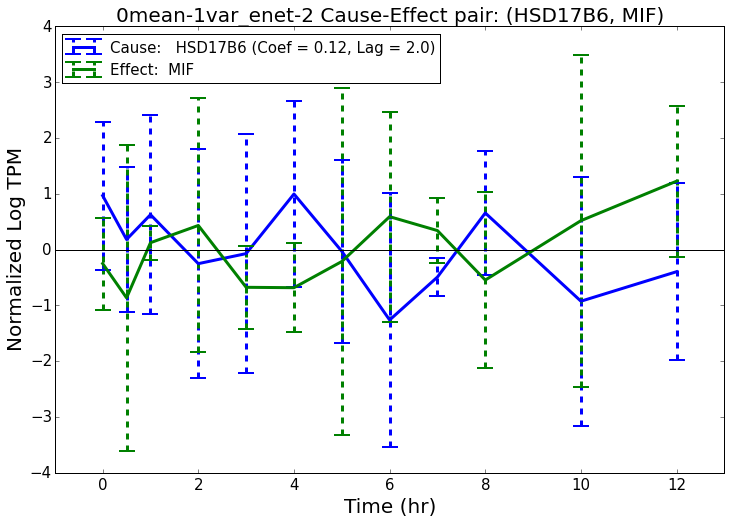

Filename:  analysis/plots/0mean-1var_enet-2/any-imm/0mean-1var_enet-2_no-bar-HSD17B6-MIF-lag-2-coef-1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/any-imm/0mean-1var_enet-2_no-bar-HSD17B6-MIF-lag-2-coef-1E-01.pdf


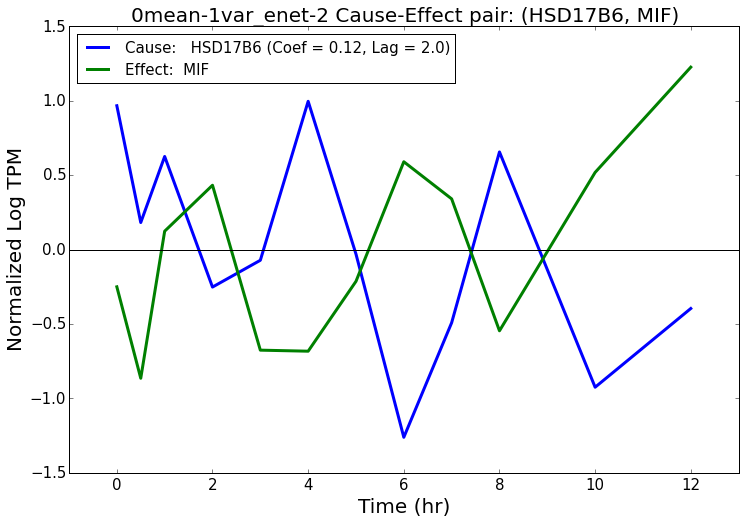

***********************************************
0mean-unnormalized_enet-1
***********************************************
   Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                       Summary: Cause                                                                  Summary: Effect
2              POU5F1               CXCL1 -0.318522     1  GR_direct,TF-Bioguo,DNA-binding_GO,                Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
15                LBP                IL11 -0.250598     1           Immune_GOC-5,Immune_GOC-4,                             Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
38             PHLDA2               SOCS1  0.226137     1                                  NaN  Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/0mean-unnormalized_enet-1/any-imm/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep',

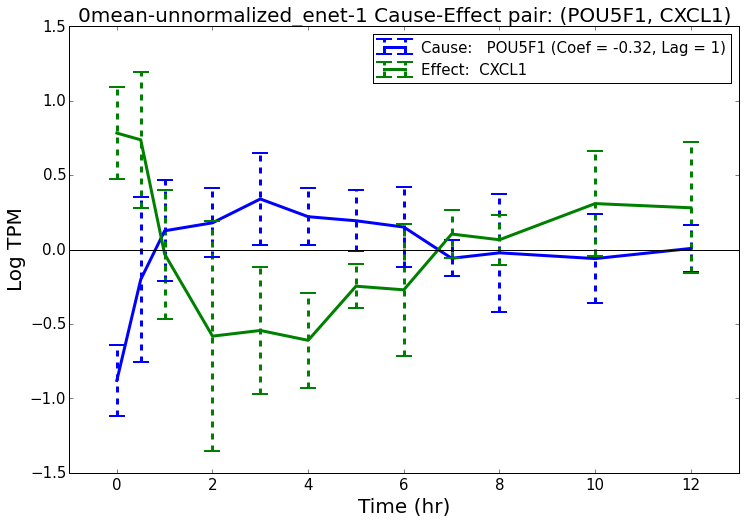

Filename:  analysis/plots/0mean-unnormalized_enet-1/any-imm/0mean-unnormalized_enet-1_no-bar-POU5F1-CXCL1-lag-1-coef--3E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/any-imm/0mean-unnormalized_enet-1_no-bar-POU5F1-CXCL1-lag-1-coef--3E-01.pdf


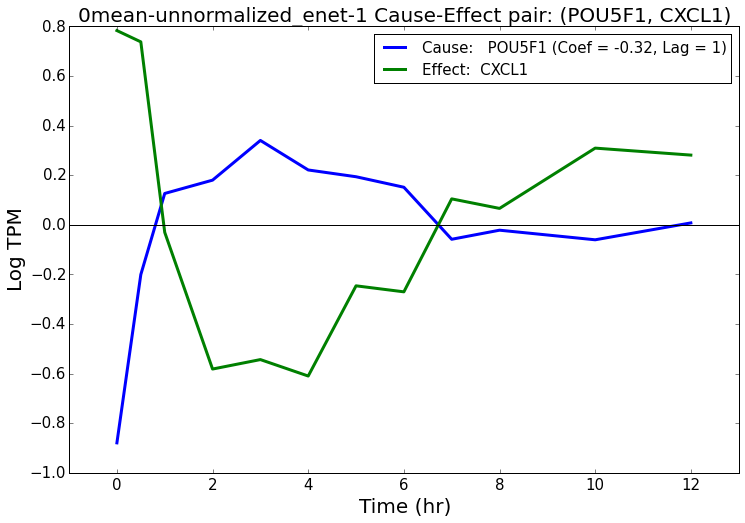

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-1/any-imm/0mean-unnormalized_enet-1_LBP-IL11-lag-1-coef--3E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/any-imm/0mean-unnormalized_enet-1_LBP-IL11-lag-1-coef--3E-01.pdf


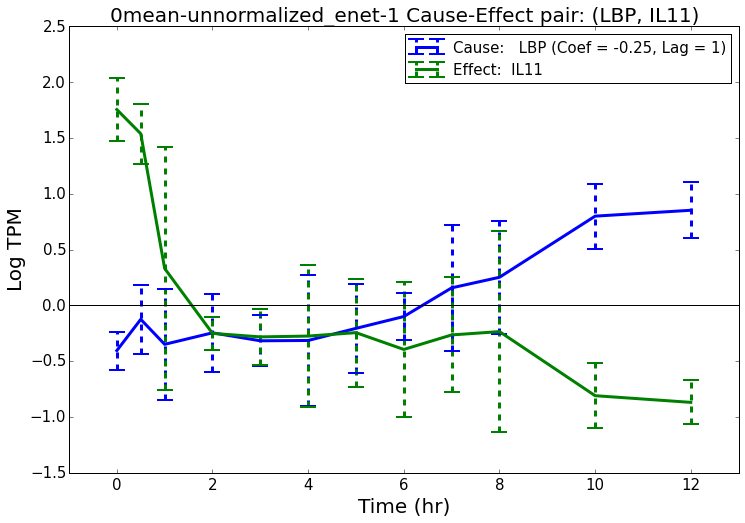

Filename:  analysis/plots/0mean-unnormalized_enet-1/any-imm/0mean-unnormalized_enet-1_no-bar-LBP-IL11-lag-1-coef--3E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/any-imm/0mean-unnormalized_enet-1_no-bar-LBP-IL11-lag-1-coef--3E-01.pdf


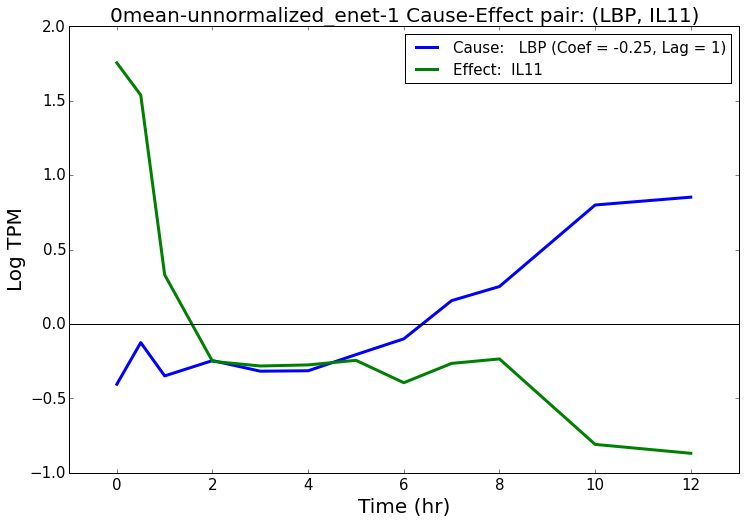

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-1/any-imm/0mean-unnormalized_enet-1_PHLDA2-SOCS1-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/any-imm/0mean-unnormalized_enet-1_PHLDA2-SOCS1-lag-1-coef-2E-01.pdf


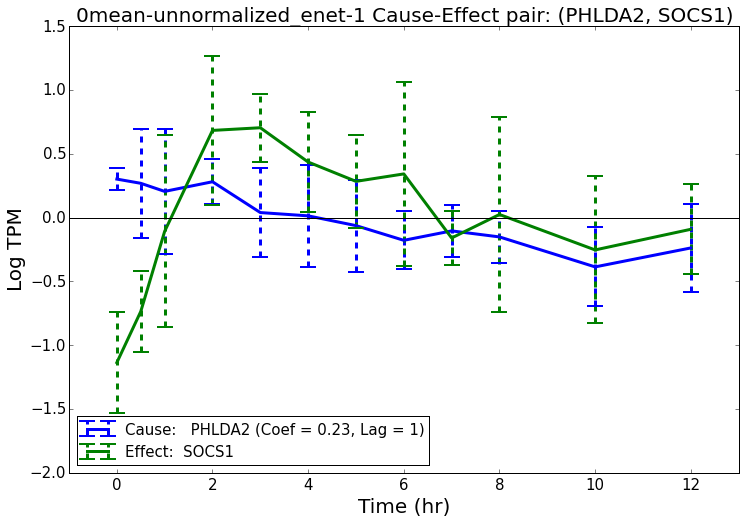

Filename:  analysis/plots/0mean-unnormalized_enet-1/any-imm/0mean-unnormalized_enet-1_no-bar-PHLDA2-SOCS1-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/any-imm/0mean-unnormalized_enet-1_no-bar-PHLDA2-SOCS1-lag-1-coef-2E-01.pdf


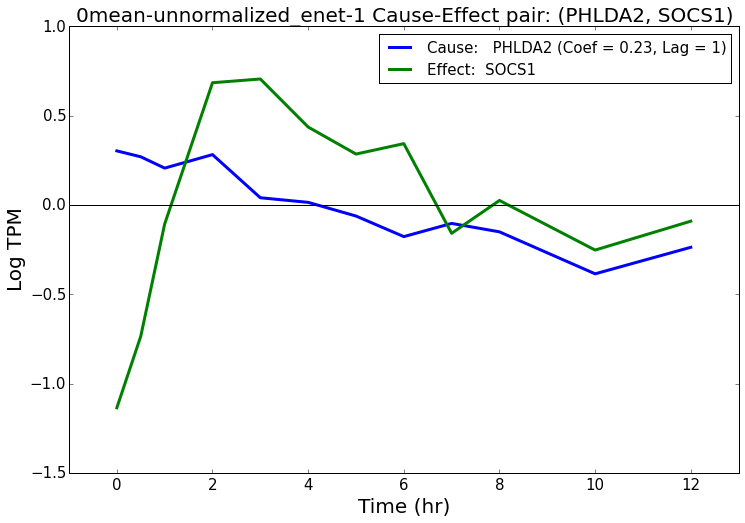

***********************************************
0mean-unnormalized_enet-2
***********************************************
   Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                   Summary: Cause                                                                      Summary: Effect
45           HIST1H4A               FKBP5  0.176496   2.0  DNA-binding_GO,Hist-binding_GO,  GR_GSEA,GR_direct,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
52           HIST1H1D                CCL2  0.173305   1.0                              NaN      Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
80               HPDL             TNFAIP6 -0.162239   2.0                              NaN                    Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/0mean-unnormalized_enet-2/any-imm/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep',

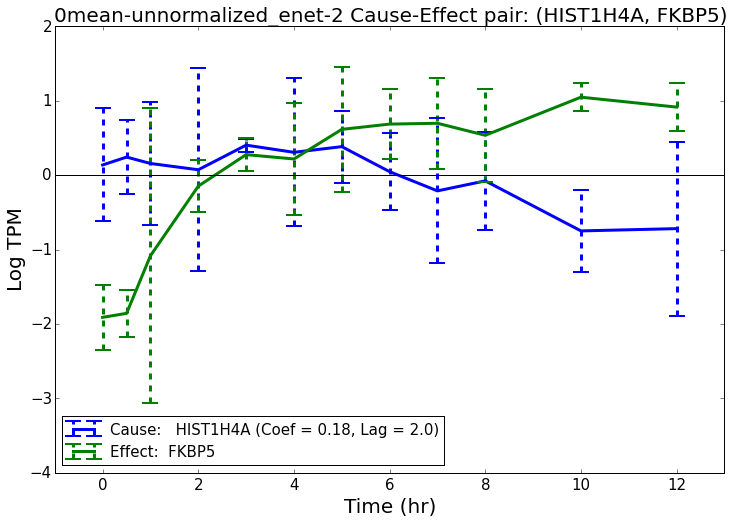

Filename:  analysis/plots/0mean-unnormalized_enet-2/any-imm/0mean-unnormalized_enet-2_no-bar-HIST1H4A-FKBP5-lag-2-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/any-imm/0mean-unnormalized_enet-2_no-bar-HIST1H4A-FKBP5-lag-2-coef-2E-01.pdf


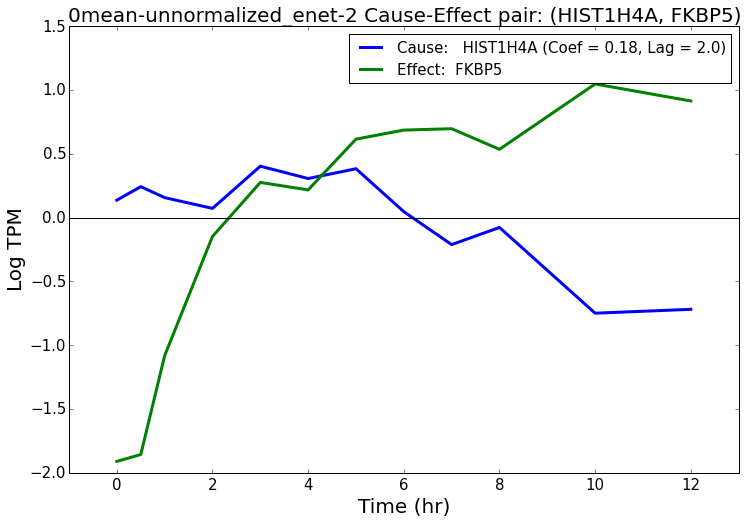

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-2/any-imm/0mean-unnormalized_enet-2_HIST1H1D-CCL2-lag-2-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/any-imm/0mean-unnormalized_enet-2_HIST1H1D-CCL2-lag-2-coef-2E-01.pdf


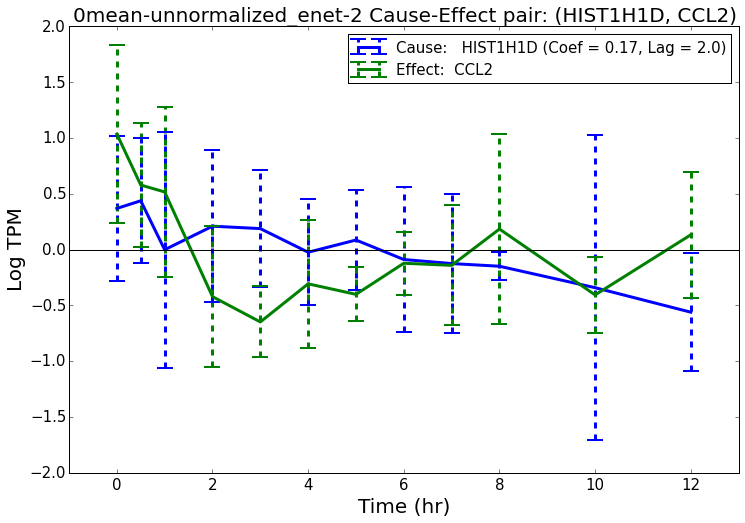

Filename:  analysis/plots/0mean-unnormalized_enet-2/any-imm/0mean-unnormalized_enet-2_no-bar-HIST1H1D-CCL2-lag-2-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/any-imm/0mean-unnormalized_enet-2_no-bar-HIST1H1D-CCL2-lag-2-coef-2E-01.pdf


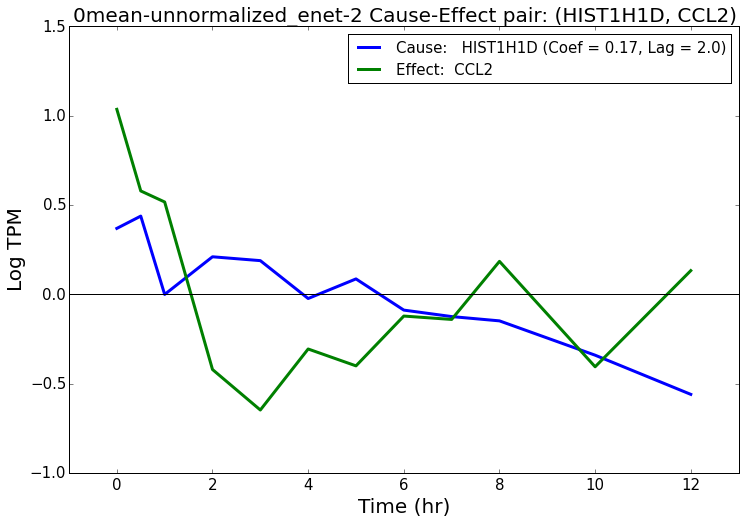

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-2/any-imm/0mean-unnormalized_enet-2_HPDL-TNFAIP6-lag-2-coef--2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/any-imm/0mean-unnormalized_enet-2_HPDL-TNFAIP6-lag-2-coef--2E-01.pdf


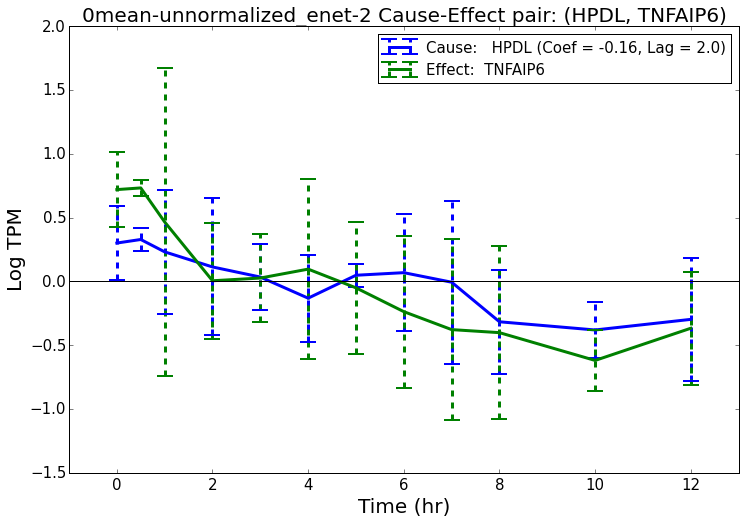

Filename:  analysis/plots/0mean-unnormalized_enet-2/any-imm/0mean-unnormalized_enet-2_no-bar-HPDL-TNFAIP6-lag-2-coef--2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/any-imm/0mean-unnormalized_enet-2_no-bar-HPDL-TNFAIP6-lag-2-coef--2E-01.pdf


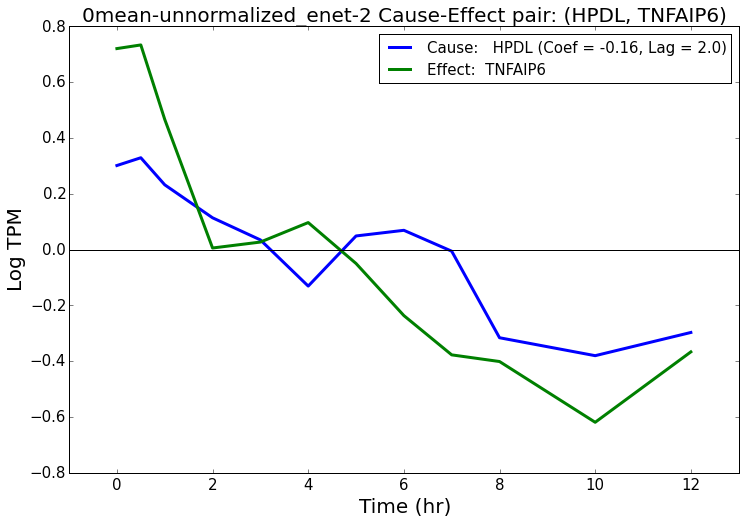

In [40]:
do_plot_nets(data_hg_df_list, plot_nets, names, timekeys_list, num_per_keys_list, timepoints_list, each_plot_folders=each_plot_folders, interest_index=None,
            ylabels=ylabels)

### Plot top Metabolism -> any overall

In [41]:

plotfoldersuffix = "metab-any"
each_plot_folders = [os.path.join(name_plot_folder, plotfoldersuffix) for name, name_plot_folder in zip(names, name_plot_folders)]
top_edge_num = 3
plot_nets = [net[net["Cause"].isin(metab_genes)].sort_values("AbsWeight", ascending=False).head(n=top_edge_num) for net in nets]

# display annotations
for plot_net in plot_nets:
    plot_net["Gene Symbol: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_net["Cause"].values]
    plot_net["Gene Symbol: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_net["Effect"].values]
    plot_net["Summary: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Summary"].values[0] for x in plot_net["Cause"].values]
    plot_net["Summary: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Summary"].values[0] for x in plot_net["Effect"].values]



***********************************************
0mean-1var_enet-1
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef          Summary: Cause             Summary: Effect
170               BPGM               TTLL6 -0.138159     1   Metabolism-gluc_GSEA,                         NaN
280               CRAT             TXNDC16 -0.131091     1  Metabolism-lipid_GSEA,                         NaN
291               BPGM               ULBP2  0.130699     1   Metabolism-gluc_GSEA,  Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/0mean-1var_enet-1/metab-any/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-1/metab-any/0mean-1var_enet-1_BPGM-TTLL6-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/metab-any/0mean-1var_enet-1_BPGM-TTLL6-lag-1-coef--

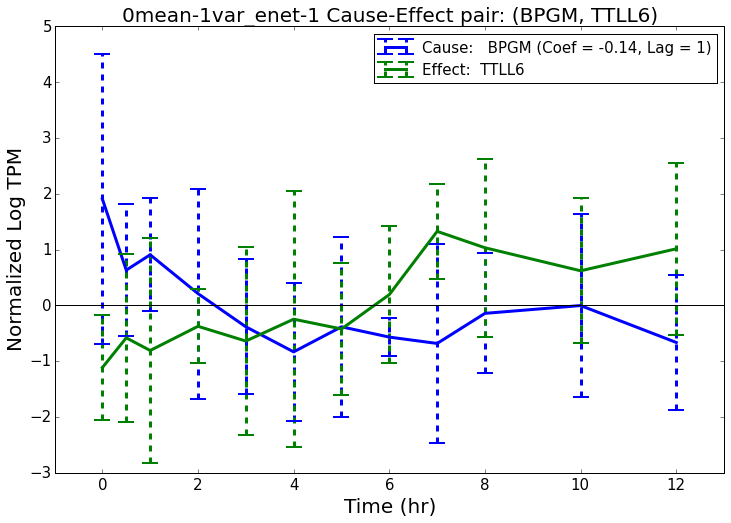

Filename:  analysis/plots/0mean-1var_enet-1/metab-any/0mean-1var_enet-1_no-bar-BPGM-TTLL6-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/metab-any/0mean-1var_enet-1_no-bar-BPGM-TTLL6-lag-1-coef--1E-01.pdf


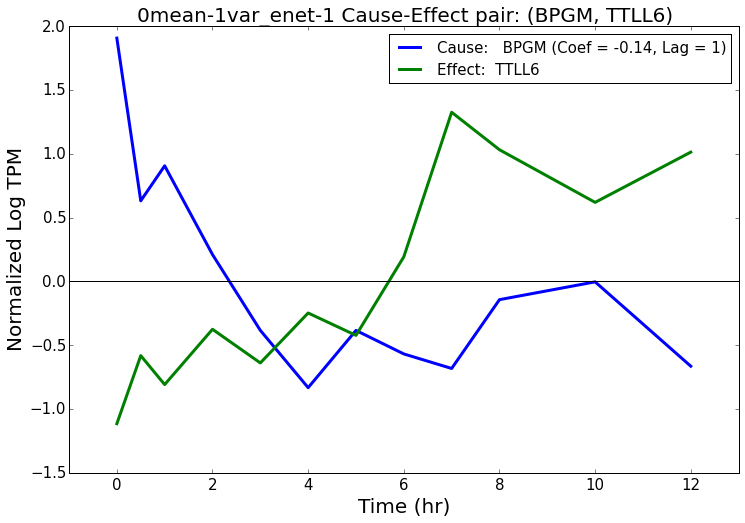

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-1/metab-any/0mean-1var_enet-1_CRAT-TXNDC16-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/metab-any/0mean-1var_enet-1_CRAT-TXNDC16-lag-1-coef--1E-01.pdf


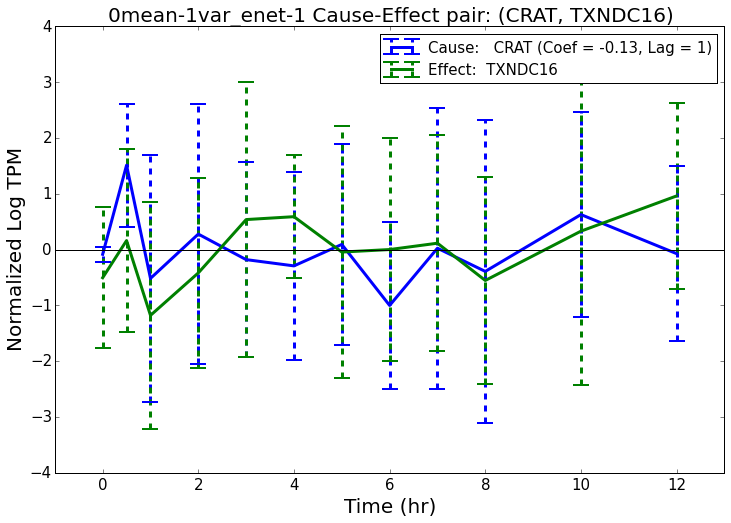

Filename:  analysis/plots/0mean-1var_enet-1/metab-any/0mean-1var_enet-1_no-bar-CRAT-TXNDC16-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/metab-any/0mean-1var_enet-1_no-bar-CRAT-TXNDC16-lag-1-coef--1E-01.pdf


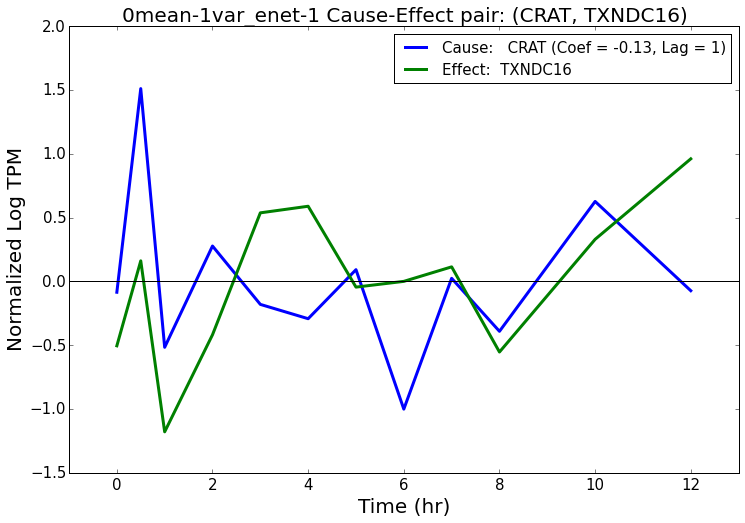

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-1/metab-any/0mean-1var_enet-1_BPGM-ULBP2-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/metab-any/0mean-1var_enet-1_BPGM-ULBP2-lag-1-coef-1E-01.pdf


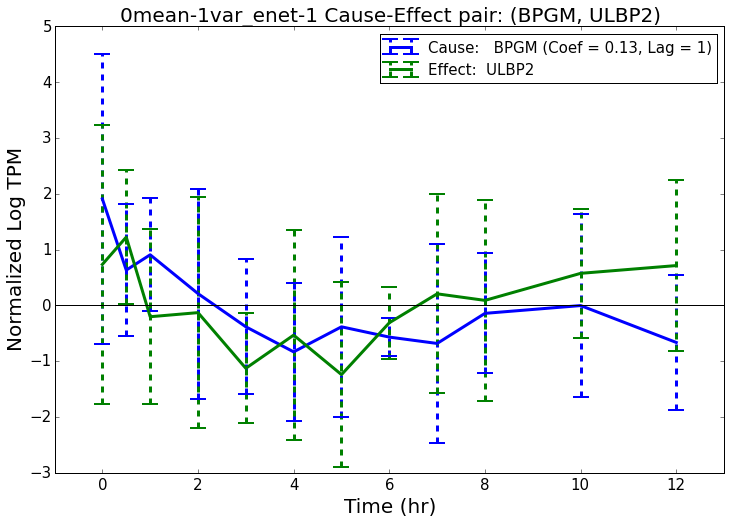

Filename:  analysis/plots/0mean-1var_enet-1/metab-any/0mean-1var_enet-1_no-bar-BPGM-ULBP2-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/metab-any/0mean-1var_enet-1_no-bar-BPGM-ULBP2-lag-1-coef-1E-01.pdf


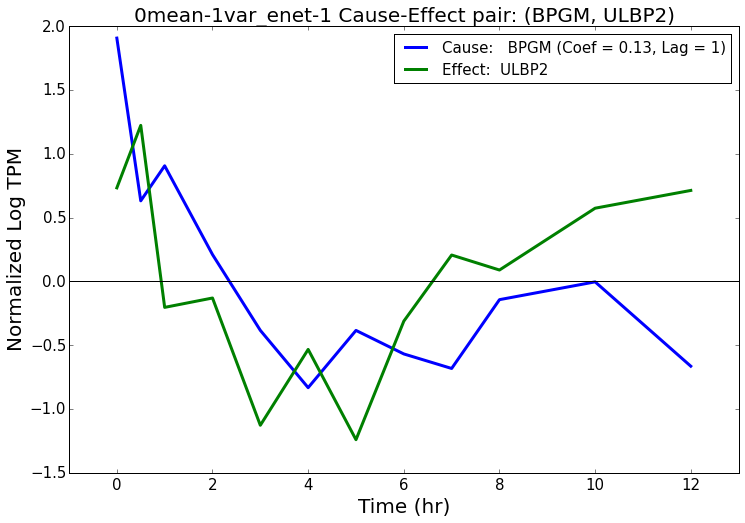

***********************************************
0mean-1var_enet-2
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef            Summary: Cause        Summary: Effect
57              IGFBP4              PFKFB3 -0.121749   2.0  GR_direct,Diabetes_GSEA,  Metabolism-gluc_GSEA,
103              ACOT8              MRPL35  0.114503   1.0    Metabolism-lipid_GSEA,                    NaN
175              HYOU1               SYVN1  0.107104   1.0            Diabetes_GSEA,         Diabetes_GSEA,
Written to  analysis/plots/0mean-1var_enet-2/metab-any/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-2/metab-any/0mean-1var_enet-2_IGFBP4-PFKFB3-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/metab-any/0mean-1var_enet-2_IGFBP4-PFKFB3-lag-2-coef--1E-01.

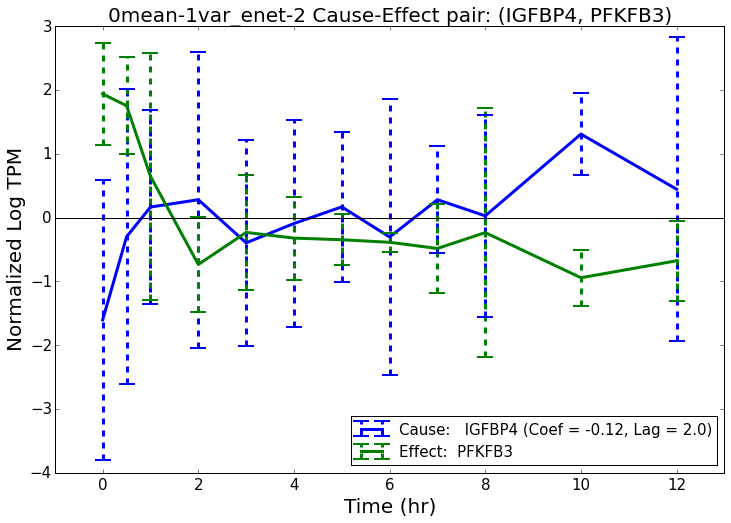

Filename:  analysis/plots/0mean-1var_enet-2/metab-any/0mean-1var_enet-2_no-bar-IGFBP4-PFKFB3-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/metab-any/0mean-1var_enet-2_no-bar-IGFBP4-PFKFB3-lag-2-coef--1E-01.pdf


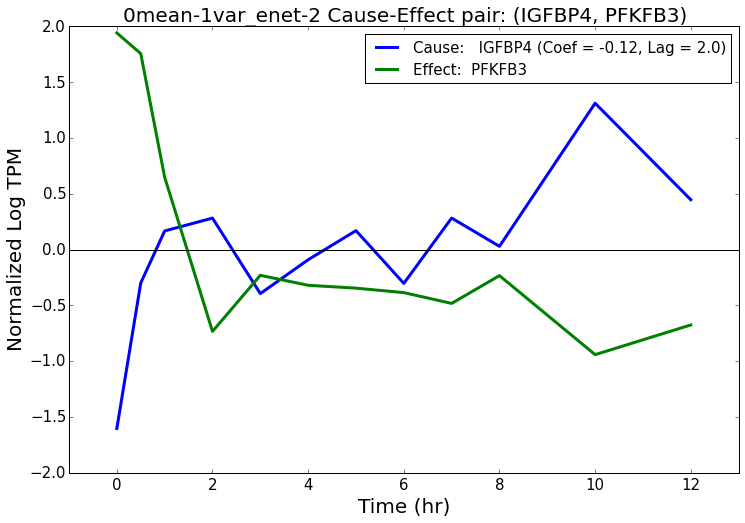

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-2/metab-any/0mean-1var_enet-2_ACOT8-MRPL35-lag-2-coef-1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/metab-any/0mean-1var_enet-2_ACOT8-MRPL35-lag-2-coef-1E-01.pdf


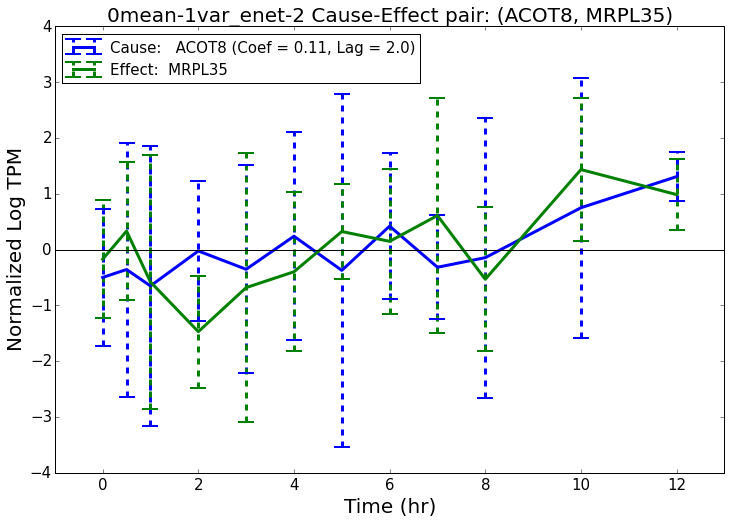

Filename:  analysis/plots/0mean-1var_enet-2/metab-any/0mean-1var_enet-2_no-bar-ACOT8-MRPL35-lag-2-coef-1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/metab-any/0mean-1var_enet-2_no-bar-ACOT8-MRPL35-lag-2-coef-1E-01.pdf


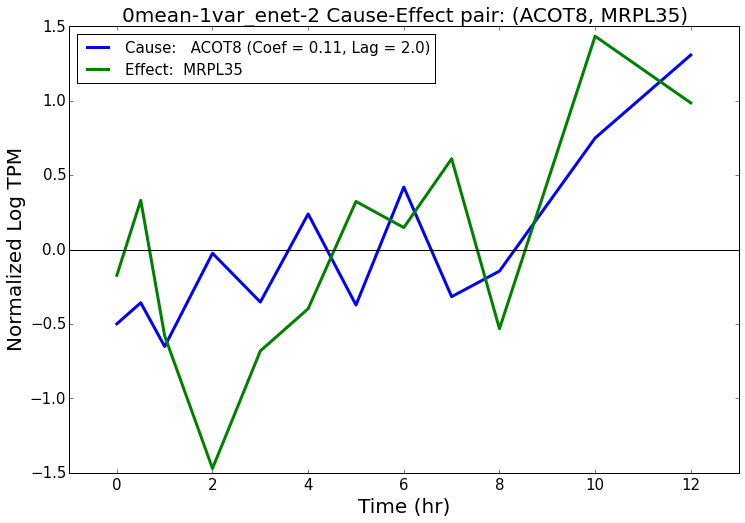

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-2/metab-any/0mean-1var_enet-2_HYOU1-SYVN1-lag-2-coef-1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/metab-any/0mean-1var_enet-2_HYOU1-SYVN1-lag-2-coef-1E-01.pdf


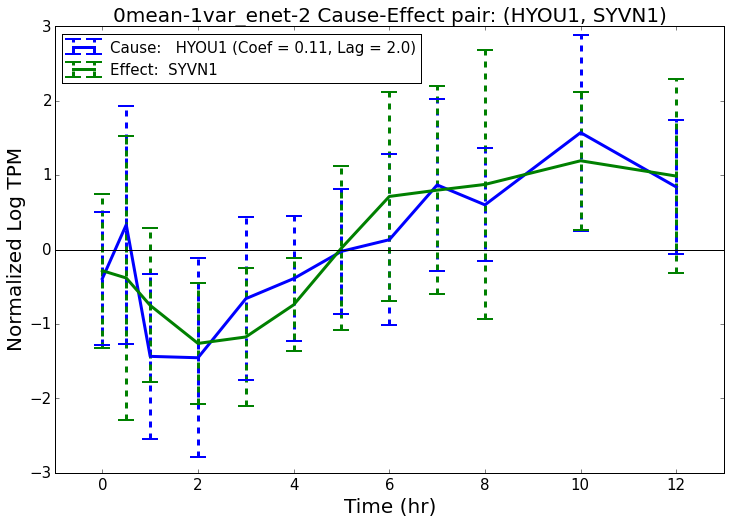

Filename:  analysis/plots/0mean-1var_enet-2/metab-any/0mean-1var_enet-2_no-bar-HYOU1-SYVN1-lag-2-coef-1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/metab-any/0mean-1var_enet-2_no-bar-HYOU1-SYVN1-lag-2-coef-1E-01.pdf


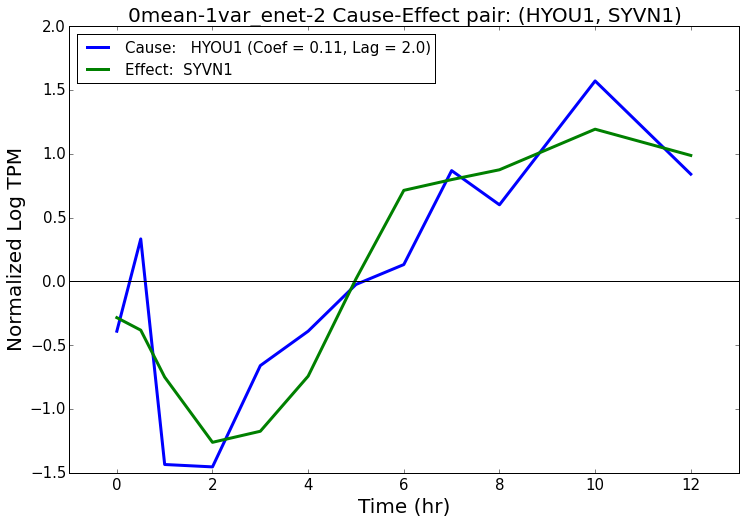

***********************************************
0mean-unnormalized_enet-1
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef         Summary: Cause   Summary: Effect
99                 SDS                AQP3  0.205634     1  Metabolism-gluc_GSEA,               NaN
146                SDS               WISP1  0.196105     1  Metabolism-gluc_GSEA,               NaN
151               AOC2               TONSL -0.195431     1  Metabolism-gluc_GSEA,  Hist-binding_GO,
Written to  analysis/plots/0mean-unnormalized_enet-1/metab-any/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-1/metab-any/0mean-unnormalized_enet-1_SDS-AQP3-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/metab-any/0mean-unnormalized_enet-1_SDS-AQP3-lag-1-coef-2E

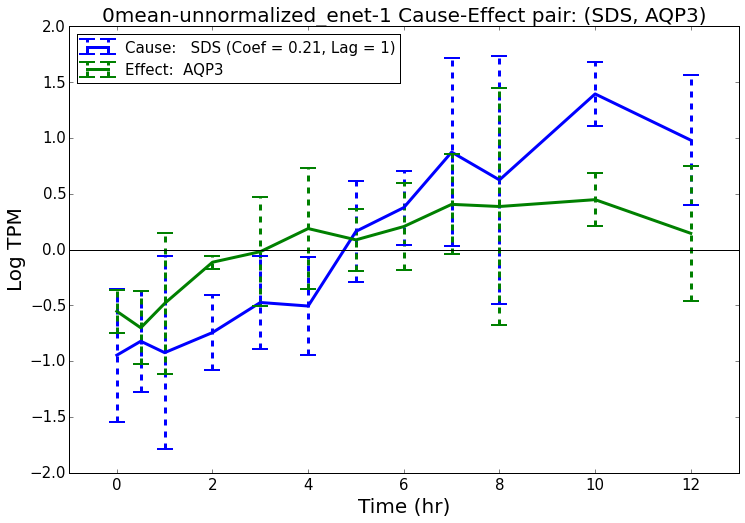

Filename:  analysis/plots/0mean-unnormalized_enet-1/metab-any/0mean-unnormalized_enet-1_no-bar-SDS-AQP3-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/metab-any/0mean-unnormalized_enet-1_no-bar-SDS-AQP3-lag-1-coef-2E-01.pdf


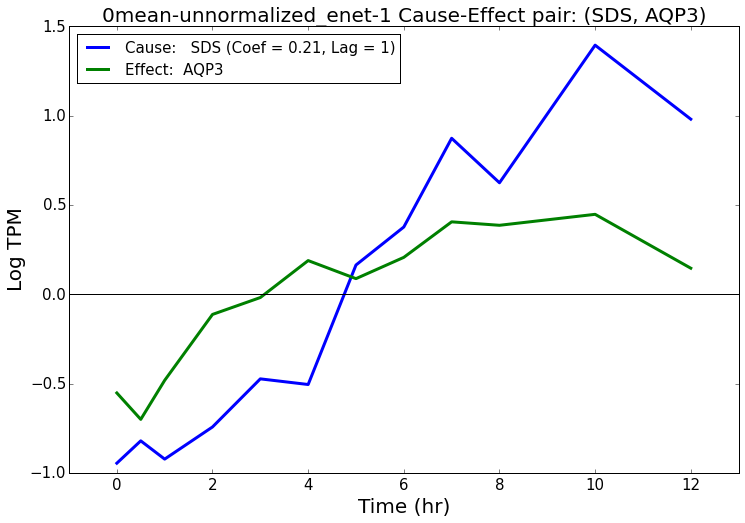

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-1/metab-any/0mean-unnormalized_enet-1_SDS-WISP1-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/metab-any/0mean-unnormalized_enet-1_SDS-WISP1-lag-1-coef-2E-01.pdf


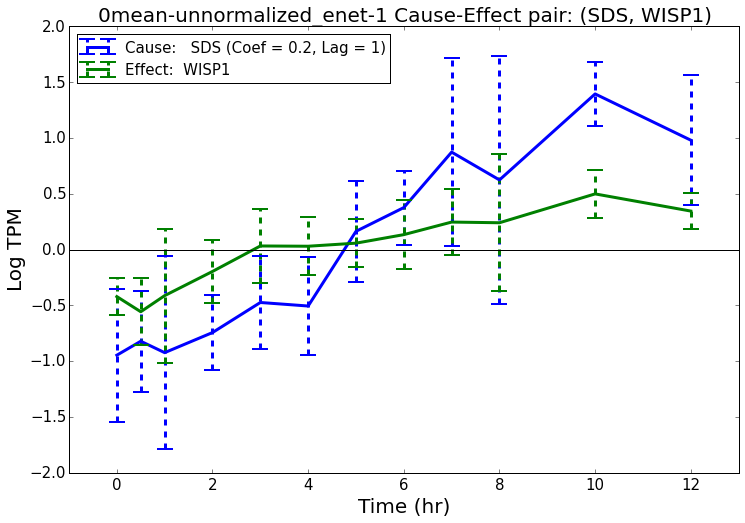

Filename:  analysis/plots/0mean-unnormalized_enet-1/metab-any/0mean-unnormalized_enet-1_no-bar-SDS-WISP1-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/metab-any/0mean-unnormalized_enet-1_no-bar-SDS-WISP1-lag-1-coef-2E-01.pdf


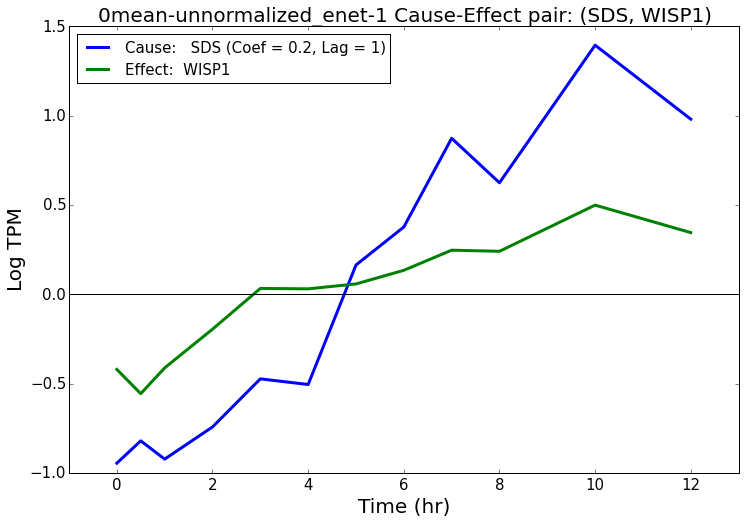

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-1/metab-any/0mean-unnormalized_enet-1_AOC2-TONSL-lag-1-coef--2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/metab-any/0mean-unnormalized_enet-1_AOC2-TONSL-lag-1-coef--2E-01.pdf


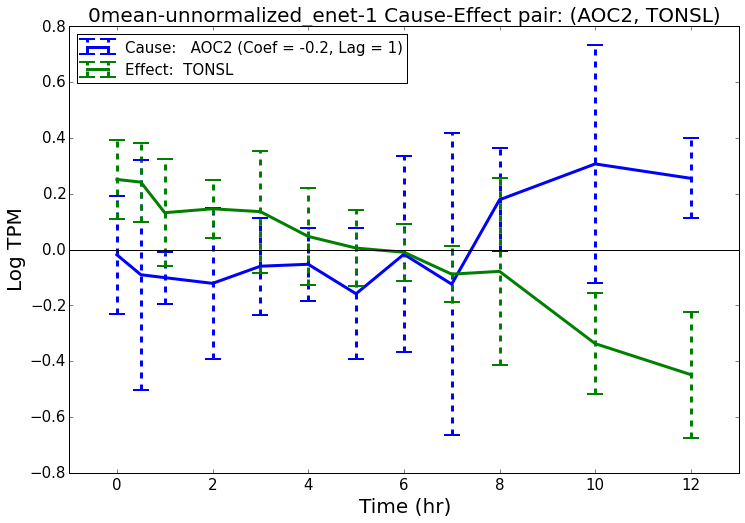

Filename:  analysis/plots/0mean-unnormalized_enet-1/metab-any/0mean-unnormalized_enet-1_no-bar-AOC2-TONSL-lag-1-coef--2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/metab-any/0mean-unnormalized_enet-1_no-bar-AOC2-TONSL-lag-1-coef--2E-01.pdf


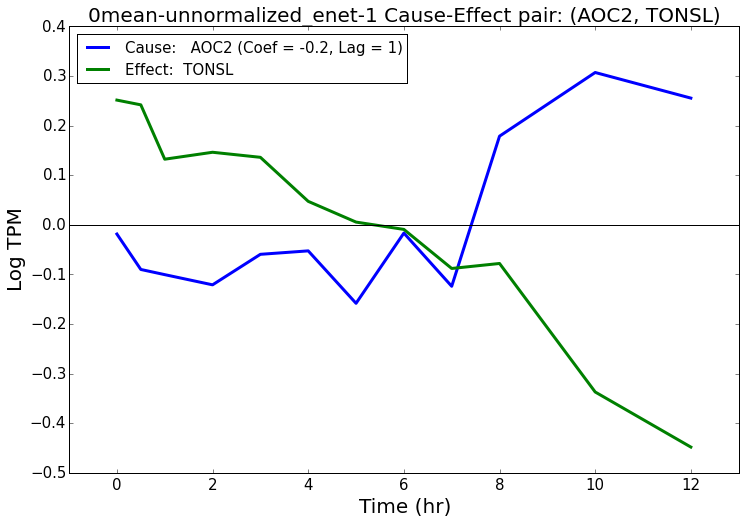

***********************************************
0mean-unnormalized_enet-2
***********************************************
   Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                         Summary: Cause        Summary: Effect
4             ANGPTL4                 SDS  0.215576   2.0  GR_direct,Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,  Metabolism-gluc_GSEA,
9             ANGPTL4                CILP  0.203158   2.0  GR_direct,Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,                    NaN
18            ANGPTL4               KCNB1  0.192518   2.0  GR_direct,Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,                    NaN
Written to  analysis/plots/0mean-unnormalized_enet-2/metab-any/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-2/metab-any/0mean-unnormalized_enet-2_

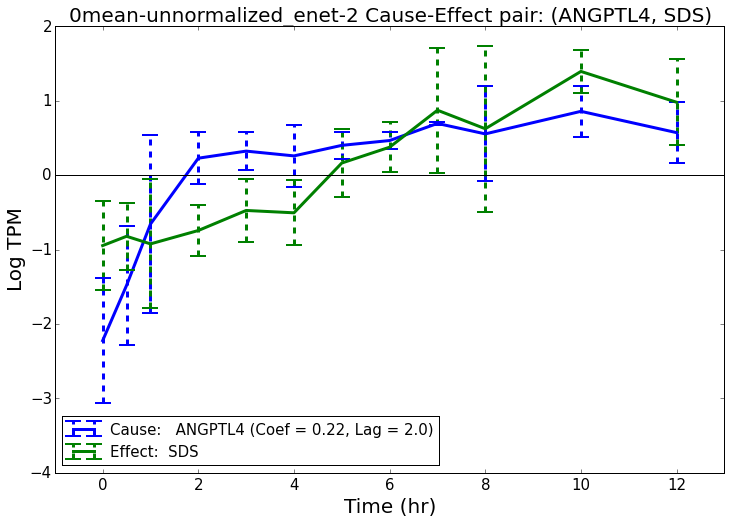

Filename:  analysis/plots/0mean-unnormalized_enet-2/metab-any/0mean-unnormalized_enet-2_no-bar-ANGPTL4-SDS-lag-2-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/metab-any/0mean-unnormalized_enet-2_no-bar-ANGPTL4-SDS-lag-2-coef-2E-01.pdf


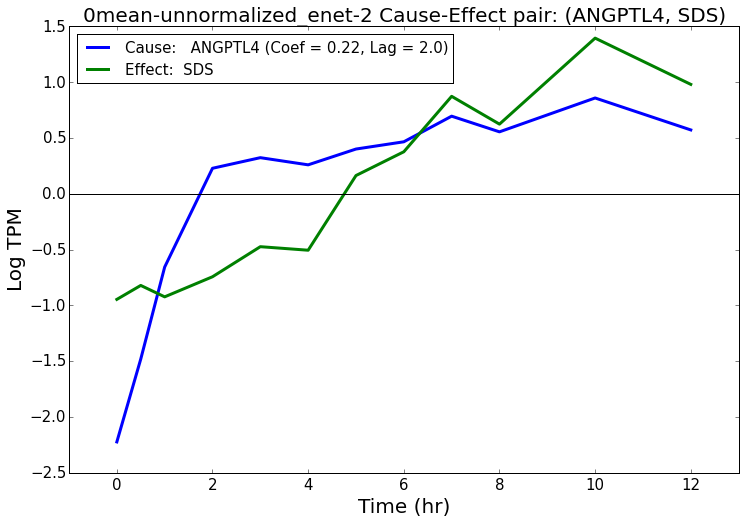

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-2/metab-any/0mean-unnormalized_enet-2_ANGPTL4-CILP-lag-2-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/metab-any/0mean-unnormalized_enet-2_ANGPTL4-CILP-lag-2-coef-2E-01.pdf


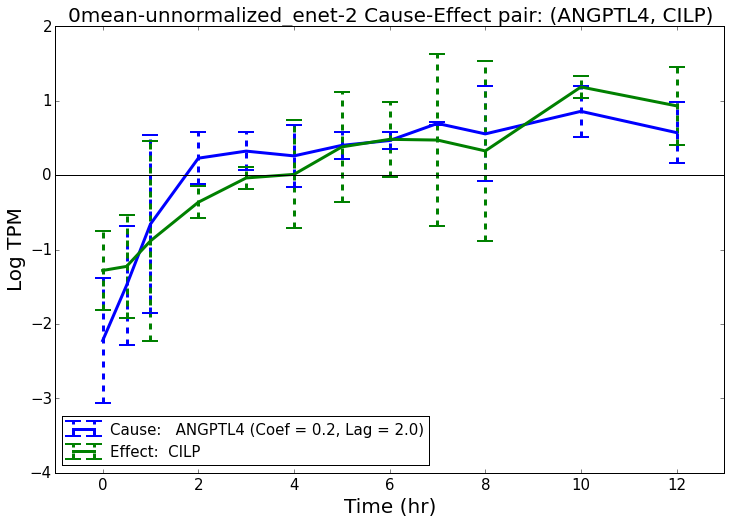

Filename:  analysis/plots/0mean-unnormalized_enet-2/metab-any/0mean-unnormalized_enet-2_no-bar-ANGPTL4-CILP-lag-2-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/metab-any/0mean-unnormalized_enet-2_no-bar-ANGPTL4-CILP-lag-2-coef-2E-01.pdf


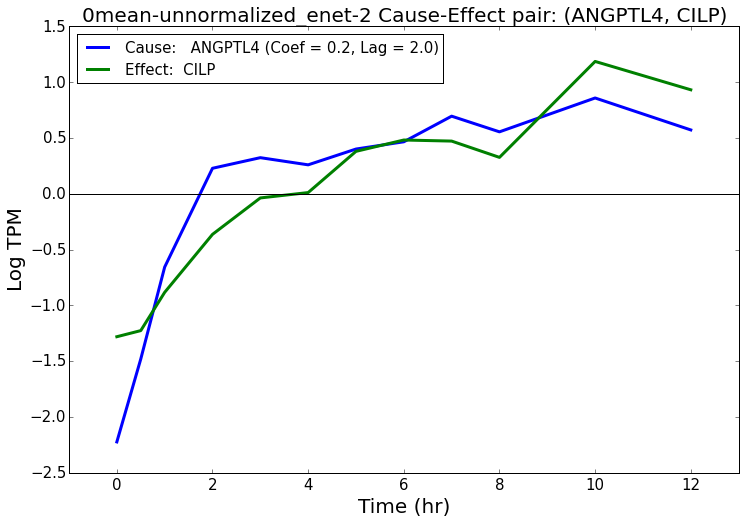

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-2/metab-any/0mean-unnormalized_enet-2_ANGPTL4-KCNB1-lag-2-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/metab-any/0mean-unnormalized_enet-2_ANGPTL4-KCNB1-lag-2-coef-2E-01.pdf


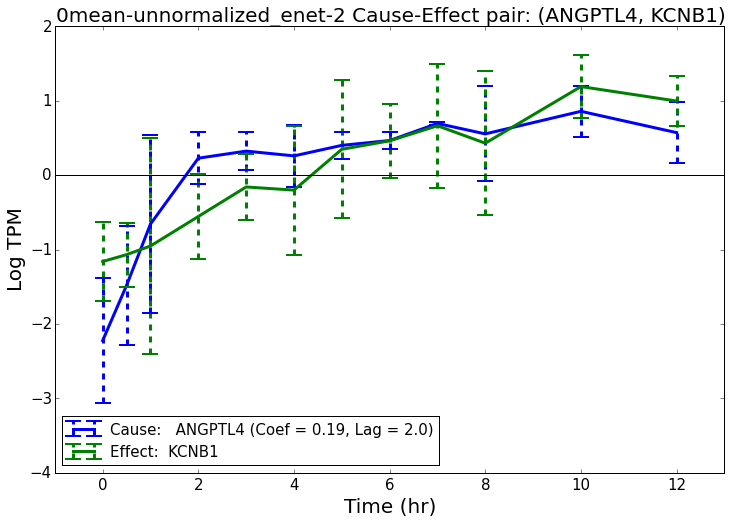

Filename:  analysis/plots/0mean-unnormalized_enet-2/metab-any/0mean-unnormalized_enet-2_no-bar-ANGPTL4-KCNB1-lag-2-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/metab-any/0mean-unnormalized_enet-2_no-bar-ANGPTL4-KCNB1-lag-2-coef-2E-01.pdf


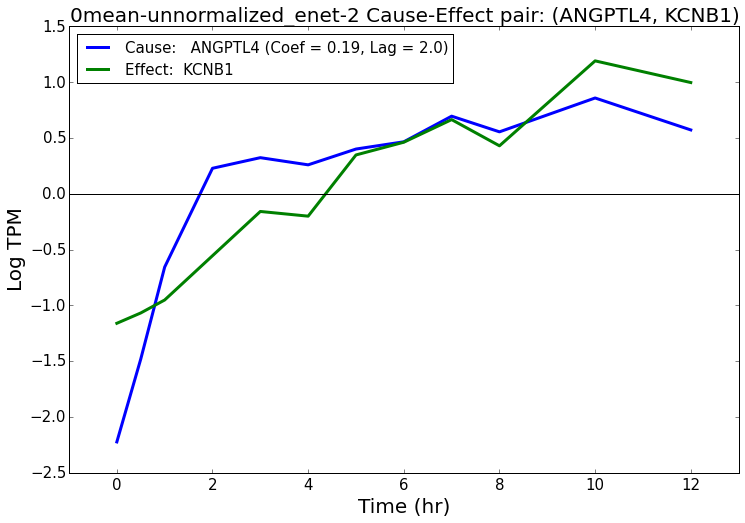

In [42]:
do_plot_nets(data_hg_df_list, plot_nets, names, timekeys_list, num_per_keys_list, timepoints_list, each_plot_folders=each_plot_folders, interest_index=None,
            ylabels=ylabels)

### Plot top Immune -> any overall

In [43]:

plotfoldersuffix = "imm-any"
each_plot_folders = [os.path.join(name_plot_folder, plotfoldersuffix) for name, name_plot_folder in zip(names, name_plot_folders)]
top_edge_num = 3
plot_nets = [net[net["Cause"].isin(imm_genes)].sort_values("AbsWeight", ascending=False).head(n=top_edge_num) for net in nets]

# display annotations
for plot_net in plot_nets:
    plot_net["Gene Symbol: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_net["Cause"].values]
    plot_net["Gene Symbol: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_net["Effect"].values]
    plot_net["Summary: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Summary"].values[0] for x in plot_net["Cause"].values]
    plot_net["Summary: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Summary"].values[0] for x in plot_net["Effect"].values]



***********************************************
0mean-1var_enet-1
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                     Summary: Cause  Summary: Effect
39               CXCL2             FAM172A -0.158501     1  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,              NaN
83               TRAF6              TMEM80  0.149246     1  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,              NaN
175              CXCL2              WDSUB1 -0.137853     1  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,              NaN
Written to  analysis/plots/0mean-1var_enet-1/imm-any/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-1/imm-any/0mean-1var_enet-1_CXCL2-FA

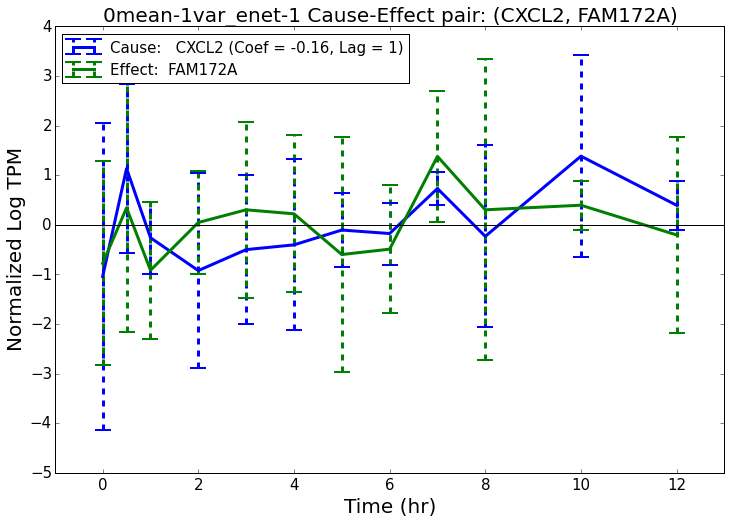

Filename:  analysis/plots/0mean-1var_enet-1/imm-any/0mean-1var_enet-1_no-bar-CXCL2-FAM172A-lag-1-coef--2E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/imm-any/0mean-1var_enet-1_no-bar-CXCL2-FAM172A-lag-1-coef--2E-01.pdf


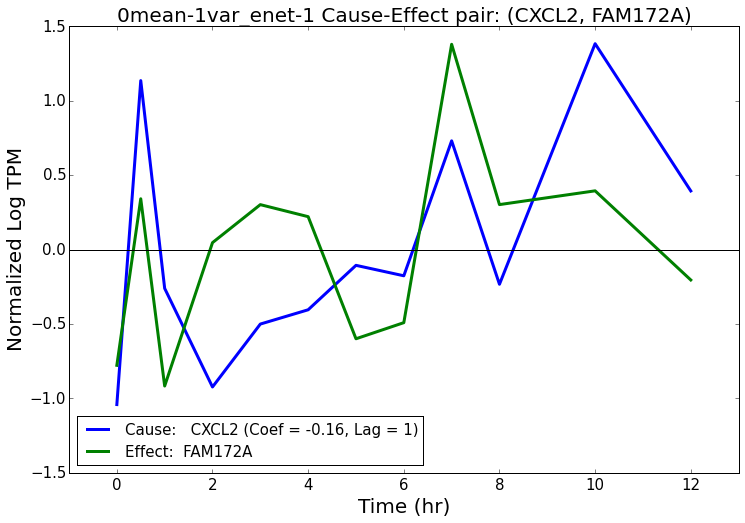

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-1/imm-any/0mean-1var_enet-1_TRAF6-TMEM80-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/imm-any/0mean-1var_enet-1_TRAF6-TMEM80-lag-1-coef-1E-01.pdf


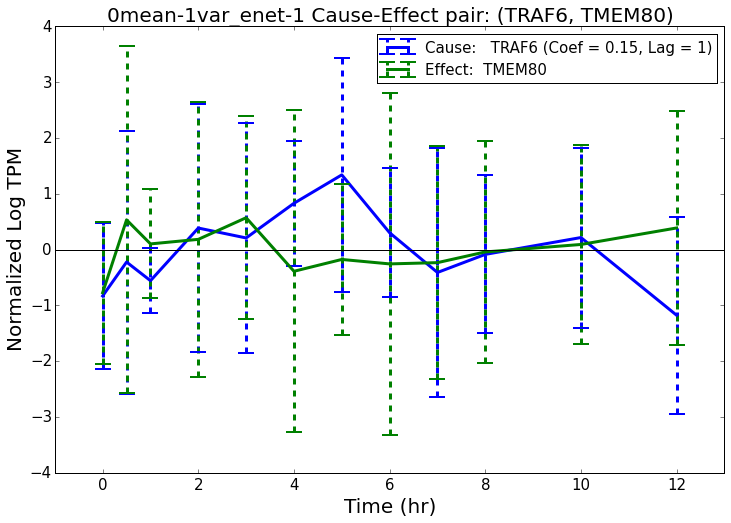

Filename:  analysis/plots/0mean-1var_enet-1/imm-any/0mean-1var_enet-1_no-bar-TRAF6-TMEM80-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/imm-any/0mean-1var_enet-1_no-bar-TRAF6-TMEM80-lag-1-coef-1E-01.pdf


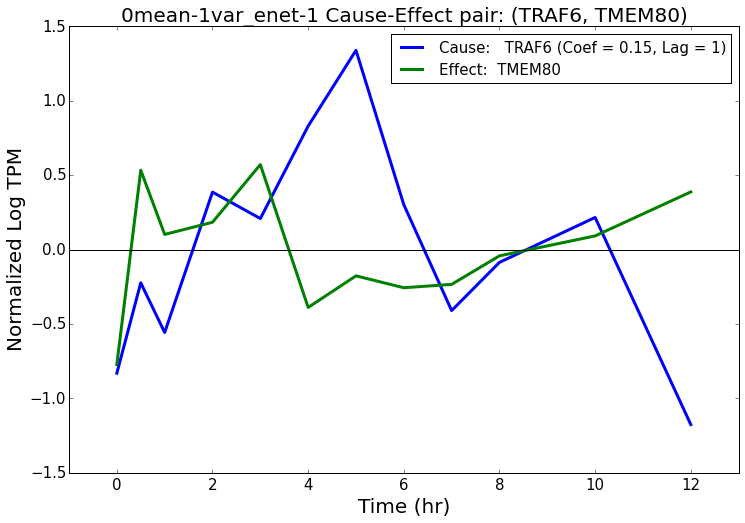

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-1/imm-any/0mean-1var_enet-1_CXCL2-WDSUB1-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/imm-any/0mean-1var_enet-1_CXCL2-WDSUB1-lag-1-coef--1E-01.pdf


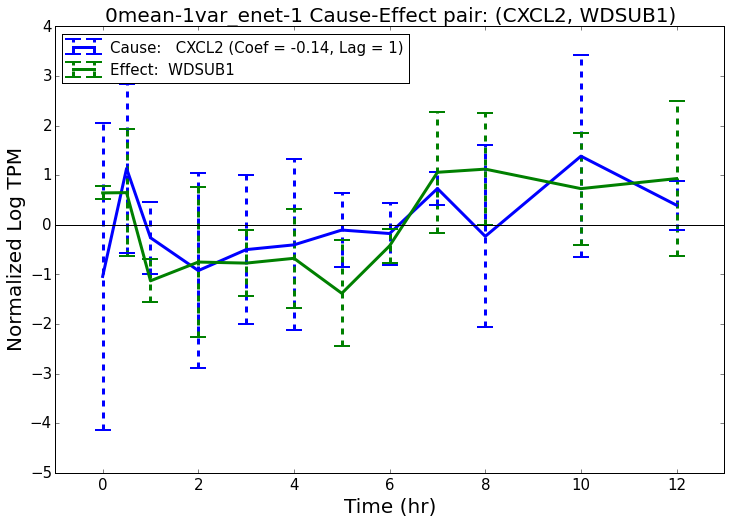

Filename:  analysis/plots/0mean-1var_enet-1/imm-any/0mean-1var_enet-1_no-bar-CXCL2-WDSUB1-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/imm-any/0mean-1var_enet-1_no-bar-CXCL2-WDSUB1-lag-1-coef--1E-01.pdf


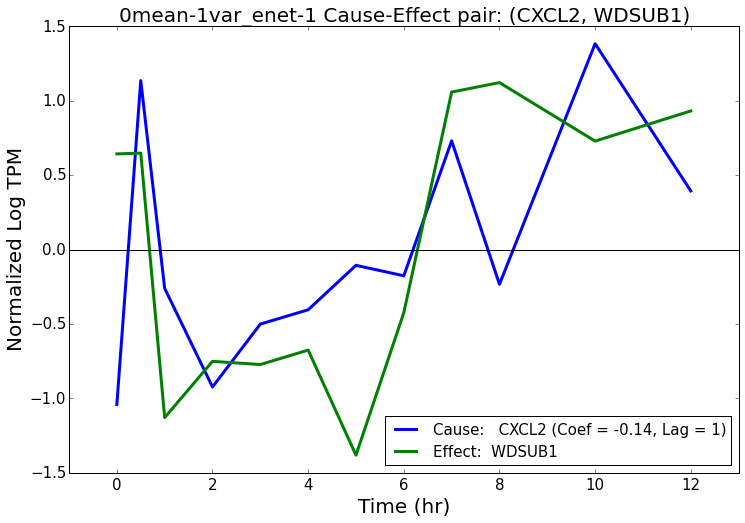

***********************************************
0mean-1var_enet-2
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                     Summary: Cause  Summary: Effect
34                 MIF             LAMTOR3 -0.125551   1.0  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,              NaN
117               MICB                LGR6 -0.112291   1.0               Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,              NaN
146                MIF               APOC1  0.108665   1.0  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,              NaN
Written to  analysis/plots/0mean-1var_enet-2/imm-any/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-2/imm-any/0mean-1var_enet-2_MIF-LAMT

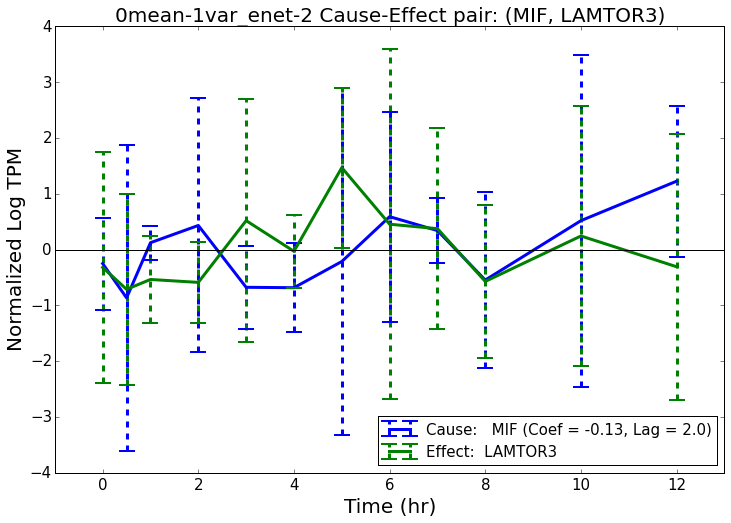

Filename:  analysis/plots/0mean-1var_enet-2/imm-any/0mean-1var_enet-2_no-bar-MIF-LAMTOR3-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/imm-any/0mean-1var_enet-2_no-bar-MIF-LAMTOR3-lag-2-coef--1E-01.pdf


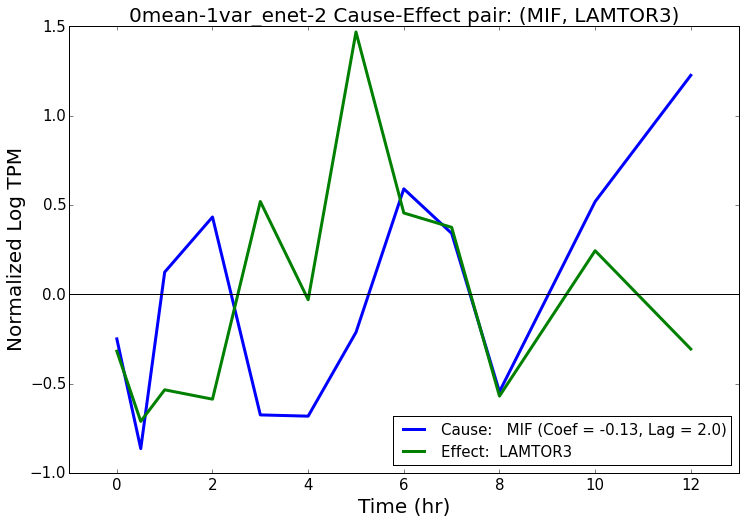

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-2/imm-any/0mean-1var_enet-2_MICB-LGR6-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/imm-any/0mean-1var_enet-2_MICB-LGR6-lag-2-coef--1E-01.pdf


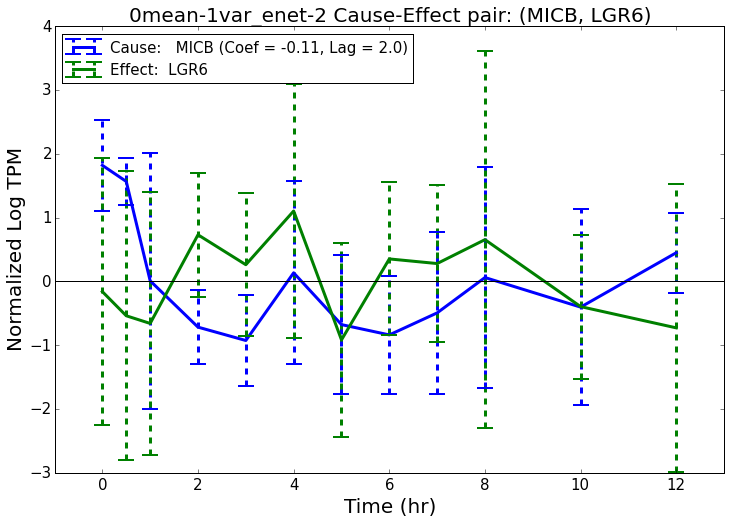

Filename:  analysis/plots/0mean-1var_enet-2/imm-any/0mean-1var_enet-2_no-bar-MICB-LGR6-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/imm-any/0mean-1var_enet-2_no-bar-MICB-LGR6-lag-2-coef--1E-01.pdf


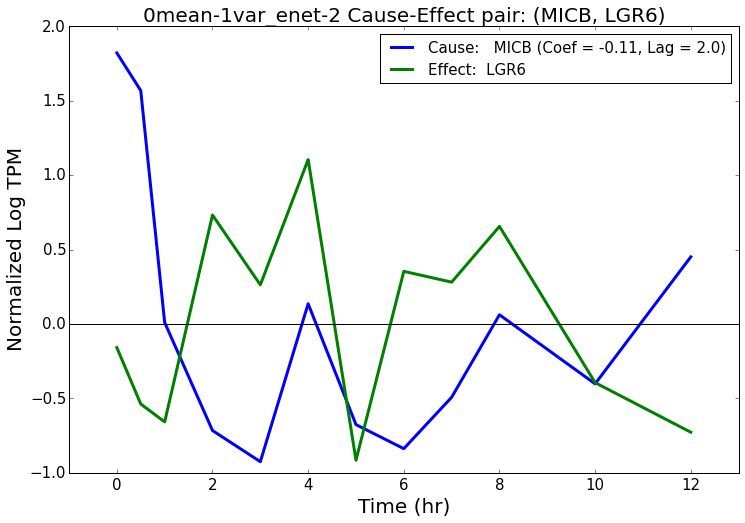

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-2/imm-any/0mean-1var_enet-2_MIF-APOC1-lag-2-coef-1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/imm-any/0mean-1var_enet-2_MIF-APOC1-lag-2-coef-1E-01.pdf


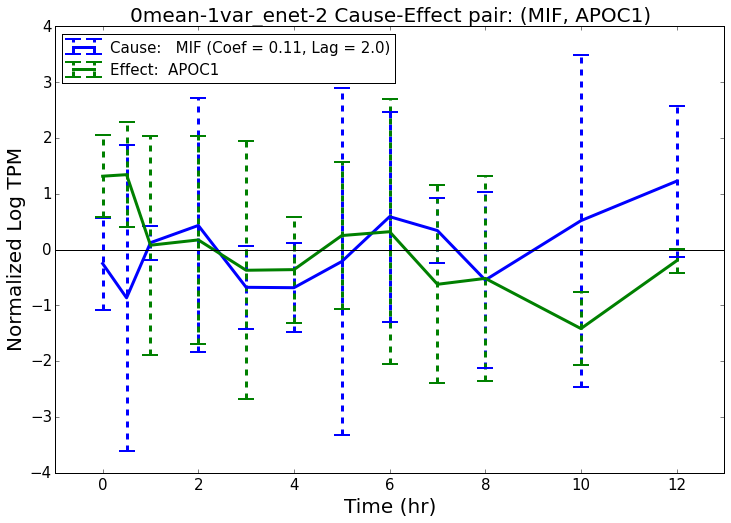

Filename:  analysis/plots/0mean-1var_enet-2/imm-any/0mean-1var_enet-2_no-bar-MIF-APOC1-lag-2-coef-1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/imm-any/0mean-1var_enet-2_no-bar-MIF-APOC1-lag-2-coef-1E-01.pdf


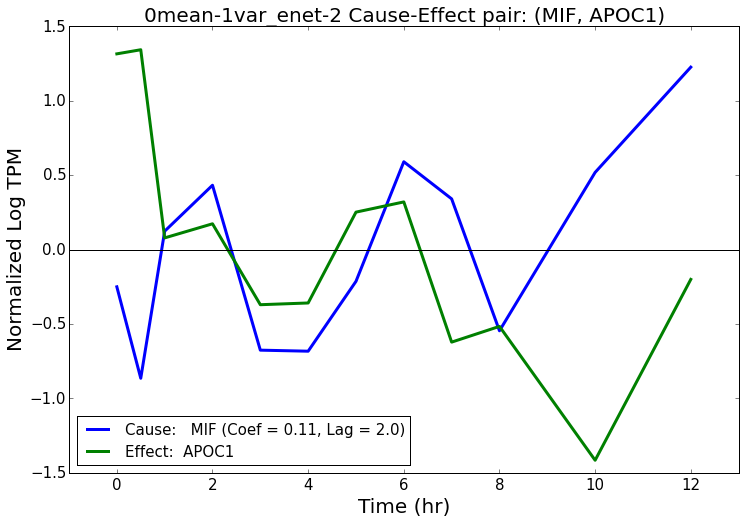

***********************************************
0mean-unnormalized_enet-1
***********************************************
   Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                     Summary: Cause Summary: Effect
5               CXCL2           HIST2H2AB -0.276508     1  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,             NaN
14             IL17RB             TSC22D3 -0.250643     1               Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,      TF-Bioguo,
35            CEACAM6              ENTPD2  0.228576     1  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,      GR_direct,
Written to  analysis/plots/0mean-unnormalized_enet-1/imm-any/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-1/imm-any/0mean-unno

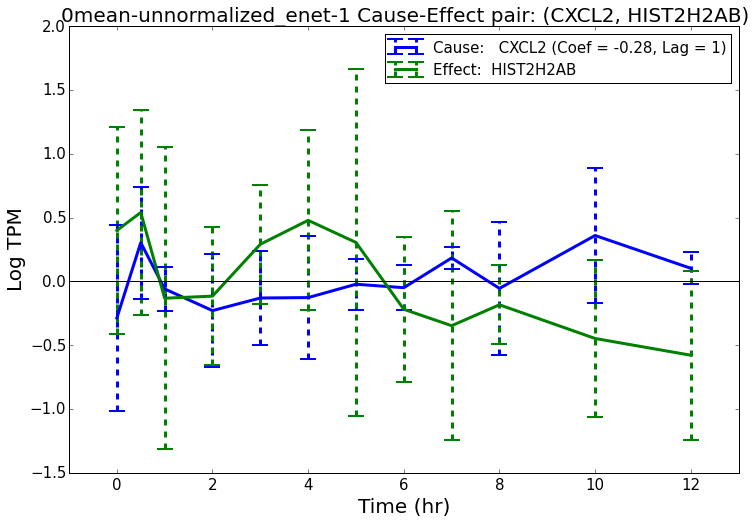

Filename:  analysis/plots/0mean-unnormalized_enet-1/imm-any/0mean-unnormalized_enet-1_no-bar-CXCL2-HIST2H2AB-lag-1-coef--3E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/imm-any/0mean-unnormalized_enet-1_no-bar-CXCL2-HIST2H2AB-lag-1-coef--3E-01.pdf


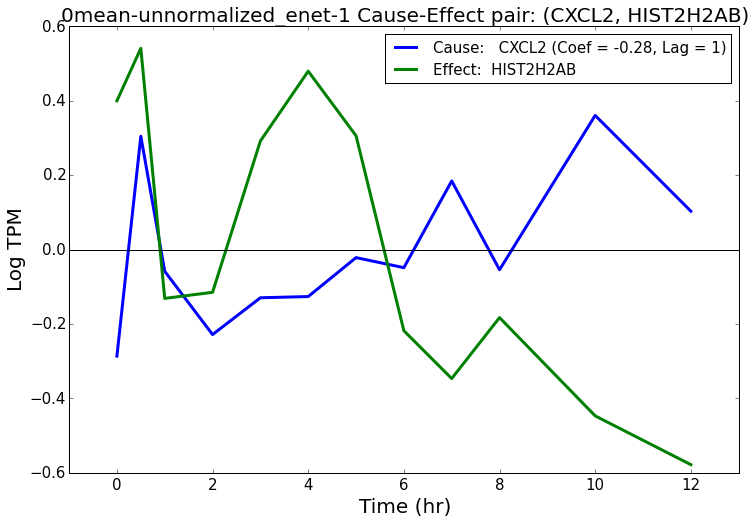

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-1/imm-any/0mean-unnormalized_enet-1_IL17RB-TSC22D3-lag-1-coef--3E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/imm-any/0mean-unnormalized_enet-1_IL17RB-TSC22D3-lag-1-coef--3E-01.pdf


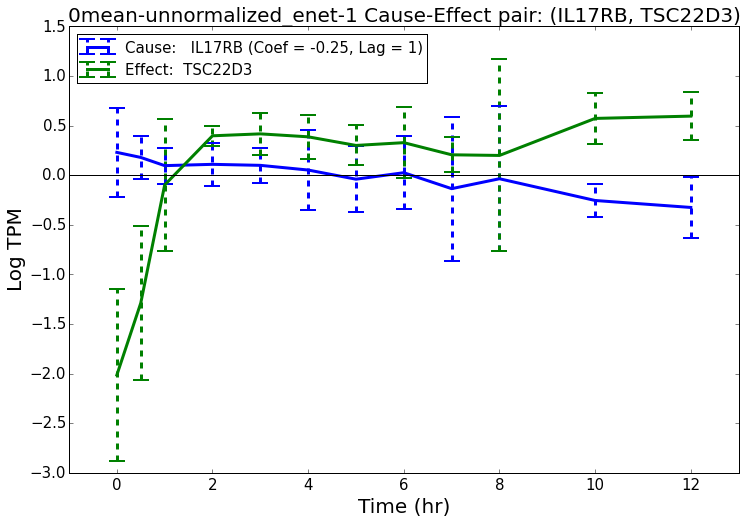

Filename:  analysis/plots/0mean-unnormalized_enet-1/imm-any/0mean-unnormalized_enet-1_no-bar-IL17RB-TSC22D3-lag-1-coef--3E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/imm-any/0mean-unnormalized_enet-1_no-bar-IL17RB-TSC22D3-lag-1-coef--3E-01.pdf


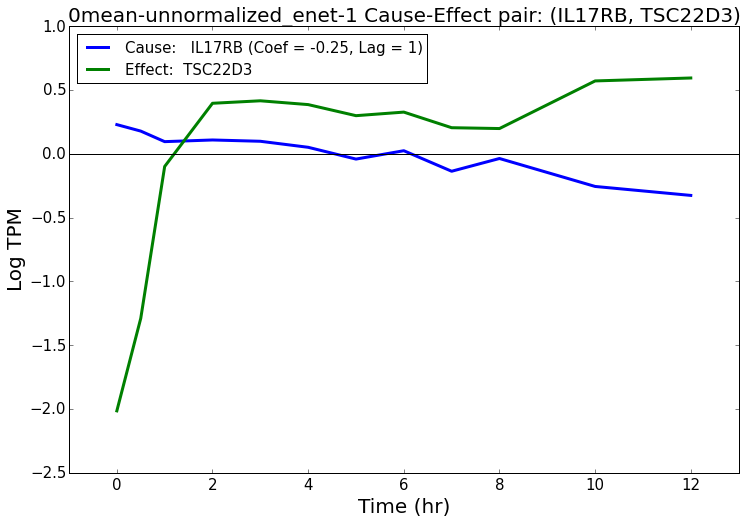

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-1/imm-any/0mean-unnormalized_enet-1_CEACAM6-ENTPD2-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/imm-any/0mean-unnormalized_enet-1_CEACAM6-ENTPD2-lag-1-coef-2E-01.pdf


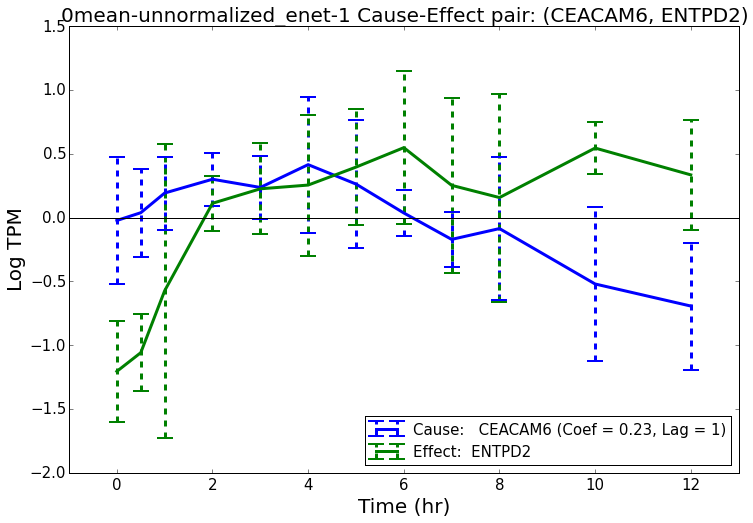

Filename:  analysis/plots/0mean-unnormalized_enet-1/imm-any/0mean-unnormalized_enet-1_no-bar-CEACAM6-ENTPD2-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/imm-any/0mean-unnormalized_enet-1_no-bar-CEACAM6-ENTPD2-lag-1-coef-2E-01.pdf


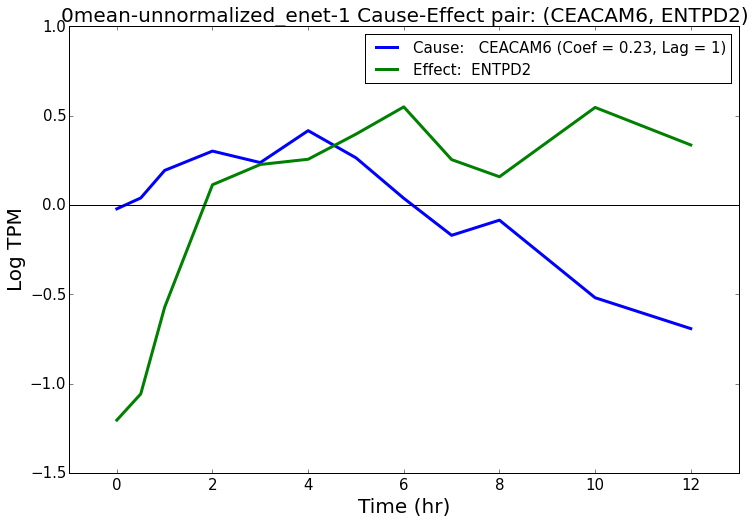

***********************************************
0mean-unnormalized_enet-2
***********************************************
   Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                                   Summary: Cause        Summary: Effect
53              SOCS1            HIST2H3D  0.173291   2.0  Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,                    NaN
54              CXCL2           HIST2H2AB -0.173204   1.0                Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,                    NaN
82            TNFAIP6                AOC2 -0.161191   2.0                Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  Metabolism-gluc_GSEA,
Written to  analysis/plots/0mean-unnormalized_enet-2/imm-any/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4

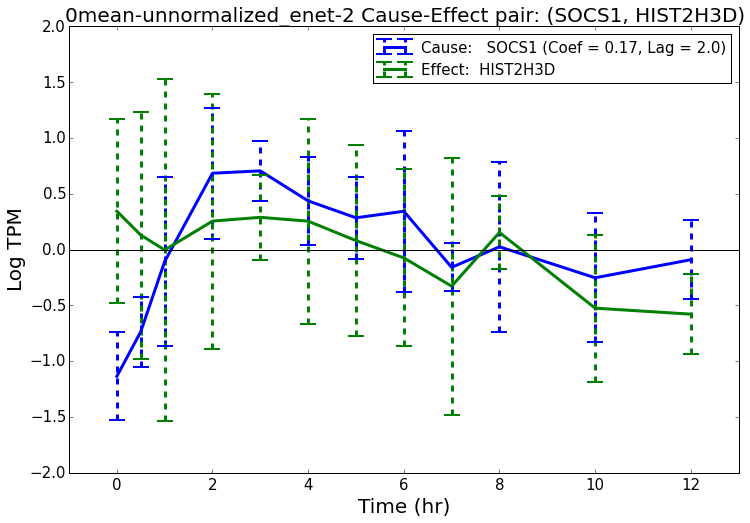

Filename:  analysis/plots/0mean-unnormalized_enet-2/imm-any/0mean-unnormalized_enet-2_no-bar-SOCS1-HIST2H3D-lag-2-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/imm-any/0mean-unnormalized_enet-2_no-bar-SOCS1-HIST2H3D-lag-2-coef-2E-01.pdf


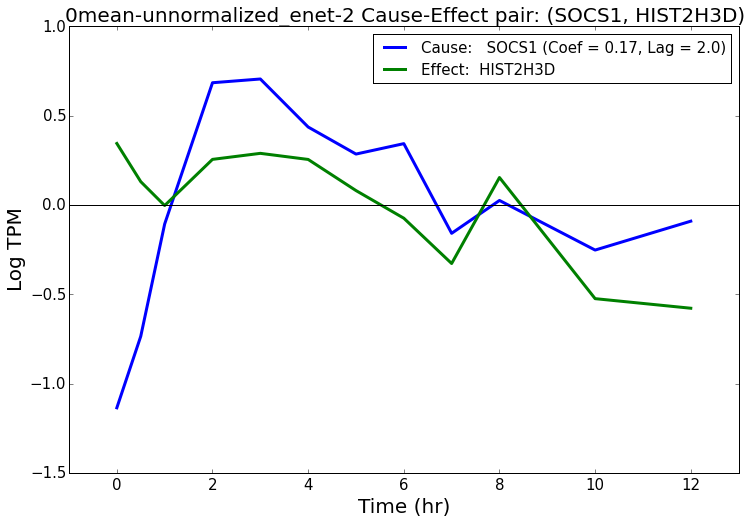

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-2/imm-any/0mean-unnormalized_enet-2_CXCL2-HIST2H2AB-lag-2-coef--2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/imm-any/0mean-unnormalized_enet-2_CXCL2-HIST2H2AB-lag-2-coef--2E-01.pdf


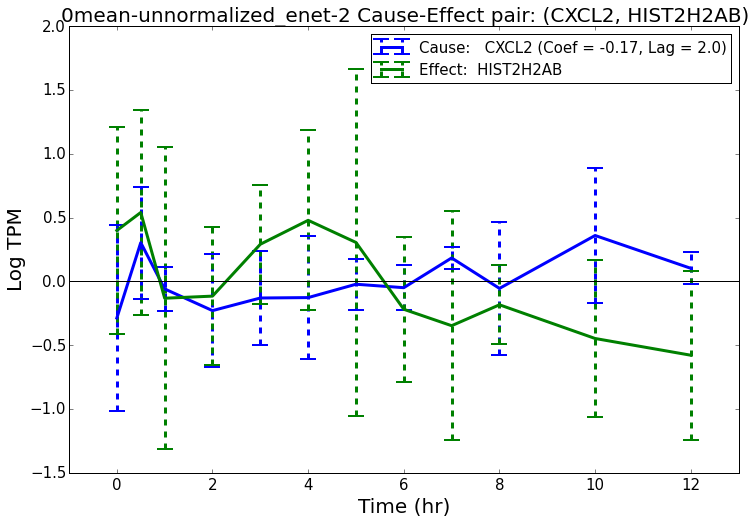

Filename:  analysis/plots/0mean-unnormalized_enet-2/imm-any/0mean-unnormalized_enet-2_no-bar-CXCL2-HIST2H2AB-lag-2-coef--2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/imm-any/0mean-unnormalized_enet-2_no-bar-CXCL2-HIST2H2AB-lag-2-coef--2E-01.pdf


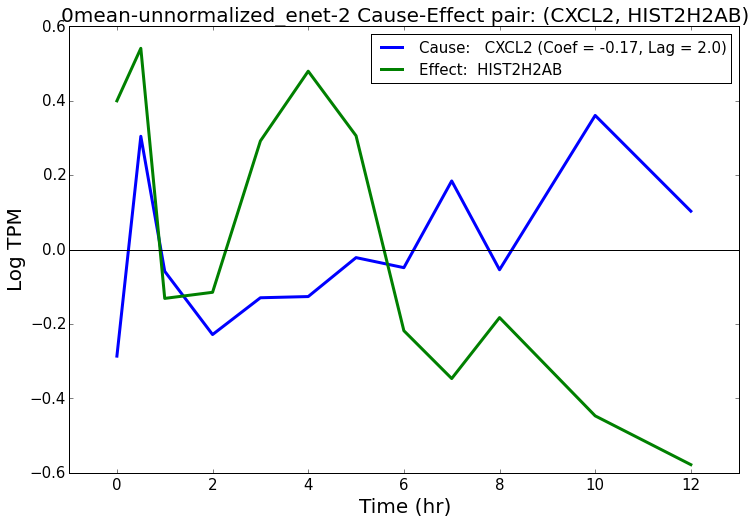

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-2/imm-any/0mean-unnormalized_enet-2_TNFAIP6-AOC2-lag-2-coef--2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/imm-any/0mean-unnormalized_enet-2_TNFAIP6-AOC2-lag-2-coef--2E-01.pdf


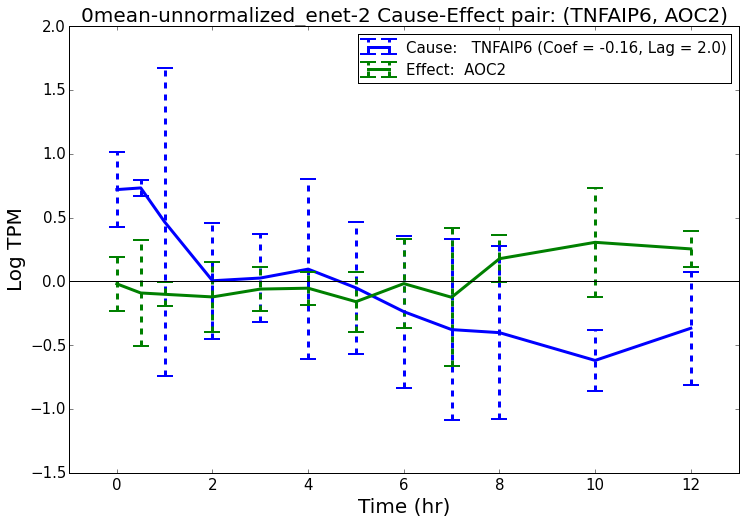

Filename:  analysis/plots/0mean-unnormalized_enet-2/imm-any/0mean-unnormalized_enet-2_no-bar-TNFAIP6-AOC2-lag-2-coef--2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/imm-any/0mean-unnormalized_enet-2_no-bar-TNFAIP6-AOC2-lag-2-coef--2E-01.pdf


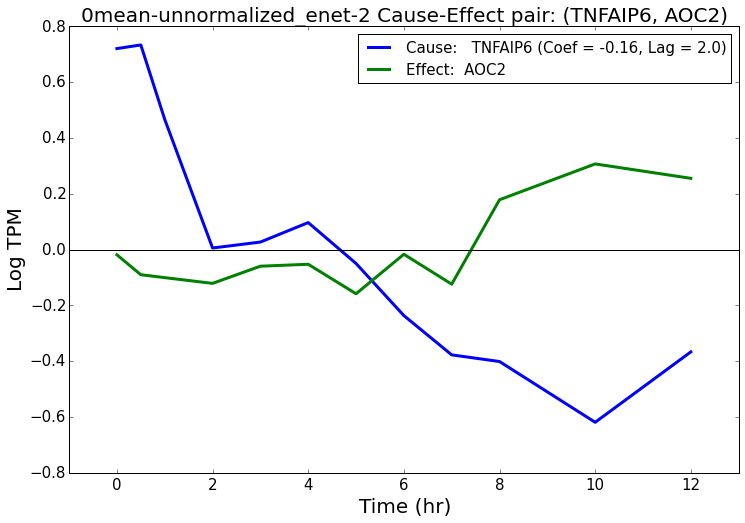

In [44]:
do_plot_nets(data_hg_df_list, plot_nets, names, timekeys_list, num_per_keys_list, timepoints_list, each_plot_folders=each_plot_folders, interest_index=None,
            ylabels=ylabels)

### Plot top TF-> Metabolism overall

In [45]:
# set which net to plot

plotfoldersuffix = "TF-Metabolism"
each_plot_folders = [os.path.join(name_plot_folder, plotfoldersuffix) for name, name_plot_folder in zip(names, name_plot_folders)]
top_edge_num = 3
plot_nets = [net[np.logical_and(net["Cause"].isin(tf_genes), net["Effect"].isin(metab_genes))].head(n=top_edge_num)  for net in nets]

for plot_net in plot_nets:
    plot_net["Gene Symbol: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_net["Cause"].values]
    plot_net["Gene Symbol: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_net["Effect"].values]
    plot_net["Summary: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Summary"].values[0] for x in plot_net["Cause"].values]
    plot_net["Summary: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Summary"].values[0] for x in plot_net["Effect"].values]


***********************************************
0mean-1var_enet-1
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef        Summary: Cause                                                                      Summary: Effect
411              PRDM1               VAMP2  0.125640     1  GR_direct,TF-Bioguo,                                                                       Diabetes_GSEA,
512               GLI4               VAMP2  0.122122     1            TF-Bioguo,                                                                       Diabetes_GSEA,
542              PRDM1               YWHAH -0.121192     1  GR_direct,TF-Bioguo,  GR_GO,GR_GSEA,Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/0mean-1var_enet-1/TF-Metabolism/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4

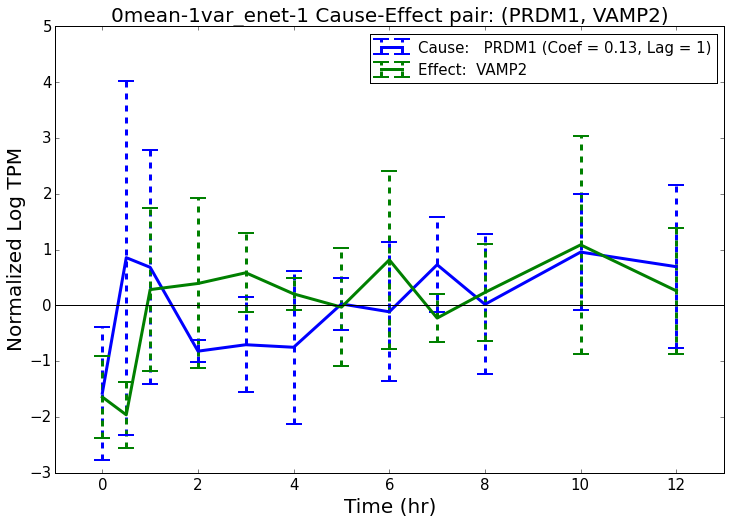

Filename:  analysis/plots/0mean-1var_enet-1/TF-Metabolism/0mean-1var_enet-1_no-bar-PRDM1-VAMP2-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/TF-Metabolism/0mean-1var_enet-1_no-bar-PRDM1-VAMP2-lag-1-coef-1E-01.pdf


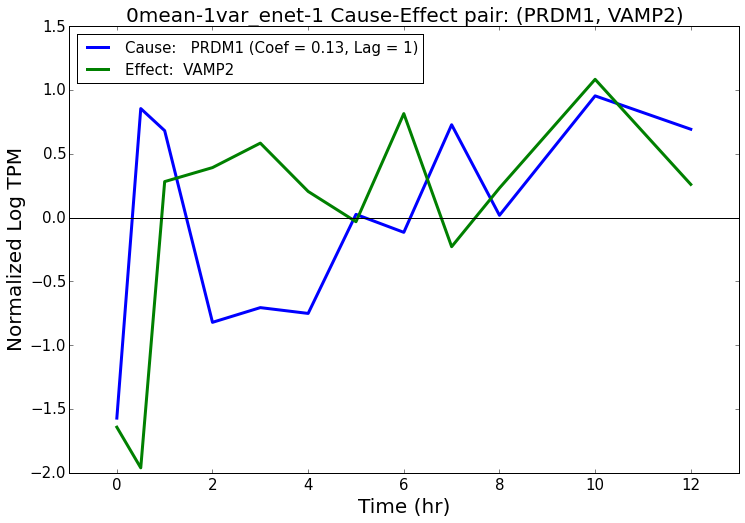

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-1/TF-Metabolism/0mean-1var_enet-1_GLI4-VAMP2-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/TF-Metabolism/0mean-1var_enet-1_GLI4-VAMP2-lag-1-coef-1E-01.pdf


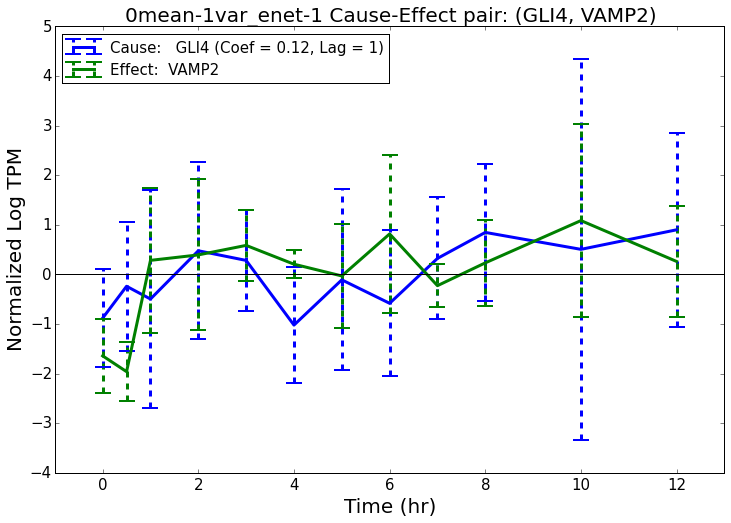

Filename:  analysis/plots/0mean-1var_enet-1/TF-Metabolism/0mean-1var_enet-1_no-bar-GLI4-VAMP2-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/TF-Metabolism/0mean-1var_enet-1_no-bar-GLI4-VAMP2-lag-1-coef-1E-01.pdf


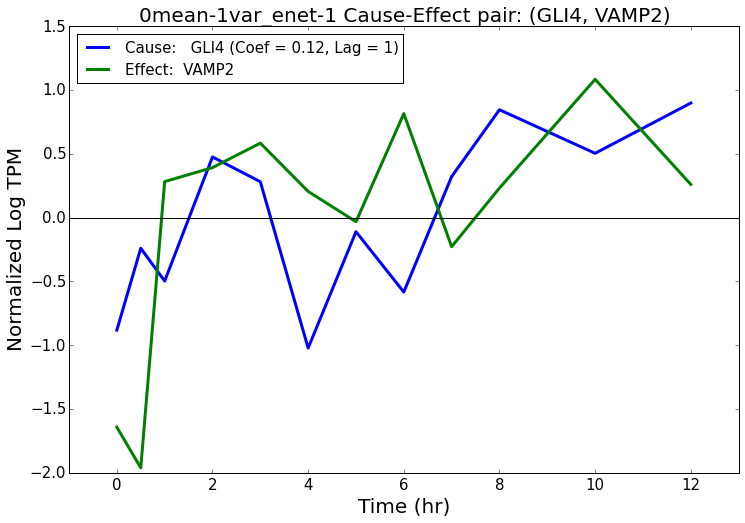

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-1/TF-Metabolism/0mean-1var_enet-1_PRDM1-YWHAH-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/TF-Metabolism/0mean-1var_enet-1_PRDM1-YWHAH-lag-1-coef--1E-01.pdf


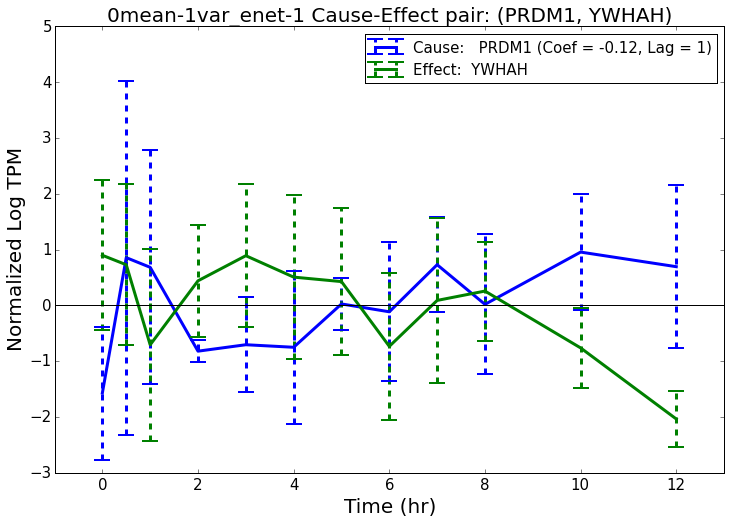

Filename:  analysis/plots/0mean-1var_enet-1/TF-Metabolism/0mean-1var_enet-1_no-bar-PRDM1-YWHAH-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/TF-Metabolism/0mean-1var_enet-1_no-bar-PRDM1-YWHAH-lag-1-coef--1E-01.pdf


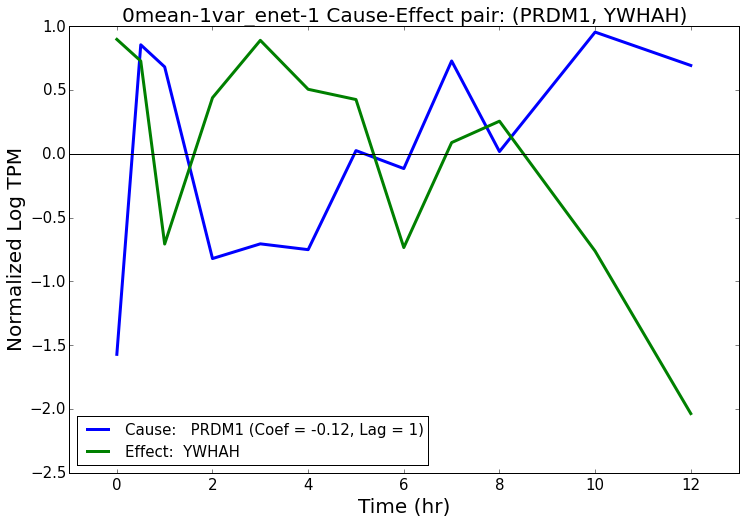

***********************************************
0mean-1var_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause         Summary: Effect
538              ZNF136             ALDH3B1 -0.093329   1.0     TF-Bioguo,   Metabolism-gluc_GSEA,
1187              HOXB5               ACOT8  0.083111   1.0     TF-Bioguo,  Metabolism-lipid_GSEA,
1496              ATF6B             ALDH3B1  0.079983   2.0     TF-Bioguo,   Metabolism-gluc_GSEA,
Written to  analysis/plots/0mean-1var_enet-2/TF-Metabolism/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-2/TF-Metabolism/0mean-1var_enet-2_ZNF136-ALDH3B1-lag-2-coef--9E-02.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/TF-Metabolism/0mean-1var_enet-2_ZNF136-ALDH3B1-lag-2-coef--9E-02.pdf


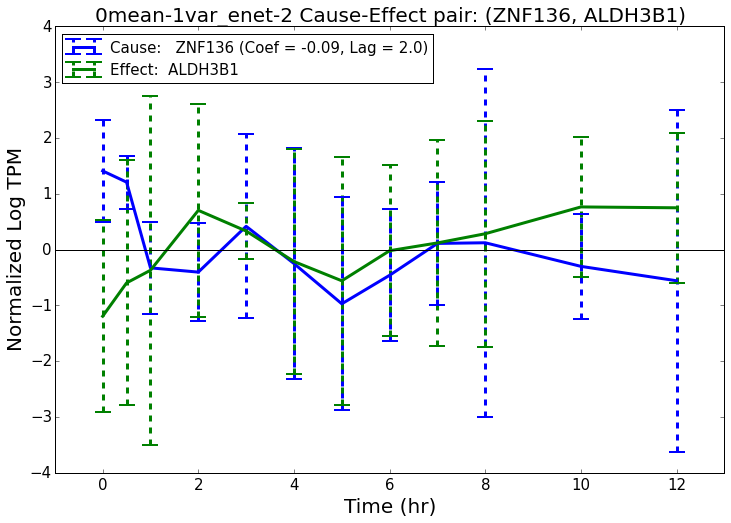

Filename:  analysis/plots/0mean-1var_enet-2/TF-Metabolism/0mean-1var_enet-2_no-bar-ZNF136-ALDH3B1-lag-2-coef--9E-02.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/TF-Metabolism/0mean-1var_enet-2_no-bar-ZNF136-ALDH3B1-lag-2-coef--9E-02.pdf


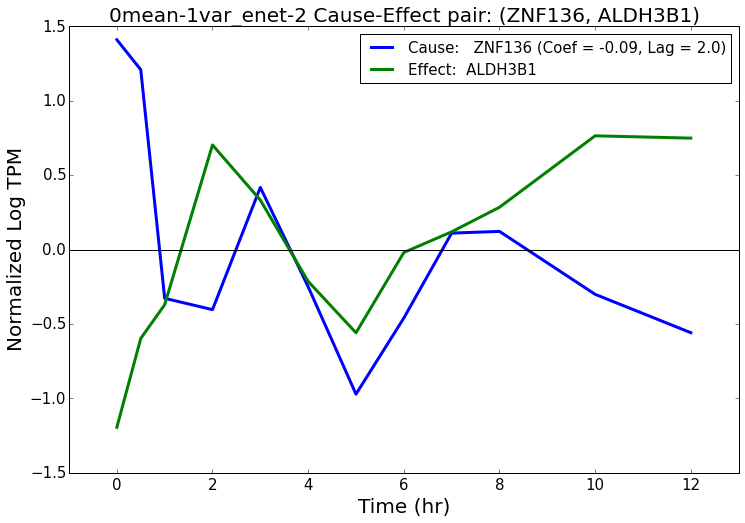

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-2/TF-Metabolism/0mean-1var_enet-2_HOXB5-ACOT8-lag-2-coef-8E-02.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/TF-Metabolism/0mean-1var_enet-2_HOXB5-ACOT8-lag-2-coef-8E-02.pdf


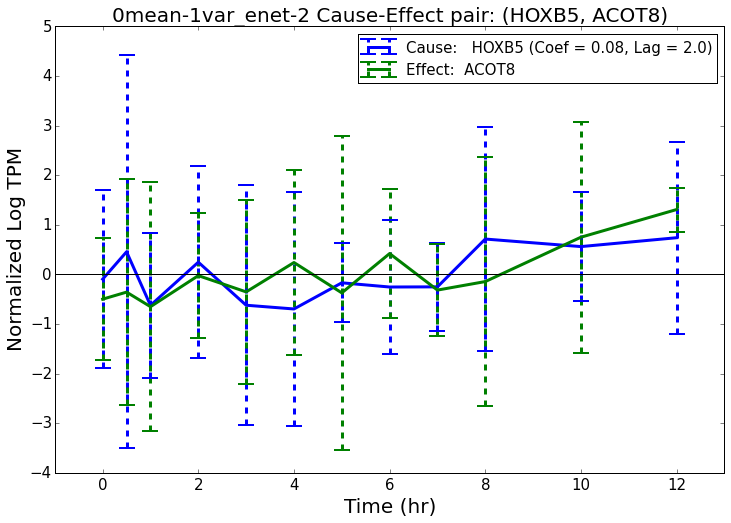

Filename:  analysis/plots/0mean-1var_enet-2/TF-Metabolism/0mean-1var_enet-2_no-bar-HOXB5-ACOT8-lag-2-coef-8E-02.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/TF-Metabolism/0mean-1var_enet-2_no-bar-HOXB5-ACOT8-lag-2-coef-8E-02.pdf


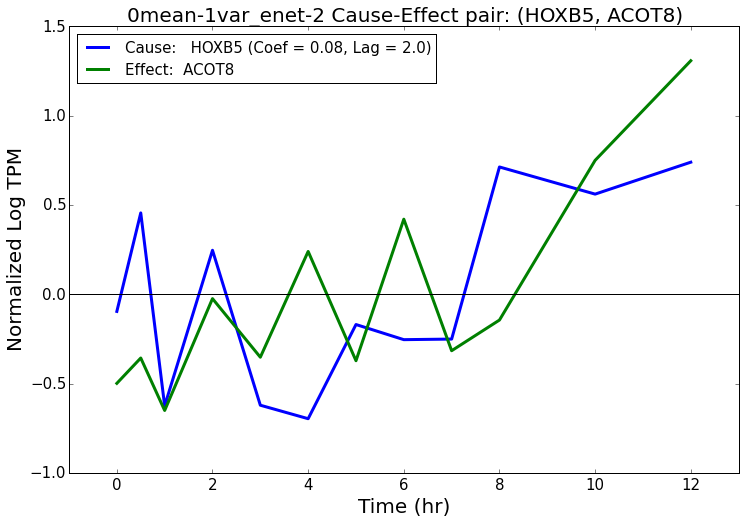

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-2/TF-Metabolism/0mean-1var_enet-2_ATF6B-ALDH3B1-lag-2-coef-8E-02.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/TF-Metabolism/0mean-1var_enet-2_ATF6B-ALDH3B1-lag-2-coef-8E-02.pdf


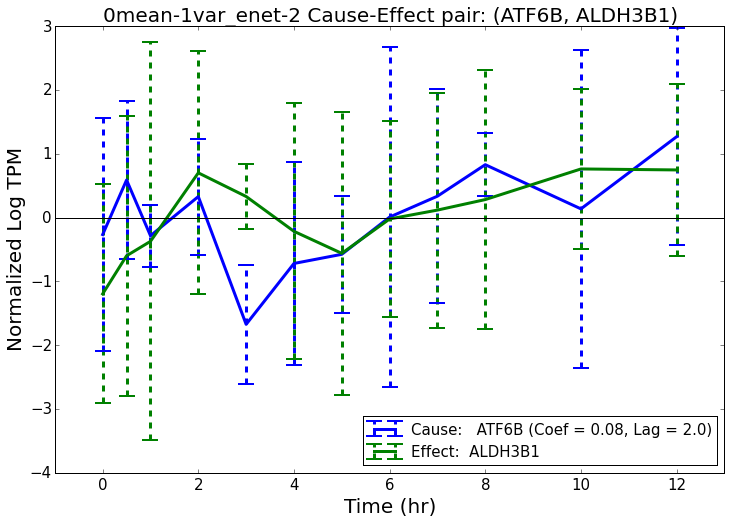

Filename:  analysis/plots/0mean-1var_enet-2/TF-Metabolism/0mean-1var_enet-2_no-bar-ATF6B-ALDH3B1-lag-2-coef-8E-02.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/TF-Metabolism/0mean-1var_enet-2_no-bar-ATF6B-ALDH3B1-lag-2-coef-8E-02.pdf


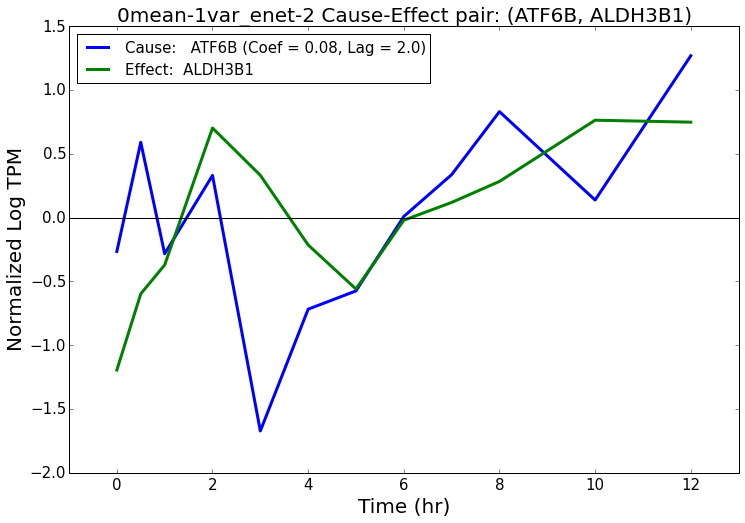

***********************************************
0mean-unnormalized_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                       Summary: Cause                                                                  Summary: Effect
477              POU5F1                HES1 -0.161991     1  GR_direct,TF-Bioguo,DNA-binding_GO,                                          Diabetes_GSEA,TF-Bioguo,DNA-binding_GO,
1200            TFCP2L1                CCL2 -0.134972     1                 GR_direct,TF-Bioguo,  Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
1351               GLI4               SOCS1  0.131694     1                           TF-Bioguo,  Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/0mean-unnormalized_enet-1/TF-Metabolism/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_r

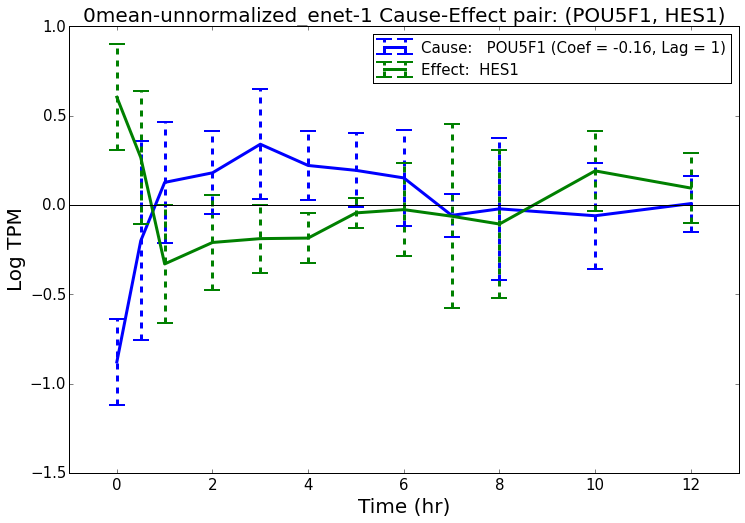

Filename:  analysis/plots/0mean-unnormalized_enet-1/TF-Metabolism/0mean-unnormalized_enet-1_no-bar-POU5F1-HES1-lag-1-coef--2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/TF-Metabolism/0mean-unnormalized_enet-1_no-bar-POU5F1-HES1-lag-1-coef--2E-01.pdf


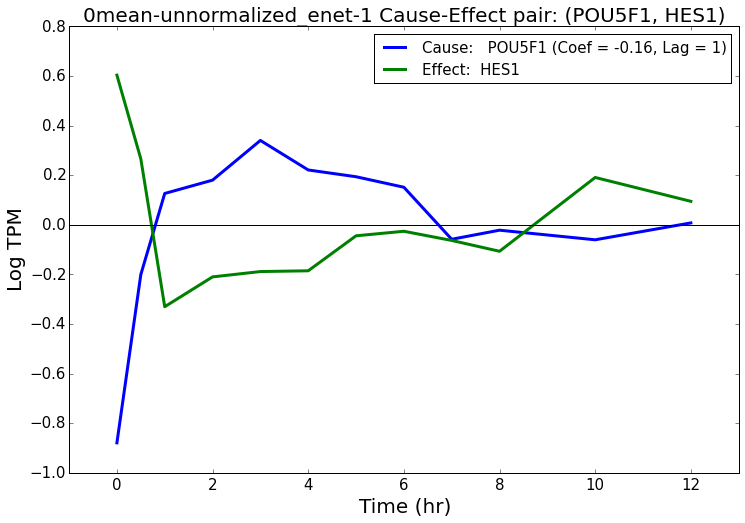

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-1/TF-Metabolism/0mean-unnormalized_enet-1_TFCP2L1-CCL2-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/TF-Metabolism/0mean-unnormalized_enet-1_TFCP2L1-CCL2-lag-1-coef--1E-01.pdf


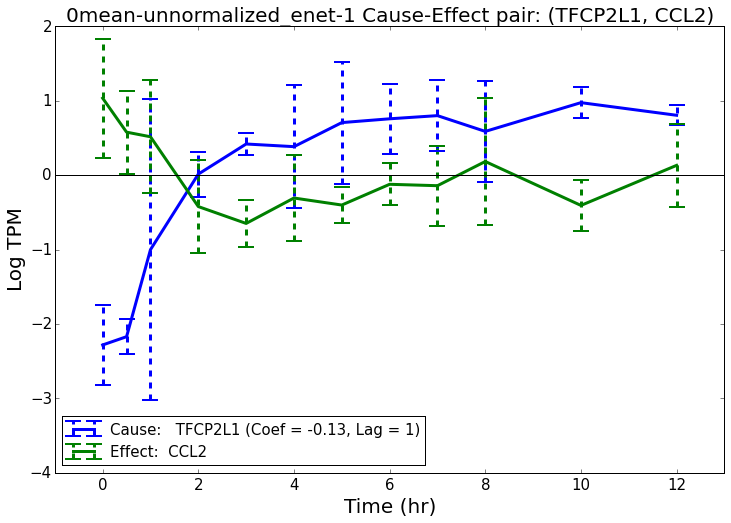

Filename:  analysis/plots/0mean-unnormalized_enet-1/TF-Metabolism/0mean-unnormalized_enet-1_no-bar-TFCP2L1-CCL2-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/TF-Metabolism/0mean-unnormalized_enet-1_no-bar-TFCP2L1-CCL2-lag-1-coef--1E-01.pdf


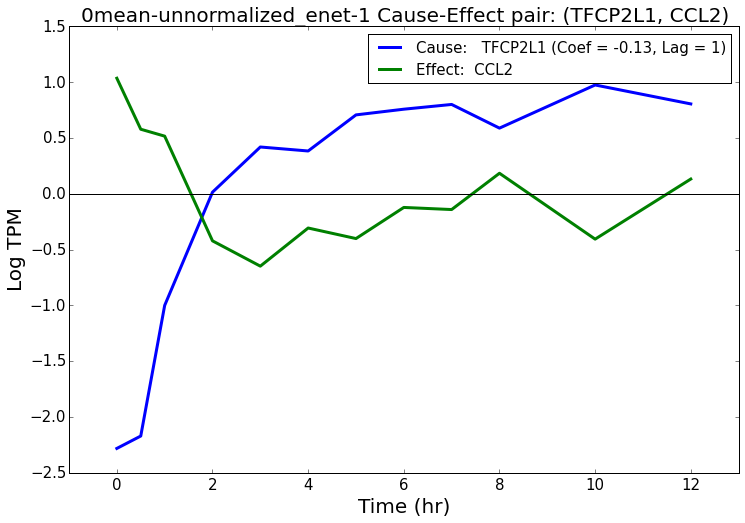

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-1/TF-Metabolism/0mean-unnormalized_enet-1_GLI4-SOCS1-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/TF-Metabolism/0mean-unnormalized_enet-1_GLI4-SOCS1-lag-1-coef-1E-01.pdf


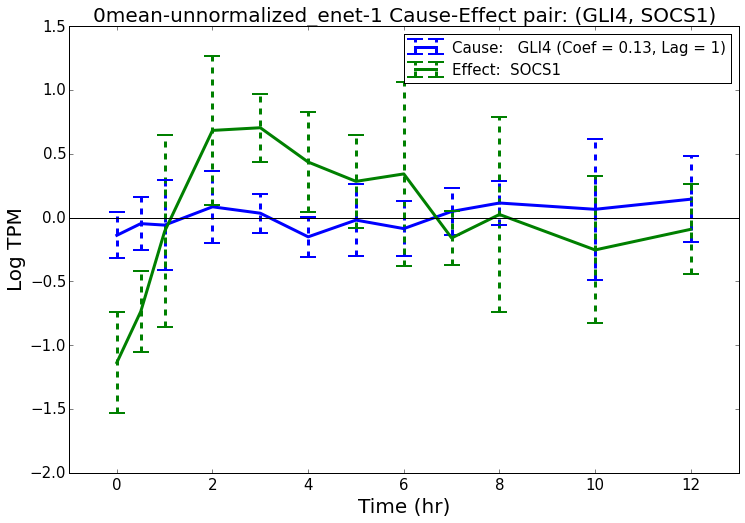

Filename:  analysis/plots/0mean-unnormalized_enet-1/TF-Metabolism/0mean-unnormalized_enet-1_no-bar-GLI4-SOCS1-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/TF-Metabolism/0mean-unnormalized_enet-1_no-bar-GLI4-SOCS1-lag-1-coef-1E-01.pdf


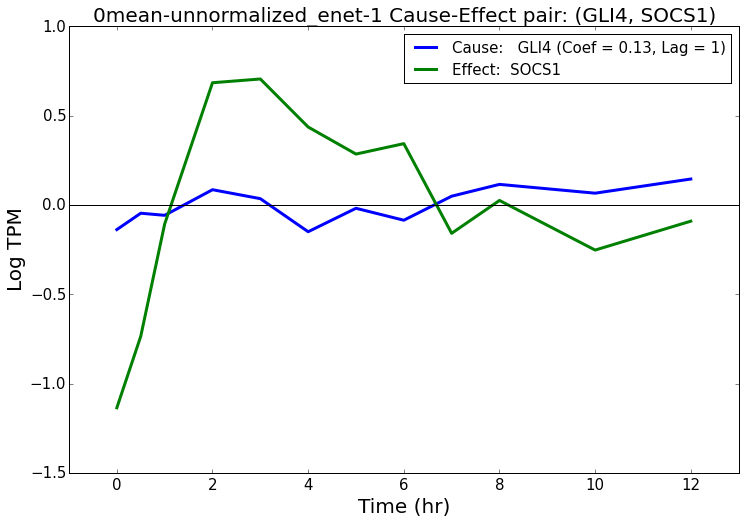

***********************************************
0mean-unnormalized_enet-2
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause                                                                  Summary: Effect
108              HOXB5               SOCS1 -0.154525   2.0     TF-Bioguo,  Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
145             ZNF114               ACSL1 -0.148218   2.0     TF-Bioguo,                         Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Obesity_GSEA,
184             ZNF114                MAOA -0.142679   2.0     TF-Bioguo,                                                            Metabolism-gluc_GSEA,
Written to  analysis/plots/0mean-unnormalized_enet-2/TF-Metabolism/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename

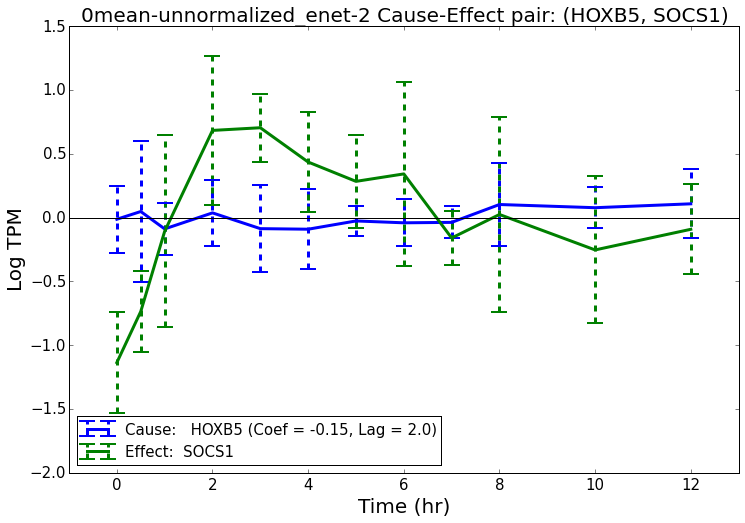

Filename:  analysis/plots/0mean-unnormalized_enet-2/TF-Metabolism/0mean-unnormalized_enet-2_no-bar-HOXB5-SOCS1-lag-2-coef--2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/TF-Metabolism/0mean-unnormalized_enet-2_no-bar-HOXB5-SOCS1-lag-2-coef--2E-01.pdf


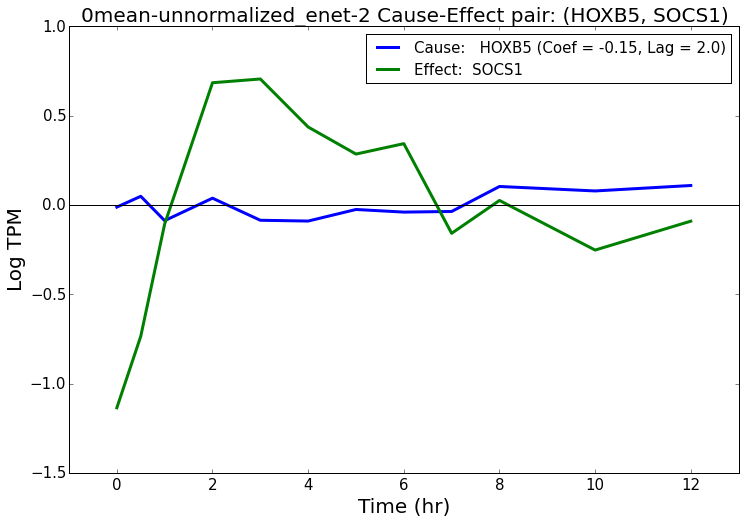

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-2/TF-Metabolism/0mean-unnormalized_enet-2_ZNF114-ACSL1-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/TF-Metabolism/0mean-unnormalized_enet-2_ZNF114-ACSL1-lag-2-coef--1E-01.pdf


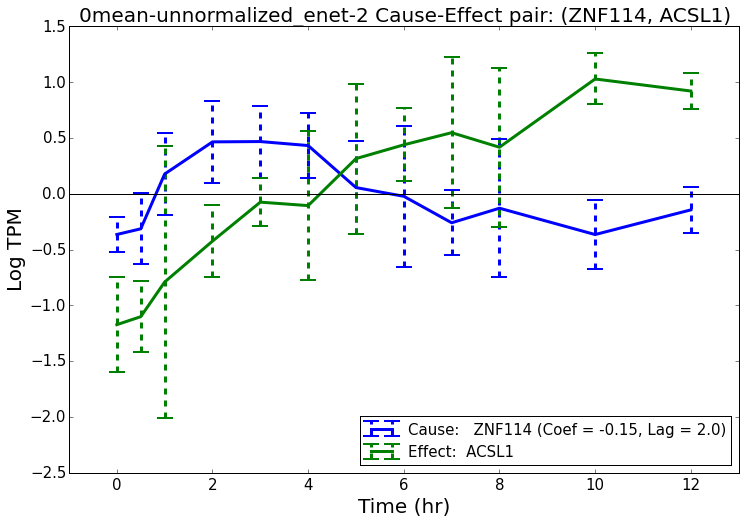

Filename:  analysis/plots/0mean-unnormalized_enet-2/TF-Metabolism/0mean-unnormalized_enet-2_no-bar-ZNF114-ACSL1-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/TF-Metabolism/0mean-unnormalized_enet-2_no-bar-ZNF114-ACSL1-lag-2-coef--1E-01.pdf


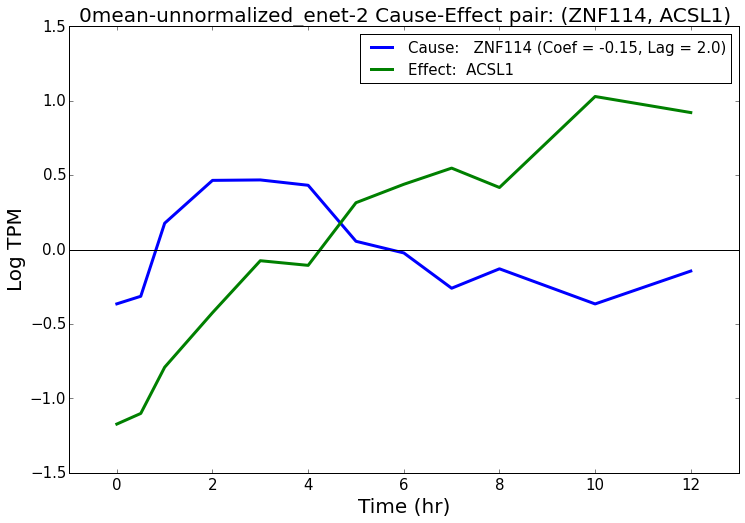

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-2/TF-Metabolism/0mean-unnormalized_enet-2_ZNF114-MAOA-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/TF-Metabolism/0mean-unnormalized_enet-2_ZNF114-MAOA-lag-2-coef--1E-01.pdf


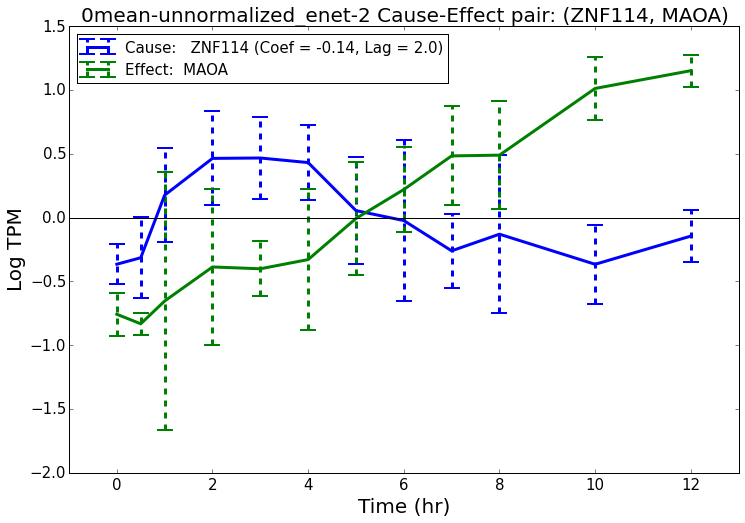

Filename:  analysis/plots/0mean-unnormalized_enet-2/TF-Metabolism/0mean-unnormalized_enet-2_no-bar-ZNF114-MAOA-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/TF-Metabolism/0mean-unnormalized_enet-2_no-bar-ZNF114-MAOA-lag-2-coef--1E-01.pdf


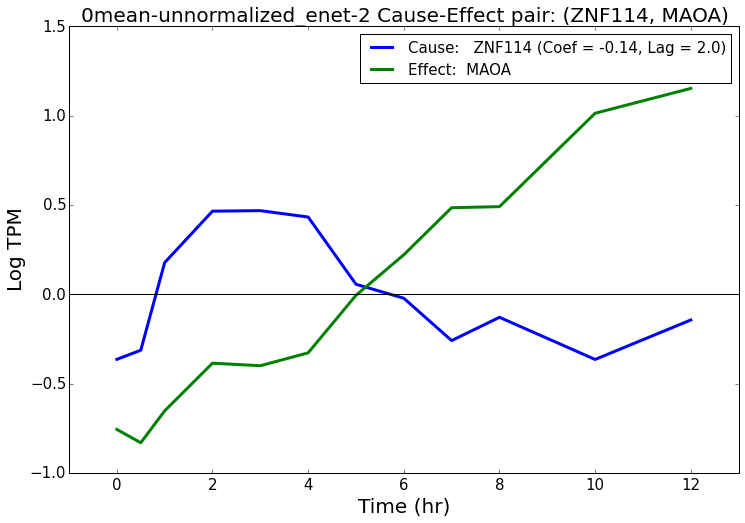

In [46]:
do_plot_nets(data_hg_df_list, plot_nets, names, timekeys_list, num_per_keys_list, timepoints_list, each_plot_folders=each_plot_folders, interest_index=None,
            ylabels=ylabels)

### Plot top TF-> Immune overall

In [47]:
# set which net to plot

plotfoldersuffix = "TF-Immune"
each_plot_folders = [os.path.join(name_plot_folder, plotfoldersuffix) for name, name_plot_folder in zip(names, name_plot_folders)]
top_edge_num = 3
plot_nets = [net[np.logical_and(net["Cause"].isin(tf_genes), net["Effect"].isin(imm_genes))].head(n=top_edge_num)  for net in nets]

for plot_net, i in zip(plot_nets, range(len(plot_nets))):
    plot_net["Gene Symbol: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_net["Cause"].values]
    plot_net["Gene Symbol: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_net["Effect"].values]
    plot_net["Summary: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Summary"].values[0] for x in plot_net["Cause"].values]
    plot_net["Summary: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Summary"].values[0] for x in plot_net["Effect"].values]


***********************************************
0mean-1var_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                       Summary: Cause                                                           Summary: Effect
5                 ZNF76                CD14  0.182236     1                           TF-Bioguo,         Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
586               PRDM1                BCL6  0.120002     1                 GR_direct,TF-Bioguo,  GR_direct,TF-Bioguo,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
1283             POU5F1                BCL6  0.107241     1  GR_direct,TF-Bioguo,DNA-binding_GO,  GR_direct,TF-Bioguo,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/0mean-1var_enet-1/TF-Immune/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[

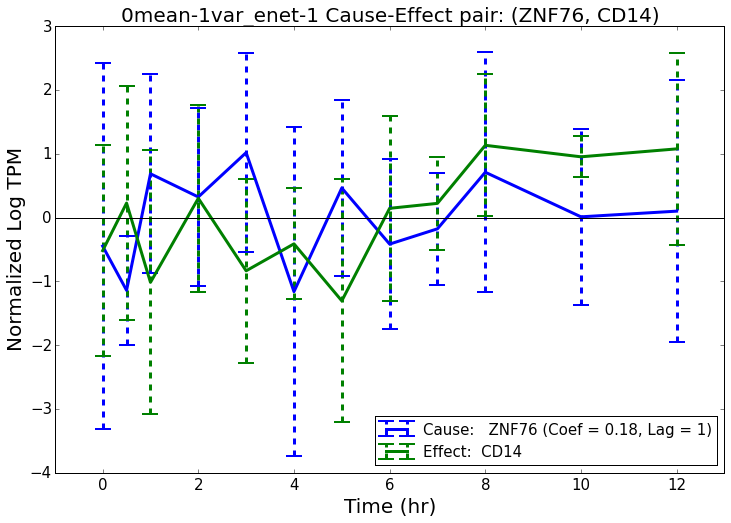

Filename:  analysis/plots/0mean-1var_enet-1/TF-Immune/0mean-1var_enet-1_no-bar-ZNF76-CD14-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/TF-Immune/0mean-1var_enet-1_no-bar-ZNF76-CD14-lag-1-coef-2E-01.pdf


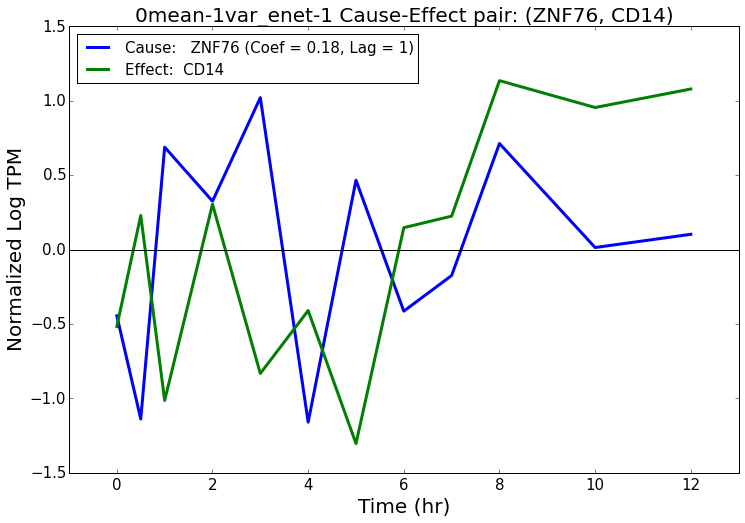

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-1/TF-Immune/0mean-1var_enet-1_PRDM1-BCL6-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/TF-Immune/0mean-1var_enet-1_PRDM1-BCL6-lag-1-coef-1E-01.pdf


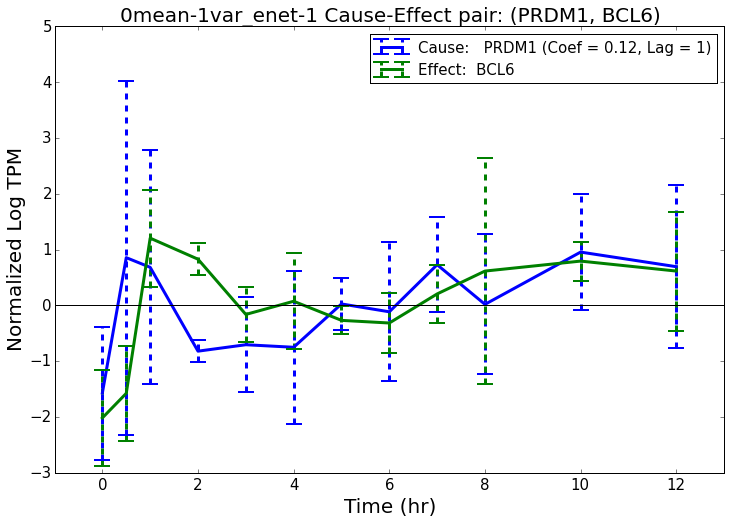

Filename:  analysis/plots/0mean-1var_enet-1/TF-Immune/0mean-1var_enet-1_no-bar-PRDM1-BCL6-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/TF-Immune/0mean-1var_enet-1_no-bar-PRDM1-BCL6-lag-1-coef-1E-01.pdf


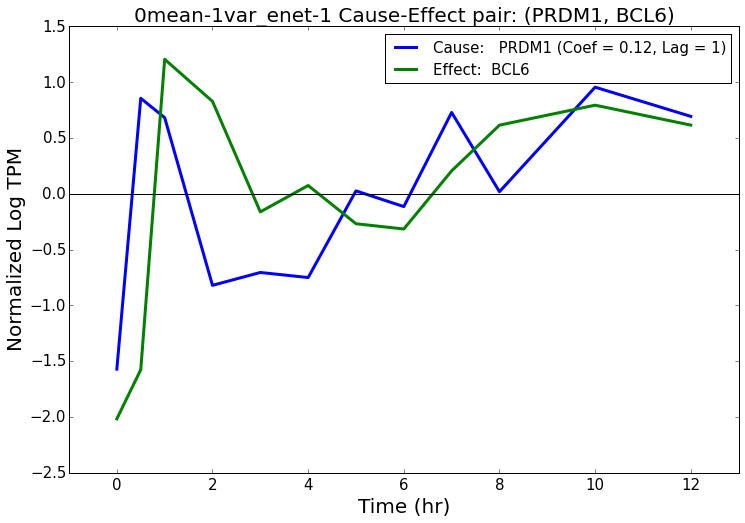

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-1/TF-Immune/0mean-1var_enet-1_POU5F1-BCL6-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/TF-Immune/0mean-1var_enet-1_POU5F1-BCL6-lag-1-coef-1E-01.pdf


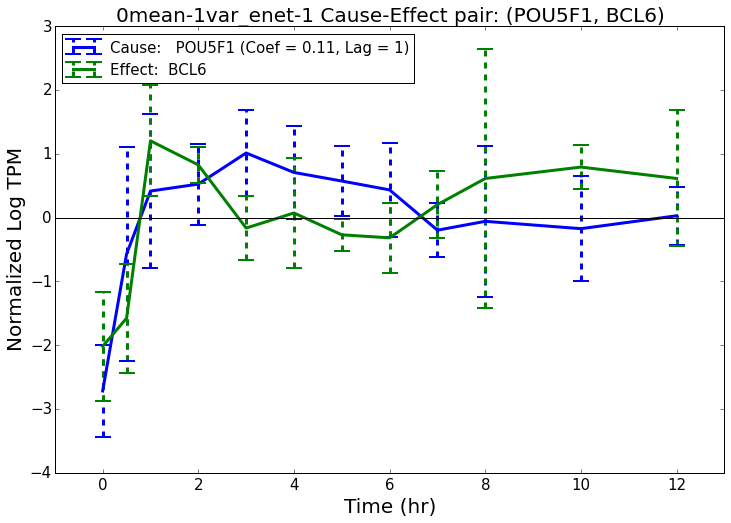

Filename:  analysis/plots/0mean-1var_enet-1/TF-Immune/0mean-1var_enet-1_no-bar-POU5F1-BCL6-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/0mean-1var_enet-1/TF-Immune/0mean-1var_enet-1_no-bar-POU5F1-BCL6-lag-1-coef-1E-01.pdf


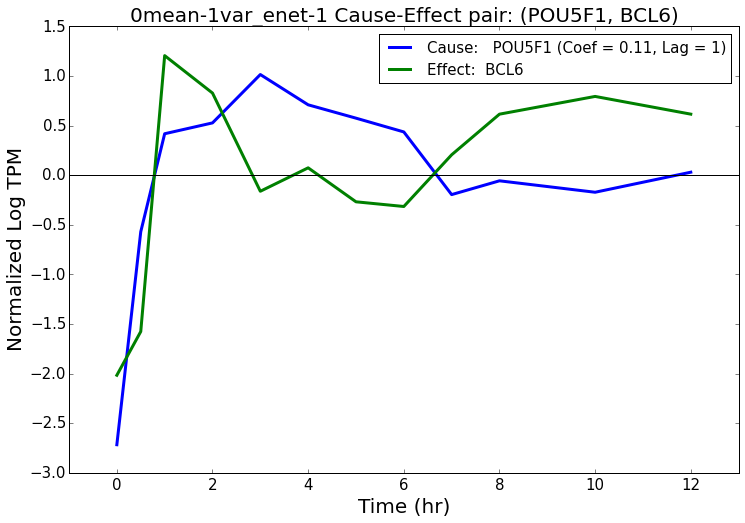

***********************************************
0mean-1var_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                                               Summary: Cause                                                    Summary: Effect
700                 TEF               CXCL2  0.090026   1.0                                                                                   TF-Bioguo,  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
818                ZNF3               ITGA4  0.088052   1.0                                                                                   TF-Bioguo,  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
1893               XBP1               PTPN6  0.076959   2.0  Diabetes_GSEA,TF-Bioguo,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,DNA-binding_GO,  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Writte

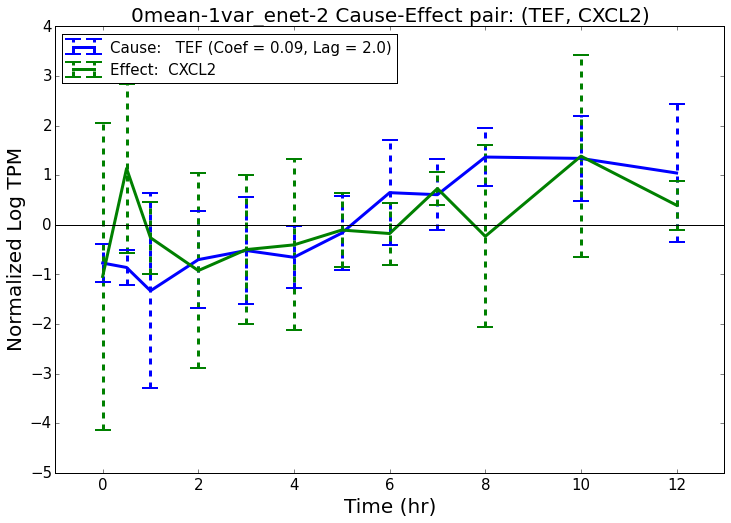

Filename:  analysis/plots/0mean-1var_enet-2/TF-Immune/0mean-1var_enet-2_no-bar-TEF-CXCL2-lag-2-coef-9E-02.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/TF-Immune/0mean-1var_enet-2_no-bar-TEF-CXCL2-lag-2-coef-9E-02.pdf


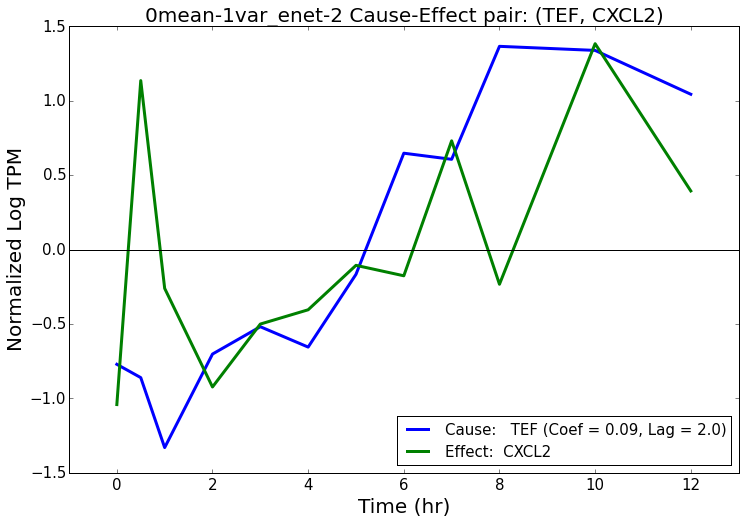

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-2/TF-Immune/0mean-1var_enet-2_ZNF3-ITGA4-lag-2-coef-9E-02.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/TF-Immune/0mean-1var_enet-2_ZNF3-ITGA4-lag-2-coef-9E-02.pdf


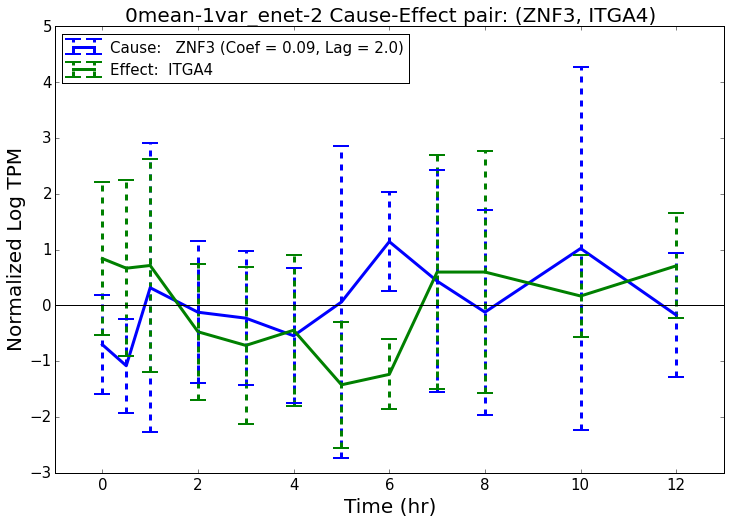

Filename:  analysis/plots/0mean-1var_enet-2/TF-Immune/0mean-1var_enet-2_no-bar-ZNF3-ITGA4-lag-2-coef-9E-02.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/TF-Immune/0mean-1var_enet-2_no-bar-ZNF3-ITGA4-lag-2-coef-9E-02.pdf


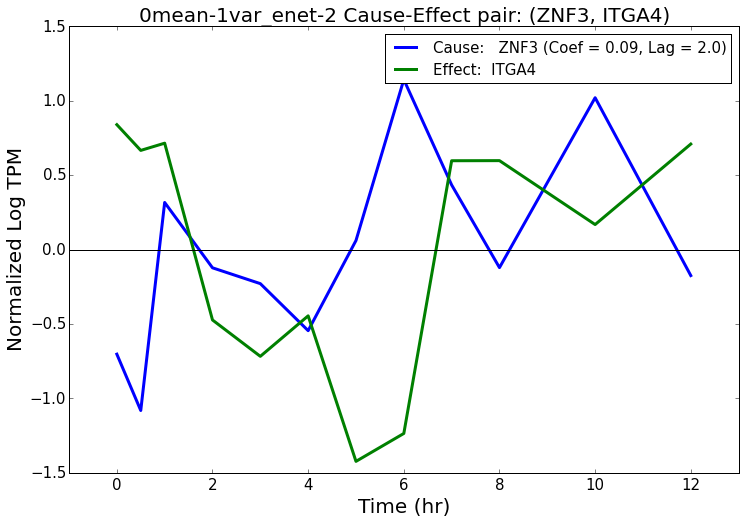

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-1var_enet-2/TF-Immune/0mean-1var_enet-2_XBP1-PTPN6-lag-2-coef-8E-02.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/TF-Immune/0mean-1var_enet-2_XBP1-PTPN6-lag-2-coef-8E-02.pdf


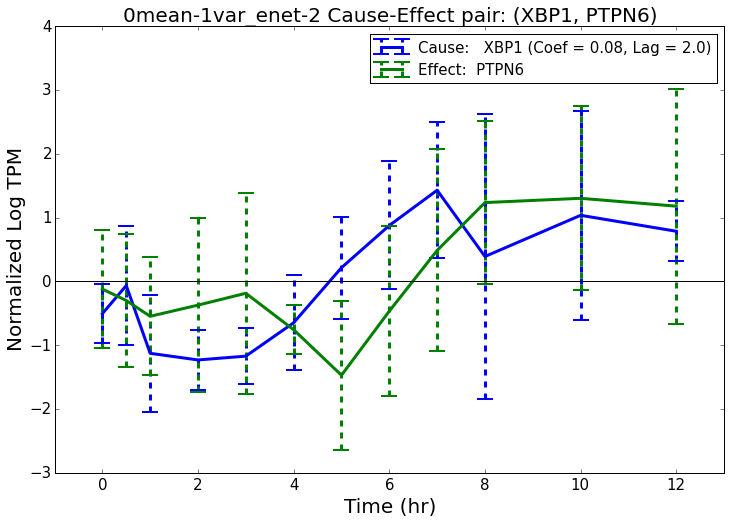

Filename:  analysis/plots/0mean-1var_enet-2/TF-Immune/0mean-1var_enet-2_no-bar-XBP1-PTPN6-lag-2-coef-8E-02.pdf
Plot saved to  analysis/plots/0mean-1var_enet-2/TF-Immune/0mean-1var_enet-2_no-bar-XBP1-PTPN6-lag-2-coef-8E-02.pdf


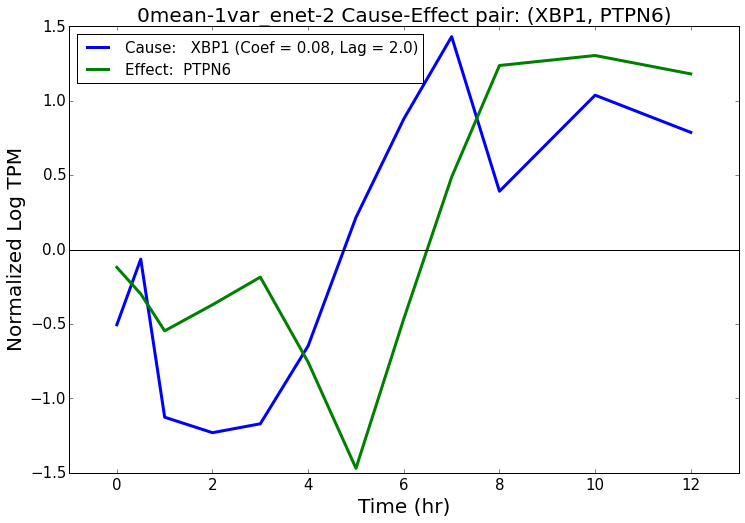

***********************************************
0mean-unnormalized_enet-1
***********************************************
   Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                       Summary: Cause                                                                                      Summary: Effect
2              POU5F1               CXCL1 -0.318522     1  GR_direct,TF-Bioguo,DNA-binding_GO,                                    Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
48             POU5F1                BCL6  0.220967     1  GR_direct,TF-Bioguo,DNA-binding_GO,                             GR_direct,TF-Bioguo,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
98             POU5F1                 JUN -0.205934     1  GR_direct,TF-Bioguo,DNA-binding_GO,  GR_GSEA,TF-Bioguo,TF-binding_GO,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,DNA-binding_GO,
Written to  analysis/plots/0mean-unnormalized_enet-1/TF-Immune/top_interactions.csv
['t00_rep'

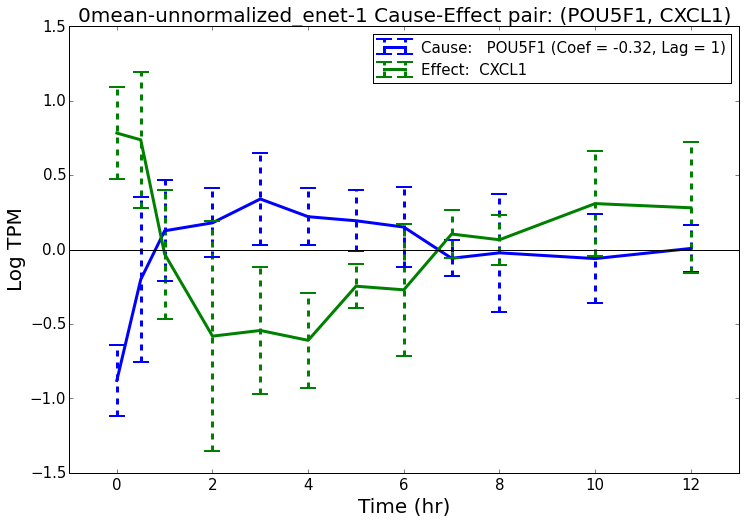

Filename:  analysis/plots/0mean-unnormalized_enet-1/TF-Immune/0mean-unnormalized_enet-1_no-bar-POU5F1-CXCL1-lag-1-coef--3E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/TF-Immune/0mean-unnormalized_enet-1_no-bar-POU5F1-CXCL1-lag-1-coef--3E-01.pdf


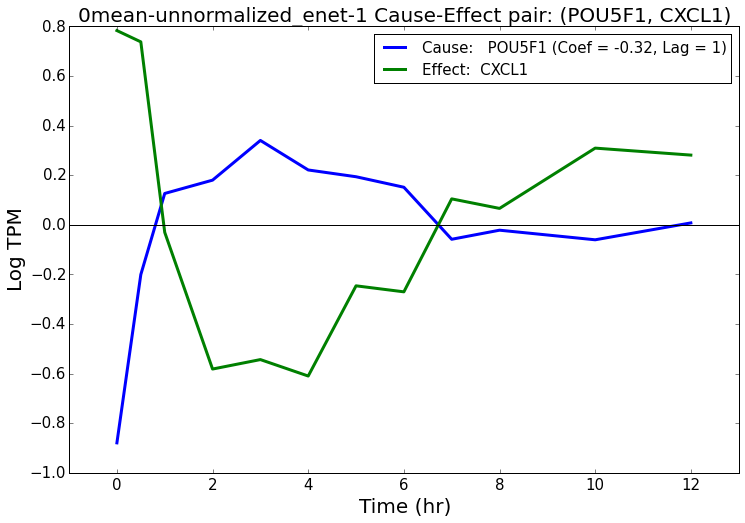

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-1/TF-Immune/0mean-unnormalized_enet-1_POU5F1-BCL6-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/TF-Immune/0mean-unnormalized_enet-1_POU5F1-BCL6-lag-1-coef-2E-01.pdf


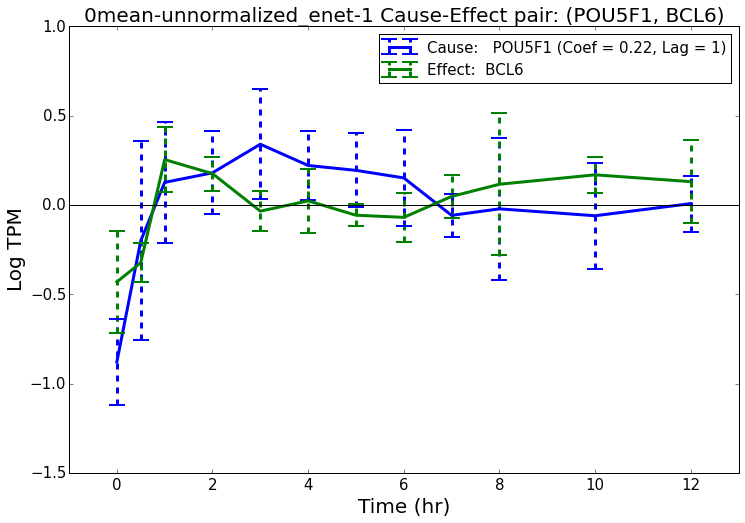

Filename:  analysis/plots/0mean-unnormalized_enet-1/TF-Immune/0mean-unnormalized_enet-1_no-bar-POU5F1-BCL6-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/TF-Immune/0mean-unnormalized_enet-1_no-bar-POU5F1-BCL6-lag-1-coef-2E-01.pdf


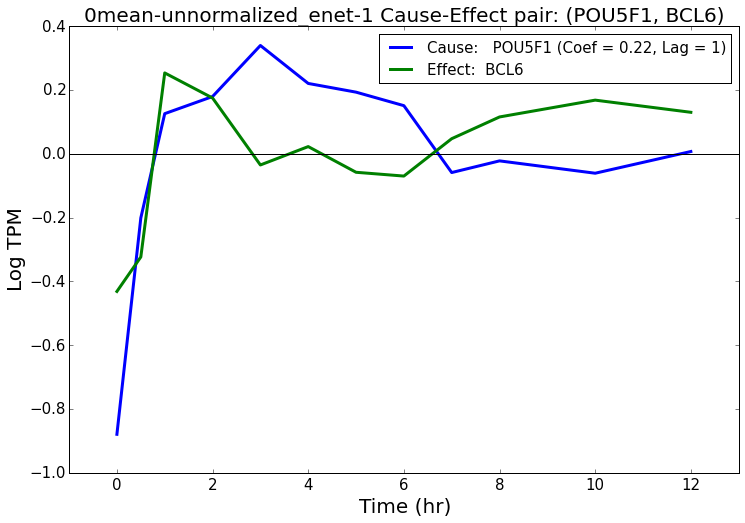

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-1/TF-Immune/0mean-unnormalized_enet-1_POU5F1-JUN-lag-1-coef--2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/TF-Immune/0mean-unnormalized_enet-1_POU5F1-JUN-lag-1-coef--2E-01.pdf


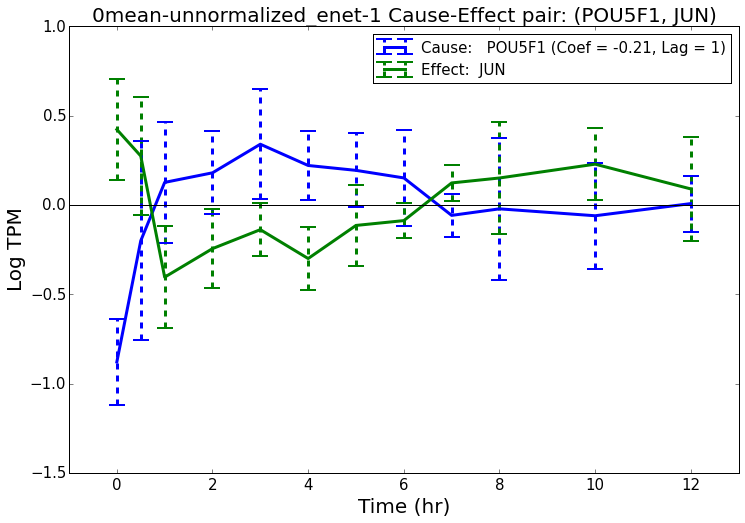

Filename:  analysis/plots/0mean-unnormalized_enet-1/TF-Immune/0mean-unnormalized_enet-1_no-bar-POU5F1-JUN-lag-1-coef--2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-1/TF-Immune/0mean-unnormalized_enet-1_no-bar-POU5F1-JUN-lag-1-coef--2E-01.pdf


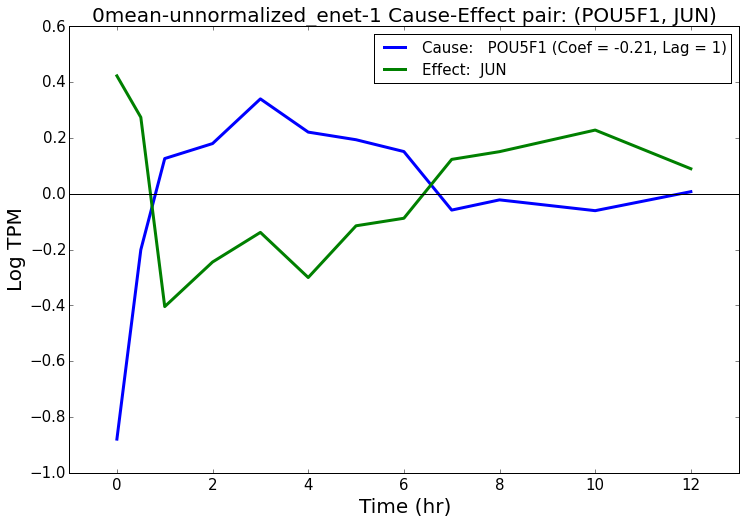

***********************************************
0mean-unnormalized_enet-2
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause                                                                  Summary: Effect
108              HOXB5               SOCS1 -0.154525   2.0     TF-Bioguo,  Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
122             ZNF114                  C3 -0.152055   2.0     TF-Bioguo,                Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
129             ZNF114             TNFAIP6  0.150407   2.0     TF-Bioguo,                Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/0mean-unnormalized_enet-2/TF-Immune/top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  a

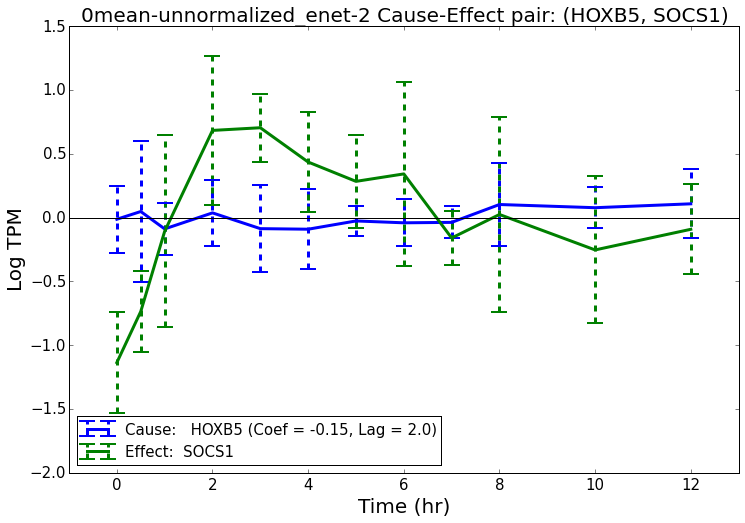

Filename:  analysis/plots/0mean-unnormalized_enet-2/TF-Immune/0mean-unnormalized_enet-2_no-bar-HOXB5-SOCS1-lag-2-coef--2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/TF-Immune/0mean-unnormalized_enet-2_no-bar-HOXB5-SOCS1-lag-2-coef--2E-01.pdf


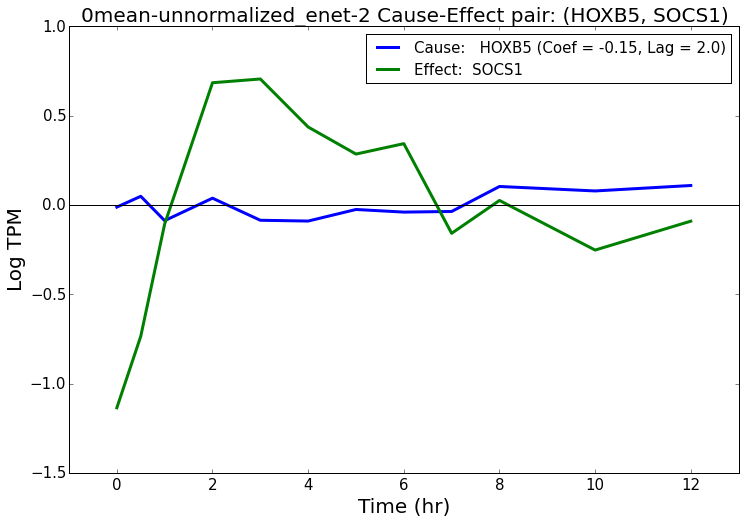

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-2/TF-Immune/0mean-unnormalized_enet-2_ZNF114-C3-lag-2-coef--2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/TF-Immune/0mean-unnormalized_enet-2_ZNF114-C3-lag-2-coef--2E-01.pdf


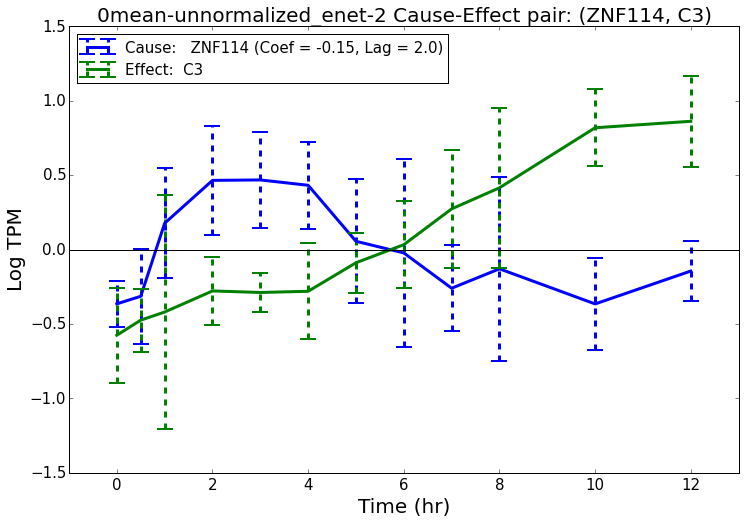

Filename:  analysis/plots/0mean-unnormalized_enet-2/TF-Immune/0mean-unnormalized_enet-2_no-bar-ZNF114-C3-lag-2-coef--2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/TF-Immune/0mean-unnormalized_enet-2_no-bar-ZNF114-C3-lag-2-coef--2E-01.pdf


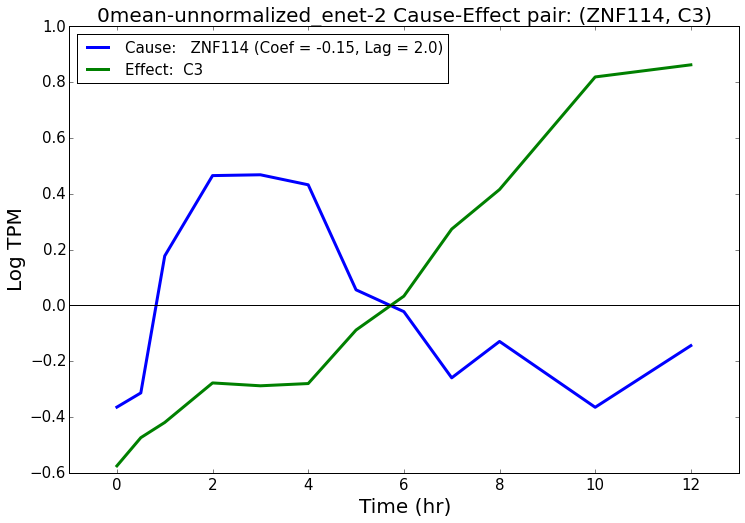

['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/0mean-unnormalized_enet-2/TF-Immune/0mean-unnormalized_enet-2_ZNF114-TNFAIP6-lag-2-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/TF-Immune/0mean-unnormalized_enet-2_ZNF114-TNFAIP6-lag-2-coef-2E-01.pdf


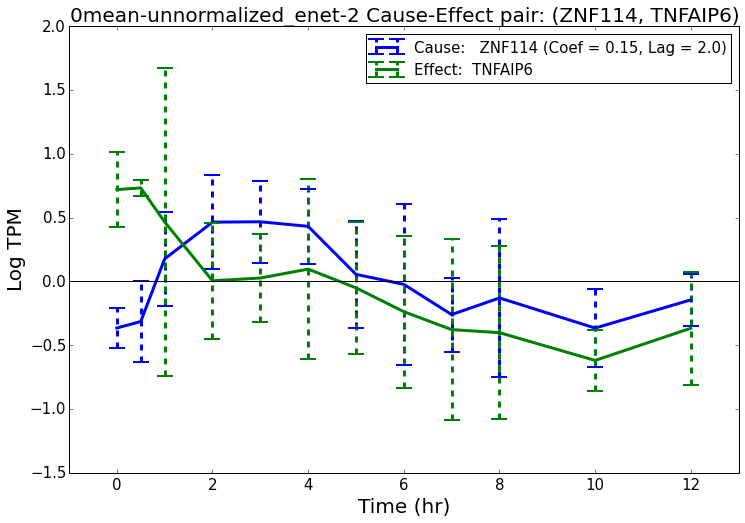

Filename:  analysis/plots/0mean-unnormalized_enet-2/TF-Immune/0mean-unnormalized_enet-2_no-bar-ZNF114-TNFAIP6-lag-2-coef-2E-01.pdf
Plot saved to  analysis/plots/0mean-unnormalized_enet-2/TF-Immune/0mean-unnormalized_enet-2_no-bar-ZNF114-TNFAIP6-lag-2-coef-2E-01.pdf


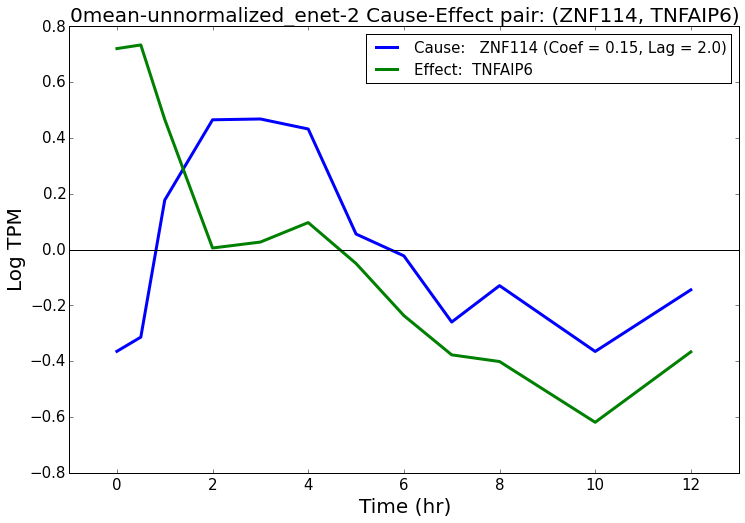

In [48]:
do_plot_nets(data_hg_df_list, plot_nets, names, timekeys_list, num_per_keys_list, timepoints_list, each_plot_folders=each_plot_folders, interest_index=None,
            ylabels=ylabels)

In [49]:
os.system("say 'plots done'")

0

# Get a histogram of paths from immune gene to metabolic, vice-versa

In [50]:
total_path_folder = os.path.join(base_out_dir, "paths")
if not os.path.exists(total_path_folder):
    os.makedirs(total_path_folder)
    
print "Path folder: ", total_path_folder

Path folder:  analysis/paths


In [51]:
# build the graph

Gs = []

for i in range(len(nets)):
    net = nets[i]
    name = names[i]
    
    print "******************************************"
    print name
    print "******************************************"  
    
    
    G = nx.DiGraph()
    
    nh.graph_add_df_one_way(G, net, "Cause", "Effect", [])
    
    print "Original net: ", len(net)
    print "Graph: ", len(G.edges())
    
    for node in G.nodes():
        G.add_node(node, Immune=(node in imm_genes))
        G.add_node(node, Metabolism=(node in metab_genes))
    
    Gs.append(G)

******************************************
0mean-1var_enet-1
******************************************
Original net:  10546
Graph:  10546
******************************************
0mean-1var_enet-2
******************************************
Original net:  13879
Graph:  13879
******************************************
0mean-unnormalized_enet-1
******************************************
Original net:  23025
Graph:  23025
******************************************
0mean-unnormalized_enet-2
******************************************
Original net:  27781
Graph:  27781


In [52]:
net_imm_to_metab_length_dict_list = []
net_metab_to_imm_length_dict_list = []
net_imm_to_metab_shortest_paths_all_list = []
net_metab_to_imm_shortest_paths_all_list = []
net_imm_genes_list = []
net_metab_genes_list = []

imm_lengths_list = []
metab_lengths_list = []

for i, G in enumerate(Gs):
    name = names[i]
    
    print "************"
    print name
    print "************"
    
    imm_dict = nx.get_node_attributes(G, "Immune")
    net_imm_genes = [x for x in G.nodes() if imm_dict[x]]
    print "immune: ", len(net_imm_genes)
    net_imm_genes_list.append(net_imm_genes)
   
    metab_dict = nx.get_node_attributes(G, "Metabolism")
    net_metab_genes = [x for x in G.nodes() if metab_dict[x]]
    print "metabolic: ", len(net_metab_genes)
    net_metab_genes_list.append(net_metab_genes)

    net_imm_to_metab_length_dict = collections.OrderedDict()
    net_imm_to_metab_shortest_paths_all = []
    

    for imm_gene in net_imm_genes:
        imm_shortest_path_dict = nx.shortest_path(G, source=imm_gene)
        
        if len(set(net_metab_genes).intersection(imm_shortest_path_dict.keys())) > 0:
            min_length = min([len(imm_shortest_path_dict[x]) for x in set(net_metab_genes).intersection(imm_shortest_path_dict.keys())]) 
            closest_metabs = [x for x in set(net_metab_genes).intersection(imm_shortest_path_dict.keys()) if len(imm_shortest_path_dict[x]) == min_length ]
            
            net_imm_to_metab_length_dict[imm_gene] = min_length
            net_imm_to_metab_shortest_paths_all.extend([tuple(imm_shortest_path_dict[x]) for x in closest_metabs])
            
        else:
            net_imm_to_metab_length_dict[imm_gene] = None
    
    net_imm_to_metab_length_dict_list.append(net_imm_to_metab_length_dict)
    net_imm_to_metab_shortest_paths_all_list.append(net_imm_to_metab_shortest_paths_all)
    
    imm_lengths = net_imm_to_metab_length_dict.values()
    
    
    # LEFT OFF HERE
    print "Immune-to-Metab path are Nones: ", imm_lengths.count(None)
    imm_lengths = [x for x in imm_lengths if x != None]
    
    imm_lengths_list.append(imm_lengths)
    
    
    net_metab_to_imm_length_dict = collections.OrderedDict()
    net_metab_to_imm_shortest_paths_all = []
    

    for metab_gene in net_metab_genes:
        metab_shortest_path_dict = nx.shortest_path(G, source=metab_gene)
        
        if len(set(net_imm_genes).intersection(metab_shortest_path_dict.keys())) > 0:
            min_length = min([len(metab_shortest_path_dict[x]) for x in set(net_imm_genes).intersection(metab_shortest_path_dict.keys())]) 
            closest_imms = [x for x in set(net_imm_genes).intersection(metab_shortest_path_dict.keys()) if len(metab_shortest_path_dict[x]) == min_length ]
            
            net_metab_to_imm_length_dict[metab_gene] = min_length
            net_metab_to_imm_shortest_paths_all.extend([tuple(metab_shortest_path_dict[x]) for x in closest_imms])
            
        else:
            net_metab_to_imm_length_dict[metab_gene] = None
    
    net_metab_to_imm_length_dict_list.append(net_metab_to_imm_length_dict)
    net_metab_to_imm_shortest_paths_all_list.append(net_metab_to_imm_shortest_paths_all)
    
    metab_lengths = net_metab_to_imm_length_dict.values()
    
    
    # LEFT OFF HERE
    print "Metab-to-Immune path are Nones: ", metab_lengths.count(None)
    metab_lengths = [x for x in metab_lengths if x != None]
    
    metab_lengths_list.append(metab_lengths)
    
    
    

************
0mean-1var_enet-1
************
immune:  94
metabolic:  97
Immune-to-Metab path are Nones:  63
Metab-to-Immune path are Nones:  65
************
0mean-1var_enet-2
************
immune:  107
metabolic:  113
Immune-to-Metab path are Nones:  76
Metab-to-Immune path are Nones:  73
************
0mean-unnormalized_enet-1
************
immune:  108
metabolic:  117
Immune-to-Metab path are Nones:  61
Metab-to-Immune path are Nones:  90
************
0mean-unnormalized_enet-2
************
immune:  109
metabolic:  120
Immune-to-Metab path are Nones:  72
Metab-to-Immune path are Nones:  96


In [53]:
# Find the ones that are triples of immune, X, metabolic genes, i.e. length 3
# rank by number of nets each is in.
# index by the tuple?
# plot the genes: title is the path

# Imm
# Metab
# (imm - X - metab)
# Total
# one for each net



total_paths = set()
for x in net_imm_to_metab_shortest_paths_all_list:
    for y in x:
        total_paths.add(y)

total_imm_metab_path_df = pd.DataFrame({"Path": list(["-".join(x) for x in total_paths])})
total_imm_metab_path_df["Immune"] = [x.split("-")[0] for x in total_imm_metab_path_df["Path"]]
total_imm_metab_path_df["Metab"] = [x.split('-')[-1] for x in total_imm_metab_path_df["Path"]]
total_imm_metab_path_df["Path: Gene Symbol"] = ["-".join([nh.ensg2hg(y) for y in x.split('-')]) for x in total_imm_metab_path_df["Path"].values]
total_imm_metab_path_df["Immune: Gene Symbol"] = [x.split("-")[0] for x in total_imm_metab_path_df["Path: Gene Symbol"].values]
total_imm_metab_path_df["Metab: Gene Symbol"] =[x.split("-")[-1] for x in total_imm_metab_path_df["Path: Gene Symbol"].values]
total_imm_metab_path_df["Length"] = [len(x.split("-")) for x in total_imm_metab_path_df["Path"]]

total_imm_metab_path_df["Total"] = 0

for i, name in enumerate(names):
    net_imm_to_metab_shortest_paths_all = net_imm_to_metab_shortest_paths_all_list[i]
    
    total_imm_metab_path_df[name] = [1 if tuple(x.split('-')) in net_imm_to_metab_shortest_paths_all else 0 for x in total_imm_metab_path_df["Path"]]

    total_imm_metab_path_df["Total"] += total_imm_metab_path_df[name]

total_imm_metab_path_df.sort_values("Total", inplace=True, ascending=False)

display(total_imm_metab_path_df.head())



,Path,Immune,Metab,Path: Gene Symbol,Immune: Gene Symbol,Metab: Gene Symbol,Length,Total,0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2
147,ENSG00000184557.4,ENSG00000184557.4,ENSG00000184557.4,SOCS3,SOCS3,SOCS3,1,4,1,1,1,1
523,ENSG00000104365.12,ENSG00000104365.12,ENSG00000104365.12,IKBKB,IKBKB,IKBKB,1,4,1,1,1,1
159,ENSG00000116678.17,ENSG00000116678.17,ENSG00000116678.17,LEPR,LEPR,LEPR,1,4,1,1,1,1
389,ENSG00000108691.8,ENSG00000108691.8,ENSG00000108691.8,CCL2,CCL2,CCL2,1,4,1,1,1,1
128,ENSG00000173391.7,ENSG00000173391.7,ENSG00000173391.7,OLR1,OLR1,OLR1,1,4,1,1,1,1


In [54]:
total_imm_metab_out_file = os.path.join(total_path_folder, run_type + "_imm-metab-paths.csv")
total_imm_metab_path_df.to_csv(total_imm_metab_out_file, index=False)

print "Total: ", total_imm_metab_path_df.shape[0], " written to ", total_imm_metab_out_file

for length in range(min(total_imm_metab_path_df["Length"].values), max(total_imm_metab_path_df["Length"].values) + 1):
    sub_imm_metab_path_df = total_imm_metab_path_df[total_imm_metab_path_df["Length"] == length]
    
    name_cols = []
    annot_cols = []
    for i in range(length):
        name_col = "Gene Symbol:" + str(i + 1)
        annot_col = "Summary:" + str(i + 1)
        sub_imm_metab_path_df[name_col] = [nh.ensg2hg(x.split("-")[i]) for x in sub_imm_metab_path_df["Path"].values]
        sub_imm_metab_path_df[annot_col] = [gene_table[gene_table["Ensembl ID"] == x.split("-")[i]]["Summary"].values[0] for x in sub_imm_metab_path_df["Path"].values]
    
        name_cols.append(name_col)
        annot_cols.append(annot_col)
    
    
    
    sub_imm_metab_out_file = total_imm_metab_out_file[:-4] + "-" + str(length) + ".csv"
    
    sub_imm_metab_path_df.to_csv(sub_imm_metab_out_file, index=False)
    
    
    print "Length ", length, ": ", sub_imm_metab_path_df.shape[0], " written to ", sub_imm_metab_out_file



Total:  543  written to  analysis/paths/priority_imm-metab-paths.csv


/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


Length  1 :  12  written to  analysis/paths/priority_imm-metab-paths-1.csv
Length  2 :  141  written to  analysis/paths/priority_imm-metab-paths-2.csv
Length  3 :  231  written to  analysis/paths/priority_imm-metab-paths-3.csv
Length  4 :  110  written to  analysis/paths/priority_imm-metab-paths-4.csv
Length  5 :  49  written to  analysis/paths/priority_imm-metab-paths-5.csv


In [55]:
# Find the ones that are triples of Metabolism, X, metabolic genes, i.e. length 3
# rank by number of nets each is in.
# index by the tuple?
# plot the genes: title is the path

# Imm
# Immune
# (imm - X - metab)
# Total
# one for each net



total_paths = set()
for x in net_metab_to_imm_shortest_paths_all_list:
    for y in x:
        total_paths.add(y)

total_metab_imm_path_df = pd.DataFrame({"Path": list(["-".join(x) for x in total_paths])})
total_metab_imm_path_df["Metabolism"] = [x.split("-")[0] for x in total_metab_imm_path_df["Path"]]
total_metab_imm_path_df["Immune"] = [x.split('-')[-1] for x in total_metab_imm_path_df["Path"]]
total_metab_imm_path_df["Path: Gene Symbol"] = ["-".join([nh.ensg2hg(y) for y in x.split('-')]) for x in total_metab_imm_path_df["Path"].values]
total_metab_imm_path_df["Metabolism: Gene Symbol"] = [x.split("-")[0] for x in total_metab_imm_path_df["Path: Gene Symbol"].values]
total_metab_imm_path_df["Immune: Gene Symbol"] =[x.split("-")[-1] for x in total_metab_imm_path_df["Path: Gene Symbol"].values]
total_metab_imm_path_df["Length"] = [len(x.split("-")) for x in total_metab_imm_path_df["Path"]]

total_metab_imm_path_df["Total"] = 0

for i, name in enumerate(names):
    net_metab_to_imm_shortest_paths_all = net_metab_to_imm_shortest_paths_all_list[i]
    
    total_metab_imm_path_df[name] = [1 if tuple(x.split('-')) in net_metab_to_imm_shortest_paths_all else 0 for x in total_metab_imm_path_df["Path"]]

    total_metab_imm_path_df["Total"] += total_metab_imm_path_df[name]

total_metab_imm_path_df.sort_values("Total", inplace=True, ascending=False)

display(total_metab_imm_path_df.head())



,Path,Metabolism,Immune,Path: Gene Symbol,Metabolism: Gene Symbol,Immune: Gene Symbol,Length,Total,0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2
134,ENSG00000116678.17,ENSG00000116678.17,ENSG00000116678.17,LEPR,LEPR,LEPR,1,4,1,1,1,1
330,ENSG00000127191.16,ENSG00000127191.16,ENSG00000127191.16,TRAF2,TRAF2,TRAF2,1,4,1,1,1,1
386,ENSG00000100219.15,ENSG00000100219.15,ENSG00000100219.15,XBP1,XBP1,XBP1,1,4,1,1,1,1
182,ENSG00000163932.12,ENSG00000163932.12,ENSG00000163932.12,PRKCD,PRKCD,PRKCD,1,4,1,1,1,1
370,ENSG00000185338.4,ENSG00000185338.4,ENSG00000185338.4,SOCS1,SOCS1,SOCS1,1,4,1,1,1,1


In [56]:
total_metab_imm_out_file = os.path.join(total_path_folder, run_type + "_metab-imm-paths.csv")
total_metab_imm_path_df.to_csv(total_metab_imm_out_file, index=False)

print "Total: ", total_metab_imm_path_df.shape[0], " written to ", total_metab_imm_out_file

for length in range(min(total_metab_imm_path_df["Length"].values), max(total_metab_imm_path_df["Length"].values) + 1):
    sub_metab_imm_path_df = total_metab_imm_path_df[total_metab_imm_path_df["Length"] == length]
    
    # add the annontations for each point on the path
    #annot_cols = ["Summary:" + str(i + 1) for i in range(length)]
    name_cols = []
    annot_cols = []
    for i in range(length):
        name_col = "Gene Symbol:" + str(i + 1)
        annot_col = "Summary:" + str(i + 1)
        sub_metab_imm_path_df[name_col] = [nh.ensg2hg(x.split("-")[i]) for x in sub_metab_imm_path_df["Path"].values]
        sub_metab_imm_path_df[annot_col] = [gene_table[gene_table["Ensembl ID"] == x.split("-")[i]]["Summary"].values[0] for x in sub_metab_imm_path_df["Path"].values]
    
        name_cols.append(name_col)
        annot_cols.append(annot_col)
    
    
    sub_metab_imm_out_file = total_metab_imm_out_file[:-4] + "-" + str(length) + ".csv"
    
    sub_metab_imm_path_df.to_csv(sub_metab_imm_out_file, index=False)
    
    
    print "Length ", length, ": ", sub_metab_imm_path_df.shape[0], " written to ", sub_metab_imm_out_file



Total:  419  written to  analysis/paths/priority_metab-imm-paths.csv
Length  1 :  12  written to  analysis/paths/priority_metab-imm-paths-1.csv


/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


Length  2 :  116  written to  analysis/paths/priority_metab-imm-paths-2.csv
Length  3 :  164  written to  analysis/paths/priority_metab-imm-paths-3.csv
Length  4 :  92  written to  analysis/paths/priority_metab-imm-paths-4.csv
Length  5 :  25  written to  analysis/paths/priority_metab-imm-paths-5.csv
Length  6 :  10  written to  analysis/paths/priority_metab-imm-paths-6.csv


# Visualize the immune to metabolic lengths

************
0mean-1var_enet-1
************


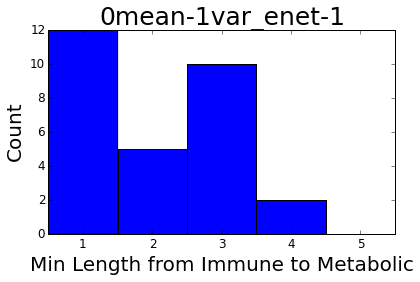

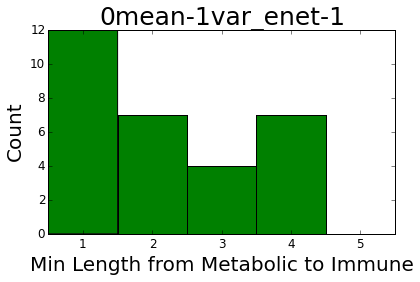

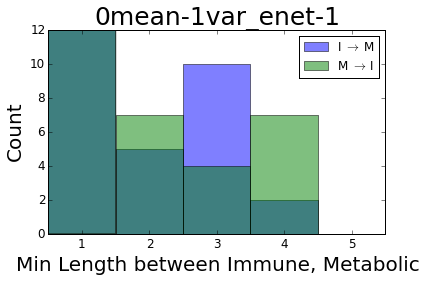

************
0mean-1var_enet-2
************


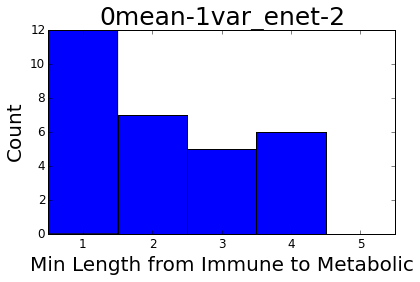

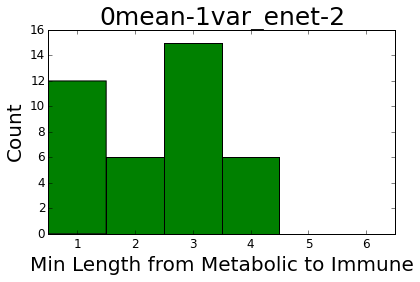

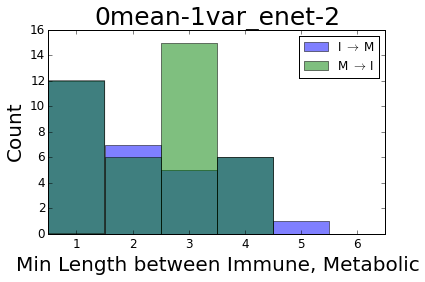

************
0mean-unnormalized_enet-1
************


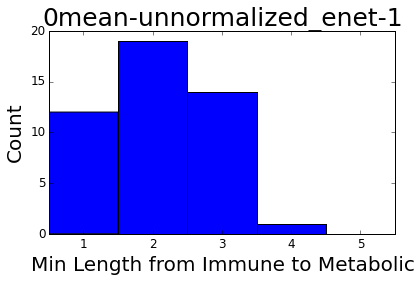

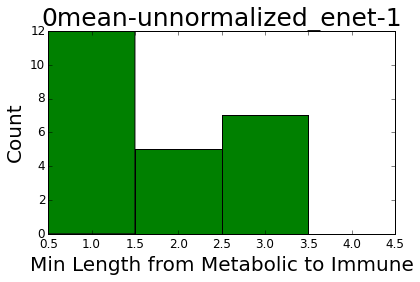

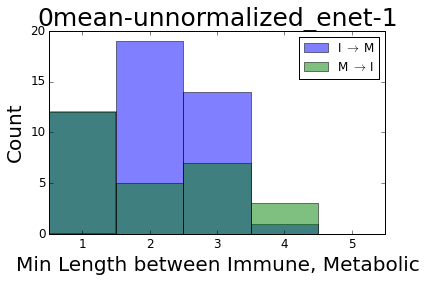

************
0mean-unnormalized_enet-2
************


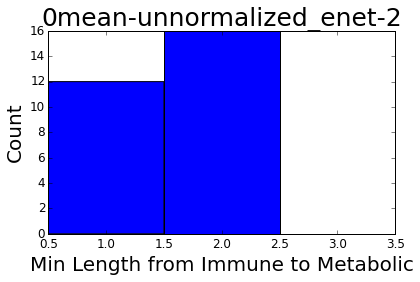

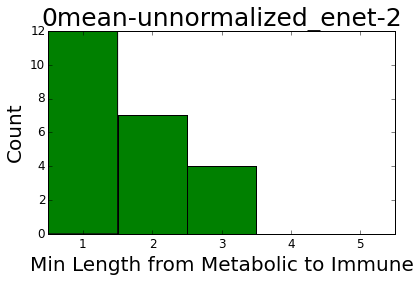

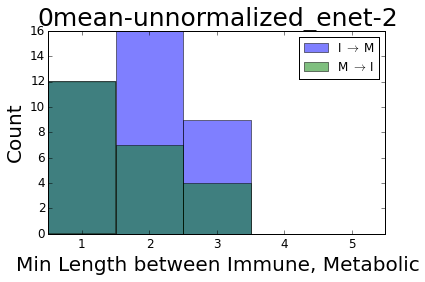

In [57]:
for i in range(len(imm_lengths_list)):
    name = names[i]
    name_plot_folder = name_plot_folders[i]
    
    imm_lengths = imm_lengths_list[i]
    metab_lengths = metab_lengths_list[i]
    
    length_folder = os.path.join(name_plot_folder, "imm-metab-lengths")
    
    if not os.path.exists(length_folder):
        os.makedirs(length_folder)
    
    imm_lengths_plot_filename = os.path.join(length_folder, name + "_Imm-to-Metab-Lengths.pdf")
    metab_lengths_plot_filename = os.path.join(length_folder, name + "_Metab-to-Imm-Lengths.pdf")

    both_lengths_plot_filename = os.path.join(length_folder, name + "_both-Imm-to-Metab-Lengths.pdf")
    
    bins = np.arange(0.5, 6.5, 1)
    
    
    print "************"
    print name
    print "************"
    
    if len(imm_lengths) == 0:
        print "No Immune lengths for ", name
    else:
        make_hist([imm_lengths], xlabel="Min Length from Immune to Metabolic", title=name,
                 save_filename=imm_lengths_plot_filename)
        
        make_hist([imm_lengths], xlabel="Min Length from Immune to Metabolic", 
                 save_filename=imm_lengths_plot_filename[:-4] + "_for-paper.pdf", do_display=False,
                 remove_top_right_axes=True)
        
    
    if len(metab_lengths) == 0:
        print "No Metab lengths for ", name
    else:
        make_hist([metab_lengths], xlabel="Min Length from Metabolic to Immune", title=name,
                 save_filename=metab_lengths_plot_filename, colors=["g"])
        
        make_hist([metab_lengths], xlabel="Min Length from Metabolic to Immune",
                 save_filename=metab_lengths_plot_filename[:-4] + "_for-paper.pdf", do_display=False,
                  remove_top_right_axes=True, colors=["g"])
    
    if len(imm_lengths) == 0 or len(metab_lengths) == 0:
        print "Missing one of imm or metab lengths"
    else:
        
        
        make_hist([imm_lengths, metab_lengths], xlabel="Min Length between Immune, Metabolic", title=name,
                 save_filename=both_lengths_plot_filename, colors=["b", "g"], alphas=[0.5, 0.5],
                 labels=["I " + r'$\rightarrow$' + " M", "M " + r'$\rightarrow$' + " I"],
                 do_legend=True)
        
        make_hist([imm_lengths, metab_lengths], xlabel="Min Length between Immune, Metabolic", 
                 save_filename=both_lengths_plot_filename[:-4] + "_for-paper.pdf", colors=["b", "g"], 
                  alphas=[0.5, 0.5], do_display=False, remove_top_right_axes=True,
                 labels=["I " + r'$\rightarrow$' + " M", "M " + r'$\rightarrow$' + " I"],
                 do_legend=True)
    
    

In [58]:
graph_summary_df = pd.DataFrame({"Name": names})
graph_summary_df["Total Edges"] = [net.shape[0] for net in nets]
graph_summary_df["Sparsity (%)"] = [round(net.shape[0] * 100.0 /len(data_genes)**2 , 2) for net in nets]
graph_summary_df["Imm Genes in Network"] = [len(x) for x in net_imm_genes_list]
graph_summary_df["Metab Genes in Network"] = [len(x) for x in net_metab_genes_list]


graph_summary_df["Imm to Metab Length (mean)"] = [np.round(np.mean(x), 2) if len(x) > 0 else None for x in imm_lengths_list]
graph_summary_df["Imm to Metab Length (std)"] = [np.round(np.std(x), 2) if len(x) > 0 else None for x in imm_lengths_list]
graph_summary_df["Imm to Metab Length (min)"] = [np.round(np.min(x), 2) if len(x) > 0 else None for x in imm_lengths_list]
graph_summary_df["Imm to Metab Length (25 %)"] = [np.round(np.percentile(x, 25), 2) if len(x) > 0 else None for x in imm_lengths_list]
graph_summary_df["Imm to Metab Length (med)"] = [np.round(np.percentile(x, 50), 2) if len(x) > 0 else None for x in imm_lengths_list]
graph_summary_df["Imm to Metab Length (75 %)"] = [np.round(np.percentile(x, 75), 2) if len(x) > 0 else None for x in imm_lengths_list]
graph_summary_df["Imm to Metab Length (max)"] = [np.round(np.max(x), 2) if len(x) > 0 else None for x in imm_lengths_list]


graph_summary_df["Metab to Imm Length (mean)"] = [np.round(np.mean(x), 2) if len(x) > 0 else None for x in metab_lengths_list]
graph_summary_df["Metab to Imm Length (std)"] = [np.round(np.std(x), 2) if len(x) > 0 else None for x in metab_lengths_list]
graph_summary_df["Metab to Imm Length (min)"] = [np.round(np.min(x), 2) if len(x) > 0 else None for x in metab_lengths_list]
graph_summary_df["Metab to Imm Length (25 %)"] = [np.round(np.percentile(x, 25), 2) if len(x) > 0 else None for x in metab_lengths_list]
graph_summary_df["Metab to Imm Length (med)"] = [np.round(np.percentile(x, 50), 2) if len(x) > 0 else None for x in metab_lengths_list]
graph_summary_df["Metab to Imm Length (75 %)"] = [np.round(np.percentile(x, 75), 2) if len(x) > 0 else None for x in metab_lengths_list]
graph_summary_df["Metab to Imm Length (max)"] = [np.round(np.max(x), 2) if len(x) > 0 else None for x in metab_lengths_list]

display(graph_summary_df)



,Name,Total Edges,Sparsity (%),Imm Genes in Network,Metab Genes in Network,Imm to Metab Length (mean),Imm to Metab Length (std),Imm to Metab Length (min),Imm to Metab Length (25 %),Imm to Metab Length (med),Imm to Metab Length (75 %),Imm to Metab Length (max),Metab to Imm Length (mean),Metab to Imm Length (std),Metab to Imm Length (min),Metab to Imm Length (25 %),Metab to Imm Length (med),Metab to Imm Length (75 %),Metab to Imm Length (max)
0,0mean-1var_enet-1,10546,0.14,94,97,2.26,1.22,1,1.0,2.0,3.0,5,2.38,1.34,1,1.0,2.0,4.0,5
1,0mean-1var_enet-2,13879,0.18,107,113,2.26,1.24,1,1.0,2.0,3.0,5,2.48,1.20,1,1.0,3.0,3.0,6
2,0mean-unnormalized_enet-1,23025,0.30,108,117,2.15,0.90,1,1.5,2.0,3.0,5,2.04,1.07,1,1.0,2.0,3.0,4
3,0mean-unnormalized_enet-2,27781,0.36,109,120,1.92,0.75,1,1.0,2.0,2.0,3,1.79,1.00,1,1.0,1.5,2.0,5


In [59]:
outfile = os.path.join(base_out_dir, run_type + "_network-imm-to-metab-length-statistics.csv")
graph_summary_df[ list(graph_summary_df.columns.values[0:5]) + [x for x in graph_summary_df.columns.values if "Imm to Metab" in x]].to_csv(outfile, index=0)
print "Imm to Metab stats for all networks written to ", outfile

outfile = os.path.join(base_out_dir, run_type + "_network-metab-to-imm-length-statistics.csv")
graph_summary_df[ list(graph_summary_df.columns.values[0:5]) + [x for x in graph_summary_df.columns.values if "Metab to Imm" in x]].to_csv(outfile, index=0)
print "Metab to Imm stats for all networks written to ", outfile

outfile = os.path.join(base_out_dir, run_type + "_network-both-imm-to-metab-length-statistics.csv")
graph_summary_df.to_csv(outfile, index=0)
print "Both stats for all networks written to ", outfile


for i in range(len(names)):
    name = names[i]
    net_imm_to_metab_length_dict = net_imm_to_metab_length_dict_list[i]
    net_metab_to_imm_length_dict = net_metab_to_imm_length_dict_list[i]
    
    out_folder = os.path.join(base_out_dir, name, "imm-metab-length")
    
    if not os.path.exists(out_folder):
        os.makedirs(out_folder)
    print "***************"
    print name
    print "***************"
    
    print "Writing out to ", out_folder
    print
    print "Imm to Metab"
    outfile = os.path.join(out_folder, name + "_network-imm-to-metab-lengths.csv")
    with open(outfile, 'w') as f:
        for x in net_imm_to_metab_length_dict.values():
            f.write(str(x) + "\n")
    print "Written to ", outfile
    print
    print "Metab to Imm"
    outfile = os.path.join(out_folder, name + "_network-metab-to-imm-lengths.csv")
    with open(outfile, 'w') as f:
        for x in net_metab_to_imm_length_dict.values():
            f.write(str(x) + "\n")
    print "Written to", outfile
    

Imm to Metab stats for all networks written to  analysis/priority_network-imm-to-metab-length-statistics.csv
Metab to Imm stats for all networks written to  analysis/priority_network-metab-to-imm-length-statistics.csv
Both stats for all networks written to  analysis/priority_network-both-imm-to-metab-length-statistics.csv
***************
0mean-1var_enet-1
***************
Writing out to  analysis/0mean-1var_enet-1/imm-metab-length

Imm to Metab
Written to  analysis/0mean-1var_enet-1/imm-metab-length/0mean-1var_enet-1_network-imm-to-metab-lengths.csv

Metab to Imm
Written to analysis/0mean-1var_enet-1/imm-metab-length/0mean-1var_enet-1_network-metab-to-imm-lengths.csv
***************
0mean-1var_enet-2
***************
Writing out to  analysis/0mean-1var_enet-2/imm-metab-length

Imm to Metab
Written to  analysis/0mean-1var_enet-2/imm-metab-length/0mean-1var_enet-2_network-imm-to-metab-lengths.csv

Metab to Imm
Written to analysis/0mean-1var_enet-2/imm-metab-length/0mean-1var_enet-2_network

# Get edge-by-network table

In [60]:
edge_network_df = collections.OrderedDict()

total_edges = np.unique(np.concatenate( tuple(net["Cause-Effect"].values for net in nets)))
edge_network_df = pd.DataFrame({"Cause-Effect": total_edges})
edge_network_df["Cause"] = [x.split('-')[0] for x in total_edges]
edge_network_df["Effect"] = [x.split('-')[1] for x in total_edges]
edge_network_df["Gene Symbol: Cause"] = [nh.ensg2hg(x.split("-")[0]) for x in total_edges]
edge_network_df["Gene Symbol: Effect"] = [nh.ensg2hg(x.split("-")[1]) for x in total_edges]
edge_network_df["Summary: Cause"] = [gene2summary[x.split("-")[0]] for x in total_edges]
edge_network_df["Summary: Effect"] = [gene2summary[x.split('-')[1]] for x in total_edges]

edge_network_df["Total"] = np.zeros(len(total_edges))

for i in range(len(names)):
    
    t = time.time()
    net = nets[i]
    name = names[i]
    net_edges = set(net["Cause-Effect"].values)
    
    edge_network_df[name] = [1 if x in net_edges else 0 for x in total_edges]
    
    edge_network_df["Total"] += edge_network_df[name]
    
edge_network_df = nh.annotate_cols_summary(edge_network_df, names, col_name="Networks")
cols = list(edge_network_df)
cols.insert(cols.index("Total") + 1, cols.pop(cols.index("Networks")))
edge_network_df = edge_network_df.ix[:, cols]


print "Begining weights"
weight_cols = []
for i in range(len(names)):
    net = nets[i]
    name = names[i]
    net_edges = set(net["Cause-Effect"].values)
    
    t = time.time()
    edge_network_df["Weight: " + name] = [net[net["Cause-Effect"] == x]["Weight"].values[0] if e else 0 for x, e in zip(total_edges, edge_network_df[name]) ]
    weight_cols.append("Weight: " + name)
    print round(time.time() - t, 2)

edge_network_df["Avg-Weight"] = edge_network_df[weight_cols].sum(axis=1)/edge_network_df["Total"]
edge_network_df["Abs-Avg-Weight"] = abs(edge_network_df["Avg-Weight"])
    

FOr col integration_0mean-unnormalized_enet-1 : 2126
FOr col orig_0mean-1var_enet-1 : 10546
FOr col orig_0mean-1var_enet-2 : 13879
FOr col orig_0mean-unnormalized_enet-1 : 23025
FOr col orig_0mean-unnormalized_enet-2 : 27781
Begining weights
1.92
13.12
17.87
44.58
75.16


In [61]:
b = np.round(edge_network_df["Avg-Weight"], 3)
edge_network_df.drop(labels=["Avg-Weight"], axis=1, inplace=True)
edge_network_df.insert(7, "Avg-Weight", b)
edge_network_df["type: Cause"] = [gene2type[x.split("-")[0]] for x in edge_network_df["Cause-Effect"]]
edge_network_df["type: Effect"] = [gene2type[x.split('-')[1]] for x in edge_network_df["Cause-Effect"]]
edge_network_df["TF: Cause"] = [gene2TF[x.split("-")[0]] for x in edge_network_df["Cause-Effect"]]
edge_network_df["TF: Effect"] = [gene2TF[x.split('-')[1]] for x in edge_network_df["Cause-Effect"]]


edge_network_df.sort_values(["Total", "Abs-Avg-Weight"],  ascending=False, inplace=True)





display(edge_network_df.head(n=10))
    # get all possible edges
    

,Cause-Effect,Cause,Effect,Gene Symbol: Cause,Gene Symbol: Effect,Summary: Cause,Summary: Effect,Avg-Weight,Total,Networks,...,Weight: integration_0mean-unnormalized_enet-1,Weight: orig_0mean-1var_enet-1,Weight: orig_0mean-1var_enet-2,Weight: orig_0mean-unnormalized_enet-1,Weight: orig_0mean-unnormalized_enet-2,Abs-Avg-Weight,type: Cause,type: Effect,TF: Cause,TF: Effect
53738,ENSG00000188293.5-ENSG00000007255.9,ENSG00000188293.5,ENSG00000007255.9,IGFL1,TRAPPC6A,NaN,NaN,-0.171,4.0,"orig_0mean-1var_enet-1,orig_0mean-1var_enet-2,orig_0mean-unnormalized_enet-1,orig_0mean-unnormalized_enet-2,",...,0.0,-0.113797,-0.103357,-0.279616,-0.186081,0.170713,other,other,0,0
53357,ENSG00000187566.4-ENSG00000172137.17,ENSG00000187566.4,ENSG00000172137.17,NHLRC1,CALB2,NaN,NaN,0.162,4.0,"orig_0mean-1var_enet-1,orig_0mean-1var_enet-2,orig_0mean-unnormalized_enet-1,orig_0mean-unnormalized_enet-2,",...,0.0,0.150973,0.093435,0.174576,0.227458,0.161610,other,other,0,0
45176,ENSG00000179913.9-ENSG00000089505.16,ENSG00000179913.9,ENSG00000089505.16,B3GNT3,CMTM1,NaN,"Immune_GOC-5,Immune_GOC-4,",-0.156,4.0,"orig_0mean-1var_enet-1,orig_0mean-1var_enet-2,orig_0mean-unnormalized_enet-1,orig_0mean-unnormalized_enet-2,",...,0.0,-0.164974,-0.164358,-0.135858,-0.156944,0.155534,other,other,0,0
14324,ENSG00000124575.6-ENSG00000183779.6,ENSG00000124575.6,ENSG00000183779.6,HIST1H1D,ZNF703,NaN,NaN,0.150,4.0,"orig_0mean-1var_enet-1,orig_0mean-1var_enet-2,orig_0mean-unnormalized_enet-1,orig_0mean-unnormalized_enet-2,",...,0.0,0.201083,0.139851,0.128019,0.130599,0.149888,other,other,0,0
51364,ENSG00000185522.7-ENSG00000179913.9,ENSG00000185522.7,ENSG00000179913.9,LMNTD2,B3GNT3,NaN,NaN,-0.150,4.0,"orig_0mean-1var_enet-1,orig_0mean-1var_enet-2,orig_0mean-unnormalized_enet-1,orig_0mean-unnormalized_enet-2,",...,0.0,-0.205113,-0.103309,-0.165220,-0.125622,0.149816,other,other,0,0
59351,ENSG00000215375.5-ENSG00000143320.7,ENSG00000215375.5,ENSG00000143320.7,MYL5,CRABP2,NaN,NaN,0.148,4.0,"orig_0mean-1var_enet-1,orig_0mean-1var_enet-2,orig_0mean-unnormalized_enet-1,orig_0mean-unnormalized_enet-2,",...,0.0,0.129232,0.157699,0.152826,0.152119,0.147969,other,other,0,0
54258,ENSG00000188293.5-ENSG00000204344.13,ENSG00000188293.5,ENSG00000204344.13,IGFL1,STK19,NaN,NaN,-0.145,4.0,"orig_0mean-1var_enet-1,orig_0mean-1var_enet-2,orig_0mean-unnormalized_enet-1,orig_0mean-unnormalized_enet-2,",...,0.0,-0.122855,-0.079367,-0.230302,-0.149010,0.145383,other,other,0,0
24264,ENSG00000142089.14-ENSG00000142871.14,ENSG00000142089.14,ENSG00000142871.14,IFITM3,CYR61,"Immune_GOC-5,Immune_GOC-4,",NaN,-0.139,4.0,"orig_0mean-1var_enet-1,orig_0mean-1var_enet-2,orig_0mean-unnormalized_enet-1,orig_0mean-unnormalized_enet-2,",...,0.0,-0.145123,-0.101174,-0.184820,-0.124717,0.138959,other,other,0,0
37889,ENSG00000169174.10-ENSG00000170468.7,ENSG00000169174.10,ENSG00000170468.7,PCSK9,C14orf169,NaN,NaN,-0.134,4.0,"orig_0mean-1var_enet-1,orig_0mean-1var_enet-2,orig_0mean-unnormalized_enet-1,orig_0mean-unnormalized_enet-2,",...,0.0,-0.180569,-0.152280,-0.120291,-0.084262,0.134350,other,other,0,0
24047,ENSG00000142089.14-ENSG00000106261.15,ENSG00000142089.14,ENSG00000106261.15,IFITM3,ZKSCAN1,"Immune_GOC-5,Immune_GOC-4,","TF-Bioguo,",-0.134,4.0,"orig_0mean-1var_enet-1,orig_0mean-1var_enet-2,orig_0mean-unnormalized_enet-1,orig_0mean-unnormalized_enet-2,",...,0.0,-0.159026,-0.104563,-0.170614,-0.101905,0.134027,other,other,0,1


In [62]:
outfile = os.path.join(base_out_dir, run_type + "_common-edge-by-network.csv")

edge_network_df.to_csv(outfile, index=0)
print "Edge network DF written to ", outfile


Edge network DF written to  analysis/integration_common-edge-by-network.csv


In [64]:
outfile = os.path.join(base_out_dir, run_type + "_common-edge-by-network-only-integration.csv")

tmp_out_df = edge_network_df[edge_network_df["integration_0mean-unnormalized_enet-1"] == 1]
tmp_out_df.to_csv(outfile, index =0)
print "Edge network DF written to ", outfile,

tmp_out_df.head()

Edge network DF written to  analysis/integration_common-edge-by-network-only-integration.csv

,Cause-Effect,Cause,Effect,Gene Symbol: Cause,Gene Symbol: Effect,Summary: Cause,Summary: Effect,Avg-Weight,Total,Networks,...,Weight: integration_0mean-unnormalized_enet-1,Weight: orig_0mean-1var_enet-1,Weight: orig_0mean-1var_enet-2,Weight: orig_0mean-unnormalized_enet-1,Weight: orig_0mean-unnormalized_enet-2,Abs-Avg-Weight,type: Cause,type: Effect,TF: Cause,TF: Effect
58578,ENSG00000205420.9-ENSG00000100479.11,ENSG00000205420.9,ENSG00000100479.11,KRT6A,POLE2,NaN,NaN,-0.082,3.0,"integration_0mean-unnormalized_enet-1,orig_0mean-unnormalized_enet-1,orig_0mean-unnormalized_enet-2,",...,-0.056970,0.0,0.0,-0.106758,-0.082769,0.082166,other,other,0,0
20013,ENSG00000135094.9-ENSG00000160285.13,ENSG00000135094.9,ENSG00000160285.13,SDS,LSS,"Metabolism-gluc_GSEA,",NaN,0.080,3.0,"integration_0mean-unnormalized_enet-1,orig_0mean-unnormalized_enet-1,orig_0mean-unnormalized_enet-2,",...,0.048026,0.0,0.0,0.102862,0.090125,0.080338,metabolic,other,0,0
19891,ENSG00000135094.9-ENSG00000138160.5,ENSG00000135094.9,ENSG00000138160.5,SDS,KIF11,"Metabolism-gluc_GSEA,",NaN,-0.077,3.0,"integration_0mean-unnormalized_enet-1,orig_0mean-unnormalized_enet-1,orig_0mean-unnormalized_enet-2,",...,-0.027729,0.0,0.0,-0.116499,-0.086899,0.077042,metabolic,other,0,0
58573,ENSG00000205420.9-ENSG00000093009.8,ENSG00000205420.9,ENSG00000093009.8,KRT6A,CDC45,NaN,NaN,-0.076,3.0,"integration_0mean-unnormalized_enet-1,orig_0mean-unnormalized_enet-1,orig_0mean-unnormalized_enet-2,",...,-0.061277,0.0,0.0,-0.082154,-0.083987,0.075806,other,other,0,0
19641,ENSG00000135094.9-ENSG00000101003.9,ENSG00000135094.9,ENSG00000101003.9,SDS,GINS1,"Metabolism-gluc_GSEA,",NaN,-0.076,3.0,"integration_0mean-unnormalized_enet-1,orig_0mean-unnormalized_enet-1,orig_0mean-unnormalized_enet-2,",...,-0.063822,0.0,0.0,-0.092461,-0.070876,0.075719,metabolic,other,0,0


In [63]:
plot_common_folder = os.path.join(plot_folder, "common")

if not os.path.exists(plot_common_folder):
    os.makedirs(plot_common_folder)

# Any-any

In [64]:
plotfoldersuffix = "any-any"
plot_df = edge_network_df.head(top_edge_num)

display(plot_df)

plot_subfolder = os.path.join(plot_common_folder, plotfoldersuffix)
if not os.path.exists(plot_subfolder):
    os.makedirs(plot_subfolder)
    
outfile = os.path.join(plot_subfolder, "top_interactions.csv")
plot_df.to_csv(outfile, index=0)

,Cause-Effect,Cause,Effect,Gene Symbol: Cause,Gene Symbol: Effect,Summary: Cause,Summary: Effect,Abs-Avg-Weight,Total,Networks,0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,Weight: 0mean-1var_enet-1,Weight: 0mean-1var_enet-2,Weight: 0mean-unnormalized_enet-1,Weight: 0mean-unnormalized_enet-2
51786,ENSG00000188293.5-ENSG00000007255.9,ENSG00000188293.5,ENSG00000007255.9,IGFL1,TRAPPC6A,NaN,NaN,0.171,4.0,"0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",1,1,1,1,-0.113797,-0.103357,-0.279616,-0.186081
51405,ENSG00000187566.4-ENSG00000172137.17,ENSG00000187566.4,ENSG00000172137.17,NHLRC1,CALB2,NaN,NaN,0.162,4.0,"0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",1,1,1,1,0.150973,0.093435,0.174576,0.227458
43315,ENSG00000179913.9-ENSG00000089505.16,ENSG00000179913.9,ENSG00000089505.16,B3GNT3,CMTM1,NaN,"Immune_GOC-5,Immune_GOC-4,",0.156,4.0,"0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",1,1,1,1,-0.164974,-0.164358,-0.135858,-0.156944


********************************
IGFL1 TRAPPC6A
********************************


/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


***********************************************
0mean-1var_enet-1
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
858              IGFL1            TRAPPC6A -0.113797     1            NaN             NaN
Written to  analysis/plots/common/any-any/IGFL1-TRAPPC6A/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-any/IGFL1-TRAPPC6A/0mean-1var_enet-1_IGFL1-TRAPPC6A-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-any/IGFL1-TRAPPC6A/0mean-1var_enet-1_IGFL1-TRAPPC6A-lag-1-coef--1E-01.pdf


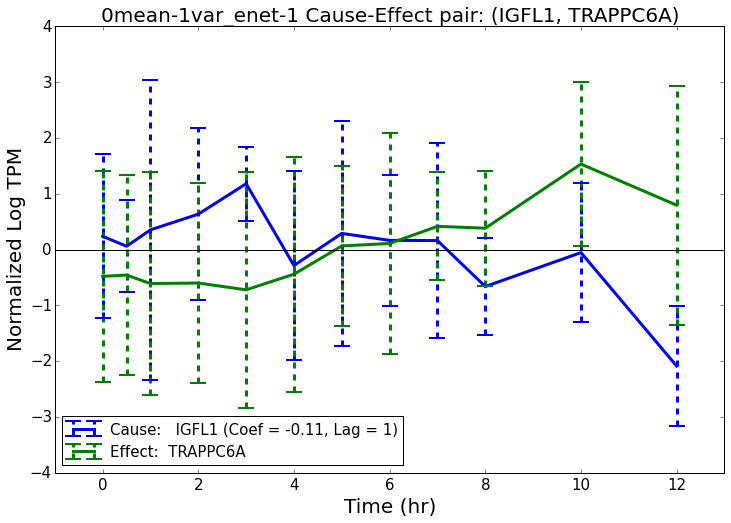

Filename:  analysis/plots/common/any-any/IGFL1-TRAPPC6A/0mean-1var_enet-1_no-bar-IGFL1-TRAPPC6A-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-any/IGFL1-TRAPPC6A/0mean-1var_enet-1_no-bar-IGFL1-TRAPPC6A-lag-1-coef--1E-01.pdf


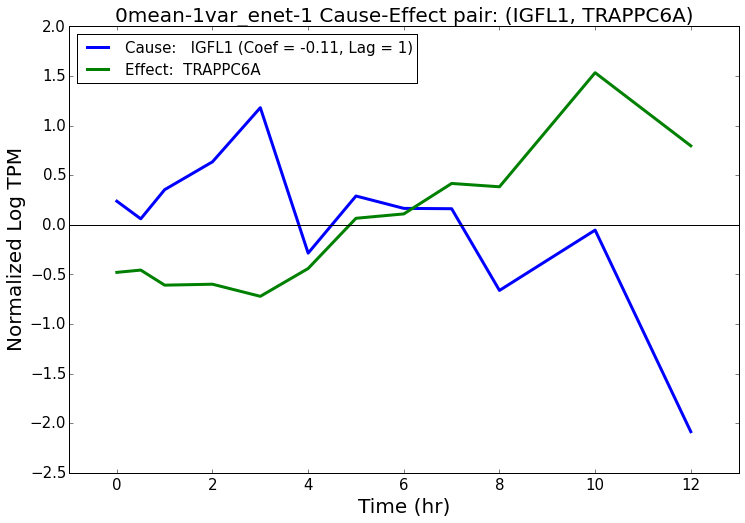

***********************************************
0mean-1var_enet-2
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
246              IGFL1            TRAPPC6A -0.103357   1.0            NaN             NaN
Written to  analysis/plots/common/any-any/IGFL1-TRAPPC6A/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-any/IGFL1-TRAPPC6A/0mean-1var_enet-2_IGFL1-TRAPPC6A-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-any/IGFL1-TRAPPC6A/0mean-1var_enet-2_IGFL1-TRAPPC6A-lag-2-coef--1E-01.pdf


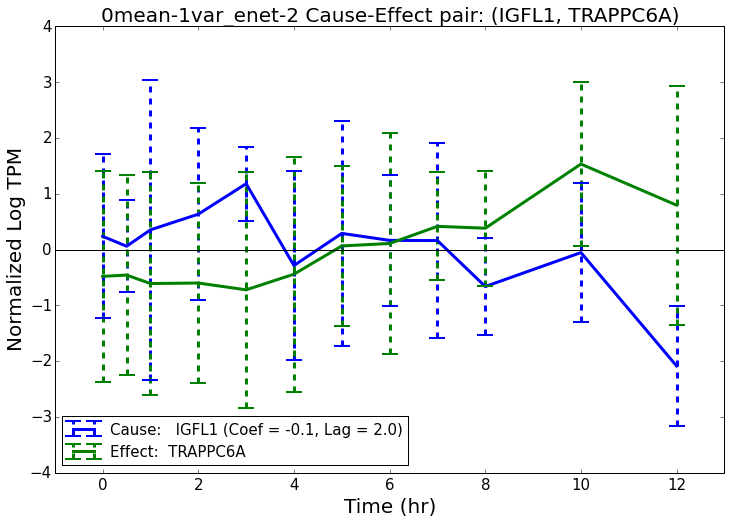

Filename:  analysis/plots/common/any-any/IGFL1-TRAPPC6A/0mean-1var_enet-2_no-bar-IGFL1-TRAPPC6A-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-any/IGFL1-TRAPPC6A/0mean-1var_enet-2_no-bar-IGFL1-TRAPPC6A-lag-2-coef--1E-01.pdf


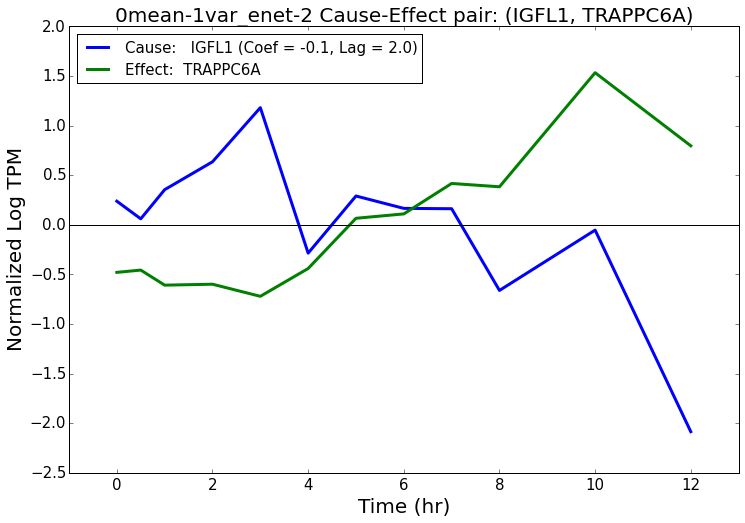

***********************************************
0mean-unnormalized_enet-1
***********************************************
  Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
4              IGFL1            TRAPPC6A -0.279616     1            NaN             NaN
Written to  analysis/plots/common/any-any/IGFL1-TRAPPC6A/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-any/IGFL1-TRAPPC6A/0mean-unnormalized_enet-1_IGFL1-TRAPPC6A-lag-1-coef--3E-01.pdf
Plot saved to  analysis/plots/common/any-any/IGFL1-TRAPPC6A/0mean-unnormalized_enet-1_IGFL1-TRAPPC6A-lag-1-coef--3E-01.pdf


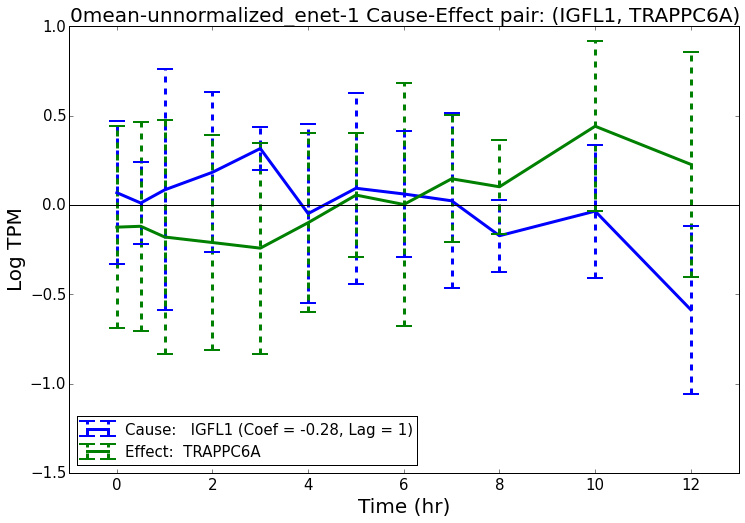

Filename:  analysis/plots/common/any-any/IGFL1-TRAPPC6A/0mean-unnormalized_enet-1_no-bar-IGFL1-TRAPPC6A-lag-1-coef--3E-01.pdf
Plot saved to  analysis/plots/common/any-any/IGFL1-TRAPPC6A/0mean-unnormalized_enet-1_no-bar-IGFL1-TRAPPC6A-lag-1-coef--3E-01.pdf


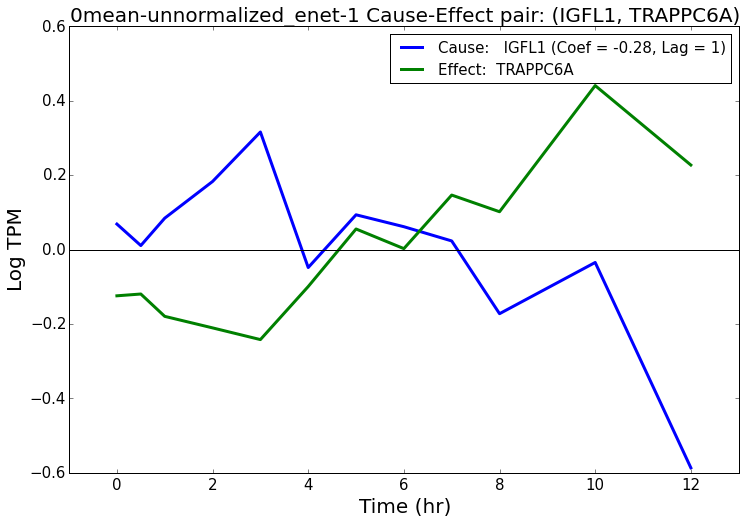

***********************************************
0mean-unnormalized_enet-2
***********************************************
   Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
29              IGFL1            TRAPPC6A -0.186081   1.0            NaN             NaN
Written to  analysis/plots/common/any-any/IGFL1-TRAPPC6A/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-any/IGFL1-TRAPPC6A/0mean-unnormalized_enet-2_IGFL1-TRAPPC6A-lag-2-coef--2E-01.pdf
Plot saved to  analysis/plots/common/any-any/IGFL1-TRAPPC6A/0mean-unnormalized_enet-2_IGFL1-TRAPPC6A-lag-2-coef--2E-01.pdf


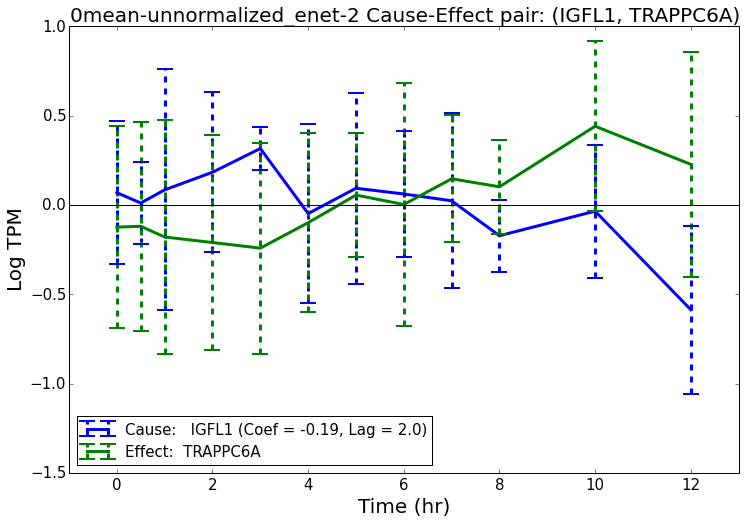

Filename:  analysis/plots/common/any-any/IGFL1-TRAPPC6A/0mean-unnormalized_enet-2_no-bar-IGFL1-TRAPPC6A-lag-2-coef--2E-01.pdf
Plot saved to  analysis/plots/common/any-any/IGFL1-TRAPPC6A/0mean-unnormalized_enet-2_no-bar-IGFL1-TRAPPC6A-lag-2-coef--2E-01.pdf


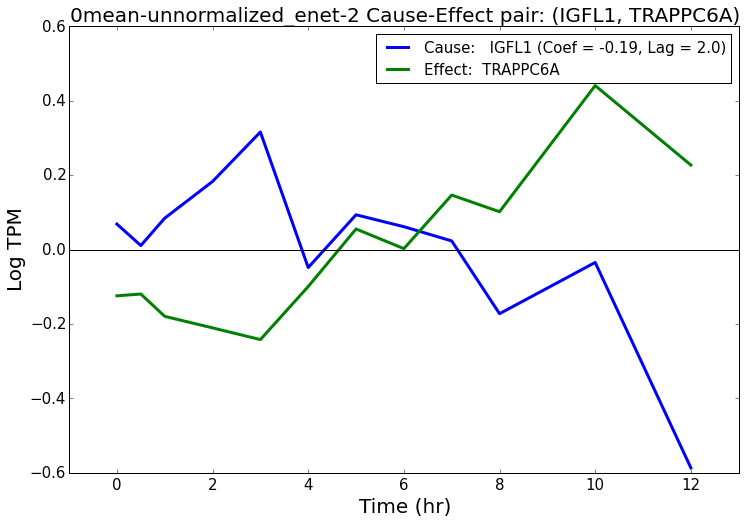

********************************
NHLRC1 CALB2
********************************
***********************************************
0mean-1var_enet-1
***********************************************
   Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
75             NHLRC1               CALB2  0.150973     1            NaN             NaN
Written to  analysis/plots/common/any-any/NHLRC1-CALB2/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-any/NHLRC1-CALB2/0mean-1var_enet-1_NHLRC1-CALB2-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/common/any-any/NHLRC1-CALB2/0mean-1var_enet-1_NHLRC1-CALB2-lag-1-coef-2E-01.pdf


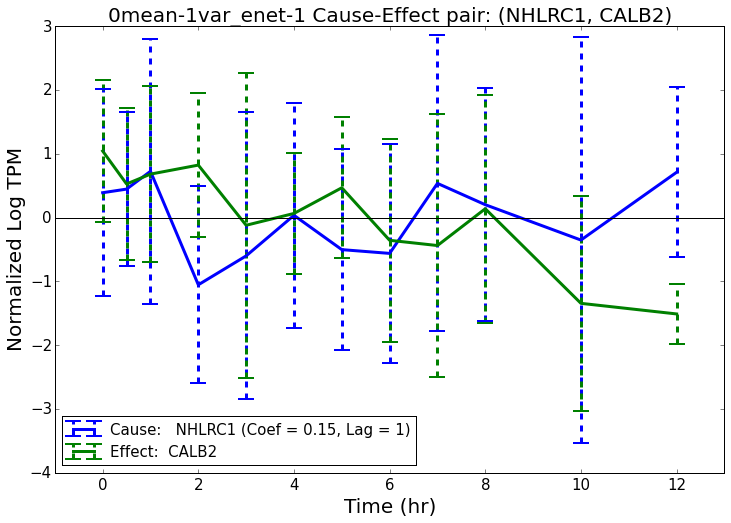

Filename:  analysis/plots/common/any-any/NHLRC1-CALB2/0mean-1var_enet-1_no-bar-NHLRC1-CALB2-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/common/any-any/NHLRC1-CALB2/0mean-1var_enet-1_no-bar-NHLRC1-CALB2-lag-1-coef-2E-01.pdf


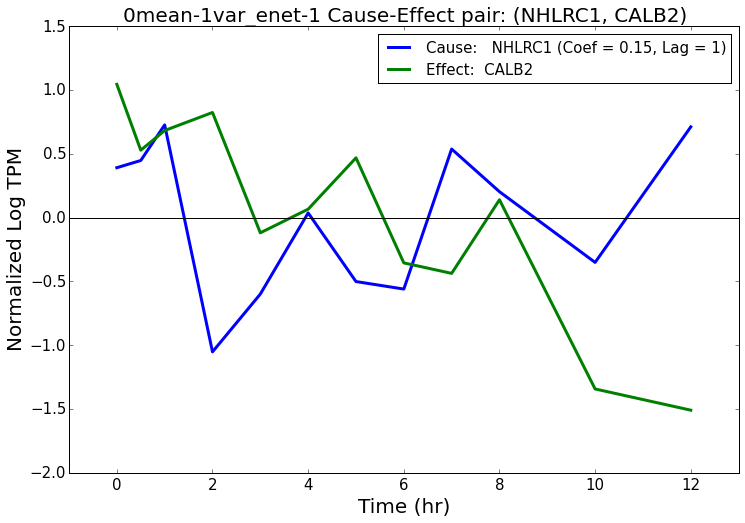

***********************************************
0mean-1var_enet-2
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
535             NHLRC1               CALB2  0.093435   1.0            NaN             NaN
Written to  analysis/plots/common/any-any/NHLRC1-CALB2/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-any/NHLRC1-CALB2/0mean-1var_enet-2_NHLRC1-CALB2-lag-2-coef-9E-02.pdf
Plot saved to  analysis/plots/common/any-any/NHLRC1-CALB2/0mean-1var_enet-2_NHLRC1-CALB2-lag-2-coef-9E-02.pdf


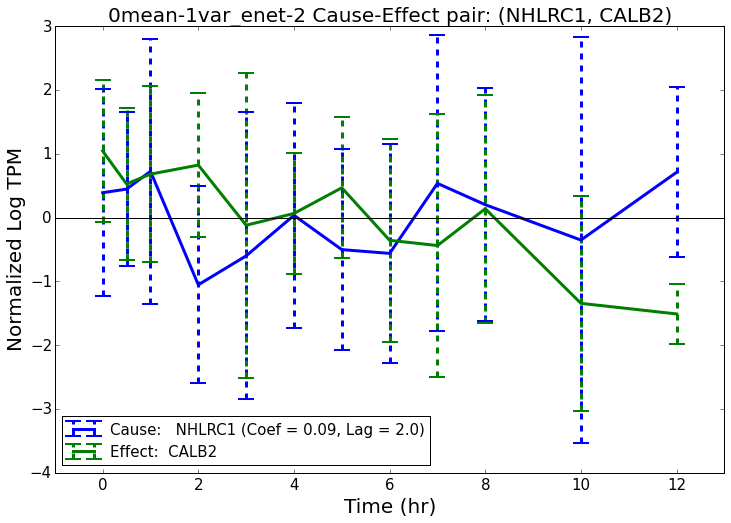

Filename:  analysis/plots/common/any-any/NHLRC1-CALB2/0mean-1var_enet-2_no-bar-NHLRC1-CALB2-lag-2-coef-9E-02.pdf
Plot saved to  analysis/plots/common/any-any/NHLRC1-CALB2/0mean-1var_enet-2_no-bar-NHLRC1-CALB2-lag-2-coef-9E-02.pdf


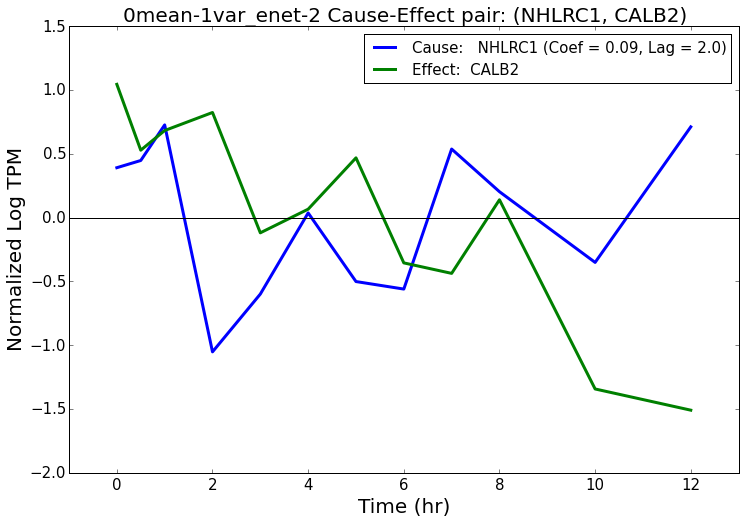

***********************************************
0mean-unnormalized_enet-1
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
305             NHLRC1               CALB2  0.174576     1            NaN             NaN
Written to  analysis/plots/common/any-any/NHLRC1-CALB2/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-any/NHLRC1-CALB2/0mean-unnormalized_enet-1_NHLRC1-CALB2-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/common/any-any/NHLRC1-CALB2/0mean-unnormalized_enet-1_NHLRC1-CALB2-lag-1-coef-2E-01.pdf


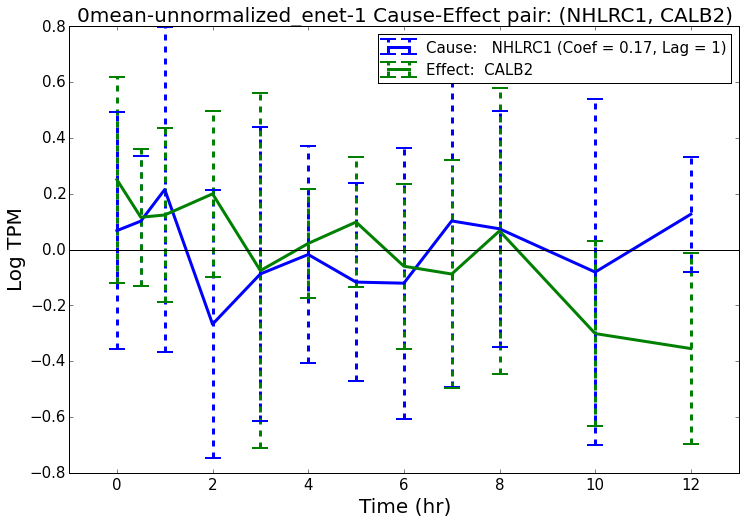

Filename:  analysis/plots/common/any-any/NHLRC1-CALB2/0mean-unnormalized_enet-1_no-bar-NHLRC1-CALB2-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/common/any-any/NHLRC1-CALB2/0mean-unnormalized_enet-1_no-bar-NHLRC1-CALB2-lag-1-coef-2E-01.pdf


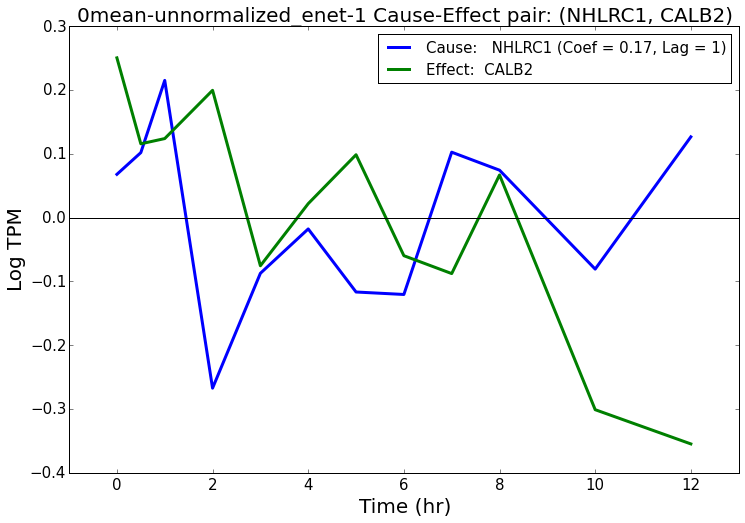

***********************************************
0mean-unnormalized_enet-2
***********************************************
  Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
3             NHLRC1               CALB2  0.227458   1.0            NaN             NaN
Written to  analysis/plots/common/any-any/NHLRC1-CALB2/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-any/NHLRC1-CALB2/0mean-unnormalized_enet-2_NHLRC1-CALB2-lag-2-coef-2E-01.pdf
Plot saved to  analysis/plots/common/any-any/NHLRC1-CALB2/0mean-unnormalized_enet-2_NHLRC1-CALB2-lag-2-coef-2E-01.pdf


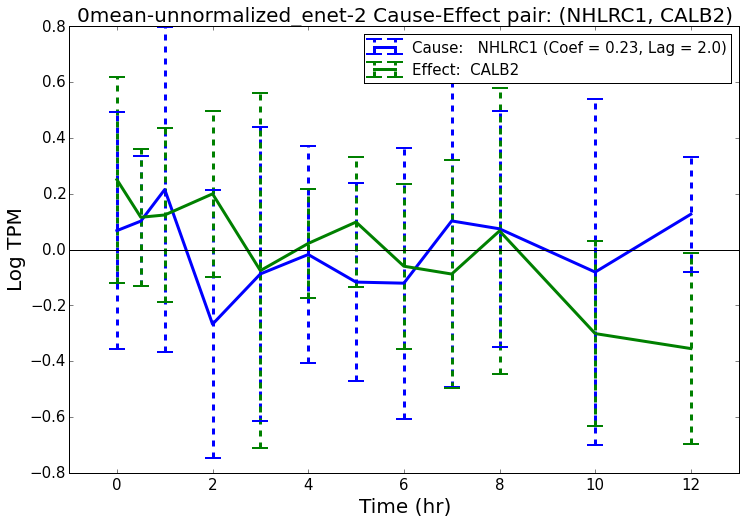

Filename:  analysis/plots/common/any-any/NHLRC1-CALB2/0mean-unnormalized_enet-2_no-bar-NHLRC1-CALB2-lag-2-coef-2E-01.pdf
Plot saved to  analysis/plots/common/any-any/NHLRC1-CALB2/0mean-unnormalized_enet-2_no-bar-NHLRC1-CALB2-lag-2-coef-2E-01.pdf


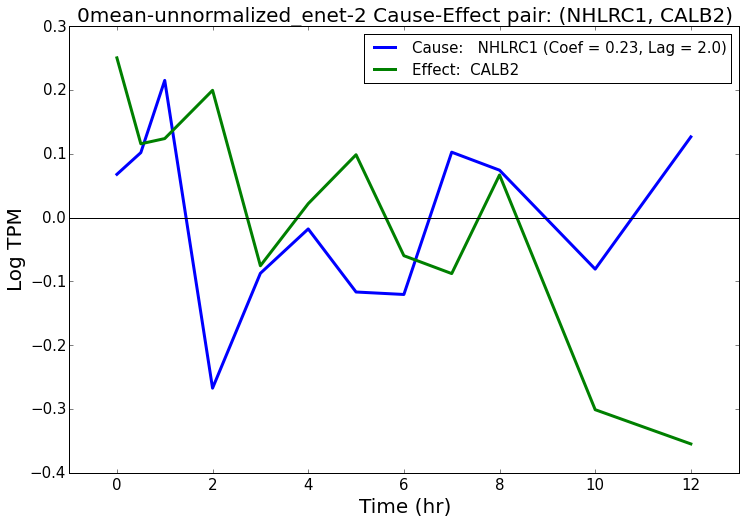

********************************
B3GNT3 CMTM1
********************************
***********************************************
0mean-1var_enet-1
***********************************************
   Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause             Summary: Effect
28             B3GNT3               CMTM1 -0.164974     1            NaN  Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/any-any/B3GNT3-CMTM1/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-any/B3GNT3-CMTM1/0mean-1var_enet-1_B3GNT3-CMTM1-lag-1-coef--2E-01.pdf
Plot saved to  analysis/plots/common/any-any/B3GNT3-CMTM1/0mean-1var_enet-1_B3GNT3-CMTM1-lag-1-coef--2E-01.pdf


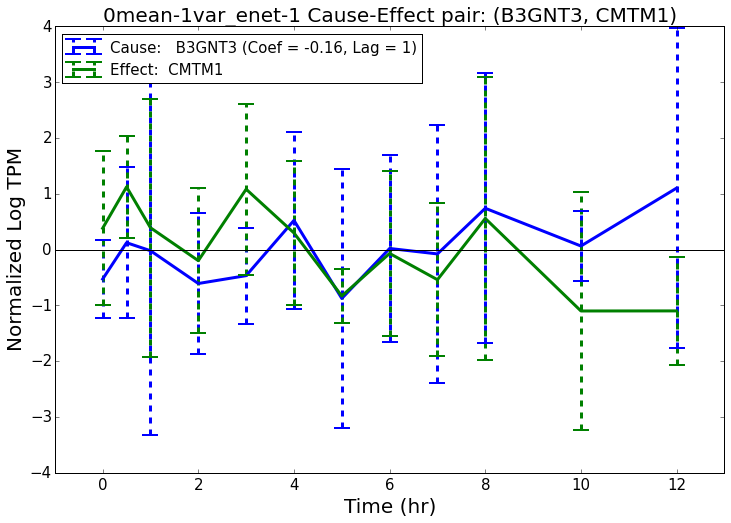

Filename:  analysis/plots/common/any-any/B3GNT3-CMTM1/0mean-1var_enet-1_no-bar-B3GNT3-CMTM1-lag-1-coef--2E-01.pdf
Plot saved to  analysis/plots/common/any-any/B3GNT3-CMTM1/0mean-1var_enet-1_no-bar-B3GNT3-CMTM1-lag-1-coef--2E-01.pdf


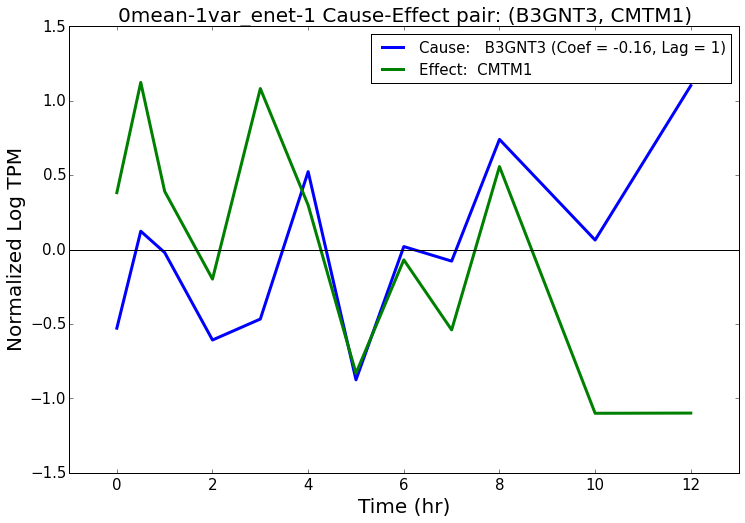

***********************************************
0mean-1var_enet-2
***********************************************
  Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause             Summary: Effect
1             B3GNT3               CMTM1 -0.164358   1.0            NaN  Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/any-any/B3GNT3-CMTM1/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-any/B3GNT3-CMTM1/0mean-1var_enet-2_B3GNT3-CMTM1-lag-2-coef--2E-01.pdf
Plot saved to  analysis/plots/common/any-any/B3GNT3-CMTM1/0mean-1var_enet-2_B3GNT3-CMTM1-lag-2-coef--2E-01.pdf


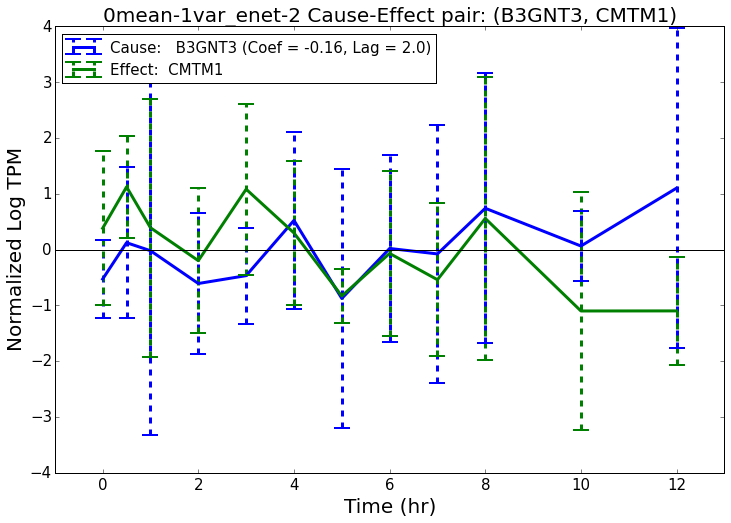

Filename:  analysis/plots/common/any-any/B3GNT3-CMTM1/0mean-1var_enet-2_no-bar-B3GNT3-CMTM1-lag-2-coef--2E-01.pdf
Plot saved to  analysis/plots/common/any-any/B3GNT3-CMTM1/0mean-1var_enet-2_no-bar-B3GNT3-CMTM1-lag-2-coef--2E-01.pdf


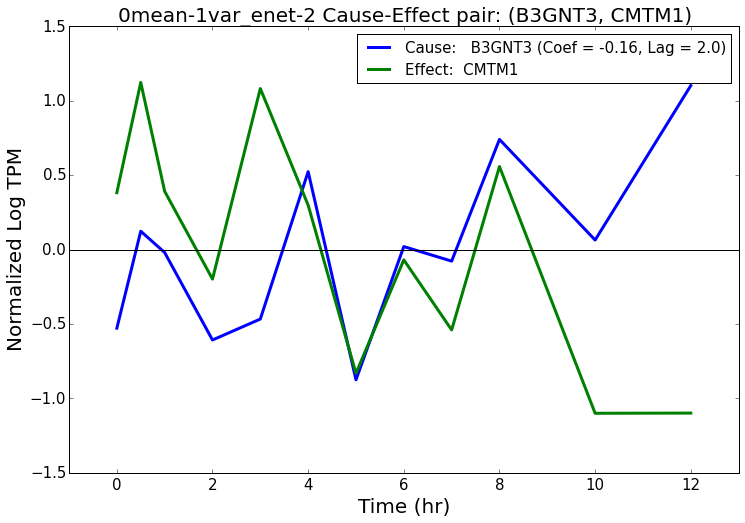

***********************************************
0mean-unnormalized_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause             Summary: Effect
1160             B3GNT3               CMTM1 -0.135858     1            NaN  Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/any-any/B3GNT3-CMTM1/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-any/B3GNT3-CMTM1/0mean-unnormalized_enet-1_B3GNT3-CMTM1-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-any/B3GNT3-CMTM1/0mean-unnormalized_enet-1_B3GNT3-CMTM1-lag-1-coef--1E-01.pdf


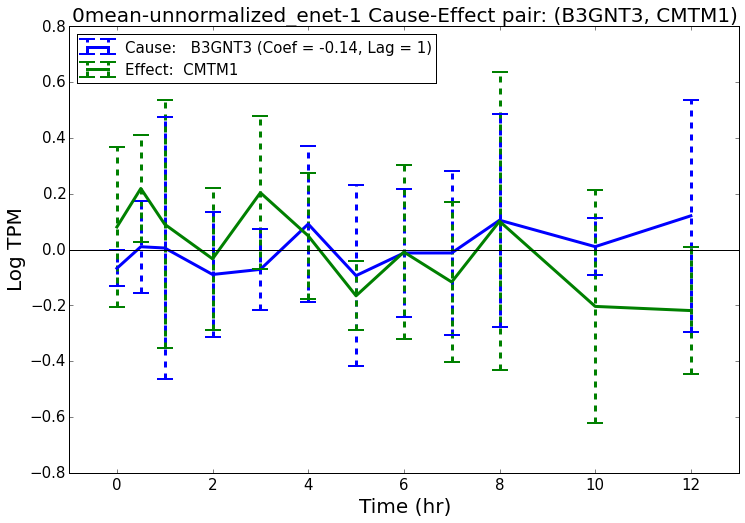

Filename:  analysis/plots/common/any-any/B3GNT3-CMTM1/0mean-unnormalized_enet-1_no-bar-B3GNT3-CMTM1-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-any/B3GNT3-CMTM1/0mean-unnormalized_enet-1_no-bar-B3GNT3-CMTM1-lag-1-coef--1E-01.pdf


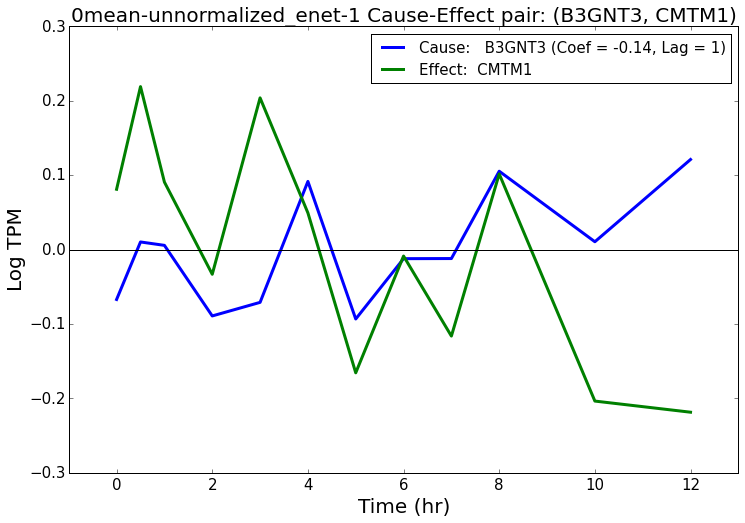

***********************************************
0mean-unnormalized_enet-2
***********************************************
   Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause             Summary: Effect
98             B3GNT3               CMTM1 -0.156944   1.0            NaN  Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/any-any/B3GNT3-CMTM1/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-any/B3GNT3-CMTM1/0mean-unnormalized_enet-2_B3GNT3-CMTM1-lag-2-coef--2E-01.pdf
Plot saved to  analysis/plots/common/any-any/B3GNT3-CMTM1/0mean-unnormalized_enet-2_B3GNT3-CMTM1-lag-2-coef--2E-01.pdf


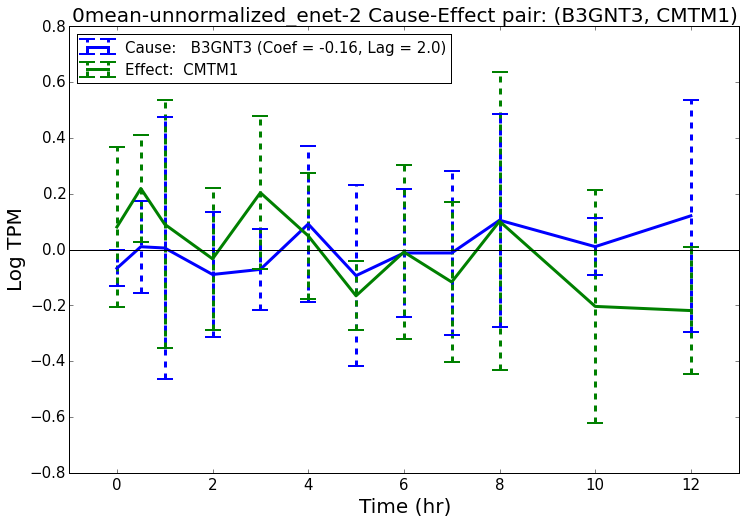

Filename:  analysis/plots/common/any-any/B3GNT3-CMTM1/0mean-unnormalized_enet-2_no-bar-B3GNT3-CMTM1-lag-2-coef--2E-01.pdf
Plot saved to  analysis/plots/common/any-any/B3GNT3-CMTM1/0mean-unnormalized_enet-2_no-bar-B3GNT3-CMTM1-lag-2-coef--2E-01.pdf


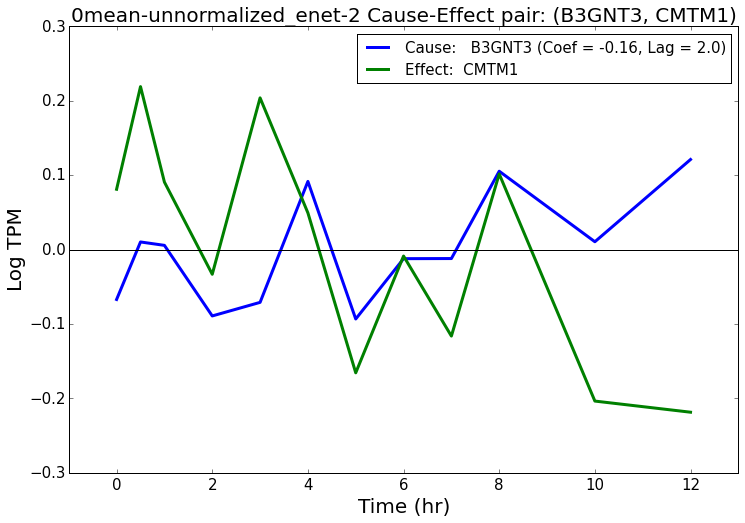

In [65]:
for i, r in plot_df.iterrows():
    print "********************************"
    print r["Gene Symbol: Cause"], r["Gene Symbol: Effect"]
    print "********************************"
    
    
    all_plot_folder = os.path.join(plot_subfolder, "-".join([r["Gene Symbol: Cause"], r["Gene Symbol: Effect"]]))
    
    indices = []
    for j in range(len(names)):
        if r[names[j]] == 1:
            # plot if contains
            indices.append(j)
    
    plot_nets = [nets[ind][nets[ind]["Cause-Effect"] == r["Cause-Effect"]] for ind in indices]
    for p in range(len(plot_nets)):
        plot_nets[p]["Gene Symbol: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_nets[p]["Cause"].values]
        plot_nets[p]["Gene Symbol: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_nets[p]["Effect"].values]
    
    plot_data_hg_df_list = [data_hg_df_list[ind] for ind in indices]
    plot_names = [names[ind] for ind in indices]
    plot_timekeys_list = [timekeys_list[ind] for ind in indices]
    plot_num_per_keys_list = [num_per_keys_list[ind] for ind in indices]
    plot_timepoints_list = [timepoints_list[ind] for ind in indices]
    
    
    do_plot_nets(plot_data_hg_df_list, plot_nets, plot_names, plot_timekeys_list, plot_num_per_keys_list, plot_timepoints_list,
                all_plot_folder=all_plot_folder, include_name_prefix=True, ylabels=ylabels)
    
#     for plot_net, plot_name in zip(plot_nets, plot_names):
#         print plot_name
#         display(plot_net)

# any-TF

In [66]:
plotfoldersuffix = "any-tf"
plot_df = edge_network_df[edge_network_df["Effect"].isin(tf_genes)].head(top_edge_num)

display(plot_df)

plot_subfolder = os.path.join(plot_common_folder, plotfoldersuffix)
if not os.path.exists(plot_subfolder):
    os.makedirs(plot_subfolder)
    
outfile = os.path.join(plot_subfolder, "top_interactions.csv")
plot_df.to_csv(outfile, index=0)

,Cause-Effect,Cause,Effect,Gene Symbol: Cause,Gene Symbol: Effect,Summary: Cause,Summary: Effect,Abs-Avg-Weight,Total,Networks,0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,Weight: 0mean-1var_enet-1,Weight: 0mean-1var_enet-2,Weight: 0mean-unnormalized_enet-1,Weight: 0mean-unnormalized_enet-2
23259,ENSG00000142089.14-ENSG00000106261.15,ENSG00000142089.14,ENSG00000106261.15,IFITM3,ZKSCAN1,"Immune_GOC-5,Immune_GOC-4,","TF-Bioguo,",0.134,4.0,"0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",1,1,1,1,-0.159026,-0.104563,-0.170614,-0.101905
1311,ENSG00000025423.10-ENSG00000176222.8,ENSG00000025423.10,ENSG00000176222.8,HSD17B6,ZNF404,NaN,"TF-Bioguo,",0.098,4.0,"0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",1,1,1,1,-0.070275,-0.114536,-0.075645,-0.132088
23782,ENSG00000142089.14-ENSG00000187187.12,ENSG00000142089.14,ENSG00000187187.12,IFITM3,ZNF546,"Immune_GOC-5,Immune_GOC-4,","TF-Bioguo,",0.097,4.0,"0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",1,1,1,1,-0.128111,-0.087432,-0.086179,-0.085556


********************************
IFITM3 ZKSCAN1
********************************


/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


***********************************************
0mean-1var_enet-1
***********************************************
   Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef              Summary: Cause Summary: Effect
38             IFITM3             ZKSCAN1 -0.159026     1  Immune_GOC-5,Immune_GOC-4,      TF-Bioguo,
Written to  analysis/plots/common/any-tf/IFITM3-ZKSCAN1/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-tf/IFITM3-ZKSCAN1/0mean-1var_enet-1_IFITM3-ZKSCAN1-lag-1-coef--2E-01.pdf
Plot saved to  analysis/plots/common/any-tf/IFITM3-ZKSCAN1/0mean-1var_enet-1_IFITM3-ZKSCAN1-lag-1-coef--2E-01.pdf


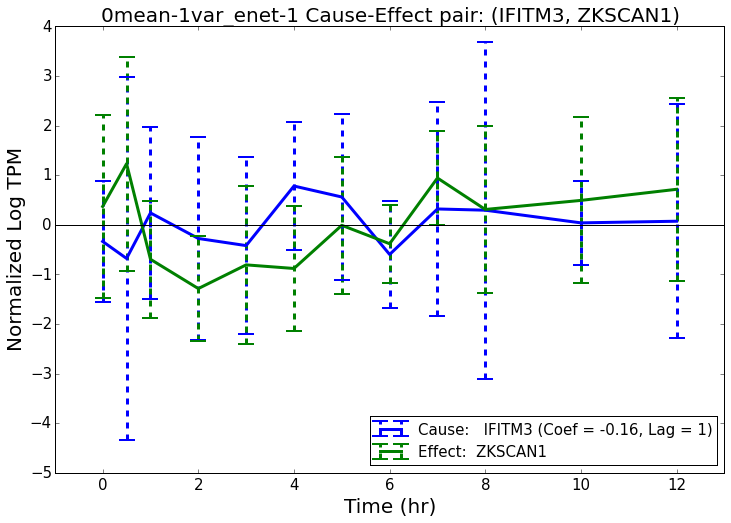

Filename:  analysis/plots/common/any-tf/IFITM3-ZKSCAN1/0mean-1var_enet-1_no-bar-IFITM3-ZKSCAN1-lag-1-coef--2E-01.pdf
Plot saved to  analysis/plots/common/any-tf/IFITM3-ZKSCAN1/0mean-1var_enet-1_no-bar-IFITM3-ZKSCAN1-lag-1-coef--2E-01.pdf


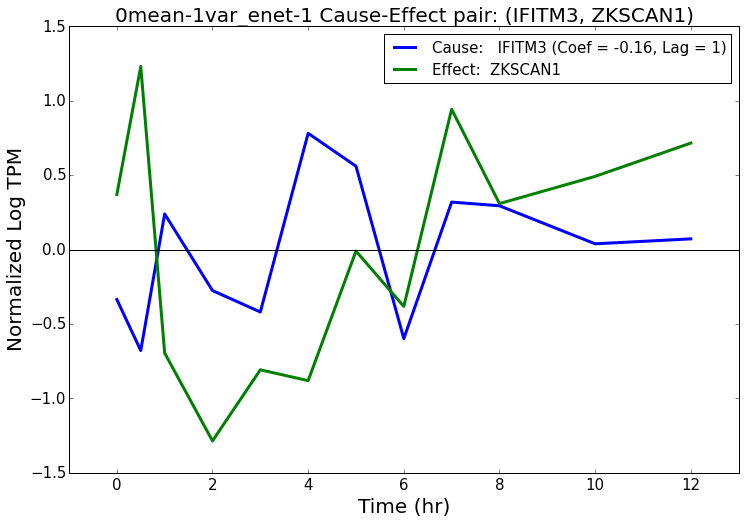

***********************************************
0mean-1var_enet-2
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef              Summary: Cause Summary: Effect
220             IFITM3             ZKSCAN1 -0.104563   1.0  Immune_GOC-5,Immune_GOC-4,      TF-Bioguo,
Written to  analysis/plots/common/any-tf/IFITM3-ZKSCAN1/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-tf/IFITM3-ZKSCAN1/0mean-1var_enet-2_IFITM3-ZKSCAN1-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-tf/IFITM3-ZKSCAN1/0mean-1var_enet-2_IFITM3-ZKSCAN1-lag-2-coef--1E-01.pdf


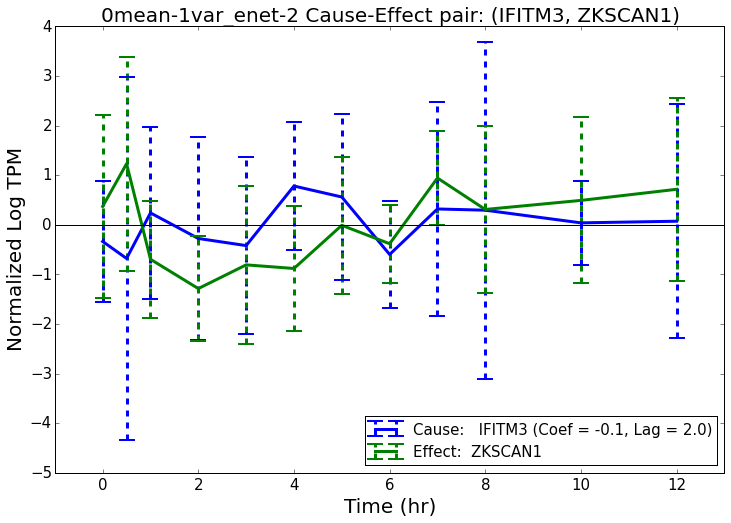

Filename:  analysis/plots/common/any-tf/IFITM3-ZKSCAN1/0mean-1var_enet-2_no-bar-IFITM3-ZKSCAN1-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-tf/IFITM3-ZKSCAN1/0mean-1var_enet-2_no-bar-IFITM3-ZKSCAN1-lag-2-coef--1E-01.pdf


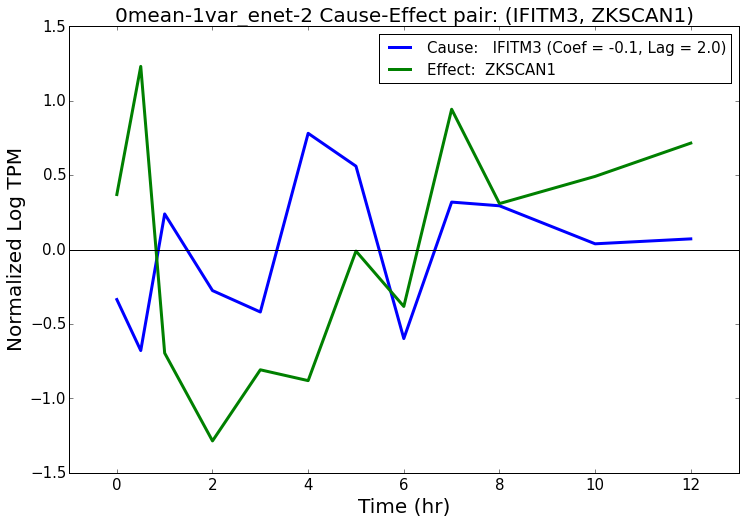

***********************************************
0mean-unnormalized_enet-1
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef              Summary: Cause Summary: Effect
362             IFITM3             ZKSCAN1 -0.170614     1  Immune_GOC-5,Immune_GOC-4,      TF-Bioguo,
Written to  analysis/plots/common/any-tf/IFITM3-ZKSCAN1/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-tf/IFITM3-ZKSCAN1/0mean-unnormalized_enet-1_IFITM3-ZKSCAN1-lag-1-coef--2E-01.pdf
Plot saved to  analysis/plots/common/any-tf/IFITM3-ZKSCAN1/0mean-unnormalized_enet-1_IFITM3-ZKSCAN1-lag-1-coef--2E-01.pdf


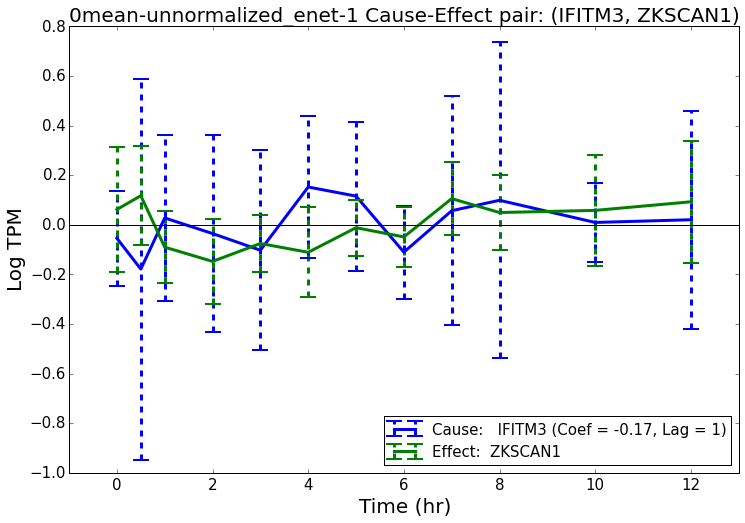

Filename:  analysis/plots/common/any-tf/IFITM3-ZKSCAN1/0mean-unnormalized_enet-1_no-bar-IFITM3-ZKSCAN1-lag-1-coef--2E-01.pdf
Plot saved to  analysis/plots/common/any-tf/IFITM3-ZKSCAN1/0mean-unnormalized_enet-1_no-bar-IFITM3-ZKSCAN1-lag-1-coef--2E-01.pdf


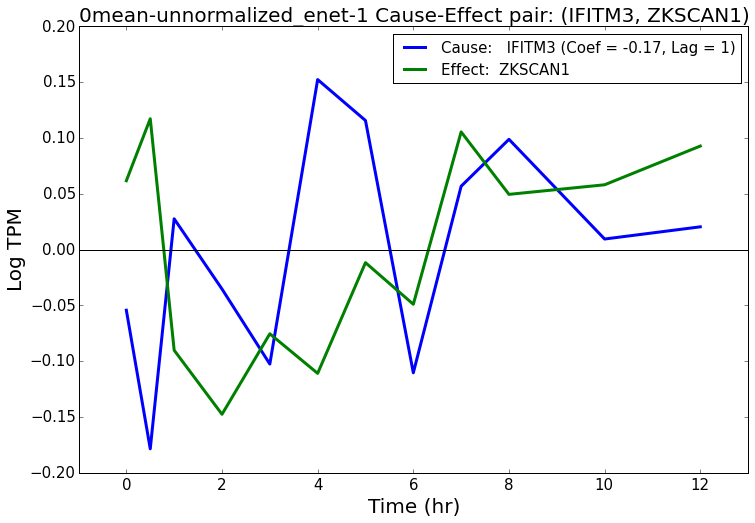

***********************************************
0mean-unnormalized_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef              Summary: Cause Summary: Effect
1226             IFITM3             ZKSCAN1 -0.101905   1.0  Immune_GOC-5,Immune_GOC-4,      TF-Bioguo,
Written to  analysis/plots/common/any-tf/IFITM3-ZKSCAN1/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-tf/IFITM3-ZKSCAN1/0mean-unnormalized_enet-2_IFITM3-ZKSCAN1-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-tf/IFITM3-ZKSCAN1/0mean-unnormalized_enet-2_IFITM3-ZKSCAN1-lag-2-coef--1E-01.pdf


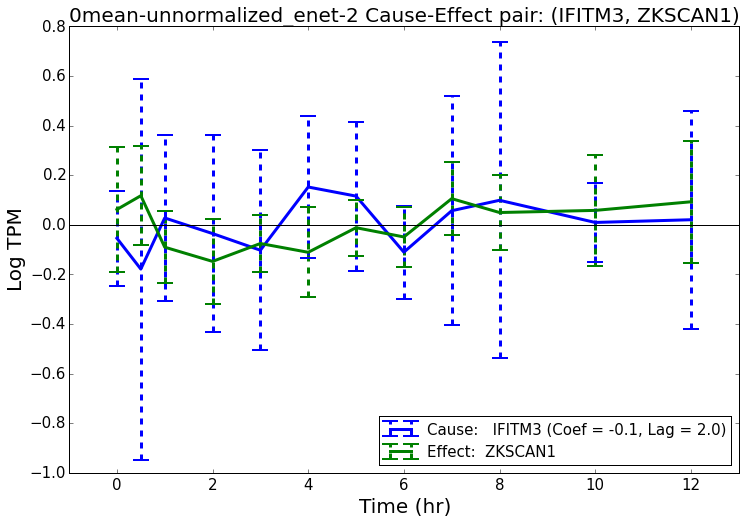

Filename:  analysis/plots/common/any-tf/IFITM3-ZKSCAN1/0mean-unnormalized_enet-2_no-bar-IFITM3-ZKSCAN1-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-tf/IFITM3-ZKSCAN1/0mean-unnormalized_enet-2_no-bar-IFITM3-ZKSCAN1-lag-2-coef--1E-01.pdf


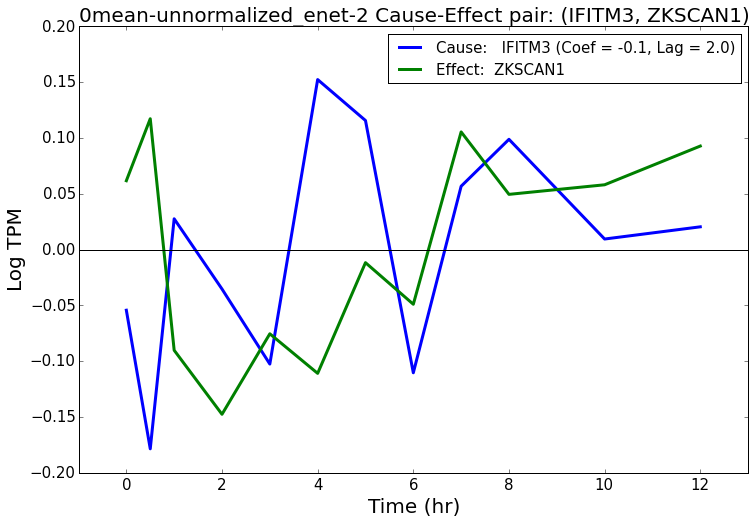

********************************
HSD17B6 ZNF404
********************************
***********************************************
0mean-1var_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
8211            HSD17B6              ZNF404 -0.070275     1            NaN      TF-Bioguo,
Written to  analysis/plots/common/any-tf/HSD17B6-ZNF404/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-tf/HSD17B6-ZNF404/0mean-1var_enet-1_HSD17B6-ZNF404-lag-1-coef--7E-02.pdf
Plot saved to  analysis/plots/common/any-tf/HSD17B6-ZNF404/0mean-1var_enet-1_HSD17B6-ZNF404-lag-1-coef--7E-02.pdf


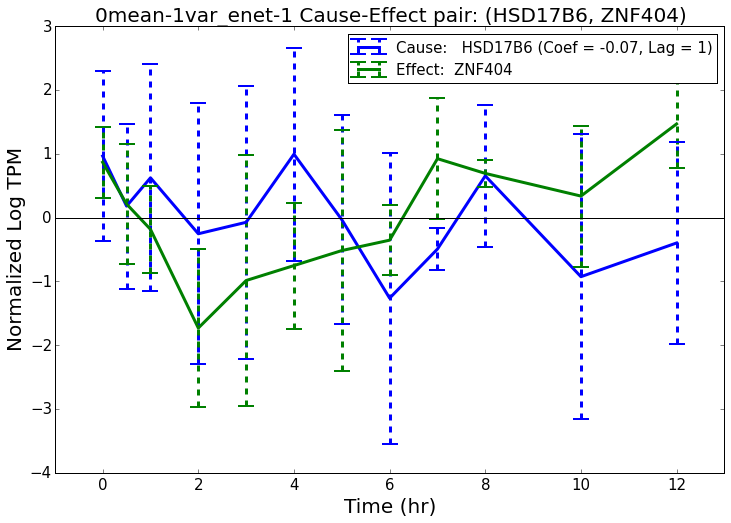

Filename:  analysis/plots/common/any-tf/HSD17B6-ZNF404/0mean-1var_enet-1_no-bar-HSD17B6-ZNF404-lag-1-coef--7E-02.pdf
Plot saved to  analysis/plots/common/any-tf/HSD17B6-ZNF404/0mean-1var_enet-1_no-bar-HSD17B6-ZNF404-lag-1-coef--7E-02.pdf


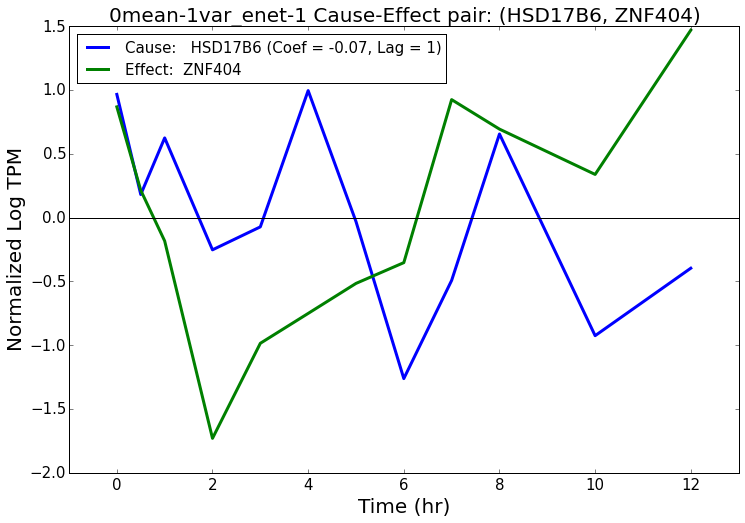

***********************************************
0mean-1var_enet-2
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
101            HSD17B6              ZNF404 -0.114536   1.0            NaN      TF-Bioguo,
Written to  analysis/plots/common/any-tf/HSD17B6-ZNF404/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-tf/HSD17B6-ZNF404/0mean-1var_enet-2_HSD17B6-ZNF404-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-tf/HSD17B6-ZNF404/0mean-1var_enet-2_HSD17B6-ZNF404-lag-2-coef--1E-01.pdf


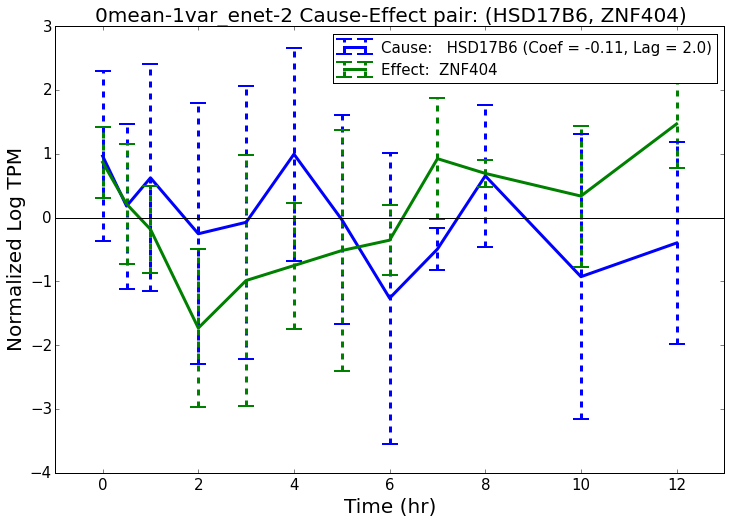

Filename:  analysis/plots/common/any-tf/HSD17B6-ZNF404/0mean-1var_enet-2_no-bar-HSD17B6-ZNF404-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-tf/HSD17B6-ZNF404/0mean-1var_enet-2_no-bar-HSD17B6-ZNF404-lag-2-coef--1E-01.pdf


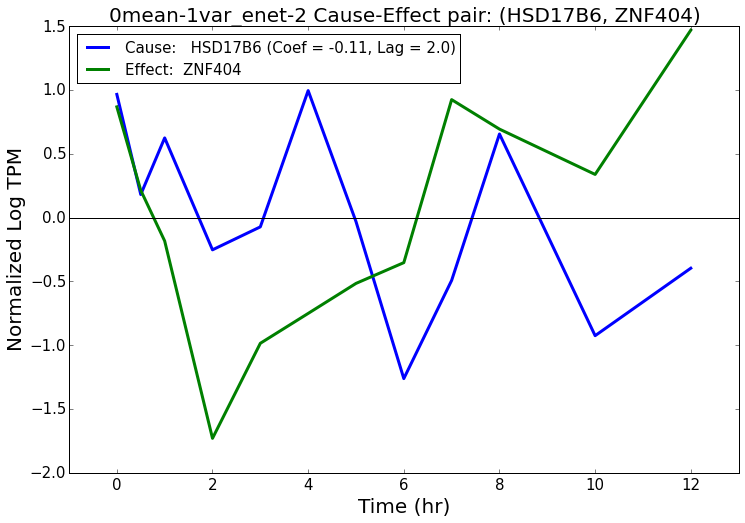

***********************************************
0mean-unnormalized_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
8803            HSD17B6              ZNF404 -0.075645     1            NaN      TF-Bioguo,
Written to  analysis/plots/common/any-tf/HSD17B6-ZNF404/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-tf/HSD17B6-ZNF404/0mean-unnormalized_enet-1_HSD17B6-ZNF404-lag-1-coef--8E-02.pdf
Plot saved to  analysis/plots/common/any-tf/HSD17B6-ZNF404/0mean-unnormalized_enet-1_HSD17B6-ZNF404-lag-1-coef--8E-02.pdf


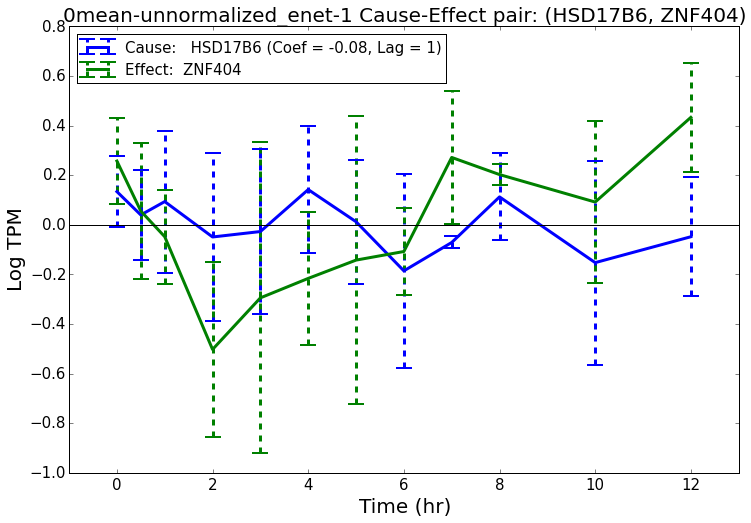

Filename:  analysis/plots/common/any-tf/HSD17B6-ZNF404/0mean-unnormalized_enet-1_no-bar-HSD17B6-ZNF404-lag-1-coef--8E-02.pdf
Plot saved to  analysis/plots/common/any-tf/HSD17B6-ZNF404/0mean-unnormalized_enet-1_no-bar-HSD17B6-ZNF404-lag-1-coef--8E-02.pdf


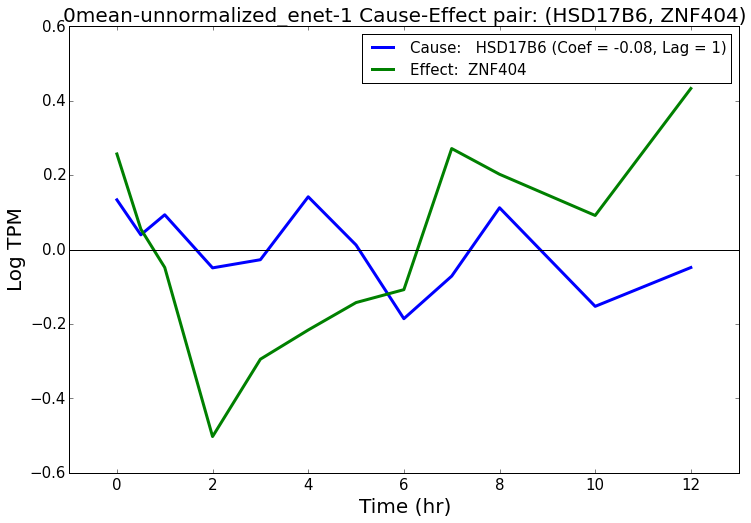

***********************************************
0mean-unnormalized_enet-2
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
290            HSD17B6              ZNF404 -0.132088   1.0            NaN      TF-Bioguo,
Written to  analysis/plots/common/any-tf/HSD17B6-ZNF404/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-tf/HSD17B6-ZNF404/0mean-unnormalized_enet-2_HSD17B6-ZNF404-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-tf/HSD17B6-ZNF404/0mean-unnormalized_enet-2_HSD17B6-ZNF404-lag-2-coef--1E-01.pdf


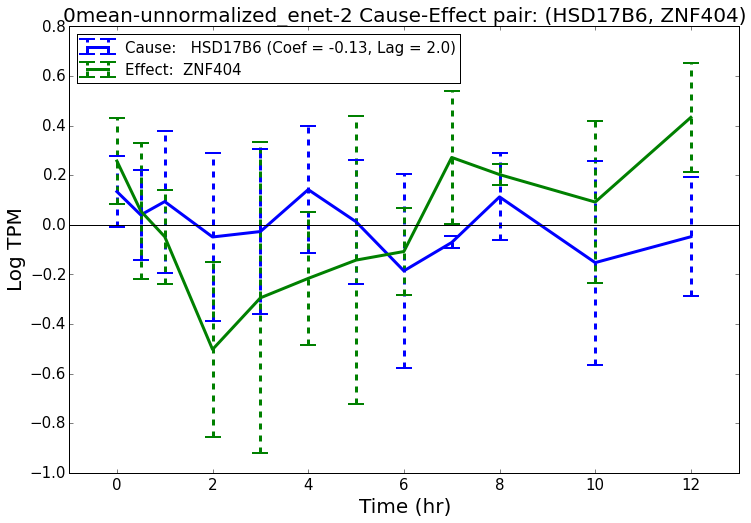

Filename:  analysis/plots/common/any-tf/HSD17B6-ZNF404/0mean-unnormalized_enet-2_no-bar-HSD17B6-ZNF404-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-tf/HSD17B6-ZNF404/0mean-unnormalized_enet-2_no-bar-HSD17B6-ZNF404-lag-2-coef--1E-01.pdf


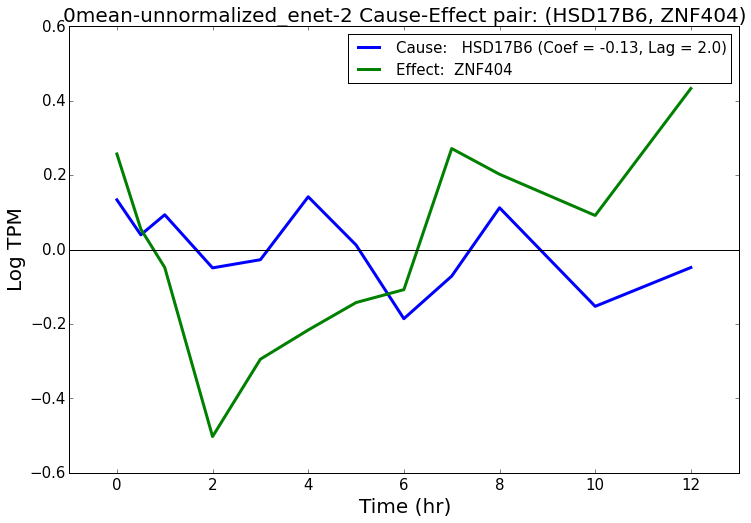

********************************
IFITM3 ZNF546
********************************
***********************************************
0mean-1var_enet-1
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef              Summary: Cause Summary: Effect
344             IFITM3              ZNF546 -0.128111     1  Immune_GOC-5,Immune_GOC-4,      TF-Bioguo,
Written to  analysis/plots/common/any-tf/IFITM3-ZNF546/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-tf/IFITM3-ZNF546/0mean-1var_enet-1_IFITM3-ZNF546-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-tf/IFITM3-ZNF546/0mean-1var_enet-1_IFITM3-ZNF546-lag-1-coef--1E-01.pdf


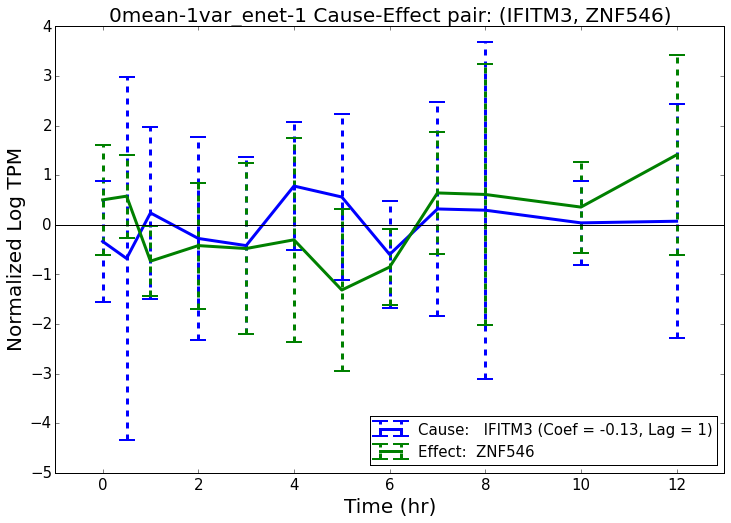

Filename:  analysis/plots/common/any-tf/IFITM3-ZNF546/0mean-1var_enet-1_no-bar-IFITM3-ZNF546-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-tf/IFITM3-ZNF546/0mean-1var_enet-1_no-bar-IFITM3-ZNF546-lag-1-coef--1E-01.pdf


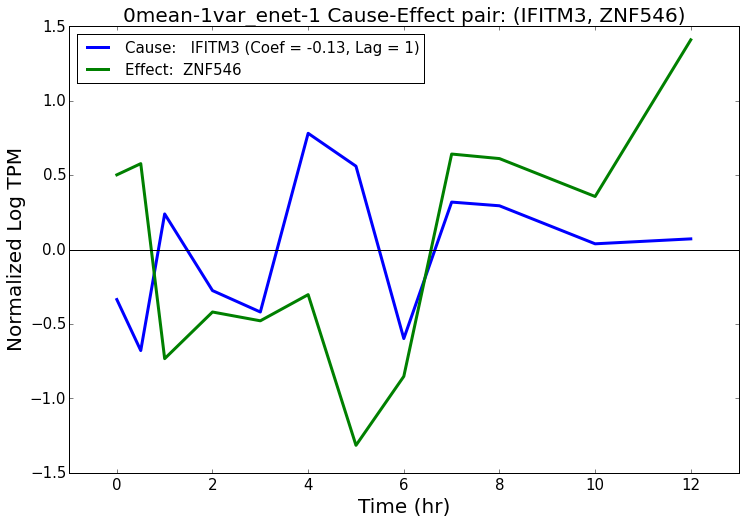

***********************************************
0mean-1var_enet-2
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef              Summary: Cause Summary: Effect
864             IFITM3              ZNF546 -0.087432   1.0  Immune_GOC-5,Immune_GOC-4,      TF-Bioguo,
Written to  analysis/plots/common/any-tf/IFITM3-ZNF546/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-tf/IFITM3-ZNF546/0mean-1var_enet-2_IFITM3-ZNF546-lag-2-coef--9E-02.pdf
Plot saved to  analysis/plots/common/any-tf/IFITM3-ZNF546/0mean-1var_enet-2_IFITM3-ZNF546-lag-2-coef--9E-02.pdf


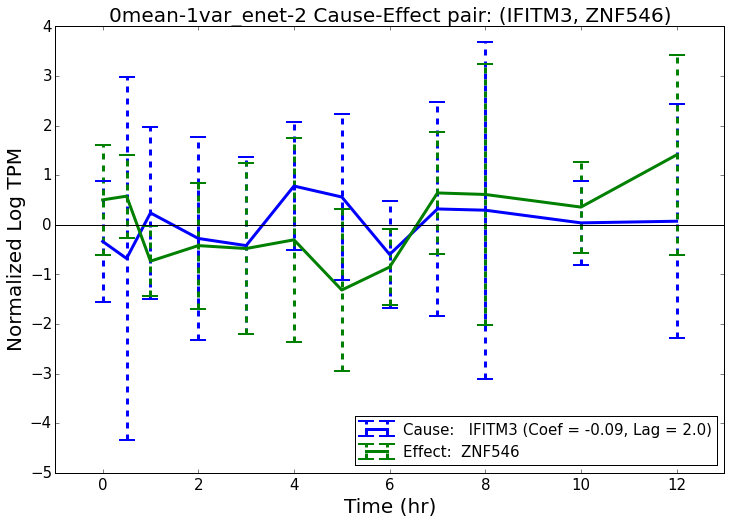

Filename:  analysis/plots/common/any-tf/IFITM3-ZNF546/0mean-1var_enet-2_no-bar-IFITM3-ZNF546-lag-2-coef--9E-02.pdf
Plot saved to  analysis/plots/common/any-tf/IFITM3-ZNF546/0mean-1var_enet-2_no-bar-IFITM3-ZNF546-lag-2-coef--9E-02.pdf


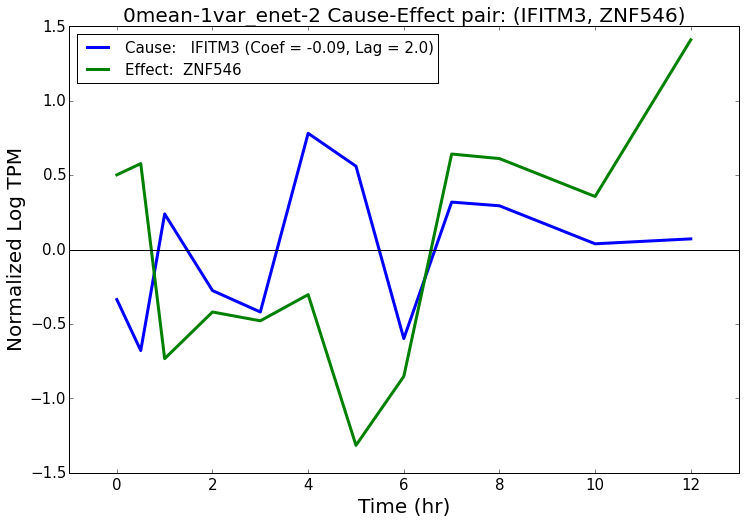

***********************************************
0mean-unnormalized_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef              Summary: Cause Summary: Effect
6233             IFITM3              ZNF546 -0.086179     1  Immune_GOC-5,Immune_GOC-4,      TF-Bioguo,
Written to  analysis/plots/common/any-tf/IFITM3-ZNF546/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-tf/IFITM3-ZNF546/0mean-unnormalized_enet-1_IFITM3-ZNF546-lag-1-coef--9E-02.pdf
Plot saved to  analysis/plots/common/any-tf/IFITM3-ZNF546/0mean-unnormalized_enet-1_IFITM3-ZNF546-lag-1-coef--9E-02.pdf


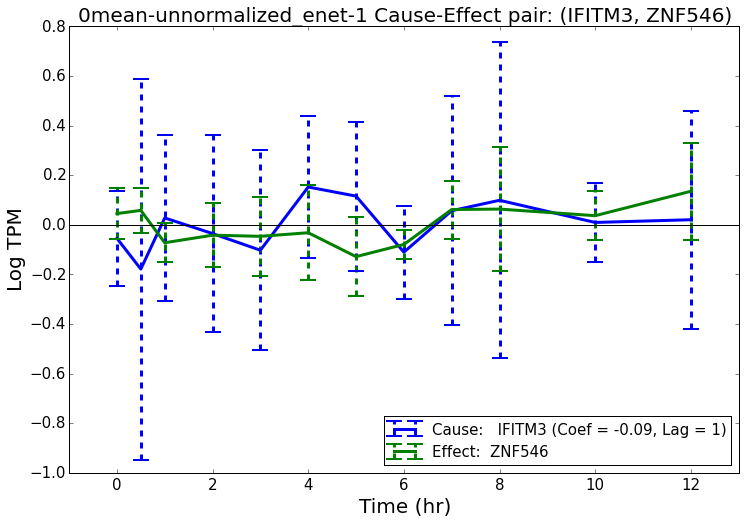

Filename:  analysis/plots/common/any-tf/IFITM3-ZNF546/0mean-unnormalized_enet-1_no-bar-IFITM3-ZNF546-lag-1-coef--9E-02.pdf
Plot saved to  analysis/plots/common/any-tf/IFITM3-ZNF546/0mean-unnormalized_enet-1_no-bar-IFITM3-ZNF546-lag-1-coef--9E-02.pdf


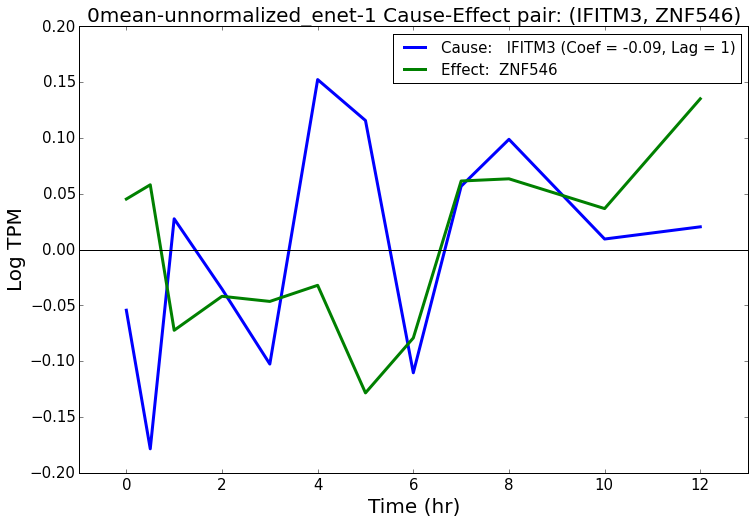

***********************************************
0mean-unnormalized_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef              Summary: Cause Summary: Effect
2715             IFITM3              ZNF546 -0.085556   1.0  Immune_GOC-5,Immune_GOC-4,      TF-Bioguo,
Written to  analysis/plots/common/any-tf/IFITM3-ZNF546/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-tf/IFITM3-ZNF546/0mean-unnormalized_enet-2_IFITM3-ZNF546-lag-2-coef--9E-02.pdf
Plot saved to  analysis/plots/common/any-tf/IFITM3-ZNF546/0mean-unnormalized_enet-2_IFITM3-ZNF546-lag-2-coef--9E-02.pdf


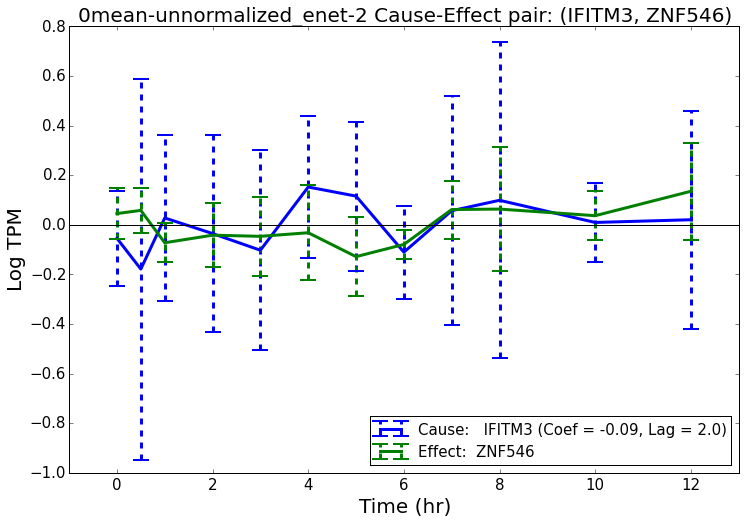

Filename:  analysis/plots/common/any-tf/IFITM3-ZNF546/0mean-unnormalized_enet-2_no-bar-IFITM3-ZNF546-lag-2-coef--9E-02.pdf
Plot saved to  analysis/plots/common/any-tf/IFITM3-ZNF546/0mean-unnormalized_enet-2_no-bar-IFITM3-ZNF546-lag-2-coef--9E-02.pdf


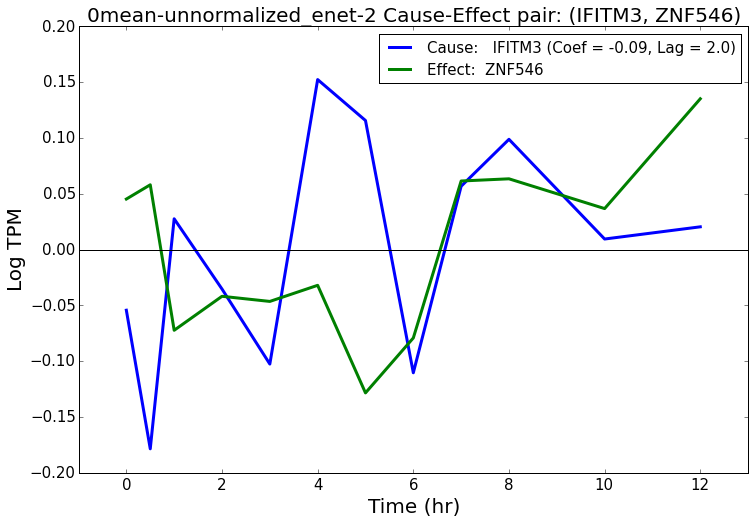

In [67]:
for i, r in plot_df.iterrows():
    print "********************************"
    print r["Gene Symbol: Cause"], r["Gene Symbol: Effect"]
    print "********************************"
    
    
    all_plot_folder = os.path.join(plot_subfolder, "-".join([r["Gene Symbol: Cause"], r["Gene Symbol: Effect"]]))
    
    indices = []
    for j in range(len(names)):
        if r[names[j]] == 1:
            # plot if contains
            indices.append(j)
    
    plot_nets = [nets[ind][nets[ind]["Cause-Effect"] == r["Cause-Effect"]] for ind in indices]
    for p in range(len(plot_nets)):
        plot_nets[p]["Gene Symbol: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_nets[p]["Cause"].values]
        plot_nets[p]["Gene Symbol: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_nets[p]["Effect"].values]
    
    plot_data_hg_df_list = [data_hg_df_list[ind] for ind in indices]
    plot_names = [names[ind] for ind in indices]
    plot_timekeys_list = [timekeys_list[ind] for ind in indices]
    plot_num_per_keys_list = [num_per_keys_list[ind] for ind in indices]
    plot_timepoints_list = [timepoints_list[ind] for ind in indices]
    
    
    do_plot_nets(plot_data_hg_df_list, plot_nets, plot_names, plot_timekeys_list, plot_num_per_keys_list, plot_timepoints_list,
                all_plot_folder=all_plot_folder, include_name_prefix=True, ylabels=ylabels)
    
#     for plot_net, plot_name in zip(plot_nets, plot_names):
#         print plot_name
#         display(plot_net)

# any-imm

In [68]:
plotfoldersuffix = "any-imm"
plot_df = edge_network_df[edge_network_df["Effect"].isin(imm_genes)].head(top_edge_num)

display(plot_df)

plot_subfolder = os.path.join(plot_common_folder, plotfoldersuffix)
if not os.path.exists(plot_subfolder):
    os.makedirs(plot_subfolder)
    
outfile = os.path.join(plot_subfolder, "top_interactions.csv")
plot_df.to_csv(outfile, index=0)

,Cause-Effect,Cause,Effect,Gene Symbol: Cause,Gene Symbol: Effect,Summary: Cause,Summary: Effect,Abs-Avg-Weight,Total,Networks,0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,Weight: 0mean-1var_enet-1,Weight: 0mean-1var_enet-2,Weight: 0mean-unnormalized_enet-1,Weight: 0mean-unnormalized_enet-2
23308,ENSG00000142089.14-ENSG00000115232.12,ENSG00000142089.14,ENSG00000115232.12,IFITM3,ITGA4,"Immune_GOC-5,Immune_GOC-4,","Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,",0.107,4.0,"0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",1,1,1,1,-0.125573,-0.127261,-0.076310,-0.097678
23507,ENSG00000142089.14-ENSG00000146648.14,ENSG00000142089.14,ENSG00000146648.14,IFITM3,EGFR,"Immune_GOC-5,Immune_GOC-4,","Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,",0.104,4.0,"0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",1,1,1,1,-0.125299,-0.087088,-0.119156,-0.084460
48612,ENSG00000185267.8-ENSG00000116815.14,ENSG00000185267.8,ENSG00000116815.14,CDNF,CD58,NaN,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,",0.099,4.0,"0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",1,1,1,1,-0.120990,-0.098648,-0.080152,-0.096048


********************************
IFITM3 ITGA4
********************************


/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


***********************************************
0mean-1var_enet-1
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef              Summary: Cause                                                    Summary: Effect
415             IFITM3               ITGA4 -0.125573     1  Immune_GOC-5,Immune_GOC-4,  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/any-imm/IFITM3-ITGA4/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-imm/IFITM3-ITGA4/0mean-1var_enet-1_IFITM3-ITGA4-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-imm/IFITM3-ITGA4/0mean-1var_enet-1_IFITM3-ITGA4-lag-1-coef--1E-01.pdf


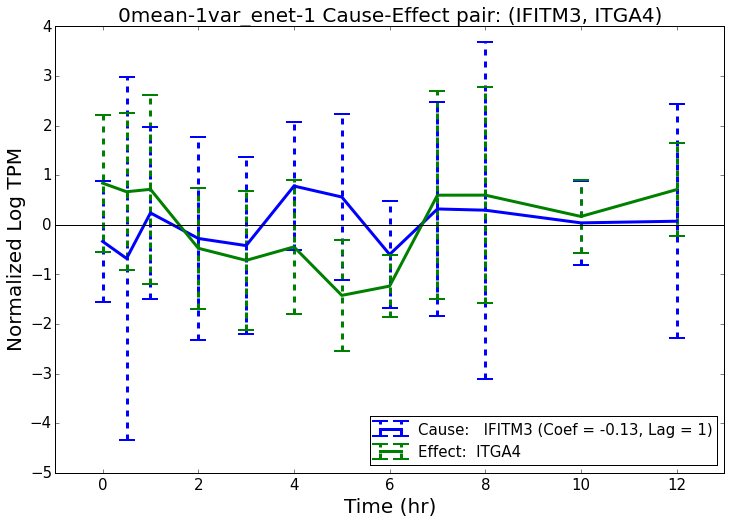

Filename:  analysis/plots/common/any-imm/IFITM3-ITGA4/0mean-1var_enet-1_no-bar-IFITM3-ITGA4-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-imm/IFITM3-ITGA4/0mean-1var_enet-1_no-bar-IFITM3-ITGA4-lag-1-coef--1E-01.pdf


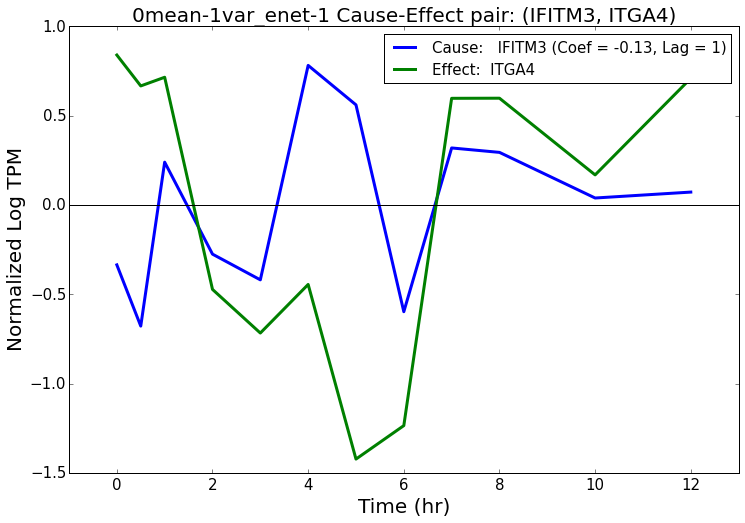

***********************************************
0mean-1var_enet-2
***********************************************
   Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef              Summary: Cause                                                    Summary: Effect
30             IFITM3               ITGA4 -0.127261   1.0  Immune_GOC-5,Immune_GOC-4,  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/any-imm/IFITM3-ITGA4/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-imm/IFITM3-ITGA4/0mean-1var_enet-2_IFITM3-ITGA4-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-imm/IFITM3-ITGA4/0mean-1var_enet-2_IFITM3-ITGA4-lag-2-coef--1E-01.pdf


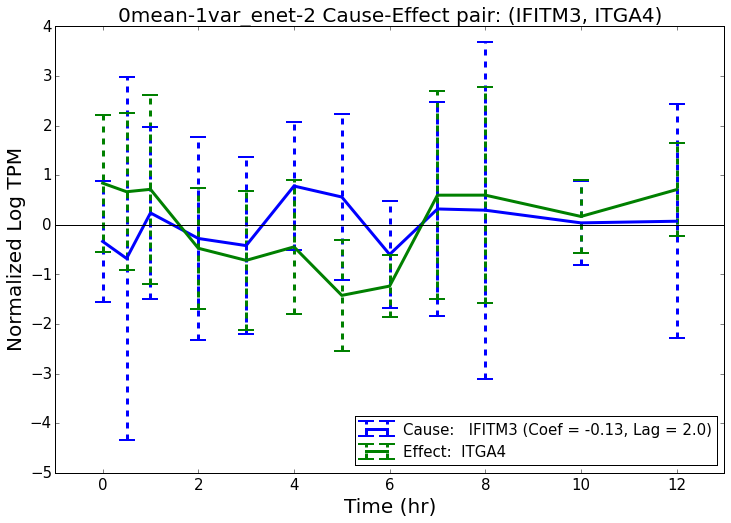

Filename:  analysis/plots/common/any-imm/IFITM3-ITGA4/0mean-1var_enet-2_no-bar-IFITM3-ITGA4-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-imm/IFITM3-ITGA4/0mean-1var_enet-2_no-bar-IFITM3-ITGA4-lag-2-coef--1E-01.pdf


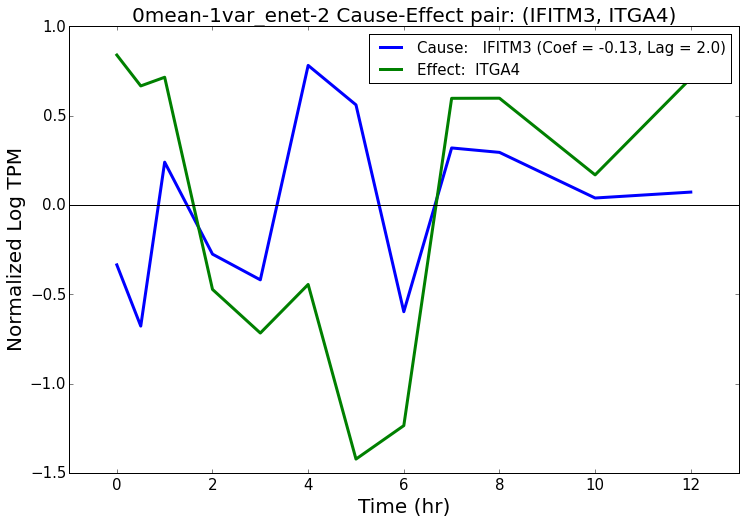

***********************************************
0mean-unnormalized_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect   Weight  Coef              Summary: Cause                                                    Summary: Effect
8624             IFITM3               ITGA4 -0.07631     1  Immune_GOC-5,Immune_GOC-4,  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/any-imm/IFITM3-ITGA4/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-imm/IFITM3-ITGA4/0mean-unnormalized_enet-1_IFITM3-ITGA4-lag-1-coef--8E-02.pdf
Plot saved to  analysis/plots/common/any-imm/IFITM3-ITGA4/0mean-unnormalized_enet-1_IFITM3-ITGA4-lag-1-coef--8E-02.pdf


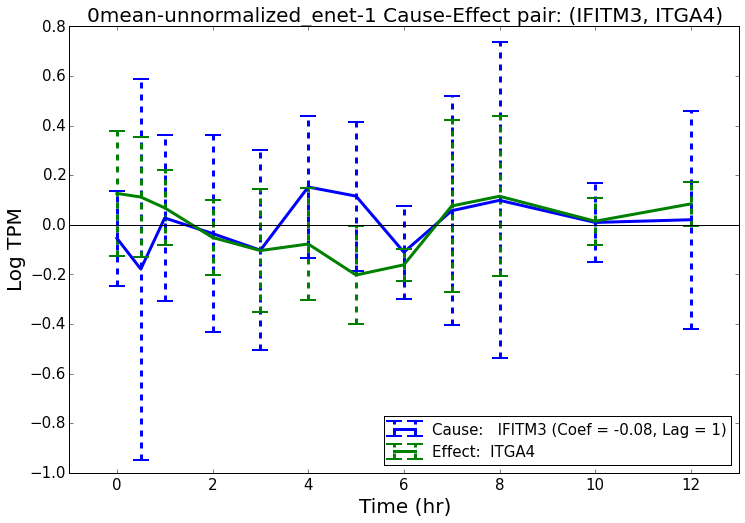

Filename:  analysis/plots/common/any-imm/IFITM3-ITGA4/0mean-unnormalized_enet-1_no-bar-IFITM3-ITGA4-lag-1-coef--8E-02.pdf
Plot saved to  analysis/plots/common/any-imm/IFITM3-ITGA4/0mean-unnormalized_enet-1_no-bar-IFITM3-ITGA4-lag-1-coef--8E-02.pdf


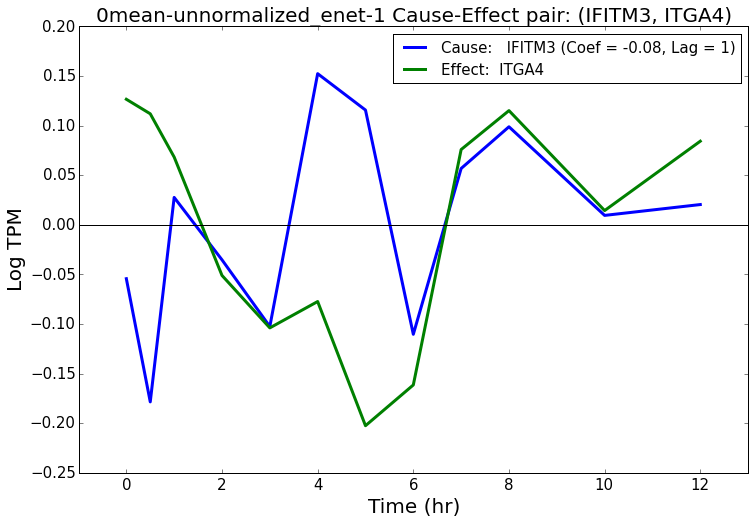

***********************************************
0mean-unnormalized_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef              Summary: Cause                                                    Summary: Effect
1511             IFITM3               ITGA4 -0.097678   1.0  Immune_GOC-5,Immune_GOC-4,  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/any-imm/IFITM3-ITGA4/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-imm/IFITM3-ITGA4/0mean-unnormalized_enet-2_IFITM3-ITGA4-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-imm/IFITM3-ITGA4/0mean-unnormalized_enet-2_IFITM3-ITGA4-lag-2-coef--1E-01.pdf


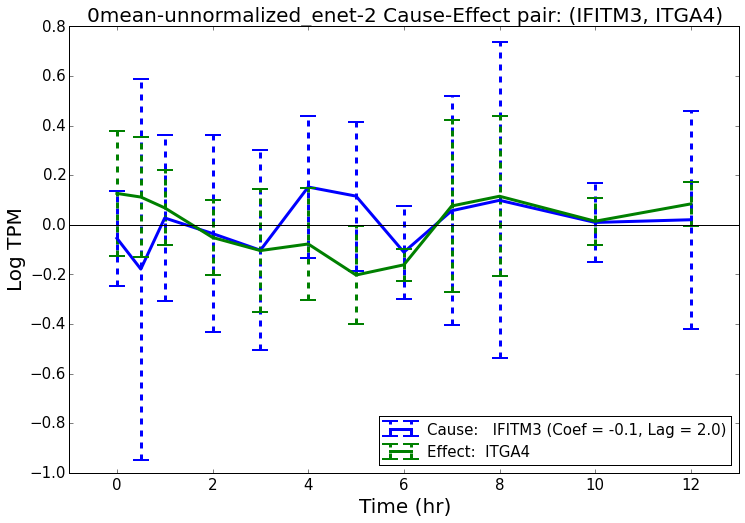

Filename:  analysis/plots/common/any-imm/IFITM3-ITGA4/0mean-unnormalized_enet-2_no-bar-IFITM3-ITGA4-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-imm/IFITM3-ITGA4/0mean-unnormalized_enet-2_no-bar-IFITM3-ITGA4-lag-2-coef--1E-01.pdf


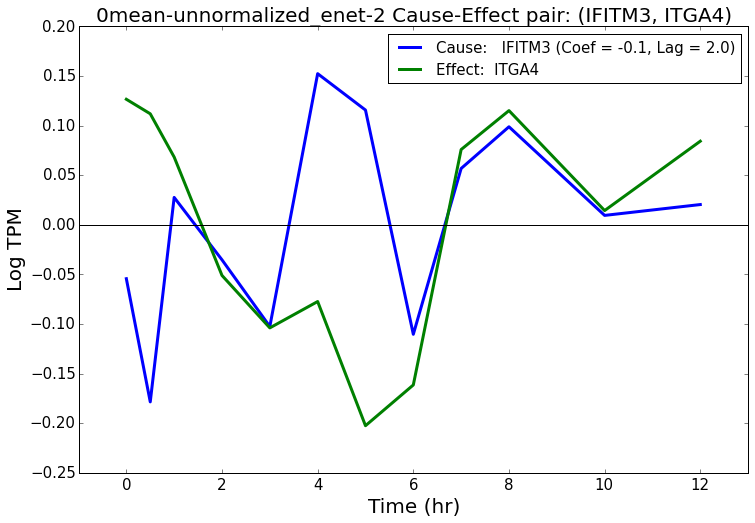

********************************
IFITM3 EGFR
********************************
***********************************************
0mean-1var_enet-1
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef              Summary: Cause                                       Summary: Effect
426             IFITM3                EGFR -0.125299     1  Immune_GOC-5,Immune_GOC-4,  Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/any-imm/IFITM3-EGFR/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-imm/IFITM3-EGFR/0mean-1var_enet-1_IFITM3-EGFR-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-imm/IFITM3-EGFR/0mean-1var_enet-1_IFITM3-EGFR-lag-1-coef--1E-01.pdf


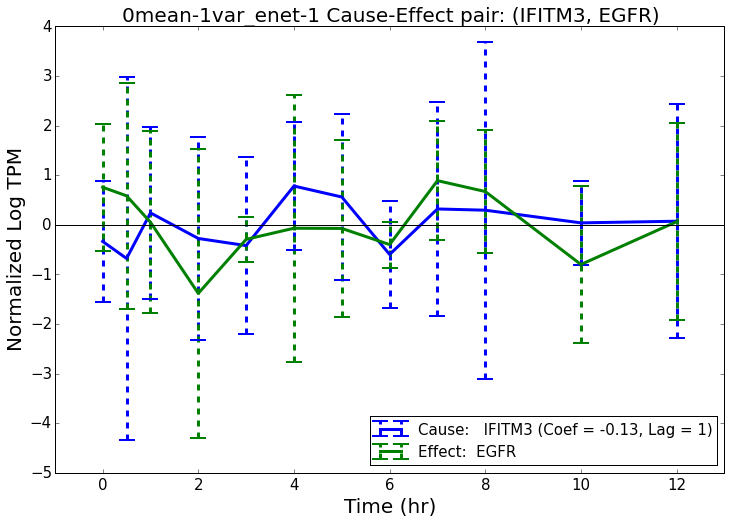

Filename:  analysis/plots/common/any-imm/IFITM3-EGFR/0mean-1var_enet-1_no-bar-IFITM3-EGFR-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-imm/IFITM3-EGFR/0mean-1var_enet-1_no-bar-IFITM3-EGFR-lag-1-coef--1E-01.pdf


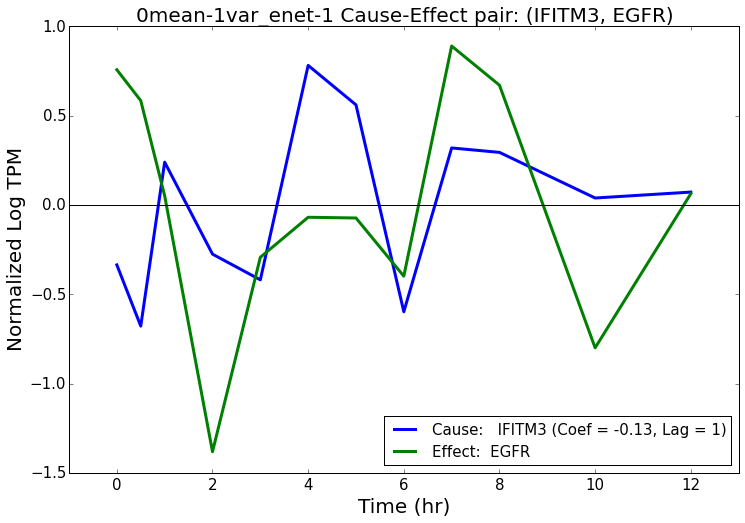

***********************************************
0mean-1var_enet-2
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef              Summary: Cause                                       Summary: Effect
884             IFITM3                EGFR -0.087088   1.0  Immune_GOC-5,Immune_GOC-4,  Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/any-imm/IFITM3-EGFR/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-imm/IFITM3-EGFR/0mean-1var_enet-2_IFITM3-EGFR-lag-2-coef--9E-02.pdf
Plot saved to  analysis/plots/common/any-imm/IFITM3-EGFR/0mean-1var_enet-2_IFITM3-EGFR-lag-2-coef--9E-02.pdf


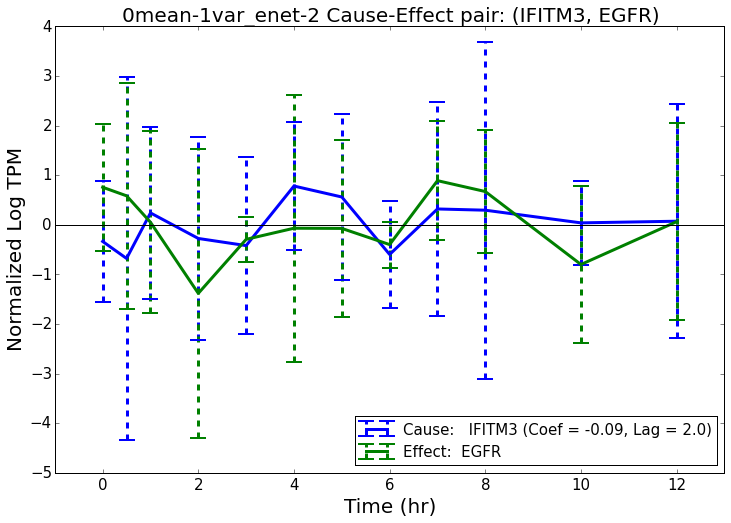

Filename:  analysis/plots/common/any-imm/IFITM3-EGFR/0mean-1var_enet-2_no-bar-IFITM3-EGFR-lag-2-coef--9E-02.pdf
Plot saved to  analysis/plots/common/any-imm/IFITM3-EGFR/0mean-1var_enet-2_no-bar-IFITM3-EGFR-lag-2-coef--9E-02.pdf


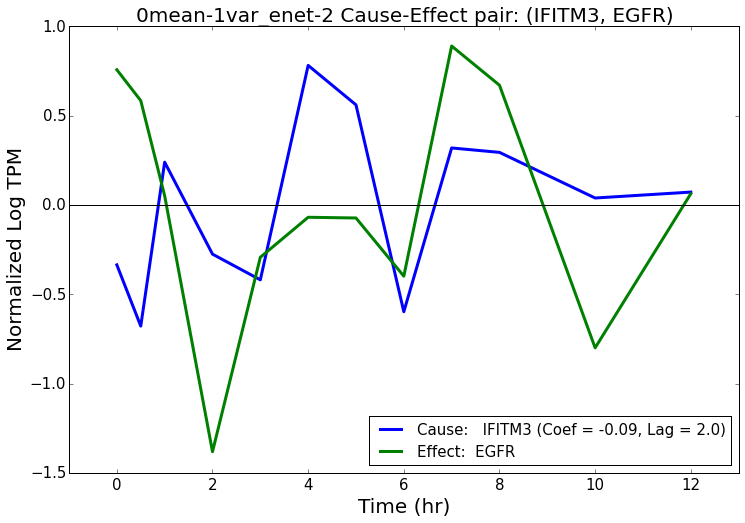

***********************************************
0mean-unnormalized_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef              Summary: Cause                                       Summary: Effect
2076             IFITM3                EGFR -0.119156     1  Immune_GOC-5,Immune_GOC-4,  Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/any-imm/IFITM3-EGFR/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-imm/IFITM3-EGFR/0mean-unnormalized_enet-1_IFITM3-EGFR-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-imm/IFITM3-EGFR/0mean-unnormalized_enet-1_IFITM3-EGFR-lag-1-coef--1E-01.pdf


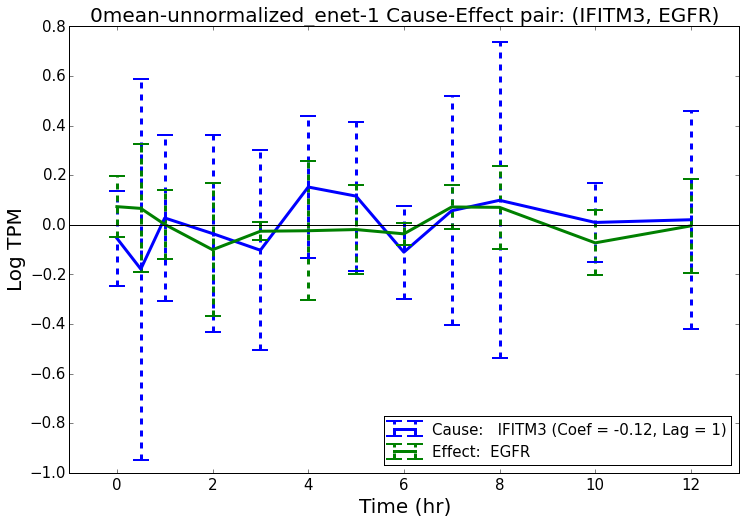

Filename:  analysis/plots/common/any-imm/IFITM3-EGFR/0mean-unnormalized_enet-1_no-bar-IFITM3-EGFR-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-imm/IFITM3-EGFR/0mean-unnormalized_enet-1_no-bar-IFITM3-EGFR-lag-1-coef--1E-01.pdf


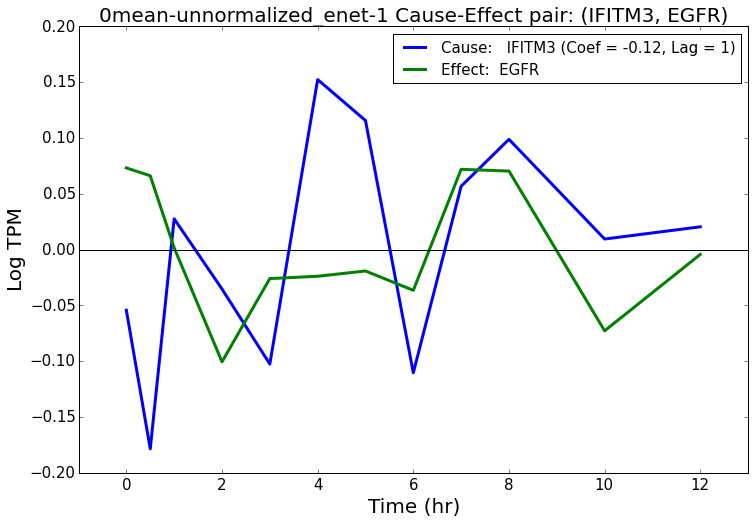

***********************************************
0mean-unnormalized_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect   Weight  Coef              Summary: Cause                                       Summary: Effect
2865             IFITM3                EGFR -0.08446   1.0  Immune_GOC-5,Immune_GOC-4,  Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/any-imm/IFITM3-EGFR/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-imm/IFITM3-EGFR/0mean-unnormalized_enet-2_IFITM3-EGFR-lag-2-coef--8E-02.pdf
Plot saved to  analysis/plots/common/any-imm/IFITM3-EGFR/0mean-unnormalized_enet-2_IFITM3-EGFR-lag-2-coef--8E-02.pdf


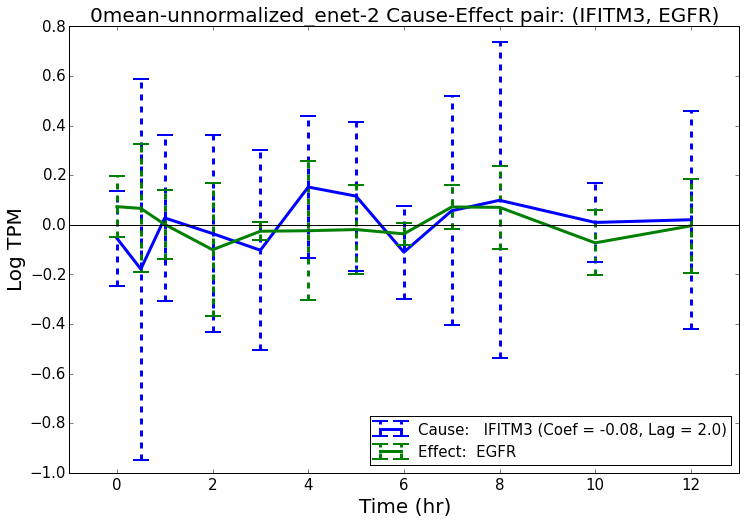

Filename:  analysis/plots/common/any-imm/IFITM3-EGFR/0mean-unnormalized_enet-2_no-bar-IFITM3-EGFR-lag-2-coef--8E-02.pdf
Plot saved to  analysis/plots/common/any-imm/IFITM3-EGFR/0mean-unnormalized_enet-2_no-bar-IFITM3-EGFR-lag-2-coef--8E-02.pdf


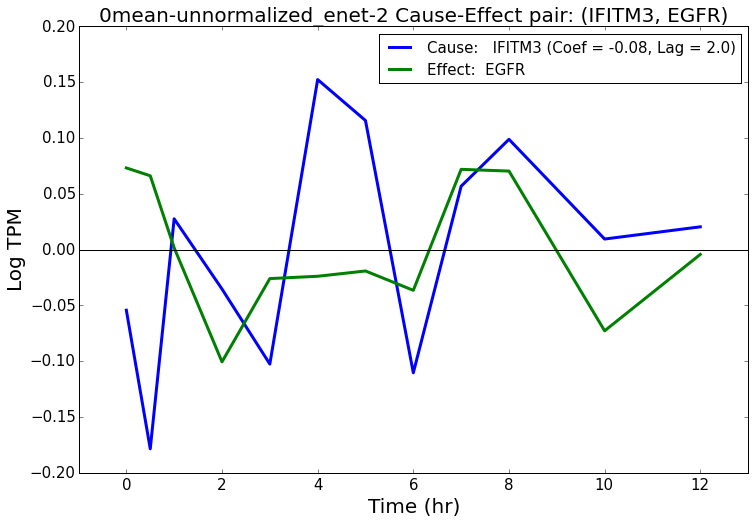

********************************
CDNF CD58
********************************
***********************************************
0mean-1var_enet-1
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect   Weight  Coef Summary: Cause                                                    Summary: Effect
548               CDNF                CD58 -0.12099     1            NaN  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/any-imm/CDNF-CD58/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-imm/CDNF-CD58/0mean-1var_enet-1_CDNF-CD58-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-imm/CDNF-CD58/0mean-1var_enet-1_CDNF-CD58-lag-1-coef--1E-01.pdf


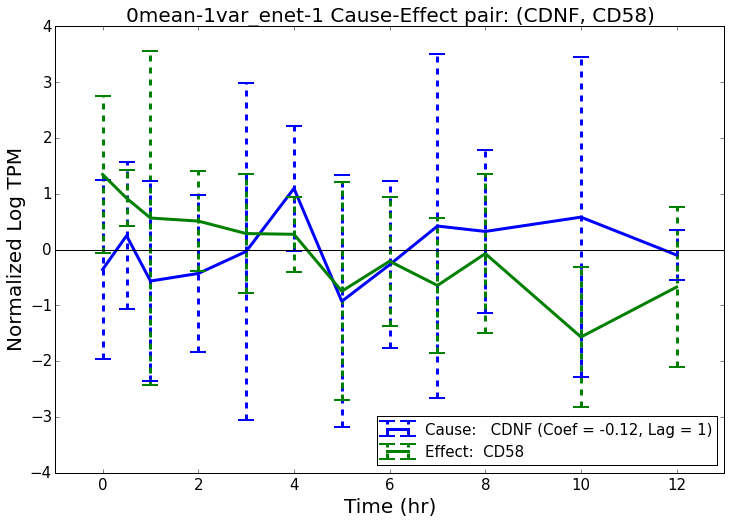

Filename:  analysis/plots/common/any-imm/CDNF-CD58/0mean-1var_enet-1_no-bar-CDNF-CD58-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-imm/CDNF-CD58/0mean-1var_enet-1_no-bar-CDNF-CD58-lag-1-coef--1E-01.pdf


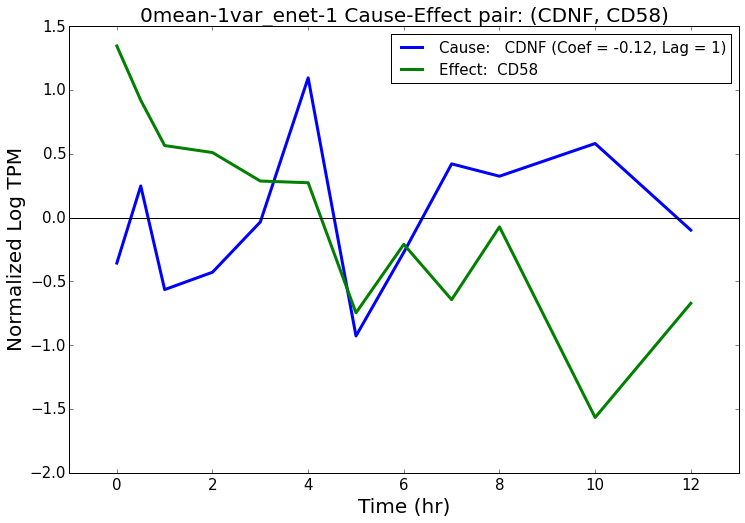

***********************************************
0mean-1var_enet-2
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause                                                    Summary: Effect
346               CDNF                CD58 -0.098648   1.0            NaN  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/any-imm/CDNF-CD58/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-imm/CDNF-CD58/0mean-1var_enet-2_CDNF-CD58-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-imm/CDNF-CD58/0mean-1var_enet-2_CDNF-CD58-lag-2-coef--1E-01.pdf


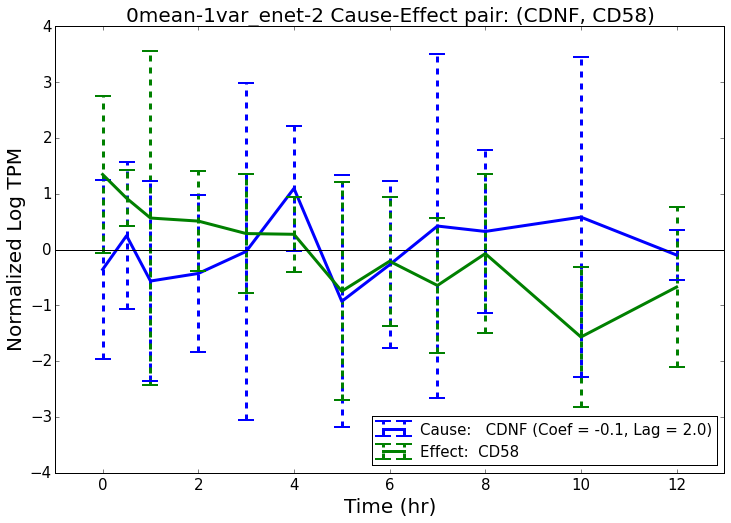

Filename:  analysis/plots/common/any-imm/CDNF-CD58/0mean-1var_enet-2_no-bar-CDNF-CD58-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-imm/CDNF-CD58/0mean-1var_enet-2_no-bar-CDNF-CD58-lag-2-coef--1E-01.pdf


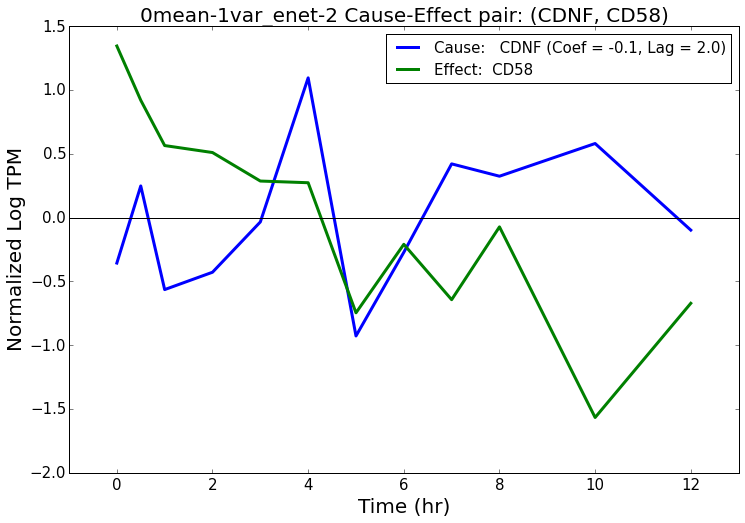

***********************************************
0mean-unnormalized_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause                                                    Summary: Effect
7612               CDNF                CD58 -0.080152     1            NaN  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/any-imm/CDNF-CD58/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-imm/CDNF-CD58/0mean-unnormalized_enet-1_CDNF-CD58-lag-1-coef--8E-02.pdf
Plot saved to  analysis/plots/common/any-imm/CDNF-CD58/0mean-unnormalized_enet-1_CDNF-CD58-lag-1-coef--8E-02.pdf


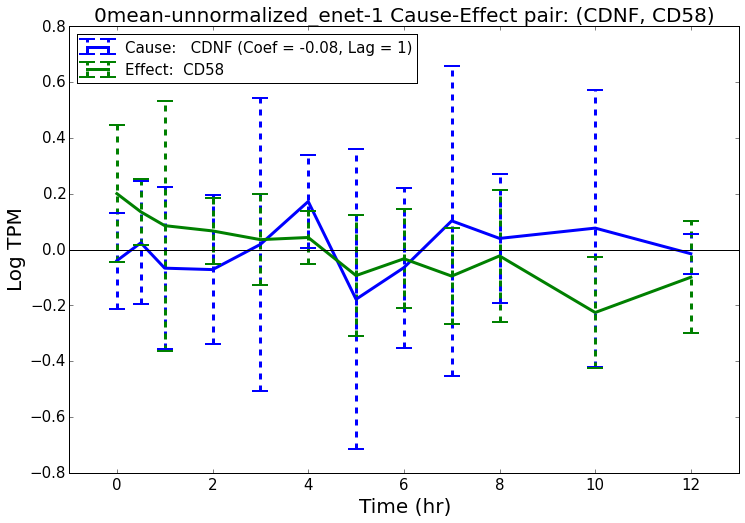

Filename:  analysis/plots/common/any-imm/CDNF-CD58/0mean-unnormalized_enet-1_no-bar-CDNF-CD58-lag-1-coef--8E-02.pdf
Plot saved to  analysis/plots/common/any-imm/CDNF-CD58/0mean-unnormalized_enet-1_no-bar-CDNF-CD58-lag-1-coef--8E-02.pdf


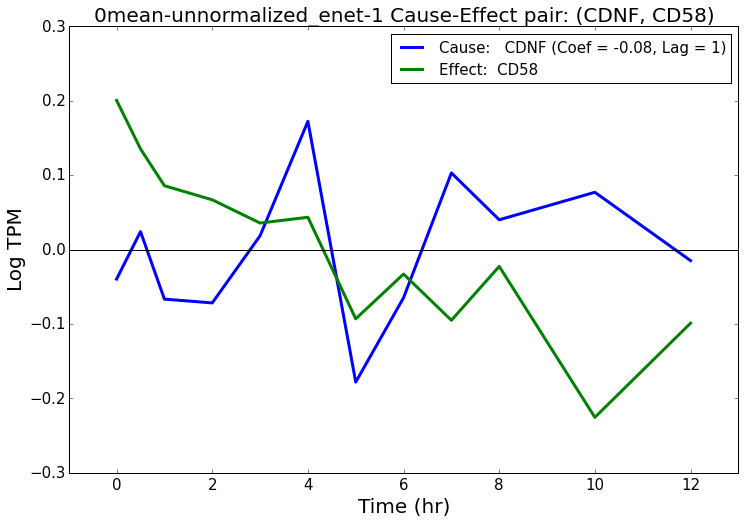

***********************************************
0mean-unnormalized_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause                                                    Summary: Effect
1623               CDNF                CD58 -0.096048   1.0            NaN  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/any-imm/CDNF-CD58/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-imm/CDNF-CD58/0mean-unnormalized_enet-2_CDNF-CD58-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-imm/CDNF-CD58/0mean-unnormalized_enet-2_CDNF-CD58-lag-2-coef--1E-01.pdf


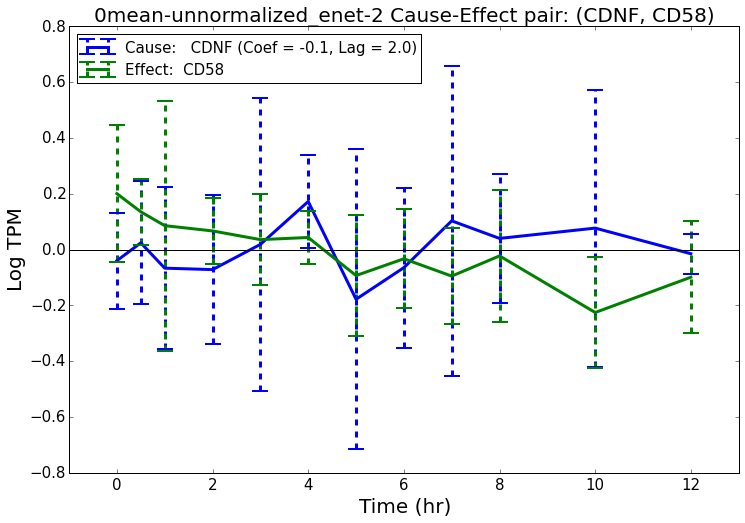

Filename:  analysis/plots/common/any-imm/CDNF-CD58/0mean-unnormalized_enet-2_no-bar-CDNF-CD58-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-imm/CDNF-CD58/0mean-unnormalized_enet-2_no-bar-CDNF-CD58-lag-2-coef--1E-01.pdf


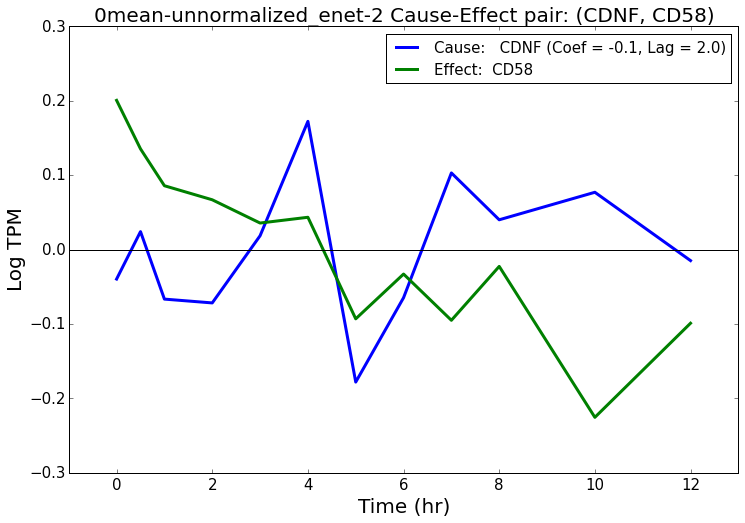

In [69]:
for i, r in plot_df.iterrows():
    print "********************************"
    print r["Gene Symbol: Cause"], r["Gene Symbol: Effect"]
    print "********************************"
    
    
    all_plot_folder = os.path.join(plot_subfolder, "-".join([r["Gene Symbol: Cause"], r["Gene Symbol: Effect"]]))
    
    indices = []
    for j in range(len(names)):
        if r[names[j]] == 1:
            # plot if contains
            indices.append(j)
    
    plot_nets = [nets[ind][nets[ind]["Cause-Effect"] == r["Cause-Effect"]] for ind in indices]
    for p in range(len(plot_nets)):
        plot_nets[p]["Gene Symbol: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_nets[p]["Cause"].values]
        plot_nets[p]["Gene Symbol: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_nets[p]["Effect"].values]
    
    plot_data_hg_df_list = [data_hg_df_list[ind] for ind in indices]
    plot_names = [names[ind] for ind in indices]
    plot_timekeys_list = [timekeys_list[ind] for ind in indices]
    plot_num_per_keys_list = [num_per_keys_list[ind] for ind in indices]
    plot_timepoints_list = [timepoints_list[ind] for ind in indices]
    
    
    do_plot_nets(plot_data_hg_df_list, plot_nets, plot_names, plot_timekeys_list, plot_num_per_keys_list, plot_timepoints_list,
                all_plot_folder=all_plot_folder, include_name_prefix=True, ylabels=ylabels)
    
#     for plot_net, plot_name in zip(plot_nets, plot_names):
#         print plot_name
#         display(plot_net)

# any-metab

In [70]:
plotfoldersuffix = "any-metab"
plot_df = edge_network_df[edge_network_df["Effect"].isin(metab_genes)].head(top_edge_num)

display(plot_df)

plot_subfolder = os.path.join(plot_common_folder, plotfoldersuffix)
if not os.path.exists(plot_subfolder):
    os.makedirs(plot_subfolder)
    
outfile = os.path.join(plot_subfolder, "top_interactions.csv")
plot_df.to_csv(outfile, index=0)

,Cause-Effect,Cause,Effect,Gene Symbol: Cause,Gene Symbol: Effect,Summary: Cause,Summary: Effect,Abs-Avg-Weight,Total,Networks,0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,Weight: 0mean-1var_enet-1,Weight: 0mean-1var_enet-2,Weight: 0mean-unnormalized_enet-1,Weight: 0mean-unnormalized_enet-2
24051,ENSG00000142684.7-ENSG00000044090.7,ENSG00000142684.7,ENSG00000044090.7,ZNF593,CUL7,NaN,"Diabetes_GSEA,",0.087,4.0,"0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",1,1,1,1,0.107023,0.106977,0.054699,0.079477
23390,ENSG00000142089.14-ENSG00000131791.7,ENSG00000142089.14,ENSG00000131791.7,IFITM3,PRKAB2,"Immune_GOC-5,Immune_GOC-4,","Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Diabetes_GSEA,Obesity_GSEA,",0.086,4.0,"0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",1,1,1,1,-0.131983,-0.075555,-0.079573,-0.056342
17654,ENSG00000132744.6-ENSG00000113790.9,ENSG00000132744.6,ENSG00000113790.9,ACY3,EHHADH,NaN,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,",0.083,4.0,"0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",1,1,1,1,0.083075,0.074393,0.088842,0.085783


********************************
ZNF593 CUL7
********************************


/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


***********************************************
0mean-1var_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
1294             ZNF593                CUL7  0.107023     1            NaN  Diabetes_GSEA,
Written to  analysis/plots/common/any-metab/ZNF593-CUL7/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-metab/ZNF593-CUL7/0mean-1var_enet-1_ZNF593-CUL7-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/common/any-metab/ZNF593-CUL7/0mean-1var_enet-1_ZNF593-CUL7-lag-1-coef-1E-01.pdf


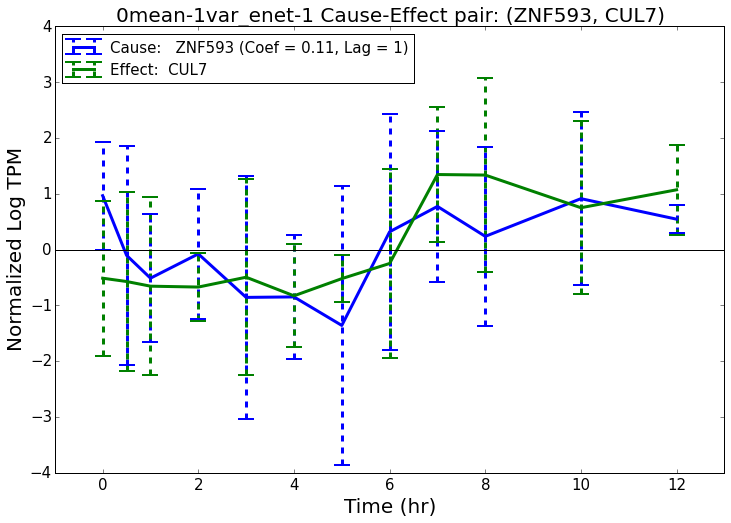

Filename:  analysis/plots/common/any-metab/ZNF593-CUL7/0mean-1var_enet-1_no-bar-ZNF593-CUL7-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/common/any-metab/ZNF593-CUL7/0mean-1var_enet-1_no-bar-ZNF593-CUL7-lag-1-coef-1E-01.pdf


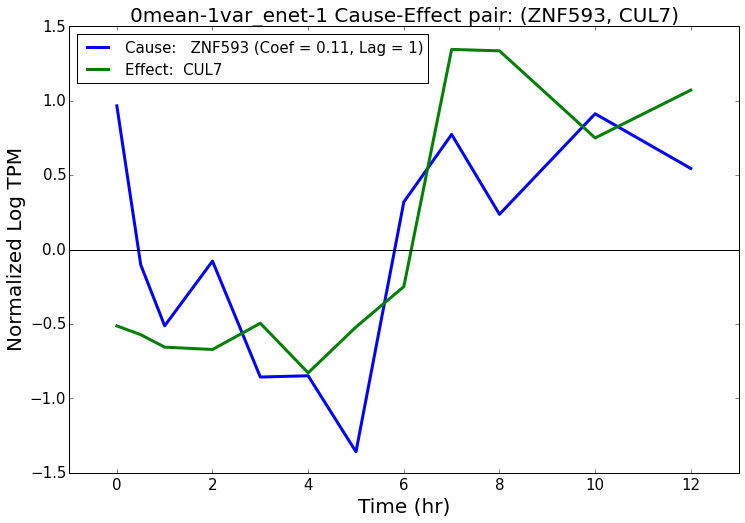

***********************************************
0mean-1var_enet-2
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
178             ZNF593                CUL7  0.106977   1.0            NaN  Diabetes_GSEA,
Written to  analysis/plots/common/any-metab/ZNF593-CUL7/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-metab/ZNF593-CUL7/0mean-1var_enet-2_ZNF593-CUL7-lag-2-coef-1E-01.pdf
Plot saved to  analysis/plots/common/any-metab/ZNF593-CUL7/0mean-1var_enet-2_ZNF593-CUL7-lag-2-coef-1E-01.pdf


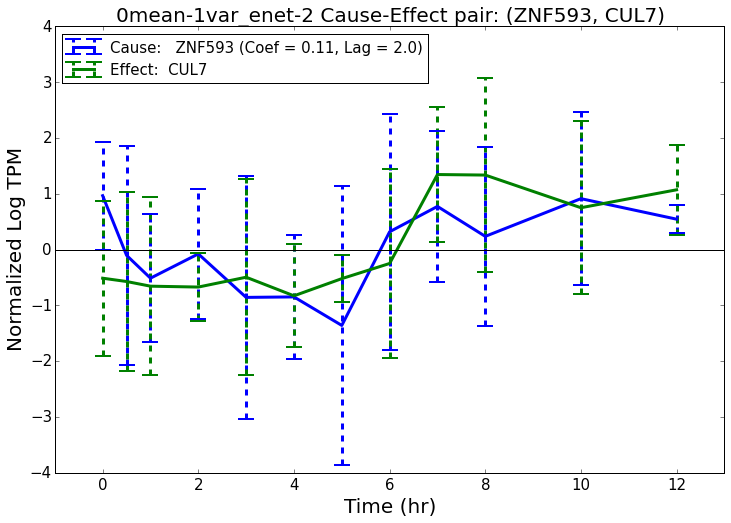

Filename:  analysis/plots/common/any-metab/ZNF593-CUL7/0mean-1var_enet-2_no-bar-ZNF593-CUL7-lag-2-coef-1E-01.pdf
Plot saved to  analysis/plots/common/any-metab/ZNF593-CUL7/0mean-1var_enet-2_no-bar-ZNF593-CUL7-lag-2-coef-1E-01.pdf


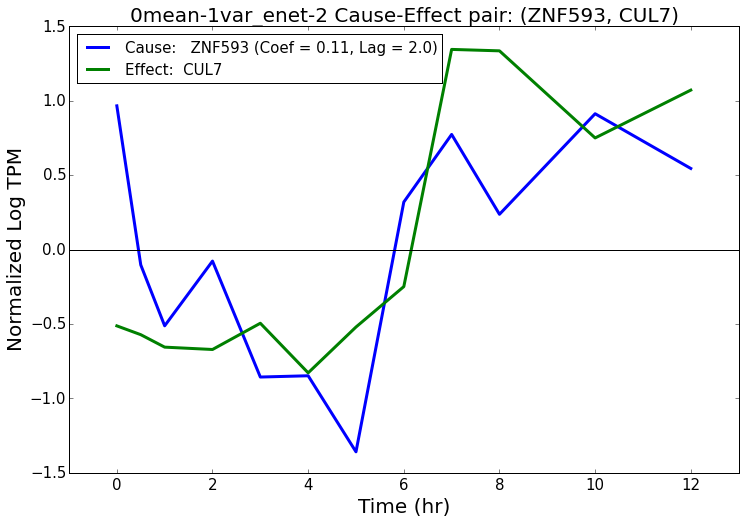

***********************************************
0mean-unnormalized_enet-1
***********************************************
      Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
16001             ZNF593                CUL7  0.054699     1            NaN  Diabetes_GSEA,
Written to  analysis/plots/common/any-metab/ZNF593-CUL7/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-metab/ZNF593-CUL7/0mean-unnormalized_enet-1_ZNF593-CUL7-lag-1-coef-5E-02.pdf
Plot saved to  analysis/plots/common/any-metab/ZNF593-CUL7/0mean-unnormalized_enet-1_ZNF593-CUL7-lag-1-coef-5E-02.pdf


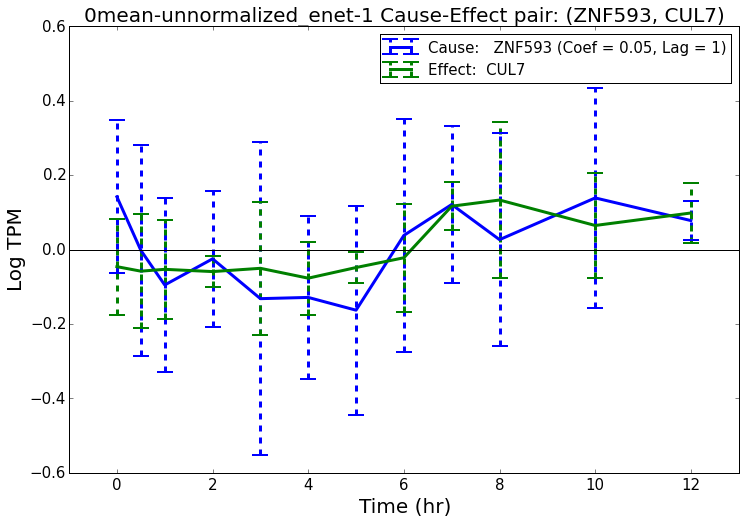

Filename:  analysis/plots/common/any-metab/ZNF593-CUL7/0mean-unnormalized_enet-1_no-bar-ZNF593-CUL7-lag-1-coef-5E-02.pdf
Plot saved to  analysis/plots/common/any-metab/ZNF593-CUL7/0mean-unnormalized_enet-1_no-bar-ZNF593-CUL7-lag-1-coef-5E-02.pdf


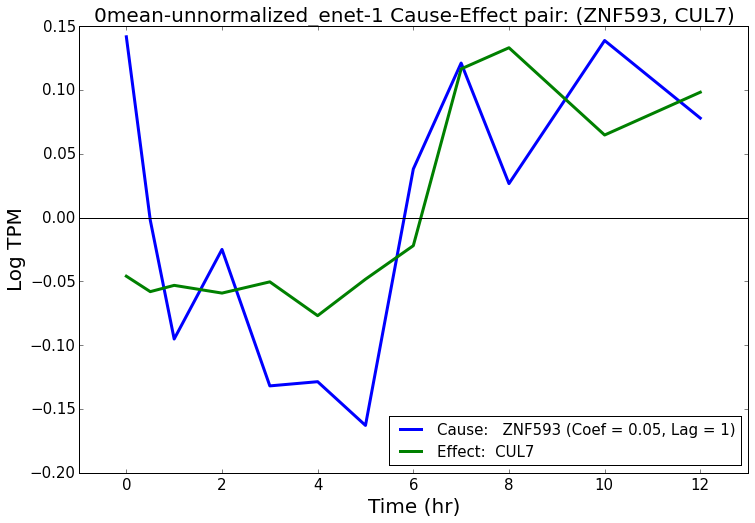

***********************************************
0mean-unnormalized_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
3604             ZNF593                CUL7  0.079477   1.0            NaN  Diabetes_GSEA,
Written to  analysis/plots/common/any-metab/ZNF593-CUL7/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-metab/ZNF593-CUL7/0mean-unnormalized_enet-2_ZNF593-CUL7-lag-2-coef-8E-02.pdf
Plot saved to  analysis/plots/common/any-metab/ZNF593-CUL7/0mean-unnormalized_enet-2_ZNF593-CUL7-lag-2-coef-8E-02.pdf


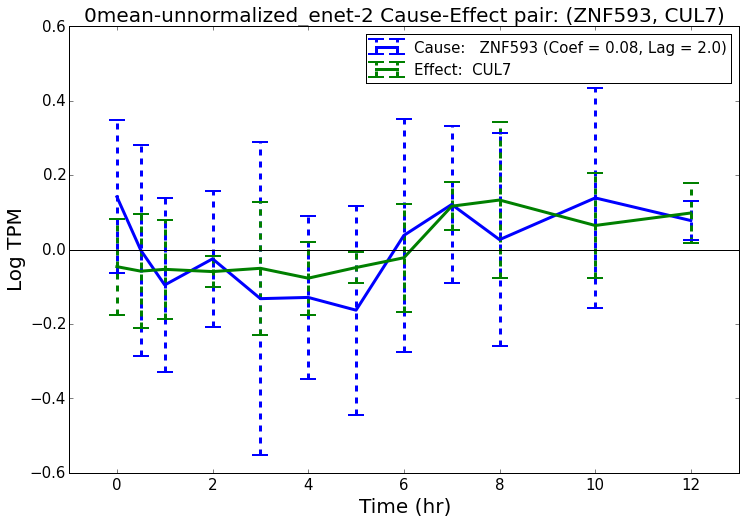

Filename:  analysis/plots/common/any-metab/ZNF593-CUL7/0mean-unnormalized_enet-2_no-bar-ZNF593-CUL7-lag-2-coef-8E-02.pdf
Plot saved to  analysis/plots/common/any-metab/ZNF593-CUL7/0mean-unnormalized_enet-2_no-bar-ZNF593-CUL7-lag-2-coef-8E-02.pdf


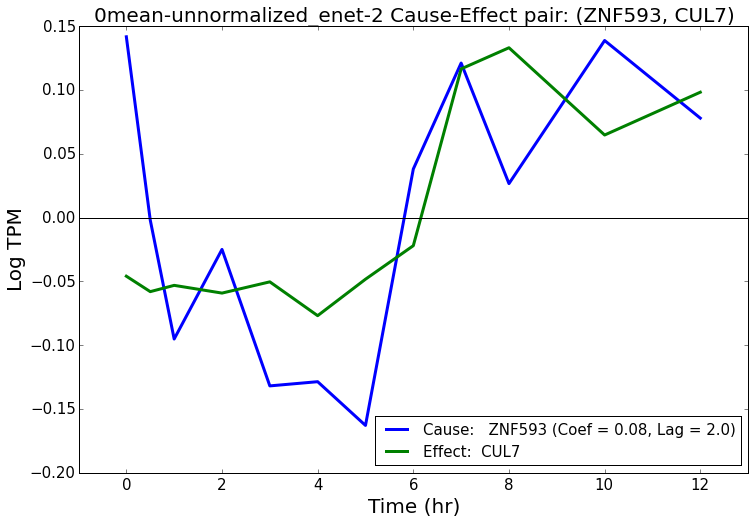

********************************
IFITM3 PRKAB2
********************************
***********************************************
0mean-1var_enet-1
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef              Summary: Cause                                                         Summary: Effect
269             IFITM3              PRKAB2 -0.131983     1  Immune_GOC-5,Immune_GOC-4,  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Diabetes_GSEA,Obesity_GSEA,
Written to  analysis/plots/common/any-metab/IFITM3-PRKAB2/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-metab/IFITM3-PRKAB2/0mean-1var_enet-1_IFITM3-PRKAB2-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-metab/IFITM3-PRKAB2/0mean-1var_enet-1_IFITM3-PRKAB2-lag-1-coef--1E-01.pdf


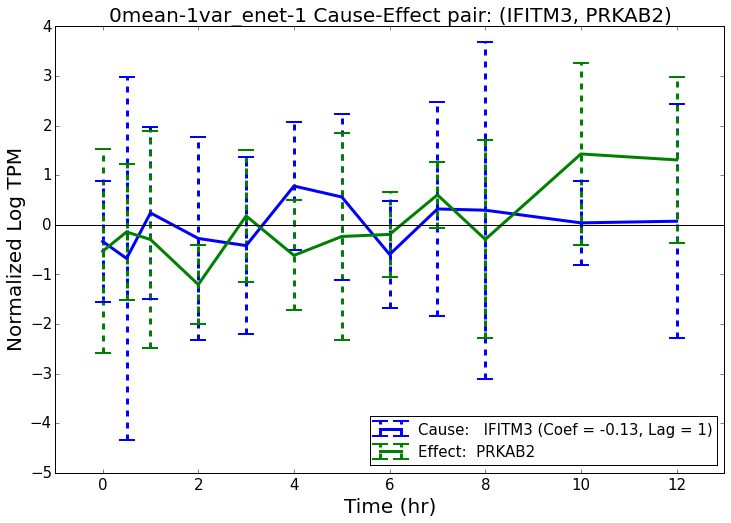

Filename:  analysis/plots/common/any-metab/IFITM3-PRKAB2/0mean-1var_enet-1_no-bar-IFITM3-PRKAB2-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/any-metab/IFITM3-PRKAB2/0mean-1var_enet-1_no-bar-IFITM3-PRKAB2-lag-1-coef--1E-01.pdf


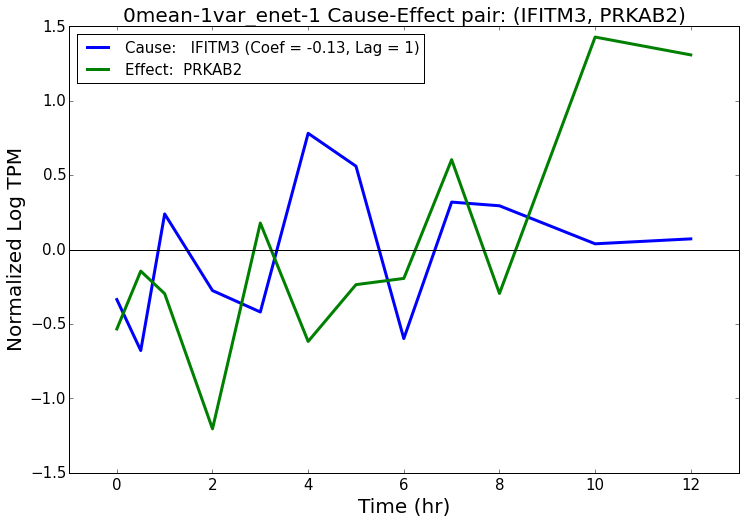

***********************************************
0mean-1var_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef              Summary: Cause                                                         Summary: Effect
2086             IFITM3              PRKAB2 -0.075555   1.0  Immune_GOC-5,Immune_GOC-4,  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Diabetes_GSEA,Obesity_GSEA,
Written to  analysis/plots/common/any-metab/IFITM3-PRKAB2/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-metab/IFITM3-PRKAB2/0mean-1var_enet-2_IFITM3-PRKAB2-lag-2-coef--8E-02.pdf
Plot saved to  analysis/plots/common/any-metab/IFITM3-PRKAB2/0mean-1var_enet-2_IFITM3-PRKAB2-lag-2-coef--8E-02.pdf


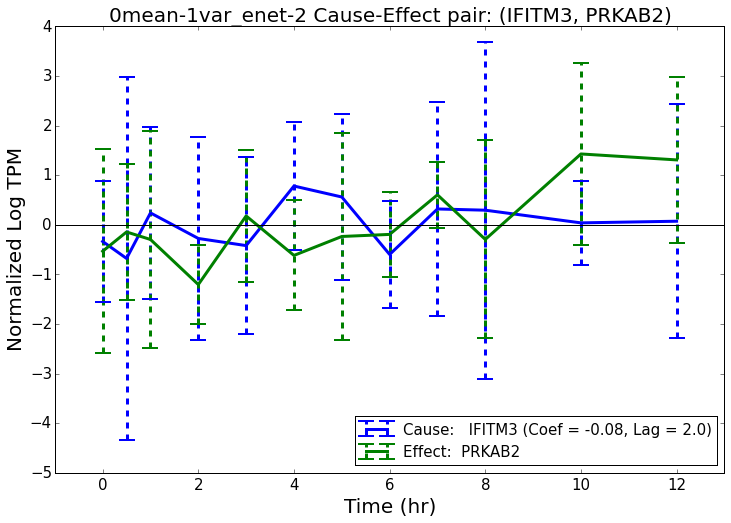

Filename:  analysis/plots/common/any-metab/IFITM3-PRKAB2/0mean-1var_enet-2_no-bar-IFITM3-PRKAB2-lag-2-coef--8E-02.pdf
Plot saved to  analysis/plots/common/any-metab/IFITM3-PRKAB2/0mean-1var_enet-2_no-bar-IFITM3-PRKAB2-lag-2-coef--8E-02.pdf


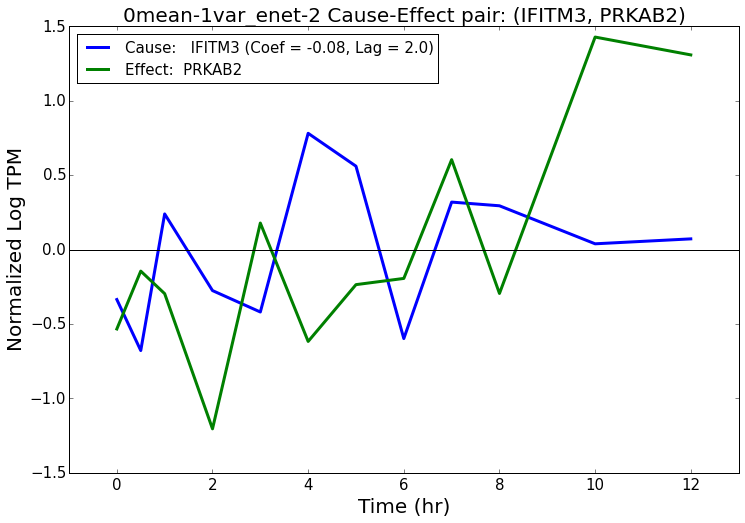

***********************************************
0mean-unnormalized_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef              Summary: Cause                                                         Summary: Effect
7772             IFITM3              PRKAB2 -0.079573     1  Immune_GOC-5,Immune_GOC-4,  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Diabetes_GSEA,Obesity_GSEA,
Written to  analysis/plots/common/any-metab/IFITM3-PRKAB2/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-metab/IFITM3-PRKAB2/0mean-unnormalized_enet-1_IFITM3-PRKAB2-lag-1-coef--8E-02.pdf
Plot saved to  analysis/plots/common/any-metab/IFITM3-PRKAB2/0mean-unnormalized_enet-1_IFITM3-PRKAB2-lag-1-coef--8E-02.pdf


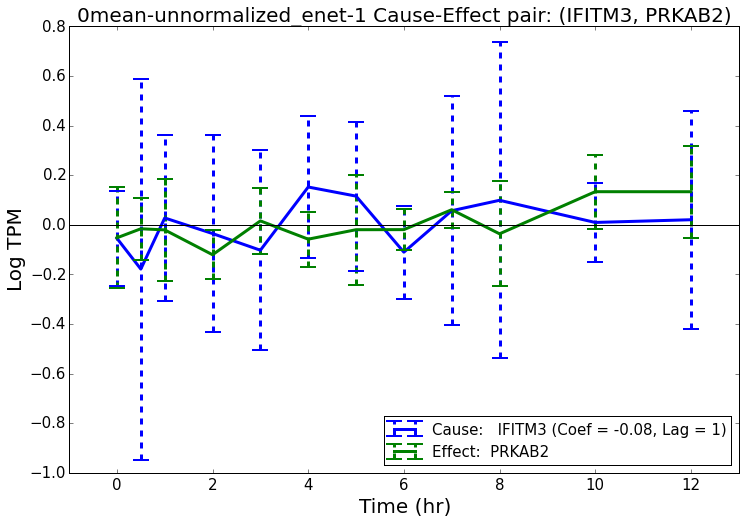

Filename:  analysis/plots/common/any-metab/IFITM3-PRKAB2/0mean-unnormalized_enet-1_no-bar-IFITM3-PRKAB2-lag-1-coef--8E-02.pdf
Plot saved to  analysis/plots/common/any-metab/IFITM3-PRKAB2/0mean-unnormalized_enet-1_no-bar-IFITM3-PRKAB2-lag-1-coef--8E-02.pdf


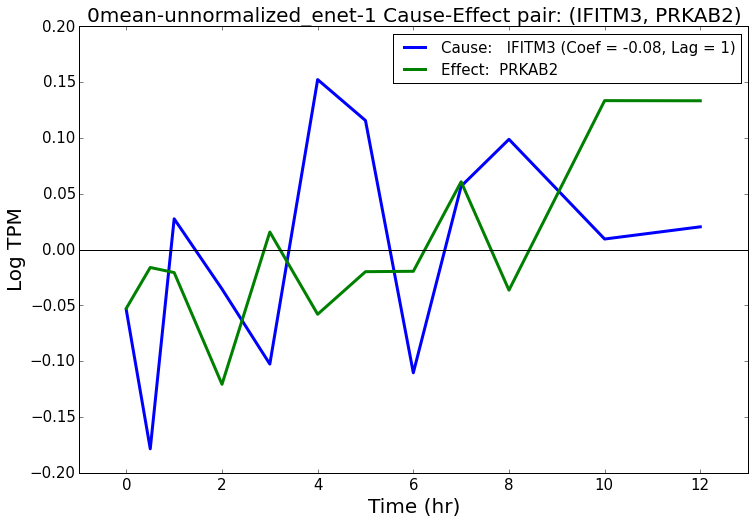

***********************************************
0mean-unnormalized_enet-2
***********************************************
      Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef              Summary: Cause                                                         Summary: Effect
10294             IFITM3              PRKAB2 -0.056342   1.0  Immune_GOC-5,Immune_GOC-4,  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Diabetes_GSEA,Obesity_GSEA,
Written to  analysis/plots/common/any-metab/IFITM3-PRKAB2/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-metab/IFITM3-PRKAB2/0mean-unnormalized_enet-2_IFITM3-PRKAB2-lag-2-coef--6E-02.pdf
Plot saved to  analysis/plots/common/any-metab/IFITM3-PRKAB2/0mean-unnormalized_enet-2_IFITM3-PRKAB2-lag-2-coef--6E-02.pdf


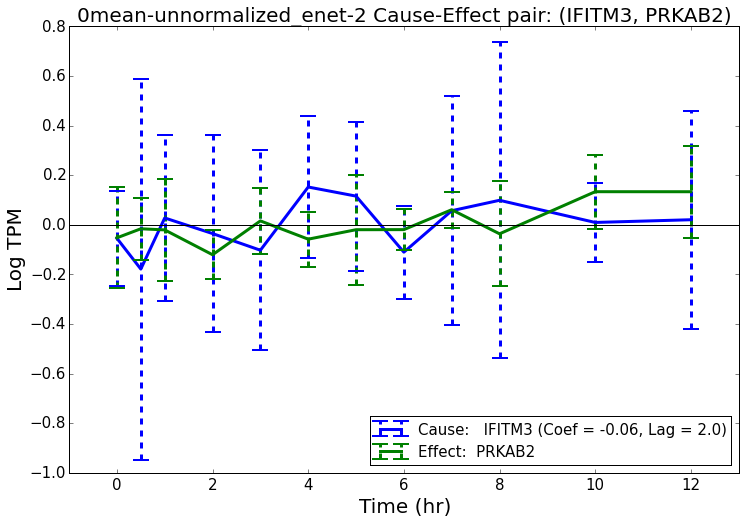

Filename:  analysis/plots/common/any-metab/IFITM3-PRKAB2/0mean-unnormalized_enet-2_no-bar-IFITM3-PRKAB2-lag-2-coef--6E-02.pdf
Plot saved to  analysis/plots/common/any-metab/IFITM3-PRKAB2/0mean-unnormalized_enet-2_no-bar-IFITM3-PRKAB2-lag-2-coef--6E-02.pdf


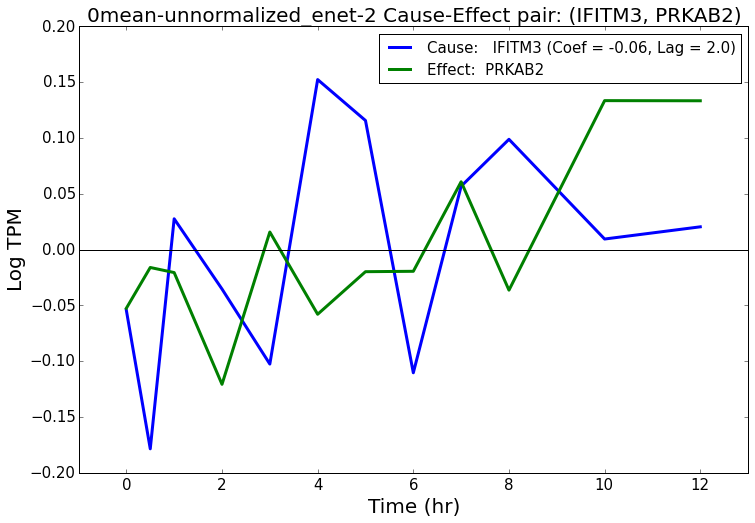

********************************
ACY3 EHHADH
********************************
***********************************************
0mean-1var_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause                              Summary: Effect
4938               ACY3              EHHADH  0.083075     1            NaN  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,
Written to  analysis/plots/common/any-metab/ACY3-EHHADH/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-metab/ACY3-EHHADH/0mean-1var_enet-1_ACY3-EHHADH-lag-1-coef-8E-02.pdf
Plot saved to  analysis/plots/common/any-metab/ACY3-EHHADH/0mean-1var_enet-1_ACY3-EHHADH-lag-1-coef-8E-02.pdf


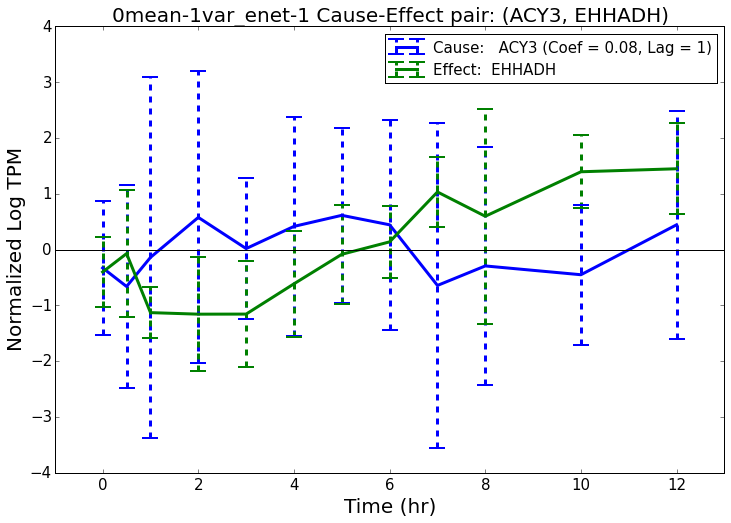

Filename:  analysis/plots/common/any-metab/ACY3-EHHADH/0mean-1var_enet-1_no-bar-ACY3-EHHADH-lag-1-coef-8E-02.pdf
Plot saved to  analysis/plots/common/any-metab/ACY3-EHHADH/0mean-1var_enet-1_no-bar-ACY3-EHHADH-lag-1-coef-8E-02.pdf


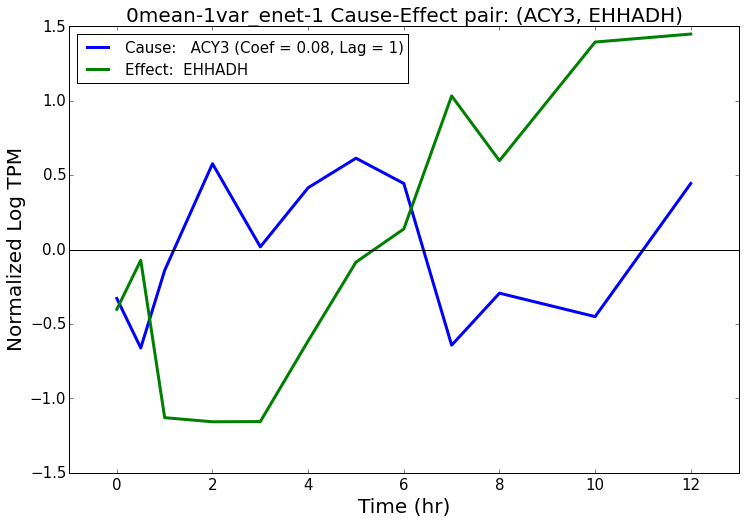

***********************************************
0mean-1var_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause                              Summary: Effect
2267               ACY3              EHHADH  0.074393   1.0            NaN  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,
Written to  analysis/plots/common/any-metab/ACY3-EHHADH/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-metab/ACY3-EHHADH/0mean-1var_enet-2_ACY3-EHHADH-lag-2-coef-7E-02.pdf
Plot saved to  analysis/plots/common/any-metab/ACY3-EHHADH/0mean-1var_enet-2_ACY3-EHHADH-lag-2-coef-7E-02.pdf


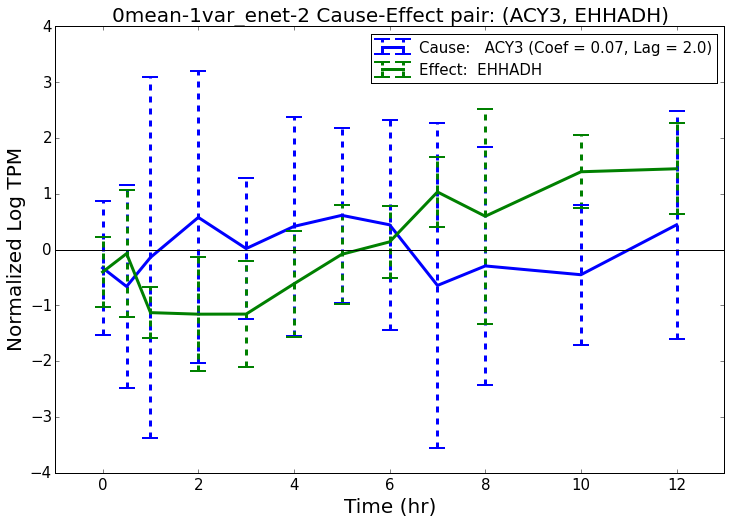

Filename:  analysis/plots/common/any-metab/ACY3-EHHADH/0mean-1var_enet-2_no-bar-ACY3-EHHADH-lag-2-coef-7E-02.pdf
Plot saved to  analysis/plots/common/any-metab/ACY3-EHHADH/0mean-1var_enet-2_no-bar-ACY3-EHHADH-lag-2-coef-7E-02.pdf


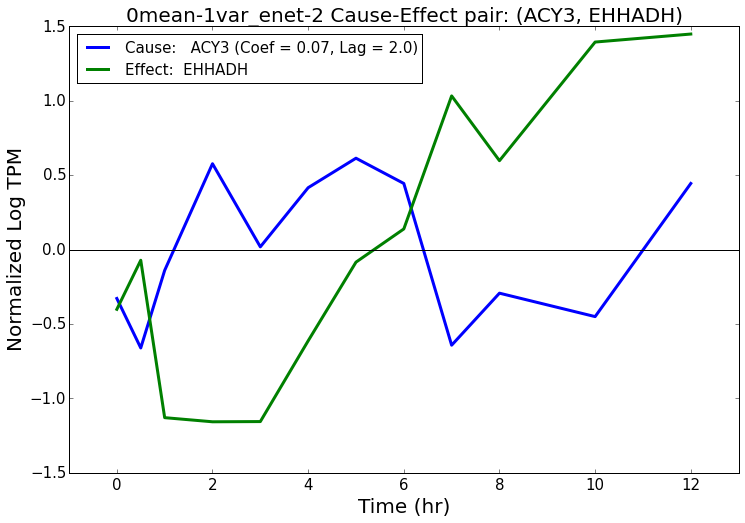

***********************************************
0mean-unnormalized_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause                              Summary: Effect
5731               ACY3              EHHADH  0.088842     1            NaN  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,
Written to  analysis/plots/common/any-metab/ACY3-EHHADH/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-metab/ACY3-EHHADH/0mean-unnormalized_enet-1_ACY3-EHHADH-lag-1-coef-9E-02.pdf
Plot saved to  analysis/plots/common/any-metab/ACY3-EHHADH/0mean-unnormalized_enet-1_ACY3-EHHADH-lag-1-coef-9E-02.pdf


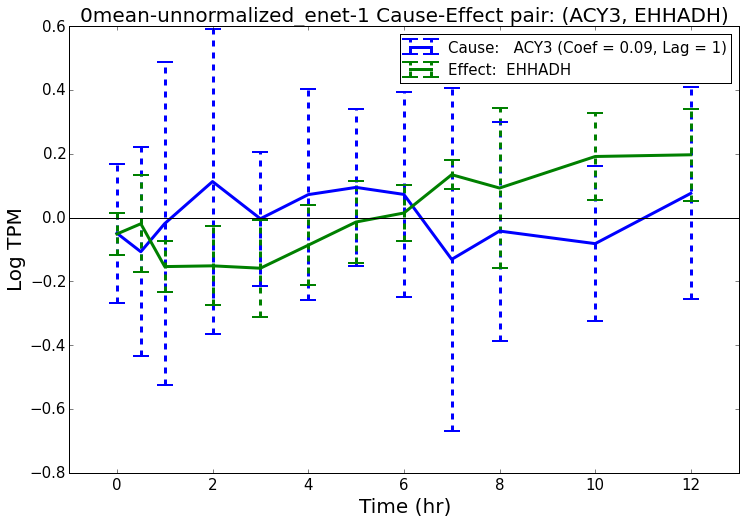

Filename:  analysis/plots/common/any-metab/ACY3-EHHADH/0mean-unnormalized_enet-1_no-bar-ACY3-EHHADH-lag-1-coef-9E-02.pdf
Plot saved to  analysis/plots/common/any-metab/ACY3-EHHADH/0mean-unnormalized_enet-1_no-bar-ACY3-EHHADH-lag-1-coef-9E-02.pdf


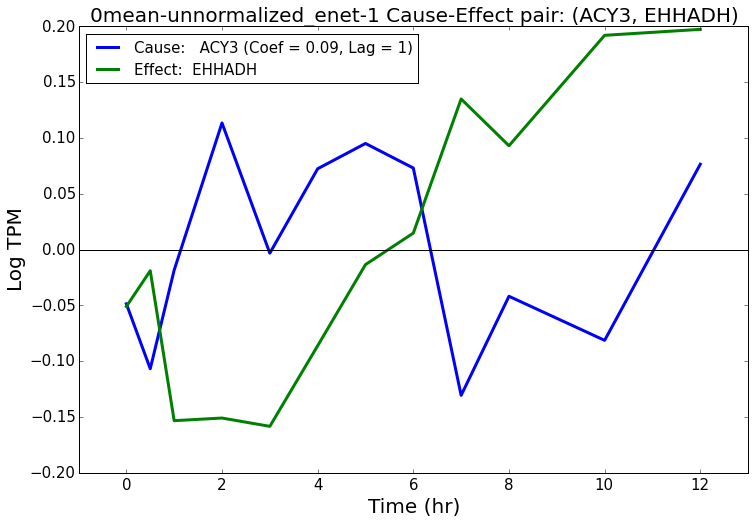

***********************************************
0mean-unnormalized_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause                              Summary: Effect
2683               ACY3              EHHADH  0.085783   1.0            NaN  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,
Written to  analysis/plots/common/any-metab/ACY3-EHHADH/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/any-metab/ACY3-EHHADH/0mean-unnormalized_enet-2_ACY3-EHHADH-lag-2-coef-9E-02.pdf
Plot saved to  analysis/plots/common/any-metab/ACY3-EHHADH/0mean-unnormalized_enet-2_ACY3-EHHADH-lag-2-coef-9E-02.pdf


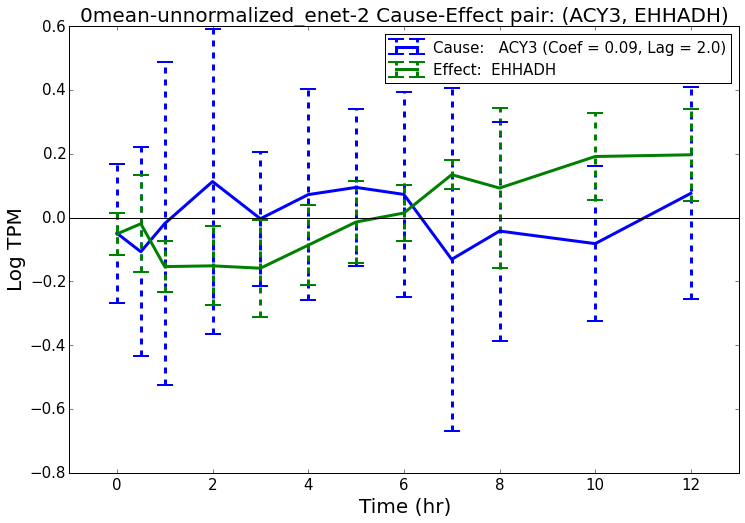

Filename:  analysis/plots/common/any-metab/ACY3-EHHADH/0mean-unnormalized_enet-2_no-bar-ACY3-EHHADH-lag-2-coef-9E-02.pdf
Plot saved to  analysis/plots/common/any-metab/ACY3-EHHADH/0mean-unnormalized_enet-2_no-bar-ACY3-EHHADH-lag-2-coef-9E-02.pdf


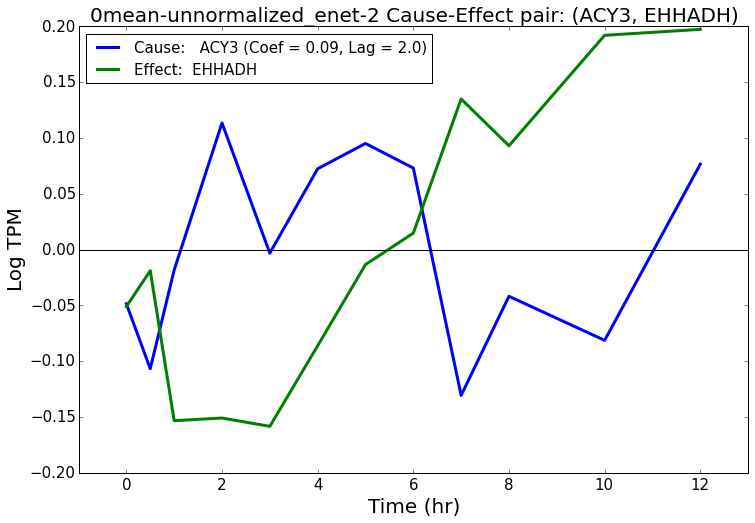

In [71]:
for i, r in plot_df.iterrows():
    print "********************************"
    print r["Gene Symbol: Cause"], r["Gene Symbol: Effect"]
    print "********************************"
    
    
    all_plot_folder = os.path.join(plot_subfolder, "-".join([r["Gene Symbol: Cause"], r["Gene Symbol: Effect"]]))
    
    indices = []
    for j in range(len(names)):
        if r[names[j]] == 1:
            # plot if contains
            indices.append(j)
    
    plot_nets = [nets[ind][nets[ind]["Cause-Effect"] == r["Cause-Effect"]] for ind in indices]
    for p in range(len(plot_nets)):
        plot_nets[p]["Gene Symbol: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_nets[p]["Cause"].values]
        plot_nets[p]["Gene Symbol: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_nets[p]["Effect"].values]
    
    plot_data_hg_df_list = [data_hg_df_list[ind] for ind in indices]
    plot_names = [names[ind] for ind in indices]
    plot_timekeys_list = [timekeys_list[ind] for ind in indices]
    plot_num_per_keys_list = [num_per_keys_list[ind] for ind in indices]
    plot_timepoints_list = [timepoints_list[ind] for ind in indices]
    
    
    do_plot_nets(plot_data_hg_df_list, plot_nets, plot_names, plot_timekeys_list, plot_num_per_keys_list, plot_timepoints_list,
                all_plot_folder=all_plot_folder, include_name_prefix=True, ylabels=ylabels)
    
#     for plot_net, plot_name in zip(plot_nets, plot_names):
#         print plot_name
#         display(plot_net)

# TF-any

In [72]:
plotfoldersuffix = "tf-any"
plot_df = edge_network_df[edge_network_df["Cause"].isin(tf_genes)].head(top_edge_num)

display(plot_df)

plot_subfolder = os.path.join(plot_common_folder, plotfoldersuffix)
if not os.path.exists(plot_subfolder):
    os.makedirs(plot_subfolder)
    
outfile = os.path.join(plot_subfolder, "top_interactions.csv")
plot_df.to_csv(outfile, index=0)

,Cause-Effect,Cause,Effect,Gene Symbol: Cause,Gene Symbol: Effect,Summary: Cause,Summary: Effect,Abs-Avg-Weight,Total,Networks,0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,Weight: 0mean-1var_enet-1,Weight: 0mean-1var_enet-2,Weight: 0mean-unnormalized_enet-1,Weight: 0mean-unnormalized_enet-2
153,ENSG00000004848.6-ENSG00000183607.8,ENSG00000004848.6,ENSG00000183607.8,ARX,GKN2,"TF-Bioguo,",NaN,0.110,4.0,"0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",1,1,1,1,-0.100096,-0.087470,-0.139563,-0.111950
53089,ENSG00000196081.8-ENSG00000025423.10,ENSG00000196081.8,ENSG00000025423.10,ZNF724P,HSD17B6,"TF-Bioguo,",NaN,0.095,4.0,"0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",1,1,1,1,0.097071,0.064626,0.106119,0.112091
12140,ENSG00000120075.5-ENSG00000204954.8,ENSG00000120075.5,ENSG00000204954.8,HOXB5,C12orf73,"TF-Bioguo,",NaN,0.088,4.0,"0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",1,1,1,1,0.126521,0.076530,0.084277,0.065938


********************************
ARX GKN2
********************************


/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


***********************************************
0mean-1var_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
1959                ARX                GKN2 -0.100096     1     TF-Bioguo,             NaN
Written to  analysis/plots/common/tf-any/ARX-GKN2/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-any/ARX-GKN2/0mean-1var_enet-1_ARX-GKN2-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/tf-any/ARX-GKN2/0mean-1var_enet-1_ARX-GKN2-lag-1-coef--1E-01.pdf


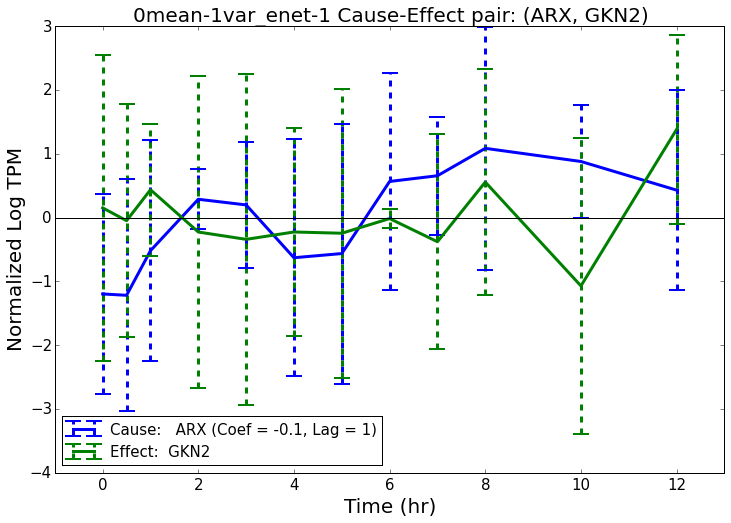

Filename:  analysis/plots/common/tf-any/ARX-GKN2/0mean-1var_enet-1_no-bar-ARX-GKN2-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/tf-any/ARX-GKN2/0mean-1var_enet-1_no-bar-ARX-GKN2-lag-1-coef--1E-01.pdf


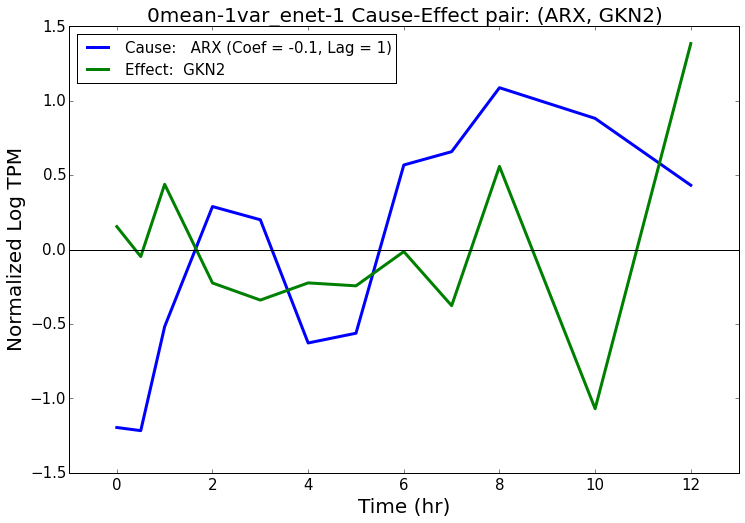

***********************************************
0mean-1var_enet-2
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect   Weight  Coef Summary: Cause Summary: Effect
862                ARX                GKN2 -0.08747   1.0     TF-Bioguo,             NaN
Written to  analysis/plots/common/tf-any/ARX-GKN2/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-any/ARX-GKN2/0mean-1var_enet-2_ARX-GKN2-lag-2-coef--9E-02.pdf
Plot saved to  analysis/plots/common/tf-any/ARX-GKN2/0mean-1var_enet-2_ARX-GKN2-lag-2-coef--9E-02.pdf


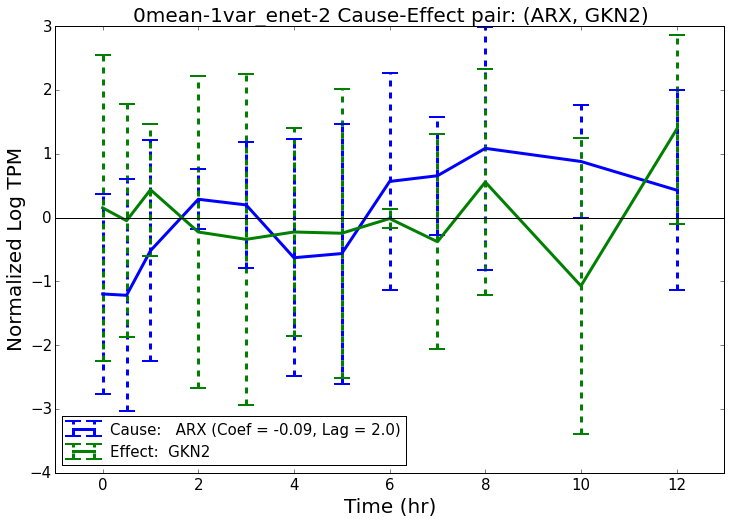

Filename:  analysis/plots/common/tf-any/ARX-GKN2/0mean-1var_enet-2_no-bar-ARX-GKN2-lag-2-coef--9E-02.pdf
Plot saved to  analysis/plots/common/tf-any/ARX-GKN2/0mean-1var_enet-2_no-bar-ARX-GKN2-lag-2-coef--9E-02.pdf


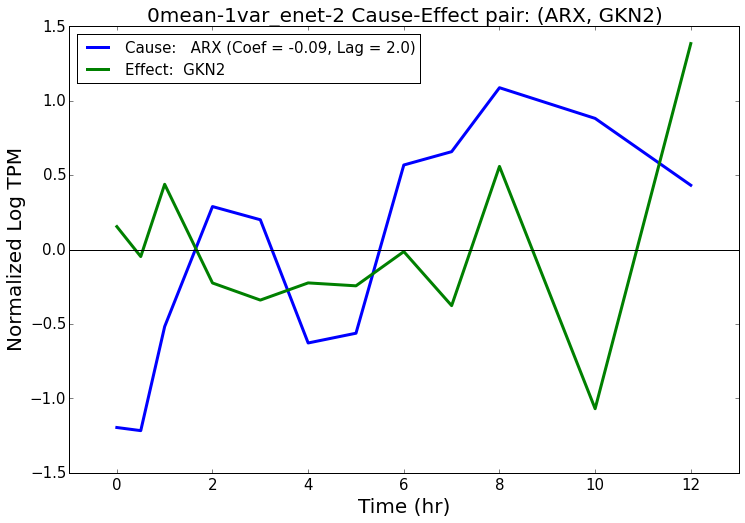

***********************************************
0mean-unnormalized_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
1028                ARX                GKN2 -0.139563     1     TF-Bioguo,             NaN
Written to  analysis/plots/common/tf-any/ARX-GKN2/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-any/ARX-GKN2/0mean-unnormalized_enet-1_ARX-GKN2-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/tf-any/ARX-GKN2/0mean-unnormalized_enet-1_ARX-GKN2-lag-1-coef--1E-01.pdf


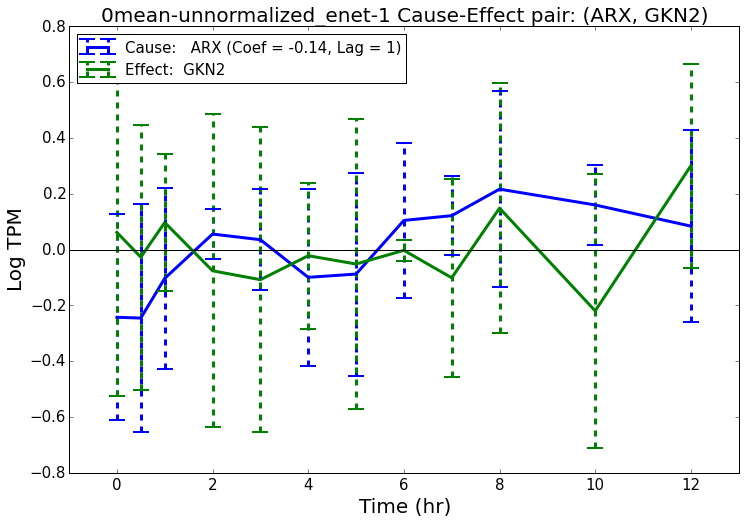

Filename:  analysis/plots/common/tf-any/ARX-GKN2/0mean-unnormalized_enet-1_no-bar-ARX-GKN2-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/tf-any/ARX-GKN2/0mean-unnormalized_enet-1_no-bar-ARX-GKN2-lag-1-coef--1E-01.pdf


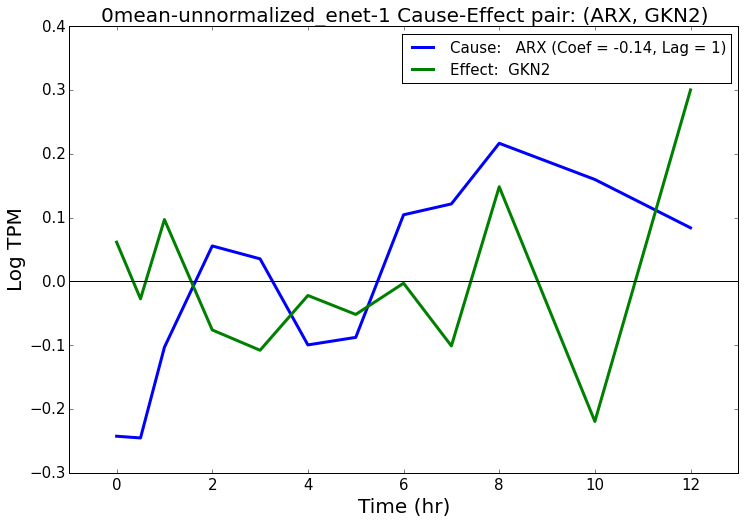

***********************************************
0mean-unnormalized_enet-2
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect   Weight  Coef Summary: Cause Summary: Effect
762                ARX                GKN2 -0.11195   1.0     TF-Bioguo,             NaN
Written to  analysis/plots/common/tf-any/ARX-GKN2/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-any/ARX-GKN2/0mean-unnormalized_enet-2_ARX-GKN2-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/common/tf-any/ARX-GKN2/0mean-unnormalized_enet-2_ARX-GKN2-lag-2-coef--1E-01.pdf


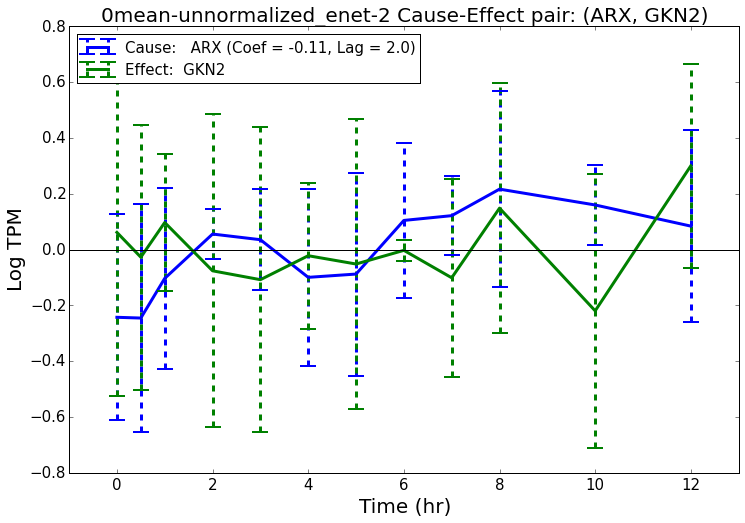

Filename:  analysis/plots/common/tf-any/ARX-GKN2/0mean-unnormalized_enet-2_no-bar-ARX-GKN2-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/common/tf-any/ARX-GKN2/0mean-unnormalized_enet-2_no-bar-ARX-GKN2-lag-2-coef--1E-01.pdf


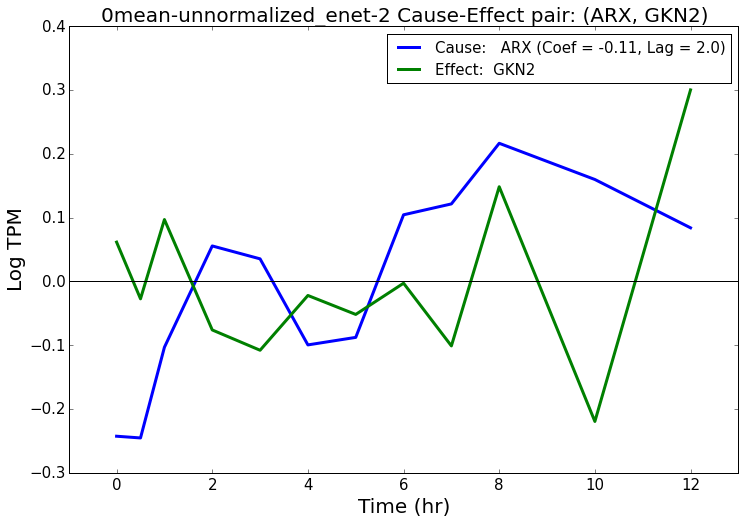

********************************
ZNF724P HSD17B6
********************************
***********************************************
0mean-1var_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
2364            ZNF724P             HSD17B6  0.097071     1     TF-Bioguo,             NaN
Written to  analysis/plots/common/tf-any/ZNF724P-HSD17B6/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-any/ZNF724P-HSD17B6/0mean-1var_enet-1_ZNF724P-HSD17B6-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/common/tf-any/ZNF724P-HSD17B6/0mean-1var_enet-1_ZNF724P-HSD17B6-lag-1-coef-1E-01.pdf


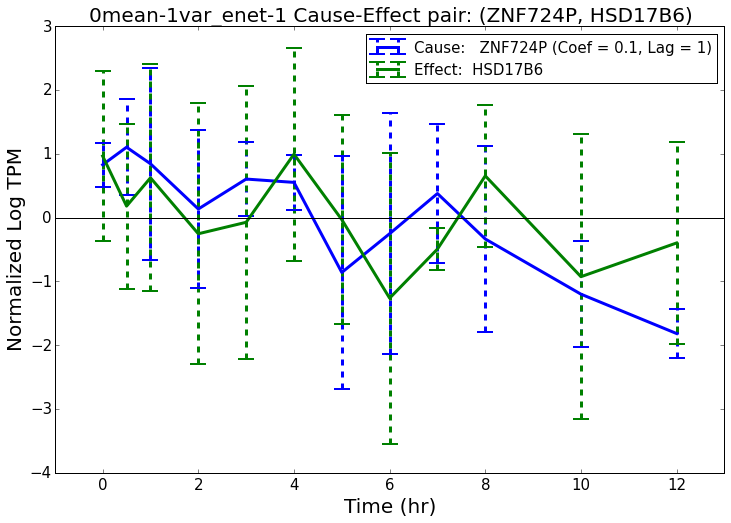

Filename:  analysis/plots/common/tf-any/ZNF724P-HSD17B6/0mean-1var_enet-1_no-bar-ZNF724P-HSD17B6-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/common/tf-any/ZNF724P-HSD17B6/0mean-1var_enet-1_no-bar-ZNF724P-HSD17B6-lag-1-coef-1E-01.pdf


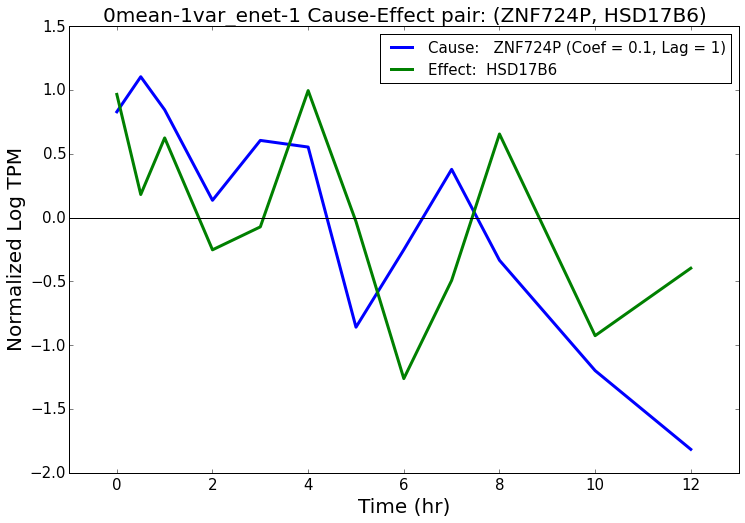

***********************************************
0mean-1var_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
4594            ZNF724P             HSD17B6  0.064626   1.0     TF-Bioguo,             NaN
Written to  analysis/plots/common/tf-any/ZNF724P-HSD17B6/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-any/ZNF724P-HSD17B6/0mean-1var_enet-2_ZNF724P-HSD17B6-lag-2-coef-6E-02.pdf
Plot saved to  analysis/plots/common/tf-any/ZNF724P-HSD17B6/0mean-1var_enet-2_ZNF724P-HSD17B6-lag-2-coef-6E-02.pdf


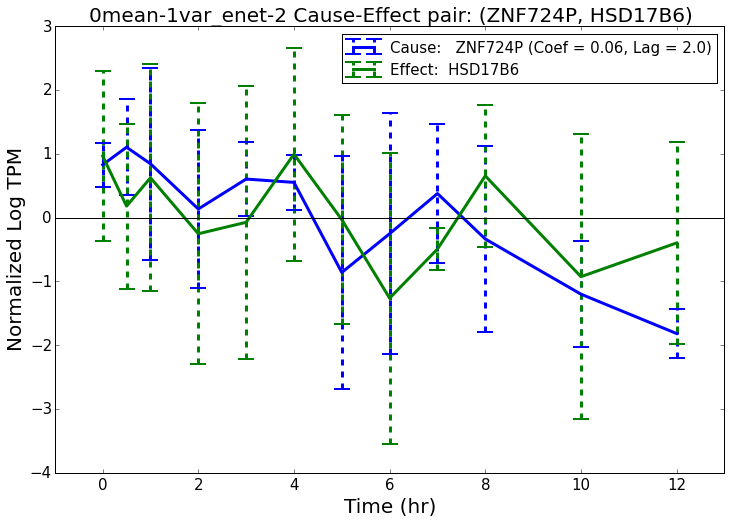

Filename:  analysis/plots/common/tf-any/ZNF724P-HSD17B6/0mean-1var_enet-2_no-bar-ZNF724P-HSD17B6-lag-2-coef-6E-02.pdf
Plot saved to  analysis/plots/common/tf-any/ZNF724P-HSD17B6/0mean-1var_enet-2_no-bar-ZNF724P-HSD17B6-lag-2-coef-6E-02.pdf


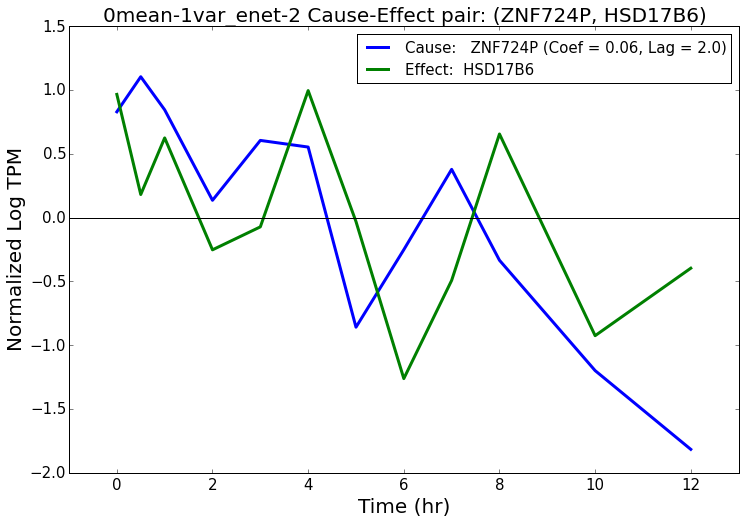

***********************************************
0mean-unnormalized_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
3245            ZNF724P             HSD17B6  0.106119     1     TF-Bioguo,             NaN
Written to  analysis/plots/common/tf-any/ZNF724P-HSD17B6/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-any/ZNF724P-HSD17B6/0mean-unnormalized_enet-1_ZNF724P-HSD17B6-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/common/tf-any/ZNF724P-HSD17B6/0mean-unnormalized_enet-1_ZNF724P-HSD17B6-lag-1-coef-1E-01.pdf


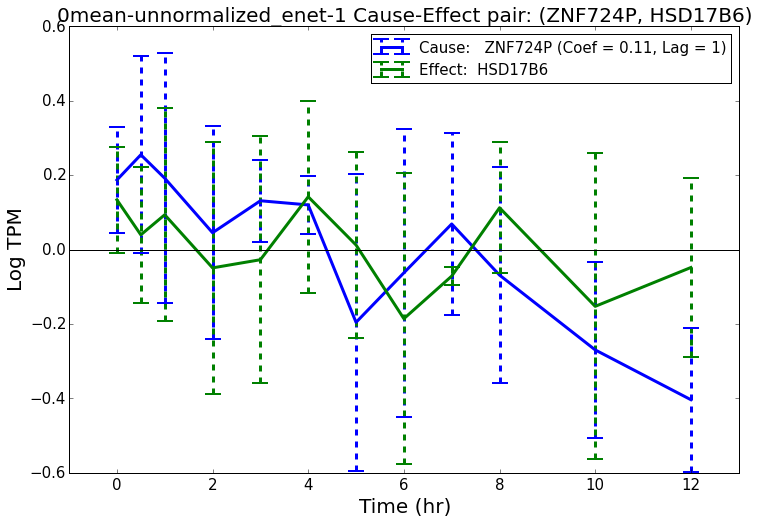

Filename:  analysis/plots/common/tf-any/ZNF724P-HSD17B6/0mean-unnormalized_enet-1_no-bar-ZNF724P-HSD17B6-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/common/tf-any/ZNF724P-HSD17B6/0mean-unnormalized_enet-1_no-bar-ZNF724P-HSD17B6-lag-1-coef-1E-01.pdf


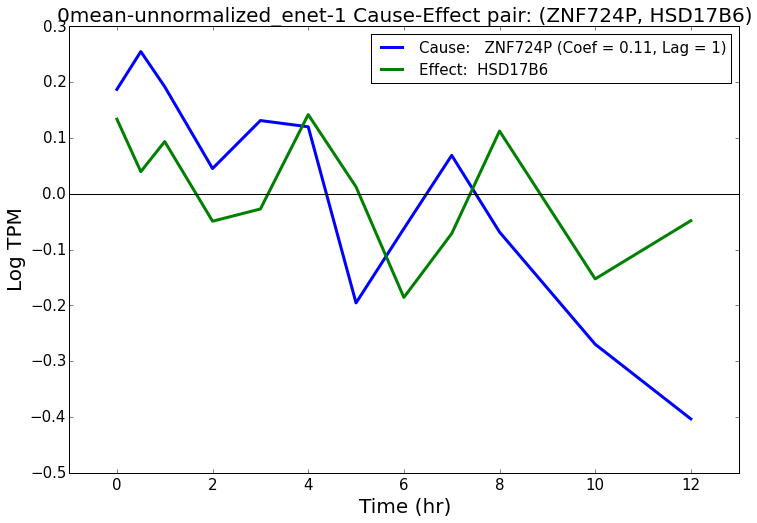

***********************************************
0mean-unnormalized_enet-2
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
755            ZNF724P             HSD17B6  0.112091   1.0     TF-Bioguo,             NaN
Written to  analysis/plots/common/tf-any/ZNF724P-HSD17B6/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-any/ZNF724P-HSD17B6/0mean-unnormalized_enet-2_ZNF724P-HSD17B6-lag-2-coef-1E-01.pdf
Plot saved to  analysis/plots/common/tf-any/ZNF724P-HSD17B6/0mean-unnormalized_enet-2_ZNF724P-HSD17B6-lag-2-coef-1E-01.pdf


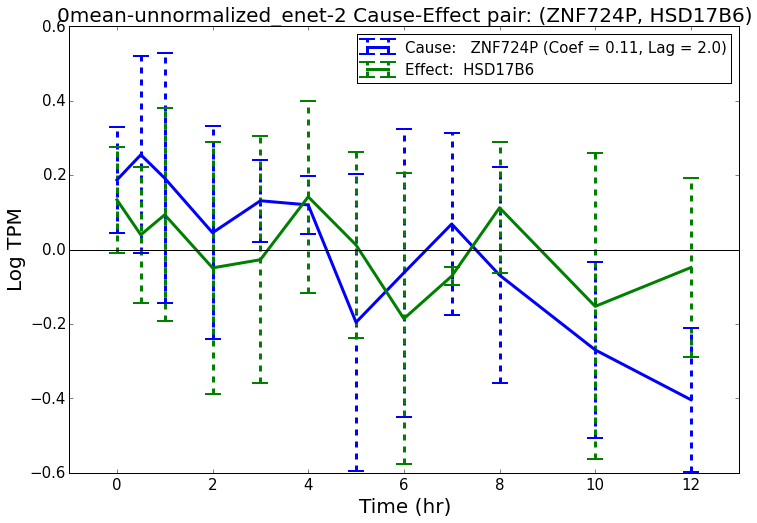

Filename:  analysis/plots/common/tf-any/ZNF724P-HSD17B6/0mean-unnormalized_enet-2_no-bar-ZNF724P-HSD17B6-lag-2-coef-1E-01.pdf
Plot saved to  analysis/plots/common/tf-any/ZNF724P-HSD17B6/0mean-unnormalized_enet-2_no-bar-ZNF724P-HSD17B6-lag-2-coef-1E-01.pdf


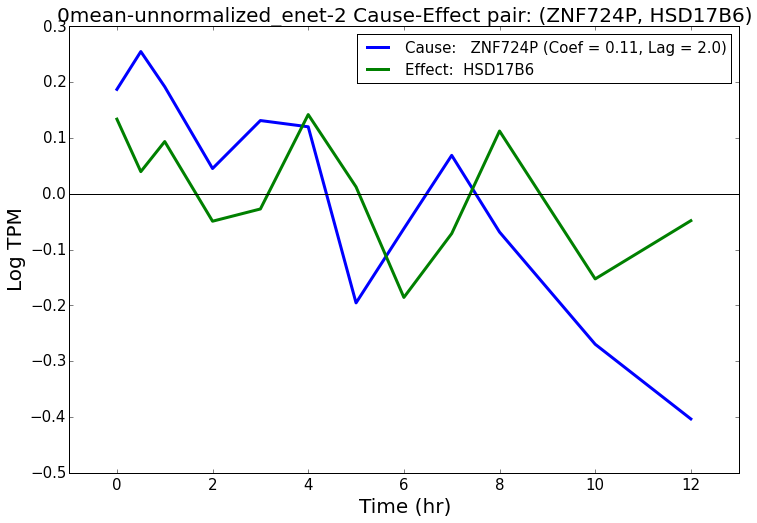

********************************
HOXB5 C12orf73
********************************
***********************************************
0mean-1var_enet-1
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
388              HOXB5            C12orf73  0.126521     1     TF-Bioguo,             NaN
Written to  analysis/plots/common/tf-any/HOXB5-C12orf73/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-any/HOXB5-C12orf73/0mean-1var_enet-1_HOXB5-C12orf73-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/common/tf-any/HOXB5-C12orf73/0mean-1var_enet-1_HOXB5-C12orf73-lag-1-coef-1E-01.pdf


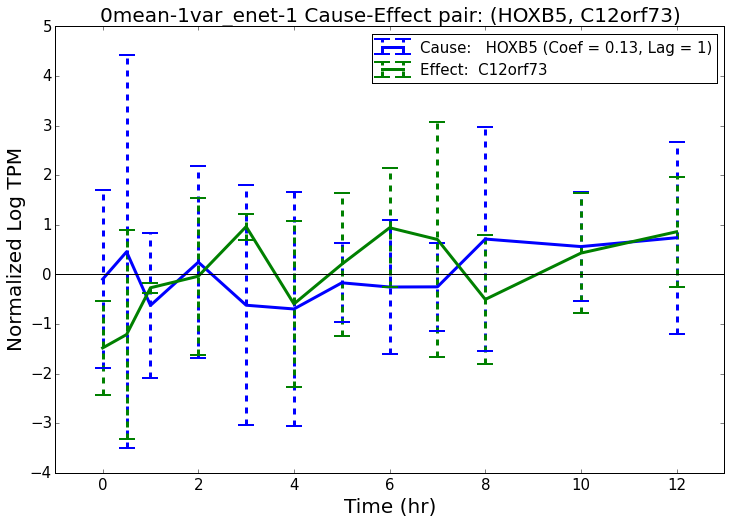

Filename:  analysis/plots/common/tf-any/HOXB5-C12orf73/0mean-1var_enet-1_no-bar-HOXB5-C12orf73-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/common/tf-any/HOXB5-C12orf73/0mean-1var_enet-1_no-bar-HOXB5-C12orf73-lag-1-coef-1E-01.pdf


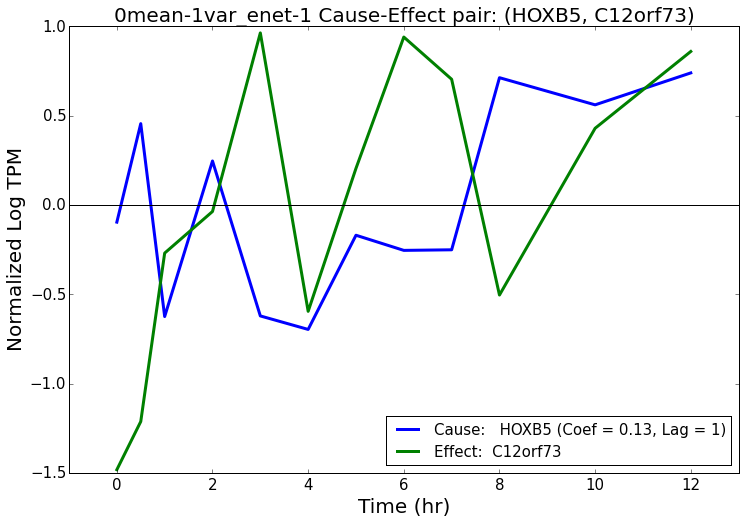

***********************************************
0mean-1var_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect   Weight  Coef Summary: Cause Summary: Effect
1949              HOXB5            C12orf73  0.07653   1.0     TF-Bioguo,             NaN
Written to  analysis/plots/common/tf-any/HOXB5-C12orf73/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-any/HOXB5-C12orf73/0mean-1var_enet-2_HOXB5-C12orf73-lag-2-coef-8E-02.pdf
Plot saved to  analysis/plots/common/tf-any/HOXB5-C12orf73/0mean-1var_enet-2_HOXB5-C12orf73-lag-2-coef-8E-02.pdf


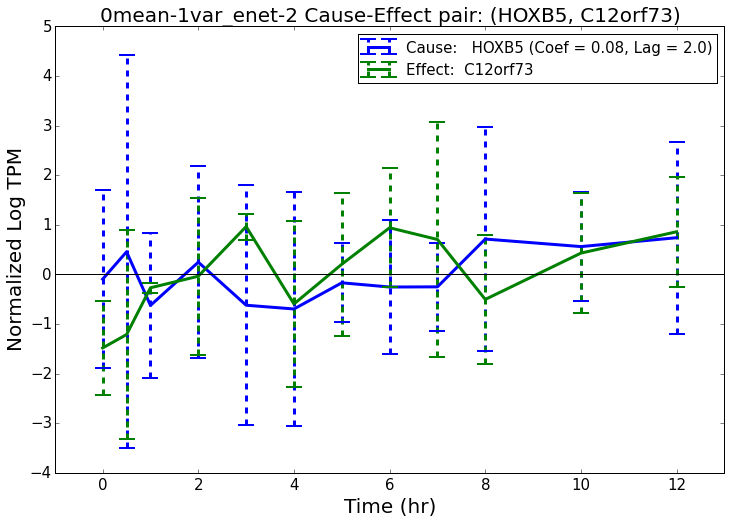

Filename:  analysis/plots/common/tf-any/HOXB5-C12orf73/0mean-1var_enet-2_no-bar-HOXB5-C12orf73-lag-2-coef-8E-02.pdf
Plot saved to  analysis/plots/common/tf-any/HOXB5-C12orf73/0mean-1var_enet-2_no-bar-HOXB5-C12orf73-lag-2-coef-8E-02.pdf


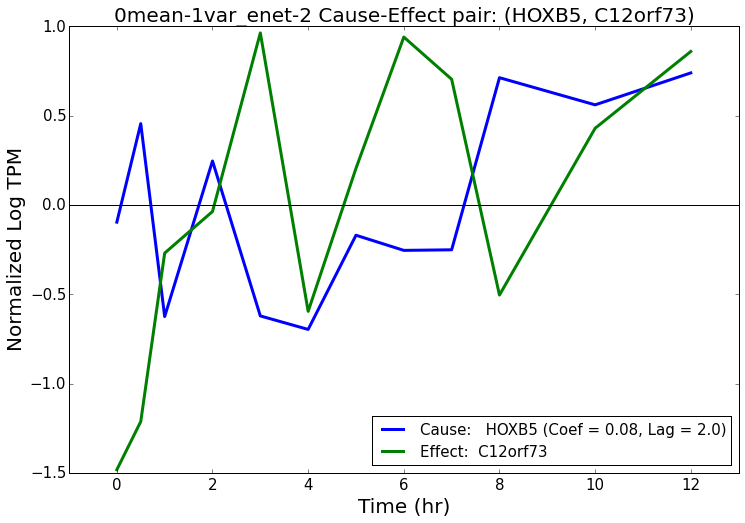

***********************************************
0mean-unnormalized_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
6638              HOXB5            C12orf73  0.084277     1     TF-Bioguo,             NaN
Written to  analysis/plots/common/tf-any/HOXB5-C12orf73/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-any/HOXB5-C12orf73/0mean-unnormalized_enet-1_HOXB5-C12orf73-lag-1-coef-8E-02.pdf
Plot saved to  analysis/plots/common/tf-any/HOXB5-C12orf73/0mean-unnormalized_enet-1_HOXB5-C12orf73-lag-1-coef-8E-02.pdf


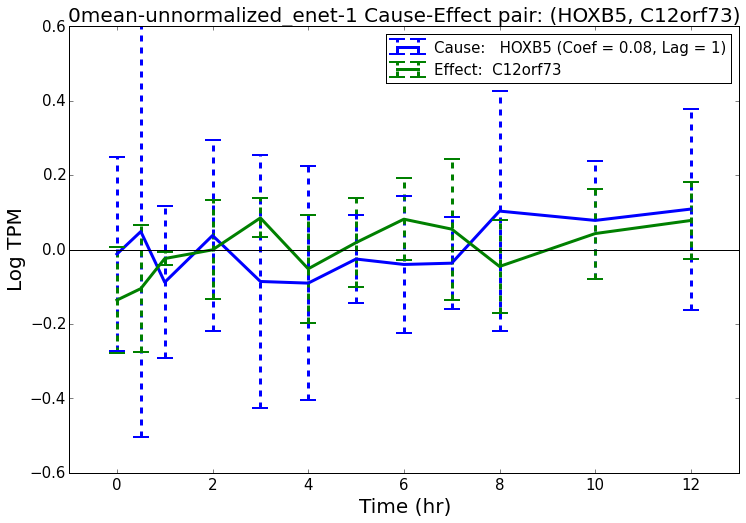

Filename:  analysis/plots/common/tf-any/HOXB5-C12orf73/0mean-unnormalized_enet-1_no-bar-HOXB5-C12orf73-lag-1-coef-8E-02.pdf
Plot saved to  analysis/plots/common/tf-any/HOXB5-C12orf73/0mean-unnormalized_enet-1_no-bar-HOXB5-C12orf73-lag-1-coef-8E-02.pdf


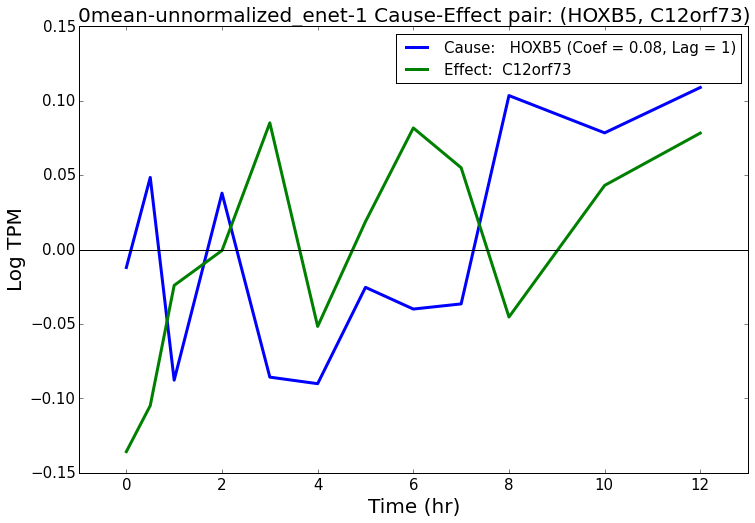

***********************************************
0mean-unnormalized_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
6731              HOXB5            C12orf73  0.065938   1.0     TF-Bioguo,             NaN
Written to  analysis/plots/common/tf-any/HOXB5-C12orf73/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-any/HOXB5-C12orf73/0mean-unnormalized_enet-2_HOXB5-C12orf73-lag-2-coef-7E-02.pdf
Plot saved to  analysis/plots/common/tf-any/HOXB5-C12orf73/0mean-unnormalized_enet-2_HOXB5-C12orf73-lag-2-coef-7E-02.pdf


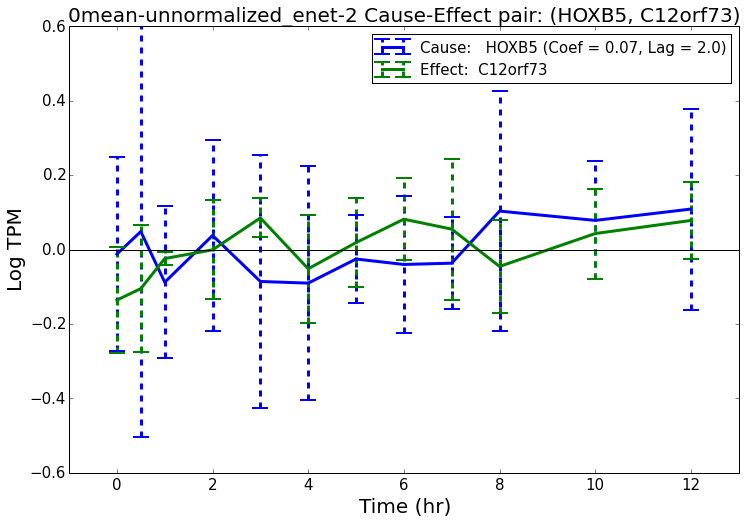

Filename:  analysis/plots/common/tf-any/HOXB5-C12orf73/0mean-unnormalized_enet-2_no-bar-HOXB5-C12orf73-lag-2-coef-7E-02.pdf
Plot saved to  analysis/plots/common/tf-any/HOXB5-C12orf73/0mean-unnormalized_enet-2_no-bar-HOXB5-C12orf73-lag-2-coef-7E-02.pdf


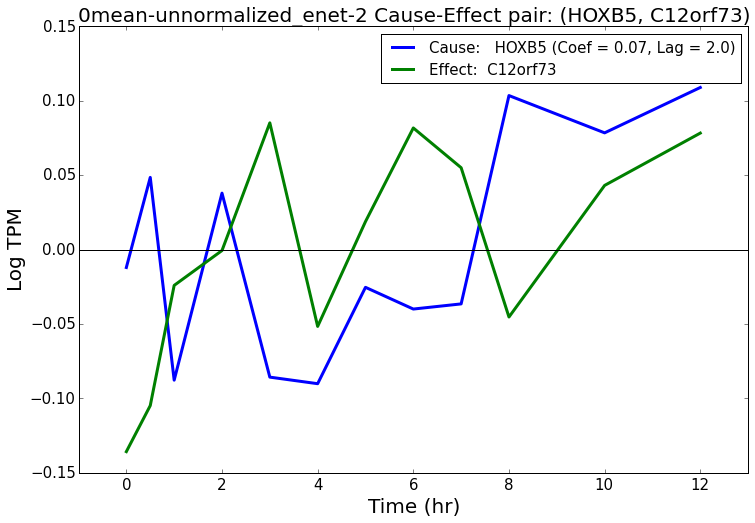

In [73]:
for i, r in plot_df.iterrows():
    print "********************************"
    print r["Gene Symbol: Cause"], r["Gene Symbol: Effect"]
    print "********************************"
    
    
    all_plot_folder = os.path.join(plot_subfolder, "-".join([r["Gene Symbol: Cause"], r["Gene Symbol: Effect"]]))
    
    indices = []
    for j in range(len(names)):
        if r[names[j]] == 1:
            # plot if contains
            indices.append(j)
    
    plot_nets = [nets[ind][nets[ind]["Cause-Effect"] == r["Cause-Effect"]] for ind in indices]
    for p in range(len(plot_nets)):
        plot_nets[p]["Gene Symbol: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_nets[p]["Cause"].values]
        plot_nets[p]["Gene Symbol: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_nets[p]["Effect"].values]
    
    plot_data_hg_df_list = [data_hg_df_list[ind] for ind in indices]
    plot_names = [names[ind] for ind in indices]
    plot_timekeys_list = [timekeys_list[ind] for ind in indices]
    plot_num_per_keys_list = [num_per_keys_list[ind] for ind in indices]
    plot_timepoints_list = [timepoints_list[ind] for ind in indices]
    
    
    do_plot_nets(plot_data_hg_df_list, plot_nets, plot_names, plot_timekeys_list, plot_num_per_keys_list, plot_timepoints_list,
                all_plot_folder=all_plot_folder, include_name_prefix=True, ylabels=ylabels)
    
#     for plot_net, plot_name in zip(plot_nets, plot_names):
#         print plot_name
#         display(plot_net)

# TF-TF

In [74]:
plotfoldersuffix = "tf-tf"
plot_df = edge_network_df[np.logical_and(edge_network_df["Cause"].isin(tf_genes),
                                         edge_network_df["Effect"].isin(tf_genes))].head(top_edge_num)

display(plot_df)

plot_subfolder = os.path.join(plot_common_folder, plotfoldersuffix)
if not os.path.exists(plot_subfolder):
    os.makedirs(plot_subfolder)
    
outfile = os.path.join(plot_subfolder, "top_interactions.csv")
plot_df.to_csv(outfile, index=0)

,Cause-Effect,Cause,Effect,Gene Symbol: Cause,Gene Symbol: Effect,Summary: Cause,Summary: Effect,Abs-Avg-Weight,Total,Networks,0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,Weight: 0mean-1var_enet-1,Weight: 0mean-1var_enet-2,Weight: 0mean-unnormalized_enet-1,Weight: 0mean-unnormalized_enet-2
129,ENSG00000004848.6-ENSG00000162624.13,ENSG00000004848.6,ENSG00000162624.13,ARX,LHX8,"TF-Bioguo,","TF-Bioguo,",0.075,4.0,"0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",1,1,1,1,-0.085646,-0.073204,-0.104628,-0.038271
41837,ENSG00000177494.5-ENSG00000125398.5,ENSG00000177494.5,ENSG00000125398.5,ZBED2,SOX9,"TF-Bioguo,","TF-Bioguo,",0.055,3.0,"0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-2,",1,1,0,1,-0.079329,-0.055568,0.000000,-0.083999
34154,ENSG00000167074.13-ENSG00000136770.9,ENSG00000167074.13,ENSG00000136770.9,TEF,DNAJC1,"TF-Bioguo,","TF-Bioguo,",0.041,3.0,"0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",0,1,1,1,0.000000,0.060074,0.064157,0.041721


********************************
ARX LHX8
********************************


/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


***********************************************
0mean-1var_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
4382                ARX                LHX8 -0.085646     1     TF-Bioguo,      TF-Bioguo,
Written to  analysis/plots/common/tf-tf/ARX-LHX8/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-tf/ARX-LHX8/0mean-1var_enet-1_ARX-LHX8-lag-1-coef--9E-02.pdf
Plot saved to  analysis/plots/common/tf-tf/ARX-LHX8/0mean-1var_enet-1_ARX-LHX8-lag-1-coef--9E-02.pdf


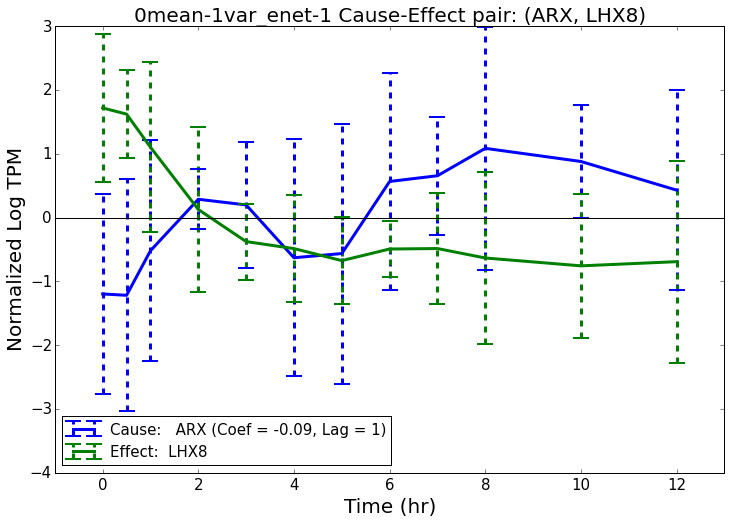

Filename:  analysis/plots/common/tf-tf/ARX-LHX8/0mean-1var_enet-1_no-bar-ARX-LHX8-lag-1-coef--9E-02.pdf
Plot saved to  analysis/plots/common/tf-tf/ARX-LHX8/0mean-1var_enet-1_no-bar-ARX-LHX8-lag-1-coef--9E-02.pdf


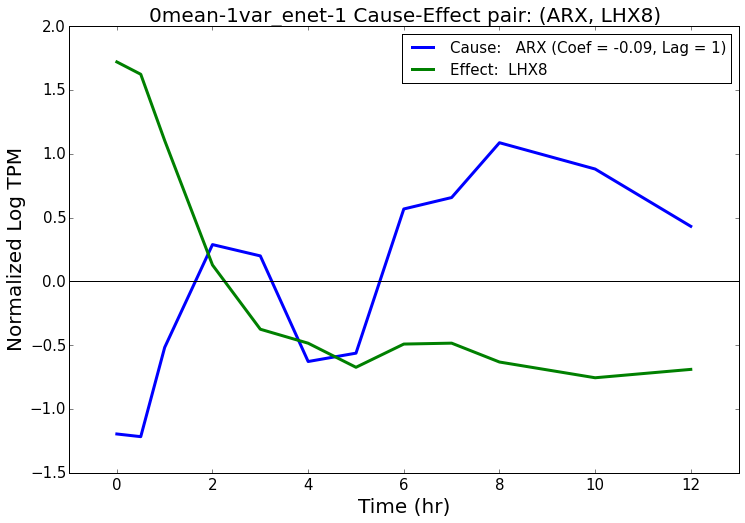

***********************************************
0mean-1var_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
2483                ARX                LHX8 -0.073204   1.0     TF-Bioguo,      TF-Bioguo,
Written to  analysis/plots/common/tf-tf/ARX-LHX8/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-tf/ARX-LHX8/0mean-1var_enet-2_ARX-LHX8-lag-2-coef--7E-02.pdf
Plot saved to  analysis/plots/common/tf-tf/ARX-LHX8/0mean-1var_enet-2_ARX-LHX8-lag-2-coef--7E-02.pdf


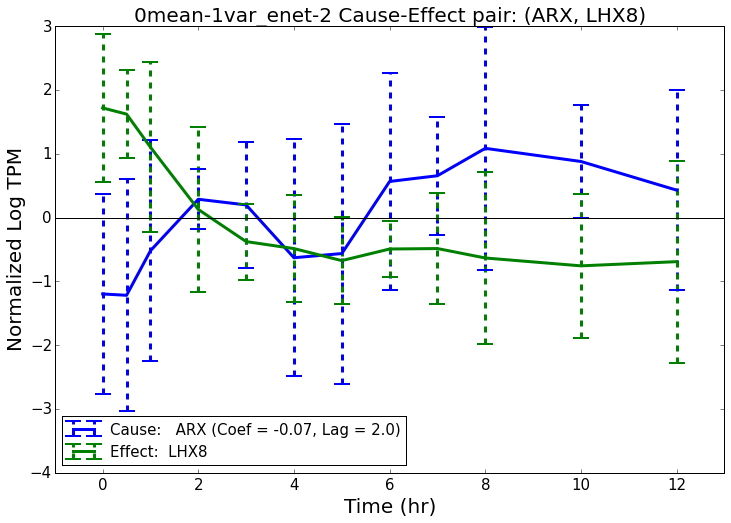

Filename:  analysis/plots/common/tf-tf/ARX-LHX8/0mean-1var_enet-2_no-bar-ARX-LHX8-lag-2-coef--7E-02.pdf
Plot saved to  analysis/plots/common/tf-tf/ARX-LHX8/0mean-1var_enet-2_no-bar-ARX-LHX8-lag-2-coef--7E-02.pdf


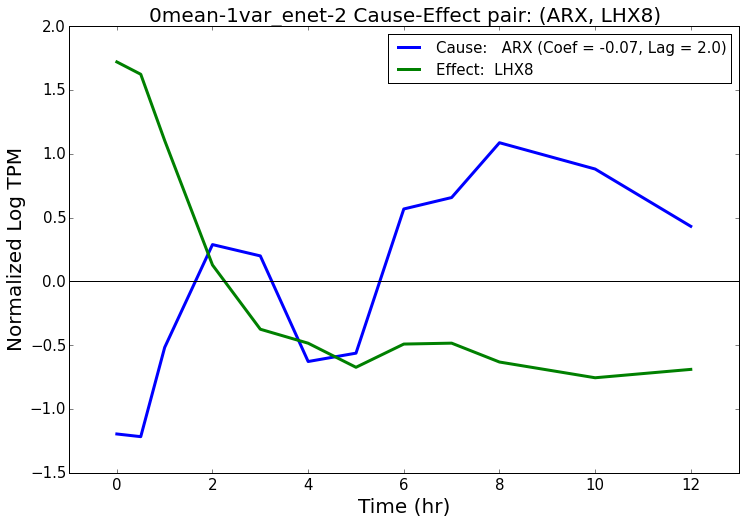

***********************************************
0mean-unnormalized_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
3429                ARX                LHX8 -0.104628     1     TF-Bioguo,      TF-Bioguo,
Written to  analysis/plots/common/tf-tf/ARX-LHX8/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-tf/ARX-LHX8/0mean-unnormalized_enet-1_ARX-LHX8-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/tf-tf/ARX-LHX8/0mean-unnormalized_enet-1_ARX-LHX8-lag-1-coef--1E-01.pdf


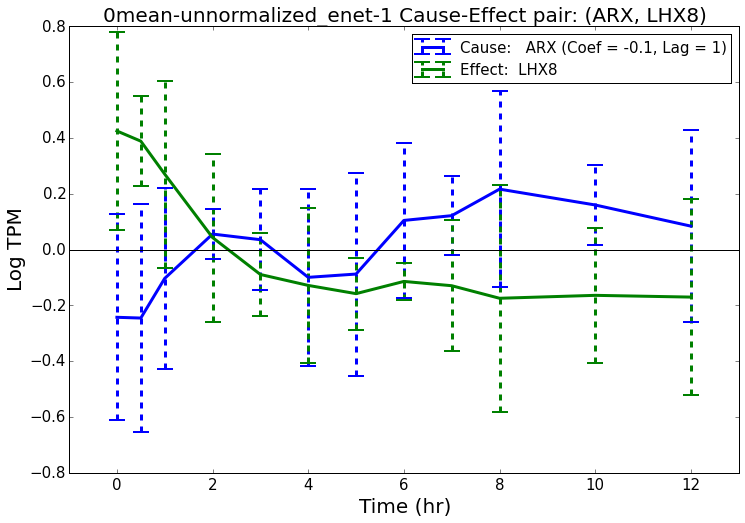

Filename:  analysis/plots/common/tf-tf/ARX-LHX8/0mean-unnormalized_enet-1_no-bar-ARX-LHX8-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/tf-tf/ARX-LHX8/0mean-unnormalized_enet-1_no-bar-ARX-LHX8-lag-1-coef--1E-01.pdf


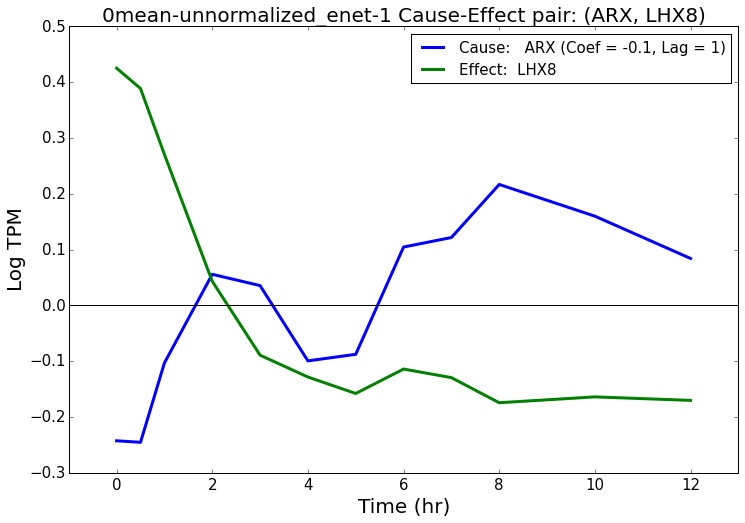

***********************************************
0mean-unnormalized_enet-2
***********************************************
      Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
20110                ARX                LHX8 -0.038271   1.0     TF-Bioguo,      TF-Bioguo,
Written to  analysis/plots/common/tf-tf/ARX-LHX8/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-tf/ARX-LHX8/0mean-unnormalized_enet-2_ARX-LHX8-lag-2-coef--4E-02.pdf
Plot saved to  analysis/plots/common/tf-tf/ARX-LHX8/0mean-unnormalized_enet-2_ARX-LHX8-lag-2-coef--4E-02.pdf


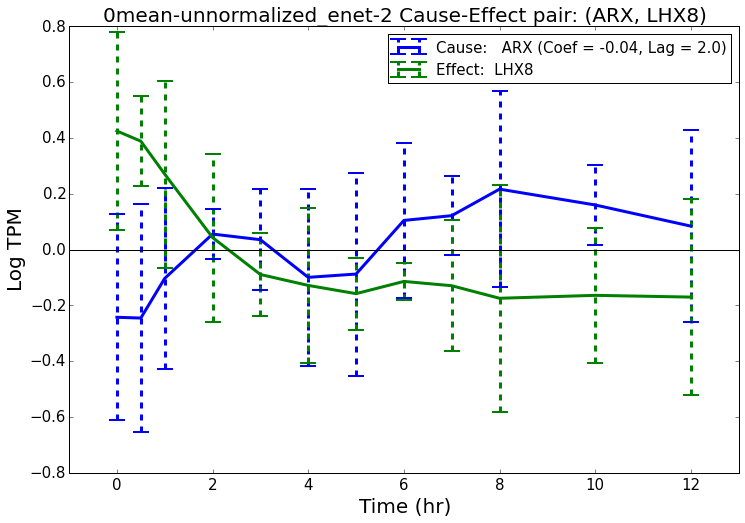

Filename:  analysis/plots/common/tf-tf/ARX-LHX8/0mean-unnormalized_enet-2_no-bar-ARX-LHX8-lag-2-coef--4E-02.pdf
Plot saved to  analysis/plots/common/tf-tf/ARX-LHX8/0mean-unnormalized_enet-2_no-bar-ARX-LHX8-lag-2-coef--4E-02.pdf


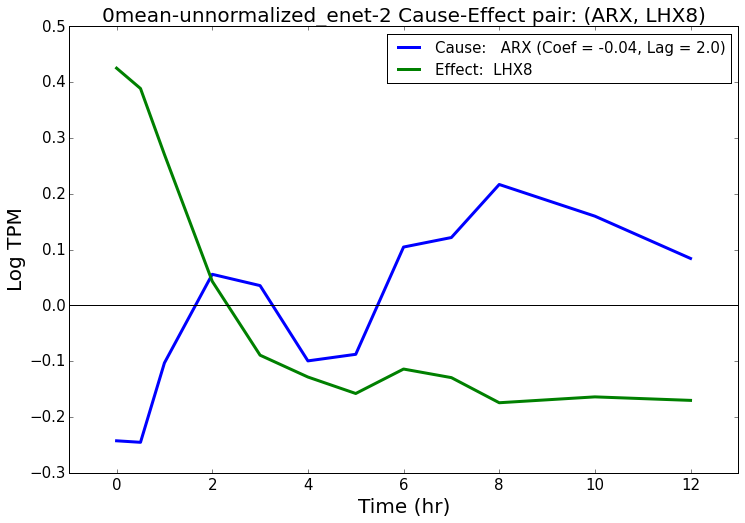

********************************
ZBED2 SOX9
********************************
***********************************************
0mean-1var_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
5908              ZBED2                SOX9 -0.079329     1     TF-Bioguo,      TF-Bioguo,
Written to  analysis/plots/common/tf-tf/ZBED2-SOX9/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-tf/ZBED2-SOX9/0mean-1var_enet-1_ZBED2-SOX9-lag-1-coef--8E-02.pdf
Plot saved to  analysis/plots/common/tf-tf/ZBED2-SOX9/0mean-1var_enet-1_ZBED2-SOX9-lag-1-coef--8E-02.pdf


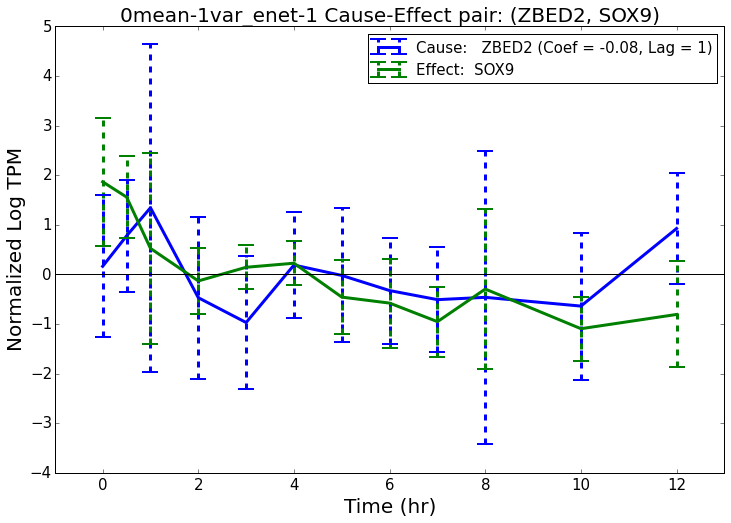

Filename:  analysis/plots/common/tf-tf/ZBED2-SOX9/0mean-1var_enet-1_no-bar-ZBED2-SOX9-lag-1-coef--8E-02.pdf
Plot saved to  analysis/plots/common/tf-tf/ZBED2-SOX9/0mean-1var_enet-1_no-bar-ZBED2-SOX9-lag-1-coef--8E-02.pdf


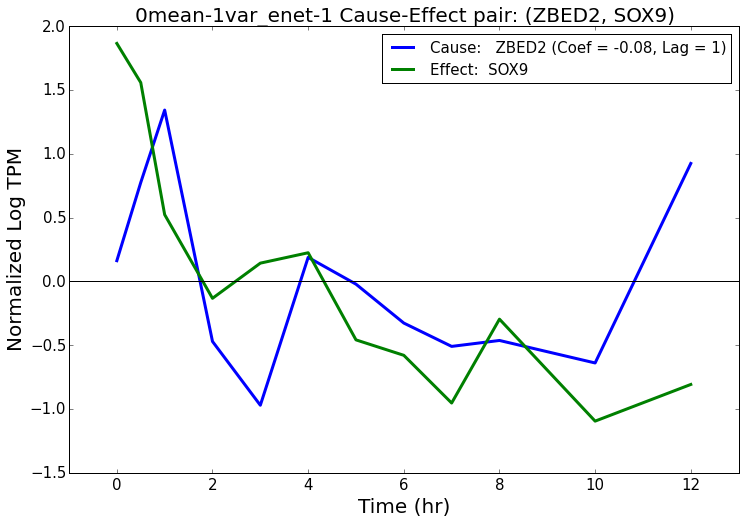

***********************************************
0mean-1var_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
7894              ZBED2                SOX9 -0.055568   2.0     TF-Bioguo,      TF-Bioguo,
Written to  analysis/plots/common/tf-tf/ZBED2-SOX9/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-tf/ZBED2-SOX9/0mean-1var_enet-2_ZBED2-SOX9-lag-2-coef--6E-02.pdf
Plot saved to  analysis/plots/common/tf-tf/ZBED2-SOX9/0mean-1var_enet-2_ZBED2-SOX9-lag-2-coef--6E-02.pdf


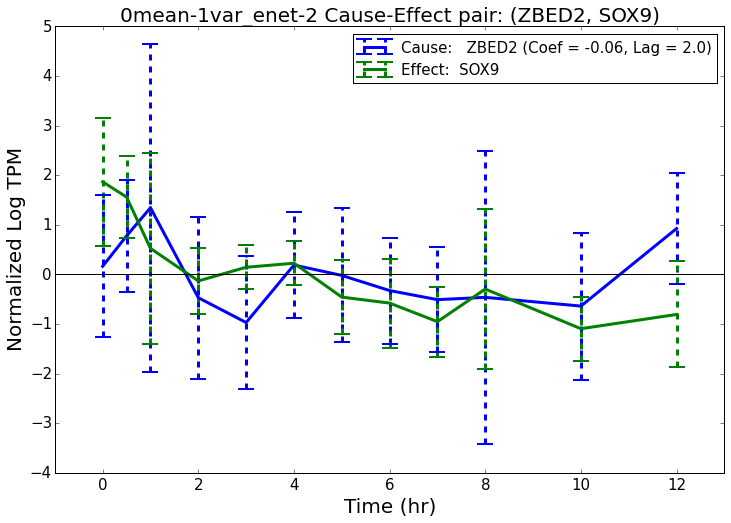

Filename:  analysis/plots/common/tf-tf/ZBED2-SOX9/0mean-1var_enet-2_no-bar-ZBED2-SOX9-lag-2-coef--6E-02.pdf
Plot saved to  analysis/plots/common/tf-tf/ZBED2-SOX9/0mean-1var_enet-2_no-bar-ZBED2-SOX9-lag-2-coef--6E-02.pdf


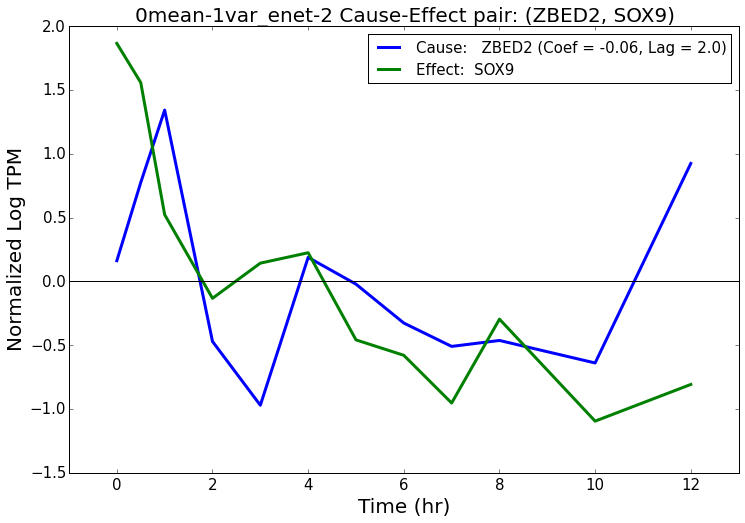

***********************************************
0mean-unnormalized_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
2919              ZBED2                SOX9 -0.083999   2.0     TF-Bioguo,      TF-Bioguo,
Written to  analysis/plots/common/tf-tf/ZBED2-SOX9/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-tf/ZBED2-SOX9/0mean-unnormalized_enet-2_ZBED2-SOX9-lag-2-coef--8E-02.pdf
Plot saved to  analysis/plots/common/tf-tf/ZBED2-SOX9/0mean-unnormalized_enet-2_ZBED2-SOX9-lag-2-coef--8E-02.pdf


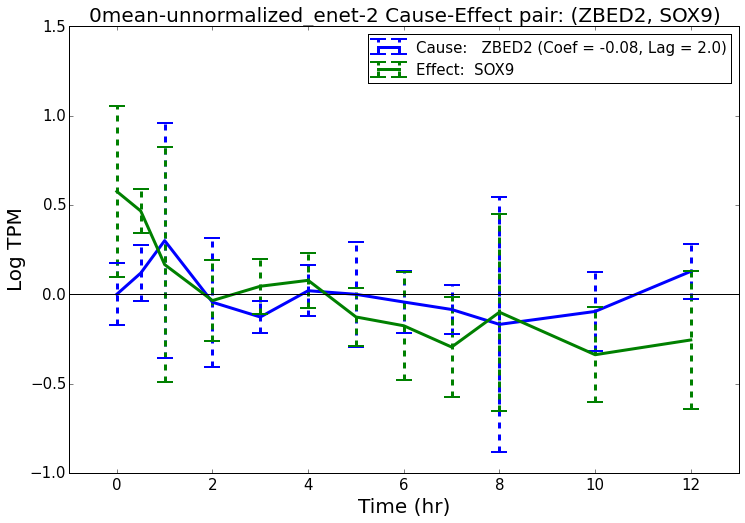

Filename:  analysis/plots/common/tf-tf/ZBED2-SOX9/0mean-unnormalized_enet-2_no-bar-ZBED2-SOX9-lag-2-coef--8E-02.pdf
Plot saved to  analysis/plots/common/tf-tf/ZBED2-SOX9/0mean-unnormalized_enet-2_no-bar-ZBED2-SOX9-lag-2-coef--8E-02.pdf


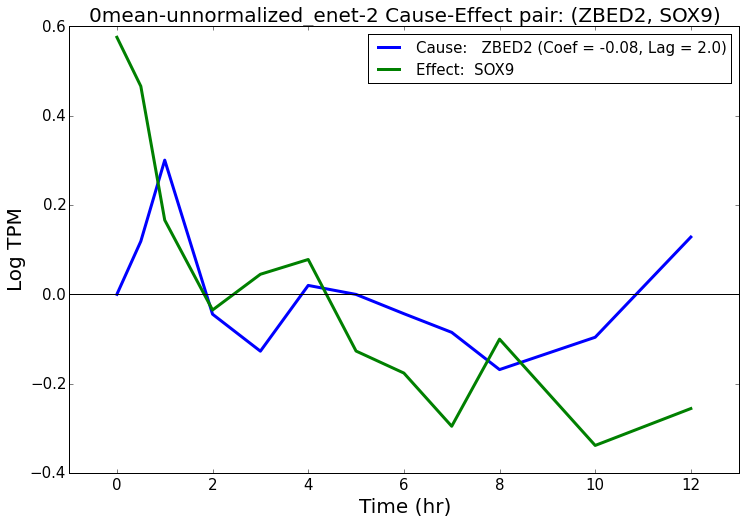

********************************
TEF DNAJC1
********************************
***********************************************
0mean-1var_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
6139                TEF              DNAJC1  0.060074   1.0     TF-Bioguo,      TF-Bioguo,
Written to  analysis/plots/common/tf-tf/TEF-DNAJC1/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-tf/TEF-DNAJC1/0mean-1var_enet-2_TEF-DNAJC1-lag-2-coef-6E-02.pdf
Plot saved to  analysis/plots/common/tf-tf/TEF-DNAJC1/0mean-1var_enet-2_TEF-DNAJC1-lag-2-coef-6E-02.pdf


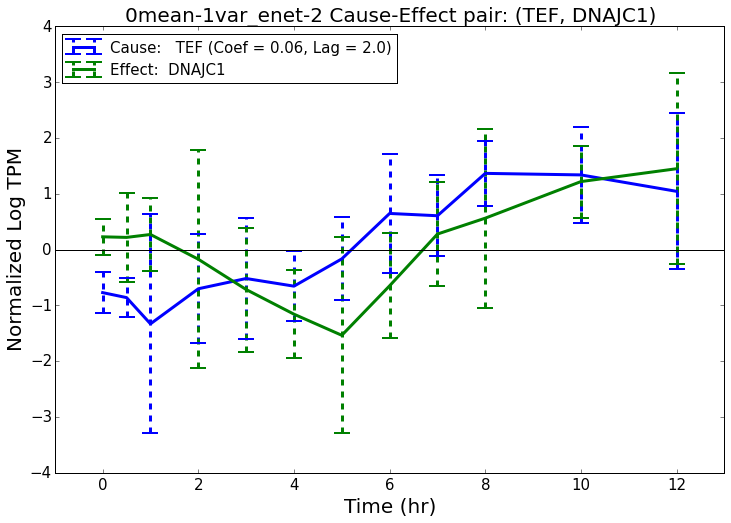

Filename:  analysis/plots/common/tf-tf/TEF-DNAJC1/0mean-1var_enet-2_no-bar-TEF-DNAJC1-lag-2-coef-6E-02.pdf
Plot saved to  analysis/plots/common/tf-tf/TEF-DNAJC1/0mean-1var_enet-2_no-bar-TEF-DNAJC1-lag-2-coef-6E-02.pdf


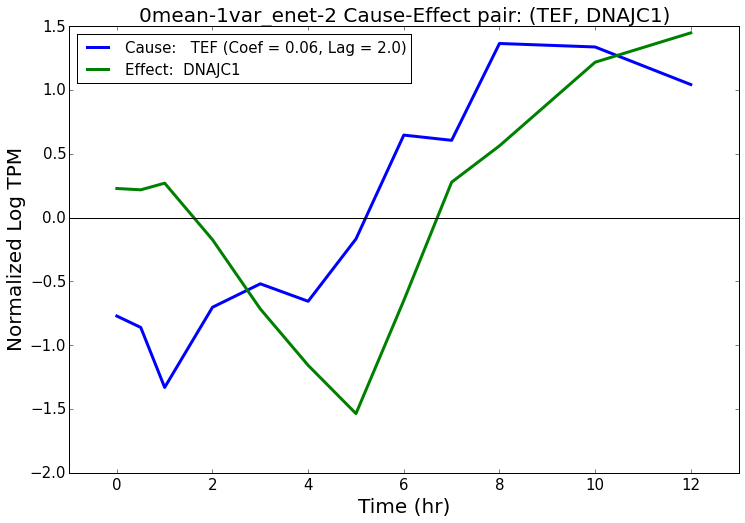

***********************************************
0mean-unnormalized_enet-1
***********************************************
      Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
12521                TEF              DNAJC1  0.064157     1     TF-Bioguo,      TF-Bioguo,
Written to  analysis/plots/common/tf-tf/TEF-DNAJC1/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-tf/TEF-DNAJC1/0mean-unnormalized_enet-1_TEF-DNAJC1-lag-1-coef-6E-02.pdf
Plot saved to  analysis/plots/common/tf-tf/TEF-DNAJC1/0mean-unnormalized_enet-1_TEF-DNAJC1-lag-1-coef-6E-02.pdf


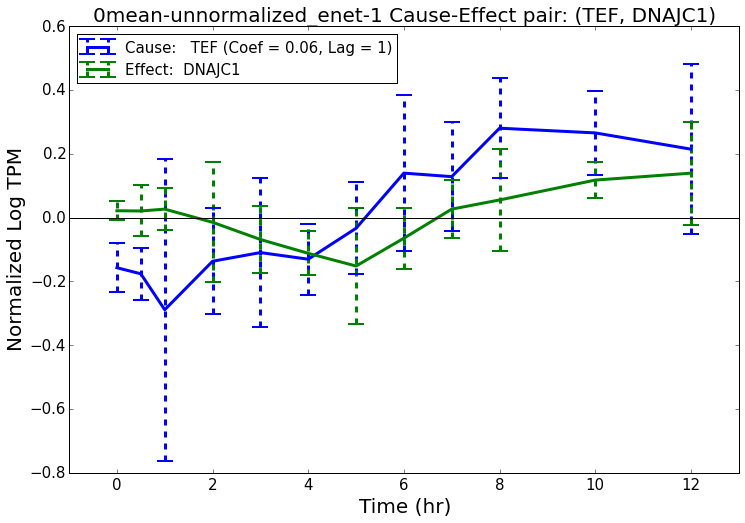

Filename:  analysis/plots/common/tf-tf/TEF-DNAJC1/0mean-unnormalized_enet-1_no-bar-TEF-DNAJC1-lag-1-coef-6E-02.pdf
Plot saved to  analysis/plots/common/tf-tf/TEF-DNAJC1/0mean-unnormalized_enet-1_no-bar-TEF-DNAJC1-lag-1-coef-6E-02.pdf


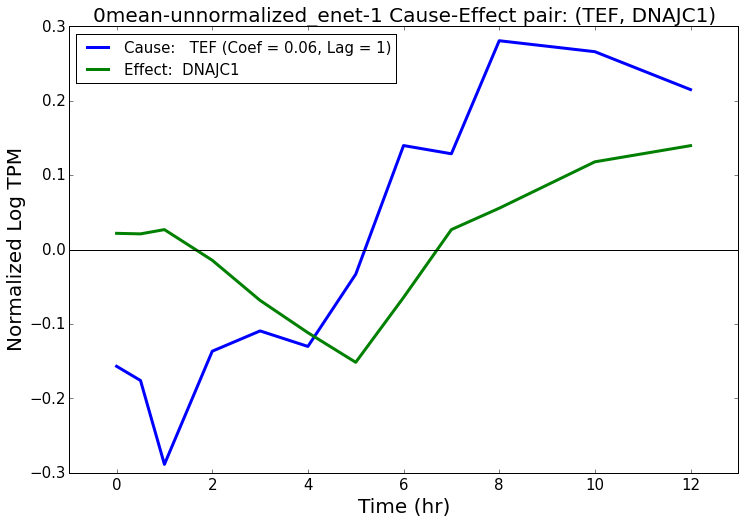

***********************************************
0mean-unnormalized_enet-2
***********************************************
      Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause Summary: Effect
18092                TEF              DNAJC1  0.041721   1.0     TF-Bioguo,      TF-Bioguo,
Written to  analysis/plots/common/tf-tf/TEF-DNAJC1/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-tf/TEF-DNAJC1/0mean-unnormalized_enet-2_TEF-DNAJC1-lag-2-coef-4E-02.pdf
Plot saved to  analysis/plots/common/tf-tf/TEF-DNAJC1/0mean-unnormalized_enet-2_TEF-DNAJC1-lag-2-coef-4E-02.pdf


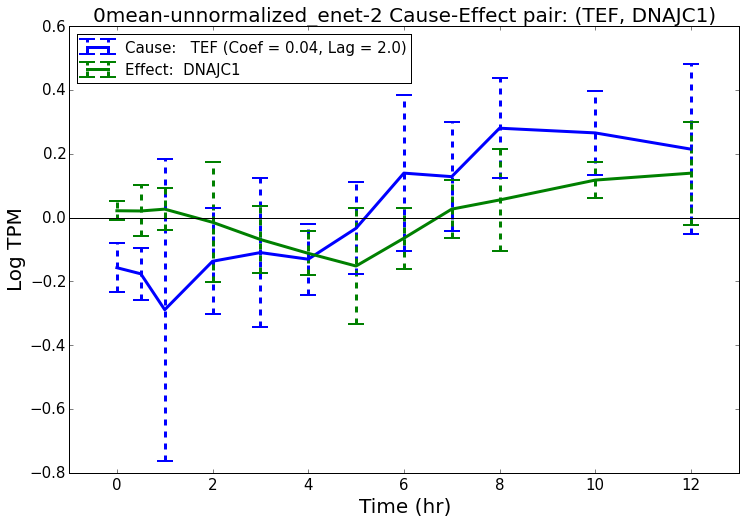

Filename:  analysis/plots/common/tf-tf/TEF-DNAJC1/0mean-unnormalized_enet-2_no-bar-TEF-DNAJC1-lag-2-coef-4E-02.pdf
Plot saved to  analysis/plots/common/tf-tf/TEF-DNAJC1/0mean-unnormalized_enet-2_no-bar-TEF-DNAJC1-lag-2-coef-4E-02.pdf


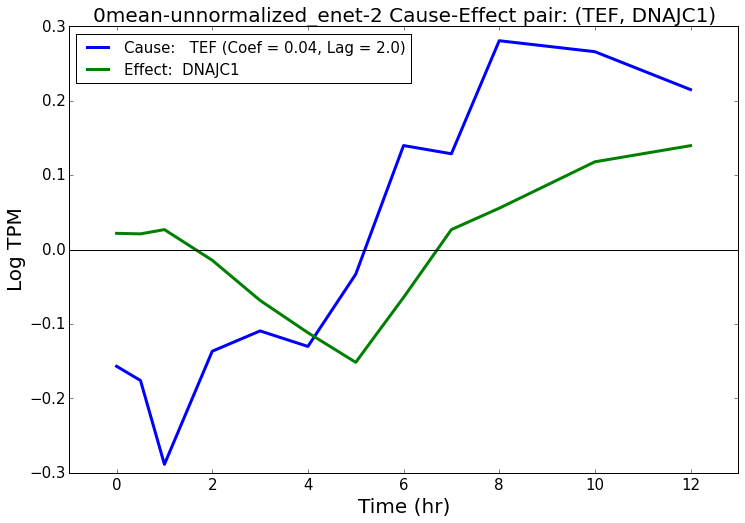

In [75]:
for i, r in plot_df.iterrows():
    print "********************************"
    print r["Gene Symbol: Cause"], r["Gene Symbol: Effect"]
    print "********************************"
    
    
    all_plot_folder = os.path.join(plot_subfolder, "-".join([r["Gene Symbol: Cause"], r["Gene Symbol: Effect"]]))
    
    indices = []
    for j in range(len(names)):
        if r[names[j]] == 1:
            # plot if contains
            indices.append(j)
    
    plot_nets = [nets[ind][nets[ind]["Cause-Effect"] == r["Cause-Effect"]] for ind in indices]
    for p in range(len(plot_nets)):
        plot_nets[p]["Gene Symbol: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_nets[p]["Cause"].values]
        plot_nets[p]["Gene Symbol: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_nets[p]["Effect"].values]
    
    plot_data_hg_df_list = [data_hg_df_list[ind] for ind in indices]
    plot_names = [names[ind] for ind in indices]
    plot_timekeys_list = [timekeys_list[ind] for ind in indices]
    plot_num_per_keys_list = [num_per_keys_list[ind] for ind in indices]
    plot_timepoints_list = [timepoints_list[ind] for ind in indices]
    
    
    do_plot_nets(plot_data_hg_df_list, plot_nets, plot_names, plot_timekeys_list, plot_num_per_keys_list, plot_timepoints_list,
                all_plot_folder=all_plot_folder, include_name_prefix=True, ylabels=ylabels)
    
#     for plot_net, plot_name in zip(plot_nets, plot_names):
#         print plot_name
#         display(plot_net)

# tf-imm

In [76]:
plotfoldersuffix = "tf-imm"
plot_df = edge_network_df[np.logical_and(edge_network_df["Cause"].isin(tf_genes), edge_network_df["Effect"].isin(imm_genes))].head(top_edge_num)

display(plot_df)

plot_subfolder = os.path.join(plot_common_folder, plotfoldersuffix)
if not os.path.exists(plot_subfolder):
    os.makedirs(plot_subfolder)
    
outfile = os.path.join(plot_subfolder, "top_interactions.csv")
plot_df.to_csv(outfile, index=0)

,Cause-Effect,Cause,Effect,Gene Symbol: Cause,Gene Symbol: Effect,Summary: Cause,Summary: Effect,Abs-Avg-Weight,Total,Networks,0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,Weight: 0mean-1var_enet-1,Weight: 0mean-1var_enet-2,Weight: 0mean-unnormalized_enet-1,Weight: 0mean-unnormalized_enet-2
55199,ENSG00000204531.14-ENSG00000163739.4,ENSG00000204531.14,ENSG00000163739.4,POU5F1,CXCL1,"GR_direct,TF-Bioguo,DNA-binding_GO,","Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,",0.106,2.0,"0mean-1var_enet-1,0mean-unnormalized_enet-1,",1,0,1,0,-0.106745,0.0,-0.318522,0.0
55076,ENSG00000204531.14-ENSG00000113916.16,ENSG00000204531.14,ENSG00000113916.16,POU5F1,BCL6,"GR_direct,TF-Bioguo,DNA-binding_GO,","GR_direct,TF-Bioguo,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,",0.082,2.0,"0mean-1var_enet-1,0mean-unnormalized_enet-1,",1,0,1,0,0.107241,0.0,0.220967,0.0
55252,ENSG00000204531.14-ENSG00000177606.6,ENSG00000204531.14,ENSG00000177606.6,POU5F1,JUN,"GR_direct,TF-Bioguo,DNA-binding_GO,","GR_GSEA,TF-Bioguo,TF-binding_GO,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,DNA-binding_GO,",0.070,2.0,"0mean-1var_enet-1,0mean-unnormalized_enet-1,",1,0,1,0,-0.075634,0.0,-0.205934,0.0


********************************
POU5F1 CXCL1
********************************


/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


***********************************************
0mean-1var_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                       Summary: Cause                                                    Summary: Effect
1317             POU5F1               CXCL1 -0.106745     1  GR_direct,TF-Bioguo,DNA-binding_GO,  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/tf-imm/POU5F1-CXCL1/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-imm/POU5F1-CXCL1/0mean-1var_enet-1_POU5F1-CXCL1-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/tf-imm/POU5F1-CXCL1/0mean-1var_enet-1_POU5F1-CXCL1-lag-1-coef--1E-01.pdf


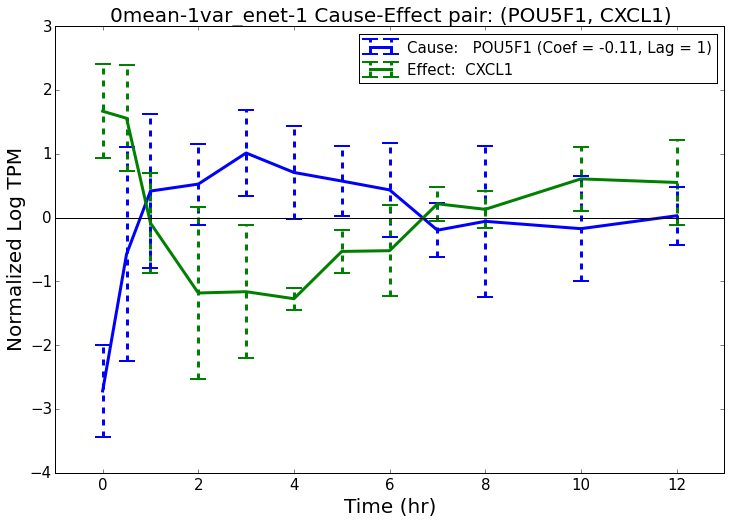

Filename:  analysis/plots/common/tf-imm/POU5F1-CXCL1/0mean-1var_enet-1_no-bar-POU5F1-CXCL1-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/tf-imm/POU5F1-CXCL1/0mean-1var_enet-1_no-bar-POU5F1-CXCL1-lag-1-coef--1E-01.pdf


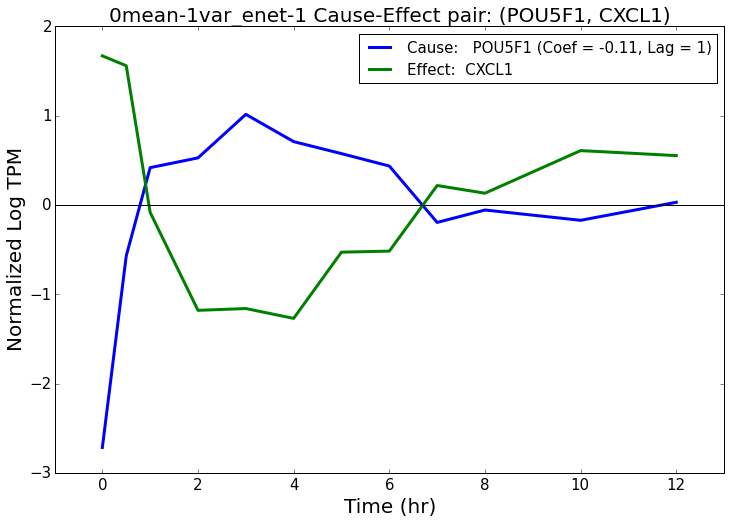

***********************************************
0mean-unnormalized_enet-1
***********************************************
  Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                       Summary: Cause                                                    Summary: Effect
2             POU5F1               CXCL1 -0.318522     1  GR_direct,TF-Bioguo,DNA-binding_GO,  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/tf-imm/POU5F1-CXCL1/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-imm/POU5F1-CXCL1/0mean-unnormalized_enet-1_POU5F1-CXCL1-lag-1-coef--3E-01.pdf
Plot saved to  analysis/plots/common/tf-imm/POU5F1-CXCL1/0mean-unnormalized_enet-1_POU5F1-CXCL1-lag-1-coef--3E-01.pdf


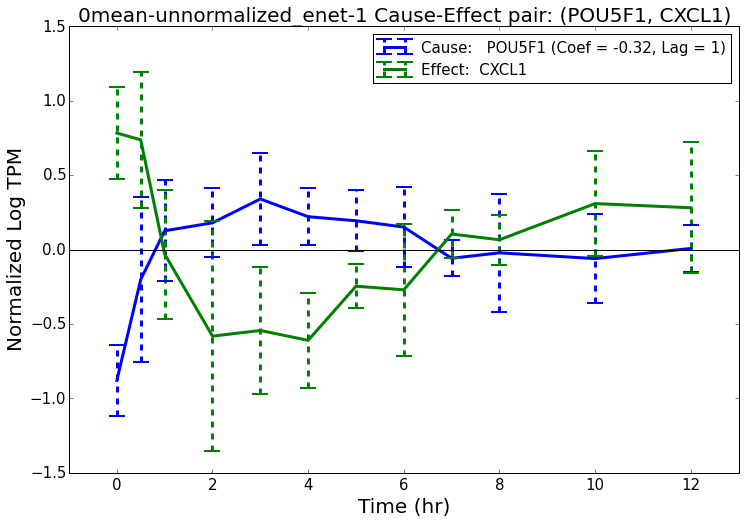

Filename:  analysis/plots/common/tf-imm/POU5F1-CXCL1/0mean-unnormalized_enet-1_no-bar-POU5F1-CXCL1-lag-1-coef--3E-01.pdf
Plot saved to  analysis/plots/common/tf-imm/POU5F1-CXCL1/0mean-unnormalized_enet-1_no-bar-POU5F1-CXCL1-lag-1-coef--3E-01.pdf


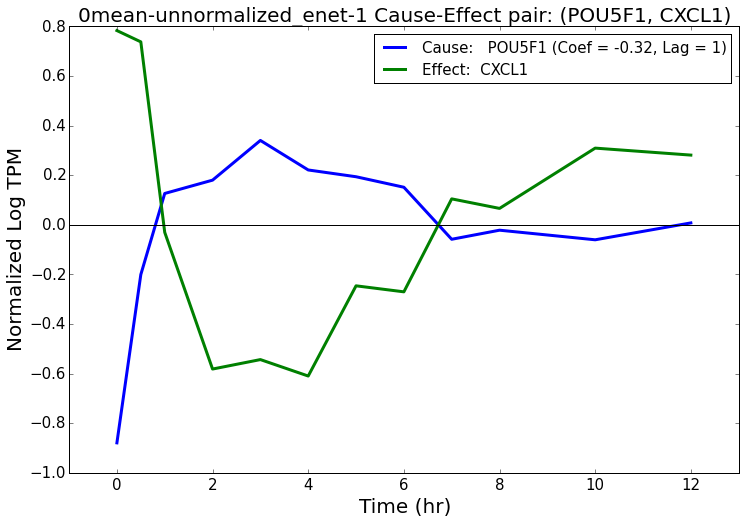

********************************
POU5F1 BCL6
********************************
***********************************************
0mean-1var_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                       Summary: Cause                                                           Summary: Effect
1283             POU5F1                BCL6  0.107241     1  GR_direct,TF-Bioguo,DNA-binding_GO,  GR_direct,TF-Bioguo,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/tf-imm/POU5F1-BCL6/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-imm/POU5F1-BCL6/0mean-1var_enet-1_POU5F1-BCL6-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/common/tf-imm/POU5F1-BCL6/0mean-1var_enet-1_POU5F1-BCL6-lag-1-coef-1E-01.pdf


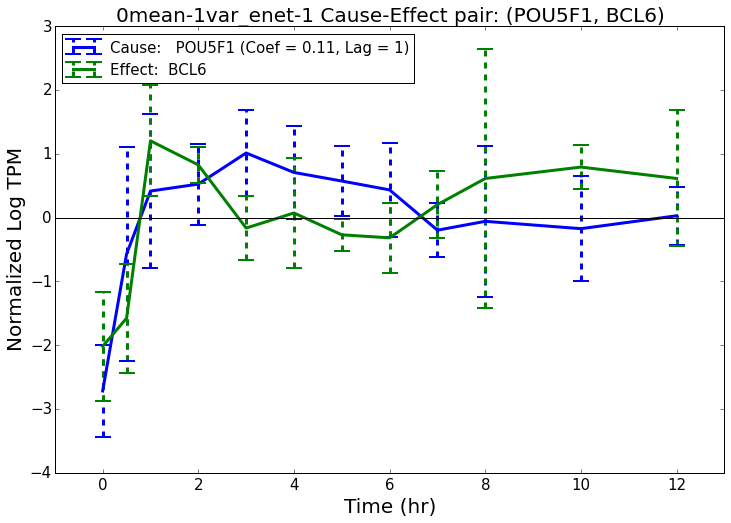

Filename:  analysis/plots/common/tf-imm/POU5F1-BCL6/0mean-1var_enet-1_no-bar-POU5F1-BCL6-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/common/tf-imm/POU5F1-BCL6/0mean-1var_enet-1_no-bar-POU5F1-BCL6-lag-1-coef-1E-01.pdf


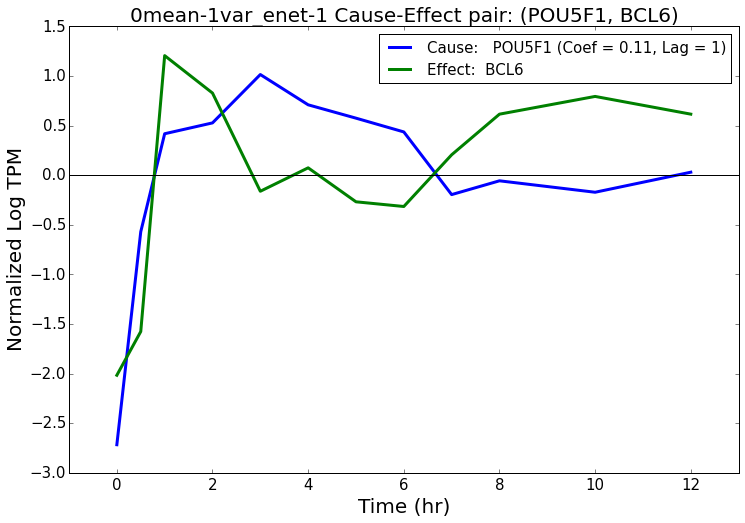

***********************************************
0mean-unnormalized_enet-1
***********************************************
   Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                       Summary: Cause                                                           Summary: Effect
48             POU5F1                BCL6  0.220967     1  GR_direct,TF-Bioguo,DNA-binding_GO,  GR_direct,TF-Bioguo,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/tf-imm/POU5F1-BCL6/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-imm/POU5F1-BCL6/0mean-unnormalized_enet-1_POU5F1-BCL6-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/common/tf-imm/POU5F1-BCL6/0mean-unnormalized_enet-1_POU5F1-BCL6-lag-1-coef-2E-01.pdf


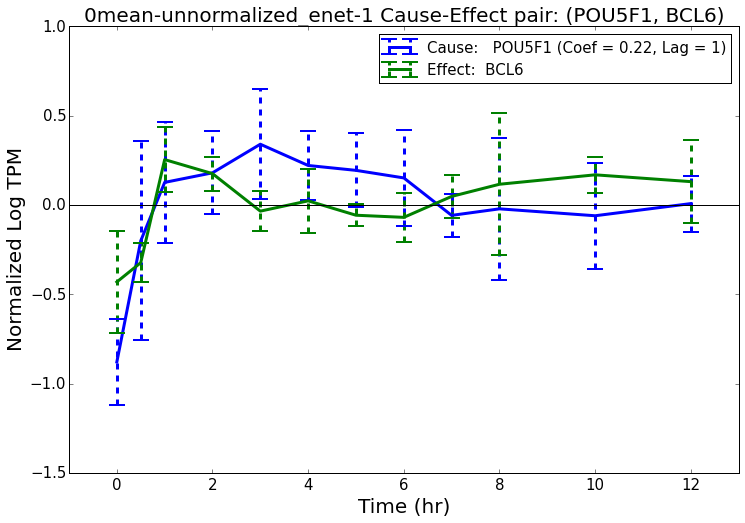

Filename:  analysis/plots/common/tf-imm/POU5F1-BCL6/0mean-unnormalized_enet-1_no-bar-POU5F1-BCL6-lag-1-coef-2E-01.pdf
Plot saved to  analysis/plots/common/tf-imm/POU5F1-BCL6/0mean-unnormalized_enet-1_no-bar-POU5F1-BCL6-lag-1-coef-2E-01.pdf


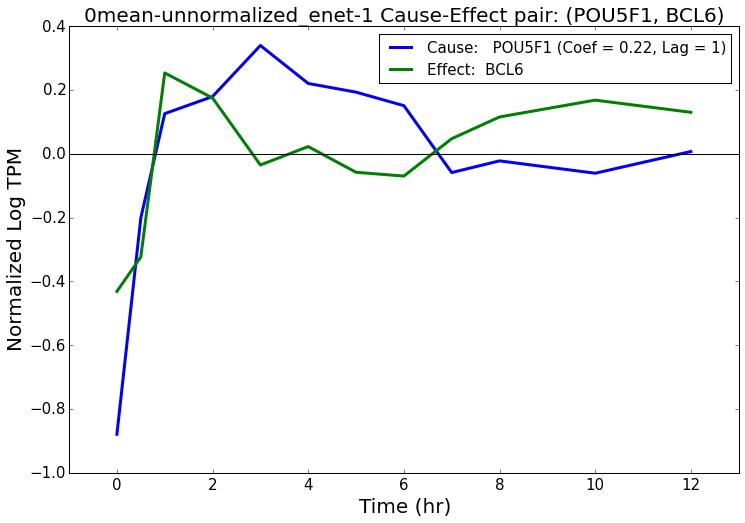

********************************
POU5F1 JUN
********************************
***********************************************
0mean-1var_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                       Summary: Cause                                                                                      Summary: Effect
6829             POU5F1                 JUN -0.075634     1  GR_direct,TF-Bioguo,DNA-binding_GO,  GR_GSEA,TF-Bioguo,TF-binding_GO,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,DNA-binding_GO,
Written to  analysis/plots/common/tf-imm/POU5F1-JUN/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-imm/POU5F1-JUN/0mean-1var_enet-1_POU5F1-JUN-lag-1-coef--8E-02.pdf
Plot saved to  analysis/plots/common/tf-imm/POU5F1-JUN/0me

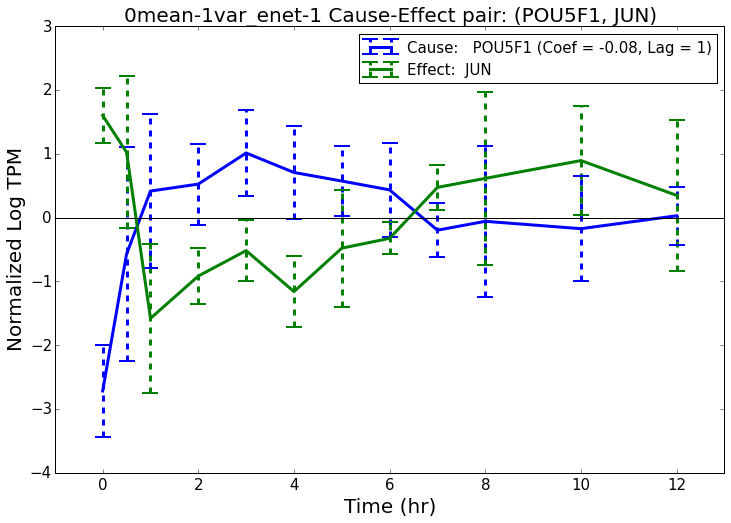

Filename:  analysis/plots/common/tf-imm/POU5F1-JUN/0mean-1var_enet-1_no-bar-POU5F1-JUN-lag-1-coef--8E-02.pdf
Plot saved to  analysis/plots/common/tf-imm/POU5F1-JUN/0mean-1var_enet-1_no-bar-POU5F1-JUN-lag-1-coef--8E-02.pdf


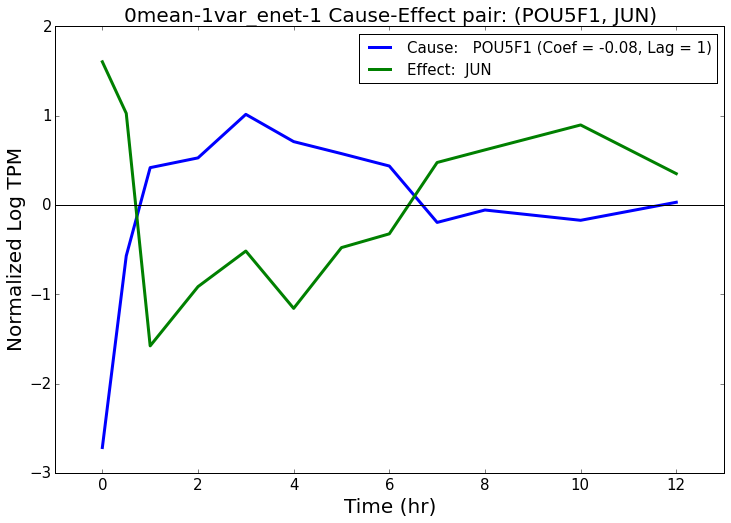

***********************************************
0mean-unnormalized_enet-1
***********************************************
   Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                       Summary: Cause                                                                                      Summary: Effect
98             POU5F1                 JUN -0.205934     1  GR_direct,TF-Bioguo,DNA-binding_GO,  GR_GSEA,TF-Bioguo,TF-binding_GO,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,DNA-binding_GO,
Written to  analysis/plots/common/tf-imm/POU5F1-JUN/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-imm/POU5F1-JUN/0mean-unnormalized_enet-1_POU5F1-JUN-lag-1-coef--2E-01.pdf
Plot saved to  analysis/plots/common/tf-imm/POU5F1-JUN/0mean-unnormalized_enet-1_POU5F1-JUN-lag-1-coef--2E-01.pdf


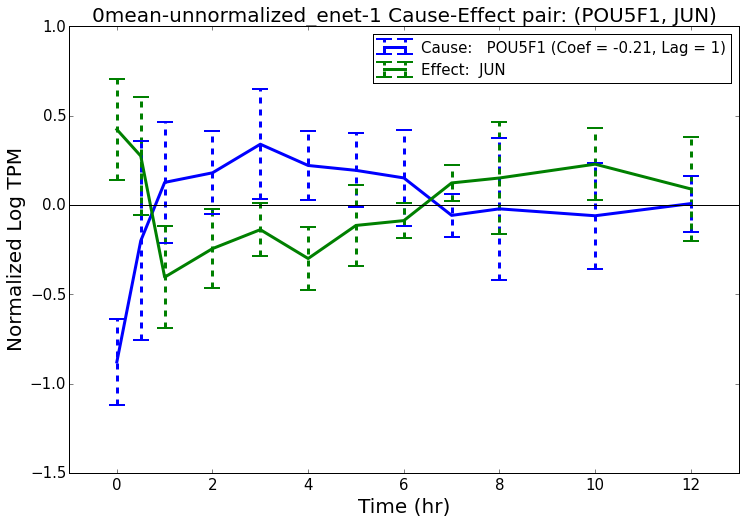

Filename:  analysis/plots/common/tf-imm/POU5F1-JUN/0mean-unnormalized_enet-1_no-bar-POU5F1-JUN-lag-1-coef--2E-01.pdf
Plot saved to  analysis/plots/common/tf-imm/POU5F1-JUN/0mean-unnormalized_enet-1_no-bar-POU5F1-JUN-lag-1-coef--2E-01.pdf


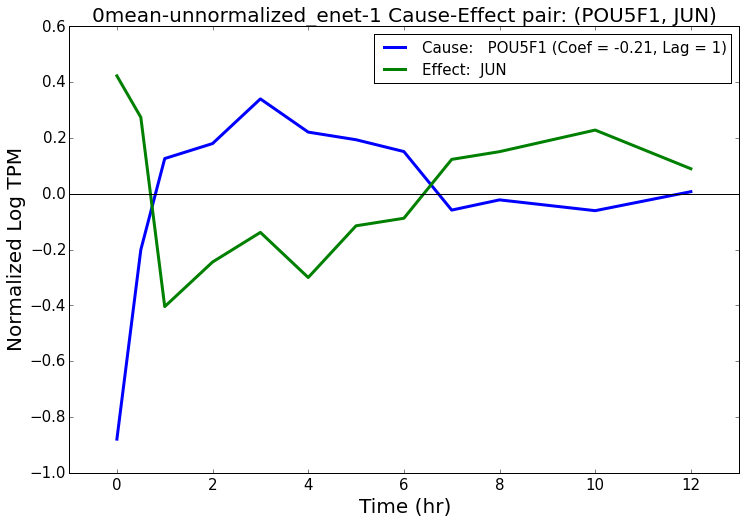

In [77]:
for i, r in plot_df.iterrows():
    print "********************************"
    print r["Gene Symbol: Cause"], r["Gene Symbol: Effect"]
    print "********************************"
    
    
    all_plot_folder = os.path.join(plot_subfolder, "-".join([r["Gene Symbol: Cause"], r["Gene Symbol: Effect"]]))
    
    indices = []
    for j in range(len(names)):
        if r[names[j]] == 1:
            # plot if contains
            indices.append(j)
    
    plot_nets = [nets[ind][nets[ind]["Cause-Effect"] == r["Cause-Effect"]] for ind in indices]
    for p in range(len(plot_nets)):
        plot_nets[p]["Gene Symbol: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_nets[p]["Cause"].values]
        plot_nets[p]["Gene Symbol: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_nets[p]["Effect"].values]
    
    plot_data_hg_df_list = [data_hg_df_list[ind] for ind in indices]
    plot_names = [names[ind] for ind in indices]
    plot_timekeys_list = [timekeys_list[ind] for ind in indices]
    plot_num_per_keys_list = [num_per_keys_list[ind] for ind in indices]
    plot_timepoints_list = [timepoints_list[ind] for ind in indices]
    
    
    do_plot_nets(plot_data_hg_df_list, plot_nets, plot_names, plot_timekeys_list, plot_num_per_keys_list, plot_timepoints_list,
                all_plot_folder=all_plot_folder, include_name_prefix=True, ylabels=ylabels)
    
#     for plot_net, plot_name in zip(plot_nets, plot_names):
#         print plot_name
#         display(plot_net)

# tf-metab

In [78]:
plotfoldersuffix = "tf-metab"
plot_df = edge_network_df[np.logical_and(edge_network_df["Cause"].isin(tf_genes), edge_network_df["Effect"].isin(metab_genes))].head(top_edge_num)

display(plot_df)

plot_subfolder = os.path.join(plot_common_folder, plotfoldersuffix)
if not os.path.exists(plot_subfolder):
    os.makedirs(plot_subfolder)
    
outfile = os.path.join(plot_subfolder, "top_interactions.csv")
plot_df.to_csv(outfile, index=0)

,Cause-Effect,Cause,Effect,Gene Symbol: Cause,Gene Symbol: Effect,Summary: Cause,Summary: Effect,Abs-Avg-Weight,Total,Networks,0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,Weight: 0mean-1var_enet-1,Weight: 0mean-1var_enet-2,Weight: 0mean-unnormalized_enet-1,Weight: 0mean-unnormalized_enet-2
38288,ENSG00000171970.11-ENSG00000143149.11,ENSG00000171970.11,ENSG00000143149.11,ZNF57,ALDH9A1,"TF-Bioguo,","Metabolism-gluc_GSEA,",0.057,4.0,"0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",1,1,1,1,-0.100873,-0.049677,-0.044510,-0.032130
34119,ENSG00000167074.13-ENSG00000075651.14,ENSG00000167074.13,ENSG00000075651.14,TEF,PLD1,"TF-Bioguo,","Metabolism-lipid_GSEA,",0.054,3.0,"0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,",1,1,1,0,0.073228,0.070985,0.070987,0.000000
38296,ENSG00000171970.11-ENSG00000164904.14,ENSG00000171970.11,ENSG00000164904.14,ZNF57,ALDH7A1,"TF-Bioguo,","Metabolism-gluc_GSEA,",0.042,3.0,"0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",0,1,1,1,0.000000,-0.043315,-0.074920,-0.048526


********************************
ZNF57 ALDH9A1
********************************


/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


***********************************************
0mean-1var_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause        Summary: Effect
1866              ZNF57             ALDH9A1 -0.100873     1     TF-Bioguo,  Metabolism-gluc_GSEA,
Written to  analysis/plots/common/tf-metab/ZNF57-ALDH9A1/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-metab/ZNF57-ALDH9A1/0mean-1var_enet-1_ZNF57-ALDH9A1-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/tf-metab/ZNF57-ALDH9A1/0mean-1var_enet-1_ZNF57-ALDH9A1-lag-1-coef--1E-01.pdf


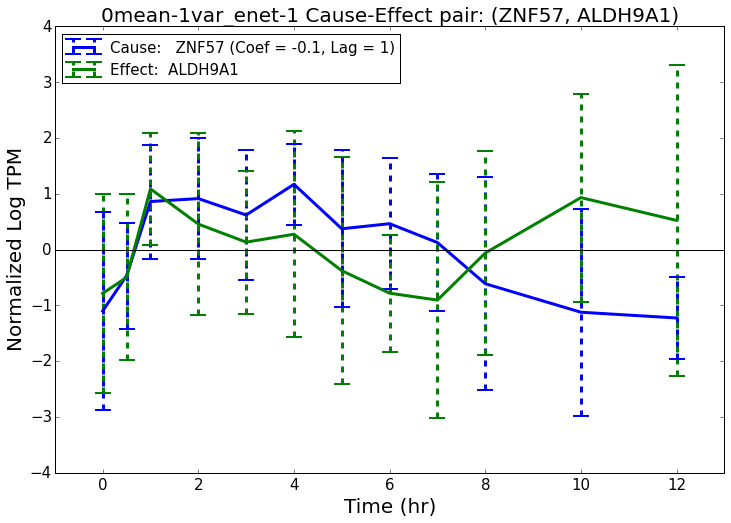

Filename:  analysis/plots/common/tf-metab/ZNF57-ALDH9A1/0mean-1var_enet-1_no-bar-ZNF57-ALDH9A1-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/tf-metab/ZNF57-ALDH9A1/0mean-1var_enet-1_no-bar-ZNF57-ALDH9A1-lag-1-coef--1E-01.pdf


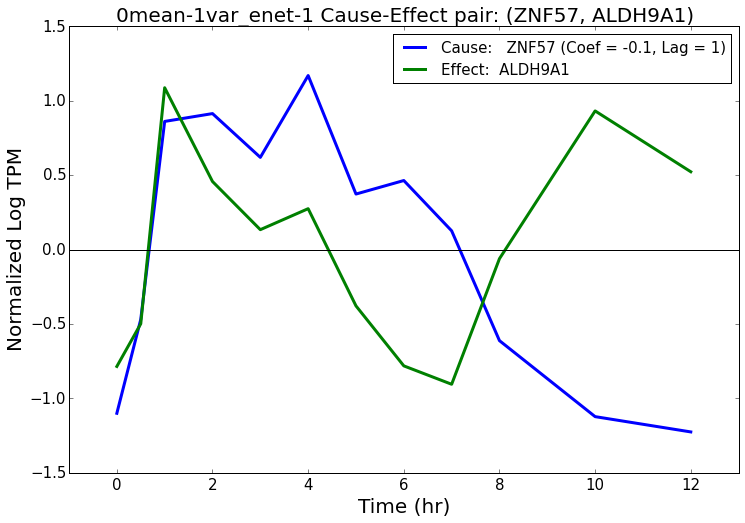

***********************************************
0mean-1var_enet-2
***********************************************
      Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause        Summary: Effect
10326              ZNF57             ALDH9A1 -0.049677   1.0     TF-Bioguo,  Metabolism-gluc_GSEA,
Written to  analysis/plots/common/tf-metab/ZNF57-ALDH9A1/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-metab/ZNF57-ALDH9A1/0mean-1var_enet-2_ZNF57-ALDH9A1-lag-2-coef--5E-02.pdf
Plot saved to  analysis/plots/common/tf-metab/ZNF57-ALDH9A1/0mean-1var_enet-2_ZNF57-ALDH9A1-lag-2-coef--5E-02.pdf


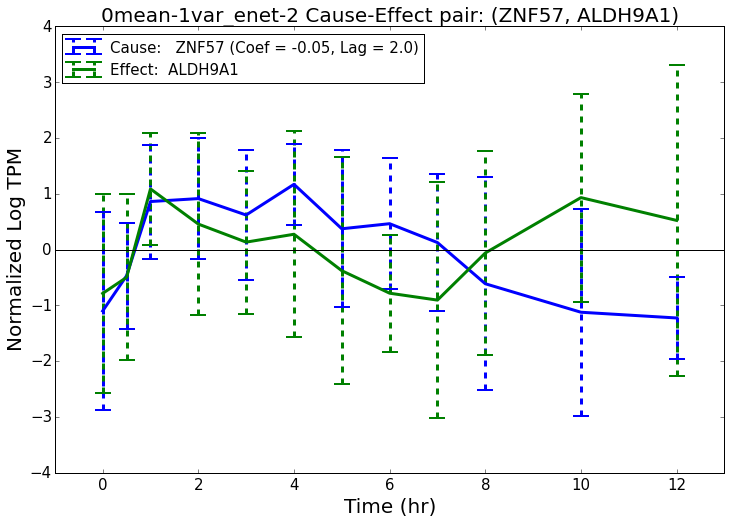

Filename:  analysis/plots/common/tf-metab/ZNF57-ALDH9A1/0mean-1var_enet-2_no-bar-ZNF57-ALDH9A1-lag-2-coef--5E-02.pdf
Plot saved to  analysis/plots/common/tf-metab/ZNF57-ALDH9A1/0mean-1var_enet-2_no-bar-ZNF57-ALDH9A1-lag-2-coef--5E-02.pdf


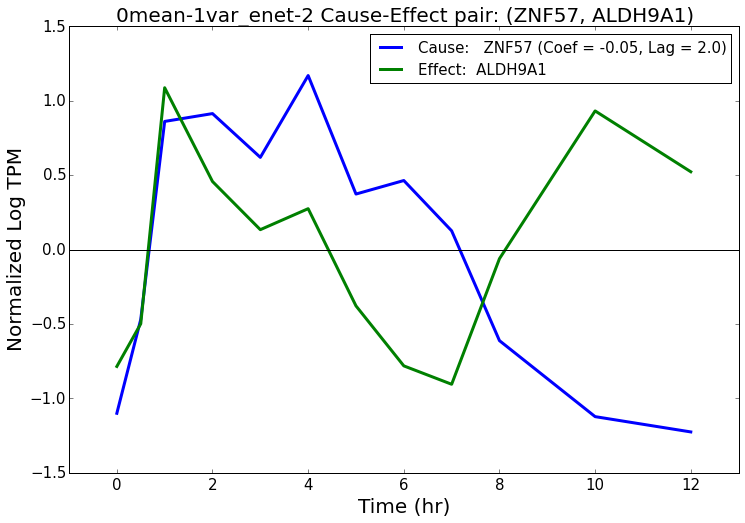

***********************************************
0mean-unnormalized_enet-1
***********************************************
      Gene Symbol: Cause Gene Symbol: Effect   Weight  Coef Summary: Cause        Summary: Effect
19549              ZNF57             ALDH9A1 -0.04451     1     TF-Bioguo,  Metabolism-gluc_GSEA,
Written to  analysis/plots/common/tf-metab/ZNF57-ALDH9A1/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-metab/ZNF57-ALDH9A1/0mean-unnormalized_enet-1_ZNF57-ALDH9A1-lag-1-coef--4E-02.pdf
Plot saved to  analysis/plots/common/tf-metab/ZNF57-ALDH9A1/0mean-unnormalized_enet-1_ZNF57-ALDH9A1-lag-1-coef--4E-02.pdf


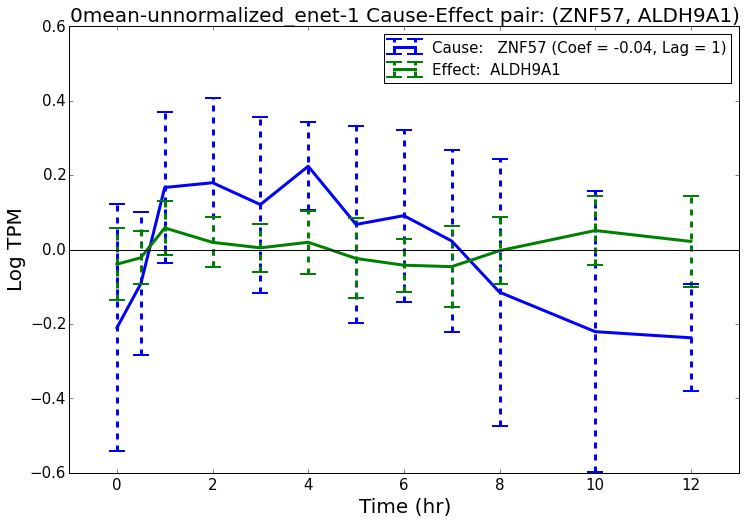

Filename:  analysis/plots/common/tf-metab/ZNF57-ALDH9A1/0mean-unnormalized_enet-1_no-bar-ZNF57-ALDH9A1-lag-1-coef--4E-02.pdf
Plot saved to  analysis/plots/common/tf-metab/ZNF57-ALDH9A1/0mean-unnormalized_enet-1_no-bar-ZNF57-ALDH9A1-lag-1-coef--4E-02.pdf


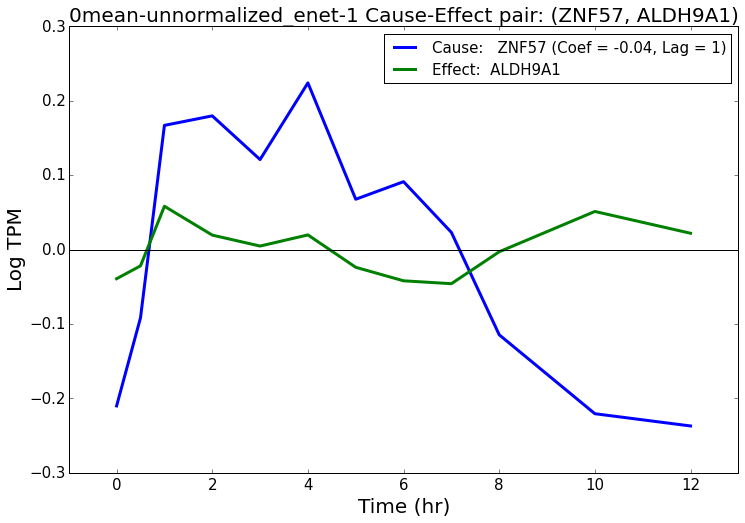

***********************************************
0mean-unnormalized_enet-2
***********************************************
      Gene Symbol: Cause Gene Symbol: Effect   Weight  Coef Summary: Cause        Summary: Effect
23613              ZNF57             ALDH9A1 -0.03213   1.0     TF-Bioguo,  Metabolism-gluc_GSEA,
Written to  analysis/plots/common/tf-metab/ZNF57-ALDH9A1/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-metab/ZNF57-ALDH9A1/0mean-unnormalized_enet-2_ZNF57-ALDH9A1-lag-2-coef--3E-02.pdf
Plot saved to  analysis/plots/common/tf-metab/ZNF57-ALDH9A1/0mean-unnormalized_enet-2_ZNF57-ALDH9A1-lag-2-coef--3E-02.pdf


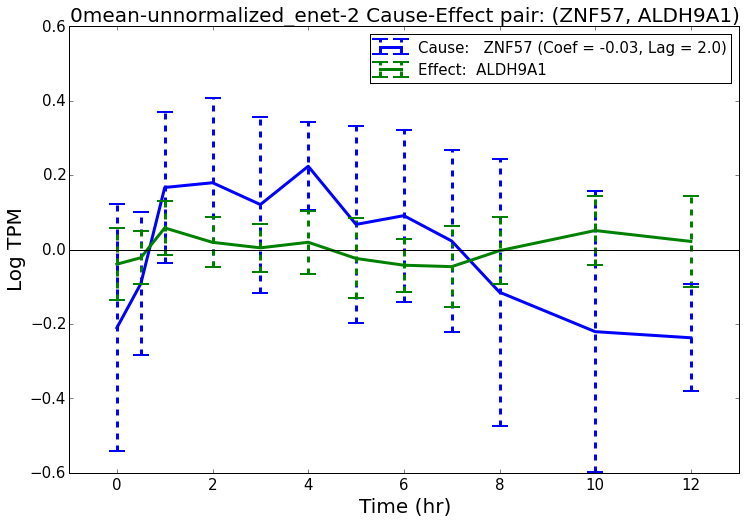

Filename:  analysis/plots/common/tf-metab/ZNF57-ALDH9A1/0mean-unnormalized_enet-2_no-bar-ZNF57-ALDH9A1-lag-2-coef--3E-02.pdf
Plot saved to  analysis/plots/common/tf-metab/ZNF57-ALDH9A1/0mean-unnormalized_enet-2_no-bar-ZNF57-ALDH9A1-lag-2-coef--3E-02.pdf


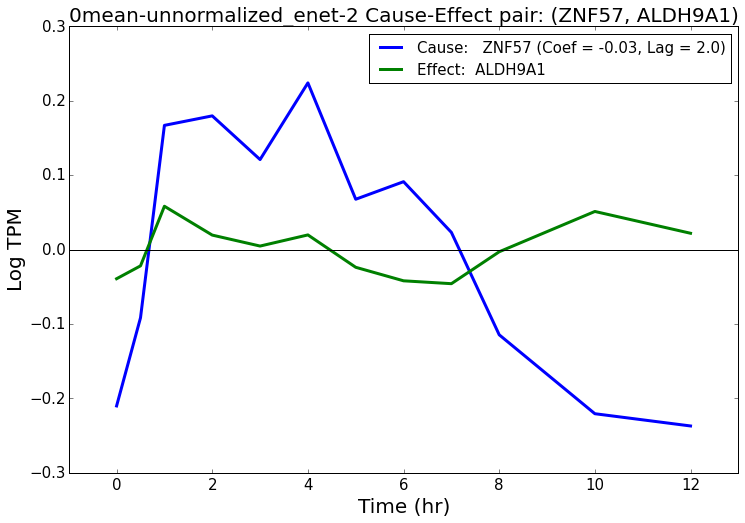

********************************
TEF PLD1
********************************
***********************************************
0mean-1var_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause         Summary: Effect
7466                TEF                PLD1  0.073228     1     TF-Bioguo,  Metabolism-lipid_GSEA,
Written to  analysis/plots/common/tf-metab/TEF-PLD1/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-metab/TEF-PLD1/0mean-1var_enet-1_TEF-PLD1-lag-1-coef-7E-02.pdf
Plot saved to  analysis/plots/common/tf-metab/TEF-PLD1/0mean-1var_enet-1_TEF-PLD1-lag-1-coef-7E-02.pdf


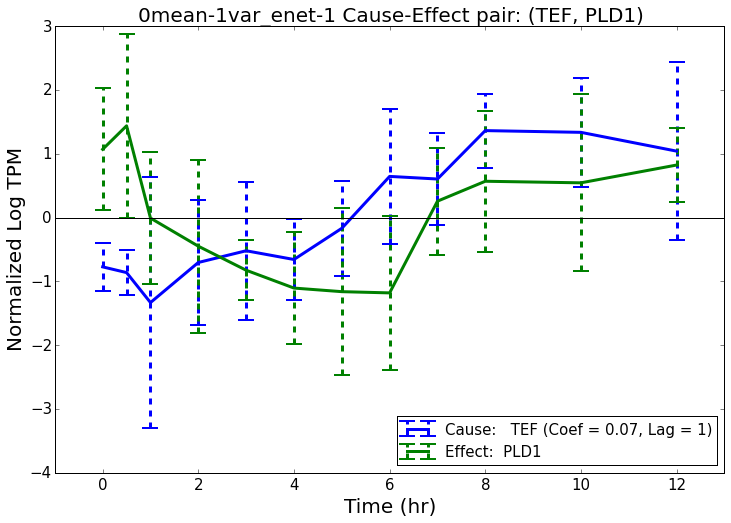

Filename:  analysis/plots/common/tf-metab/TEF-PLD1/0mean-1var_enet-1_no-bar-TEF-PLD1-lag-1-coef-7E-02.pdf
Plot saved to  analysis/plots/common/tf-metab/TEF-PLD1/0mean-1var_enet-1_no-bar-TEF-PLD1-lag-1-coef-7E-02.pdf


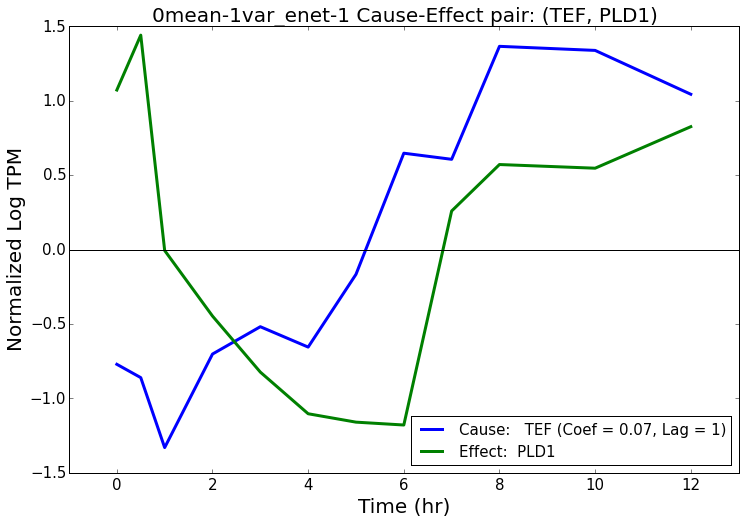

***********************************************
0mean-1var_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause         Summary: Effect
2943                TEF                PLD1  0.070985   1.0     TF-Bioguo,  Metabolism-lipid_GSEA,
Written to  analysis/plots/common/tf-metab/TEF-PLD1/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-metab/TEF-PLD1/0mean-1var_enet-2_TEF-PLD1-lag-2-coef-7E-02.pdf
Plot saved to  analysis/plots/common/tf-metab/TEF-PLD1/0mean-1var_enet-2_TEF-PLD1-lag-2-coef-7E-02.pdf


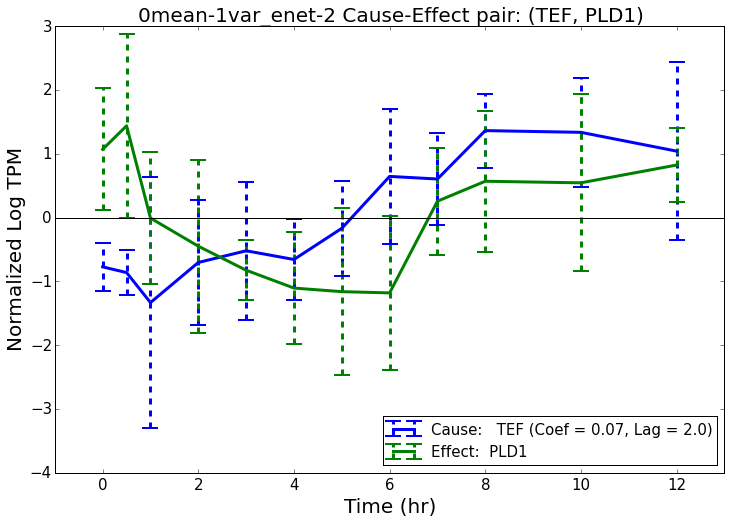

Filename:  analysis/plots/common/tf-metab/TEF-PLD1/0mean-1var_enet-2_no-bar-TEF-PLD1-lag-2-coef-7E-02.pdf
Plot saved to  analysis/plots/common/tf-metab/TEF-PLD1/0mean-1var_enet-2_no-bar-TEF-PLD1-lag-2-coef-7E-02.pdf


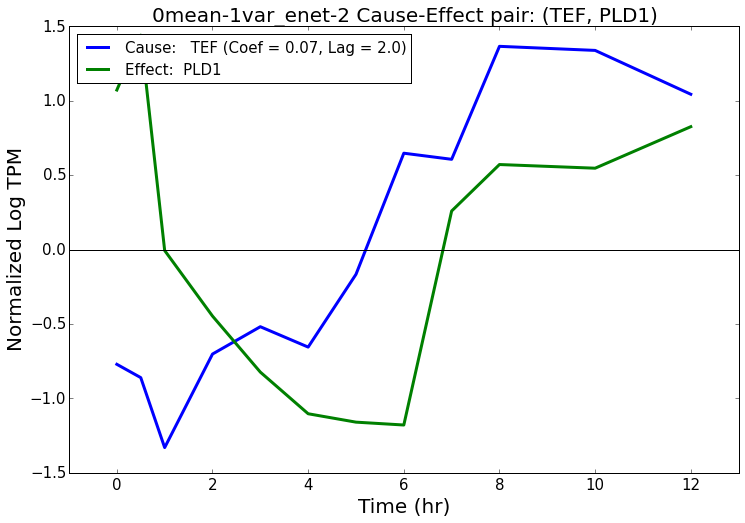

***********************************************
0mean-unnormalized_enet-1
***********************************************
      Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause         Summary: Effect
10155                TEF                PLD1  0.070987     1     TF-Bioguo,  Metabolism-lipid_GSEA,
Written to  analysis/plots/common/tf-metab/TEF-PLD1/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-metab/TEF-PLD1/0mean-unnormalized_enet-1_TEF-PLD1-lag-1-coef-7E-02.pdf
Plot saved to  analysis/plots/common/tf-metab/TEF-PLD1/0mean-unnormalized_enet-1_TEF-PLD1-lag-1-coef-7E-02.pdf


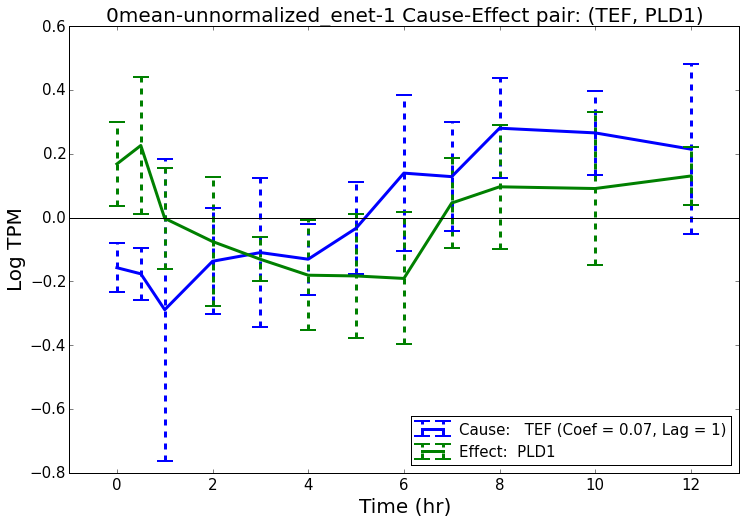

Filename:  analysis/plots/common/tf-metab/TEF-PLD1/0mean-unnormalized_enet-1_no-bar-TEF-PLD1-lag-1-coef-7E-02.pdf
Plot saved to  analysis/plots/common/tf-metab/TEF-PLD1/0mean-unnormalized_enet-1_no-bar-TEF-PLD1-lag-1-coef-7E-02.pdf


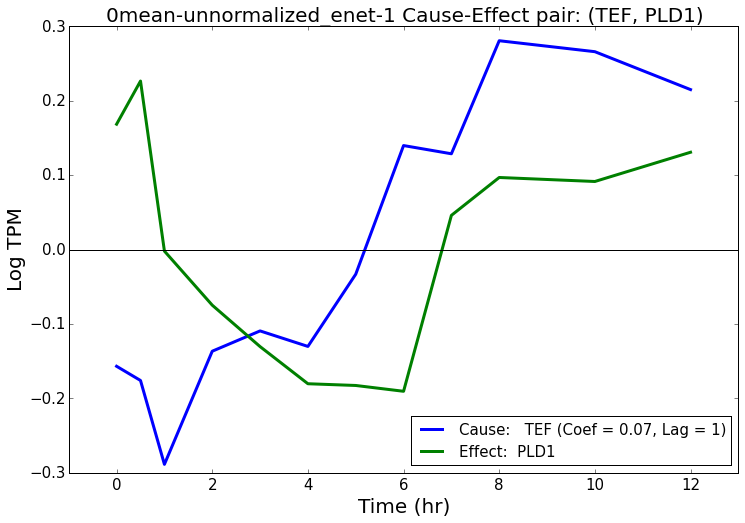

********************************
ZNF57 ALDH7A1
********************************
***********************************************
0mean-1var_enet-2
***********************************************
      Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause        Summary: Effect
12463              ZNF57             ALDH7A1 -0.043315   1.0     TF-Bioguo,  Metabolism-gluc_GSEA,
Written to  analysis/plots/common/tf-metab/ZNF57-ALDH7A1/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-metab/ZNF57-ALDH7A1/0mean-1var_enet-2_ZNF57-ALDH7A1-lag-2-coef--4E-02.pdf
Plot saved to  analysis/plots/common/tf-metab/ZNF57-ALDH7A1/0mean-1var_enet-2_ZNF57-ALDH7A1-lag-2-coef--4E-02.pdf


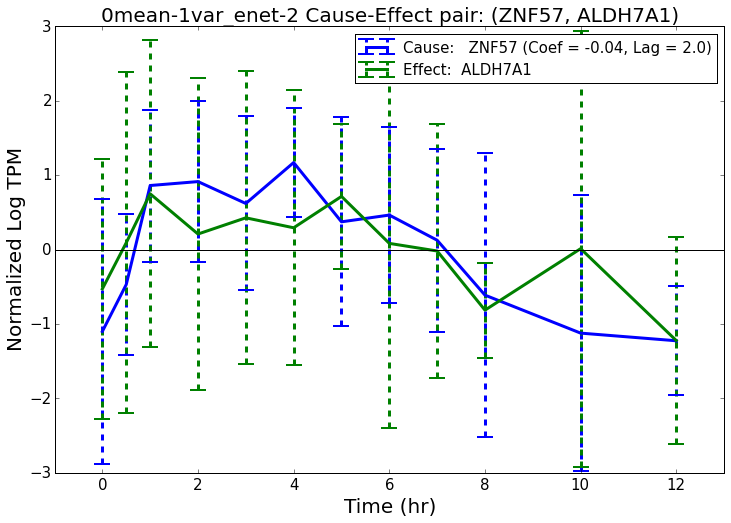

Filename:  analysis/plots/common/tf-metab/ZNF57-ALDH7A1/0mean-1var_enet-2_no-bar-ZNF57-ALDH7A1-lag-2-coef--4E-02.pdf
Plot saved to  analysis/plots/common/tf-metab/ZNF57-ALDH7A1/0mean-1var_enet-2_no-bar-ZNF57-ALDH7A1-lag-2-coef--4E-02.pdf


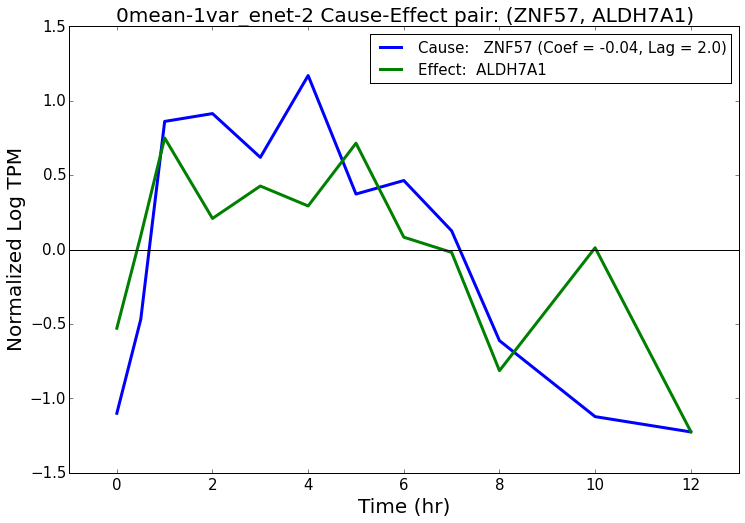

***********************************************
0mean-unnormalized_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect   Weight  Coef Summary: Cause        Summary: Effect
8993              ZNF57             ALDH7A1 -0.07492     1     TF-Bioguo,  Metabolism-gluc_GSEA,
Written to  analysis/plots/common/tf-metab/ZNF57-ALDH7A1/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-metab/ZNF57-ALDH7A1/0mean-unnormalized_enet-1_ZNF57-ALDH7A1-lag-1-coef--7E-02.pdf
Plot saved to  analysis/plots/common/tf-metab/ZNF57-ALDH7A1/0mean-unnormalized_enet-1_ZNF57-ALDH7A1-lag-1-coef--7E-02.pdf


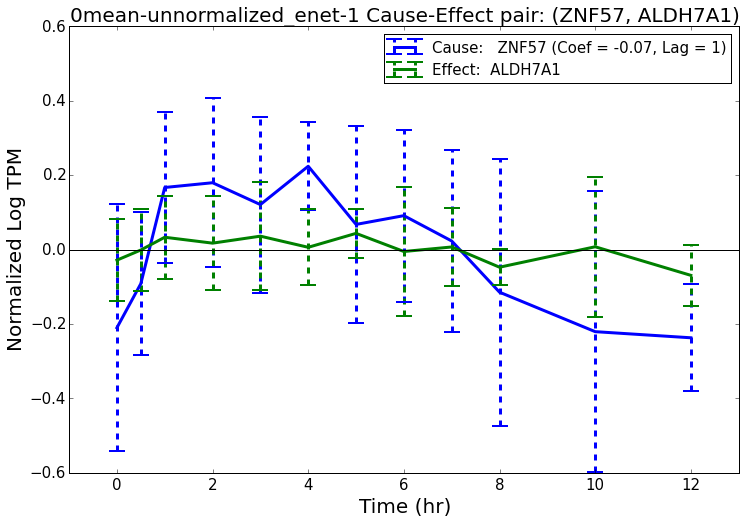

Filename:  analysis/plots/common/tf-metab/ZNF57-ALDH7A1/0mean-unnormalized_enet-1_no-bar-ZNF57-ALDH7A1-lag-1-coef--7E-02.pdf
Plot saved to  analysis/plots/common/tf-metab/ZNF57-ALDH7A1/0mean-unnormalized_enet-1_no-bar-ZNF57-ALDH7A1-lag-1-coef--7E-02.pdf


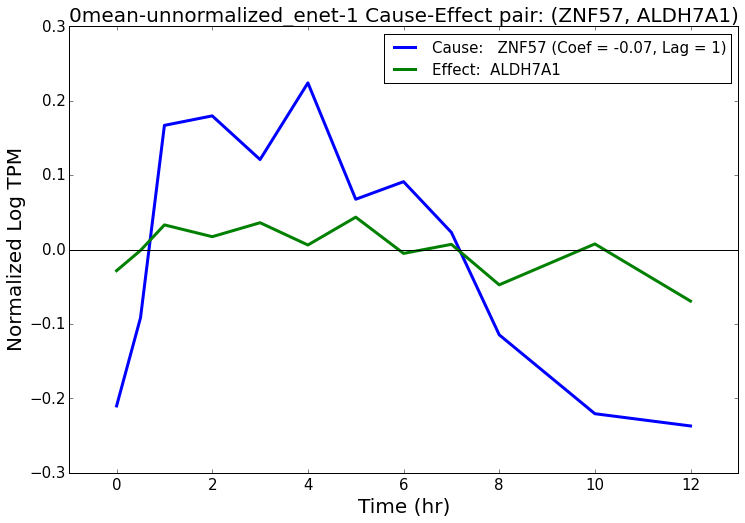

***********************************************
0mean-unnormalized_enet-2
***********************************************
      Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef Summary: Cause        Summary: Effect
14171              ZNF57             ALDH7A1 -0.048526   1.0     TF-Bioguo,  Metabolism-gluc_GSEA,
Written to  analysis/plots/common/tf-metab/ZNF57-ALDH7A1/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/tf-metab/ZNF57-ALDH7A1/0mean-unnormalized_enet-2_ZNF57-ALDH7A1-lag-2-coef--5E-02.pdf
Plot saved to  analysis/plots/common/tf-metab/ZNF57-ALDH7A1/0mean-unnormalized_enet-2_ZNF57-ALDH7A1-lag-2-coef--5E-02.pdf


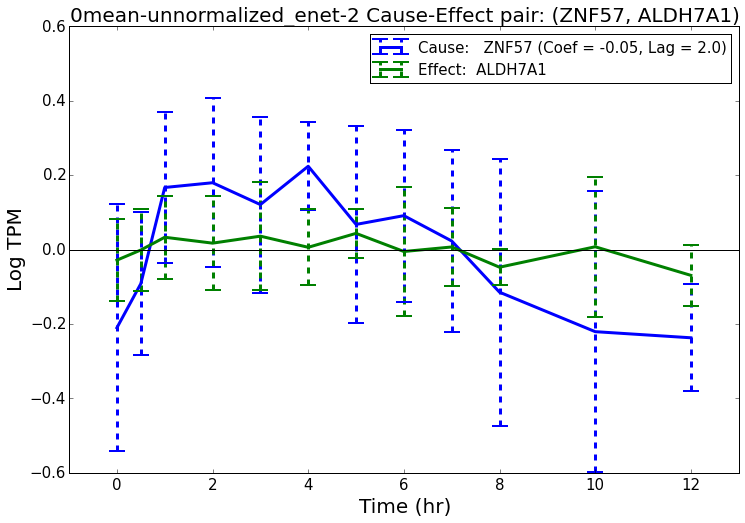

Filename:  analysis/plots/common/tf-metab/ZNF57-ALDH7A1/0mean-unnormalized_enet-2_no-bar-ZNF57-ALDH7A1-lag-2-coef--5E-02.pdf
Plot saved to  analysis/plots/common/tf-metab/ZNF57-ALDH7A1/0mean-unnormalized_enet-2_no-bar-ZNF57-ALDH7A1-lag-2-coef--5E-02.pdf


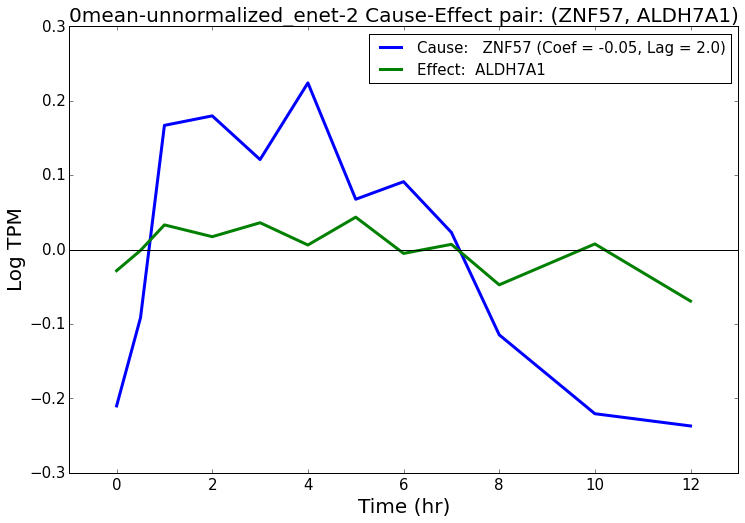

In [79]:
for i, r in plot_df.iterrows():
    print "********************************"
    print r["Gene Symbol: Cause"], r["Gene Symbol: Effect"]
    print "********************************"
    
    
    all_plot_folder = os.path.join(plot_subfolder, "-".join([r["Gene Symbol: Cause"], r["Gene Symbol: Effect"]]))
    
    indices = []
    for j in range(len(names)):
        if r[names[j]] == 1:
            # plot if contains
            indices.append(j)
    
    plot_nets = [nets[ind][nets[ind]["Cause-Effect"] == r["Cause-Effect"]] for ind in indices]
    for p in range(len(plot_nets)):
        plot_nets[p]["Gene Symbol: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_nets[p]["Cause"].values]
        plot_nets[p]["Gene Symbol: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_nets[p]["Effect"].values]
    
    plot_data_hg_df_list = [data_hg_df_list[ind] for ind in indices]
    plot_names = [names[ind] for ind in indices]
    plot_timekeys_list = [timekeys_list[ind] for ind in indices]
    plot_num_per_keys_list = [num_per_keys_list[ind] for ind in indices]
    plot_timepoints_list = [timepoints_list[ind] for ind in indices]
    
    
    do_plot_nets(plot_data_hg_df_list, plot_nets, plot_names, plot_timekeys_list, plot_num_per_keys_list, plot_timepoints_list,
                all_plot_folder=all_plot_folder, include_name_prefix=True, ylabels=ylabels)
    
#     for plot_net, plot_name in zip(plot_nets, plot_names):
#         print plot_name
#         display(plot_net)

# imm-any

In [80]:
plotfoldersuffix = "imm-any"
plot_df = edge_network_df[edge_network_df["Cause"].isin(imm_genes)].head(top_edge_num)

display(plot_df)

plot_subfolder = os.path.join(plot_common_folder, plotfoldersuffix)
if not os.path.exists(plot_subfolder):
    os.makedirs(plot_subfolder)
    
outfile = os.path.join(plot_subfolder, "top_interactions.csv")
plot_df.to_csv(outfile, index=0)

,Cause-Effect,Cause,Effect,Gene Symbol: Cause,Gene Symbol: Effect,Summary: Cause,Summary: Effect,Abs-Avg-Weight,Total,Networks,0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,Weight: 0mean-1var_enet-1,Weight: 0mean-1var_enet-2,Weight: 0mean-unnormalized_enet-1,Weight: 0mean-unnormalized_enet-2
39079,ENSG00000173391.7-ENSG00000121851.11,ENSG00000173391.7,ENSG00000121851.11,OLR1,POLR3GL,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,",NaN,0.111,4.0,"0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",1,1,1,1,-0.087715,-0.077868,-0.153147,-0.127145
39190,ENSG00000173391.7-ENSG00000145476.14,ENSG00000173391.7,ENSG00000145476.14,OLR1,CYP4V2,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,",NaN,0.104,4.0,"0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",1,1,1,1,-0.098690,-0.095418,-0.126986,-0.094779
1975,ENSG00000056736.8-ENSG00000279483.1,ENSG00000056736.8,ENSG00000279483.1,IL17RB,RPL41,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,",NaN,0.101,4.0,"0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",1,1,1,1,0.072537,0.051413,0.132986,0.148504


********************************
OLR1 POLR3GL
********************************


/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


***********************************************
0mean-1var_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                                                   Summary: Cause Summary: Effect
3945               OLR1             POLR3GL -0.087715     1  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,             NaN
Written to  analysis/plots/common/imm-any/OLR1-POLR3GL/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-any/OLR1-POLR3GL/0mean-1var_enet-1_OLR1-POLR3GL-lag-1-coef--9E-02.pdf
Plot saved to  analysis/plots/common/imm-any/OLR1-POLR3GL/0mean-1var_enet-1_OLR1-POLR3GL-lag-1-coef--9E-02.pdf


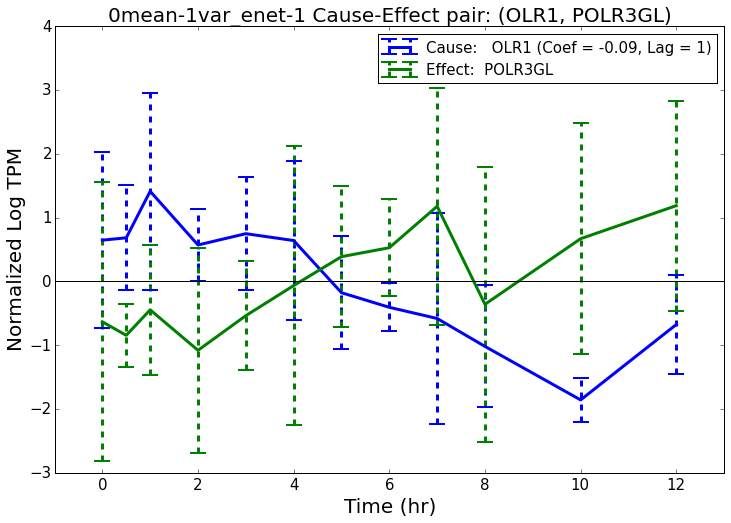

Filename:  analysis/plots/common/imm-any/OLR1-POLR3GL/0mean-1var_enet-1_no-bar-OLR1-POLR3GL-lag-1-coef--9E-02.pdf
Plot saved to  analysis/plots/common/imm-any/OLR1-POLR3GL/0mean-1var_enet-1_no-bar-OLR1-POLR3GL-lag-1-coef--9E-02.pdf


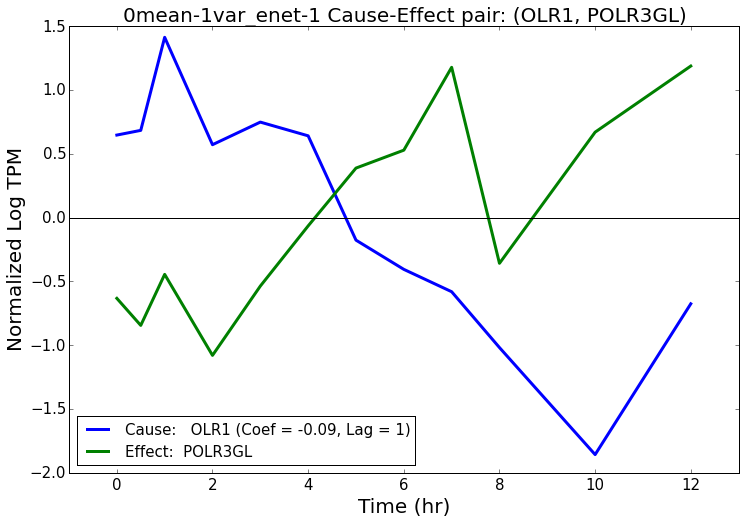

***********************************************
0mean-1var_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                                                   Summary: Cause Summary: Effect
1764               OLR1             POLR3GL -0.077868   1.0  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,             NaN
Written to  analysis/plots/common/imm-any/OLR1-POLR3GL/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-any/OLR1-POLR3GL/0mean-1var_enet-2_OLR1-POLR3GL-lag-2-coef--8E-02.pdf
Plot saved to  analysis/plots/common/imm-any/OLR1-POLR3GL/0mean-1var_enet-2_OLR1-POLR3GL-lag-2-coef--8E-02.pdf


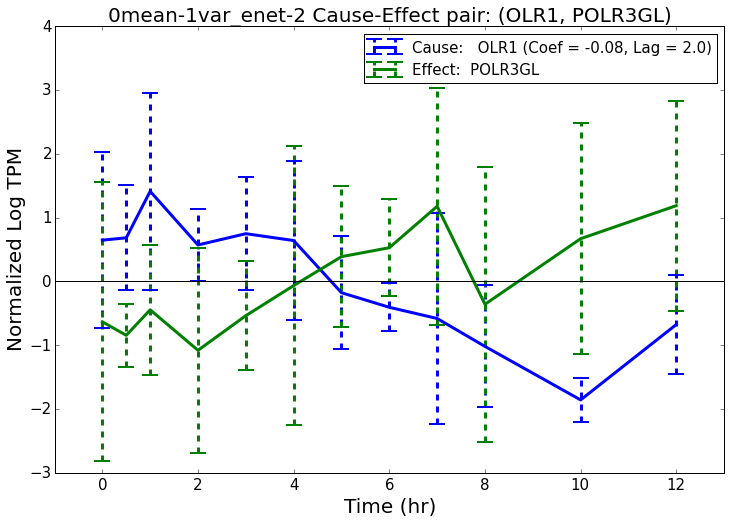

Filename:  analysis/plots/common/imm-any/OLR1-POLR3GL/0mean-1var_enet-2_no-bar-OLR1-POLR3GL-lag-2-coef--8E-02.pdf
Plot saved to  analysis/plots/common/imm-any/OLR1-POLR3GL/0mean-1var_enet-2_no-bar-OLR1-POLR3GL-lag-2-coef--8E-02.pdf


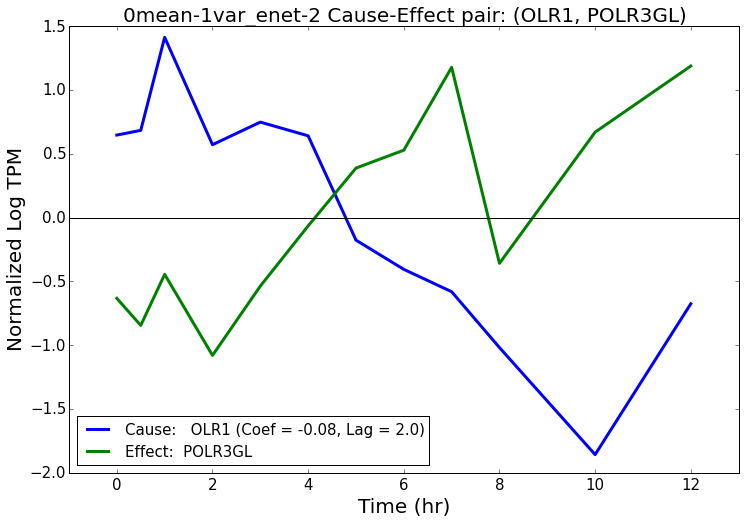

***********************************************
0mean-unnormalized_enet-1
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                                                   Summary: Cause Summary: Effect
634               OLR1             POLR3GL -0.153147     1  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,             NaN
Written to  analysis/plots/common/imm-any/OLR1-POLR3GL/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-any/OLR1-POLR3GL/0mean-unnormalized_enet-1_OLR1-POLR3GL-lag-1-coef--2E-01.pdf
Plot saved to  analysis/plots/common/imm-any/OLR1-POLR3GL/0mean-unnormalized_enet-1_OLR1-POLR3GL-lag-1-coef--2E-01.pdf


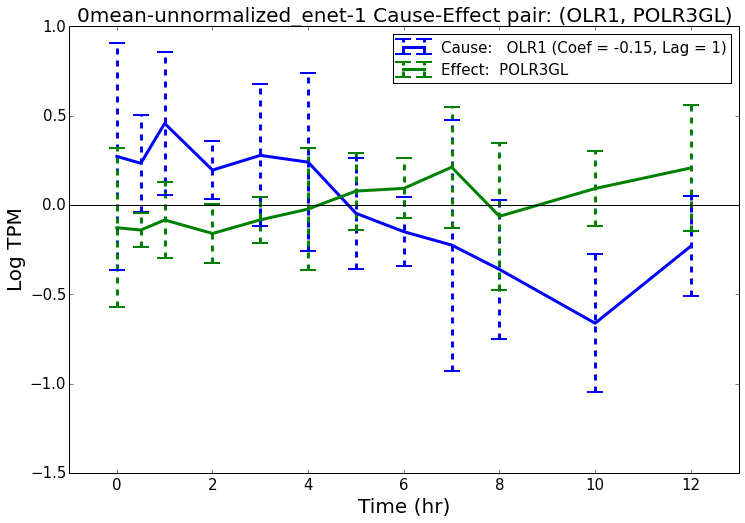

Filename:  analysis/plots/common/imm-any/OLR1-POLR3GL/0mean-unnormalized_enet-1_no-bar-OLR1-POLR3GL-lag-1-coef--2E-01.pdf
Plot saved to  analysis/plots/common/imm-any/OLR1-POLR3GL/0mean-unnormalized_enet-1_no-bar-OLR1-POLR3GL-lag-1-coef--2E-01.pdf


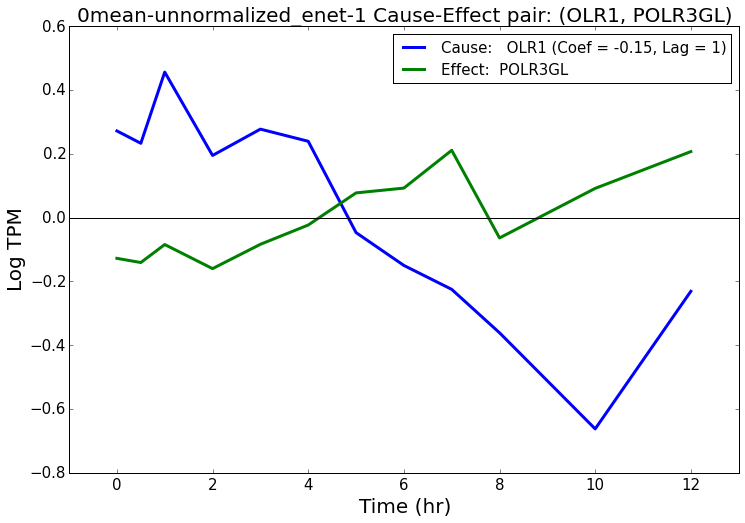

***********************************************
0mean-unnormalized_enet-2
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                                                   Summary: Cause Summary: Effect
370               OLR1             POLR3GL -0.127145   1.0  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,             NaN
Written to  analysis/plots/common/imm-any/OLR1-POLR3GL/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-any/OLR1-POLR3GL/0mean-unnormalized_enet-2_OLR1-POLR3GL-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/common/imm-any/OLR1-POLR3GL/0mean-unnormalized_enet-2_OLR1-POLR3GL-lag-2-coef--1E-01.pdf


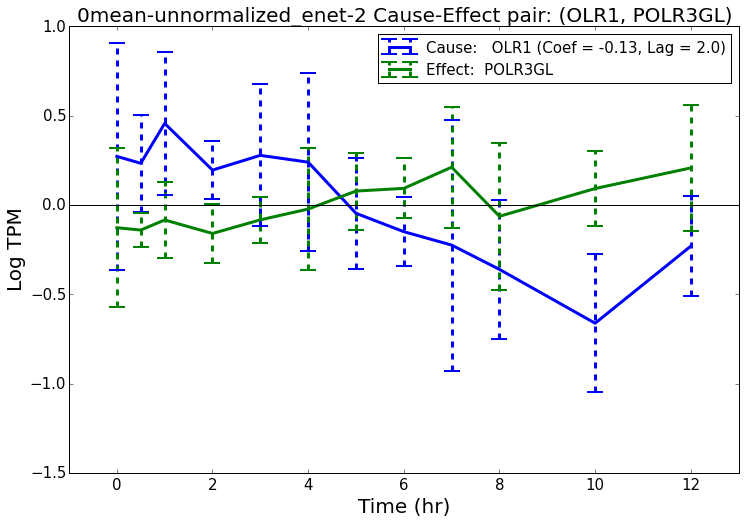

Filename:  analysis/plots/common/imm-any/OLR1-POLR3GL/0mean-unnormalized_enet-2_no-bar-OLR1-POLR3GL-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/common/imm-any/OLR1-POLR3GL/0mean-unnormalized_enet-2_no-bar-OLR1-POLR3GL-lag-2-coef--1E-01.pdf


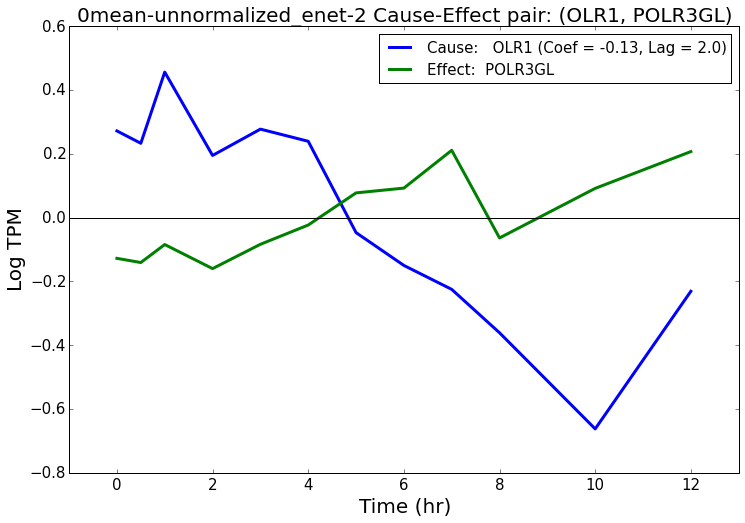

********************************
OLR1 CYP4V2
********************************
***********************************************
0mean-1var_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect   Weight  Coef                                                                                   Summary: Cause Summary: Effect
2139               OLR1              CYP4V2 -0.09869     1  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,             NaN
Written to  analysis/plots/common/imm-any/OLR1-CYP4V2/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-any/OLR1-CYP4V2/0mean-1var_enet-1_OLR1-CYP4V2-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/imm-any/OLR1-CYP4V2/0mean-1var_enet-1_OLR1-CYP4V2-lag-1-coef--1E-01

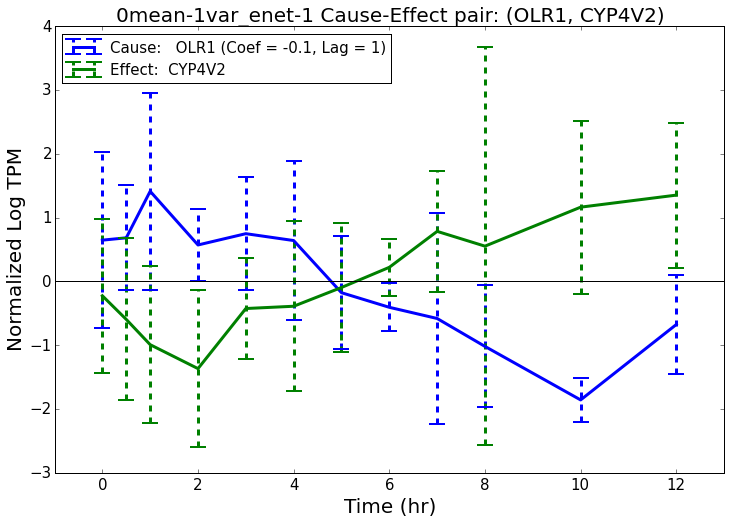

Filename:  analysis/plots/common/imm-any/OLR1-CYP4V2/0mean-1var_enet-1_no-bar-OLR1-CYP4V2-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/imm-any/OLR1-CYP4V2/0mean-1var_enet-1_no-bar-OLR1-CYP4V2-lag-1-coef--1E-01.pdf


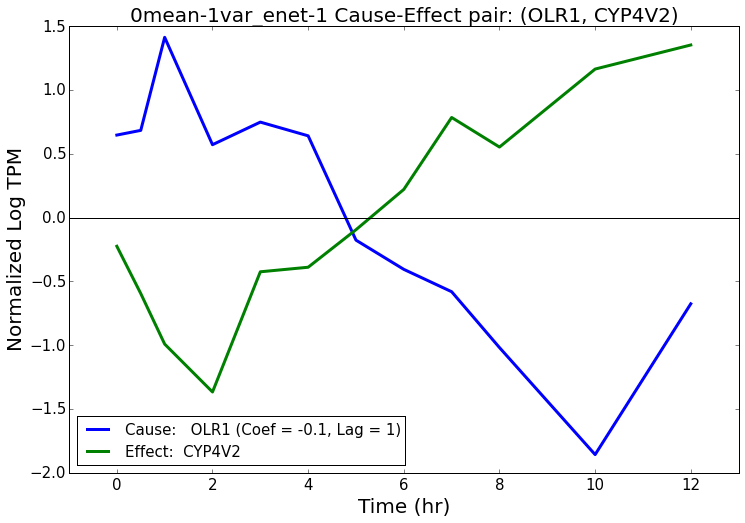

***********************************************
0mean-1var_enet-2
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                                                   Summary: Cause Summary: Effect
442               OLR1              CYP4V2 -0.095418   1.0  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,             NaN
Written to  analysis/plots/common/imm-any/OLR1-CYP4V2/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-any/OLR1-CYP4V2/0mean-1var_enet-2_OLR1-CYP4V2-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/common/imm-any/OLR1-CYP4V2/0mean-1var_enet-2_OLR1-CYP4V2-lag-2-coef--1E-01.pdf


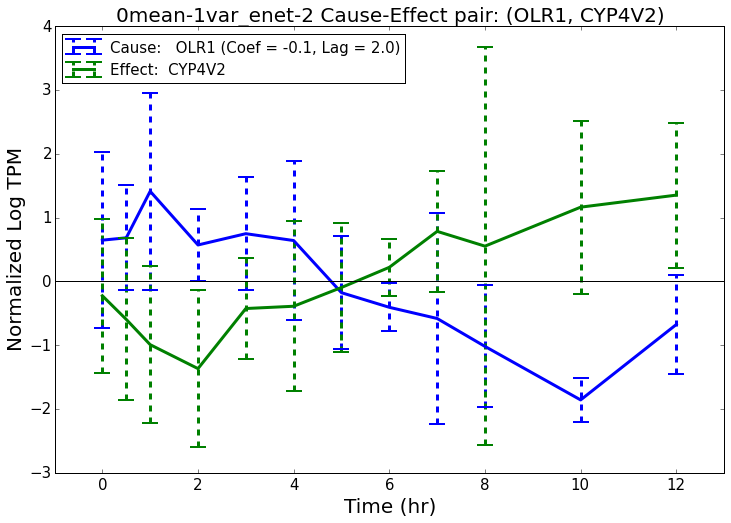

Filename:  analysis/plots/common/imm-any/OLR1-CYP4V2/0mean-1var_enet-2_no-bar-OLR1-CYP4V2-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/common/imm-any/OLR1-CYP4V2/0mean-1var_enet-2_no-bar-OLR1-CYP4V2-lag-2-coef--1E-01.pdf


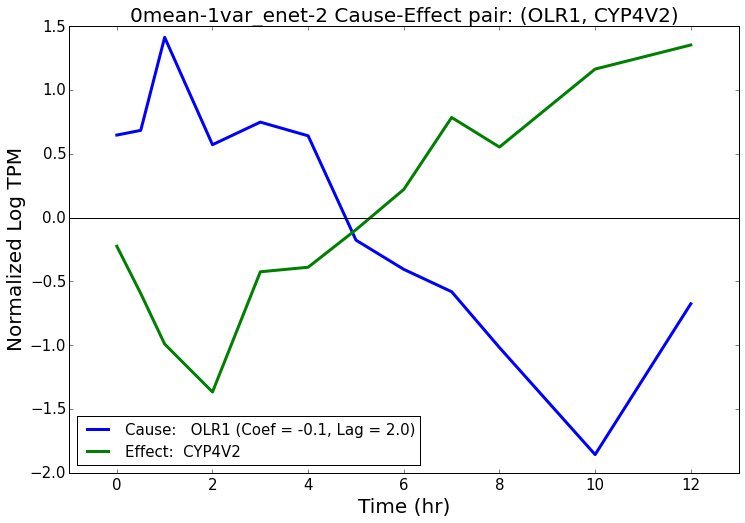

***********************************************
0mean-unnormalized_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                                                   Summary: Cause Summary: Effect
1596               OLR1              CYP4V2 -0.126986     1  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,             NaN
Written to  analysis/plots/common/imm-any/OLR1-CYP4V2/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-any/OLR1-CYP4V2/0mean-unnormalized_enet-1_OLR1-CYP4V2-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/imm-any/OLR1-CYP4V2/0mean-unnormalized_enet-1_OLR1-CYP4V2-lag-1-coef--1E-01.pdf


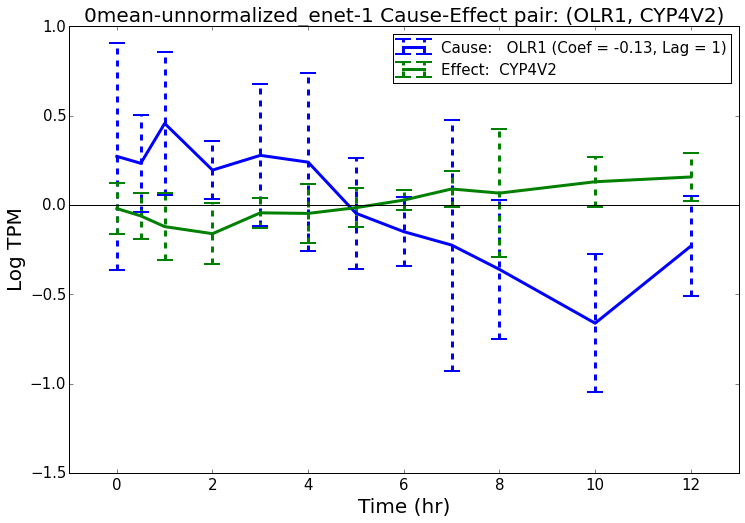

Filename:  analysis/plots/common/imm-any/OLR1-CYP4V2/0mean-unnormalized_enet-1_no-bar-OLR1-CYP4V2-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/imm-any/OLR1-CYP4V2/0mean-unnormalized_enet-1_no-bar-OLR1-CYP4V2-lag-1-coef--1E-01.pdf


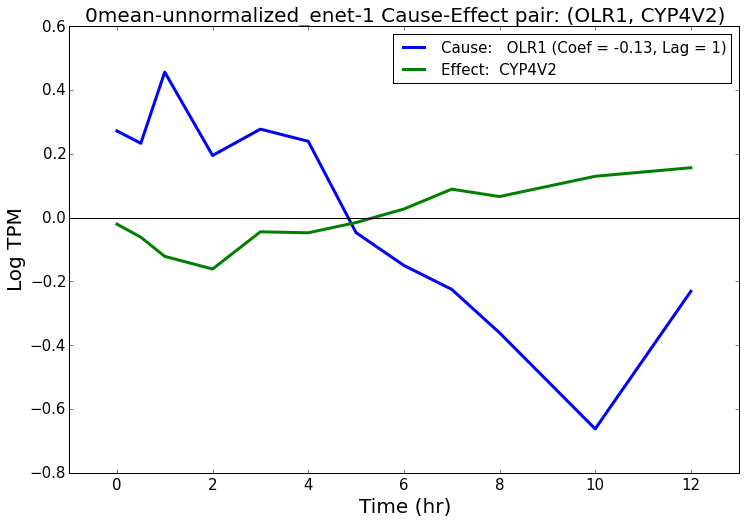

***********************************************
0mean-unnormalized_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                                                   Summary: Cause Summary: Effect
1729               OLR1              CYP4V2 -0.094779   1.0  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,             NaN
Written to  analysis/plots/common/imm-any/OLR1-CYP4V2/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-any/OLR1-CYP4V2/0mean-unnormalized_enet-2_OLR1-CYP4V2-lag-2-coef--9E-02.pdf
Plot saved to  analysis/plots/common/imm-any/OLR1-CYP4V2/0mean-unnormalized_enet-2_OLR1-CYP4V2-lag-2-coef--9E-02.pdf


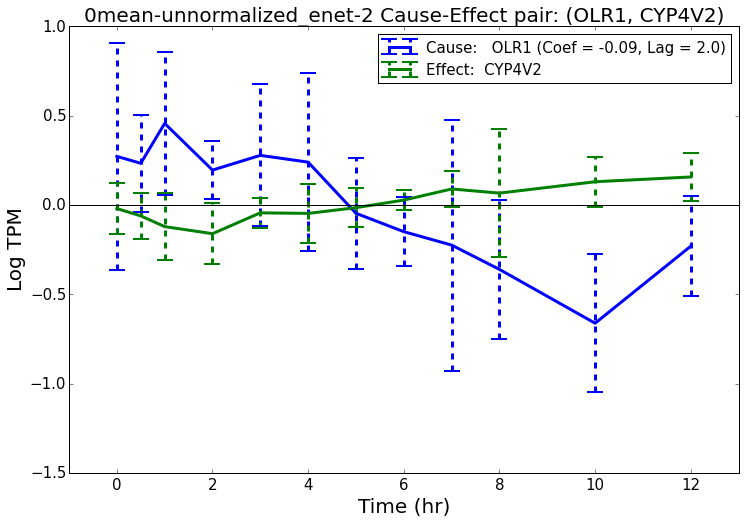

Filename:  analysis/plots/common/imm-any/OLR1-CYP4V2/0mean-unnormalized_enet-2_no-bar-OLR1-CYP4V2-lag-2-coef--9E-02.pdf
Plot saved to  analysis/plots/common/imm-any/OLR1-CYP4V2/0mean-unnormalized_enet-2_no-bar-OLR1-CYP4V2-lag-2-coef--9E-02.pdf


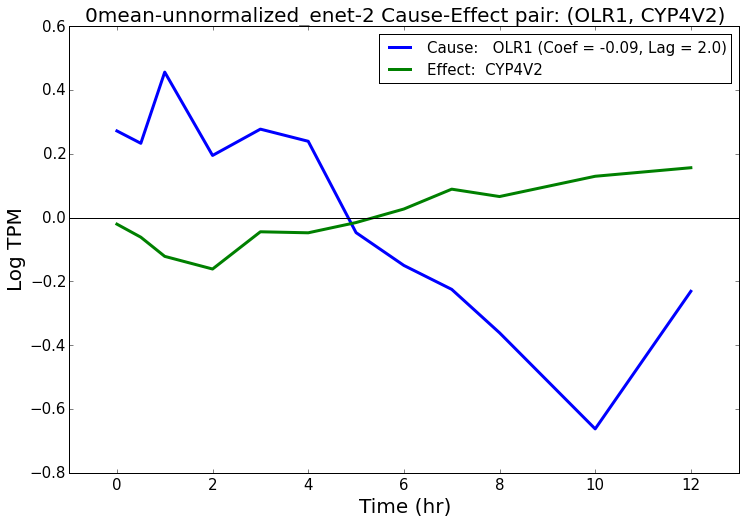

********************************
IL17RB RPL41
********************************
***********************************************
0mean-1var_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                        Summary: Cause Summary: Effect
7632             IL17RB               RPL41  0.072537     1  Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,             NaN
Written to  analysis/plots/common/imm-any/IL17RB-RPL41/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-any/IL17RB-RPL41/0mean-1var_enet-1_IL17RB-RPL41-lag-1-coef-7E-02.pdf
Plot saved to  analysis/plots/common/imm-any/IL17RB-RPL41/0mean-1var_enet-1_IL17RB-RPL41-lag-1-coef-7E-02.pdf


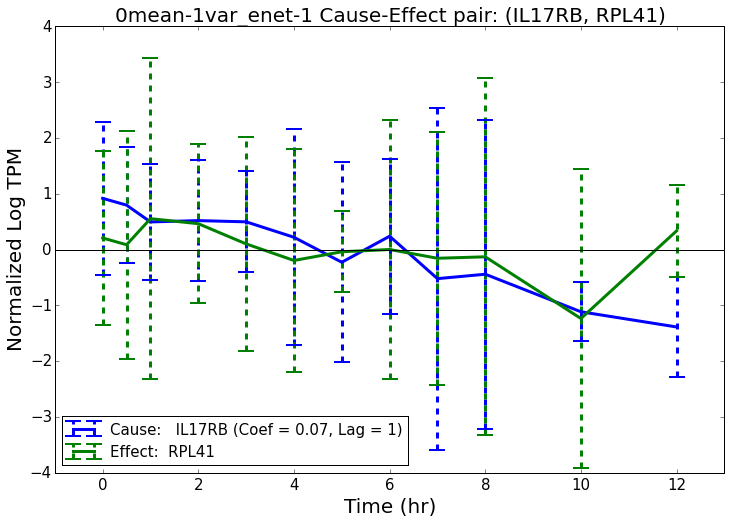

Filename:  analysis/plots/common/imm-any/IL17RB-RPL41/0mean-1var_enet-1_no-bar-IL17RB-RPL41-lag-1-coef-7E-02.pdf
Plot saved to  analysis/plots/common/imm-any/IL17RB-RPL41/0mean-1var_enet-1_no-bar-IL17RB-RPL41-lag-1-coef-7E-02.pdf


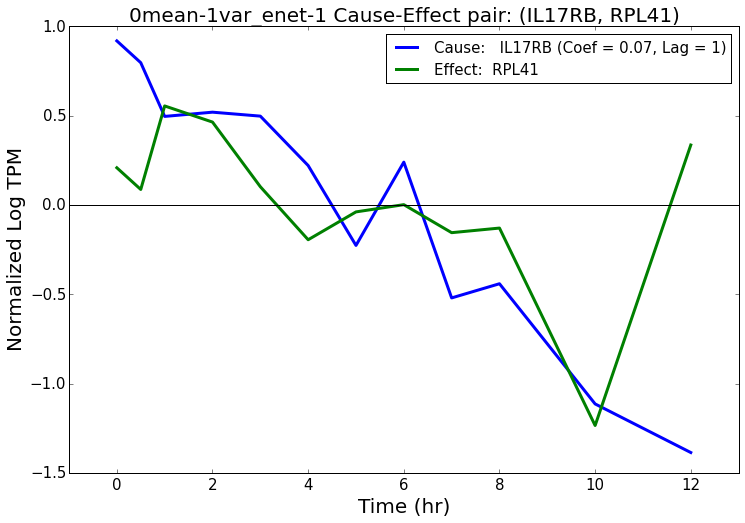

***********************************************
0mean-1var_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                        Summary: Cause Summary: Effect
9617             IL17RB               RPL41  0.051413   1.0  Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,             NaN
Written to  analysis/plots/common/imm-any/IL17RB-RPL41/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-any/IL17RB-RPL41/0mean-1var_enet-2_IL17RB-RPL41-lag-2-coef-5E-02.pdf
Plot saved to  analysis/plots/common/imm-any/IL17RB-RPL41/0mean-1var_enet-2_IL17RB-RPL41-lag-2-coef-5E-02.pdf


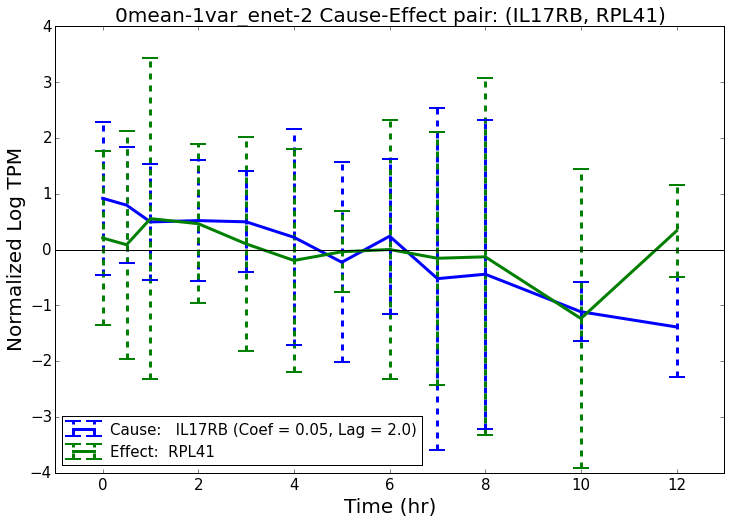

Filename:  analysis/plots/common/imm-any/IL17RB-RPL41/0mean-1var_enet-2_no-bar-IL17RB-RPL41-lag-2-coef-5E-02.pdf
Plot saved to  analysis/plots/common/imm-any/IL17RB-RPL41/0mean-1var_enet-2_no-bar-IL17RB-RPL41-lag-2-coef-5E-02.pdf


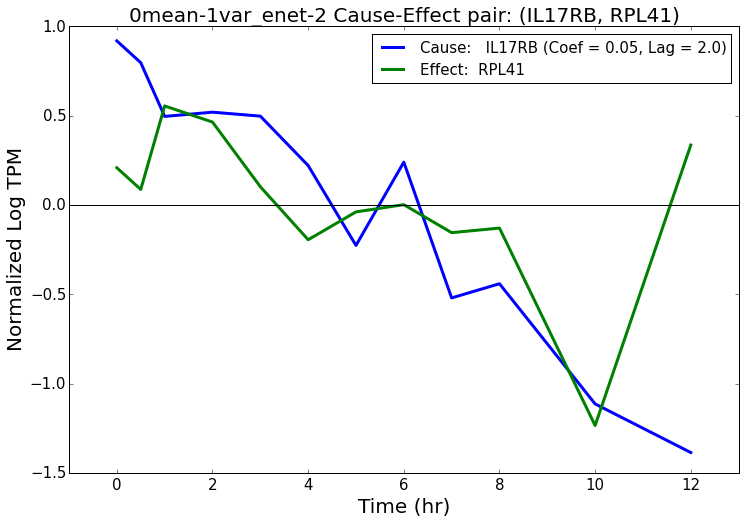

***********************************************
0mean-unnormalized_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                        Summary: Cause Summary: Effect
1292             IL17RB               RPL41  0.132986     1  Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,             NaN
Written to  analysis/plots/common/imm-any/IL17RB-RPL41/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-any/IL17RB-RPL41/0mean-unnormalized_enet-1_IL17RB-RPL41-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/common/imm-any/IL17RB-RPL41/0mean-unnormalized_enet-1_IL17RB-RPL41-lag-1-coef-1E-01.pdf


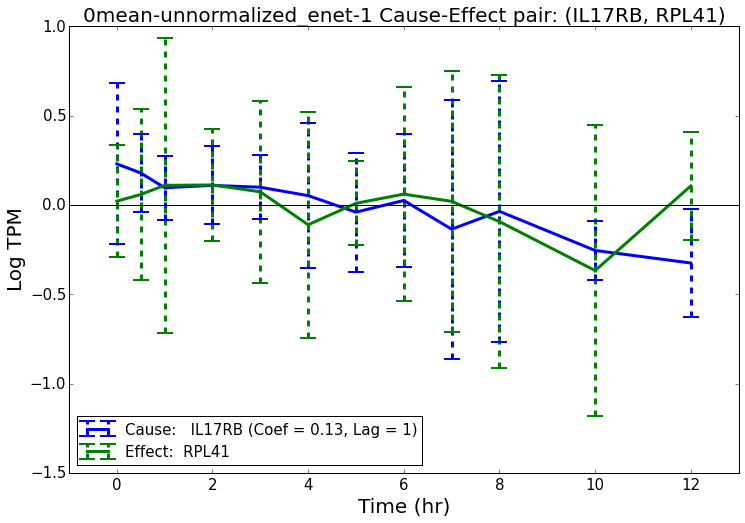

Filename:  analysis/plots/common/imm-any/IL17RB-RPL41/0mean-unnormalized_enet-1_no-bar-IL17RB-RPL41-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/common/imm-any/IL17RB-RPL41/0mean-unnormalized_enet-1_no-bar-IL17RB-RPL41-lag-1-coef-1E-01.pdf


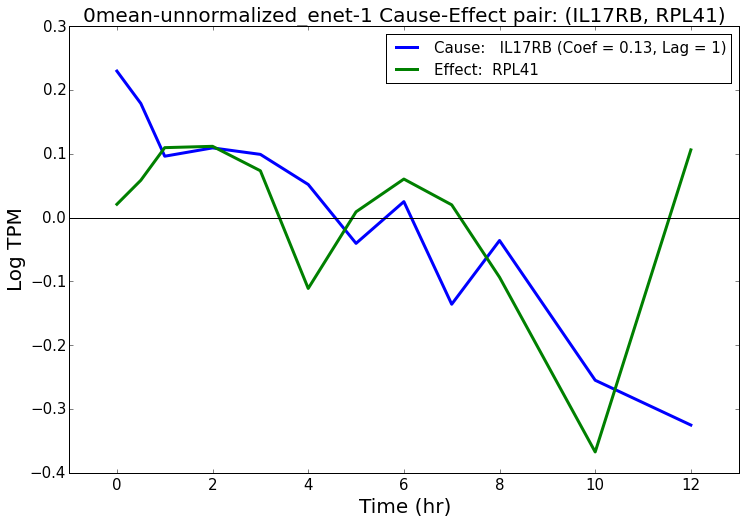

***********************************************
0mean-unnormalized_enet-2
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                        Summary: Cause Summary: Effect
139             IL17RB               RPL41  0.148504   1.0  Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,             NaN
Written to  analysis/plots/common/imm-any/IL17RB-RPL41/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-any/IL17RB-RPL41/0mean-unnormalized_enet-2_IL17RB-RPL41-lag-2-coef-1E-01.pdf
Plot saved to  analysis/plots/common/imm-any/IL17RB-RPL41/0mean-unnormalized_enet-2_IL17RB-RPL41-lag-2-coef-1E-01.pdf


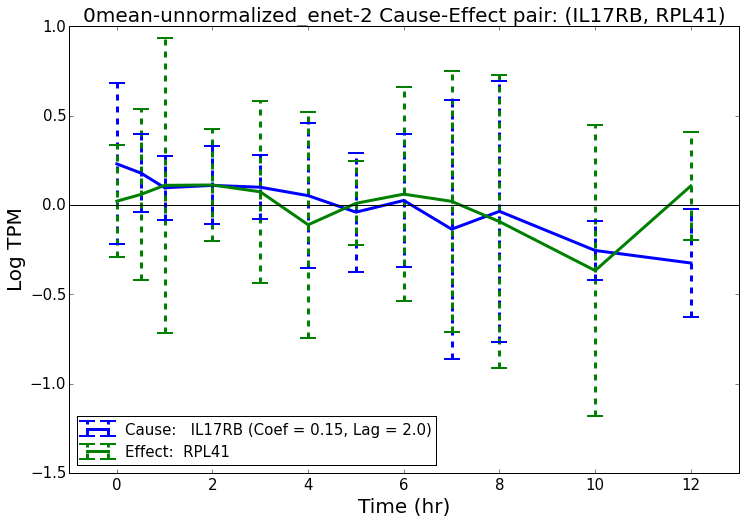

Filename:  analysis/plots/common/imm-any/IL17RB-RPL41/0mean-unnormalized_enet-2_no-bar-IL17RB-RPL41-lag-2-coef-1E-01.pdf
Plot saved to  analysis/plots/common/imm-any/IL17RB-RPL41/0mean-unnormalized_enet-2_no-bar-IL17RB-RPL41-lag-2-coef-1E-01.pdf


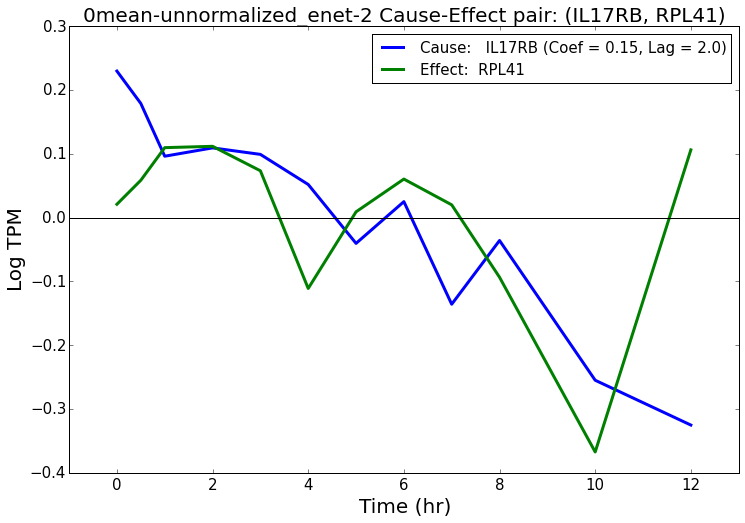

In [81]:
for i, r in plot_df.iterrows():
    print "********************************"
    print r["Gene Symbol: Cause"], r["Gene Symbol: Effect"]
    print "********************************"
    
    
    all_plot_folder = os.path.join(plot_subfolder, "-".join([r["Gene Symbol: Cause"], r["Gene Symbol: Effect"]]))
    
    indices = []
    for j in range(len(names)):
        if r[names[j]] == 1:
            # plot if contains
            indices.append(j)
    
    plot_nets = [nets[ind][nets[ind]["Cause-Effect"] == r["Cause-Effect"]] for ind in indices]
    for p in range(len(plot_nets)):
        plot_nets[p]["Gene Symbol: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_nets[p]["Cause"].values]
        plot_nets[p]["Gene Symbol: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_nets[p]["Effect"].values]
    
    plot_data_hg_df_list = [data_hg_df_list[ind] for ind in indices]
    plot_names = [names[ind] for ind in indices]
    plot_timekeys_list = [timekeys_list[ind] for ind in indices]
    plot_num_per_keys_list = [num_per_keys_list[ind] for ind in indices]
    plot_timepoints_list = [timepoints_list[ind] for ind in indices]
    
    
    do_plot_nets(plot_data_hg_df_list, plot_nets, plot_names, plot_timekeys_list, plot_num_per_keys_list, plot_timepoints_list,
                all_plot_folder=all_plot_folder, include_name_prefix=True, ylabels=ylabels)
    
#     for plot_net, plot_name in zip(plot_nets, plot_names):
#         print plot_name
#         display(plot_net)

# imm-tf

In [82]:
plotfoldersuffix = "imm-tf"
plot_df = edge_network_df[np.logical_and(edge_network_df["Cause"].isin(imm_genes),
                                         edge_network_df["Effect"].isin(tf_genes))].head(top_edge_num)

display(plot_df)

plot_subfolder = os.path.join(plot_common_folder, plotfoldersuffix)
if not os.path.exists(plot_subfolder):
    os.makedirs(plot_subfolder)
    
outfile = os.path.join(plot_subfolder, "top_interactions.csv")
plot_df.to_csv(outfile, index=0)

,Cause-Effect,Cause,Effect,Gene Symbol: Cause,Gene Symbol: Effect,Summary: Cause,Summary: Effect,Abs-Avg-Weight,Total,Networks,0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,Weight: 0mean-1var_enet-1,Weight: 0mean-1var_enet-2,Weight: 0mean-unnormalized_enet-1,Weight: 0mean-unnormalized_enet-2
38874,ENSG00000173391.7-ENSG00000032219.17,ENSG00000173391.7,ENSG00000032219.17,OLR1,ARID4A,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,","TF-Bioguo,DNA-binding_GO,",0.087,4.0,"0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",1,1,1,1,-0.107769,-0.077859,-0.093714,-0.069475
3565,ENSG00000081041.8-ENSG00000004848.6,ENSG00000081041.8,ENSG00000004848.6,CXCL2,ARX,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,","TF-Bioguo,",0.080,4.0,"0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",1,1,1,1,-0.083002,-0.051208,-0.110999,-0.073158
3679,ENSG00000081041.8-ENSG00000162599.14,ENSG00000081041.8,ENSG00000162599.14,CXCL2,NFIA,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,","TF-Bioguo,TF-binding_GO,",0.054,3.0,"0mean-1var_enet-1,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",1,0,1,1,-0.074593,0.000000,-0.092564,-0.047465


********************************
OLR1 ARID4A
********************************


/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


***********************************************
0mean-1var_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                                                   Summary: Cause            Summary: Effect
1236               OLR1              ARID4A -0.107769     1  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  TF-Bioguo,DNA-binding_GO,
Written to  analysis/plots/common/imm-tf/OLR1-ARID4A/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-tf/OLR1-ARID4A/0mean-1var_enet-1_OLR1-ARID4A-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/imm-tf/OLR1-ARID4A/0mean-1var_enet-1_OLR1-ARID4A-lag-1-coef--1E-01.pdf


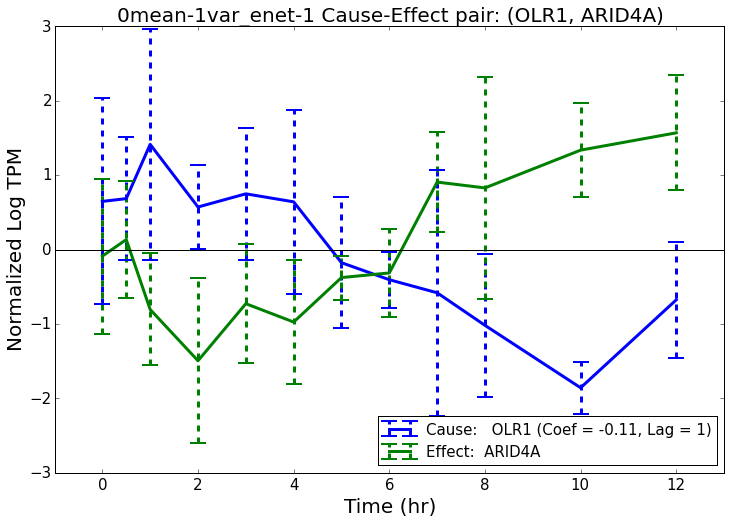

Filename:  analysis/plots/common/imm-tf/OLR1-ARID4A/0mean-1var_enet-1_no-bar-OLR1-ARID4A-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/imm-tf/OLR1-ARID4A/0mean-1var_enet-1_no-bar-OLR1-ARID4A-lag-1-coef--1E-01.pdf


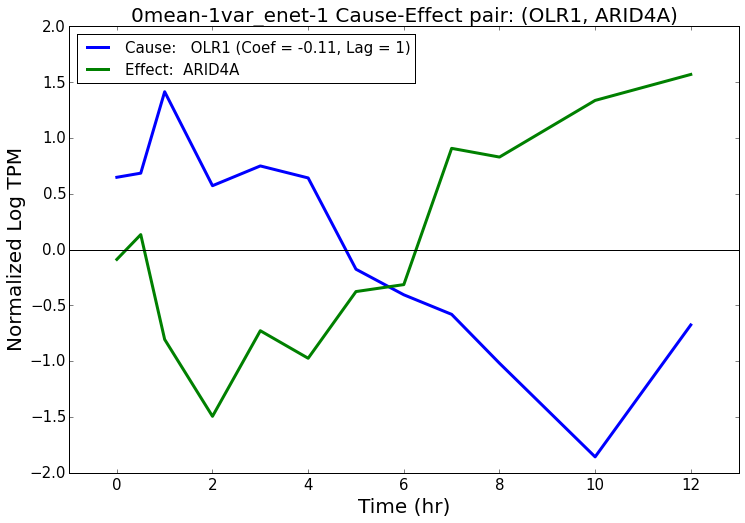

***********************************************
0mean-1var_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                                                   Summary: Cause            Summary: Effect
1766               OLR1              ARID4A -0.077859   1.0  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  TF-Bioguo,DNA-binding_GO,
Written to  analysis/plots/common/imm-tf/OLR1-ARID4A/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-tf/OLR1-ARID4A/0mean-1var_enet-2_OLR1-ARID4A-lag-2-coef--8E-02.pdf
Plot saved to  analysis/plots/common/imm-tf/OLR1-ARID4A/0mean-1var_enet-2_OLR1-ARID4A-lag-2-coef--8E-02.pdf


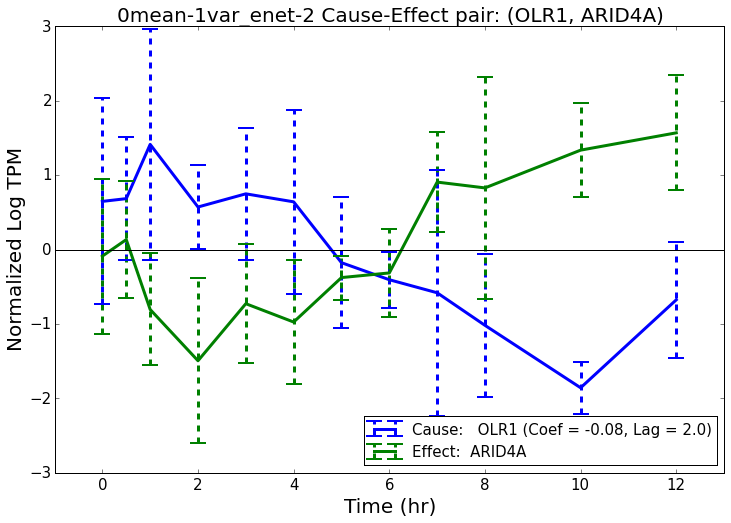

Filename:  analysis/plots/common/imm-tf/OLR1-ARID4A/0mean-1var_enet-2_no-bar-OLR1-ARID4A-lag-2-coef--8E-02.pdf
Plot saved to  analysis/plots/common/imm-tf/OLR1-ARID4A/0mean-1var_enet-2_no-bar-OLR1-ARID4A-lag-2-coef--8E-02.pdf


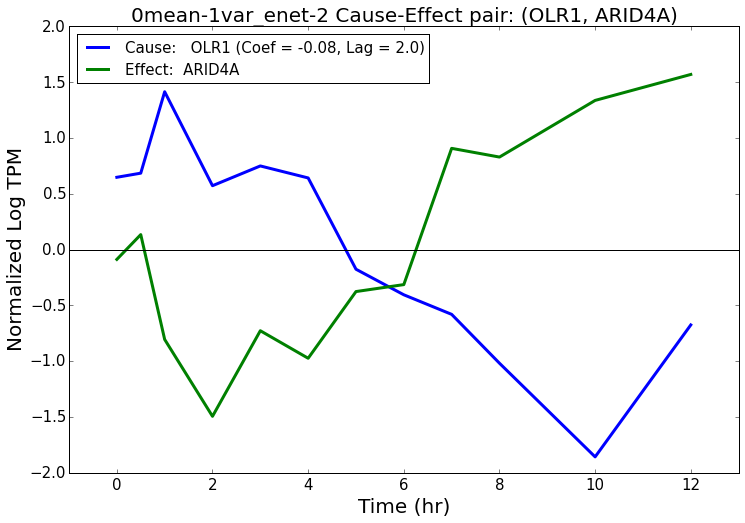

***********************************************
0mean-unnormalized_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                                                   Summary: Cause            Summary: Effect
4871               OLR1              ARID4A -0.093714     1  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  TF-Bioguo,DNA-binding_GO,
Written to  analysis/plots/common/imm-tf/OLR1-ARID4A/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-tf/OLR1-ARID4A/0mean-unnormalized_enet-1_OLR1-ARID4A-lag-1-coef--9E-02.pdf
Plot saved to  analysis/plots/common/imm-tf/OLR1-ARID4A/0mean-unnormalized_enet-1_OLR1-ARID4A-lag-1-coef--9E-02.pdf


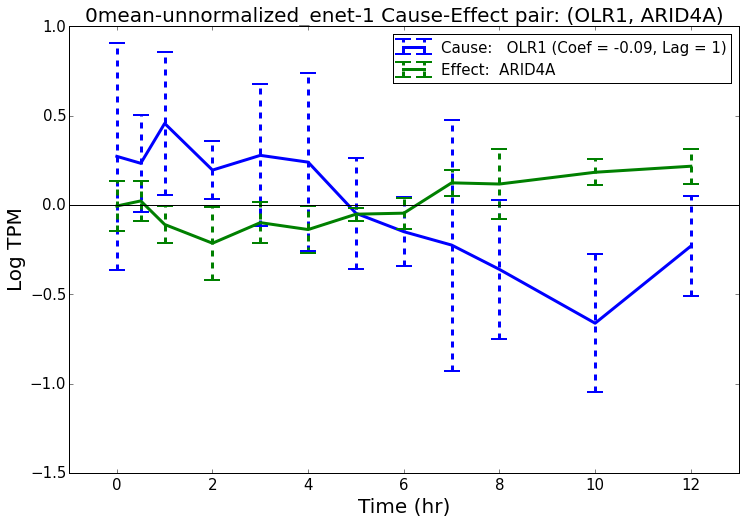

Filename:  analysis/plots/common/imm-tf/OLR1-ARID4A/0mean-unnormalized_enet-1_no-bar-OLR1-ARID4A-lag-1-coef--9E-02.pdf
Plot saved to  analysis/plots/common/imm-tf/OLR1-ARID4A/0mean-unnormalized_enet-1_no-bar-OLR1-ARID4A-lag-1-coef--9E-02.pdf


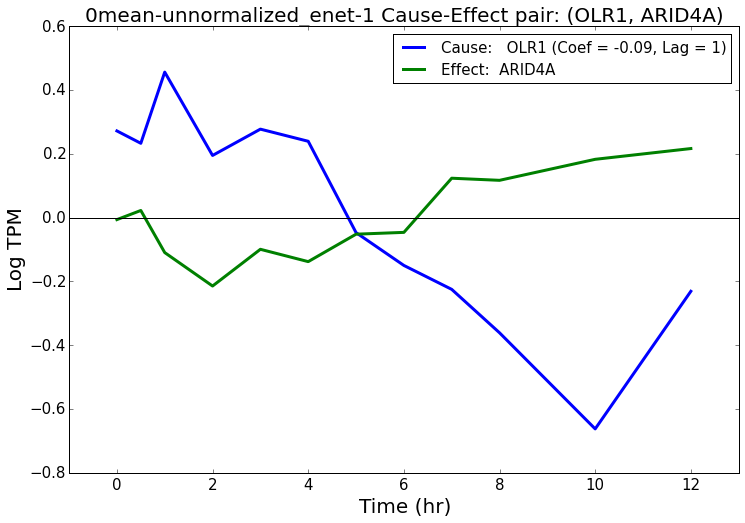

***********************************************
0mean-unnormalized_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                                                   Summary: Cause            Summary: Effect
5730               OLR1              ARID4A -0.069475   1.0  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  TF-Bioguo,DNA-binding_GO,
Written to  analysis/plots/common/imm-tf/OLR1-ARID4A/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-tf/OLR1-ARID4A/0mean-unnormalized_enet-2_OLR1-ARID4A-lag-2-coef--7E-02.pdf
Plot saved to  analysis/plots/common/imm-tf/OLR1-ARID4A/0mean-unnormalized_enet-2_OLR1-ARID4A-lag-2-coef--7E-02.pdf


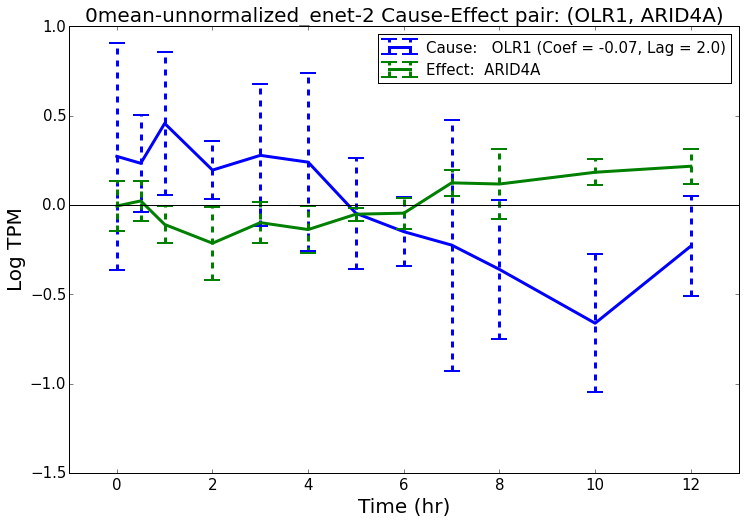

Filename:  analysis/plots/common/imm-tf/OLR1-ARID4A/0mean-unnormalized_enet-2_no-bar-OLR1-ARID4A-lag-2-coef--7E-02.pdf
Plot saved to  analysis/plots/common/imm-tf/OLR1-ARID4A/0mean-unnormalized_enet-2_no-bar-OLR1-ARID4A-lag-2-coef--7E-02.pdf


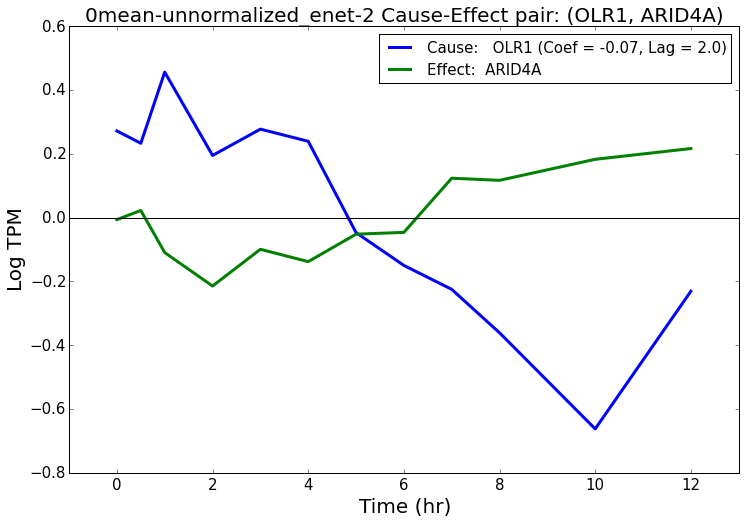

********************************
CXCL2 ARX
********************************
***********************************************
0mean-1var_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                     Summary: Cause Summary: Effect
4955              CXCL2                 ARX -0.083002     1  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,      TF-Bioguo,
Written to  analysis/plots/common/imm-tf/CXCL2-ARX/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-tf/CXCL2-ARX/0mean-1var_enet-1_CXCL2-ARX-lag-1-coef--8E-02.pdf
Plot saved to  analysis/plots/common/imm-tf/CXCL2-ARX/0mean-1var_enet-1_CXCL2-ARX-lag-1-coef--8E-02.pdf


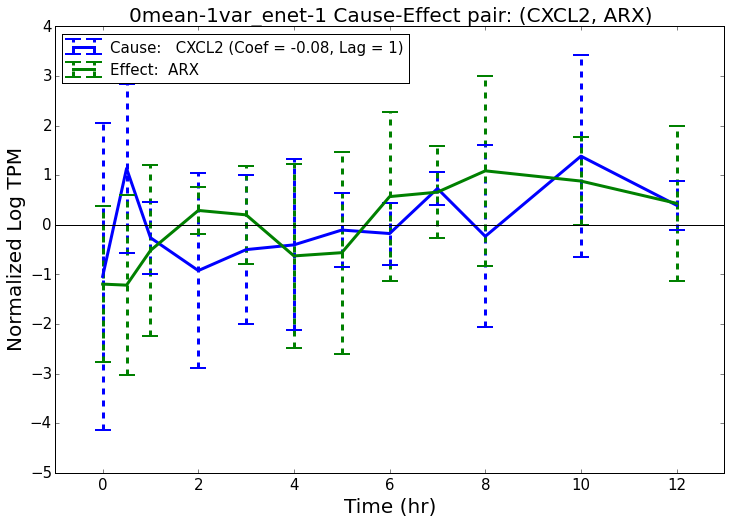

Filename:  analysis/plots/common/imm-tf/CXCL2-ARX/0mean-1var_enet-1_no-bar-CXCL2-ARX-lag-1-coef--8E-02.pdf
Plot saved to  analysis/plots/common/imm-tf/CXCL2-ARX/0mean-1var_enet-1_no-bar-CXCL2-ARX-lag-1-coef--8E-02.pdf


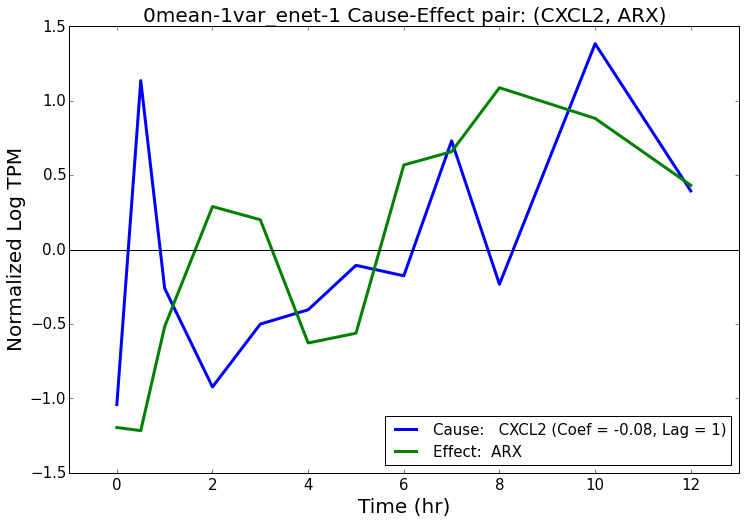

***********************************************
0mean-1var_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                     Summary: Cause Summary: Effect
9683              CXCL2                 ARX -0.051208   1.0  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,      TF-Bioguo,
Written to  analysis/plots/common/imm-tf/CXCL2-ARX/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-tf/CXCL2-ARX/0mean-1var_enet-2_CXCL2-ARX-lag-2-coef--5E-02.pdf
Plot saved to  analysis/plots/common/imm-tf/CXCL2-ARX/0mean-1var_enet-2_CXCL2-ARX-lag-2-coef--5E-02.pdf


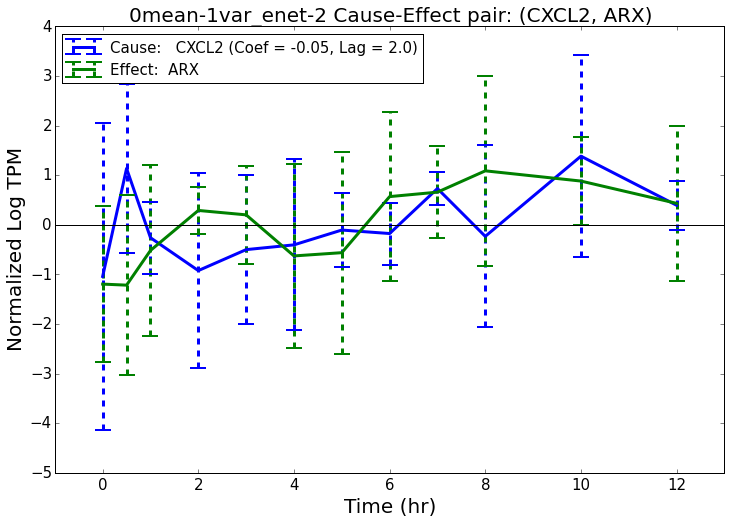

Filename:  analysis/plots/common/imm-tf/CXCL2-ARX/0mean-1var_enet-2_no-bar-CXCL2-ARX-lag-2-coef--5E-02.pdf
Plot saved to  analysis/plots/common/imm-tf/CXCL2-ARX/0mean-1var_enet-2_no-bar-CXCL2-ARX-lag-2-coef--5E-02.pdf


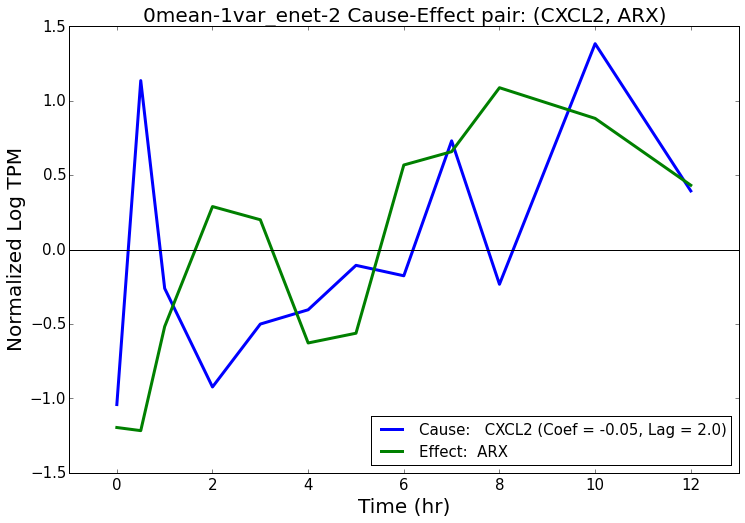

***********************************************
0mean-unnormalized_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                     Summary: Cause Summary: Effect
2744              CXCL2                 ARX -0.110999     1  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,      TF-Bioguo,
Written to  analysis/plots/common/imm-tf/CXCL2-ARX/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-tf/CXCL2-ARX/0mean-unnormalized_enet-1_CXCL2-ARX-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/imm-tf/CXCL2-ARX/0mean-unnormalized_enet-1_CXCL2-ARX-lag-1-coef--1E-01.pdf


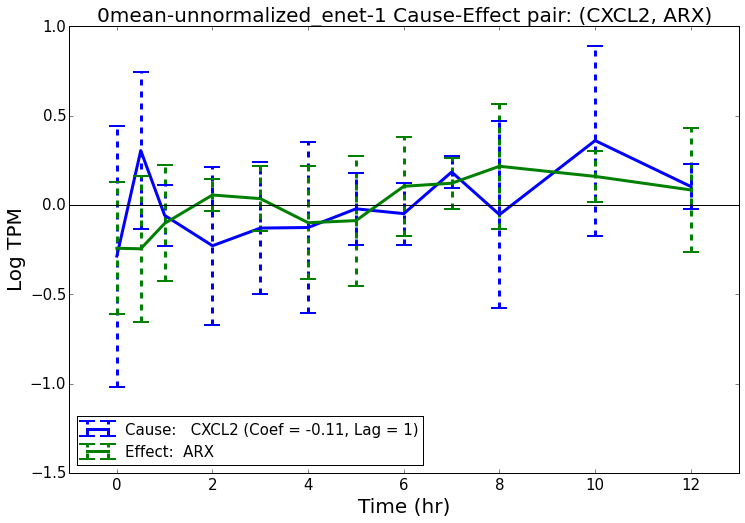

Filename:  analysis/plots/common/imm-tf/CXCL2-ARX/0mean-unnormalized_enet-1_no-bar-CXCL2-ARX-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/imm-tf/CXCL2-ARX/0mean-unnormalized_enet-1_no-bar-CXCL2-ARX-lag-1-coef--1E-01.pdf


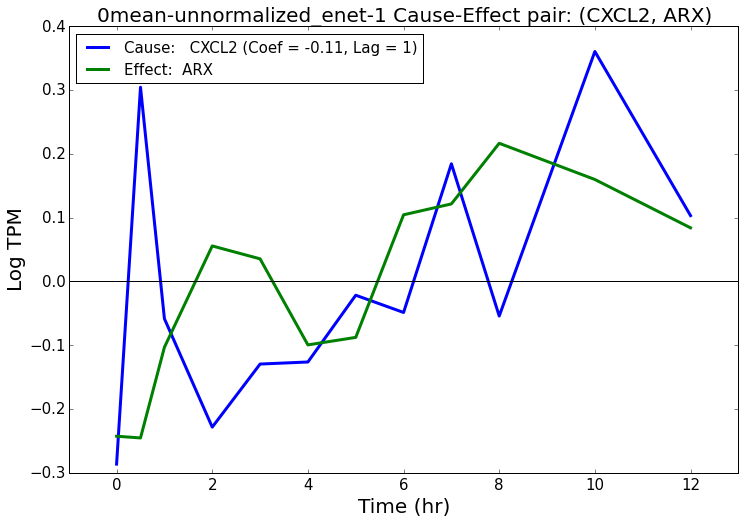

***********************************************
0mean-unnormalized_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                     Summary: Cause Summary: Effect
4830              CXCL2                 ARX -0.073158   1.0  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,      TF-Bioguo,
Written to  analysis/plots/common/imm-tf/CXCL2-ARX/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-tf/CXCL2-ARX/0mean-unnormalized_enet-2_CXCL2-ARX-lag-2-coef--7E-02.pdf
Plot saved to  analysis/plots/common/imm-tf/CXCL2-ARX/0mean-unnormalized_enet-2_CXCL2-ARX-lag-2-coef--7E-02.pdf


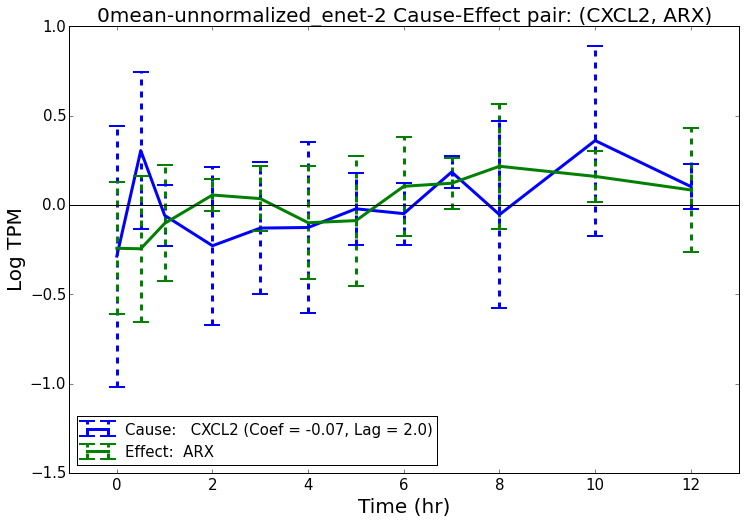

Filename:  analysis/plots/common/imm-tf/CXCL2-ARX/0mean-unnormalized_enet-2_no-bar-CXCL2-ARX-lag-2-coef--7E-02.pdf
Plot saved to  analysis/plots/common/imm-tf/CXCL2-ARX/0mean-unnormalized_enet-2_no-bar-CXCL2-ARX-lag-2-coef--7E-02.pdf


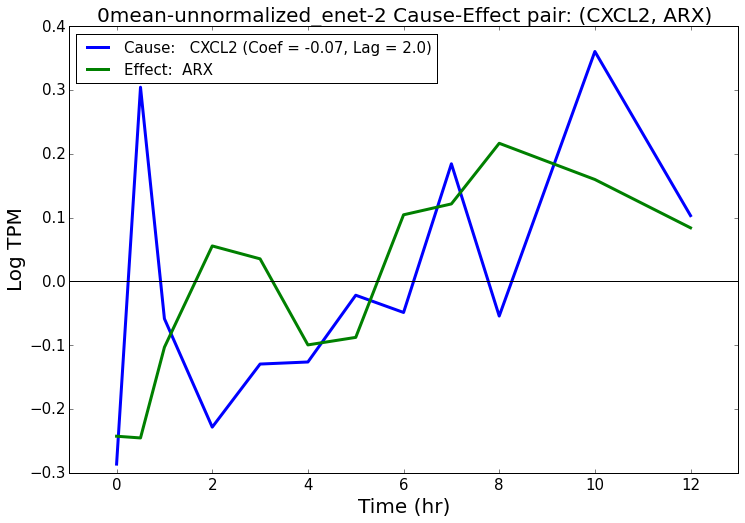

********************************
CXCL2 NFIA
********************************
***********************************************
0mean-1var_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                     Summary: Cause           Summary: Effect
7092              CXCL2                NFIA -0.074593     1  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  TF-Bioguo,TF-binding_GO,
Written to  analysis/plots/common/imm-tf/CXCL2-NFIA/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-tf/CXCL2-NFIA/0mean-1var_enet-1_CXCL2-NFIA-lag-1-coef--7E-02.pdf
Plot saved to  analysis/plots/common/imm-tf/CXCL2-NFIA/0mean-1var_enet-1_CXCL2-NFIA-lag-1-coef--7E-02.pdf


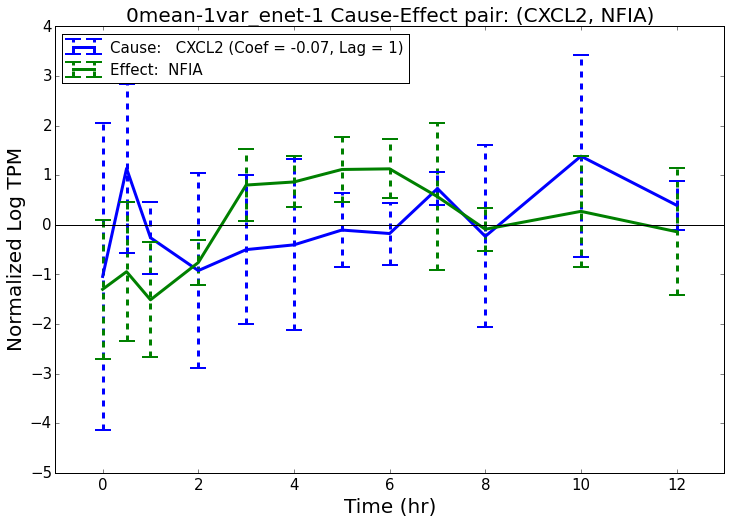

Filename:  analysis/plots/common/imm-tf/CXCL2-NFIA/0mean-1var_enet-1_no-bar-CXCL2-NFIA-lag-1-coef--7E-02.pdf
Plot saved to  analysis/plots/common/imm-tf/CXCL2-NFIA/0mean-1var_enet-1_no-bar-CXCL2-NFIA-lag-1-coef--7E-02.pdf


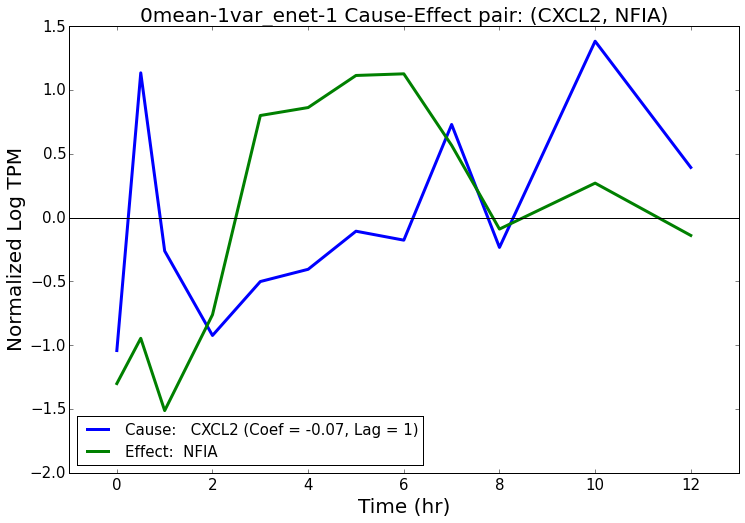

***********************************************
0mean-unnormalized_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                     Summary: Cause           Summary: Effect
5086              CXCL2                NFIA -0.092564     1  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  TF-Bioguo,TF-binding_GO,
Written to  analysis/plots/common/imm-tf/CXCL2-NFIA/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-tf/CXCL2-NFIA/0mean-unnormalized_enet-1_CXCL2-NFIA-lag-1-coef--9E-02.pdf
Plot saved to  analysis/plots/common/imm-tf/CXCL2-NFIA/0mean-unnormalized_enet-1_CXCL2-NFIA-lag-1-coef--9E-02.pdf


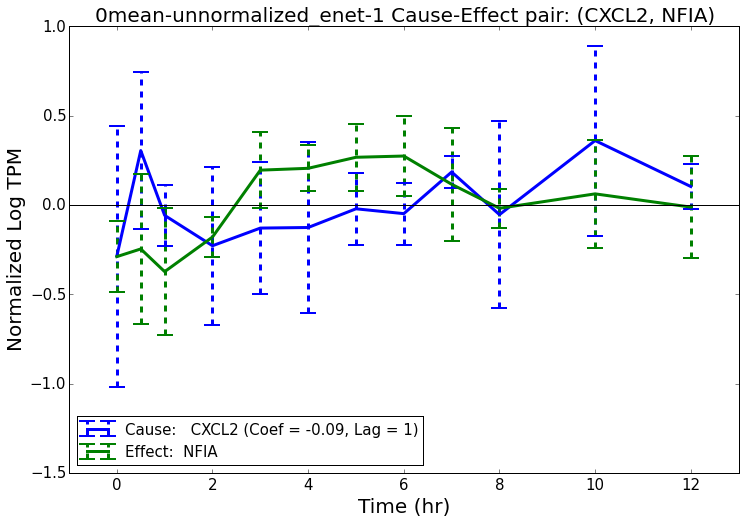

Filename:  analysis/plots/common/imm-tf/CXCL2-NFIA/0mean-unnormalized_enet-1_no-bar-CXCL2-NFIA-lag-1-coef--9E-02.pdf
Plot saved to  analysis/plots/common/imm-tf/CXCL2-NFIA/0mean-unnormalized_enet-1_no-bar-CXCL2-NFIA-lag-1-coef--9E-02.pdf


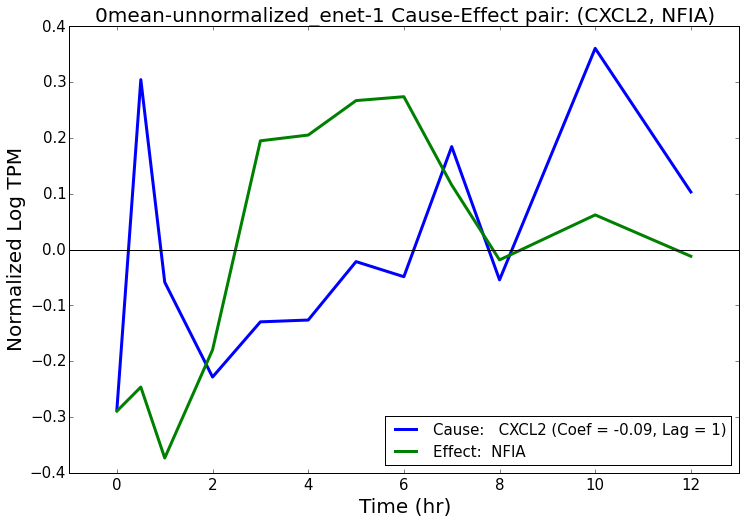

***********************************************
0mean-unnormalized_enet-2
***********************************************
      Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                     Summary: Cause           Summary: Effect
14771              CXCL2                NFIA -0.047465   1.0  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  TF-Bioguo,TF-binding_GO,
Written to  analysis/plots/common/imm-tf/CXCL2-NFIA/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-tf/CXCL2-NFIA/0mean-unnormalized_enet-2_CXCL2-NFIA-lag-2-coef--5E-02.pdf
Plot saved to  analysis/plots/common/imm-tf/CXCL2-NFIA/0mean-unnormalized_enet-2_CXCL2-NFIA-lag-2-coef--5E-02.pdf


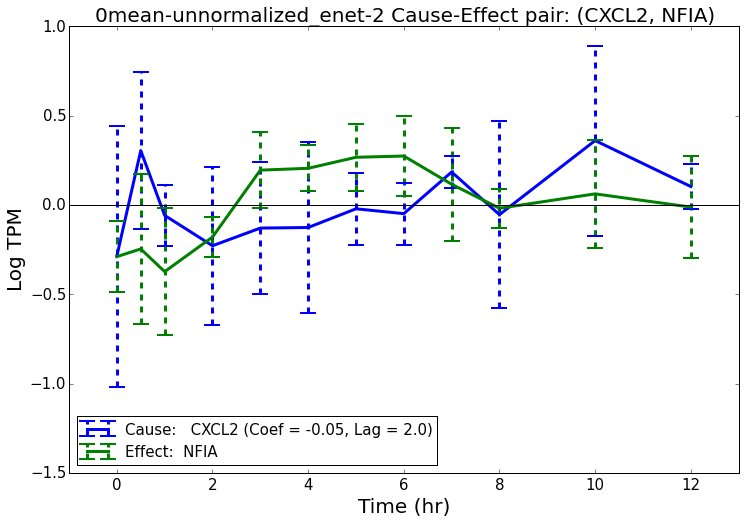

Filename:  analysis/plots/common/imm-tf/CXCL2-NFIA/0mean-unnormalized_enet-2_no-bar-CXCL2-NFIA-lag-2-coef--5E-02.pdf
Plot saved to  analysis/plots/common/imm-tf/CXCL2-NFIA/0mean-unnormalized_enet-2_no-bar-CXCL2-NFIA-lag-2-coef--5E-02.pdf


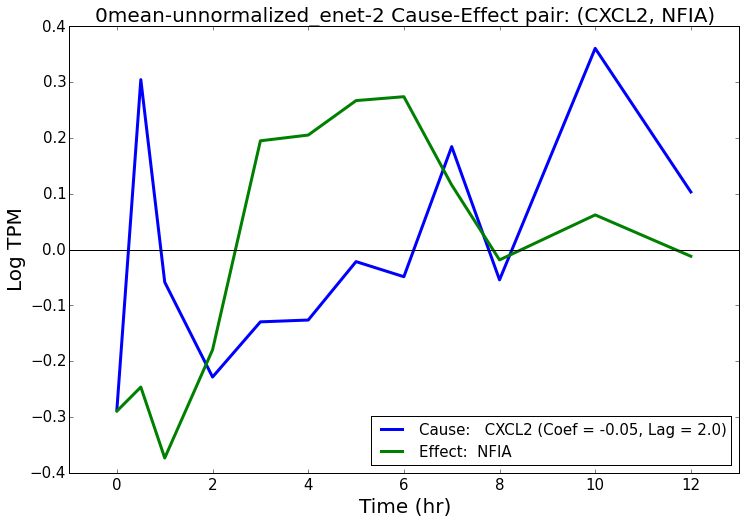

In [83]:
for i, r in plot_df.iterrows():
    print "********************************"
    print r["Gene Symbol: Cause"], r["Gene Symbol: Effect"]
    print "********************************"
    
    
    all_plot_folder = os.path.join(plot_subfolder, "-".join([r["Gene Symbol: Cause"], r["Gene Symbol: Effect"]]))
    
    indices = []
    for j in range(len(names)):
        if r[names[j]] == 1:
            # plot if contains
            indices.append(j)
    
    plot_nets = [nets[ind][nets[ind]["Cause-Effect"] == r["Cause-Effect"]] for ind in indices]
    for p in range(len(plot_nets)):
        plot_nets[p]["Gene Symbol: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_nets[p]["Cause"].values]
        plot_nets[p]["Gene Symbol: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_nets[p]["Effect"].values]
    
    plot_data_hg_df_list = [data_hg_df_list[ind] for ind in indices]
    plot_names = [names[ind] for ind in indices]
    plot_timekeys_list = [timekeys_list[ind] for ind in indices]
    plot_num_per_keys_list = [num_per_keys_list[ind] for ind in indices]
    plot_timepoints_list = [timepoints_list[ind] for ind in indices]
    
    
    do_plot_nets(plot_data_hg_df_list, plot_nets, plot_names, plot_timekeys_list, plot_num_per_keys_list, plot_timepoints_list,
                all_plot_folder=all_plot_folder, include_name_prefix=True, ylabels=ylabels)
    
#     for plot_net, plot_name in zip(plot_nets, plot_names):
#         print plot_name
#         display(plot_net)

# imm-imm

In [84]:
plotfoldersuffix = "imm-imm"
plot_df = edge_network_df[np.logical_and(edge_network_df["Cause"].isin(imm_genes),
                                         edge_network_df["Effect"].isin(imm_genes))].head(top_edge_num)

display(plot_df)

plot_subfolder = os.path.join(plot_common_folder, plotfoldersuffix)
if not os.path.exists(plot_subfolder):
    os.makedirs(plot_subfolder)
    
outfile = os.path.join(plot_subfolder, "top_interactions.csv")
plot_df.to_csv(outfile, index=0)

,Cause-Effect,Cause,Effect,Gene Symbol: Cause,Gene Symbol: Effect,Summary: Cause,Summary: Effect,Abs-Avg-Weight,Total,Networks,0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,Weight: 0mean-1var_enet-1,Weight: 0mean-1var_enet-2,Weight: 0mean-unnormalized_enet-1,Weight: 0mean-unnormalized_enet-2
39046,ENSG00000173391.7-ENSG00000115594.10,ENSG00000173391.7,ENSG00000115594.10,OLR1,IL1R1,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,","Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,",0.057,3.0,"0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",0,1,1,1,0.000000,-0.06230,-0.115185,-0.051237
39099,ENSG00000173391.7-ENSG00000127191.16,ENSG00000173391.7,ENSG00000127191.16,OLR1,TRAF2,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,","Obesity_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,",0.046,3.0,"0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",0,1,1,1,0.000000,0.05421,0.103220,0.027855
54300,ENSG00000197766.6-ENSG00000204525.13,ENSG00000197766.6,ENSG00000204525.13,CFD,HLA-C,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,","Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,",0.042,3.0,"0mean-1var_enet-1,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",1,0,1,1,0.082424,0.00000,0.046779,0.038494


********************************
OLR1 IL1R1
********************************


/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


***********************************************
0mean-1var_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect  Weight  Coef                                                                                   Summary: Cause                                                    Summary: Effect
5330               OLR1               IL1R1 -0.0623   1.0  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/imm-imm/OLR1-IL1R1/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-imm/OLR1-IL1R1/0mean-1var_enet-2_OLR1-IL1R1-lag-2-coef--6E-02.pdf
Plot saved to  analysis/plots/common/imm-imm/OLR1-IL1R1/0mean-1var_enet-2_OLR1-IL1R1-

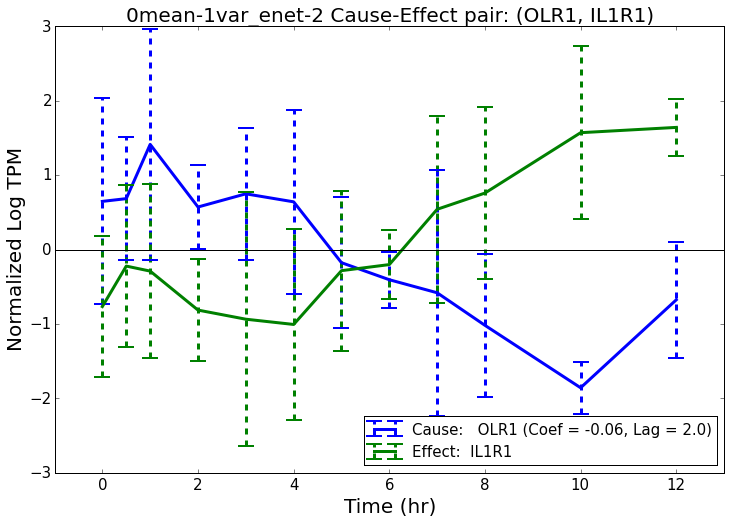

Filename:  analysis/plots/common/imm-imm/OLR1-IL1R1/0mean-1var_enet-2_no-bar-OLR1-IL1R1-lag-2-coef--6E-02.pdf
Plot saved to  analysis/plots/common/imm-imm/OLR1-IL1R1/0mean-1var_enet-2_no-bar-OLR1-IL1R1-lag-2-coef--6E-02.pdf


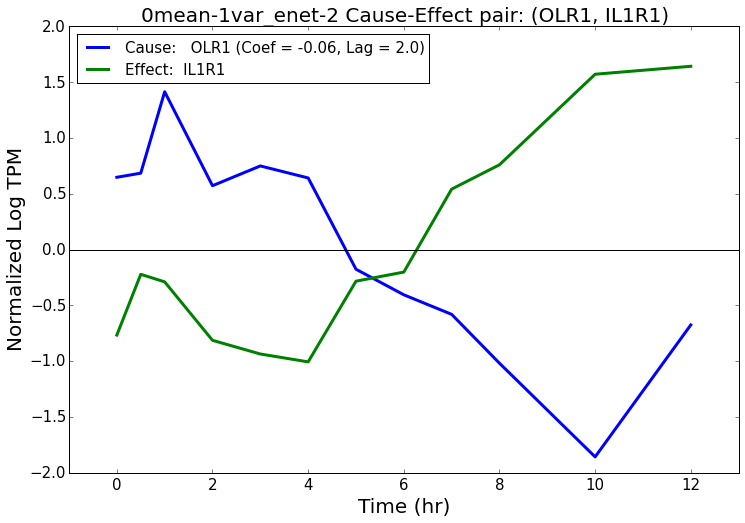

***********************************************
0mean-unnormalized_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                                                   Summary: Cause                                                    Summary: Effect
2357               OLR1               IL1R1 -0.115185     1  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/imm-imm/OLR1-IL1R1/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-imm/OLR1-IL1R1/0mean-unnormalized_enet-1_OLR1-IL1R1-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/imm-imm/OLR1-IL1R1/0

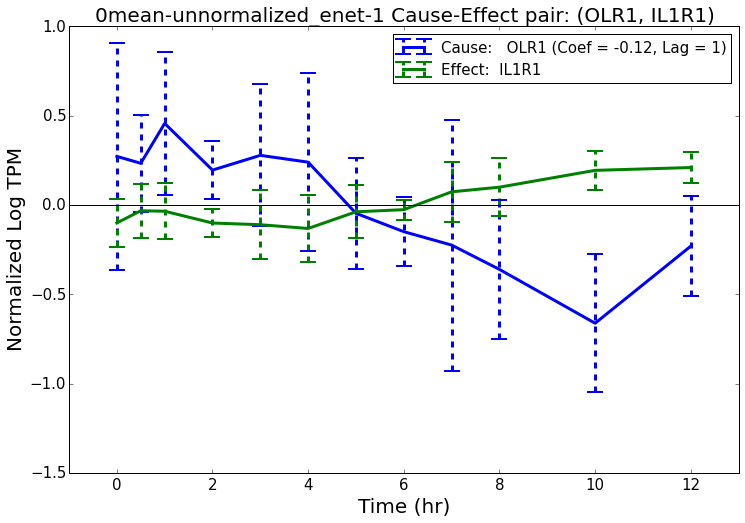

Filename:  analysis/plots/common/imm-imm/OLR1-IL1R1/0mean-unnormalized_enet-1_no-bar-OLR1-IL1R1-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/imm-imm/OLR1-IL1R1/0mean-unnormalized_enet-1_no-bar-OLR1-IL1R1-lag-1-coef--1E-01.pdf


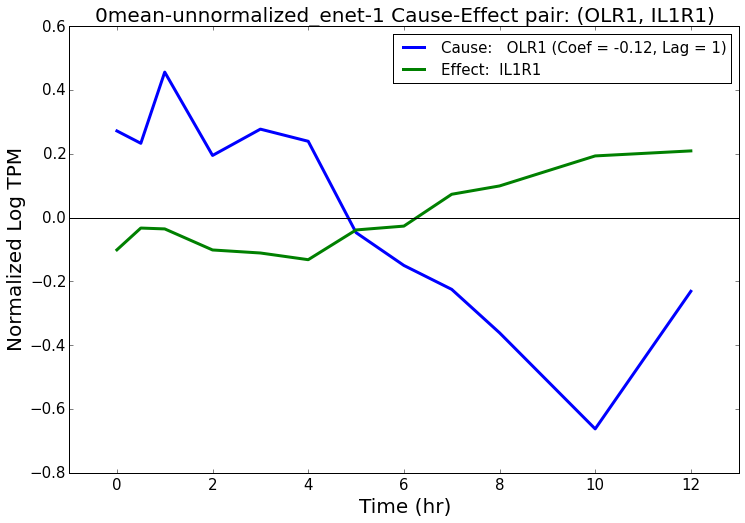

***********************************************
0mean-unnormalized_enet-2
***********************************************
      Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                                                   Summary: Cause                                                    Summary: Effect
12686               OLR1               IL1R1 -0.051237   1.0  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/imm-imm/OLR1-IL1R1/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-imm/OLR1-IL1R1/0mean-unnormalized_enet-2_OLR1-IL1R1-lag-2-coef--5E-02.pdf
Plot saved to  analysis/plots/common/imm-imm/OLR1-IL1R1

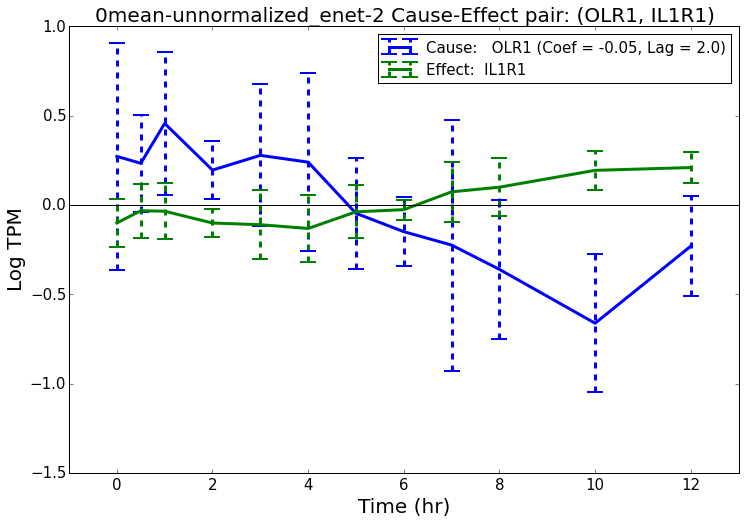

Filename:  analysis/plots/common/imm-imm/OLR1-IL1R1/0mean-unnormalized_enet-2_no-bar-OLR1-IL1R1-lag-2-coef--5E-02.pdf
Plot saved to  analysis/plots/common/imm-imm/OLR1-IL1R1/0mean-unnormalized_enet-2_no-bar-OLR1-IL1R1-lag-2-coef--5E-02.pdf


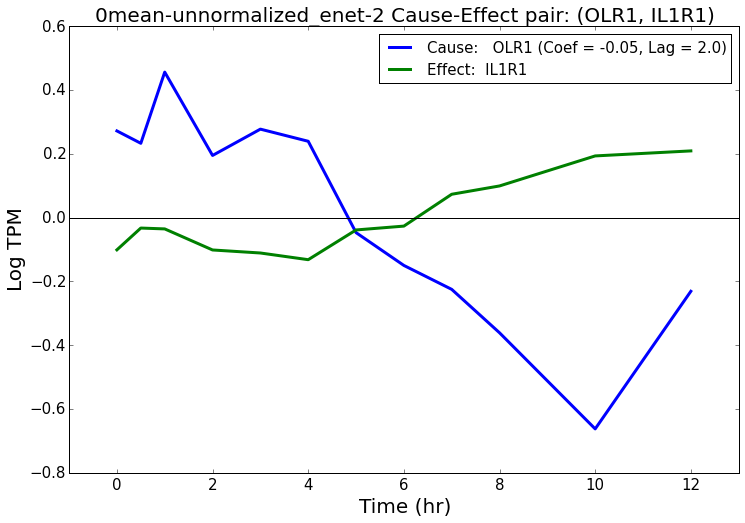

********************************
OLR1 TRAF2
********************************
***********************************************
0mean-1var_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect   Weight  Coef                                                                                   Summary: Cause                                                                 Summary: Effect
8478               OLR1               TRAF2  0.05421   1.0  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  Obesity_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/imm-imm/OLR1-TRAF2/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-imm/OLR1-TRAF2/0mean-1var_enet-2_OLR1-TRAF2-la

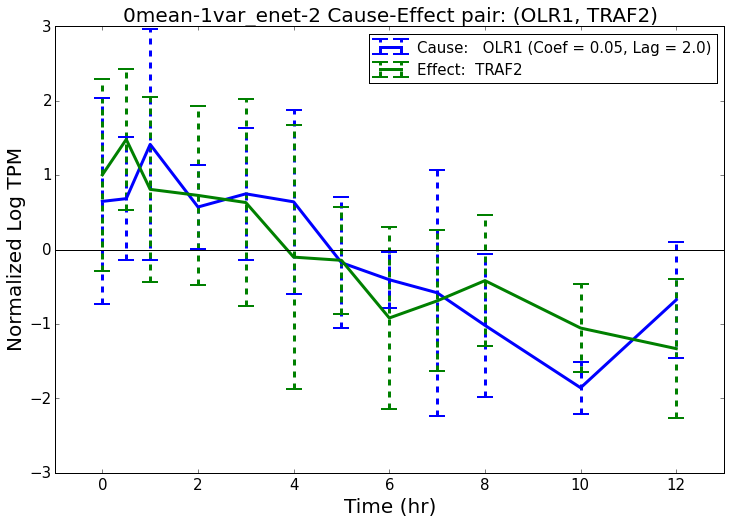

Filename:  analysis/plots/common/imm-imm/OLR1-TRAF2/0mean-1var_enet-2_no-bar-OLR1-TRAF2-lag-2-coef-5E-02.pdf
Plot saved to  analysis/plots/common/imm-imm/OLR1-TRAF2/0mean-1var_enet-2_no-bar-OLR1-TRAF2-lag-2-coef-5E-02.pdf


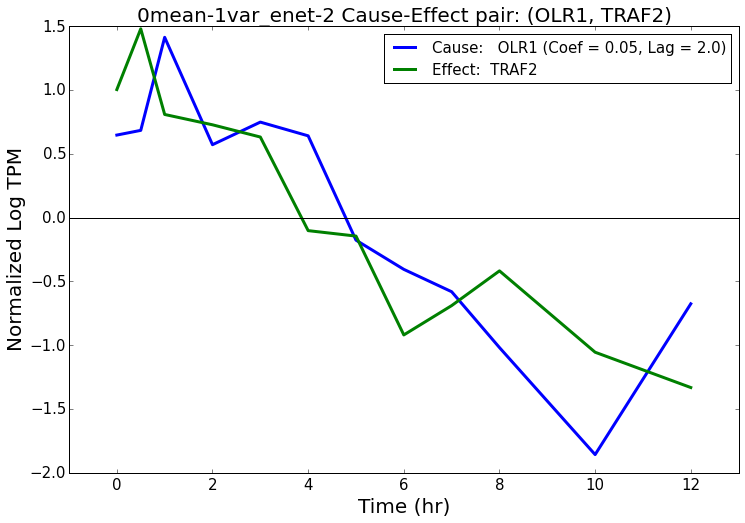

***********************************************
0mean-unnormalized_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect   Weight  Coef                                                                                   Summary: Cause                                                                 Summary: Effect
3602               OLR1               TRAF2  0.10322     1  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  Obesity_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/imm-imm/OLR1-TRAF2/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-imm/OLR1-TRAF2/0mean-unnormalized_enet-1_OLR1-TRAF2-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/comm

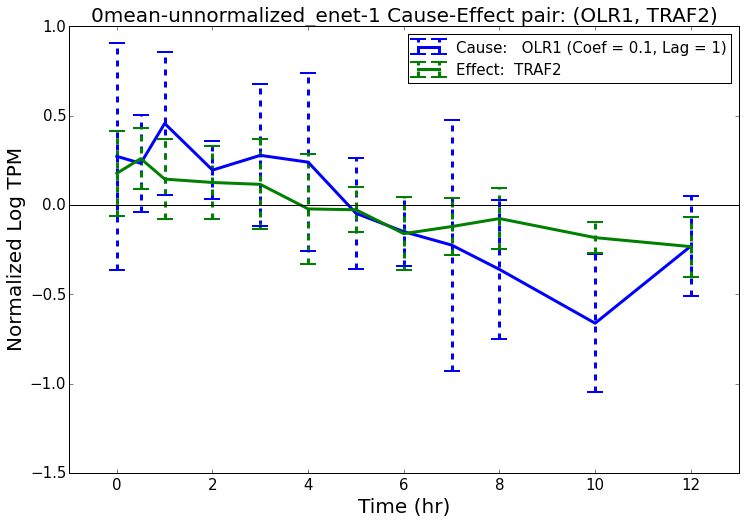

Filename:  analysis/plots/common/imm-imm/OLR1-TRAF2/0mean-unnormalized_enet-1_no-bar-OLR1-TRAF2-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/common/imm-imm/OLR1-TRAF2/0mean-unnormalized_enet-1_no-bar-OLR1-TRAF2-lag-1-coef-1E-01.pdf


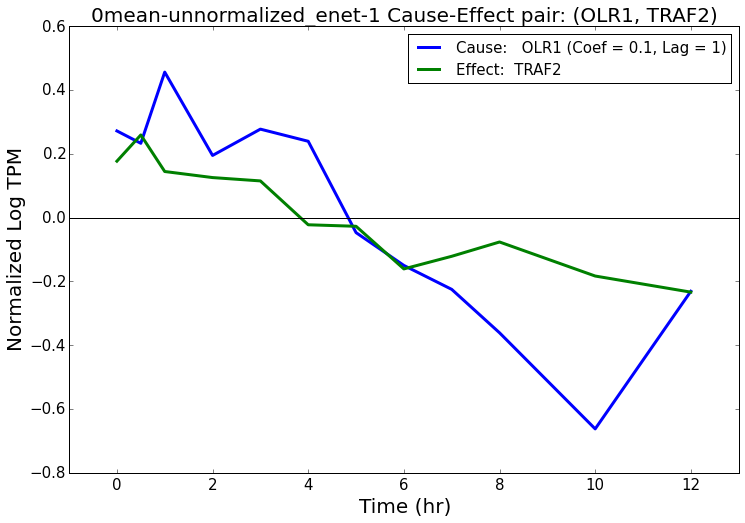

***********************************************
0mean-unnormalized_enet-2
***********************************************
      Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                                                   Summary: Cause                                                                 Summary: Effect
25467               OLR1               TRAF2  0.027855   1.0  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  Obesity_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/imm-imm/OLR1-TRAF2/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-imm/OLR1-TRAF2/0mean-unnormalized_enet-2_OLR1-TRAF2-lag-2-coef-3E-02.pdf
Plot saved to  analysis/plots/

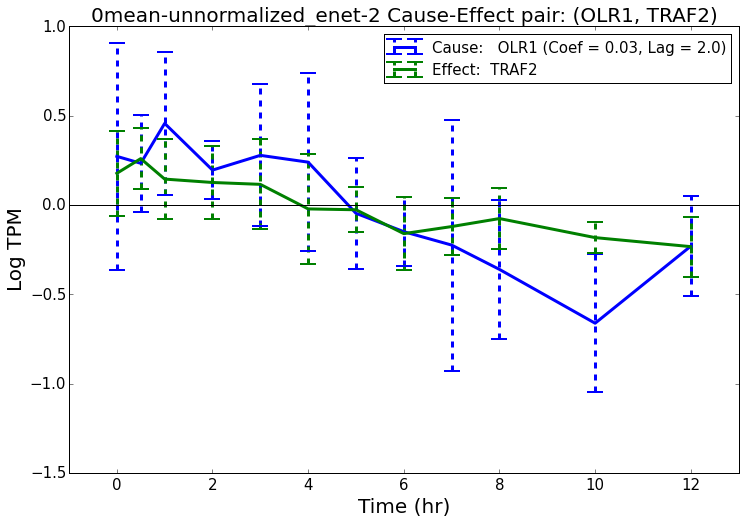

Filename:  analysis/plots/common/imm-imm/OLR1-TRAF2/0mean-unnormalized_enet-2_no-bar-OLR1-TRAF2-lag-2-coef-3E-02.pdf
Plot saved to  analysis/plots/common/imm-imm/OLR1-TRAF2/0mean-unnormalized_enet-2_no-bar-OLR1-TRAF2-lag-2-coef-3E-02.pdf


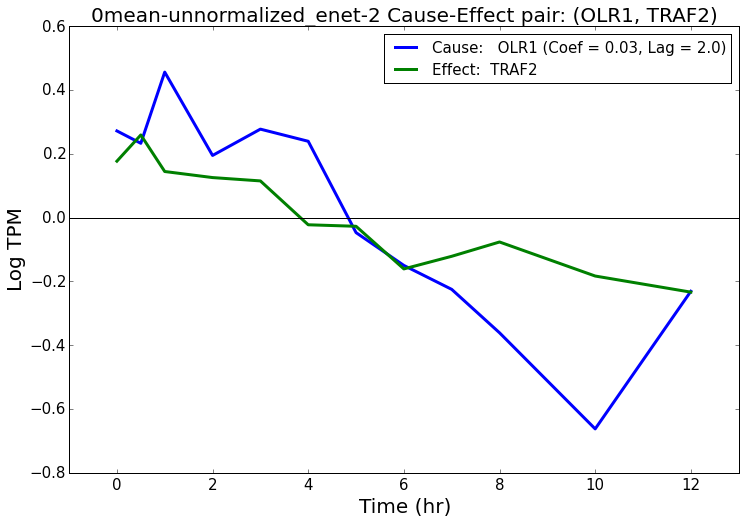

********************************
CFD HLA-C
********************************
***********************************************
0mean-1var_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                     Summary: Cause                                                                  Summary: Effect
5106                CFD               HLA-C  0.082424     1  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/imm-imm/CFD-HLA-C/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-imm/CFD-HLA-C/0mean-1var_enet-1_CFD-HLA-C-lag-1-coef-8E-02.pdf
Plot saved to  analysis/plots/common/imm-

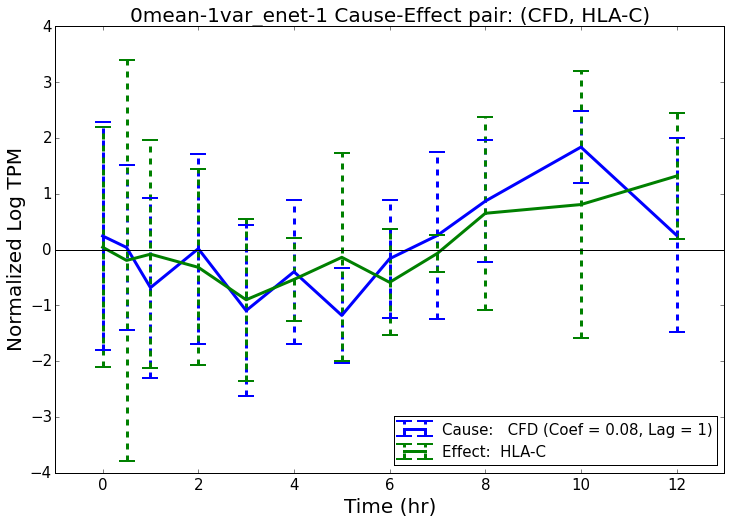

Filename:  analysis/plots/common/imm-imm/CFD-HLA-C/0mean-1var_enet-1_no-bar-CFD-HLA-C-lag-1-coef-8E-02.pdf
Plot saved to  analysis/plots/common/imm-imm/CFD-HLA-C/0mean-1var_enet-1_no-bar-CFD-HLA-C-lag-1-coef-8E-02.pdf


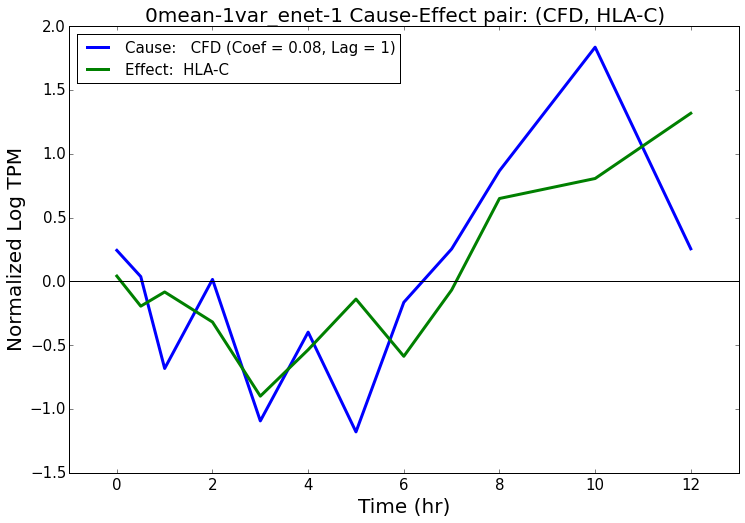

***********************************************
0mean-unnormalized_enet-1
***********************************************
      Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                     Summary: Cause                                                                  Summary: Effect
18860                CFD               HLA-C  0.046779     1  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/imm-imm/CFD-HLA-C/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-imm/CFD-HLA-C/0mean-unnormalized_enet-1_CFD-HLA-C-lag-1-coef-5E-02.pdf
Plot saved to  analysis/plots/common/imm-imm/CFD-HLA-C/0mean-unnormalized_enet-1_CFD-HLA-C-

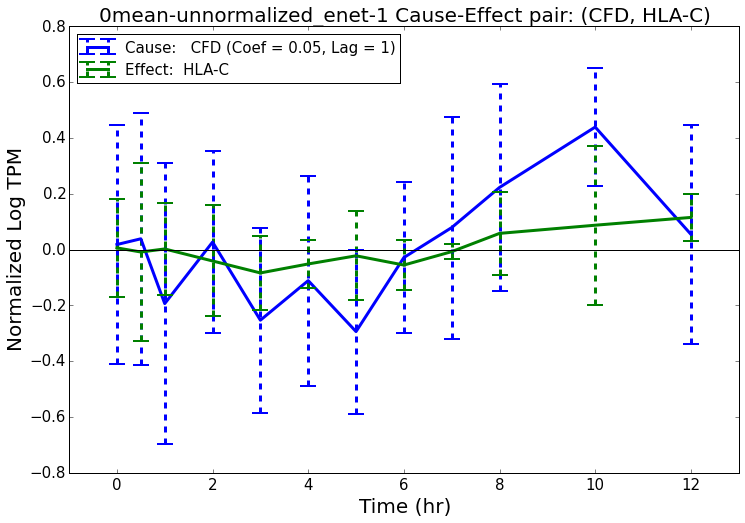

Filename:  analysis/plots/common/imm-imm/CFD-HLA-C/0mean-unnormalized_enet-1_no-bar-CFD-HLA-C-lag-1-coef-5E-02.pdf
Plot saved to  analysis/plots/common/imm-imm/CFD-HLA-C/0mean-unnormalized_enet-1_no-bar-CFD-HLA-C-lag-1-coef-5E-02.pdf


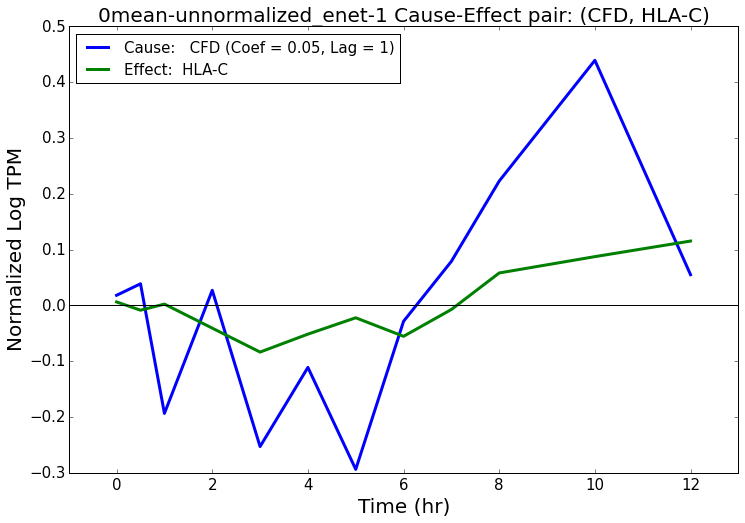

***********************************************
0mean-unnormalized_enet-2
***********************************************
      Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                     Summary: Cause                                                                  Summary: Effect
19978                CFD               HLA-C  0.038494   1.0  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/imm-imm/CFD-HLA-C/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-imm/CFD-HLA-C/0mean-unnormalized_enet-2_CFD-HLA-C-lag-2-coef-4E-02.pdf
Plot saved to  analysis/plots/common/imm-imm/CFD-HLA-C/0mean-unnormalized_enet-2_CFD-HLA-C-

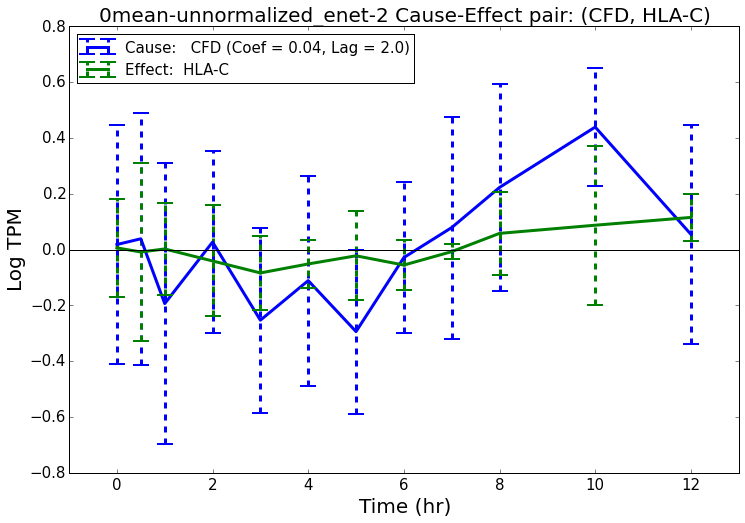

Filename:  analysis/plots/common/imm-imm/CFD-HLA-C/0mean-unnormalized_enet-2_no-bar-CFD-HLA-C-lag-2-coef-4E-02.pdf
Plot saved to  analysis/plots/common/imm-imm/CFD-HLA-C/0mean-unnormalized_enet-2_no-bar-CFD-HLA-C-lag-2-coef-4E-02.pdf


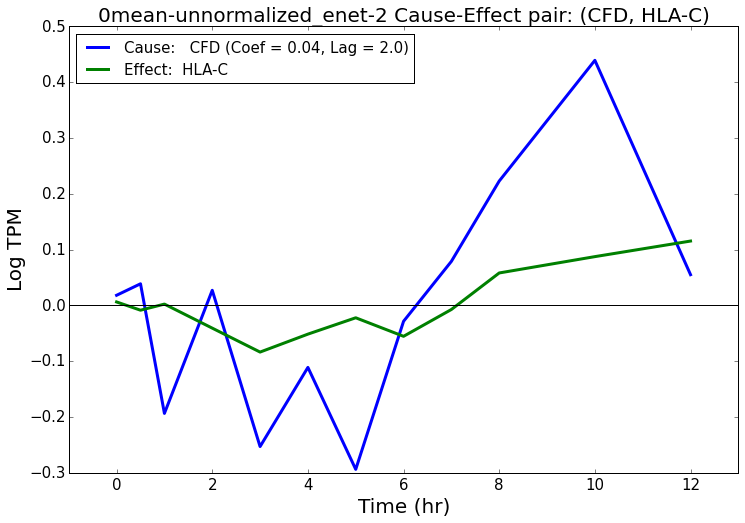

In [85]:
for i, r in plot_df.iterrows():
    print "********************************"
    print r["Gene Symbol: Cause"], r["Gene Symbol: Effect"]
    print "********************************"
    
    
    all_plot_folder = os.path.join(plot_subfolder, "-".join([r["Gene Symbol: Cause"], r["Gene Symbol: Effect"]]))
    
    indices = []
    for j in range(len(names)):
        if r[names[j]] == 1:
            # plot if contains
            indices.append(j)
    
    plot_nets = [nets[ind][nets[ind]["Cause-Effect"] == r["Cause-Effect"]] for ind in indices]
    for p in range(len(plot_nets)):
        plot_nets[p]["Gene Symbol: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_nets[p]["Cause"].values]
        plot_nets[p]["Gene Symbol: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_nets[p]["Effect"].values]
    
    plot_data_hg_df_list = [data_hg_df_list[ind] for ind in indices]
    plot_names = [names[ind] for ind in indices]
    plot_timekeys_list = [timekeys_list[ind] for ind in indices]
    plot_num_per_keys_list = [num_per_keys_list[ind] for ind in indices]
    plot_timepoints_list = [timepoints_list[ind] for ind in indices]
    
    
    do_plot_nets(plot_data_hg_df_list, plot_nets, plot_names, plot_timekeys_list, plot_num_per_keys_list, plot_timepoints_list,
                all_plot_folder=all_plot_folder, include_name_prefix=True, ylabels=ylabels)
    
#     for plot_net, plot_name in zip(plot_nets, plot_names):
#         print plot_name
#         display(plot_net)

# imm-metab

In [86]:
plotfoldersuffix = "imm-metab"
plot_df = edge_network_df[np.logical_and(edge_network_df["Cause"].isin(imm_genes), edge_network_df["Effect"].isin(metab_genes))].head(top_edge_num)

display(plot_df)

plot_subfolder = os.path.join(plot_common_folder, plotfoldersuffix)
if not os.path.exists(plot_subfolder):
    os.makedirs(plot_subfolder)
    
outfile = os.path.join(plot_subfolder, "top_interactions.csv")
plot_df.to_csv(outfile, index=0)

,Cause-Effect,Cause,Effect,Gene Symbol: Cause,Gene Symbol: Effect,Summary: Cause,Summary: Effect,Abs-Avg-Weight,Total,Networks,0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,Weight: 0mean-1var_enet-1,Weight: 0mean-1var_enet-2,Weight: 0mean-unnormalized_enet-1,Weight: 0mean-unnormalized_enet-2
39099,ENSG00000173391.7-ENSG00000127191.16,ENSG00000173391.7,ENSG00000127191.16,OLR1,TRAF2,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,","Obesity_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,",0.046,3.0,"0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",0,1,1,1,0.000000,0.05421,0.103220,0.027855
249,ENSG00000006606.7-ENSG00000166340.13,ENSG00000006606.7,ENSG00000166340.13,CCL26,TPP1,"Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,","Diabetes_GSEA,",0.042,3.0,"0mean-1var_enet-1,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",1,0,1,1,-0.082581,0.00000,-0.057541,-0.027657
54300,ENSG00000197766.6-ENSG00000204525.13,ENSG00000197766.6,ENSG00000204525.13,CFD,HLA-C,"Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,","Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,",0.042,3.0,"0mean-1var_enet-1,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",1,0,1,1,0.082424,0.00000,0.046779,0.038494


********************************
OLR1 TRAF2
********************************


/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


***********************************************
0mean-1var_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect   Weight  Coef                                                                                   Summary: Cause                                                                 Summary: Effect
8478               OLR1               TRAF2  0.05421   1.0  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  Obesity_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/imm-metab/OLR1-TRAF2/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-metab/OLR1-TRAF2/0mean-1var_enet-2_OLR1-TRAF2-lag-2-coef-5E-02.pdf
Plot saved to  analysis/plots/common/imm-metab/OLR1-TR

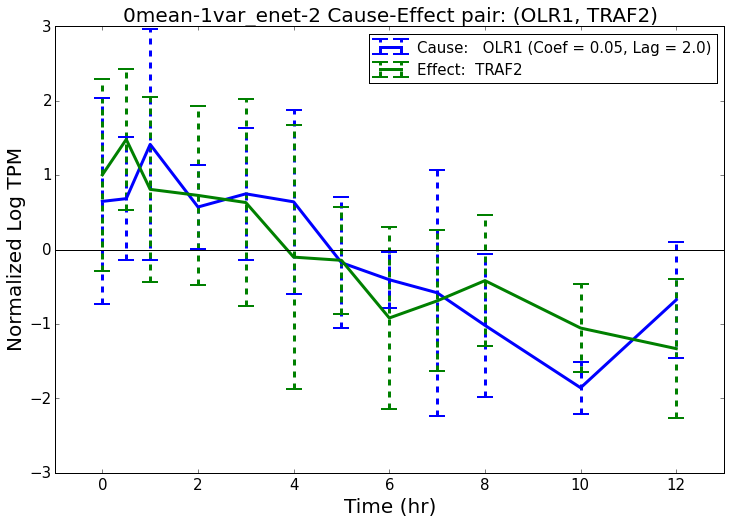

Filename:  analysis/plots/common/imm-metab/OLR1-TRAF2/0mean-1var_enet-2_no-bar-OLR1-TRAF2-lag-2-coef-5E-02.pdf
Plot saved to  analysis/plots/common/imm-metab/OLR1-TRAF2/0mean-1var_enet-2_no-bar-OLR1-TRAF2-lag-2-coef-5E-02.pdf


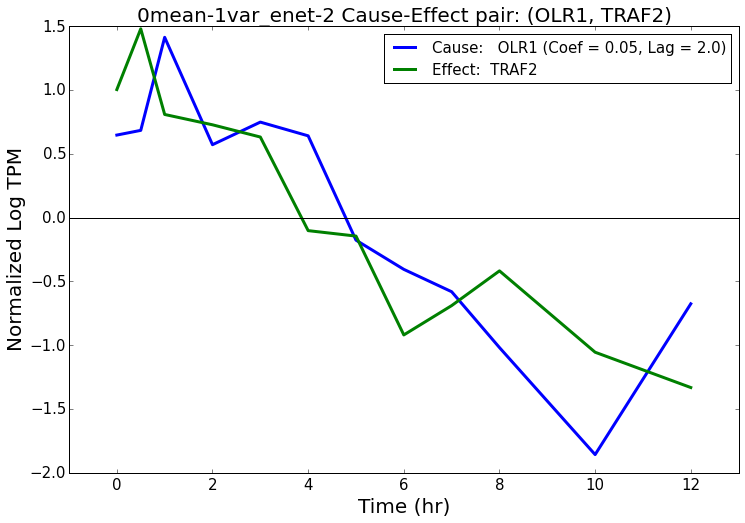

***********************************************
0mean-unnormalized_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect   Weight  Coef                                                                                   Summary: Cause                                                                 Summary: Effect
3602               OLR1               TRAF2  0.10322     1  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  Obesity_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/imm-metab/OLR1-TRAF2/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-metab/OLR1-TRAF2/0mean-unnormalized_enet-1_OLR1-TRAF2-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/

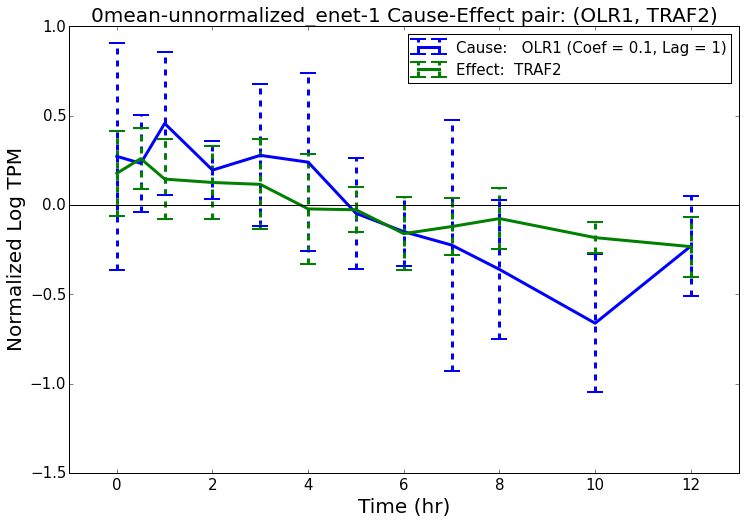

Filename:  analysis/plots/common/imm-metab/OLR1-TRAF2/0mean-unnormalized_enet-1_no-bar-OLR1-TRAF2-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/common/imm-metab/OLR1-TRAF2/0mean-unnormalized_enet-1_no-bar-OLR1-TRAF2-lag-1-coef-1E-01.pdf


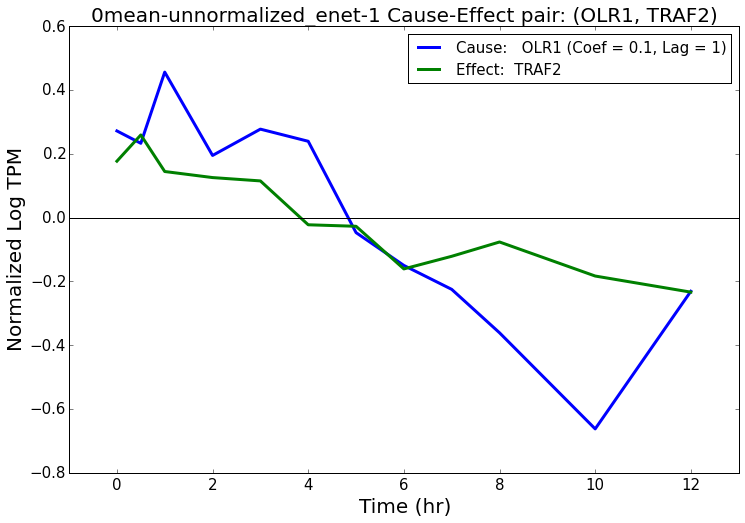

***********************************************
0mean-unnormalized_enet-2
***********************************************
      Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                                                   Summary: Cause                                                                 Summary: Effect
25467               OLR1               TRAF2  0.027855   1.0  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  Obesity_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/imm-metab/OLR1-TRAF2/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-metab/OLR1-TRAF2/0mean-unnormalized_enet-2_OLR1-TRAF2-lag-2-coef-3E-02.pdf
Plot saved to  analysis/pl

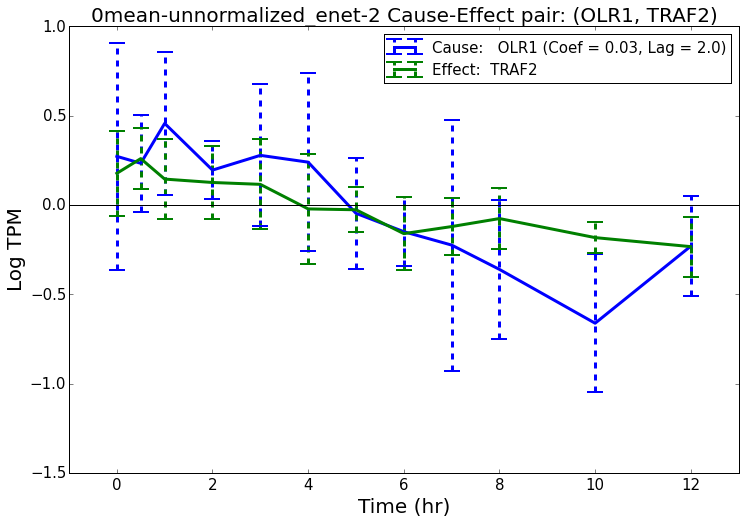

Filename:  analysis/plots/common/imm-metab/OLR1-TRAF2/0mean-unnormalized_enet-2_no-bar-OLR1-TRAF2-lag-2-coef-3E-02.pdf
Plot saved to  analysis/plots/common/imm-metab/OLR1-TRAF2/0mean-unnormalized_enet-2_no-bar-OLR1-TRAF2-lag-2-coef-3E-02.pdf


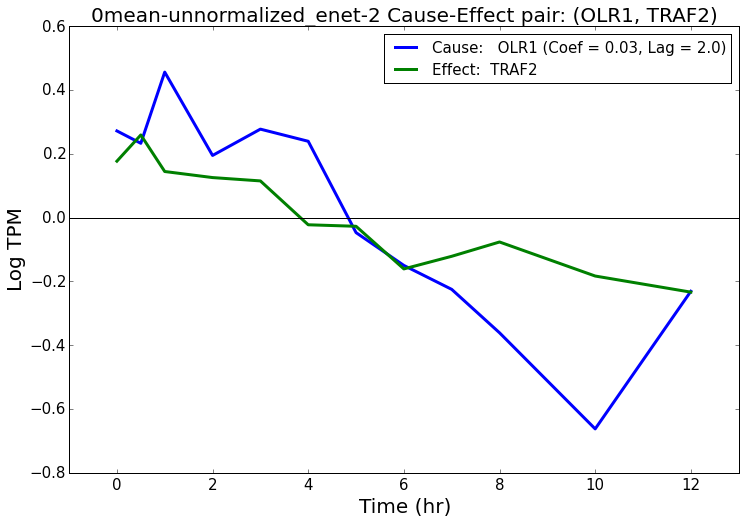

********************************
CCL26 TPP1
********************************
***********************************************
0mean-1var_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                        Summary: Cause Summary: Effect
5058              CCL26                TPP1 -0.082581     1  Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  Diabetes_GSEA,
Written to  analysis/plots/common/imm-metab/CCL26-TPP1/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-metab/CCL26-TPP1/0mean-1var_enet-1_CCL26-TPP1-lag-1-coef--8E-02.pdf
Plot saved to  analysis/plots/common/imm-metab/CCL26-TPP1/0mean-1var_enet-1_CCL26-TPP1-lag-1-coef--8E-02.pdf


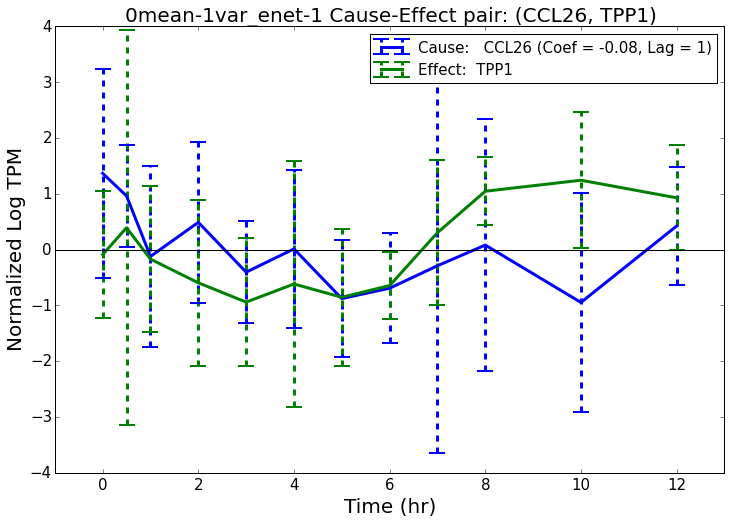

Filename:  analysis/plots/common/imm-metab/CCL26-TPP1/0mean-1var_enet-1_no-bar-CCL26-TPP1-lag-1-coef--8E-02.pdf
Plot saved to  analysis/plots/common/imm-metab/CCL26-TPP1/0mean-1var_enet-1_no-bar-CCL26-TPP1-lag-1-coef--8E-02.pdf


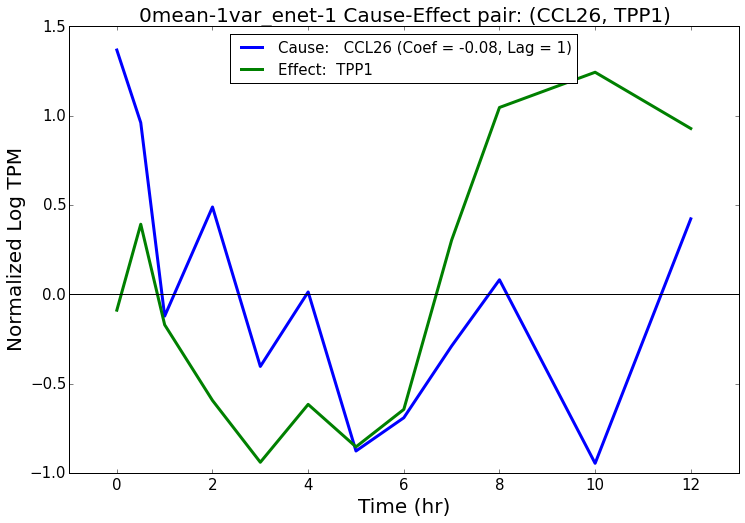

***********************************************
0mean-unnormalized_enet-1
***********************************************
      Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                        Summary: Cause Summary: Effect
14934              CCL26                TPP1 -0.057541     1  Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  Diabetes_GSEA,
Written to  analysis/plots/common/imm-metab/CCL26-TPP1/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-metab/CCL26-TPP1/0mean-unnormalized_enet-1_CCL26-TPP1-lag-1-coef--6E-02.pdf
Plot saved to  analysis/plots/common/imm-metab/CCL26-TPP1/0mean-unnormalized_enet-1_CCL26-TPP1-lag-1-coef--6E-02.pdf


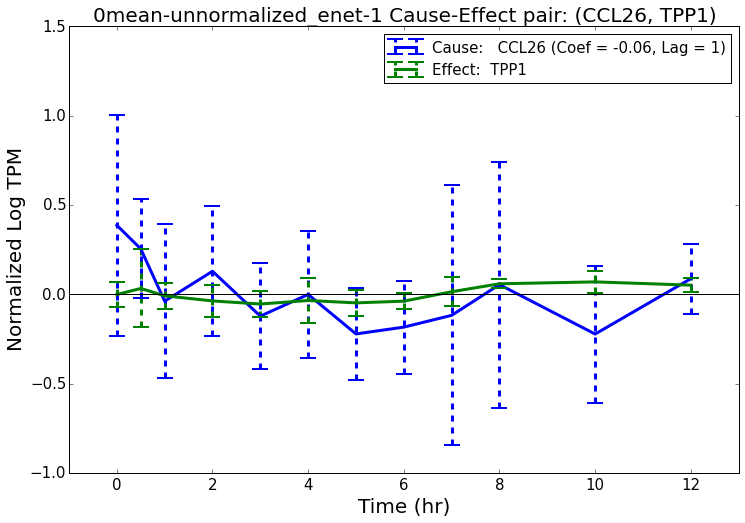

Filename:  analysis/plots/common/imm-metab/CCL26-TPP1/0mean-unnormalized_enet-1_no-bar-CCL26-TPP1-lag-1-coef--6E-02.pdf
Plot saved to  analysis/plots/common/imm-metab/CCL26-TPP1/0mean-unnormalized_enet-1_no-bar-CCL26-TPP1-lag-1-coef--6E-02.pdf


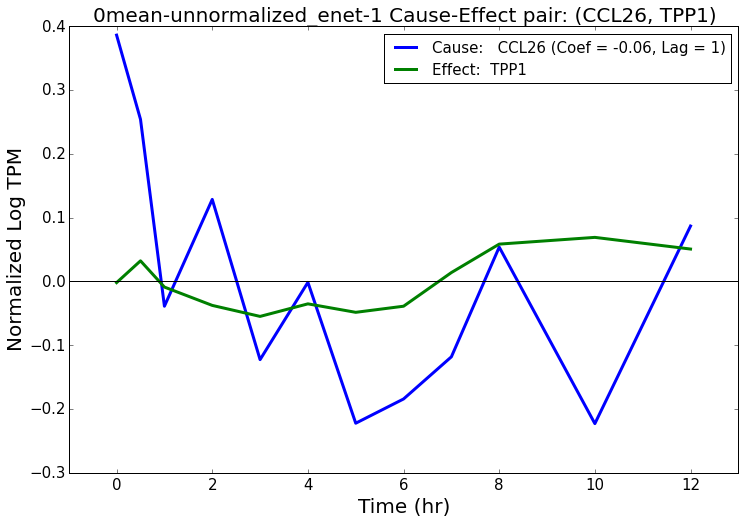

***********************************************
0mean-unnormalized_enet-2
***********************************************
      Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                        Summary: Cause Summary: Effect
25534              CCL26                TPP1 -0.027657   1.0  Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  Diabetes_GSEA,
Written to  analysis/plots/common/imm-metab/CCL26-TPP1/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-metab/CCL26-TPP1/0mean-unnormalized_enet-2_CCL26-TPP1-lag-2-coef--3E-02.pdf
Plot saved to  analysis/plots/common/imm-metab/CCL26-TPP1/0mean-unnormalized_enet-2_CCL26-TPP1-lag-2-coef--3E-02.pdf


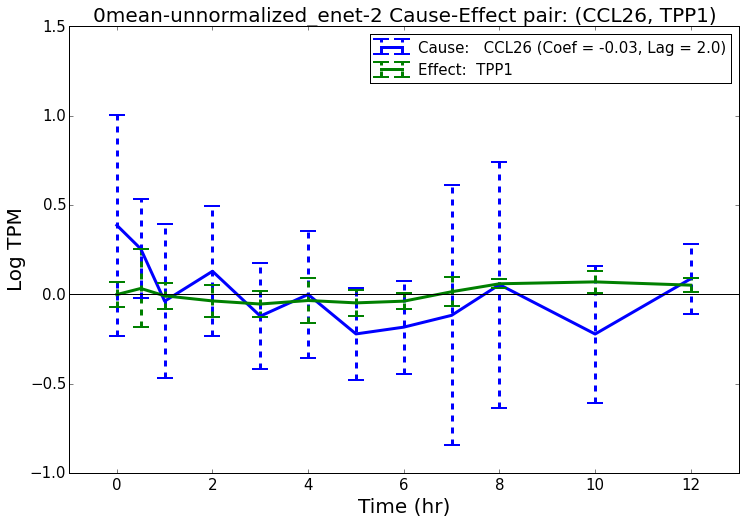

Filename:  analysis/plots/common/imm-metab/CCL26-TPP1/0mean-unnormalized_enet-2_no-bar-CCL26-TPP1-lag-2-coef--3E-02.pdf
Plot saved to  analysis/plots/common/imm-metab/CCL26-TPP1/0mean-unnormalized_enet-2_no-bar-CCL26-TPP1-lag-2-coef--3E-02.pdf


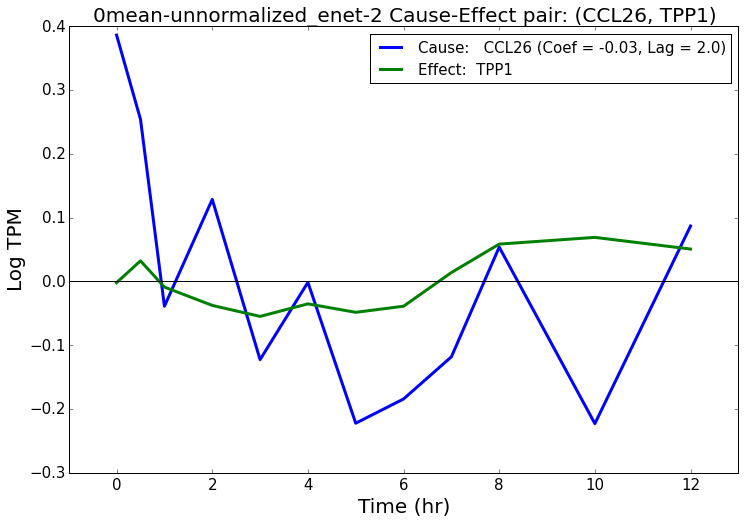

********************************
CFD HLA-C
********************************
***********************************************
0mean-1var_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                     Summary: Cause                                                                  Summary: Effect
5106                CFD               HLA-C  0.082424     1  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/imm-metab/CFD-HLA-C/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-metab/CFD-HLA-C/0mean-1var_enet-1_CFD-HLA-C-lag-1-coef-8E-02.pdf
Plot saved to  analysis/plots/common/

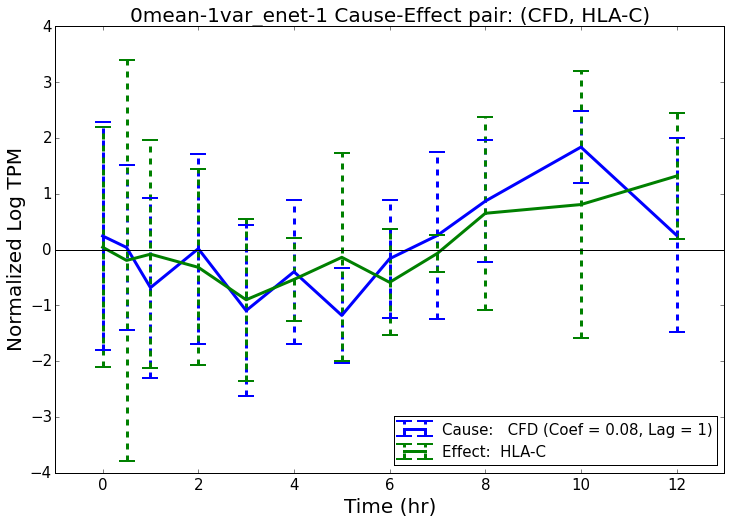

Filename:  analysis/plots/common/imm-metab/CFD-HLA-C/0mean-1var_enet-1_no-bar-CFD-HLA-C-lag-1-coef-8E-02.pdf
Plot saved to  analysis/plots/common/imm-metab/CFD-HLA-C/0mean-1var_enet-1_no-bar-CFD-HLA-C-lag-1-coef-8E-02.pdf


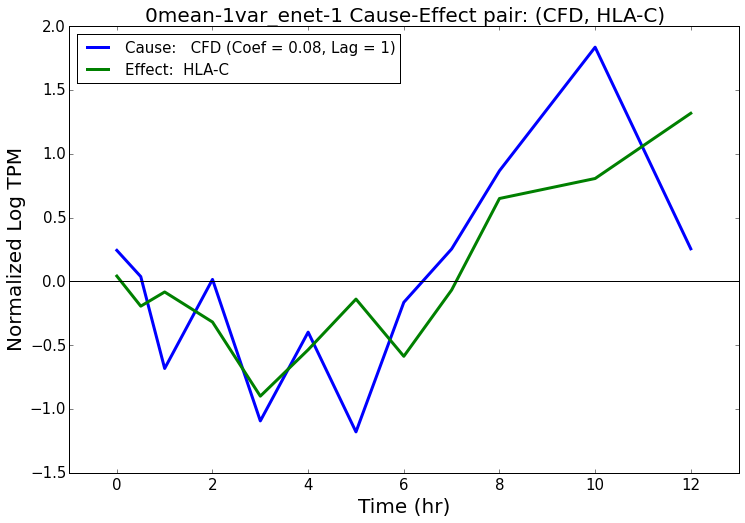

***********************************************
0mean-unnormalized_enet-1
***********************************************
      Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                     Summary: Cause                                                                  Summary: Effect
18860                CFD               HLA-C  0.046779     1  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/imm-metab/CFD-HLA-C/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-metab/CFD-HLA-C/0mean-unnormalized_enet-1_CFD-HLA-C-lag-1-coef-5E-02.pdf
Plot saved to  analysis/plots/common/imm-metab/CFD-HLA-C/0mean-unnormalized_enet-1_CFD-

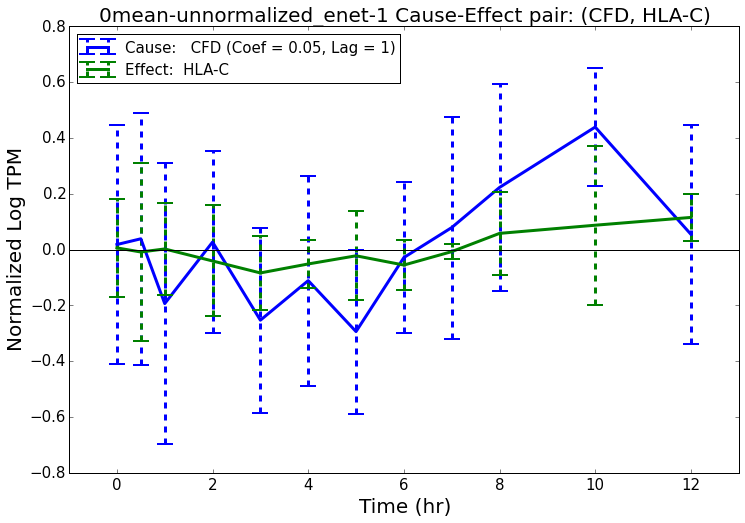

Filename:  analysis/plots/common/imm-metab/CFD-HLA-C/0mean-unnormalized_enet-1_no-bar-CFD-HLA-C-lag-1-coef-5E-02.pdf
Plot saved to  analysis/plots/common/imm-metab/CFD-HLA-C/0mean-unnormalized_enet-1_no-bar-CFD-HLA-C-lag-1-coef-5E-02.pdf


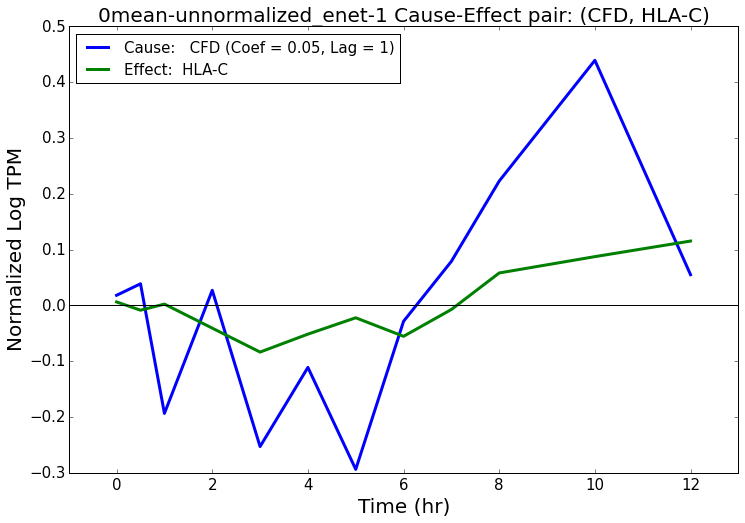

***********************************************
0mean-unnormalized_enet-2
***********************************************
      Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                     Summary: Cause                                                                  Summary: Effect
19978                CFD               HLA-C  0.038494   1.0  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  Diabetes_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/imm-metab/CFD-HLA-C/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/imm-metab/CFD-HLA-C/0mean-unnormalized_enet-2_CFD-HLA-C-lag-2-coef-4E-02.pdf
Plot saved to  analysis/plots/common/imm-metab/CFD-HLA-C/0mean-unnormalized_enet-2_CFD-

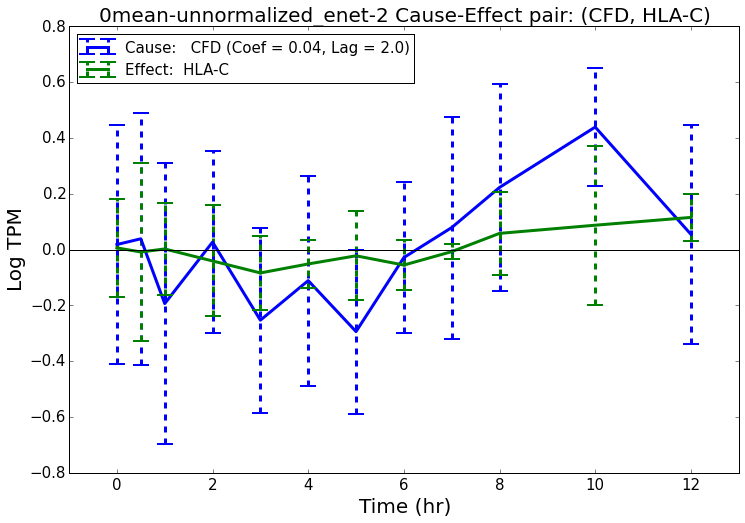

Filename:  analysis/plots/common/imm-metab/CFD-HLA-C/0mean-unnormalized_enet-2_no-bar-CFD-HLA-C-lag-2-coef-4E-02.pdf
Plot saved to  analysis/plots/common/imm-metab/CFD-HLA-C/0mean-unnormalized_enet-2_no-bar-CFD-HLA-C-lag-2-coef-4E-02.pdf


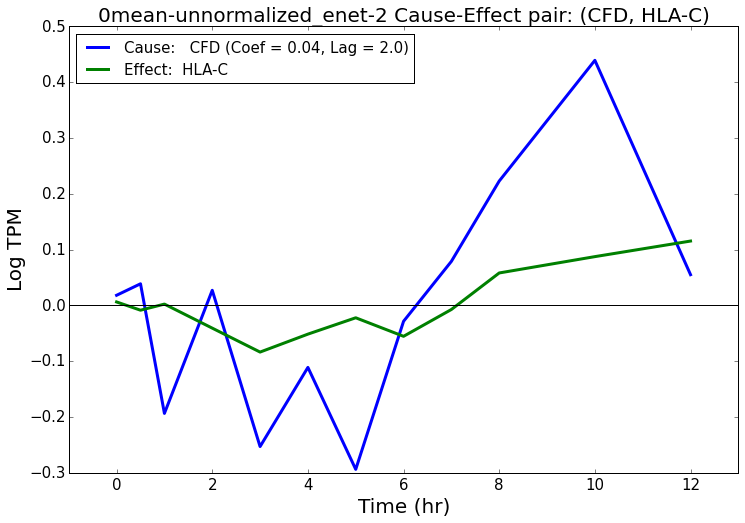

In [87]:
for i, r in plot_df.iterrows():
    print "********************************"
    print r["Gene Symbol: Cause"], r["Gene Symbol: Effect"]
    print "********************************"
    
    
    all_plot_folder = os.path.join(plot_subfolder, "-".join([r["Gene Symbol: Cause"], r["Gene Symbol: Effect"]]))
    
    indices = []
    for j in range(len(names)):
        if r[names[j]] == 1:
            # plot if contains
            indices.append(j)
    
    plot_nets = [nets[ind][nets[ind]["Cause-Effect"] == r["Cause-Effect"]] for ind in indices]
    for p in range(len(plot_nets)):
        plot_nets[p]["Gene Symbol: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_nets[p]["Cause"].values]
        plot_nets[p]["Gene Symbol: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_nets[p]["Effect"].values]
    
    plot_data_hg_df_list = [data_hg_df_list[ind] for ind in indices]
    plot_names = [names[ind] for ind in indices]
    plot_timekeys_list = [timekeys_list[ind] for ind in indices]
    plot_num_per_keys_list = [num_per_keys_list[ind] for ind in indices]
    plot_timepoints_list = [timepoints_list[ind] for ind in indices]
    
    
    do_plot_nets(plot_data_hg_df_list, plot_nets, plot_names, plot_timekeys_list, plot_num_per_keys_list, plot_timepoints_list,
                all_plot_folder=all_plot_folder, include_name_prefix=True, ylabels=ylabels)
    
#     for plot_net, plot_name in zip(plot_nets, plot_names):
#         print plot_name
#         display(plot_net)

# metab-any

In [88]:
plotfoldersuffix = "metab-any"
plot_df = edge_network_df[edge_network_df["Cause"].isin(metab_genes)].head(top_edge_num)

display(plot_df)

plot_subfolder = os.path.join(plot_common_folder, plotfoldersuffix)
if not os.path.exists(plot_subfolder):
    os.makedirs(plot_subfolder)
    
outfile = os.path.join(plot_subfolder, "top_interactions.csv")
plot_df.to_csv(outfile, index=0)

,Cause-Effect,Cause,Effect,Gene Symbol: Cause,Gene Symbol: Effect,Summary: Cause,Summary: Effect,Abs-Avg-Weight,Total,Networks,0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,Weight: 0mean-1var_enet-1,Weight: 0mean-1var_enet-2,Weight: 0mean-unnormalized_enet-1,Weight: 0mean-unnormalized_enet-2
17158,ENSG00000131480.7-ENSG00000089505.16,ENSG00000131480.7,ENSG00000089505.16,AOC2,CMTM1,"Metabolism-gluc_GSEA,","Immune_GOC-5,Immune_GOC-4,",0.131,4.0,"0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",1,1,1,1,-0.099721,-0.104615,-0.174557,-0.144458
39079,ENSG00000173391.7-ENSG00000121851.11,ENSG00000173391.7,ENSG00000121851.11,OLR1,POLR3GL,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,",NaN,0.111,4.0,"0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",1,1,1,1,-0.087715,-0.077868,-0.153147,-0.127145
39190,ENSG00000173391.7-ENSG00000145476.14,ENSG00000173391.7,ENSG00000145476.14,OLR1,CYP4V2,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,",NaN,0.104,4.0,"0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",1,1,1,1,-0.098690,-0.095418,-0.126986,-0.094779


********************************
AOC2 CMTM1
********************************


/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


***********************************************
0mean-1var_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef         Summary: Cause             Summary: Effect
1999               AOC2               CMTM1 -0.099721     1  Metabolism-gluc_GSEA,  Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/metab-any/AOC2-CMTM1/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-any/AOC2-CMTM1/0mean-1var_enet-1_AOC2-CMTM1-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/metab-any/AOC2-CMTM1/0mean-1var_enet-1_AOC2-CMTM1-lag-1-coef--1E-01.pdf


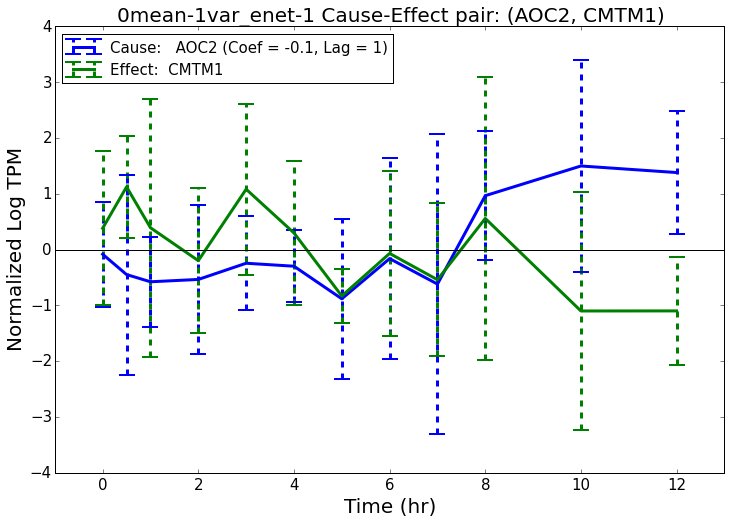

Filename:  analysis/plots/common/metab-any/AOC2-CMTM1/0mean-1var_enet-1_no-bar-AOC2-CMTM1-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/metab-any/AOC2-CMTM1/0mean-1var_enet-1_no-bar-AOC2-CMTM1-lag-1-coef--1E-01.pdf


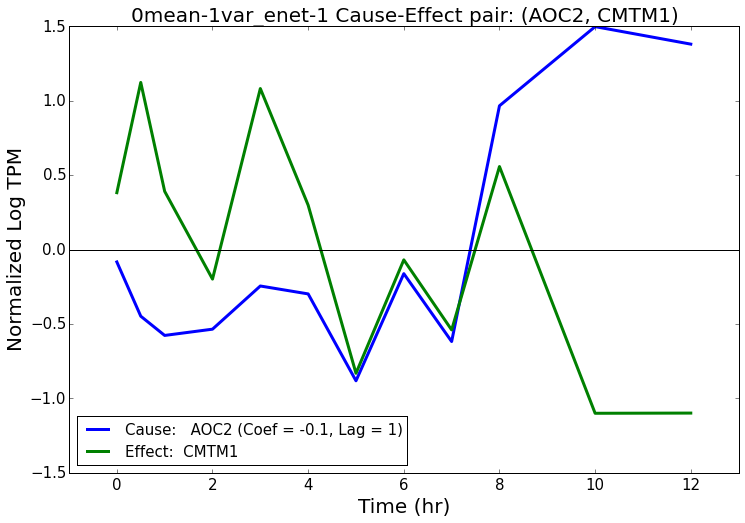

***********************************************
0mean-1var_enet-2
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef         Summary: Cause             Summary: Effect
219               AOC2               CMTM1 -0.104615   1.0  Metabolism-gluc_GSEA,  Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/metab-any/AOC2-CMTM1/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-any/AOC2-CMTM1/0mean-1var_enet-2_AOC2-CMTM1-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/common/metab-any/AOC2-CMTM1/0mean-1var_enet-2_AOC2-CMTM1-lag-2-coef--1E-01.pdf


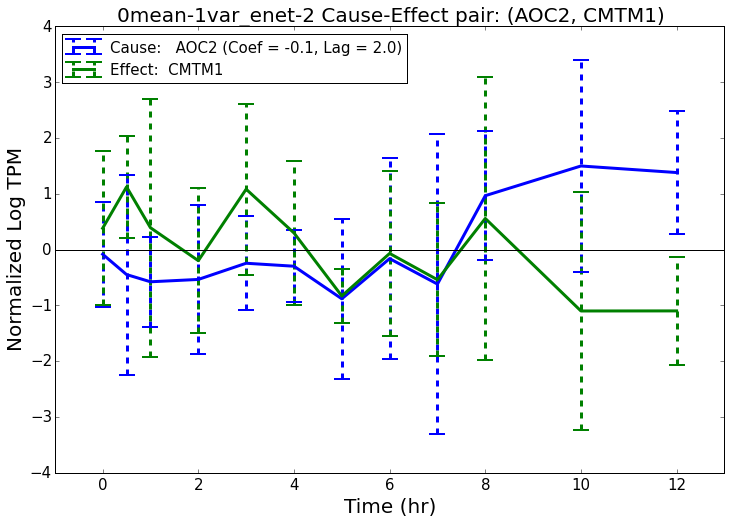

Filename:  analysis/plots/common/metab-any/AOC2-CMTM1/0mean-1var_enet-2_no-bar-AOC2-CMTM1-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/common/metab-any/AOC2-CMTM1/0mean-1var_enet-2_no-bar-AOC2-CMTM1-lag-2-coef--1E-01.pdf


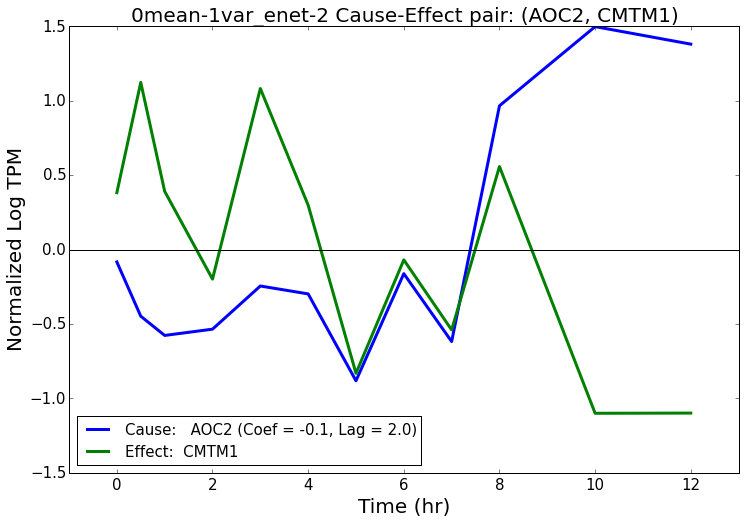

***********************************************
0mean-unnormalized_enet-1
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef         Summary: Cause             Summary: Effect
306               AOC2               CMTM1 -0.174557     1  Metabolism-gluc_GSEA,  Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/metab-any/AOC2-CMTM1/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-any/AOC2-CMTM1/0mean-unnormalized_enet-1_AOC2-CMTM1-lag-1-coef--2E-01.pdf
Plot saved to  analysis/plots/common/metab-any/AOC2-CMTM1/0mean-unnormalized_enet-1_AOC2-CMTM1-lag-1-coef--2E-01.pdf


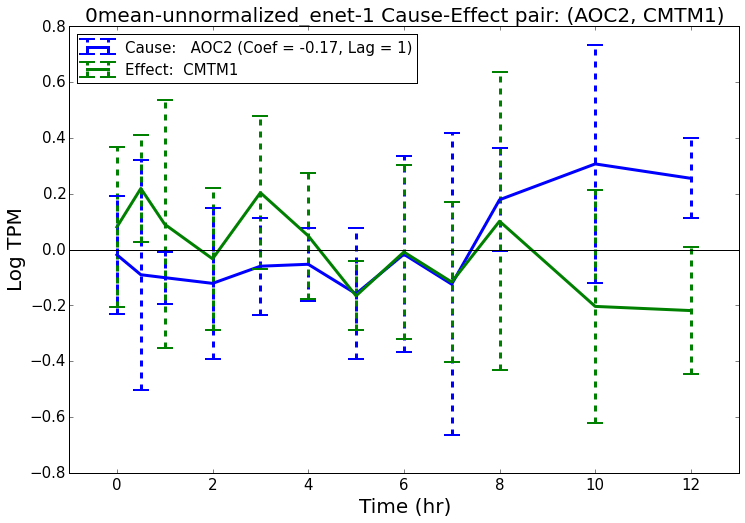

Filename:  analysis/plots/common/metab-any/AOC2-CMTM1/0mean-unnormalized_enet-1_no-bar-AOC2-CMTM1-lag-1-coef--2E-01.pdf
Plot saved to  analysis/plots/common/metab-any/AOC2-CMTM1/0mean-unnormalized_enet-1_no-bar-AOC2-CMTM1-lag-1-coef--2E-01.pdf


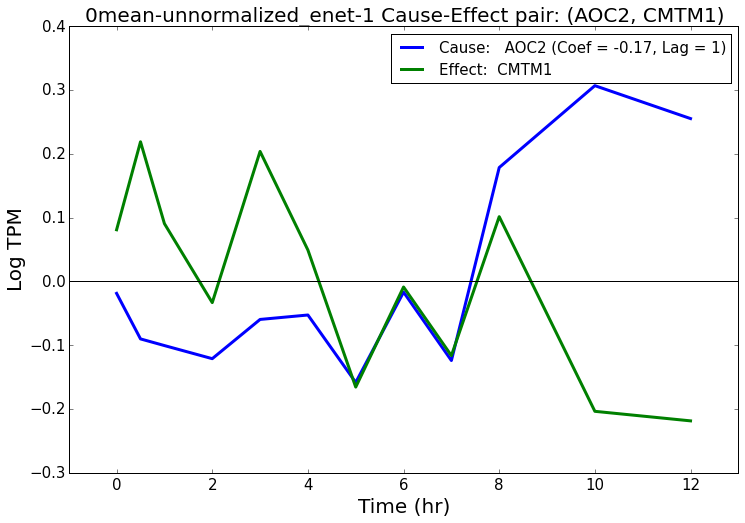

***********************************************
0mean-unnormalized_enet-2
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef         Summary: Cause             Summary: Effect
171               AOC2               CMTM1 -0.144458   1.0  Metabolism-gluc_GSEA,  Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/metab-any/AOC2-CMTM1/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-any/AOC2-CMTM1/0mean-unnormalized_enet-2_AOC2-CMTM1-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/common/metab-any/AOC2-CMTM1/0mean-unnormalized_enet-2_AOC2-CMTM1-lag-2-coef--1E-01.pdf


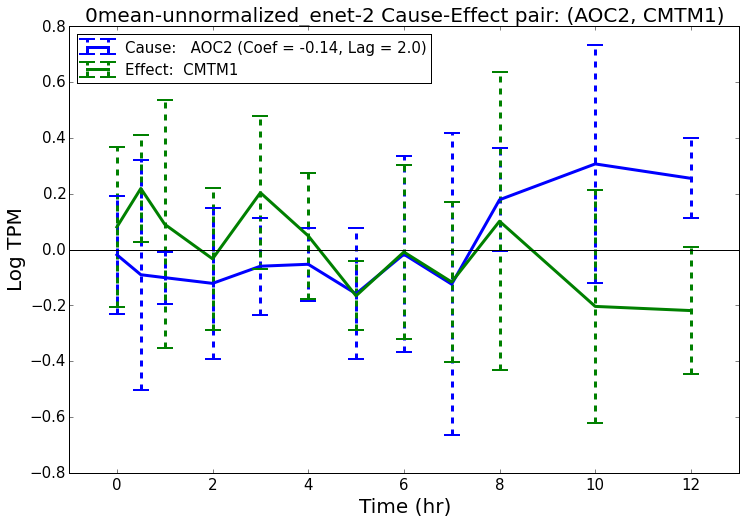

Filename:  analysis/plots/common/metab-any/AOC2-CMTM1/0mean-unnormalized_enet-2_no-bar-AOC2-CMTM1-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/common/metab-any/AOC2-CMTM1/0mean-unnormalized_enet-2_no-bar-AOC2-CMTM1-lag-2-coef--1E-01.pdf


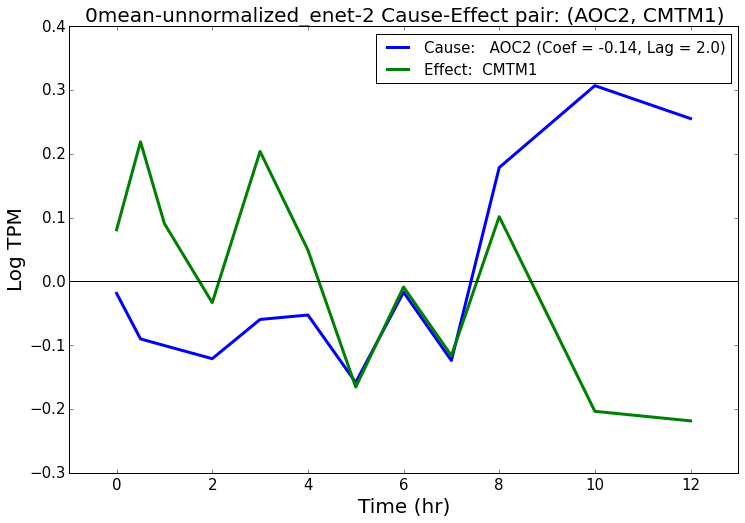

********************************
OLR1 POLR3GL
********************************
***********************************************
0mean-1var_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                                                   Summary: Cause Summary: Effect
3945               OLR1             POLR3GL -0.087715     1  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,             NaN
Written to  analysis/plots/common/metab-any/OLR1-POLR3GL/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-any/OLR1-POLR3GL/0mean-1var_enet-1_OLR1-POLR3GL-lag-1-coef--9E-02.pdf
Plot saved to  analysis/plots/common/metab-any/OLR1-POLR3GL/0mean-1var_enet-1_OLR1-POLR3GL-lag

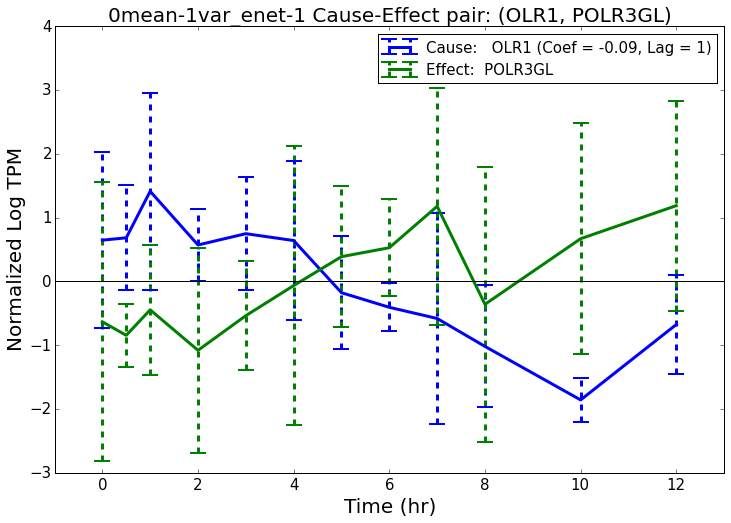

Filename:  analysis/plots/common/metab-any/OLR1-POLR3GL/0mean-1var_enet-1_no-bar-OLR1-POLR3GL-lag-1-coef--9E-02.pdf
Plot saved to  analysis/plots/common/metab-any/OLR1-POLR3GL/0mean-1var_enet-1_no-bar-OLR1-POLR3GL-lag-1-coef--9E-02.pdf


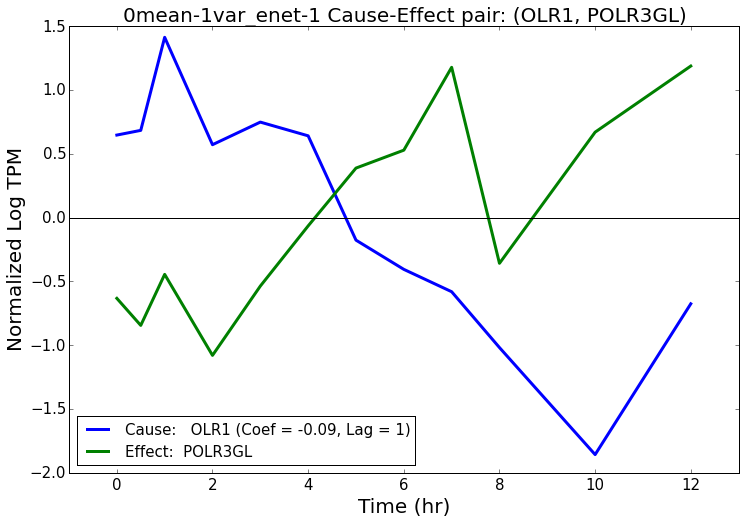

***********************************************
0mean-1var_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                                                   Summary: Cause Summary: Effect
1764               OLR1             POLR3GL -0.077868   1.0  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,             NaN
Written to  analysis/plots/common/metab-any/OLR1-POLR3GL/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-any/OLR1-POLR3GL/0mean-1var_enet-2_OLR1-POLR3GL-lag-2-coef--8E-02.pdf
Plot saved to  analysis/plots/common/metab-any/OLR1-POLR3GL/0mean-1var_enet-2_OLR1-POLR3GL-lag-2-coef--8E-02.pdf


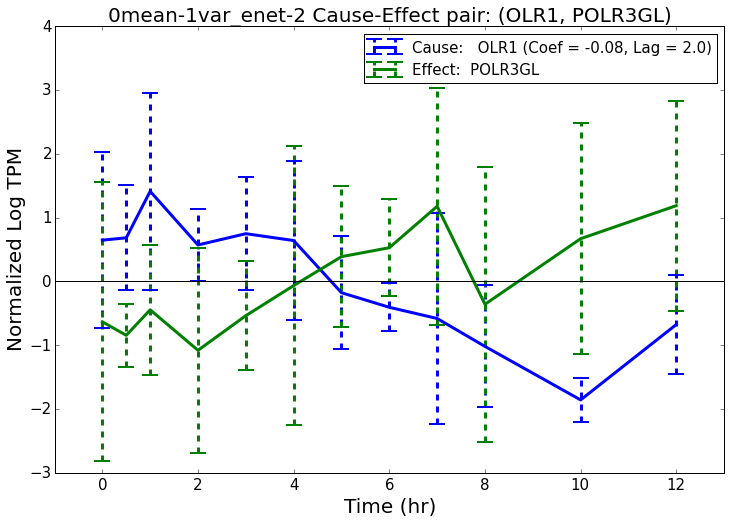

Filename:  analysis/plots/common/metab-any/OLR1-POLR3GL/0mean-1var_enet-2_no-bar-OLR1-POLR3GL-lag-2-coef--8E-02.pdf
Plot saved to  analysis/plots/common/metab-any/OLR1-POLR3GL/0mean-1var_enet-2_no-bar-OLR1-POLR3GL-lag-2-coef--8E-02.pdf


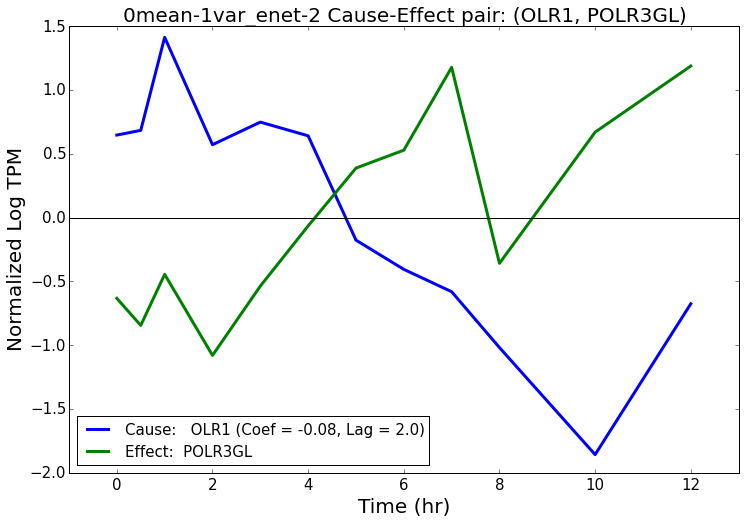

***********************************************
0mean-unnormalized_enet-1
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                                                   Summary: Cause Summary: Effect
634               OLR1             POLR3GL -0.153147     1  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,             NaN
Written to  analysis/plots/common/metab-any/OLR1-POLR3GL/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-any/OLR1-POLR3GL/0mean-unnormalized_enet-1_OLR1-POLR3GL-lag-1-coef--2E-01.pdf
Plot saved to  analysis/plots/common/metab-any/OLR1-POLR3GL/0mean-unnormalized_enet-1_OLR1-POLR3GL-lag-1-coef--2E-01.pdf


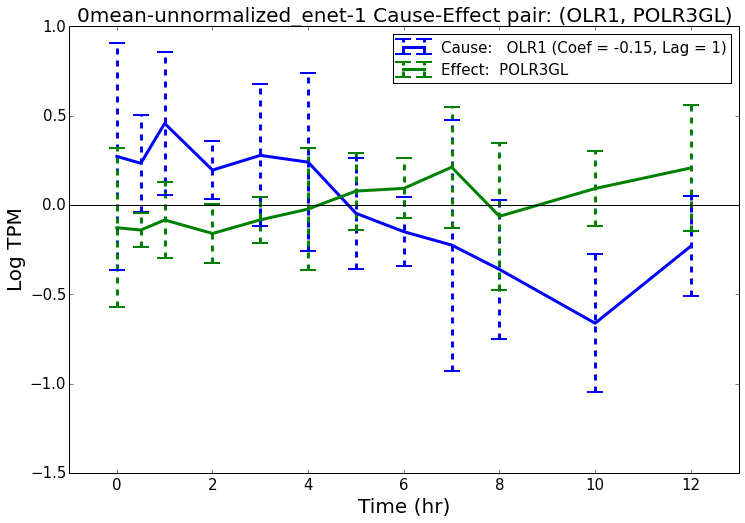

Filename:  analysis/plots/common/metab-any/OLR1-POLR3GL/0mean-unnormalized_enet-1_no-bar-OLR1-POLR3GL-lag-1-coef--2E-01.pdf
Plot saved to  analysis/plots/common/metab-any/OLR1-POLR3GL/0mean-unnormalized_enet-1_no-bar-OLR1-POLR3GL-lag-1-coef--2E-01.pdf


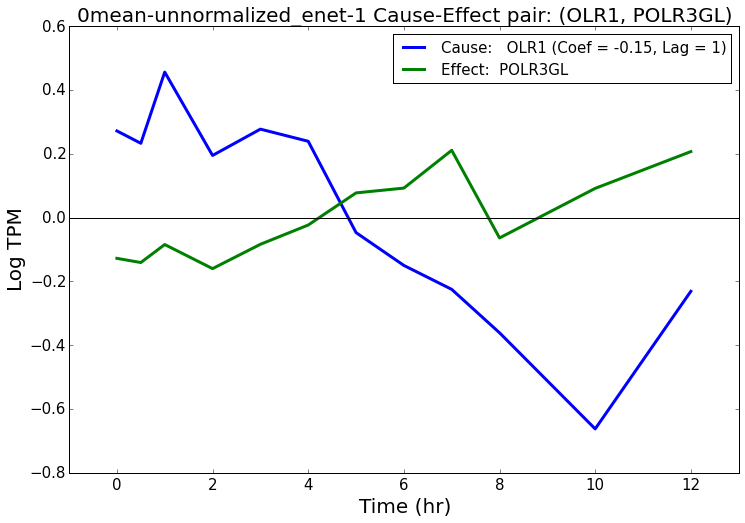

***********************************************
0mean-unnormalized_enet-2
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                                                   Summary: Cause Summary: Effect
370               OLR1             POLR3GL -0.127145   1.0  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,             NaN
Written to  analysis/plots/common/metab-any/OLR1-POLR3GL/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-any/OLR1-POLR3GL/0mean-unnormalized_enet-2_OLR1-POLR3GL-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/common/metab-any/OLR1-POLR3GL/0mean-unnormalized_enet-2_OLR1-POLR3GL-lag-2-coef--1E-01.pdf


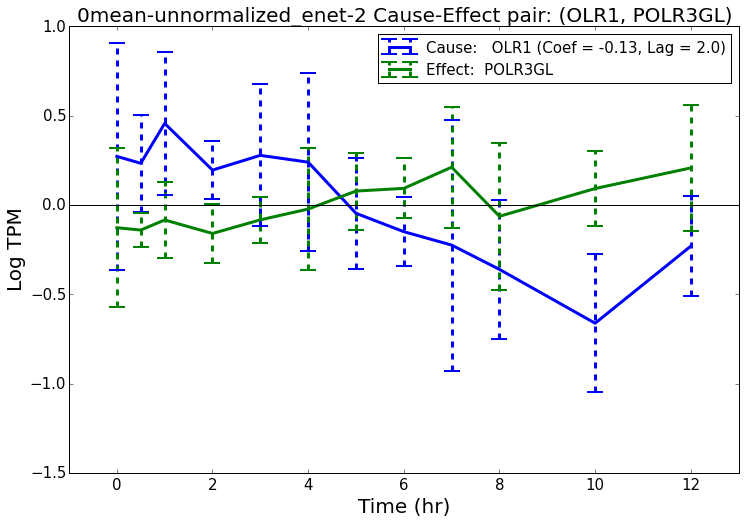

Filename:  analysis/plots/common/metab-any/OLR1-POLR3GL/0mean-unnormalized_enet-2_no-bar-OLR1-POLR3GL-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/common/metab-any/OLR1-POLR3GL/0mean-unnormalized_enet-2_no-bar-OLR1-POLR3GL-lag-2-coef--1E-01.pdf


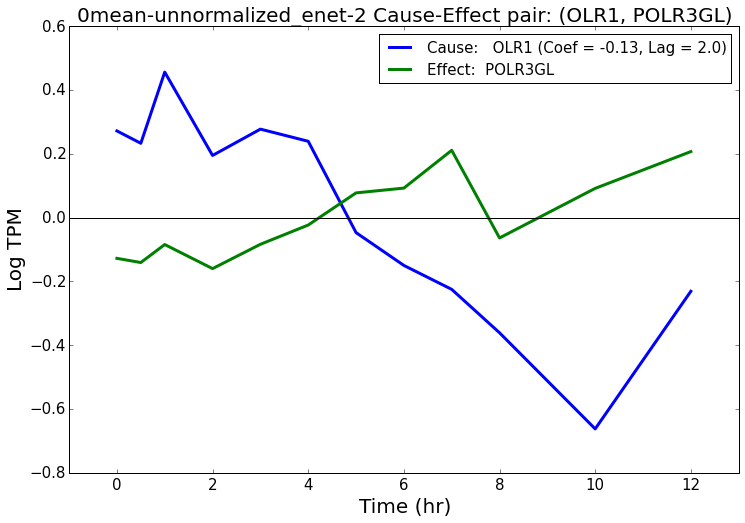

********************************
OLR1 CYP4V2
********************************
***********************************************
0mean-1var_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect   Weight  Coef                                                                                   Summary: Cause Summary: Effect
2139               OLR1              CYP4V2 -0.09869     1  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,             NaN
Written to  analysis/plots/common/metab-any/OLR1-CYP4V2/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-any/OLR1-CYP4V2/0mean-1var_enet-1_OLR1-CYP4V2-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/metab-any/OLR1-CYP4V2/0mean-1var_enet-1_OLR1-CYP4V2-lag-1-coef-

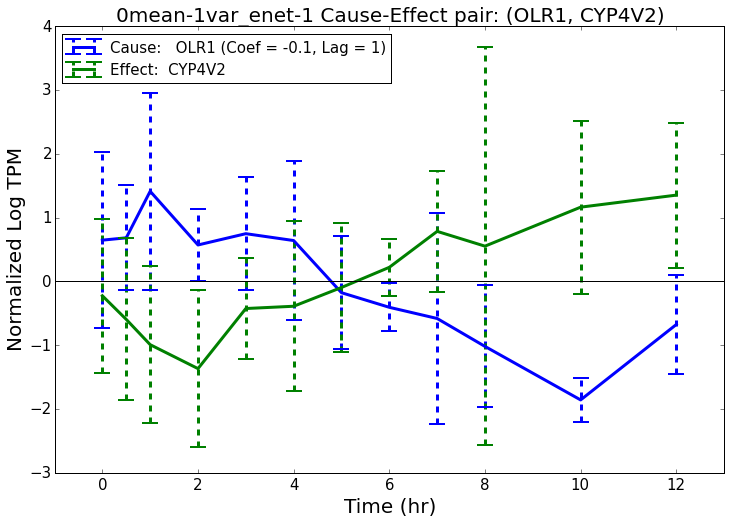

Filename:  analysis/plots/common/metab-any/OLR1-CYP4V2/0mean-1var_enet-1_no-bar-OLR1-CYP4V2-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/metab-any/OLR1-CYP4V2/0mean-1var_enet-1_no-bar-OLR1-CYP4V2-lag-1-coef--1E-01.pdf


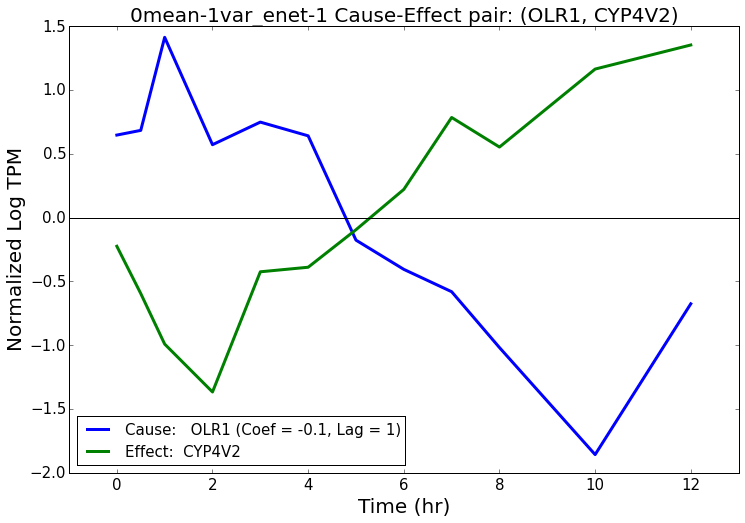

***********************************************
0mean-1var_enet-2
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                                                   Summary: Cause Summary: Effect
442               OLR1              CYP4V2 -0.095418   1.0  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,             NaN
Written to  analysis/plots/common/metab-any/OLR1-CYP4V2/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-any/OLR1-CYP4V2/0mean-1var_enet-2_OLR1-CYP4V2-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/common/metab-any/OLR1-CYP4V2/0mean-1var_enet-2_OLR1-CYP4V2-lag-2-coef--1E-01.pdf


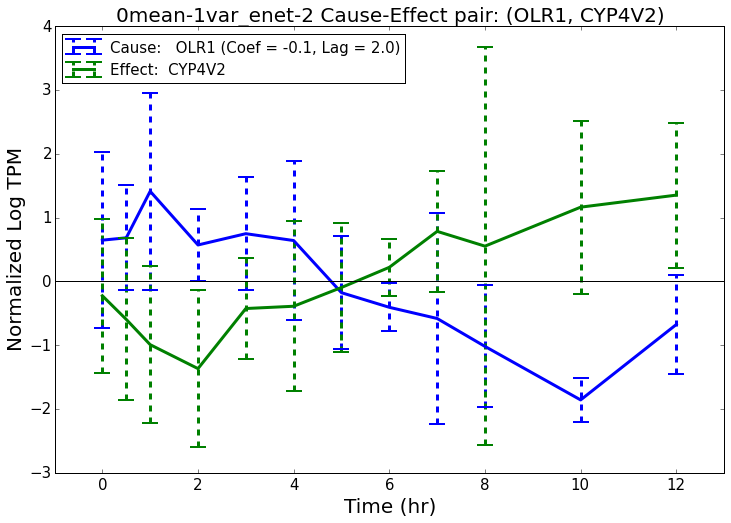

Filename:  analysis/plots/common/metab-any/OLR1-CYP4V2/0mean-1var_enet-2_no-bar-OLR1-CYP4V2-lag-2-coef--1E-01.pdf
Plot saved to  analysis/plots/common/metab-any/OLR1-CYP4V2/0mean-1var_enet-2_no-bar-OLR1-CYP4V2-lag-2-coef--1E-01.pdf


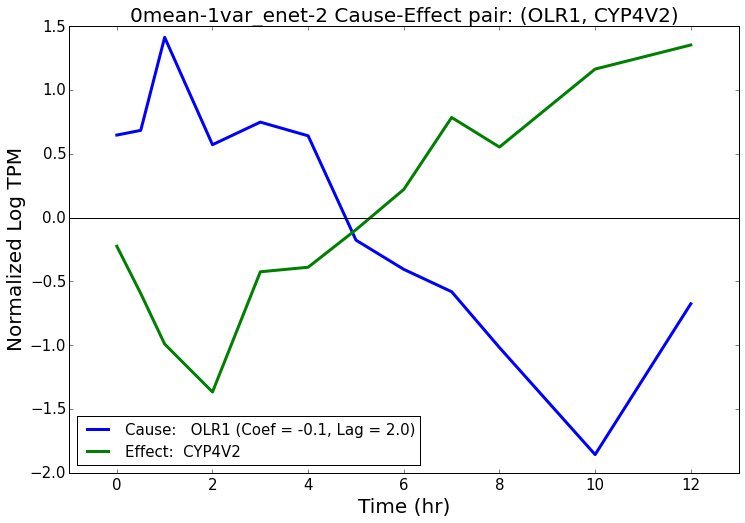

***********************************************
0mean-unnormalized_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                                                   Summary: Cause Summary: Effect
1596               OLR1              CYP4V2 -0.126986     1  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,             NaN
Written to  analysis/plots/common/metab-any/OLR1-CYP4V2/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-any/OLR1-CYP4V2/0mean-unnormalized_enet-1_OLR1-CYP4V2-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/metab-any/OLR1-CYP4V2/0mean-unnormalized_enet-1_OLR1-CYP4V2-lag-1-coef--1E-01.pdf


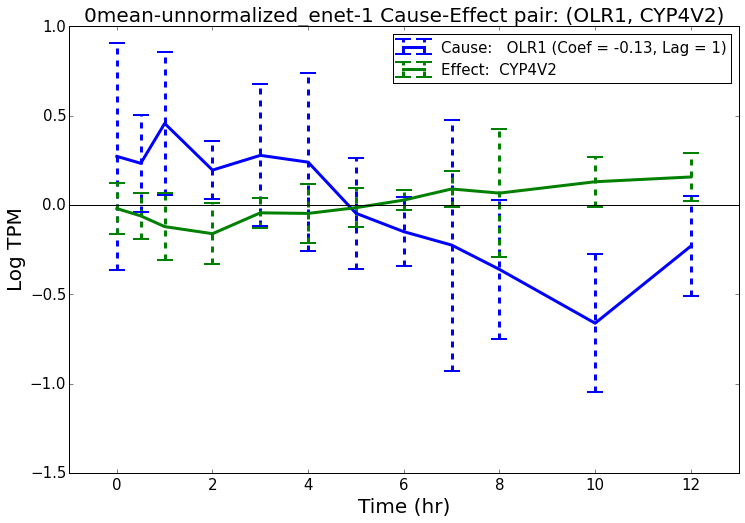

Filename:  analysis/plots/common/metab-any/OLR1-CYP4V2/0mean-unnormalized_enet-1_no-bar-OLR1-CYP4V2-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/metab-any/OLR1-CYP4V2/0mean-unnormalized_enet-1_no-bar-OLR1-CYP4V2-lag-1-coef--1E-01.pdf


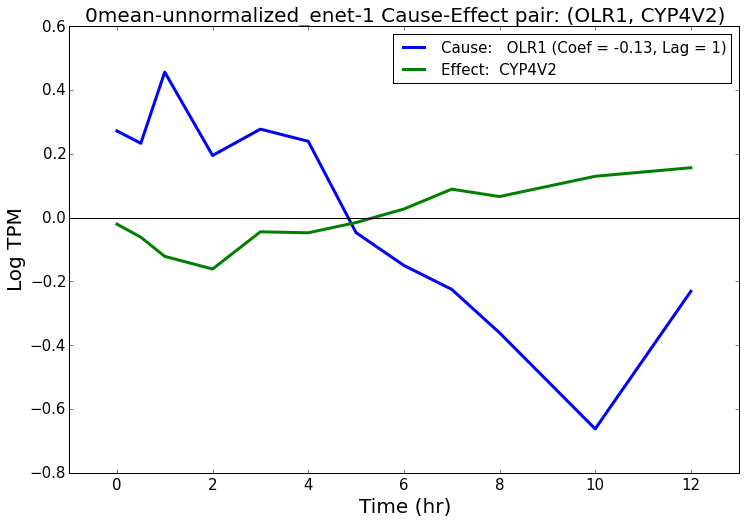

***********************************************
0mean-unnormalized_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                                                   Summary: Cause Summary: Effect
1729               OLR1              CYP4V2 -0.094779   1.0  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,             NaN
Written to  analysis/plots/common/metab-any/OLR1-CYP4V2/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-any/OLR1-CYP4V2/0mean-unnormalized_enet-2_OLR1-CYP4V2-lag-2-coef--9E-02.pdf
Plot saved to  analysis/plots/common/metab-any/OLR1-CYP4V2/0mean-unnormalized_enet-2_OLR1-CYP4V2-lag-2-coef--9E-02.pdf


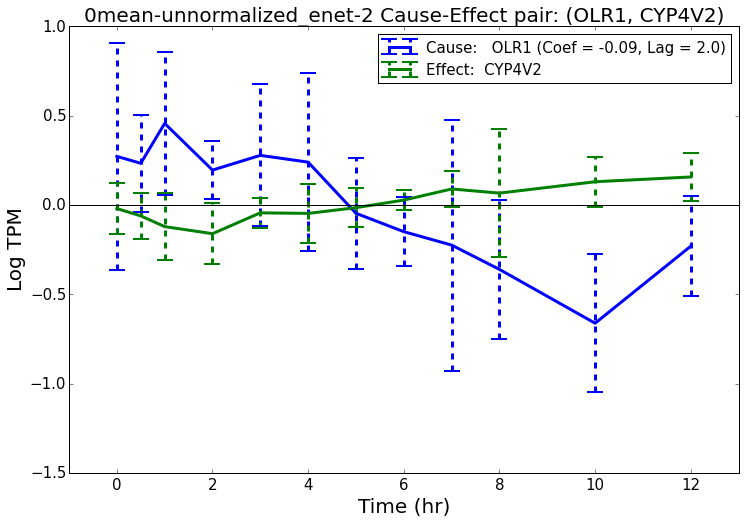

Filename:  analysis/plots/common/metab-any/OLR1-CYP4V2/0mean-unnormalized_enet-2_no-bar-OLR1-CYP4V2-lag-2-coef--9E-02.pdf
Plot saved to  analysis/plots/common/metab-any/OLR1-CYP4V2/0mean-unnormalized_enet-2_no-bar-OLR1-CYP4V2-lag-2-coef--9E-02.pdf


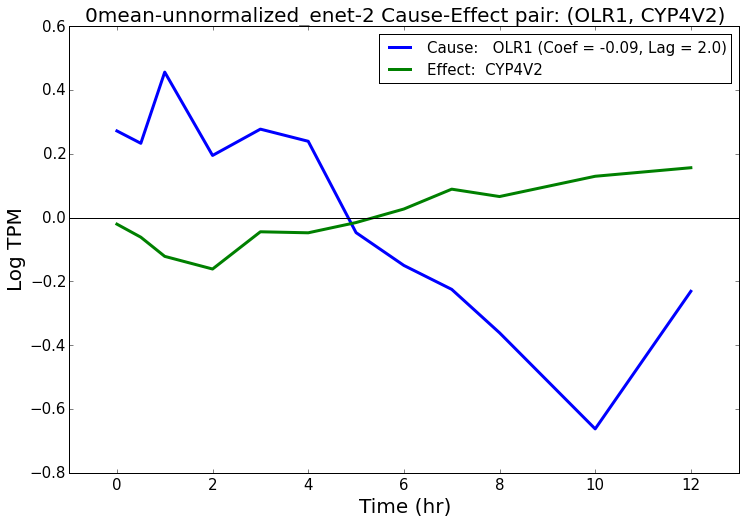

In [89]:
for i, r in plot_df.iterrows():
    print "********************************"
    print r["Gene Symbol: Cause"], r["Gene Symbol: Effect"]
    print "********************************"
    
    
    all_plot_folder = os.path.join(plot_subfolder, "-".join([r["Gene Symbol: Cause"], r["Gene Symbol: Effect"]]))
    
    indices = []
    for j in range(len(names)):
        if r[names[j]] == 1:
            # plot if contains
            indices.append(j)
    
    plot_nets = [nets[ind][nets[ind]["Cause-Effect"] == r["Cause-Effect"]] for ind in indices]
    for p in range(len(plot_nets)):
        plot_nets[p]["Gene Symbol: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_nets[p]["Cause"].values]
        plot_nets[p]["Gene Symbol: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_nets[p]["Effect"].values]
    
    plot_data_hg_df_list = [data_hg_df_list[ind] for ind in indices]
    plot_names = [names[ind] for ind in indices]
    plot_timekeys_list = [timekeys_list[ind] for ind in indices]
    plot_num_per_keys_list = [num_per_keys_list[ind] for ind in indices]
    plot_timepoints_list = [timepoints_list[ind] for ind in indices]
    
    
    do_plot_nets(plot_data_hg_df_list, plot_nets, plot_names, plot_timekeys_list, plot_num_per_keys_list, plot_timepoints_list,
                all_plot_folder=all_plot_folder, include_name_prefix=True, ylabels=ylabels)
    
#     for plot_net, plot_name in zip(plot_nets, plot_names):
#         print plot_name
#         display(plot_net)

# metab-tf

In [90]:
plotfoldersuffix = "metab-tf"
plot_df = edge_network_df[np.logical_and(edge_network_df["Cause"].isin(metab_genes), edge_network_df["Effect"].isin(tf_genes))].head(top_edge_num)

display(plot_df)

plot_subfolder = os.path.join(plot_common_folder, plotfoldersuffix)
if not os.path.exists(plot_subfolder):
    os.makedirs(plot_subfolder)
    
outfile = os.path.join(plot_subfolder, "top_interactions.csv")
plot_df.to_csv(outfile, index=0)

,Cause-Effect,Cause,Effect,Gene Symbol: Cause,Gene Symbol: Effect,Summary: Cause,Summary: Effect,Abs-Avg-Weight,Total,Networks,0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,Weight: 0mean-1var_enet-1,Weight: 0mean-1var_enet-2,Weight: 0mean-unnormalized_enet-1,Weight: 0mean-unnormalized_enet-2
38874,ENSG00000173391.7-ENSG00000032219.17,ENSG00000173391.7,ENSG00000032219.17,OLR1,ARID4A,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,","TF-Bioguo,DNA-binding_GO,",0.087,4.0,"0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",1,1,1,1,-0.107769,-0.077859,-0.093714,-0.069475
17203,ENSG00000131480.7-ENSG00000115415.17,ENSG00000131480.7,ENSG00000115415.17,AOC2,STAT1,"Metabolism-gluc_GSEA,","GR_GSEA,TF-Bioguo,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,",0.063,3.0,"0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",0,1,1,1,0.000000,0.069462,0.101293,0.082610
17146,ENSG00000131480.7-ENSG00000075426.10,ENSG00000131480.7,ENSG00000075426.10,AOC2,FOSL2,"Metabolism-gluc_GSEA,","GR_direct,TF-Bioguo,",0.042,3.0,"0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",0,1,1,1,0.000000,0.054830,0.065037,0.047709


********************************
OLR1 ARID4A
********************************


/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


***********************************************
0mean-1var_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                                                   Summary: Cause            Summary: Effect
1236               OLR1              ARID4A -0.107769     1  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  TF-Bioguo,DNA-binding_GO,
Written to  analysis/plots/common/metab-tf/OLR1-ARID4A/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-tf/OLR1-ARID4A/0mean-1var_enet-1_OLR1-ARID4A-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/metab-tf/OLR1-ARID4A/0mean-1var_enet-1_OLR1-ARID4A-lag-1-coef--1E-01.pdf


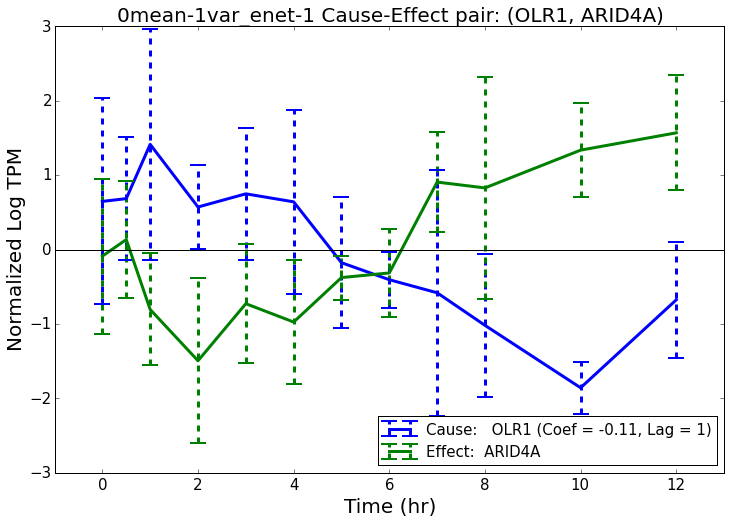

Filename:  analysis/plots/common/metab-tf/OLR1-ARID4A/0mean-1var_enet-1_no-bar-OLR1-ARID4A-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/metab-tf/OLR1-ARID4A/0mean-1var_enet-1_no-bar-OLR1-ARID4A-lag-1-coef--1E-01.pdf


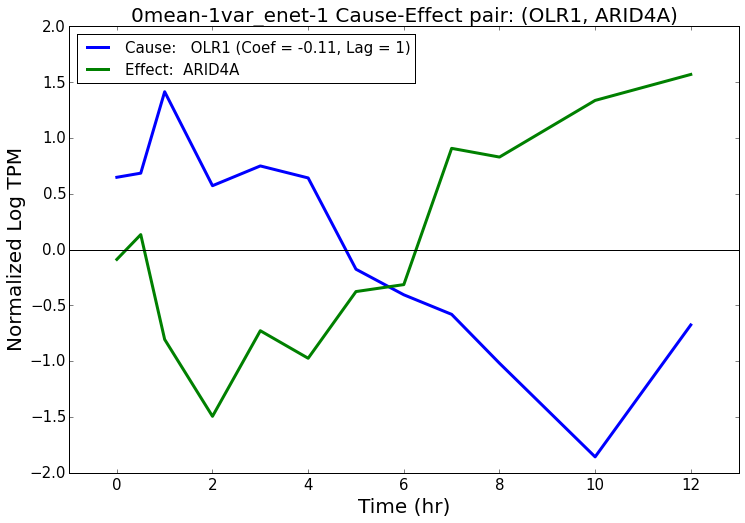

***********************************************
0mean-1var_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                                                   Summary: Cause            Summary: Effect
1766               OLR1              ARID4A -0.077859   1.0  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  TF-Bioguo,DNA-binding_GO,
Written to  analysis/plots/common/metab-tf/OLR1-ARID4A/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-tf/OLR1-ARID4A/0mean-1var_enet-2_OLR1-ARID4A-lag-2-coef--8E-02.pdf
Plot saved to  analysis/plots/common/metab-tf/OLR1-ARID4A/0mean-1var_enet-2_OLR1-ARID4A-lag-2-coef--8E-02.pdf


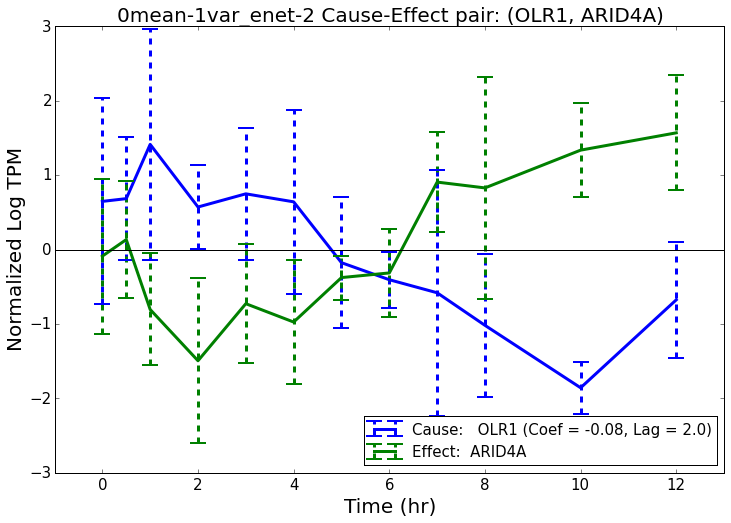

Filename:  analysis/plots/common/metab-tf/OLR1-ARID4A/0mean-1var_enet-2_no-bar-OLR1-ARID4A-lag-2-coef--8E-02.pdf
Plot saved to  analysis/plots/common/metab-tf/OLR1-ARID4A/0mean-1var_enet-2_no-bar-OLR1-ARID4A-lag-2-coef--8E-02.pdf


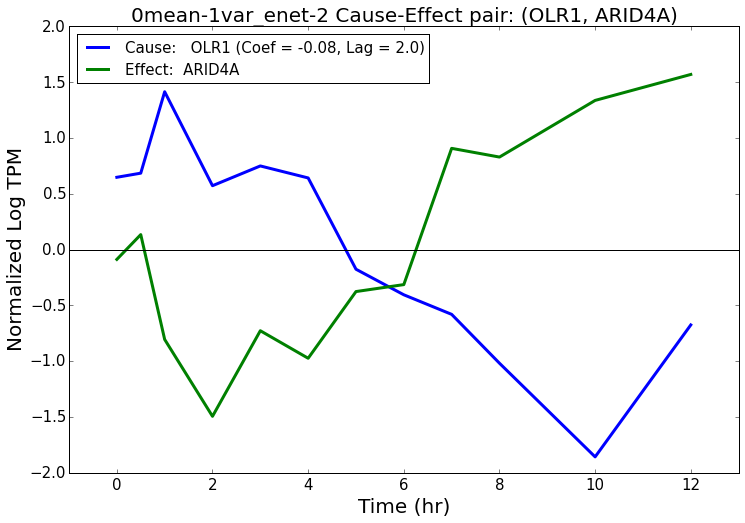

***********************************************
0mean-unnormalized_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                                                   Summary: Cause            Summary: Effect
4871               OLR1              ARID4A -0.093714     1  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  TF-Bioguo,DNA-binding_GO,
Written to  analysis/plots/common/metab-tf/OLR1-ARID4A/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-tf/OLR1-ARID4A/0mean-unnormalized_enet-1_OLR1-ARID4A-lag-1-coef--9E-02.pdf
Plot saved to  analysis/plots/common/metab-tf/OLR1-ARID4A/0mean-unnormalized_enet-1_OLR1-ARID4A-lag-1-coef--9E-02.pdf


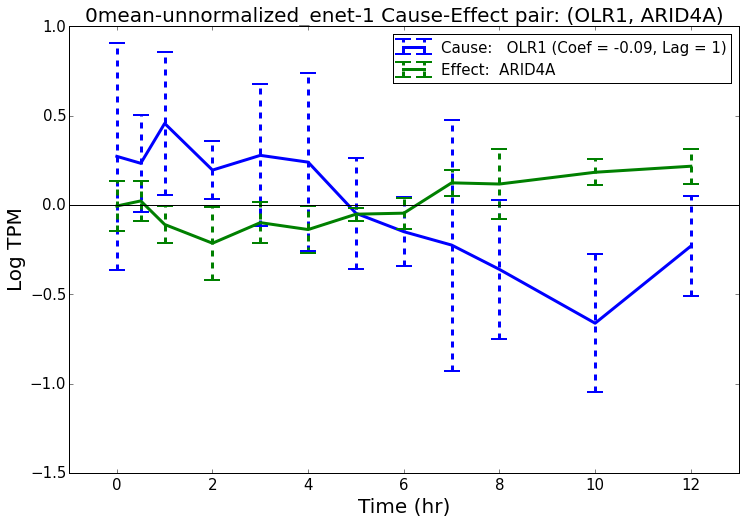

Filename:  analysis/plots/common/metab-tf/OLR1-ARID4A/0mean-unnormalized_enet-1_no-bar-OLR1-ARID4A-lag-1-coef--9E-02.pdf
Plot saved to  analysis/plots/common/metab-tf/OLR1-ARID4A/0mean-unnormalized_enet-1_no-bar-OLR1-ARID4A-lag-1-coef--9E-02.pdf


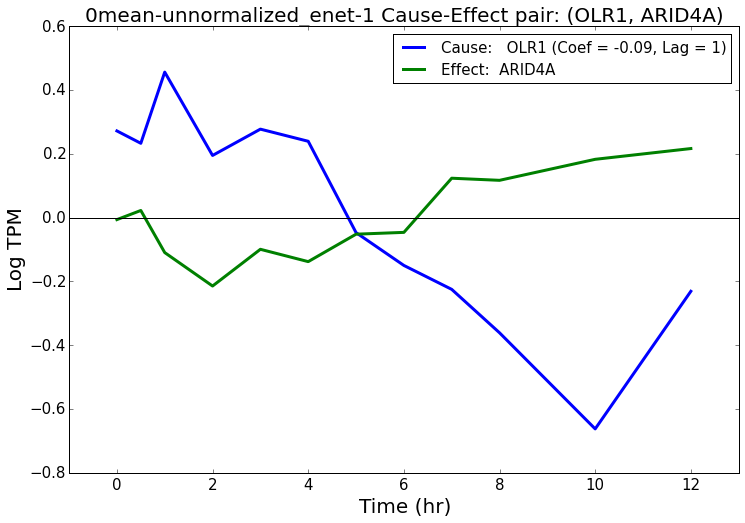

***********************************************
0mean-unnormalized_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                                                   Summary: Cause            Summary: Effect
5730               OLR1              ARID4A -0.069475   1.0  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  TF-Bioguo,DNA-binding_GO,
Written to  analysis/plots/common/metab-tf/OLR1-ARID4A/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-tf/OLR1-ARID4A/0mean-unnormalized_enet-2_OLR1-ARID4A-lag-2-coef--7E-02.pdf
Plot saved to  analysis/plots/common/metab-tf/OLR1-ARID4A/0mean-unnormalized_enet-2_OLR1-ARID4A-lag-2-coef--7E-02.pdf


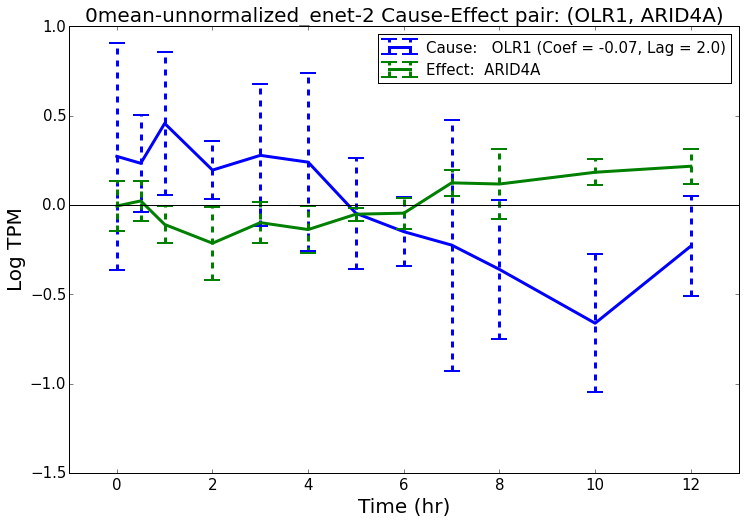

Filename:  analysis/plots/common/metab-tf/OLR1-ARID4A/0mean-unnormalized_enet-2_no-bar-OLR1-ARID4A-lag-2-coef--7E-02.pdf
Plot saved to  analysis/plots/common/metab-tf/OLR1-ARID4A/0mean-unnormalized_enet-2_no-bar-OLR1-ARID4A-lag-2-coef--7E-02.pdf


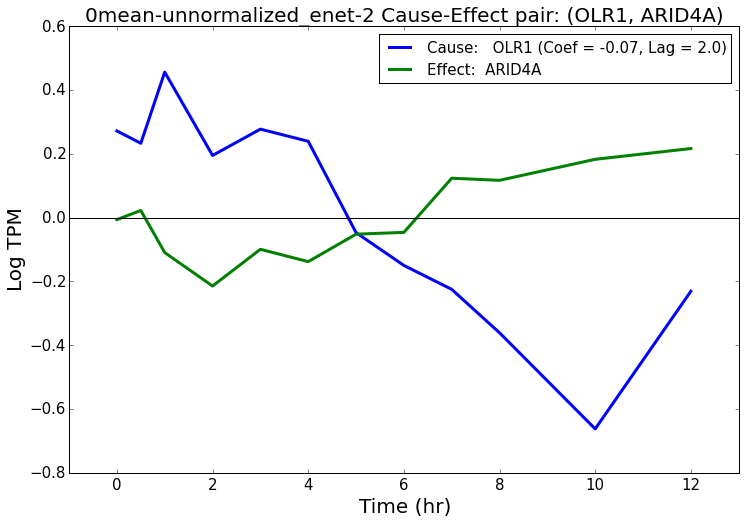

********************************
AOC2 STAT1
********************************
***********************************************
0mean-1var_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef         Summary: Cause                                                                      Summary: Effect
3295               AOC2               STAT1  0.069462   1.0  Metabolism-gluc_GSEA,  GR_GSEA,TF-Bioguo,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/metab-tf/AOC2-STAT1/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-tf/AOC2-STAT1/0mean-1var_enet-2_AOC2-STAT1-lag-2-coef-7E-02.pdf
Plot saved to  analysis/plots/common/metab-tf/AOC2-STAT1/0mean-1var_enet-2_AOC2-STAT1-lag-2-coef-7E-02.pdf


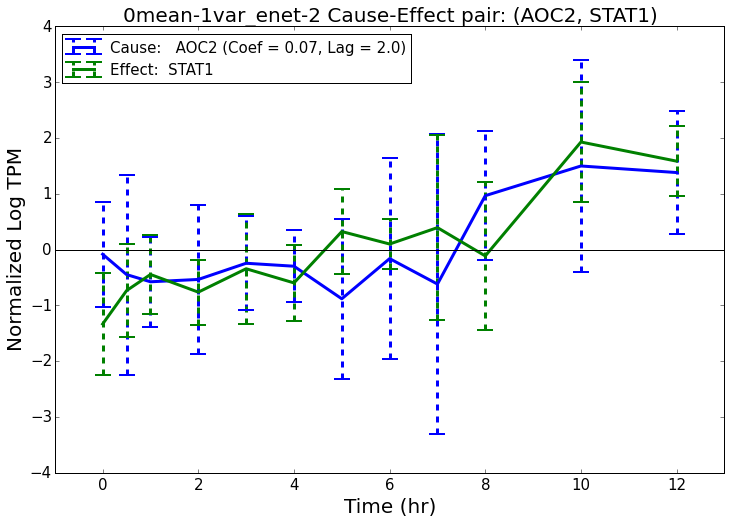

Filename:  analysis/plots/common/metab-tf/AOC2-STAT1/0mean-1var_enet-2_no-bar-AOC2-STAT1-lag-2-coef-7E-02.pdf
Plot saved to  analysis/plots/common/metab-tf/AOC2-STAT1/0mean-1var_enet-2_no-bar-AOC2-STAT1-lag-2-coef-7E-02.pdf


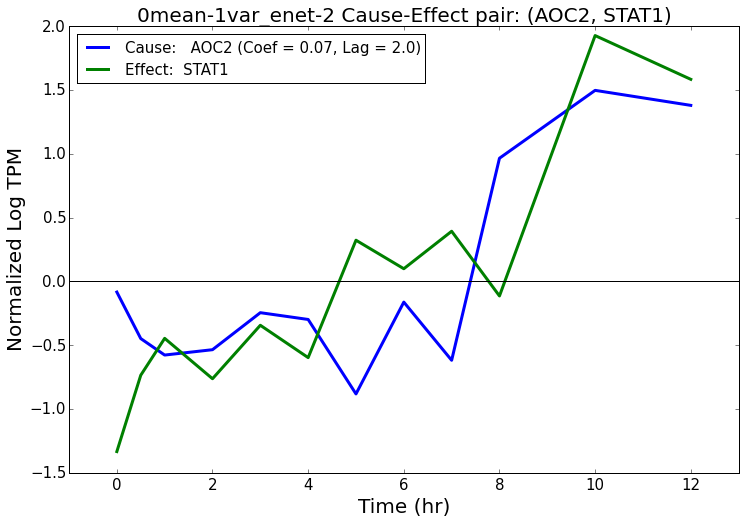

***********************************************
0mean-unnormalized_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef         Summary: Cause                                                                      Summary: Effect
3830               AOC2               STAT1  0.101293     1  Metabolism-gluc_GSEA,  GR_GSEA,TF-Bioguo,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/metab-tf/AOC2-STAT1/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-tf/AOC2-STAT1/0mean-unnormalized_enet-1_AOC2-STAT1-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/common/metab-tf/AOC2-STAT1/0mean-unnormalized_enet-1_AOC2-STAT1-lag-1-coef-1E-01.pdf


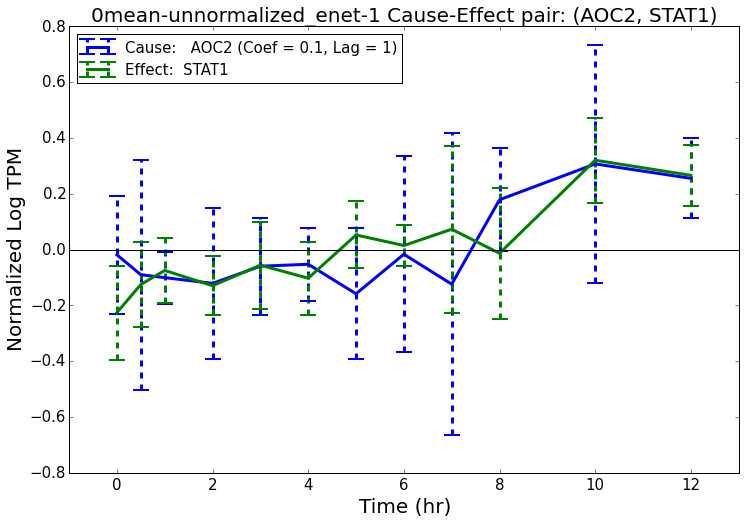

Filename:  analysis/plots/common/metab-tf/AOC2-STAT1/0mean-unnormalized_enet-1_no-bar-AOC2-STAT1-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/common/metab-tf/AOC2-STAT1/0mean-unnormalized_enet-1_no-bar-AOC2-STAT1-lag-1-coef-1E-01.pdf


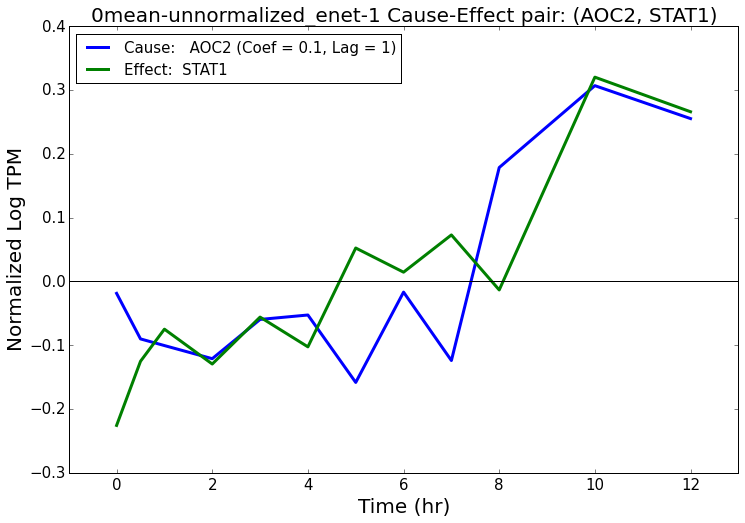

***********************************************
0mean-unnormalized_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect   Weight  Coef         Summary: Cause                                                                      Summary: Effect
3119               AOC2               STAT1  0.08261   1.0  Metabolism-gluc_GSEA,  GR_GSEA,TF-Bioguo,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/metab-tf/AOC2-STAT1/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-tf/AOC2-STAT1/0mean-unnormalized_enet-2_AOC2-STAT1-lag-2-coef-8E-02.pdf
Plot saved to  analysis/plots/common/metab-tf/AOC2-STAT1/0mean-unnormalized_enet-2_AOC2-STAT1-lag-2-coef-8E-02.pdf


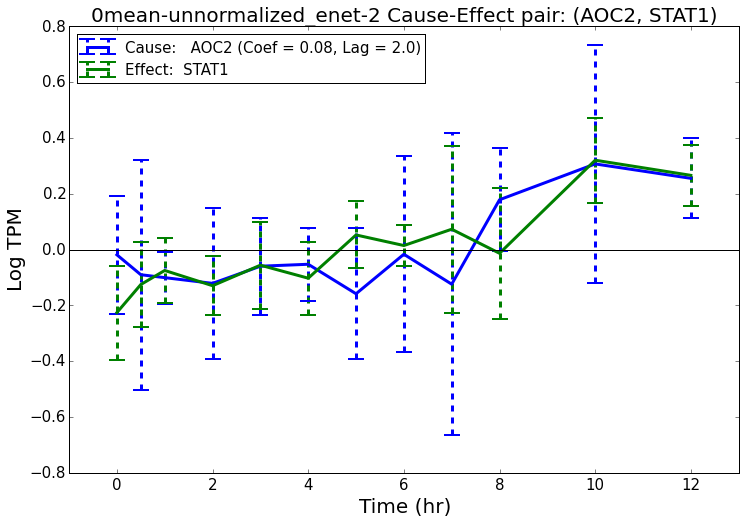

Filename:  analysis/plots/common/metab-tf/AOC2-STAT1/0mean-unnormalized_enet-2_no-bar-AOC2-STAT1-lag-2-coef-8E-02.pdf
Plot saved to  analysis/plots/common/metab-tf/AOC2-STAT1/0mean-unnormalized_enet-2_no-bar-AOC2-STAT1-lag-2-coef-8E-02.pdf


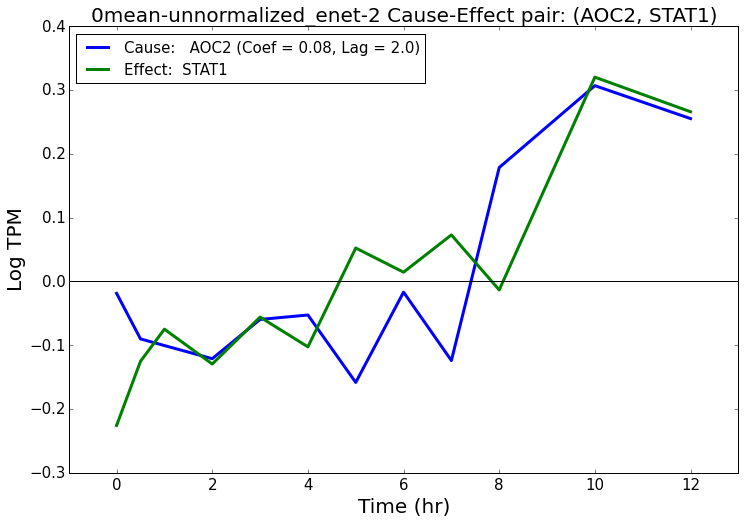

********************************
AOC2 FOSL2
********************************
***********************************************
0mean-1var_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect   Weight  Coef         Summary: Cause       Summary: Effect
8211               AOC2               FOSL2  0.05483   1.0  Metabolism-gluc_GSEA,  GR_direct,TF-Bioguo,
Written to  analysis/plots/common/metab-tf/AOC2-FOSL2/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-tf/AOC2-FOSL2/0mean-1var_enet-2_AOC2-FOSL2-lag-2-coef-5E-02.pdf
Plot saved to  analysis/plots/common/metab-tf/AOC2-FOSL2/0mean-1var_enet-2_AOC2-FOSL2-lag-2-coef-5E-02.pdf


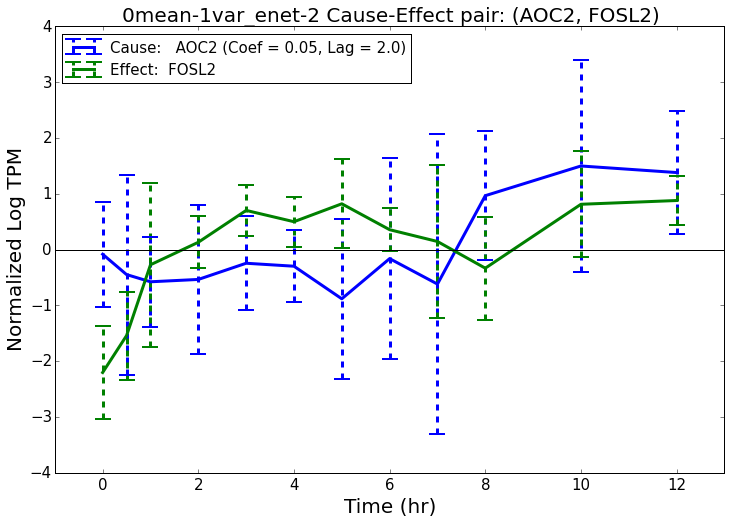

Filename:  analysis/plots/common/metab-tf/AOC2-FOSL2/0mean-1var_enet-2_no-bar-AOC2-FOSL2-lag-2-coef-5E-02.pdf
Plot saved to  analysis/plots/common/metab-tf/AOC2-FOSL2/0mean-1var_enet-2_no-bar-AOC2-FOSL2-lag-2-coef-5E-02.pdf


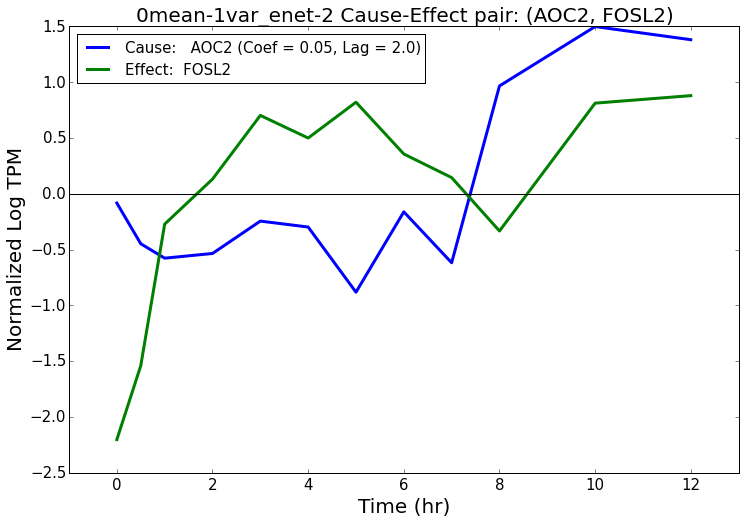

***********************************************
0mean-unnormalized_enet-1
***********************************************
      Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef         Summary: Cause       Summary: Effect
12209               AOC2               FOSL2  0.065037     1  Metabolism-gluc_GSEA,  GR_direct,TF-Bioguo,
Written to  analysis/plots/common/metab-tf/AOC2-FOSL2/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-tf/AOC2-FOSL2/0mean-unnormalized_enet-1_AOC2-FOSL2-lag-1-coef-7E-02.pdf
Plot saved to  analysis/plots/common/metab-tf/AOC2-FOSL2/0mean-unnormalized_enet-1_AOC2-FOSL2-lag-1-coef-7E-02.pdf


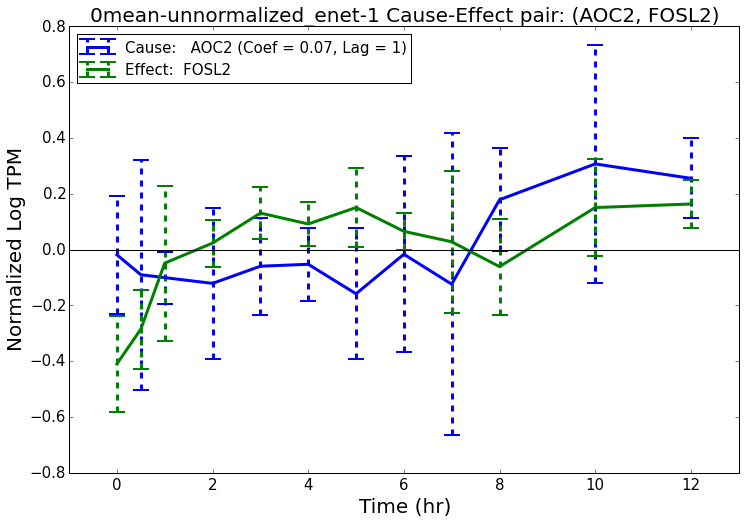

Filename:  analysis/plots/common/metab-tf/AOC2-FOSL2/0mean-unnormalized_enet-1_no-bar-AOC2-FOSL2-lag-1-coef-7E-02.pdf
Plot saved to  analysis/plots/common/metab-tf/AOC2-FOSL2/0mean-unnormalized_enet-1_no-bar-AOC2-FOSL2-lag-1-coef-7E-02.pdf


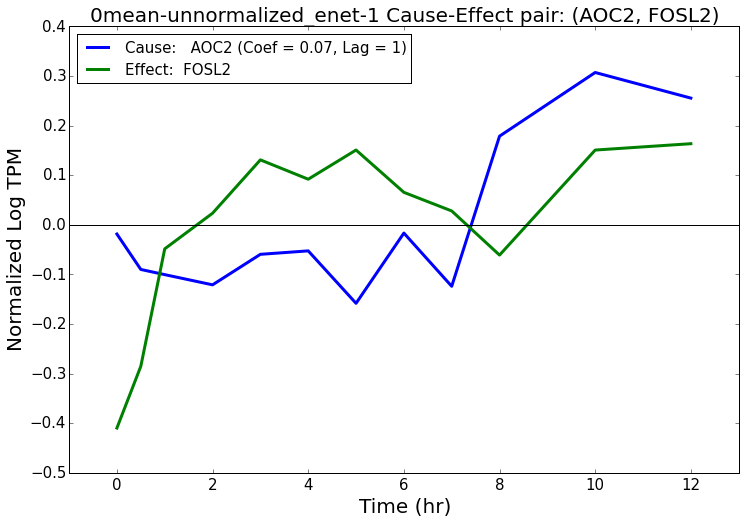

***********************************************
0mean-unnormalized_enet-2
***********************************************
      Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef         Summary: Cause       Summary: Effect
14629               AOC2               FOSL2  0.047709   1.0  Metabolism-gluc_GSEA,  GR_direct,TF-Bioguo,
Written to  analysis/plots/common/metab-tf/AOC2-FOSL2/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-tf/AOC2-FOSL2/0mean-unnormalized_enet-2_AOC2-FOSL2-lag-2-coef-5E-02.pdf
Plot saved to  analysis/plots/common/metab-tf/AOC2-FOSL2/0mean-unnormalized_enet-2_AOC2-FOSL2-lag-2-coef-5E-02.pdf


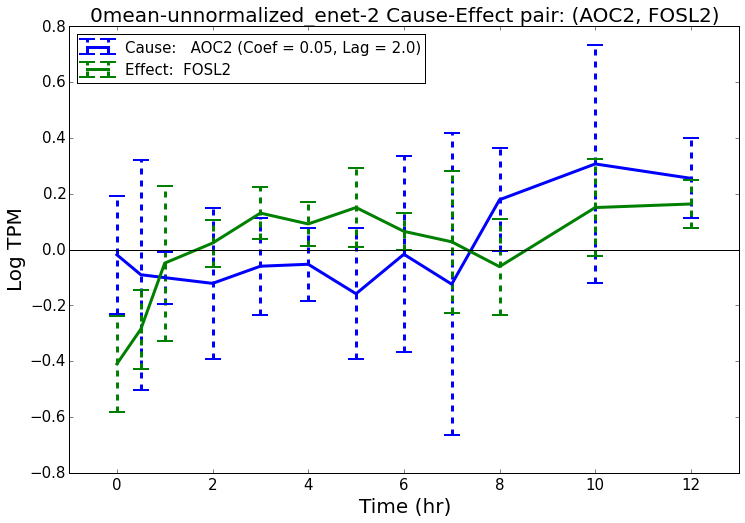

Filename:  analysis/plots/common/metab-tf/AOC2-FOSL2/0mean-unnormalized_enet-2_no-bar-AOC2-FOSL2-lag-2-coef-5E-02.pdf
Plot saved to  analysis/plots/common/metab-tf/AOC2-FOSL2/0mean-unnormalized_enet-2_no-bar-AOC2-FOSL2-lag-2-coef-5E-02.pdf


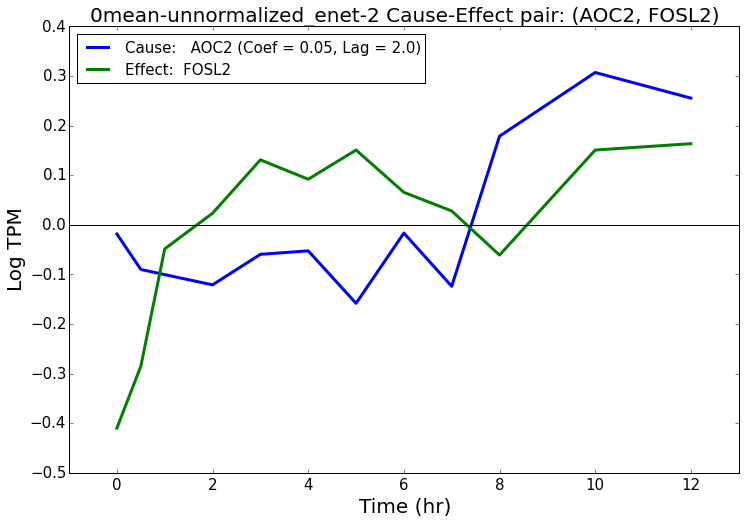

In [91]:
for i, r in plot_df.iterrows():
    print "********************************"
    print r["Gene Symbol: Cause"], r["Gene Symbol: Effect"]
    print "********************************"
    
    
    all_plot_folder = os.path.join(plot_subfolder, "-".join([r["Gene Symbol: Cause"], r["Gene Symbol: Effect"]]))
    
    indices = []
    for j in range(len(names)):
        if r[names[j]] == 1:
            # plot if contains
            indices.append(j)
    
    plot_nets = [nets[ind][nets[ind]["Cause-Effect"] == r["Cause-Effect"]] for ind in indices]
    for p in range(len(plot_nets)):
        plot_nets[p]["Gene Symbol: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_nets[p]["Cause"].values]
        plot_nets[p]["Gene Symbol: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_nets[p]["Effect"].values]
    
    plot_data_hg_df_list = [data_hg_df_list[ind] for ind in indices]
    plot_names = [names[ind] for ind in indices]
    plot_timekeys_list = [timekeys_list[ind] for ind in indices]
    plot_num_per_keys_list = [num_per_keys_list[ind] for ind in indices]
    plot_timepoints_list = [timepoints_list[ind] for ind in indices]
    
    
    do_plot_nets(plot_data_hg_df_list, plot_nets, plot_names, plot_timekeys_list, plot_num_per_keys_list, plot_timepoints_list,
                all_plot_folder=all_plot_folder, include_name_prefix=True, ylabels=ylabels)
    
#     for plot_net, plot_name in zip(plot_nets, plot_names):
#         print plot_name
#         display(plot_net)

# metab-imm

In [92]:
plotfoldersuffix = "metab-imm"
plot_df = edge_network_df[np.logical_and(edge_network_df["Cause"].isin(metab_genes), edge_network_df["Effect"].isin(imm_genes))].head(top_edge_num)

display(plot_df)

plot_subfolder = os.path.join(plot_common_folder, plotfoldersuffix)
if not os.path.exists(plot_subfolder):
    os.makedirs(plot_subfolder)
    
outfile = os.path.join(plot_subfolder, "top_interactions.csv")
plot_df.to_csv(outfile, index=0)

,Cause-Effect,Cause,Effect,Gene Symbol: Cause,Gene Symbol: Effect,Summary: Cause,Summary: Effect,Abs-Avg-Weight,Total,Networks,0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,Weight: 0mean-1var_enet-1,Weight: 0mean-1var_enet-2,Weight: 0mean-unnormalized_enet-1,Weight: 0mean-unnormalized_enet-2
17203,ENSG00000131480.7-ENSG00000115415.17,ENSG00000131480.7,ENSG00000115415.17,AOC2,STAT1,"Metabolism-gluc_GSEA,","GR_GSEA,TF-Bioguo,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,",0.063,3.0,"0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",0,1,1,1,0.0,0.069462,0.101293,0.082610
39046,ENSG00000173391.7-ENSG00000115594.10,ENSG00000173391.7,ENSG00000115594.10,OLR1,IL1R1,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,","Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,",0.057,3.0,"0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",0,1,1,1,0.0,-0.062300,-0.115185,-0.051237
39099,ENSG00000173391.7-ENSG00000127191.16,ENSG00000173391.7,ENSG00000127191.16,OLR1,TRAF2,"Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,","Obesity_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,",0.046,3.0,"0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",0,1,1,1,0.0,0.054210,0.103220,0.027855


********************************
AOC2 STAT1
********************************


/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


***********************************************
0mean-1var_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef         Summary: Cause                                                                      Summary: Effect
3295               AOC2               STAT1  0.069462   1.0  Metabolism-gluc_GSEA,  GR_GSEA,TF-Bioguo,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/metab-imm/AOC2-STAT1/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-imm/AOC2-STAT1/0mean-1var_enet-2_AOC2-STAT1-lag-2-coef-7E-02.pdf
Plot saved to  analysis/plots/common/metab-imm/AOC2-STAT1/0mean-1var_enet-2_AOC2-STAT1-lag-2-coef-7E-02.pdf


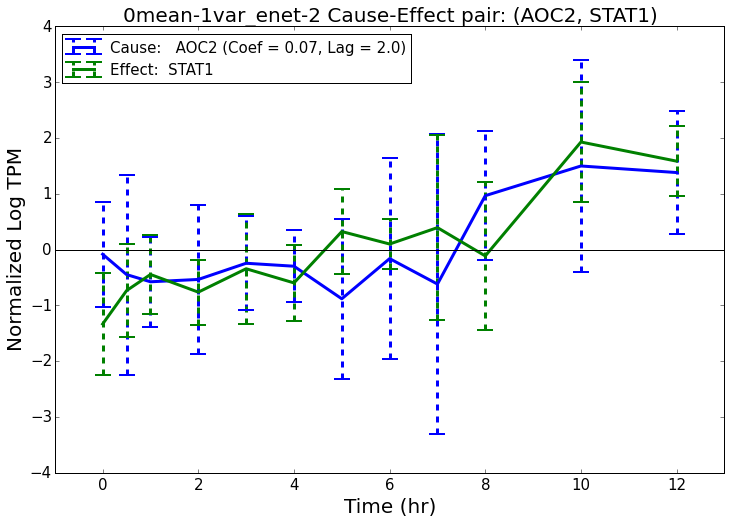

Filename:  analysis/plots/common/metab-imm/AOC2-STAT1/0mean-1var_enet-2_no-bar-AOC2-STAT1-lag-2-coef-7E-02.pdf
Plot saved to  analysis/plots/common/metab-imm/AOC2-STAT1/0mean-1var_enet-2_no-bar-AOC2-STAT1-lag-2-coef-7E-02.pdf


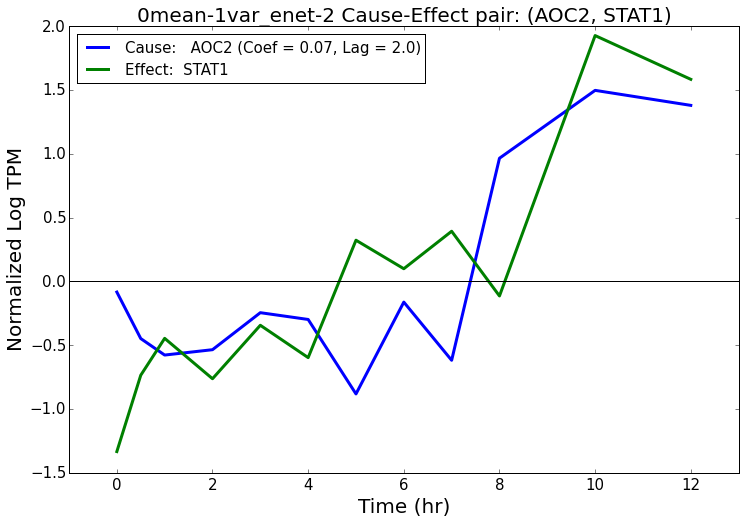

***********************************************
0mean-unnormalized_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef         Summary: Cause                                                                      Summary: Effect
3830               AOC2               STAT1  0.101293     1  Metabolism-gluc_GSEA,  GR_GSEA,TF-Bioguo,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/metab-imm/AOC2-STAT1/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-imm/AOC2-STAT1/0mean-unnormalized_enet-1_AOC2-STAT1-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/common/metab-imm/AOC2-STAT1/0mean-unnormalized_enet-1_AOC2-STAT1-lag-1-coef-1E-01.pdf


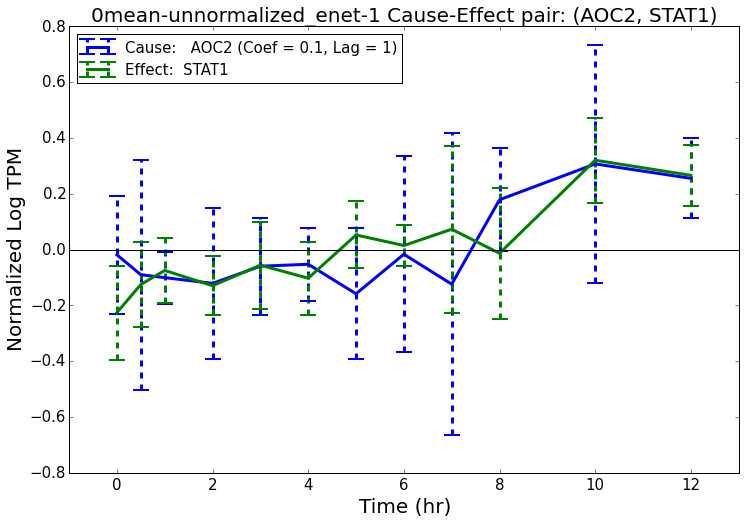

Filename:  analysis/plots/common/metab-imm/AOC2-STAT1/0mean-unnormalized_enet-1_no-bar-AOC2-STAT1-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/common/metab-imm/AOC2-STAT1/0mean-unnormalized_enet-1_no-bar-AOC2-STAT1-lag-1-coef-1E-01.pdf


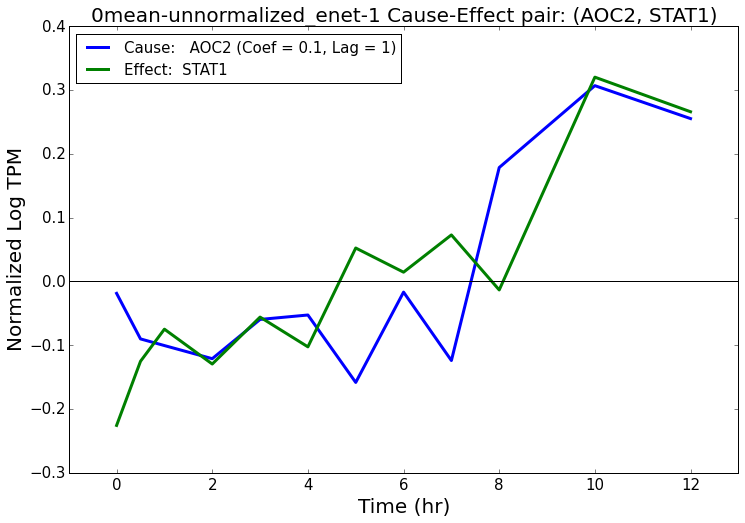

***********************************************
0mean-unnormalized_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect   Weight  Coef         Summary: Cause                                                                      Summary: Effect
3119               AOC2               STAT1  0.08261   1.0  Metabolism-gluc_GSEA,  GR_GSEA,TF-Bioguo,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/metab-imm/AOC2-STAT1/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-imm/AOC2-STAT1/0mean-unnormalized_enet-2_AOC2-STAT1-lag-2-coef-8E-02.pdf
Plot saved to  analysis/plots/common/metab-imm/AOC2-STAT1/0mean-unnormalized_enet-2_AOC2-STAT1-lag-2-coef-8E-02.pdf


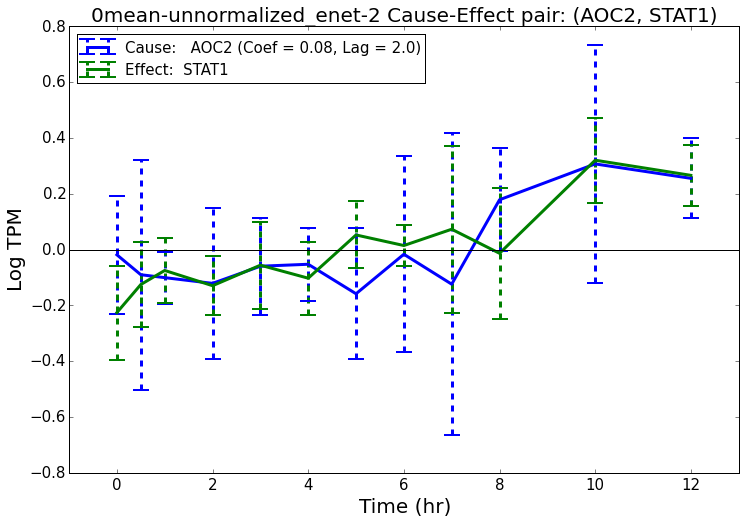

Filename:  analysis/plots/common/metab-imm/AOC2-STAT1/0mean-unnormalized_enet-2_no-bar-AOC2-STAT1-lag-2-coef-8E-02.pdf
Plot saved to  analysis/plots/common/metab-imm/AOC2-STAT1/0mean-unnormalized_enet-2_no-bar-AOC2-STAT1-lag-2-coef-8E-02.pdf


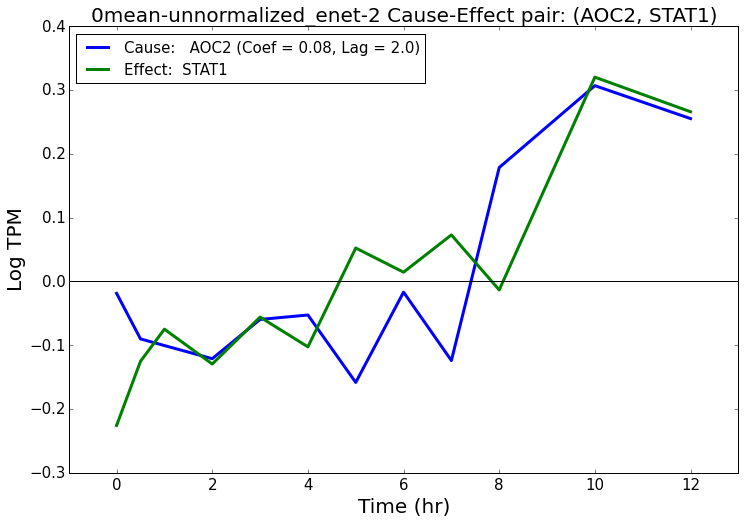

********************************
OLR1 IL1R1
********************************
***********************************************
0mean-1var_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect  Weight  Coef                                                                                   Summary: Cause                                                    Summary: Effect
5330               OLR1               IL1R1 -0.0623   1.0  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/metab-imm/OLR1-IL1R1/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-imm/OLR1-IL1R1/0mean-1var_enet-2_OLR1-IL1R1-lag-2-coef--6E-02.pdf
Plot

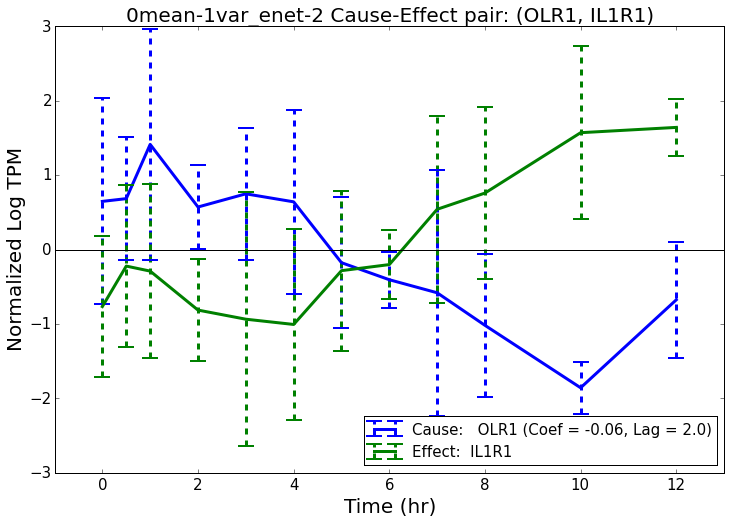

Filename:  analysis/plots/common/metab-imm/OLR1-IL1R1/0mean-1var_enet-2_no-bar-OLR1-IL1R1-lag-2-coef--6E-02.pdf
Plot saved to  analysis/plots/common/metab-imm/OLR1-IL1R1/0mean-1var_enet-2_no-bar-OLR1-IL1R1-lag-2-coef--6E-02.pdf


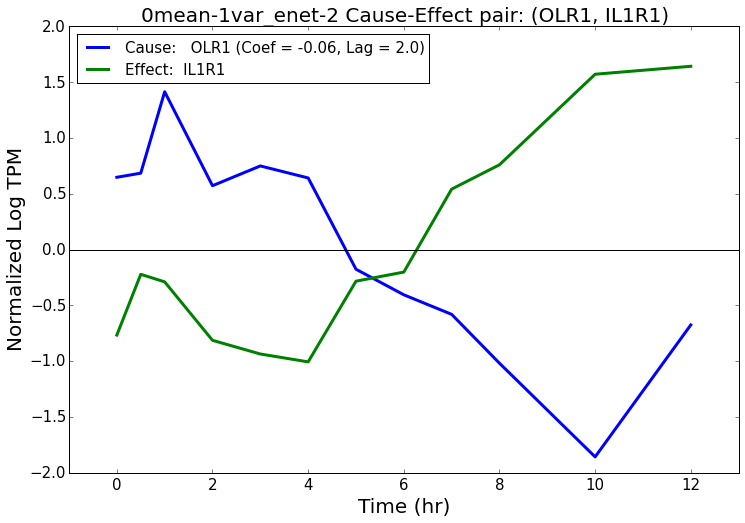

***********************************************
0mean-unnormalized_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                                                   Summary: Cause                                                    Summary: Effect
2357               OLR1               IL1R1 -0.115185     1  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/metab-imm/OLR1-IL1R1/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-imm/OLR1-IL1R1/0mean-unnormalized_enet-1_OLR1-IL1R1-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/metab-imm/OLR1-I

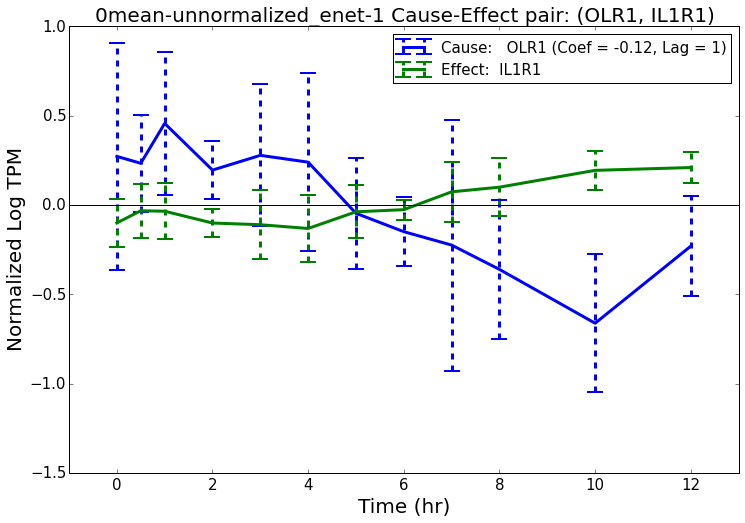

Filename:  analysis/plots/common/metab-imm/OLR1-IL1R1/0mean-unnormalized_enet-1_no-bar-OLR1-IL1R1-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/metab-imm/OLR1-IL1R1/0mean-unnormalized_enet-1_no-bar-OLR1-IL1R1-lag-1-coef--1E-01.pdf


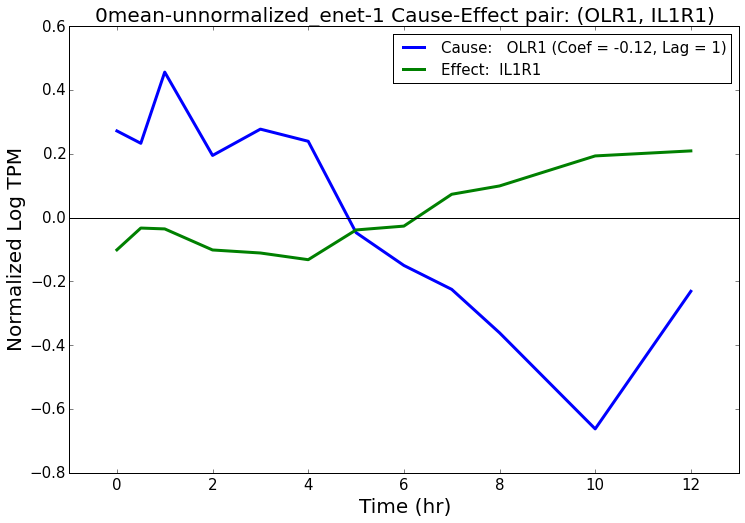

***********************************************
0mean-unnormalized_enet-2
***********************************************
      Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                                                   Summary: Cause                                                    Summary: Effect
12686               OLR1               IL1R1 -0.051237   1.0  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/metab-imm/OLR1-IL1R1/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-imm/OLR1-IL1R1/0mean-unnormalized_enet-2_OLR1-IL1R1-lag-2-coef--5E-02.pdf
Plot saved to  analysis/plots/common/metab-imm/OLR1

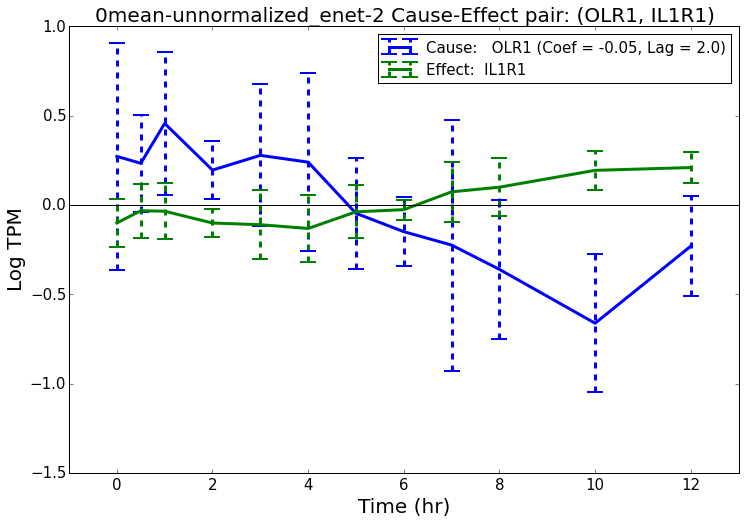

Filename:  analysis/plots/common/metab-imm/OLR1-IL1R1/0mean-unnormalized_enet-2_no-bar-OLR1-IL1R1-lag-2-coef--5E-02.pdf
Plot saved to  analysis/plots/common/metab-imm/OLR1-IL1R1/0mean-unnormalized_enet-2_no-bar-OLR1-IL1R1-lag-2-coef--5E-02.pdf


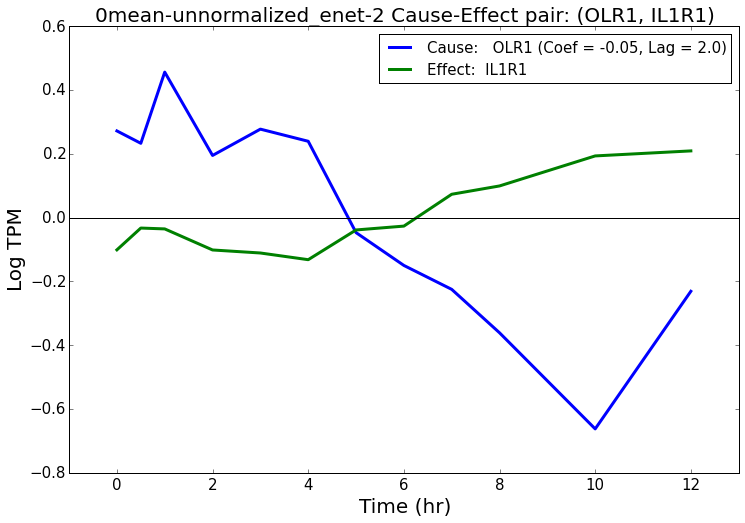

********************************
OLR1 TRAF2
********************************
***********************************************
0mean-1var_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect   Weight  Coef                                                                                   Summary: Cause                                                                 Summary: Effect
8478               OLR1               TRAF2  0.05421   1.0  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  Obesity_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/metab-imm/OLR1-TRAF2/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-imm/OLR1-TRAF2/0mean-1var_enet-2_OLR1-TRAF

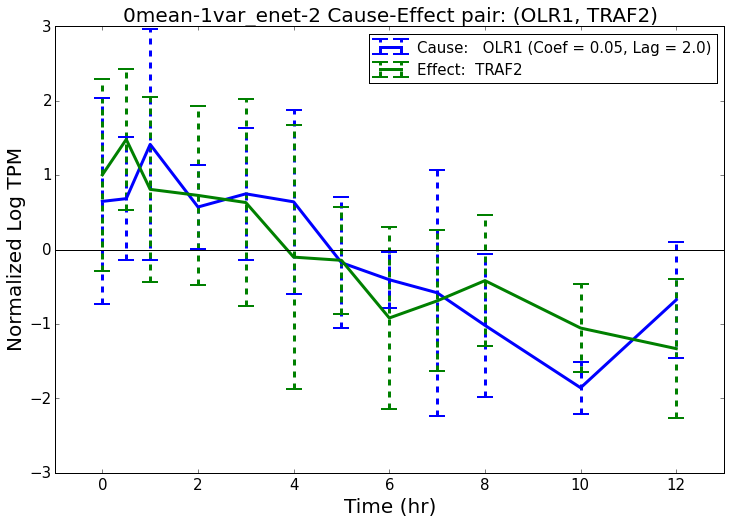

Filename:  analysis/plots/common/metab-imm/OLR1-TRAF2/0mean-1var_enet-2_no-bar-OLR1-TRAF2-lag-2-coef-5E-02.pdf
Plot saved to  analysis/plots/common/metab-imm/OLR1-TRAF2/0mean-1var_enet-2_no-bar-OLR1-TRAF2-lag-2-coef-5E-02.pdf


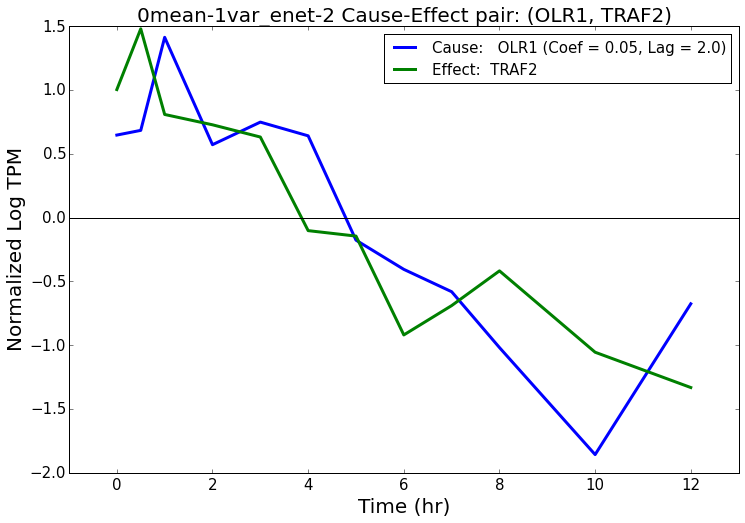

***********************************************
0mean-unnormalized_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect   Weight  Coef                                                                                   Summary: Cause                                                                 Summary: Effect
3602               OLR1               TRAF2  0.10322     1  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  Obesity_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/metab-imm/OLR1-TRAF2/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-imm/OLR1-TRAF2/0mean-unnormalized_enet-1_OLR1-TRAF2-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/

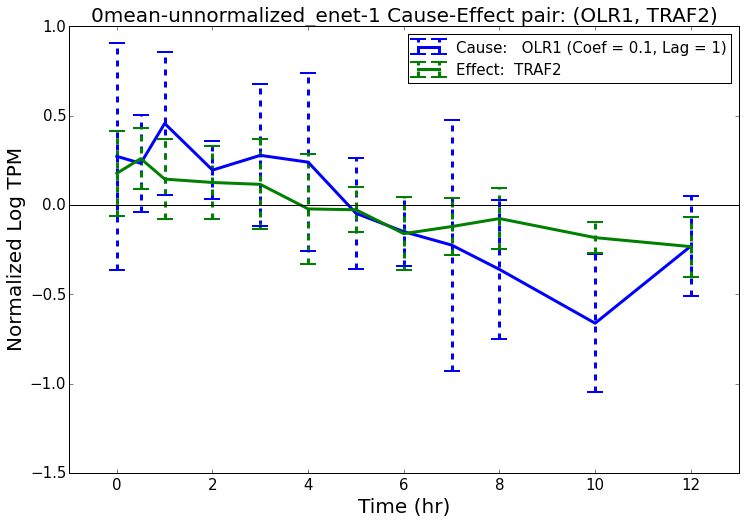

Filename:  analysis/plots/common/metab-imm/OLR1-TRAF2/0mean-unnormalized_enet-1_no-bar-OLR1-TRAF2-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/common/metab-imm/OLR1-TRAF2/0mean-unnormalized_enet-1_no-bar-OLR1-TRAF2-lag-1-coef-1E-01.pdf


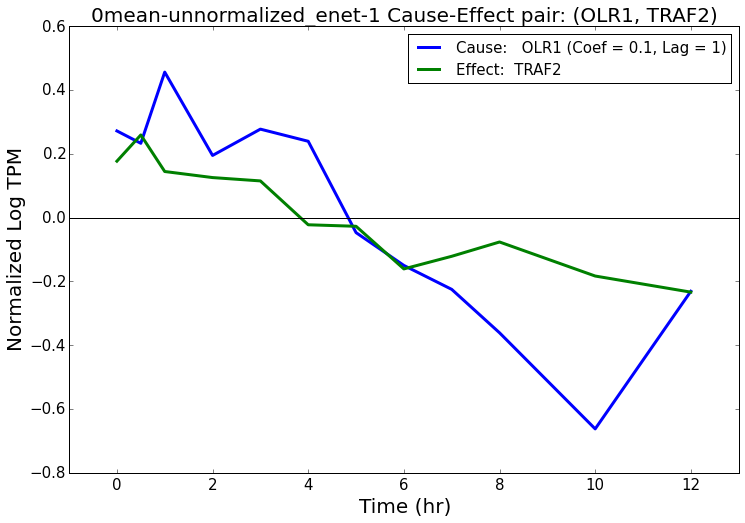

***********************************************
0mean-unnormalized_enet-2
***********************************************
      Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef                                                                                   Summary: Cause                                                                 Summary: Effect
25467               OLR1               TRAF2  0.027855   1.0  Metabolism-gluc_GSEA,Metabolism-lipid_GSEA,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,  Obesity_GSEA,Immune_GOC-8,Immune_GOC-7,Immune_GOC-6,Immune_GOC-5,Immune_GOC-4,
Written to  analysis/plots/common/metab-imm/OLR1-TRAF2/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-imm/OLR1-TRAF2/0mean-unnormalized_enet-2_OLR1-TRAF2-lag-2-coef-3E-02.pdf
Plot saved to  analysis/pl

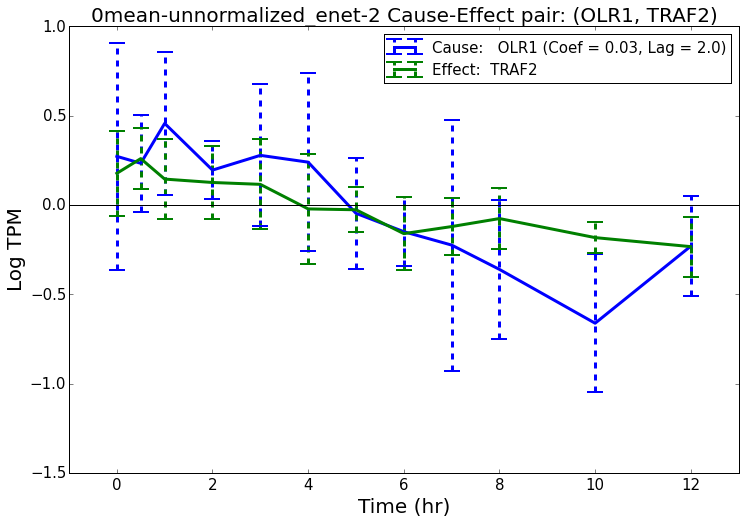

Filename:  analysis/plots/common/metab-imm/OLR1-TRAF2/0mean-unnormalized_enet-2_no-bar-OLR1-TRAF2-lag-2-coef-3E-02.pdf
Plot saved to  analysis/plots/common/metab-imm/OLR1-TRAF2/0mean-unnormalized_enet-2_no-bar-OLR1-TRAF2-lag-2-coef-3E-02.pdf


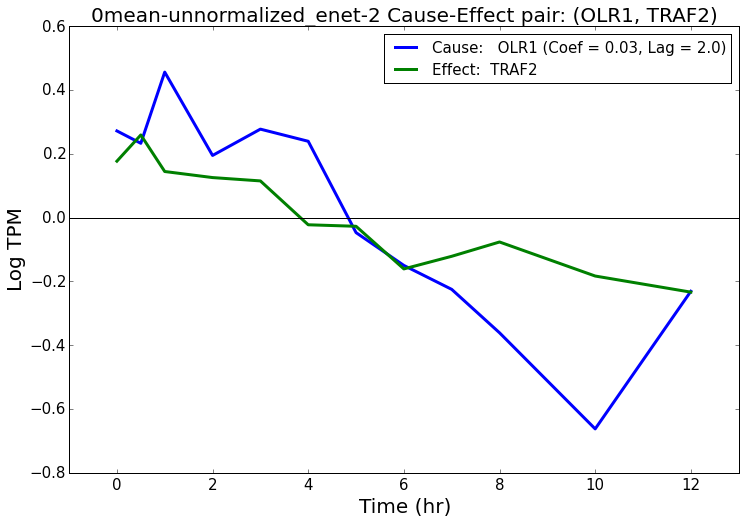

In [93]:
for i, r in plot_df.iterrows():
    print "********************************"
    print r["Gene Symbol: Cause"], r["Gene Symbol: Effect"]
    print "********************************"
    
    
    all_plot_folder = os.path.join(plot_subfolder, "-".join([r["Gene Symbol: Cause"], r["Gene Symbol: Effect"]]))
    
    indices = []
    for j in range(len(names)):
        if r[names[j]] == 1:
            # plot if contains
            indices.append(j)
    
    plot_nets = [nets[ind][nets[ind]["Cause-Effect"] == r["Cause-Effect"]] for ind in indices]
    for p in range(len(plot_nets)):
        plot_nets[p]["Gene Symbol: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_nets[p]["Cause"].values]
        plot_nets[p]["Gene Symbol: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_nets[p]["Effect"].values]
    
    plot_data_hg_df_list = [data_hg_df_list[ind] for ind in indices]
    plot_names = [names[ind] for ind in indices]
    plot_timekeys_list = [timekeys_list[ind] for ind in indices]
    plot_num_per_keys_list = [num_per_keys_list[ind] for ind in indices]
    plot_timepoints_list = [timepoints_list[ind] for ind in indices]
    
    
    do_plot_nets(plot_data_hg_df_list, plot_nets, plot_names, plot_timekeys_list, plot_num_per_keys_list, plot_timepoints_list,
                all_plot_folder=all_plot_folder, include_name_prefix=True, ylabels=ylabels)
    
#     for plot_net, plot_name in zip(plot_nets, plot_names):
#         print plot_name
#         display(plot_net)

# metab-metab

In [94]:
plotfoldersuffix = "metab-metab"
plot_df = edge_network_df[np.logical_and(edge_network_df["Cause"].isin(metab_genes), edge_network_df["Effect"].isin(metab_genes))].head(top_edge_num)

display(plot_df)

plot_subfolder = os.path.join(plot_common_folder, plotfoldersuffix)
if not os.path.exists(plot_subfolder):
    os.makedirs(plot_subfolder)
    
outfile = os.path.join(plot_subfolder, "top_interactions.csv")
plot_df.to_csv(outfile, index=0)

,Cause-Effect,Cause,Effect,Gene Symbol: Cause,Gene Symbol: Effect,Summary: Cause,Summary: Effect,Abs-Avg-Weight,Total,Networks,0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,Weight: 0mean-1var_enet-1,Weight: 0mean-1var_enet-2,Weight: 0mean-unnormalized_enet-1,Weight: 0mean-unnormalized_enet-2
17256,ENSG00000131480.7-ENSG00000141753.6,ENSG00000131480.7,ENSG00000141753.6,AOC2,IGFBP4,"Metabolism-gluc_GSEA,","GR_direct,Diabetes_GSEA,",0.070,3.0,"0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",0,1,1,1,0.000000,0.061914,0.108684,0.110157
17129,ENSG00000131480.7-ENSG00000006283.16,ENSG00000131480.7,ENSG00000006283.16,AOC2,CACNA1G,"Metabolism-gluc_GSEA,","Diabetes_GSEA,",0.057,3.0,"0mean-1var_enet-2,0mean-unnormalized_enet-1,0mean-unnormalized_enet-2,",0,1,1,1,0.000000,-0.053169,-0.097842,-0.077579
6342,ENSG00000101473.15-ENSG00000141753.6,ENSG00000101473.15,ENSG00000141753.6,ACOT8,IGFBP4,"Metabolism-lipid_GSEA,","GR_direct,Diabetes_GSEA,",0.052,3.0,"0mean-1var_enet-1,0mean-1var_enet-2,0mean-unnormalized_enet-1,",1,1,1,0,0.087595,0.072318,0.048410,0.000000


********************************
AOC2 IGFBP4
********************************


/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Library/Frameworks/Python.framework/Versions/2.7/lib/python2.7/site-packages/ipykernel/__main__.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


***********************************************
0mean-1var_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef         Summary: Cause           Summary: Effect
5459               AOC2              IGFBP4  0.061914   1.0  Metabolism-gluc_GSEA,  GR_direct,Diabetes_GSEA,
Written to  analysis/plots/common/metab-metab/AOC2-IGFBP4/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-metab/AOC2-IGFBP4/0mean-1var_enet-2_AOC2-IGFBP4-lag-2-coef-6E-02.pdf
Plot saved to  analysis/plots/common/metab-metab/AOC2-IGFBP4/0mean-1var_enet-2_AOC2-IGFBP4-lag-2-coef-6E-02.pdf


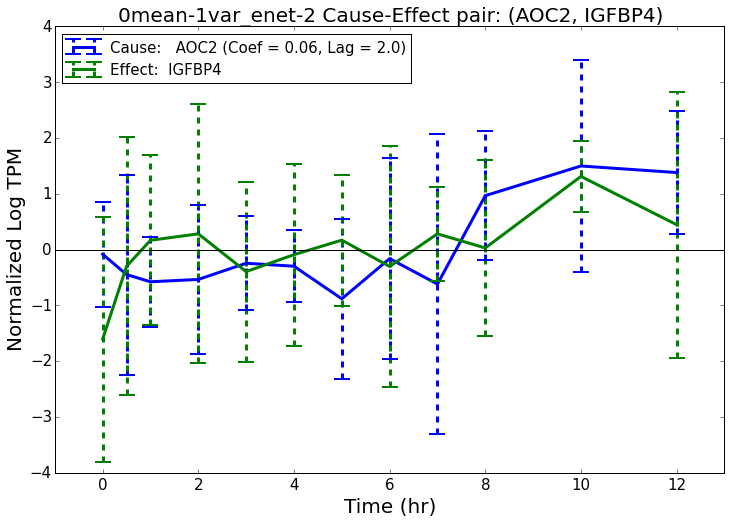

Filename:  analysis/plots/common/metab-metab/AOC2-IGFBP4/0mean-1var_enet-2_no-bar-AOC2-IGFBP4-lag-2-coef-6E-02.pdf
Plot saved to  analysis/plots/common/metab-metab/AOC2-IGFBP4/0mean-1var_enet-2_no-bar-AOC2-IGFBP4-lag-2-coef-6E-02.pdf


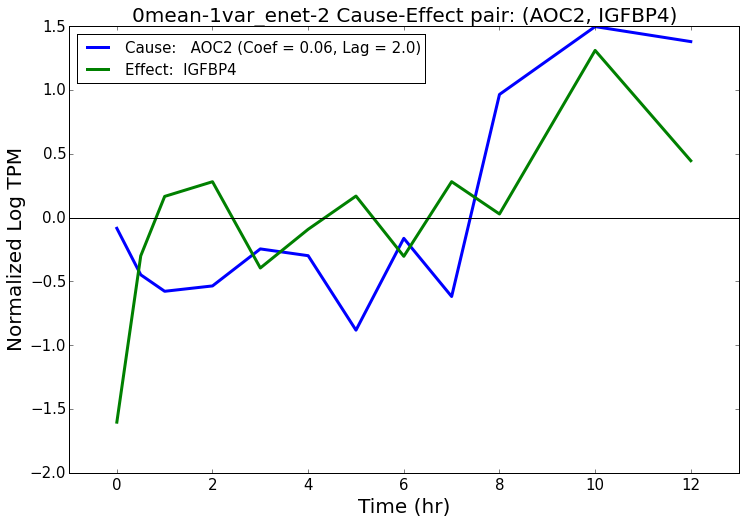

***********************************************
0mean-unnormalized_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef         Summary: Cause           Summary: Effect
2969               AOC2              IGFBP4  0.108684     1  Metabolism-gluc_GSEA,  GR_direct,Diabetes_GSEA,
Written to  analysis/plots/common/metab-metab/AOC2-IGFBP4/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-metab/AOC2-IGFBP4/0mean-unnormalized_enet-1_AOC2-IGFBP4-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/common/metab-metab/AOC2-IGFBP4/0mean-unnormalized_enet-1_AOC2-IGFBP4-lag-1-coef-1E-01.pdf


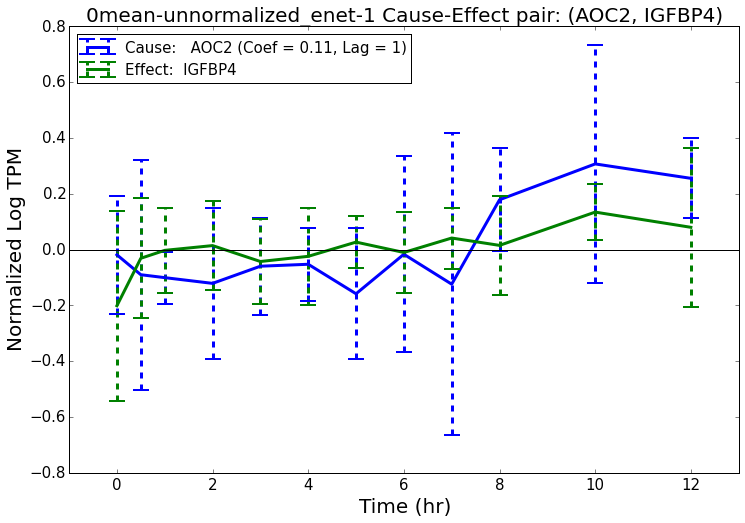

Filename:  analysis/plots/common/metab-metab/AOC2-IGFBP4/0mean-unnormalized_enet-1_no-bar-AOC2-IGFBP4-lag-1-coef-1E-01.pdf
Plot saved to  analysis/plots/common/metab-metab/AOC2-IGFBP4/0mean-unnormalized_enet-1_no-bar-AOC2-IGFBP4-lag-1-coef-1E-01.pdf


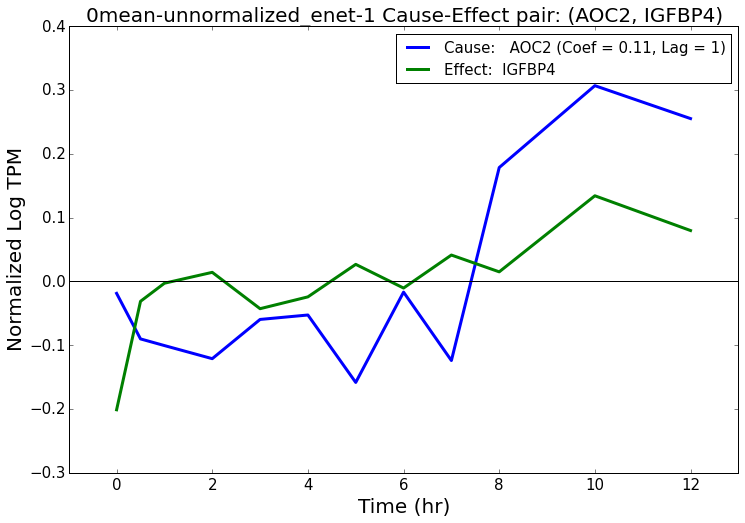

***********************************************
0mean-unnormalized_enet-2
***********************************************
    Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef         Summary: Cause           Summary: Effect
821               AOC2              IGFBP4  0.110157   1.0  Metabolism-gluc_GSEA,  GR_direct,Diabetes_GSEA,
Written to  analysis/plots/common/metab-metab/AOC2-IGFBP4/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-metab/AOC2-IGFBP4/0mean-unnormalized_enet-2_AOC2-IGFBP4-lag-2-coef-1E-01.pdf
Plot saved to  analysis/plots/common/metab-metab/AOC2-IGFBP4/0mean-unnormalized_enet-2_AOC2-IGFBP4-lag-2-coef-1E-01.pdf


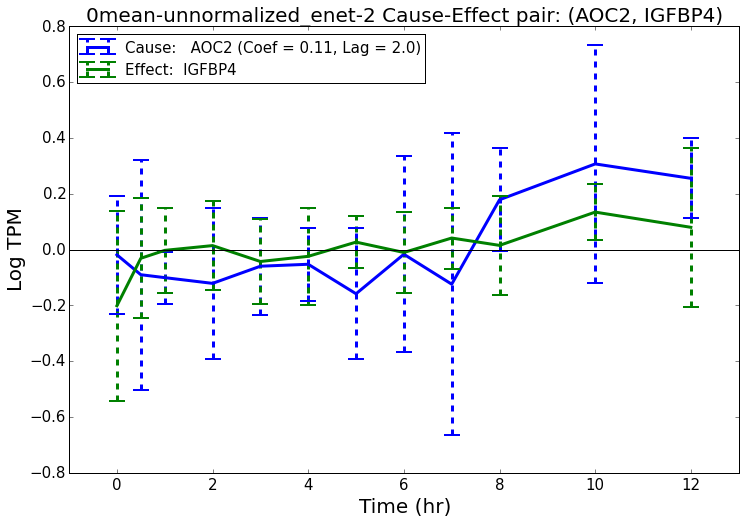

Filename:  analysis/plots/common/metab-metab/AOC2-IGFBP4/0mean-unnormalized_enet-2_no-bar-AOC2-IGFBP4-lag-2-coef-1E-01.pdf
Plot saved to  analysis/plots/common/metab-metab/AOC2-IGFBP4/0mean-unnormalized_enet-2_no-bar-AOC2-IGFBP4-lag-2-coef-1E-01.pdf


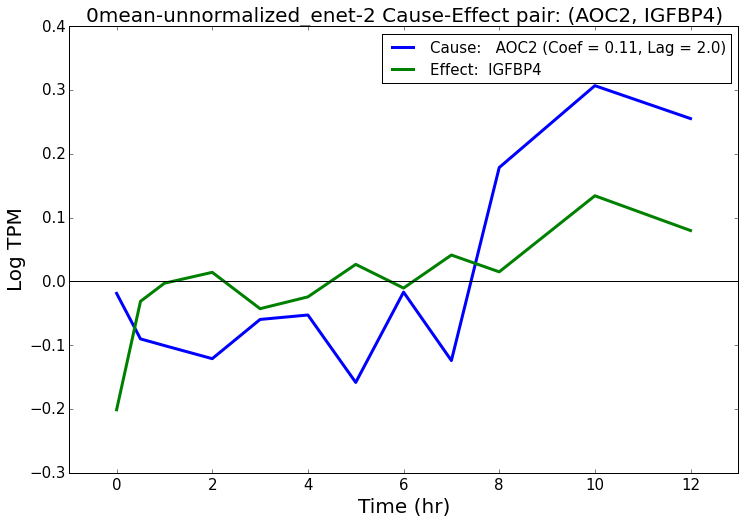

********************************
AOC2 CACNA1G
********************************
***********************************************
0mean-1var_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef         Summary: Cause Summary: Effect
8892               AOC2             CACNA1G -0.053169   1.0  Metabolism-gluc_GSEA,  Diabetes_GSEA,
Written to  analysis/plots/common/metab-metab/AOC2-CACNA1G/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-metab/AOC2-CACNA1G/0mean-1var_enet-2_AOC2-CACNA1G-lag-2-coef--5E-02.pdf
Plot saved to  analysis/plots/common/metab-metab/AOC2-CACNA1G/0mean-1var_enet-2_AOC2-CACNA1G-lag-2-coef--5E-02.pdf


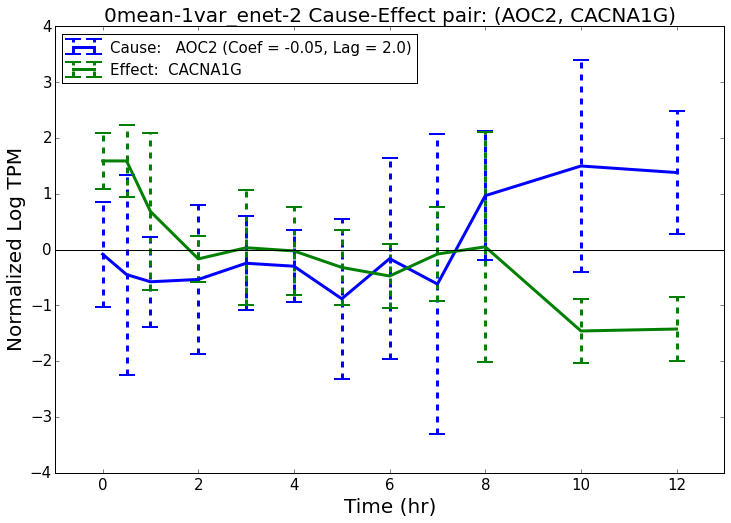

Filename:  analysis/plots/common/metab-metab/AOC2-CACNA1G/0mean-1var_enet-2_no-bar-AOC2-CACNA1G-lag-2-coef--5E-02.pdf
Plot saved to  analysis/plots/common/metab-metab/AOC2-CACNA1G/0mean-1var_enet-2_no-bar-AOC2-CACNA1G-lag-2-coef--5E-02.pdf


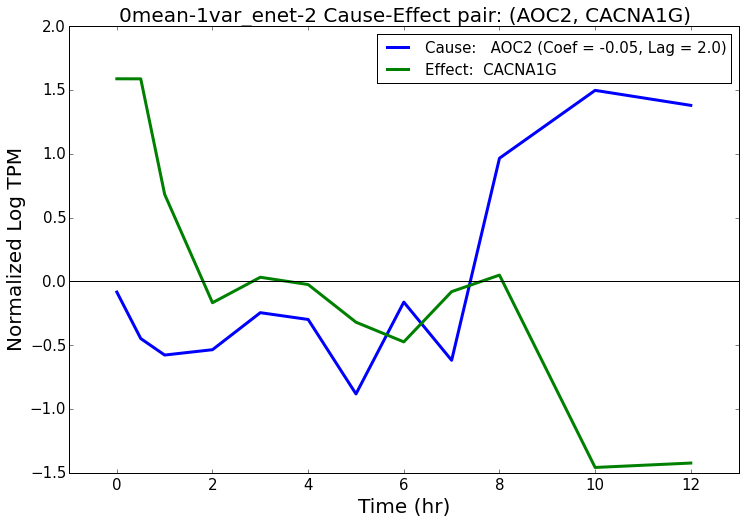

***********************************************
0mean-unnormalized_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef         Summary: Cause Summary: Effect
4292               AOC2             CACNA1G -0.097842     1  Metabolism-gluc_GSEA,  Diabetes_GSEA,
Written to  analysis/plots/common/metab-metab/AOC2-CACNA1G/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-metab/AOC2-CACNA1G/0mean-unnormalized_enet-1_AOC2-CACNA1G-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/metab-metab/AOC2-CACNA1G/0mean-unnormalized_enet-1_AOC2-CACNA1G-lag-1-coef--1E-01.pdf


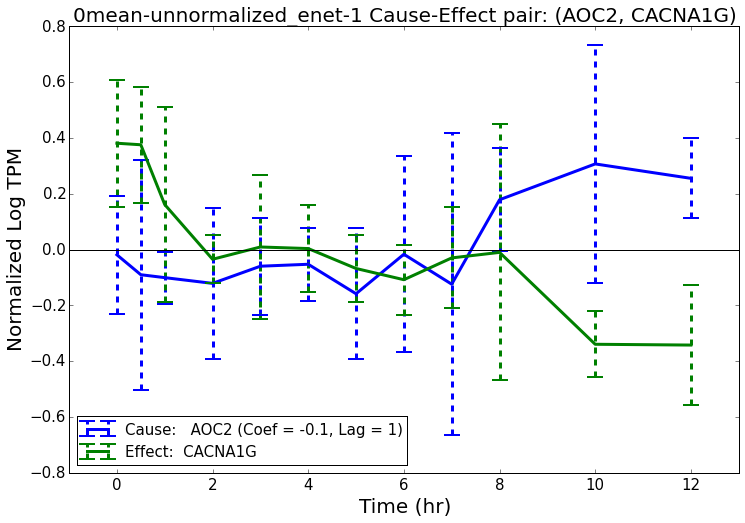

Filename:  analysis/plots/common/metab-metab/AOC2-CACNA1G/0mean-unnormalized_enet-1_no-bar-AOC2-CACNA1G-lag-1-coef--1E-01.pdf
Plot saved to  analysis/plots/common/metab-metab/AOC2-CACNA1G/0mean-unnormalized_enet-1_no-bar-AOC2-CACNA1G-lag-1-coef--1E-01.pdf


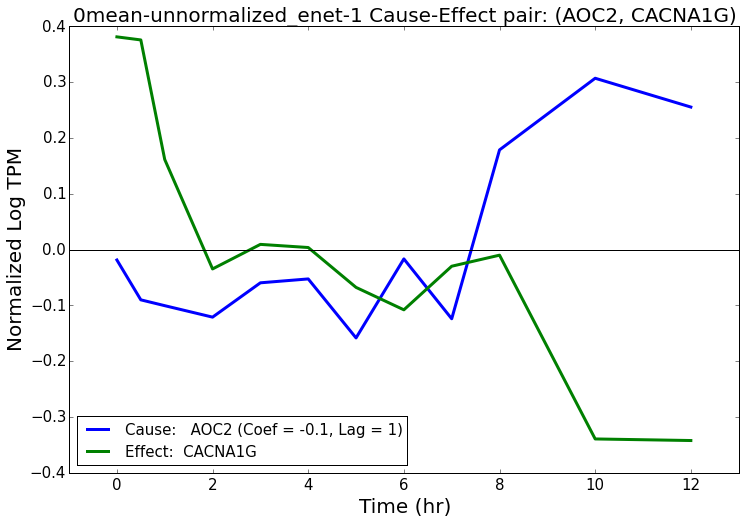

***********************************************
0mean-unnormalized_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef         Summary: Cause Summary: Effect
3921               AOC2             CACNA1G -0.077579   1.0  Metabolism-gluc_GSEA,  Diabetes_GSEA,
Written to  analysis/plots/common/metab-metab/AOC2-CACNA1G/0mean-unnormalized_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-metab/AOC2-CACNA1G/0mean-unnormalized_enet-2_AOC2-CACNA1G-lag-2-coef--8E-02.pdf
Plot saved to  analysis/plots/common/metab-metab/AOC2-CACNA1G/0mean-unnormalized_enet-2_AOC2-CACNA1G-lag-2-coef--8E-02.pdf


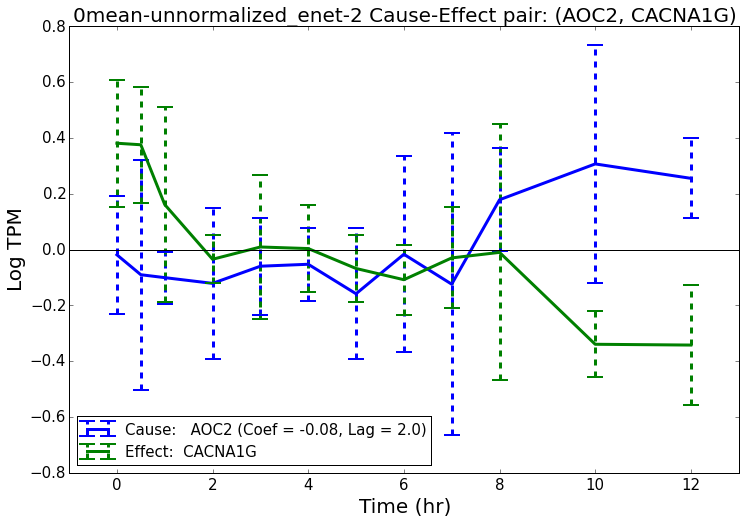

Filename:  analysis/plots/common/metab-metab/AOC2-CACNA1G/0mean-unnormalized_enet-2_no-bar-AOC2-CACNA1G-lag-2-coef--8E-02.pdf
Plot saved to  analysis/plots/common/metab-metab/AOC2-CACNA1G/0mean-unnormalized_enet-2_no-bar-AOC2-CACNA1G-lag-2-coef--8E-02.pdf


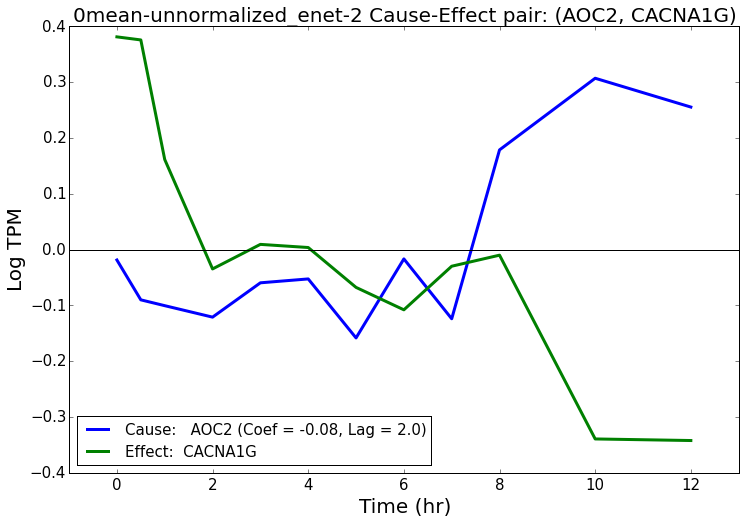

********************************
ACOT8 IGFBP4
********************************
***********************************************
0mean-1var_enet-1
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef          Summary: Cause           Summary: Effect
3970              ACOT8              IGFBP4  0.087595     1  Metabolism-lipid_GSEA,  GR_direct,Diabetes_GSEA,
Written to  analysis/plots/common/metab-metab/ACOT8-IGFBP4/0mean-1var_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-metab/ACOT8-IGFBP4/0mean-1var_enet-1_ACOT8-IGFBP4-lag-1-coef-9E-02.pdf
Plot saved to  analysis/plots/common/metab-metab/ACOT8-IGFBP4/0mean-1var_enet-1_ACOT8-IGFBP4-lag-1-coef-9E-02.pdf


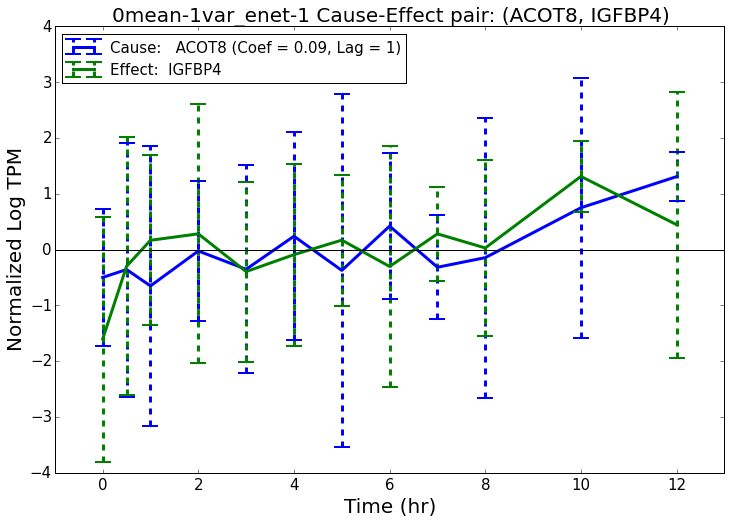

Filename:  analysis/plots/common/metab-metab/ACOT8-IGFBP4/0mean-1var_enet-1_no-bar-ACOT8-IGFBP4-lag-1-coef-9E-02.pdf
Plot saved to  analysis/plots/common/metab-metab/ACOT8-IGFBP4/0mean-1var_enet-1_no-bar-ACOT8-IGFBP4-lag-1-coef-9E-02.pdf


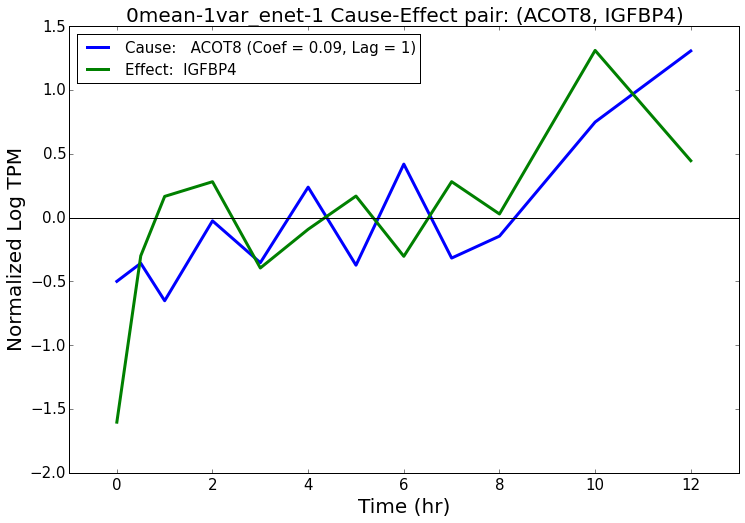

***********************************************
0mean-1var_enet-2
***********************************************
     Gene Symbol: Cause Gene Symbol: Effect    Weight  Coef          Summary: Cause           Summary: Effect
2666              ACOT8              IGFBP4  0.072318   1.0  Metabolism-lipid_GSEA,  GR_direct,Diabetes_GSEA,
Written to  analysis/plots/common/metab-metab/ACOT8-IGFBP4/0mean-1var_enet-2_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-metab/ACOT8-IGFBP4/0mean-1var_enet-2_ACOT8-IGFBP4-lag-2-coef-7E-02.pdf
Plot saved to  analysis/plots/common/metab-metab/ACOT8-IGFBP4/0mean-1var_enet-2_ACOT8-IGFBP4-lag-2-coef-7E-02.pdf


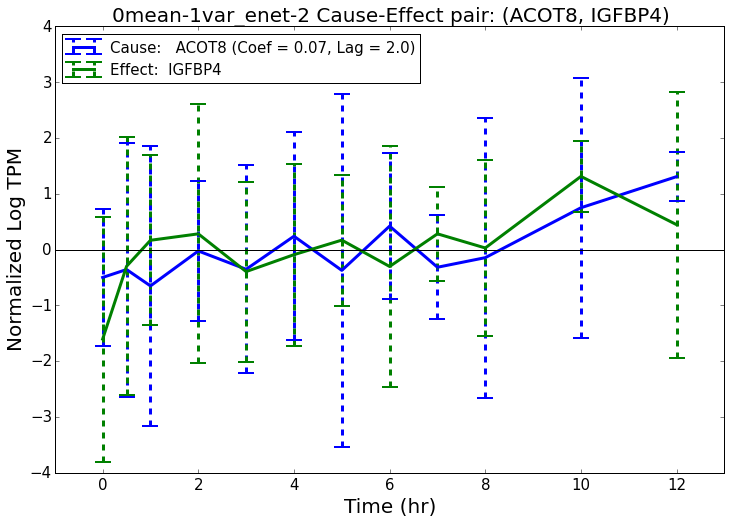

Filename:  analysis/plots/common/metab-metab/ACOT8-IGFBP4/0mean-1var_enet-2_no-bar-ACOT8-IGFBP4-lag-2-coef-7E-02.pdf
Plot saved to  analysis/plots/common/metab-metab/ACOT8-IGFBP4/0mean-1var_enet-2_no-bar-ACOT8-IGFBP4-lag-2-coef-7E-02.pdf


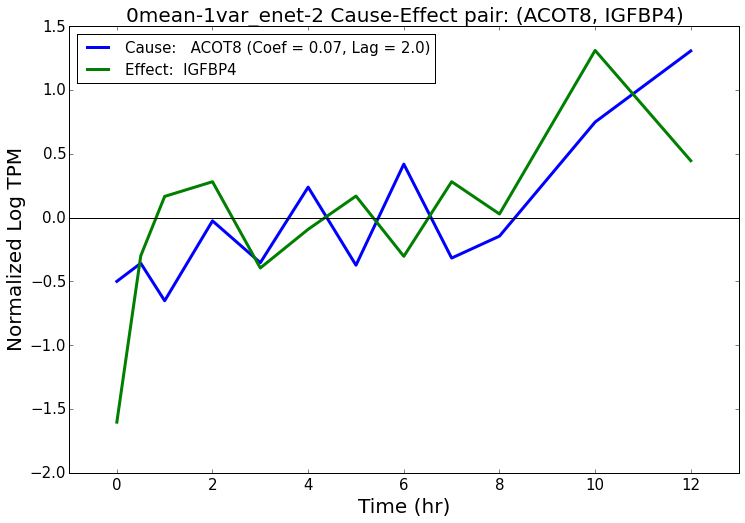

***********************************************
0mean-unnormalized_enet-1
***********************************************
      Gene Symbol: Cause Gene Symbol: Effect   Weight  Coef          Summary: Cause           Summary: Effect
18271              ACOT8              IGFBP4  0.04841     1  Metabolism-lipid_GSEA,  GR_direct,Diabetes_GSEA,
Written to  analysis/plots/common/metab-metab/ACOT8-IGFBP4/0mean-unnormalized_enet-1_top_interactions.csv
['t00_rep', 't05_rep', 't1_rep', 't2_rep', 't3_rep', 't4_rep', 't5_rep', 't6_rep', 't7_rep', 't8_rep', 't10_rep', 't12_rep']
[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Filename:  analysis/plots/common/metab-metab/ACOT8-IGFBP4/0mean-unnormalized_enet-1_ACOT8-IGFBP4-lag-1-coef-5E-02.pdf
Plot saved to  analysis/plots/common/metab-metab/ACOT8-IGFBP4/0mean-unnormalized_enet-1_ACOT8-IGFBP4-lag-1-coef-5E-02.pdf


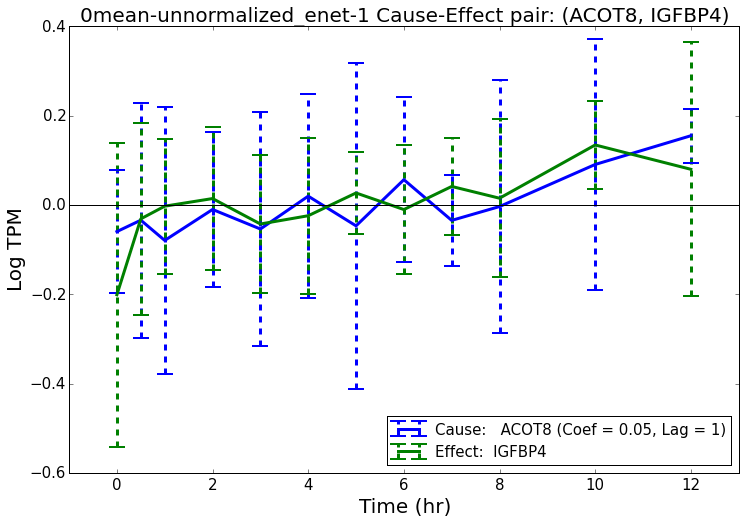

Filename:  analysis/plots/common/metab-metab/ACOT8-IGFBP4/0mean-unnormalized_enet-1_no-bar-ACOT8-IGFBP4-lag-1-coef-5E-02.pdf
Plot saved to  analysis/plots/common/metab-metab/ACOT8-IGFBP4/0mean-unnormalized_enet-1_no-bar-ACOT8-IGFBP4-lag-1-coef-5E-02.pdf


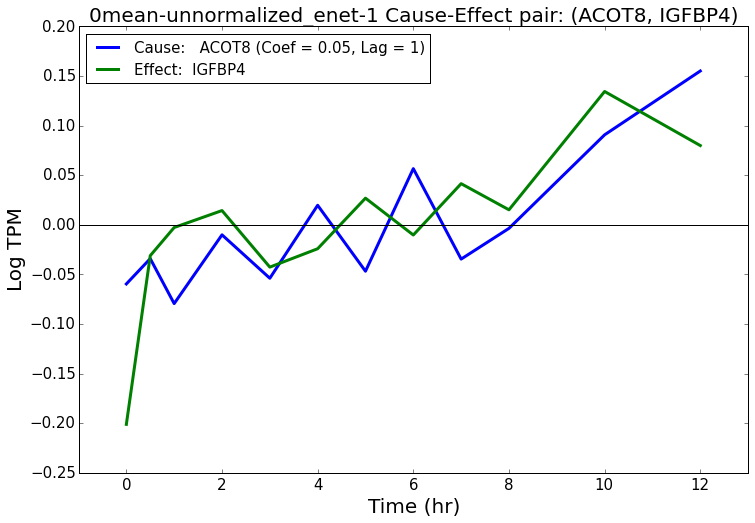

In [95]:
for i, r in plot_df.iterrows():
    print "********************************"
    print r["Gene Symbol: Cause"], r["Gene Symbol: Effect"]
    print "********************************"
    
    
    all_plot_folder = os.path.join(plot_subfolder, "-".join([r["Gene Symbol: Cause"], r["Gene Symbol: Effect"]]))
    
    indices = []
    for j in range(len(names)):
        if r[names[j]] == 1:
            # plot if contains
            indices.append(j)
    
    plot_nets = [nets[ind][nets[ind]["Cause-Effect"] == r["Cause-Effect"]] for ind in indices]
    for p in range(len(plot_nets)):
        plot_nets[p]["Gene Symbol: Cause"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_nets[p]["Cause"].values]
        plot_nets[p]["Gene Symbol: Effect"] = [gene_table[gene_table["Ensembl ID"] == x]["Gene"].values[0] for x in plot_nets[p]["Effect"].values]
    
    plot_data_hg_df_list = [data_hg_df_list[ind] for ind in indices]
    plot_names = [names[ind] for ind in indices]
    plot_timekeys_list = [timekeys_list[ind] for ind in indices]
    plot_num_per_keys_list = [num_per_keys_list[ind] for ind in indices]
    plot_timepoints_list = [timepoints_list[ind] for ind in indices]
    
    
    do_plot_nets(plot_data_hg_df_list, plot_nets, plot_names, plot_timekeys_list, plot_num_per_keys_list, plot_timepoints_list,
                all_plot_folder=all_plot_folder, include_name_prefix=True, ylabels=ylabels)
    
#     for plot_net, plot_name in zip(plot_nets, plot_names):
#         print plot_name
#         display(plot_net)

# Get the STRING protein file

In [10]:
string_gene_file = "../../STRING/STRING_by_genes-cutoff-0.7.txt"

overwrite = True
print "Loading PPI from ", string_gene_file

Loading PPI from  ../../STRING/STRING_by_genes-cutoff-0.7.txt


In [12]:
%%time

prot_nets = []
string_gene_sub_dfs = []
prot_string_int_nets = []
prot_string_int_odds_ratios = []

# Make the protein data genes, which basically just remove the protein suffix
prot_data_genes = [x.split(".")[0] for x in data_genes]

for net, gene_df, name in zip(nets, gene_dfs, names):
    t = time.time()
    
    
    out_dir = os.path.join(base_out_dir, name)
    
    string_gene_sub_file = os.path.join(out_dir, "tmp-" + os.path.split(string_gene_file)[1][:-4] + "-" + name + ".txt")
    
    # Load the string gene file
    if overwrite == False and os.path.exists(string_gene_sub_file):
        string_gene_sub_df = pd.read_csv(string_gene_sub_file, sep="\t")
    else:
        try:
            string_gene_df
#             gene_protein_df
#             gene2prot
        except NameError:
            string_gene_df = pd.read_csv(string_gene_file, sep="\t")
#             gene_protein_df = pd.read_csv(gene_protein_file, sep="\t")
#             gene2prot = dict(zip(gene_protein_df["Gene stable ID"].values, gene_protein_df["Protein stable ID"].values))
        
        if "Short Ensembl ID" not in gene_df:
            gene_df["Short Ensembl ID"] = [x.split(".")[0] for x in gene_df["Gene"].values]
        
        string_gene_sub_df = string_gene_df[np.logical_and(string_gene_df["gene1"].isin(prot_data_genes),
                                                          string_gene_df["gene2"].isin(prot_data_genes))]
        
        display(string_gene_sub_df.head())
        string_gene_sub_df.to_csv(string_gene_sub_file, sep="\t", index=False)
        
    
    string_gene_sub_dfs.append(string_gene_sub_df)
    
    
    net["directed_gene_edge"] = ["-".join([row["Cause"].split(".")[0], row["Effect"].split(".")[0]]) 
                               for i, row in net.iterrows()]
    net["undirected_gene_edge"] = ["-".join(sorted([row["Cause"].split(".")[0], row["Effect"].split(".")[0]])) 
                               for i, row in net.iterrows()]
    
    
    
    prot_net = pd.merge(net, string_gene_sub_df, how='left', on='directed_gene_edge', suffixes=["", "_protein"])
    prot_string_int_net = prot_net[pd.notnull(prot_net["prot1"])]
    
    # Odds ratio is calculated using unique undirected entries only
    prot_string_int_odds_ratio = get_odds_ratio(len(np.unique(prot_string_int_net["undirected_gene_edge"])), 
                                                len(np.unique(prot_net["undirected_gene_edge"])),
                                                len(np.unique(string_gene_sub_df["undirected_gene_edge"])),
                                                len(data_genes) * (len(data_genes) - 1) / 2)
    
    
    prot_nets.append(prot_net)
    prot_string_int_nets.append(prot_string_int_net)
    
    prot_string_int_odds_ratios.append(prot_string_int_odds_ratio)
    
    
    
    print "**********************"
    print name
    print "**********************"
    print
    print "Time: ", time.time() - t
    print "Total in causal network: ", prot_net.shape[0]
    print "Total undirected in causal network: ", len(np.unique(prot_net["undirected_gene_edge"]))
    print "Total in PPI network with causal nodset: ", len(np.unique(string_gene_sub_df["undirected_gene_edge"]))
    print "Total in both: ", len(np.unique(prot_string_int_net["undirected_gene_edge"]))
    print "Odds ratio: ", prot_string_int_odds_ratio
    
    
    # add prot1, prot2, STRING-weight to net




,gene1,gene2,prot1,prot2,PPI_combined_score,undirected_gene_edge,directed_gene_edge,directed_prot_edge
33,ENSG00000003056,ENSG00000100083,ENSP00000000412,ENSP00000341344,912,ENSG00000003056-ENSG00000100083,ENSG00000003056-ENSG00000100083,ENSP00000000412-ENSP00000341344
36,ENSG00000003056,ENSG00000123595,ENSP00000000412,ENSP00000420127,928,ENSG00000003056-ENSG00000123595,ENSG00000003056-ENSG00000123595,ENSP00000000412-ENSP00000420127
38,ENSG00000173153,ENSG00000096717,ENSP00000000442,ENSP00000212015,946,ENSG00000096717-ENSG00000173153,ENSG00000173153-ENSG00000096717,ENSP00000000442-ENSP00000212015
39,ENSG00000173153,ENSG00000106459,ENSP00000000442,ENSP00000223190,956,ENSG00000106459-ENSG00000173153,ENSG00000173153-ENSG00000106459,ENSP00000000442-ENSP00000223190
43,ENSG00000173153,ENSG00000131759,ENSP00000000442,ENSP00000254066,906,ENSG00000131759-ENSG00000173153,ENSG00000173153-ENSG00000131759,ENSP00000000442-ENSP00000254066


**********************
integration_0mean-unnormalized_enet-1
**********************

Time:  4.55749320984
Total in causal network:  2126
Total undirected in causal network:  2122
Total in PPI network with causal nodset:  8851
Total in both:  6
Odds ratio:  1.22415802078


,gene1,gene2,prot1,prot2,PPI_combined_score,undirected_gene_edge,directed_gene_edge,directed_prot_edge
33,ENSG00000003056,ENSG00000100083,ENSP00000000412,ENSP00000341344,912,ENSG00000003056-ENSG00000100083,ENSG00000003056-ENSG00000100083,ENSP00000000412-ENSP00000341344
36,ENSG00000003056,ENSG00000123595,ENSP00000000412,ENSP00000420127,928,ENSG00000003056-ENSG00000123595,ENSG00000003056-ENSG00000123595,ENSP00000000412-ENSP00000420127
38,ENSG00000173153,ENSG00000096717,ENSP00000000442,ENSP00000212015,946,ENSG00000096717-ENSG00000173153,ENSG00000173153-ENSG00000096717,ENSP00000000442-ENSP00000212015
39,ENSG00000173153,ENSG00000106459,ENSP00000000442,ENSP00000223190,956,ENSG00000106459-ENSG00000173153,ENSG00000173153-ENSG00000106459,ENSP00000000442-ENSP00000223190
43,ENSG00000173153,ENSG00000131759,ENSP00000000442,ENSP00000254066,906,ENSG00000131759-ENSG00000173153,ENSG00000173153-ENSG00000131759,ENSP00000000442-ENSP00000254066


**********************
orig_0mean-1var_enet-1
**********************

Time:  3.59328198433
Total in causal network:  10546
Total undirected in causal network:  10530
Total in PPI network with causal nodset:  8851
Total in both:  9
Odds ratio:  0.368619016209


,gene1,gene2,prot1,prot2,PPI_combined_score,undirected_gene_edge,directed_gene_edge,directed_prot_edge
33,ENSG00000003056,ENSG00000100083,ENSP00000000412,ENSP00000341344,912,ENSG00000003056-ENSG00000100083,ENSG00000003056-ENSG00000100083,ENSP00000000412-ENSP00000341344
36,ENSG00000003056,ENSG00000123595,ENSP00000000412,ENSP00000420127,928,ENSG00000003056-ENSG00000123595,ENSG00000003056-ENSG00000123595,ENSP00000000412-ENSP00000420127
38,ENSG00000173153,ENSG00000096717,ENSP00000000442,ENSP00000212015,946,ENSG00000096717-ENSG00000173153,ENSG00000173153-ENSG00000096717,ENSP00000000442-ENSP00000212015
39,ENSG00000173153,ENSG00000106459,ENSP00000000442,ENSP00000223190,956,ENSG00000106459-ENSG00000173153,ENSG00000173153-ENSG00000106459,ENSP00000000442-ENSP00000223190
43,ENSG00000173153,ENSG00000131759,ENSP00000000442,ENSP00000254066,906,ENSG00000131759-ENSG00000173153,ENSG00000173153-ENSG00000131759,ENSP00000000442-ENSP00000254066


**********************
orig_0mean-1var_enet-2
**********************

Time:  4.12357997894
Total in causal network:  13879
Total undirected in causal network:  13838
Total in PPI network with causal nodset:  8851
Total in both:  14
Odds ratio:  0.436270213701


,gene1,gene2,prot1,prot2,PPI_combined_score,undirected_gene_edge,directed_gene_edge,directed_prot_edge
33,ENSG00000003056,ENSG00000100083,ENSP00000000412,ENSP00000341344,912,ENSG00000003056-ENSG00000100083,ENSG00000003056-ENSG00000100083,ENSP00000000412-ENSP00000341344
36,ENSG00000003056,ENSG00000123595,ENSP00000000412,ENSP00000420127,928,ENSG00000003056-ENSG00000123595,ENSG00000003056-ENSG00000123595,ENSP00000000412-ENSP00000420127
38,ENSG00000173153,ENSG00000096717,ENSP00000000442,ENSP00000212015,946,ENSG00000096717-ENSG00000173153,ENSG00000173153-ENSG00000096717,ENSP00000000442-ENSP00000212015
39,ENSG00000173153,ENSG00000106459,ENSP00000000442,ENSP00000223190,956,ENSG00000106459-ENSG00000173153,ENSG00000173153-ENSG00000106459,ENSP00000000442-ENSP00000223190
43,ENSG00000173153,ENSG00000131759,ENSP00000000442,ENSP00000254066,906,ENSG00000131759-ENSG00000173153,ENSG00000173153-ENSG00000131759,ENSP00000000442-ENSP00000254066


**********************
orig_0mean-unnormalized_enet-1
**********************

Time:  6.88403487206
Total in causal network:  23025
Total undirected in causal network:  22979
Total in PPI network with causal nodset:  8851
Total in both:  19
Odds ratio:  0.355832207991


,gene1,gene2,prot1,prot2,PPI_combined_score,undirected_gene_edge,directed_gene_edge,directed_prot_edge
33,ENSG00000003056,ENSG00000100083,ENSP00000000412,ENSP00000341344,912,ENSG00000003056-ENSG00000100083,ENSG00000003056-ENSG00000100083,ENSP00000000412-ENSP00000341344
36,ENSG00000003056,ENSG00000123595,ENSP00000000412,ENSP00000420127,928,ENSG00000003056-ENSG00000123595,ENSG00000003056-ENSG00000123595,ENSP00000000412-ENSP00000420127
38,ENSG00000173153,ENSG00000096717,ENSP00000000442,ENSP00000212015,946,ENSG00000096717-ENSG00000173153,ENSG00000173153-ENSG00000096717,ENSP00000000442-ENSP00000212015
39,ENSG00000173153,ENSG00000106459,ENSP00000000442,ENSP00000223190,956,ENSG00000106459-ENSG00000173153,ENSG00000173153-ENSG00000106459,ENSP00000000442-ENSP00000223190
43,ENSG00000173153,ENSG00000131759,ENSP00000000442,ENSP00000254066,906,ENSG00000131759-ENSG00000173153,ENSG00000173153-ENSG00000131759,ENSP00000000442-ENSP00000254066


**********************
orig_0mean-unnormalized_enet-2
**********************

Time:  8.49798893929
Total in causal network:  27781
Total undirected in causal network:  27717
Total in PPI network with causal nodset:  8851
Total in both:  40
Odds ratio:  0.622155033415
CPU times: user 25.5 s, sys: 1.12 s, total: 26.6 s
Wall time: 27.9 s


# confirm number of gene and protein edges are the same

In [13]:

print prot_string_int_net.shape[0]
print len(np.unique(prot_string_int_net["directed_gene_edge"]))
print len(np.unique(prot_string_int_net["directed_prot_edge"]))


print
print string_gene_sub_df.shape[0]
print len(np.unique(string_gene_sub_df["directed_gene_edge"]))
print len(np.unique(string_gene_sub_df["directed_prot_edge"]))

40
40
40

17702
17702
17702


# Summarize the intersections

In [14]:
prot_string_int_summary_df = pd.DataFrame({"Name": names})

prot_string_int_summary_df["Directed Edges"] = [prot_net.shape[0] for prot_net in prot_nets]
prot_string_int_summary_df["Undirected Edges"] = [len(np.unique(prot_net["undirected_gene_edge"])) for prot_net in prot_nets]
prot_string_int_summary_df["Undirected PPI Edges with same nodeset"] = [len(np.unique(string_gene_sub_df["undirected_gene_edge"])) for string_gene_sub_df in string_gene_sub_dfs]
prot_string_int_summary_df["Undirected Intersection Edges"] = [len(np.unique(prot_string_int_net["undirected_gene_edge"])) for prot_string_int_net in prot_string_int_nets]
prot_string_int_summary_df["Odds Ratio"] = [round(x, 2) for x in prot_string_int_odds_ratios]
prot_string_int_summary_df["Total Possible Undirected Edges with same nodeset"] = len(data_genes) * (len(data_genes) - 1) / 2


display(prot_string_int_summary_df)


,Name,Directed Edges,Undirected Edges,Undirected PPI Edges with same nodeset,Undirected Intersection Edges,Odds Ratio,Total Possible Undirected Edges with same nodeset
0,integration_0mean-unnormalized_enet-1,2126,2122,8851,6,1.22,3829528
1,orig_0mean-1var_enet-1,10546,10530,8851,9,0.37,3829528
2,orig_0mean-1var_enet-2,13879,13838,8851,14,0.44,3829528
3,orig_0mean-unnormalized_enet-1,23025,22979,8851,19,0.36,3829528
4,orig_0mean-unnormalized_enet-2,27781,27717,8851,40,0.62,3829528


In [15]:
outfile = os.path.join(base_out_dir, run_type + "_PPI-network-intersection-statistics.csv")
prot_string_int_summary_df.to_csv(outfile, index=False)
print "Written to ", outfile

Written to  analysis/integration_PPI-network-intersection-statistics.csv


# Overlay the edge networks with the PPI

In [20]:
%%time

prot_edge_network_df = edge_network_df.copy()
prot_edge_network_df["directed_gene_edge"] = ["-".join([row["Cause"].split(".")[0], row["Effect"].split(".")[0]])
                               for i, row in prot_edge_network_df.iterrows()]
prot_edge_network_df["undirected_gene_edge"] = ["-".join(sorted([row["Cause"].split(".")[0], row["Effect"].split(".")[0]]))
                               for i, row in prot_edge_network_df.iterrows()]
prot_edge_network_df = pd.merge(prot_edge_network_df, string_gene_sub_df, how='left', on='directed_gene_edge', suffixes=["", "_protein"])
prot_edge_network_df["PPI"] = [1 if x else 0 for x in pd.notnull(prot_edge_network_df["prot1"].values)]



prot_edge_network_df.sort_values( ["PPI", "Total", "Abs-Avg-Weight"], inplace=True, ascending=False)

prot_edge_network_df.head()

CPU times: user 18.6 s, sys: 765 ms, total: 19.4 s
Wall time: 21.5 s


In [21]:
outfile = os.path.join(base_out_dir, run_type + "_PPI-common-edge-by-network.csv")
prot_edge_network_df.to_csv(outfile, index=0)
print "Written to ", outfile

Written to  analysis/integration_PPI-common-edge-by-network.csv


In [22]:
outfile = os.path.join(base_out_dir, run_type + "_PPI-common-edge-by-network-in-PPI.csv")
tmp_out_df = prot_edge_network_df[prot_edge_network_df["PPI"] == 1]
outcols = ["Cause", "Effect", "Gene Symbol: Cause", "Gene Symbol: Effect", "type: Cause", "type: Effect", \
          "TF: Cause", "TF: Effect", "Avg-Weight", "Total", ] +  [col for col in tmp_out_df.columns.values if any([name in col for name in names])]  +  \
        ["Abs-Avg-Weight", "Summary: Cause", "Summary: Effect"] + ["undirected_gene_edge", "directed_gene_edge",  "directed_prot_edge", "prot1", "prot2", "PPI_combined_score", "PPI"]
tmp_out_df = tmp_out_df[outcols]
tmp_out_df.to_csv(outfile, index=0)


print "Written to ", outfile
tmp_out_df.head()

Written to  analysis/integration_PPI-common-edge-by-network-in-PPI.csv


,Cause,Effect,Gene Symbol: Cause,Gene Symbol: Effect,type: Cause,type: Effect,TF: Cause,TF: Effect,Avg-Weight,Total,...,Abs-Avg-Weight,Summary: Cause,Summary: Effect,undirected_gene_edge,directed_gene_edge,directed_prot_edge,prot1,prot2,PPI_combined_score,PPI
1599,ENSG00000171503.10,ENSG00000105379.8,ETFDH,ETFB,other,other,0,0,-0.117,2.0,...,0.117192,NaN,NaN,ENSG00000105379-ENSG00000171503,ENSG00000171503-ENSG00000105379,ENSP00000426638-ENSP00000346173,ENSP00000426638,ENSP00000346173,998.0,1
3746,ENSG00000179094.12,ENSG00000121671.10,PER1,CRY2,other,other,0,0,0.082,2.0,...,0.081505,"GR_GO,GR_direct,","GR_GO,GR_direct,DNA-binding_GO,",ENSG00000121671-ENSG00000179094,ENSG00000179094-ENSG00000121671,ENSP00000314420-ENSP00000406751,ENSP00000314420,ENSP00000406751,999.0,1
4113,ENSG00000163170.10,ENSG00000178096.8,BOLA3,BOLA1,other,other,0,0,0.079,2.0,...,0.079043,NaN,NaN,ENSG00000163170-ENSG00000178096,ENSG00000163170-ENSG00000178096,ENSP00000331369-ENSP00000358146,ENSP00000331369,ENSP00000358146,896.0,1
4259,ENSG00000118939.16,ENSG00000121022.12,UCHL3,COPS5,other,other,0,0,0.078,2.0,...,0.077930,NaN,NaN,ENSG00000118939-ENSG00000121022,ENSG00000118939-ENSG00000121022,ENSP00000366819-ENSP00000350512,ENSP00000366819,ENSP00000350512,946.0,1
5896,ENSG00000007968.6,ENSG00000080839.10,E2F2,RBL1,other,other,1,0,0.068,2.0,...,0.067844,"TF-Bioguo,TF-binding_GO,DNA-binding_GO,","TF-binding_GO,",ENSG00000007968-ENSG00000080839,ENSG00000007968-ENSG00000080839,ENSP00000355249-ENSP00000362768,ENSP00000355249,ENSP00000362768,999.0,1


In [23]:
print "Unique protein edges: ", len(np.unique(tmp_out_df["directed_prot_edge"]))
print "Unique gene edges: ", len(np.unique(tmp_out_df["directed_gene_edge"]))

Unique protein edges:  77
Unique gene edges:  77


# Overlay the individual networks with PPI

For each network output a file of form: Cause Effect Weight

In [24]:
for name, prot_string_int_net, out_dir in zip(names, prot_string_int_nets, out_dirs):
    tmp_out_net = prot_string_int_net.copy()
    tmp_out_net["Cause"] = tmp_out_net["Gene Symbol: Cause"]
    tmp_out_net["Effect"] = tmp_out_net["Gene Symbol: Effect"]
    
    
    outfile = os.path.join(out_dir, name + "_PPI-intersection-edges.txt")
    tmp_out_net[["Cause", "Effect", "Weight"]].to_csv(outfile, sep="\t", index=False)
    print "***************"
    print name
    print "Written to ", outfile
    print "***************"

***************
integration_0mean-unnormalized_enet-1
Written to  analysis/integration_0mean-unnormalized_enet-1/integration_0mean-unnormalized_enet-1_PPI-intersection-edges.txt
***************
***************
orig_0mean-1var_enet-1
Written to  analysis/orig_0mean-1var_enet-1/orig_0mean-1var_enet-1_PPI-intersection-edges.txt
***************
***************
orig_0mean-1var_enet-2
Written to  analysis/orig_0mean-1var_enet-2/orig_0mean-1var_enet-2_PPI-intersection-edges.txt
***************
***************
orig_0mean-unnormalized_enet-1
Written to  analysis/orig_0mean-unnormalized_enet-1/orig_0mean-unnormalized_enet-1_PPI-intersection-edges.txt
***************
***************
orig_0mean-unnormalized_enet-2
Written to  analysis/orig_0mean-unnormalized_enet-2/orig_0mean-unnormalized_enet-2_PPI-intersection-edges.txt
***************


In [96]:
os.system("say 'all analyses finished")

512